In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

train_file = "train2_50.csv"
val_file = "val2_50.csv"
matlab_file = 'FD002.mat'
rul_file = "rul2_50_SEQ.csv"
fleet_Rul_File = "rul2_50.csv"
test_file = "test2_50.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
#fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

train = pd.read_csv(train_file, index_col=False)
val = pd.read_csv(val_file, index_col=False)
mat = spio.loadmat(matlab_file, squeeze_me=True)

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [8]:
#Load Hyperparameters Obtained by BayesOpt

lr = mat['lr']
ep = mat['ep']
batch = mat['batch']
pad = mat['Pad']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

lr,ep,batch,pad,L2,unit1,size1,drop1

(0.0005236890395912034, 1e-08, 124, 367, 0.0001, 40, 103, 0.2457017549737016)

In [9]:
#Xtrain to Numpy multidimensional array

xtrain_cut = train.drop(['Fleet','Cycle','RUL'], axis=1)
xtrain = np.zeros((train['Fleet'].max(),pad,xtrain_cut.shape[1]))
for i in range(train['Fleet'].max()):
    df_xtrain = train.loc[train['Fleet']==i+1]
    df_xtrain = df_xtrain.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xtrain = df_xtrain.values
    result = np.zeros((pad,df_xtrain.shape[1]))
    result[:np_xtrain.shape[0],:np_xtrain.shape[1]] = np_xtrain
    xtrain[i] = result
xtrain.shape

(260, 367, 17)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain_cut = train[['RUL']]
ytrain = np.zeros((train['Fleet'].max(),pad,1))
for i in range(train['Fleet'].max()):
    df_ytrain = train.loc[train['Fleet']==i+1]
    df_ytrain = df_ytrain[['RUL']]
    np_ytrain = df_ytrain.values
    result = np.zeros((pad,df_ytrain.shape[1]))
    result[:np_ytrain.shape[0],:np_ytrain.shape[1]] = np_ytrain
    ytrain[i] = result
ytrain.shape

(260, 367, 1)

In [11]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_ytrain2 = train.loc[train['Fleet']==i+1]
    df_ytrain2 = df_ytrain2[['RUL']].values
    ytrain2[i] = df_ytrain2[0]
ytrain2.shape

(260,)

In [12]:
#Xval to Numpy multidimensional array

xval_cut = val.drop(['RUL','Fleet','Cycle'], axis=1)
xval = np.zeros((val['Fleet'].max(),pad,xval_cut.shape[1]))
for i in range(val['Fleet'].max()):
    df_xval = val.loc[val['Fleet']==i+1]
    df_xval = df_xval.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xval = df_xval.values
    result = np.zeros((pad,df_xval.shape[1]))
    result[:np_xval.shape[0],:np_xval.shape[1]] = np_xval
    xval[i] = result
xval.shape

(260, 367, 17)

In [13]:
#Yval to Numpy multidimensional array - for sequential prediction 

yval_cut = val[['RUL']]
yval = np.zeros((val['Fleet'].max(),pad,1))
for i in range(val['Fleet'].max()):
    df_yval = val.loc[val['Fleet']==i+1]
    df_yval = df_yval[['RUL']]
    np_yval = df_yval.values
    result = np.zeros((pad,df_yval.shape[1]))
    result[:np_yval.shape[0],:np_yval.shape[1]] = np_yval
    yval[i] = result
yval.shape

(260, 367, 1)

In [14]:
#Yval2 to Numpy multidimensional array - for SHAP 

yval2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_yval2 = train.loc[train['Fleet']==i+1]
    df_yval2 = df_yval2[['RUL']].values
    yval2[i] = df_yval2[0]
yval2.shape

(260,)

In [15]:
#xtest to Numpy multidimensional array 

test = pd.read_csv(test_file, index_col=False)
xtest_cut = test.drop(['Fleet','Cycle'], axis=1)
xtest = np.zeros((test['Fleet'].max(),pad,xtest_cut.shape[1]))
for i in range(test['Fleet'].max()):
    df_xtest = test.loc[test['Fleet']==i+1]
    df_xtest = df_xtest.drop(['Fleet','Cycle'], axis=1)
    np_xtest = df_xtest.values
    result = np.zeros((pad,df_xtest.shape[1]))
    result[:np_xtest.shape[0],:np_xtest.shape[1]] = np_xtest
    xtest[i] = result

In [16]:
#Verify shapes of array

xtrain.shape,ytrain.shape, ytrain2.shape,xval.shape,yval.shape,yval2.shape,xtest.shape

((260, 367, 17),
 (260, 367, 1),
 (260,),
 (260, 367, 17),
 (260, 367, 1),
 (260,),
 (259, 367, 17))

In [17]:
xtrain = xtrain.astype(np.float32)
ytrain = ytrain.astype(np.float32)
ytrain2 = ytrain2.astype(np.float32)
xval = xval.astype(np.float32)
yval = yval.astype(np.float32)
yval2 = yval2.astype(np.float32)
xtest = xtest.astype(np.float32)

In [18]:
#Set ytrain,yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [19]:
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display

In [20]:
# Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

#Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [21]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(pad,17),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 367, 17)]    0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 367, 40)      9280        input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 367, 103)     4223        lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 367, 2)       208         dense[0][0]                      
_______________________________________________________________________________________

In [22]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint/2_50_17_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [23]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [24]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
#Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [25]:
#Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 183.49281, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00002: val_loss improved from 183.49281 to 181.65902, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00003: val_loss improved from 181.65902 to 180.33789, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00004: val_loss improved from 180.33789 to 174.12977, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt




Epoch 00064: val_loss did not improve from 23.38989

Epoch 00065: val_loss did not improve from 23.38989

Epoch 00066: val_loss improved from 23.38989 to 21.95466, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00067: val_loss did not improve from 21.95466

Epoch 00068: val_loss did not improve from 21.95466

Epoch 00069: val_loss did not improve from 21.95466

Epoch 00070: val_loss did not improve from 21.95466

Epoch 00071: val_loss did not improve from 21.95466

Epoch 00072: val_loss did not improve from 21.95466

Epoch 00073: val_loss did not improve from 21.95466

Epoch 00074: val_loss did not improve from 21.95466

Epoch 00075: val_loss improved from 21.95466 to 21.91579, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00076: val_loss improve


Epoch 00188: val_loss did not improve from 13.60292

Epoch 00189: val_loss did not improve from 13.60292

Epoch 00190: val_loss did not improve from 13.60292

Epoch 00191: val_loss did not improve from 13.60292

Epoch 00192: val_loss did not improve from 13.60292

Epoch 00193: val_loss did not improve from 13.60292

Epoch 00194: val_loss did not improve from 13.60292

Epoch 00195: val_loss did not improve from 13.60292

Epoch 00196: val_loss did not improve from 13.60292

Epoch 00197: val_loss did not improve from 13.60292

Epoch 00198: val_loss did not improve from 13.60292

Epoch 00199: val_loss did not improve from 13.60292

Epoch 00200: val_loss did not improve from 13.60292

Epoch 00201: val_loss did not improve from 13.60292

Epoch 00202: val_loss did not improve from 13.60292

Epoch 00203: val_loss did not improve from 13.60292

Epoch 00204: val_loss did not improve from 13.60292

Epoch 00205: val_loss did not improve from 13.60292

Epoch 00206: val_loss did not improve from 13


Epoch 00324: val_loss did not improve from 11.05015

Epoch 00325: val_loss did not improve from 11.05015

Epoch 00326: val_loss did not improve from 11.05015

Epoch 00327: val_loss did not improve from 11.05015

Epoch 00328: val_loss did not improve from 11.05015

Epoch 00329: val_loss did not improve from 11.05015

Epoch 00330: val_loss did not improve from 11.05015

Epoch 00331: val_loss did not improve from 11.05015

Epoch 00332: val_loss did not improve from 11.05015

Epoch 00333: val_loss did not improve from 11.05015

Epoch 00334: val_loss did not improve from 11.05015

Epoch 00335: val_loss did not improve from 11.05015

Epoch 00336: val_loss did not improve from 11.05015

Epoch 00337: val_loss did not improve from 11.05015

Epoch 00338: val_loss did not improve from 11.05015

Epoch 00339: val_loss did not improve from 11.05015

Epoch 00340: val_loss did not improve from 11.05015

Epoch 00341: val_loss did not improve from 11.05015

Epoch 00342: val_loss did not improve from 11


Epoch 00461: val_loss did not improve from 9.23057

Epoch 00462: val_loss did not improve from 9.23057

Epoch 00463: val_loss did not improve from 9.23057

Epoch 00464: val_loss did not improve from 9.23057

Epoch 00465: val_loss did not improve from 9.23057

Epoch 00466: val_loss did not improve from 9.23057

Epoch 00467: val_loss did not improve from 9.23057

Epoch 00468: val_loss did not improve from 9.23057

Epoch 00469: val_loss did not improve from 9.23057

Epoch 00470: val_loss did not improve from 9.23057

Epoch 00471: val_loss improved from 9.23057 to 8.85066, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00472: val_loss did not improve from 8.85066

Epoch 00473: val_loss did not improve from 8.85066

Epoch 00474: val_loss did not improve from 8.85066

Epoch 00475: val_loss did not improve from 8.85066

Epoch 00476: val_loss did not improve from 8.85066

E


Epoch 00609: val_loss did not improve from 8.44443

Epoch 00610: val_loss did not improve from 8.44443

Epoch 00611: val_loss did not improve from 8.44443

Epoch 00612: val_loss did not improve from 8.44443

Epoch 00613: val_loss did not improve from 8.44443

Epoch 00614: val_loss did not improve from 8.44443

Epoch 00615: val_loss did not improve from 8.44443

Epoch 00616: val_loss did not improve from 8.44443

Epoch 00617: val_loss did not improve from 8.44443

Epoch 00618: val_loss did not improve from 8.44443

Epoch 00619: val_loss did not improve from 8.44443

Epoch 00620: val_loss did not improve from 8.44443

Epoch 00621: val_loss improved from 8.44443 to 8.41002, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00622: val_loss did not improve from 8.41002

Epoch 00623: val_loss did not improve from 8.41002

Epoch 00624: val_loss did not improve from 8.41002

E


Epoch 00754: val_loss did not improve from 7.59754

Epoch 00755: val_loss did not improve from 7.59754

Epoch 00756: val_loss did not improve from 7.59754

Epoch 00757: val_loss did not improve from 7.59754

Epoch 00758: val_loss did not improve from 7.59754

Epoch 00759: val_loss did not improve from 7.59754

Epoch 00760: val_loss did not improve from 7.59754

Epoch 00761: val_loss did not improve from 7.59754

Epoch 00762: val_loss did not improve from 7.59754

Epoch 00763: val_loss did not improve from 7.59754

Epoch 00764: val_loss did not improve from 7.59754

Epoch 00765: val_loss did not improve from 7.59754

Epoch 00766: val_loss did not improve from 7.59754

Epoch 00767: val_loss did not improve from 7.59754

Epoch 00768: val_loss did not improve from 7.59754

Epoch 00769: val_loss improved from 7.59754 to 7.53324, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

E


Epoch 00902: val_loss improved from 7.10171 to 6.99698, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 00903: val_loss did not improve from 6.99698

Epoch 00904: val_loss did not improve from 6.99698

Epoch 00905: val_loss did not improve from 6.99698

Epoch 00906: val_loss did not improve from 6.99698

Epoch 00907: val_loss did not improve from 6.99698

Epoch 00908: val_loss did not improve from 6.99698

Epoch 00909: val_loss did not improve from 6.99698

Epoch 00910: val_loss did not improve from 6.99698

Epoch 00911: val_loss did not improve from 6.99698

Epoch 00912: val_loss did not improve from 6.99698

Epoch 00913: val_loss did not improve from 6.99698

Epoch 00914: val_loss did not improve from 6.99698

Epoch 00915: val_loss did not improve from 6.99698

Epoch 00916: val_loss did not improve from 6.99698

Epoch 00917: val_loss did not improve from 6.99698

E


Epoch 01050: val_loss did not improve from 6.76998

Epoch 01051: val_loss did not improve from 6.76998

Epoch 01052: val_loss did not improve from 6.76998

Epoch 01053: val_loss did not improve from 6.76998

Epoch 01054: val_loss did not improve from 6.76998

Epoch 01055: val_loss improved from 6.76998 to 5.95296, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 01056: val_loss did not improve from 5.95296

Epoch 01057: val_loss did not improve from 5.95296

Epoch 01058: val_loss did not improve from 5.95296

Epoch 01059: val_loss did not improve from 5.95296

Epoch 01060: val_loss did not improve from 5.95296

Epoch 01061: val_loss did not improve from 5.95296

Epoch 01062: val_loss did not improve from 5.95296

Epoch 01063: val_loss did not improve from 5.95296

Epoch 01064: val_loss did not improve from 5.95296

Epoch 01065: val_loss did not improve from 5.95296

E


Epoch 01205: val_loss did not improve from 5.95296

Epoch 01206: val_loss did not improve from 5.95296

Epoch 01207: val_loss did not improve from 5.95296

Epoch 01208: val_loss did not improve from 5.95296

Epoch 01209: val_loss did not improve from 5.95296

Epoch 01210: val_loss did not improve from 5.95296

Epoch 01211: val_loss did not improve from 5.95296

Epoch 01212: val_loss did not improve from 5.95296

Epoch 01213: val_loss did not improve from 5.95296

Epoch 01214: val_loss did not improve from 5.95296

Epoch 01215: val_loss did not improve from 5.95296

Epoch 01216: val_loss did not improve from 5.95296

Epoch 01217: val_loss did not improve from 5.95296

Epoch 01218: val_loss did not improve from 5.95296

Epoch 01219: val_loss did not improve from 5.95296

Epoch 01220: val_loss did not improve from 5.95296

Epoch 01221: val_loss did not improve from 5.95296

Epoch 01222: val_loss did not improve from 5.95296

Epoch 01223: val_loss did not improve from 5.95296

Epoch 01224


Epoch 01360: val_loss did not improve from 5.68922

Epoch 01361: val_loss did not improve from 5.68922

Epoch 01362: val_loss did not improve from 5.68922

Epoch 01363: val_loss did not improve from 5.68922

Epoch 01364: val_loss did not improve from 5.68922

Epoch 01365: val_loss did not improve from 5.68922

Epoch 01366: val_loss did not improve from 5.68922

Epoch 01367: val_loss did not improve from 5.68922

Epoch 01368: val_loss did not improve from 5.68922

Epoch 01369: val_loss did not improve from 5.68922

Epoch 01370: val_loss did not improve from 5.68922

Epoch 01371: val_loss did not improve from 5.68922

Epoch 01372: val_loss did not improve from 5.68922

Epoch 01373: val_loss did not improve from 5.68922

Epoch 01374: val_loss did not improve from 5.68922

Epoch 01375: val_loss did not improve from 5.68922

Epoch 01376: val_loss did not improve from 5.68922

Epoch 01377: val_loss did not improve from 5.68922

Epoch 01378: val_loss did not improve from 5.68922

Epoch 01379


Epoch 01512: val_loss did not improve from 4.77241

Epoch 01513: val_loss did not improve from 4.77241

Epoch 01514: val_loss did not improve from 4.77241

Epoch 01515: val_loss did not improve from 4.77241

Epoch 01516: val_loss did not improve from 4.77241

Epoch 01517: val_loss did not improve from 4.77241

Epoch 01518: val_loss did not improve from 4.77241

Epoch 01519: val_loss did not improve from 4.77241

Epoch 01520: val_loss did not improve from 4.77241

Epoch 01521: val_loss did not improve from 4.77241

Epoch 01522: val_loss did not improve from 4.77241

Epoch 01523: val_loss did not improve from 4.77241

Epoch 01524: val_loss did not improve from 4.77241

Epoch 01525: val_loss did not improve from 4.77241

Epoch 01526: val_loss did not improve from 4.77241

Epoch 01527: val_loss did not improve from 4.77241

Epoch 01528: val_loss did not improve from 4.77241

Epoch 01529: val_loss did not improve from 4.77241

Epoch 01530: val_loss did not improve from 4.77241

Epoch 01531


Epoch 01670: val_loss did not improve from 4.77241

Epoch 01671: val_loss did not improve from 4.77241

Epoch 01672: val_loss did not improve from 4.77241

Epoch 01673: val_loss did not improve from 4.77241

Epoch 01674: val_loss did not improve from 4.77241

Epoch 01675: val_loss did not improve from 4.77241

Epoch 01676: val_loss did not improve from 4.77241

Epoch 01677: val_loss did not improve from 4.77241

Epoch 01678: val_loss did not improve from 4.77241

Epoch 01679: val_loss did not improve from 4.77241

Epoch 01680: val_loss did not improve from 4.77241

Epoch 01681: val_loss did not improve from 4.77241

Epoch 01682: val_loss did not improve from 4.77241

Epoch 01683: val_loss did not improve from 4.77241

Epoch 01684: val_loss did not improve from 4.77241

Epoch 01685: val_loss did not improve from 4.77241

Epoch 01686: val_loss did not improve from 4.77241

Epoch 01687: val_loss did not improve from 4.77241

Epoch 01688: val_loss did not improve from 4.77241

Epoch 01689


Epoch 01828: val_loss did not improve from 4.77241

Epoch 01829: val_loss did not improve from 4.77241

Epoch 01830: val_loss did not improve from 4.77241

Epoch 01831: val_loss did not improve from 4.77241

Epoch 01832: val_loss did not improve from 4.77241

Epoch 01833: val_loss did not improve from 4.77241

Epoch 01834: val_loss did not improve from 4.77241

Epoch 01835: val_loss did not improve from 4.77241

Epoch 01836: val_loss did not improve from 4.77241

Epoch 01837: val_loss did not improve from 4.77241

Epoch 01838: val_loss did not improve from 4.77241

Epoch 01839: val_loss did not improve from 4.77241

Epoch 01840: val_loss did not improve from 4.77241

Epoch 01841: val_loss did not improve from 4.77241

Epoch 01842: val_loss did not improve from 4.77241

Epoch 01843: val_loss did not improve from 4.77241

Epoch 01844: val_loss did not improve from 4.77241

Epoch 01845: val_loss did not improve from 4.77241

Epoch 01846: val_loss did not improve from 4.77241

Epoch 01847


Epoch 01986: val_loss did not improve from 4.77241

Epoch 01987: val_loss did not improve from 4.77241

Epoch 01988: val_loss did not improve from 4.77241

Epoch 01989: val_loss did not improve from 4.77241

Epoch 01990: val_loss did not improve from 4.77241

Epoch 01991: val_loss did not improve from 4.77241

Epoch 01992: val_loss did not improve from 4.77241

Epoch 01993: val_loss did not improve from 4.77241

Epoch 01994: val_loss did not improve from 4.77241

Epoch 01995: val_loss did not improve from 4.77241

Epoch 01996: val_loss did not improve from 4.77241

Epoch 01997: val_loss did not improve from 4.77241

Epoch 01998: val_loss did not improve from 4.77241

Epoch 01999: val_loss did not improve from 4.77241

Epoch 02000: val_loss did not improve from 4.77241

Epoch 02001: val_loss did not improve from 4.77241

Epoch 02002: val_loss did not improve from 4.77241

Epoch 02003: val_loss did not improve from 4.77241

Epoch 02004: val_loss did not improve from 4.77241

Epoch 02005


Epoch 02144: val_loss did not improve from 4.77241

Epoch 02145: val_loss did not improve from 4.77241

Epoch 02146: val_loss did not improve from 4.77241

Epoch 02147: val_loss did not improve from 4.77241

Epoch 02148: val_loss did not improve from 4.77241

Epoch 02149: val_loss did not improve from 4.77241

Epoch 02150: val_loss did not improve from 4.77241

Epoch 02151: val_loss did not improve from 4.77241

Epoch 02152: val_loss did not improve from 4.77241

Epoch 02153: val_loss did not improve from 4.77241

Epoch 02154: val_loss did not improve from 4.77241

Epoch 02155: val_loss did not improve from 4.77241

Epoch 02156: val_loss did not improve from 4.77241

Epoch 02157: val_loss did not improve from 4.77241

Epoch 02158: val_loss did not improve from 4.77241

Epoch 02159: val_loss did not improve from 4.77241

Epoch 02160: val_loss did not improve from 4.77241

Epoch 02161: val_loss did not improve from 4.77241

Epoch 02162: val_loss did not improve from 4.77241

Epoch 02163


Epoch 02302: val_loss did not improve from 4.77241

Epoch 02303: val_loss did not improve from 4.77241

Epoch 02304: val_loss did not improve from 4.77241

Epoch 02305: val_loss did not improve from 4.77241

Epoch 02306: val_loss did not improve from 4.77241

Epoch 02307: val_loss did not improve from 4.77241

Epoch 02308: val_loss did not improve from 4.77241

Epoch 02309: val_loss did not improve from 4.77241

Epoch 02310: val_loss did not improve from 4.77241

Epoch 02311: val_loss did not improve from 4.77241

Epoch 02312: val_loss did not improve from 4.77241

Epoch 02313: val_loss did not improve from 4.77241

Epoch 02314: val_loss did not improve from 4.77241

Epoch 02315: val_loss did not improve from 4.77241

Epoch 02316: val_loss did not improve from 4.77241

Epoch 02317: val_loss did not improve from 4.77241

Epoch 02318: val_loss did not improve from 4.77241

Epoch 02319: val_loss did not improve from 4.77241

Epoch 02320: val_loss did not improve from 4.77241

Epoch 02321


Epoch 02460: val_loss did not improve from 4.77241

Epoch 02461: val_loss did not improve from 4.77241

Epoch 02462: val_loss did not improve from 4.77241

Epoch 02463: val_loss did not improve from 4.77241

Epoch 02464: val_loss did not improve from 4.77241

Epoch 02465: val_loss did not improve from 4.77241

Epoch 02466: val_loss did not improve from 4.77241

Epoch 02467: val_loss did not improve from 4.77241

Epoch 02468: val_loss did not improve from 4.77241

Epoch 02469: val_loss did not improve from 4.77241

Epoch 02470: val_loss did not improve from 4.77241

Epoch 02471: val_loss did not improve from 4.77241

Epoch 02472: val_loss did not improve from 4.77241

Epoch 02473: val_loss did not improve from 4.77241

Epoch 02474: val_loss did not improve from 4.77241

Epoch 02475: val_loss did not improve from 4.77241

Epoch 02476: val_loss did not improve from 4.77241

Epoch 02477: val_loss did not improve from 4.77241

Epoch 02478: val_loss did not improve from 4.77241

Epoch 02479


Epoch 02618: val_loss did not improve from 4.77241

Epoch 02619: val_loss did not improve from 4.77241

Epoch 02620: val_loss did not improve from 4.77241

Epoch 02621: val_loss did not improve from 4.77241

Epoch 02622: val_loss did not improve from 4.77241

Epoch 02623: val_loss did not improve from 4.77241

Epoch 02624: val_loss did not improve from 4.77241

Epoch 02625: val_loss did not improve from 4.77241

Epoch 02626: val_loss did not improve from 4.77241

Epoch 02627: val_loss did not improve from 4.77241

Epoch 02628: val_loss did not improve from 4.77241

Epoch 02629: val_loss did not improve from 4.77241

Epoch 02630: val_loss did not improve from 4.77241

Epoch 02631: val_loss did not improve from 4.77241

Epoch 02632: val_loss did not improve from 4.77241

Epoch 02633: val_loss did not improve from 4.77241

Epoch 02634: val_loss did not improve from 4.77241

Epoch 02635: val_loss did not improve from 4.77241

Epoch 02636: val_loss did not improve from 4.77241

Epoch 02637


Epoch 02773: val_loss did not improve from 4.57612

Epoch 02774: val_loss did not improve from 4.57612

Epoch 02775: val_loss did not improve from 4.57612

Epoch 02776: val_loss did not improve from 4.57612

Epoch 02777: val_loss did not improve from 4.57612

Epoch 02778: val_loss did not improve from 4.57612

Epoch 02779: val_loss did not improve from 4.57612

Epoch 02780: val_loss did not improve from 4.57612

Epoch 02781: val_loss did not improve from 4.57612

Epoch 02782: val_loss did not improve from 4.57612

Epoch 02783: val_loss did not improve from 4.57612

Epoch 02784: val_loss did not improve from 4.57612

Epoch 02785: val_loss did not improve from 4.57612

Epoch 02786: val_loss did not improve from 4.57612

Epoch 02787: val_loss did not improve from 4.57612

Epoch 02788: val_loss did not improve from 4.57612

Epoch 02789: val_loss did not improve from 4.57612

Epoch 02790: val_loss did not improve from 4.57612

Epoch 02791: val_loss did not improve from 4.57612

Epoch 02792


Epoch 02931: val_loss did not improve from 4.57612

Epoch 02932: val_loss did not improve from 4.57612

Epoch 02933: val_loss did not improve from 4.57612

Epoch 02934: val_loss did not improve from 4.57612

Epoch 02935: val_loss did not improve from 4.57612

Epoch 02936: val_loss did not improve from 4.57612

Epoch 02937: val_loss did not improve from 4.57612

Epoch 02938: val_loss did not improve from 4.57612

Epoch 02939: val_loss did not improve from 4.57612

Epoch 02940: val_loss did not improve from 4.57612

Epoch 02941: val_loss did not improve from 4.57612

Epoch 02942: val_loss did not improve from 4.57612

Epoch 02943: val_loss did not improve from 4.57612

Epoch 02944: val_loss did not improve from 4.57612

Epoch 02945: val_loss did not improve from 4.57612

Epoch 02946: val_loss did not improve from 4.57612

Epoch 02947: val_loss did not improve from 4.57612

Epoch 02948: val_loss did not improve from 4.57612

Epoch 02949: val_loss did not improve from 4.57612

Epoch 02950


Epoch 03089: val_loss did not improve from 4.57612

Epoch 03090: val_loss did not improve from 4.57612

Epoch 03091: val_loss did not improve from 4.57612

Epoch 03092: val_loss did not improve from 4.57612

Epoch 03093: val_loss did not improve from 4.57612

Epoch 03094: val_loss did not improve from 4.57612

Epoch 03095: val_loss did not improve from 4.57612

Epoch 03096: val_loss did not improve from 4.57612

Epoch 03097: val_loss did not improve from 4.57612

Epoch 03098: val_loss did not improve from 4.57612

Epoch 03099: val_loss did not improve from 4.57612

Epoch 03100: val_loss did not improve from 4.57612

Epoch 03101: val_loss did not improve from 4.57612

Epoch 03102: val_loss did not improve from 4.57612

Epoch 03103: val_loss did not improve from 4.57612

Epoch 03104: val_loss did not improve from 4.57612

Epoch 03105: val_loss did not improve from 4.57612

Epoch 03106: val_loss did not improve from 4.57612

Epoch 03107: val_loss did not improve from 4.57612

Epoch 03108


Epoch 03244: val_loss did not improve from 4.55608

Epoch 03245: val_loss did not improve from 4.55608

Epoch 03246: val_loss did not improve from 4.55608

Epoch 03247: val_loss did not improve from 4.55608

Epoch 03248: val_loss did not improve from 4.55608

Epoch 03249: val_loss did not improve from 4.55608

Epoch 03250: val_loss did not improve from 4.55608

Epoch 03251: val_loss did not improve from 4.55608

Epoch 03252: val_loss did not improve from 4.55608

Epoch 03253: val_loss did not improve from 4.55608

Epoch 03254: val_loss did not improve from 4.55608

Epoch 03255: val_loss did not improve from 4.55608

Epoch 03256: val_loss did not improve from 4.55608

Epoch 03257: val_loss did not improve from 4.55608

Epoch 03258: val_loss did not improve from 4.55608

Epoch 03259: val_loss did not improve from 4.55608

Epoch 03260: val_loss did not improve from 4.55608

Epoch 03261: val_loss did not improve from 4.55608

Epoch 03262: val_loss did not improve from 4.55608

Epoch 03263


Epoch 03402: val_loss did not improve from 4.55608

Epoch 03403: val_loss did not improve from 4.55608

Epoch 03404: val_loss did not improve from 4.55608

Epoch 03405: val_loss did not improve from 4.55608

Epoch 03406: val_loss did not improve from 4.55608

Epoch 03407: val_loss did not improve from 4.55608

Epoch 03408: val_loss did not improve from 4.55608

Epoch 03409: val_loss did not improve from 4.55608

Epoch 03410: val_loss did not improve from 4.55608

Epoch 03411: val_loss did not improve from 4.55608

Epoch 03412: val_loss did not improve from 4.55608

Epoch 03413: val_loss did not improve from 4.55608

Epoch 03414: val_loss did not improve from 4.55608

Epoch 03415: val_loss did not improve from 4.55608

Epoch 03416: val_loss did not improve from 4.55608

Epoch 03417: val_loss did not improve from 4.55608

Epoch 03418: val_loss did not improve from 4.55608

Epoch 03419: val_loss did not improve from 4.55608

Epoch 03420: val_loss did not improve from 4.55608

Epoch 03421


Epoch 03560: val_loss did not improve from 4.55608

Epoch 03561: val_loss did not improve from 4.55608

Epoch 03562: val_loss did not improve from 4.55608

Epoch 03563: val_loss did not improve from 4.55608

Epoch 03564: val_loss did not improve from 4.55608

Epoch 03565: val_loss did not improve from 4.55608

Epoch 03566: val_loss did not improve from 4.55608

Epoch 03567: val_loss did not improve from 4.55608

Epoch 03568: val_loss did not improve from 4.55608

Epoch 03569: val_loss did not improve from 4.55608

Epoch 03570: val_loss did not improve from 4.55608

Epoch 03571: val_loss did not improve from 4.55608

Epoch 03572: val_loss did not improve from 4.55608

Epoch 03573: val_loss did not improve from 4.55608

Epoch 03574: val_loss did not improve from 4.55608

Epoch 03575: val_loss did not improve from 4.55608

Epoch 03576: val_loss did not improve from 4.55608

Epoch 03577: val_loss did not improve from 4.55608

Epoch 03578: val_loss did not improve from 4.55608

Epoch 03579


Epoch 03715: val_loss did not improve from 4.49486

Epoch 03716: val_loss did not improve from 4.49486

Epoch 03717: val_loss did not improve from 4.49486

Epoch 03718: val_loss did not improve from 4.49486

Epoch 03719: val_loss did not improve from 4.49486

Epoch 03720: val_loss did not improve from 4.49486

Epoch 03721: val_loss did not improve from 4.49486

Epoch 03722: val_loss did not improve from 4.49486

Epoch 03723: val_loss did not improve from 4.49486

Epoch 03724: val_loss did not improve from 4.49486

Epoch 03725: val_loss did not improve from 4.49486

Epoch 03726: val_loss did not improve from 4.49486

Epoch 03727: val_loss did not improve from 4.49486

Epoch 03728: val_loss did not improve from 4.49486

Epoch 03729: val_loss did not improve from 4.49486

Epoch 03730: val_loss did not improve from 4.49486

Epoch 03731: val_loss did not improve from 4.49486

Epoch 03732: val_loss did not improve from 4.49486

Epoch 03733: val_loss did not improve from 4.49486

Epoch 03734


Epoch 03873: val_loss did not improve from 4.49486

Epoch 03874: val_loss did not improve from 4.49486

Epoch 03875: val_loss did not improve from 4.49486

Epoch 03876: val_loss did not improve from 4.49486

Epoch 03877: val_loss did not improve from 4.49486

Epoch 03878: val_loss did not improve from 4.49486

Epoch 03879: val_loss did not improve from 4.49486

Epoch 03880: val_loss did not improve from 4.49486

Epoch 03881: val_loss did not improve from 4.49486

Epoch 03882: val_loss did not improve from 4.49486

Epoch 03883: val_loss did not improve from 4.49486

Epoch 03884: val_loss did not improve from 4.49486

Epoch 03885: val_loss did not improve from 4.49486

Epoch 03886: val_loss did not improve from 4.49486

Epoch 03887: val_loss did not improve from 4.49486

Epoch 03888: val_loss did not improve from 4.49486

Epoch 03889: val_loss did not improve from 4.49486

Epoch 03890: val_loss did not improve from 4.49486

Epoch 03891: val_loss did not improve from 4.49486

Epoch 03892


Epoch 04028: val_loss did not improve from 4.23012

Epoch 04029: val_loss did not improve from 4.23012

Epoch 04030: val_loss did not improve from 4.23012

Epoch 04031: val_loss did not improve from 4.23012

Epoch 04032: val_loss did not improve from 4.23012

Epoch 04033: val_loss did not improve from 4.23012

Epoch 04034: val_loss did not improve from 4.23012

Epoch 04035: val_loss did not improve from 4.23012

Epoch 04036: val_loss did not improve from 4.23012

Epoch 04037: val_loss did not improve from 4.23012

Epoch 04038: val_loss did not improve from 4.23012

Epoch 04039: val_loss did not improve from 4.23012

Epoch 04040: val_loss did not improve from 4.23012

Epoch 04041: val_loss did not improve from 4.23012

Epoch 04042: val_loss did not improve from 4.23012

Epoch 04043: val_loss did not improve from 4.23012

Epoch 04044: val_loss did not improve from 4.23012

Epoch 04045: val_loss did not improve from 4.23012

Epoch 04046: val_loss did not improve from 4.23012

Epoch 04047


Epoch 04183: val_loss did not improve from 4.15762

Epoch 04184: val_loss improved from 4.15762 to 4.11436, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_17_ckpt

Epoch 04185: val_loss did not improve from 4.11436

Epoch 04186: val_loss did not improve from 4.11436

Epoch 04187: val_loss did not improve from 4.11436

Epoch 04188: val_loss did not improve from 4.11436

Epoch 04189: val_loss did not improve from 4.11436

Epoch 04190: val_loss did not improve from 4.11436

Epoch 04191: val_loss did not improve from 4.11436

Epoch 04192: val_loss did not improve from 4.11436

Epoch 04193: val_loss did not improve from 4.11436

Epoch 04194: val_loss did not improve from 4.11436

Epoch 04195: val_loss did not improve from 4.11436

Epoch 04196: val_loss did not improve from 4.11436

Epoch 04197: val_loss did not improve from 4.11436

Epoch 04198: val_loss did not improve from 4.11436

E


Epoch 04335: val_loss did not improve from 2.93480

Epoch 04336: val_loss did not improve from 2.93480

Epoch 04337: val_loss did not improve from 2.93480

Epoch 04338: val_loss did not improve from 2.93480

Epoch 04339: val_loss did not improve from 2.93480

Epoch 04340: val_loss did not improve from 2.93480

Epoch 04341: val_loss did not improve from 2.93480

Epoch 04342: val_loss did not improve from 2.93480

Epoch 04343: val_loss did not improve from 2.93480

Epoch 04344: val_loss did not improve from 2.93480

Epoch 04345: val_loss did not improve from 2.93480

Epoch 04346: val_loss did not improve from 2.93480

Epoch 04347: val_loss did not improve from 2.93480

Epoch 04348: val_loss did not improve from 2.93480

Epoch 04349: val_loss did not improve from 2.93480

Epoch 04350: val_loss did not improve from 2.93480

Epoch 04351: val_loss did not improve from 2.93480

Epoch 04352: val_loss did not improve from 2.93480

Epoch 04353: val_loss did not improve from 2.93480

Epoch 04354


Epoch 04493: val_loss did not improve from 2.93480

Epoch 04494: val_loss did not improve from 2.93480

Epoch 04495: val_loss did not improve from 2.93480

Epoch 04496: val_loss did not improve from 2.93480

Epoch 04497: val_loss did not improve from 2.93480

Epoch 04498: val_loss did not improve from 2.93480

Epoch 04499: val_loss did not improve from 2.93480

Epoch 04500: val_loss did not improve from 2.93480

Epoch 04501: val_loss did not improve from 2.93480

Epoch 04502: val_loss did not improve from 2.93480

Epoch 04503: val_loss did not improve from 2.93480

Epoch 04504: val_loss did not improve from 2.93480

Epoch 04505: val_loss did not improve from 2.93480

Epoch 04506: val_loss did not improve from 2.93480

Epoch 04507: val_loss did not improve from 2.93480

Epoch 04508: val_loss did not improve from 2.93480

Epoch 04509: val_loss did not improve from 2.93480

Epoch 04510: val_loss did not improve from 2.93480

Epoch 04511: val_loss did not improve from 2.93480

Epoch 04512


Epoch 04651: val_loss did not improve from 2.93480

Epoch 04652: val_loss did not improve from 2.93480

Epoch 04653: val_loss did not improve from 2.93480

Epoch 04654: val_loss did not improve from 2.93480

Epoch 04655: val_loss did not improve from 2.93480

Epoch 04656: val_loss did not improve from 2.93480

Epoch 04657: val_loss did not improve from 2.93480

Epoch 04658: val_loss did not improve from 2.93480

Epoch 04659: val_loss did not improve from 2.93480

Epoch 04660: val_loss did not improve from 2.93480

Epoch 04661: val_loss did not improve from 2.93480

Epoch 04662: val_loss did not improve from 2.93480

Epoch 04663: val_loss did not improve from 2.93480

Epoch 04664: val_loss did not improve from 2.93480

Epoch 04665: val_loss did not improve from 2.93480

Epoch 04666: val_loss did not improve from 2.93480

Epoch 04667: val_loss did not improve from 2.93480

Epoch 04668: val_loss did not improve from 2.93480

Epoch 04669: val_loss did not improve from 2.93480

Epoch 04670


Epoch 04809: val_loss did not improve from 2.93480

Epoch 04810: val_loss did not improve from 2.93480

Epoch 04811: val_loss did not improve from 2.93480

Epoch 04812: val_loss did not improve from 2.93480

Epoch 04813: val_loss did not improve from 2.93480

Epoch 04814: val_loss did not improve from 2.93480

Epoch 04815: val_loss did not improve from 2.93480

Epoch 04816: val_loss did not improve from 2.93480

Epoch 04817: val_loss did not improve from 2.93480

Epoch 04818: val_loss did not improve from 2.93480

Epoch 04819: val_loss did not improve from 2.93480

Epoch 04820: val_loss did not improve from 2.93480

Epoch 04821: val_loss did not improve from 2.93480

Epoch 04822: val_loss did not improve from 2.93480

Epoch 04823: val_loss did not improve from 2.93480

Epoch 04824: val_loss did not improve from 2.93480

Epoch 04825: val_loss did not improve from 2.93480

Epoch 04826: val_loss did not improve from 2.93480

Epoch 04827: val_loss did not improve from 2.93480

Epoch 04828


Epoch 04967: val_loss did not improve from 2.93480

Epoch 04968: val_loss did not improve from 2.93480

Epoch 04969: val_loss did not improve from 2.93480

Epoch 04970: val_loss did not improve from 2.93480

Epoch 04971: val_loss did not improve from 2.93480

Epoch 04972: val_loss did not improve from 2.93480

Epoch 04973: val_loss did not improve from 2.93480

Epoch 04974: val_loss did not improve from 2.93480

Epoch 04975: val_loss did not improve from 2.93480

Epoch 04976: val_loss did not improve from 2.93480

Epoch 04977: val_loss did not improve from 2.93480

Epoch 04978: val_loss did not improve from 2.93480

Epoch 04979: val_loss did not improve from 2.93480

Epoch 04980: val_loss did not improve from 2.93480

Epoch 04981: val_loss did not improve from 2.93480

Epoch 04982: val_loss did not improve from 2.93480

Epoch 04983: val_loss did not improve from 2.93480

Epoch 04984: val_loss did not improve from 2.93480

Epoch 04985: val_loss did not improve from 2.93480

Epoch 04986


Epoch 05125: val_loss did not improve from 2.93480

Epoch 05126: val_loss did not improve from 2.93480

Epoch 05127: val_loss did not improve from 2.93480

Epoch 05128: val_loss did not improve from 2.93480

Epoch 05129: val_loss did not improve from 2.93480

Epoch 05130: val_loss did not improve from 2.93480

Epoch 05131: val_loss did not improve from 2.93480

Epoch 05132: val_loss did not improve from 2.93480

Epoch 05133: val_loss did not improve from 2.93480

Epoch 05134: val_loss did not improve from 2.93480

Epoch 05135: val_loss did not improve from 2.93480

Epoch 05136: val_loss did not improve from 2.93480

Epoch 05137: val_loss did not improve from 2.93480

Epoch 05138: val_loss did not improve from 2.93480

Epoch 05139: val_loss did not improve from 2.93480

Epoch 05140: val_loss did not improve from 2.93480

Epoch 05141: val_loss did not improve from 2.93480

Epoch 05142: val_loss did not improve from 2.93480

Epoch 05143: val_loss did not improve from 2.93480

Epoch 05144


Epoch 05283: val_loss did not improve from 2.93480

Epoch 05284: val_loss did not improve from 2.93480

Epoch 05285: val_loss did not improve from 2.93480

Epoch 05286: val_loss did not improve from 2.93480

Epoch 05287: val_loss did not improve from 2.93480

Epoch 05288: val_loss did not improve from 2.93480

Epoch 05289: val_loss did not improve from 2.93480

Epoch 05290: val_loss did not improve from 2.93480

Epoch 05291: val_loss did not improve from 2.93480

Epoch 05292: val_loss did not improve from 2.93480

Epoch 05293: val_loss did not improve from 2.93480

Epoch 05294: val_loss did not improve from 2.93480

Epoch 05295: val_loss did not improve from 2.93480

Epoch 05296: val_loss did not improve from 2.93480

Epoch 05297: val_loss did not improve from 2.93480

Epoch 05298: val_loss did not improve from 2.93480

Epoch 05299: val_loss did not improve from 2.93480

Epoch 05300: val_loss did not improve from 2.93480

Epoch 05301: val_loss did not improve from 2.93480

Epoch 05302


Epoch 05441: val_loss did not improve from 2.93480

Epoch 05442: val_loss did not improve from 2.93480

Epoch 05443: val_loss did not improve from 2.93480

Epoch 05444: val_loss did not improve from 2.93480

Epoch 05445: val_loss did not improve from 2.93480

Epoch 05446: val_loss did not improve from 2.93480

Epoch 05447: val_loss did not improve from 2.93480

Epoch 05448: val_loss did not improve from 2.93480

Epoch 05449: val_loss did not improve from 2.93480

Epoch 05450: val_loss did not improve from 2.93480

Epoch 05451: val_loss did not improve from 2.93480

Epoch 05452: val_loss did not improve from 2.93480

Epoch 05453: val_loss did not improve from 2.93480

Epoch 05454: val_loss did not improve from 2.93480

Epoch 05455: val_loss did not improve from 2.93480

Epoch 05456: val_loss did not improve from 2.93480

Epoch 05457: val_loss did not improve from 2.93480

Epoch 05458: val_loss did not improve from 2.93480

Epoch 05459: val_loss did not improve from 2.93480

Epoch 05460


Epoch 05599: val_loss did not improve from 2.93480

Epoch 05600: val_loss did not improve from 2.93480

Epoch 05601: val_loss did not improve from 2.93480

Epoch 05602: val_loss did not improve from 2.93480

Epoch 05603: val_loss did not improve from 2.93480

Epoch 05604: val_loss did not improve from 2.93480

Epoch 05605: val_loss did not improve from 2.93480

Epoch 05606: val_loss did not improve from 2.93480

Epoch 05607: val_loss did not improve from 2.93480

Epoch 05608: val_loss did not improve from 2.93480

Epoch 05609: val_loss did not improve from 2.93480

Epoch 05610: val_loss did not improve from 2.93480

Epoch 05611: val_loss did not improve from 2.93480

Epoch 05612: val_loss did not improve from 2.93480

Epoch 05613: val_loss did not improve from 2.93480

Epoch 05614: val_loss did not improve from 2.93480

Epoch 05615: val_loss did not improve from 2.93480

Epoch 05616: val_loss did not improve from 2.93480

Epoch 05617: val_loss did not improve from 2.93480

Epoch 05618


Epoch 05757: val_loss did not improve from 2.93480

Epoch 05758: val_loss did not improve from 2.93480

Epoch 05759: val_loss did not improve from 2.93480

Epoch 05760: val_loss did not improve from 2.93480

Epoch 05761: val_loss did not improve from 2.93480

Epoch 05762: val_loss did not improve from 2.93480

Epoch 05763: val_loss did not improve from 2.93480

Epoch 05764: val_loss did not improve from 2.93480

Epoch 05765: val_loss did not improve from 2.93480

Epoch 05766: val_loss did not improve from 2.93480

Epoch 05767: val_loss did not improve from 2.93480

Epoch 05768: val_loss did not improve from 2.93480

Epoch 05769: val_loss did not improve from 2.93480

Epoch 05770: val_loss did not improve from 2.93480

Epoch 05771: val_loss did not improve from 2.93480

Epoch 05772: val_loss did not improve from 2.93480

Epoch 05773: val_loss did not improve from 2.93480

Epoch 05774: val_loss did not improve from 2.93480

Epoch 05775: val_loss did not improve from 2.93480

Epoch 05776


Epoch 05915: val_loss did not improve from 2.93480

Epoch 05916: val_loss did not improve from 2.93480

Epoch 05917: val_loss did not improve from 2.93480

Epoch 05918: val_loss did not improve from 2.93480

Epoch 05919: val_loss did not improve from 2.93480

Epoch 05920: val_loss did not improve from 2.93480

Epoch 05921: val_loss did not improve from 2.93480

Epoch 05922: val_loss did not improve from 2.93480

Epoch 05923: val_loss did not improve from 2.93480

Epoch 05924: val_loss did not improve from 2.93480

Epoch 05925: val_loss did not improve from 2.93480

Epoch 05926: val_loss did not improve from 2.93480

Epoch 05927: val_loss did not improve from 2.93480

Epoch 05928: val_loss did not improve from 2.93480

Epoch 05929: val_loss did not improve from 2.93480

Epoch 05930: val_loss did not improve from 2.93480

Epoch 05931: val_loss did not improve from 2.93480

Epoch 05932: val_loss did not improve from 2.93480

Epoch 05933: val_loss did not improve from 2.93480

Epoch 05934


Epoch 06073: val_loss did not improve from 2.93480

Epoch 06074: val_loss did not improve from 2.93480

Epoch 06075: val_loss did not improve from 2.93480

Epoch 06076: val_loss did not improve from 2.93480

Epoch 06077: val_loss did not improve from 2.93480

Epoch 06078: val_loss did not improve from 2.93480

Epoch 06079: val_loss did not improve from 2.93480

Epoch 06080: val_loss did not improve from 2.93480

Epoch 06081: val_loss did not improve from 2.93480

Epoch 06082: val_loss did not improve from 2.93480

Epoch 06083: val_loss did not improve from 2.93480

Epoch 06084: val_loss did not improve from 2.93480

Epoch 06085: val_loss did not improve from 2.93480

Epoch 06086: val_loss did not improve from 2.93480

Epoch 06087: val_loss did not improve from 2.93480

Epoch 06088: val_loss did not improve from 2.93480

Epoch 06089: val_loss did not improve from 2.93480

Epoch 06090: val_loss did not improve from 2.93480

Epoch 06091: val_loss did not improve from 2.93480

Epoch 06092


Epoch 06231: val_loss did not improve from 2.93480

Epoch 06232: val_loss did not improve from 2.93480

Epoch 06233: val_loss did not improve from 2.93480

Epoch 06234: val_loss did not improve from 2.93480

Epoch 06235: val_loss did not improve from 2.93480

Epoch 06236: val_loss did not improve from 2.93480

Epoch 06237: val_loss did not improve from 2.93480

Epoch 06238: val_loss did not improve from 2.93480

Epoch 06239: val_loss did not improve from 2.93480

Epoch 06240: val_loss did not improve from 2.93480

Epoch 06241: val_loss did not improve from 2.93480

Epoch 06242: val_loss did not improve from 2.93480

Epoch 06243: val_loss did not improve from 2.93480

Epoch 06244: val_loss did not improve from 2.93480

Epoch 06245: val_loss did not improve from 2.93480

Epoch 06246: val_loss did not improve from 2.93480

Epoch 06247: val_loss did not improve from 2.93480

Epoch 06248: val_loss did not improve from 2.93480

Epoch 06249: val_loss did not improve from 2.93480

Epoch 06250


Epoch 06389: val_loss did not improve from 2.93480

Epoch 06390: val_loss did not improve from 2.93480

Epoch 06391: val_loss did not improve from 2.93480

Epoch 06392: val_loss did not improve from 2.93480

Epoch 06393: val_loss did not improve from 2.93480

Epoch 06394: val_loss did not improve from 2.93480

Epoch 06395: val_loss did not improve from 2.93480

Epoch 06396: val_loss did not improve from 2.93480

Epoch 06397: val_loss did not improve from 2.93480

Epoch 06398: val_loss did not improve from 2.93480

Epoch 06399: val_loss did not improve from 2.93480

Epoch 06400: val_loss did not improve from 2.93480

Epoch 06401: val_loss did not improve from 2.93480

Epoch 06402: val_loss did not improve from 2.93480

Epoch 06403: val_loss did not improve from 2.93480

Epoch 06404: val_loss did not improve from 2.93480

Epoch 06405: val_loss did not improve from 2.93480

Epoch 06406: val_loss did not improve from 2.93480

Epoch 06407: val_loss did not improve from 2.93480

Epoch 06408


Epoch 06547: val_loss did not improve from 2.93480

Epoch 06548: val_loss did not improve from 2.93480

Epoch 06549: val_loss did not improve from 2.93480

Epoch 06550: val_loss did not improve from 2.93480

Epoch 06551: val_loss did not improve from 2.93480

Epoch 06552: val_loss did not improve from 2.93480

Epoch 06553: val_loss did not improve from 2.93480

Epoch 06554: val_loss did not improve from 2.93480

Epoch 06555: val_loss did not improve from 2.93480

Epoch 06556: val_loss did not improve from 2.93480

Epoch 06557: val_loss did not improve from 2.93480

Epoch 06558: val_loss did not improve from 2.93480

Epoch 06559: val_loss did not improve from 2.93480

Epoch 06560: val_loss did not improve from 2.93480

Epoch 06561: val_loss did not improve from 2.93480

Epoch 06562: val_loss did not improve from 2.93480

Epoch 06563: val_loss did not improve from 2.93480

Epoch 06564: val_loss did not improve from 2.93480

Epoch 06565: val_loss did not improve from 2.93480

Epoch 06566


Epoch 06705: val_loss did not improve from 2.93480

Epoch 06706: val_loss did not improve from 2.93480

Epoch 06707: val_loss did not improve from 2.93480

Epoch 06708: val_loss did not improve from 2.93480

Epoch 06709: val_loss did not improve from 2.93480

Epoch 06710: val_loss did not improve from 2.93480

Epoch 06711: val_loss did not improve from 2.93480

Epoch 06712: val_loss did not improve from 2.93480

Epoch 06713: val_loss did not improve from 2.93480

Epoch 06714: val_loss did not improve from 2.93480

Epoch 06715: val_loss did not improve from 2.93480

Epoch 06716: val_loss did not improve from 2.93480

Epoch 06717: val_loss did not improve from 2.93480

Epoch 06718: val_loss did not improve from 2.93480

Epoch 06719: val_loss did not improve from 2.93480

Epoch 06720: val_loss did not improve from 2.93480

Epoch 06721: val_loss did not improve from 2.93480

Epoch 06722: val_loss did not improve from 2.93480

Epoch 06723: val_loss did not improve from 2.93480

Epoch 06724


Epoch 06863: val_loss did not improve from 2.93480

Epoch 06864: val_loss did not improve from 2.93480

Epoch 06865: val_loss did not improve from 2.93480

Epoch 06866: val_loss did not improve from 2.93480

Epoch 06867: val_loss did not improve from 2.93480

Epoch 06868: val_loss did not improve from 2.93480

Epoch 06869: val_loss did not improve from 2.93480

Epoch 06870: val_loss did not improve from 2.93480

Epoch 06871: val_loss did not improve from 2.93480

Epoch 06872: val_loss did not improve from 2.93480

Epoch 06873: val_loss did not improve from 2.93480

Epoch 06874: val_loss did not improve from 2.93480

Epoch 06875: val_loss did not improve from 2.93480

Epoch 06876: val_loss did not improve from 2.93480

Epoch 06877: val_loss did not improve from 2.93480

Epoch 06878: val_loss did not improve from 2.93480

Epoch 06879: val_loss did not improve from 2.93480

Epoch 06880: val_loss did not improve from 2.93480

Epoch 06881: val_loss did not improve from 2.93480

Epoch 06882


Epoch 07021: val_loss did not improve from 2.93480

Epoch 07022: val_loss did not improve from 2.93480

Epoch 07023: val_loss did not improve from 2.93480

Epoch 07024: val_loss did not improve from 2.93480

Epoch 07025: val_loss did not improve from 2.93480

Epoch 07026: val_loss did not improve from 2.93480

Epoch 07027: val_loss did not improve from 2.93480

Epoch 07028: val_loss did not improve from 2.93480

Epoch 07029: val_loss did not improve from 2.93480

Epoch 07030: val_loss did not improve from 2.93480

Epoch 07031: val_loss did not improve from 2.93480

Epoch 07032: val_loss did not improve from 2.93480

Epoch 07033: val_loss did not improve from 2.93480

Epoch 07034: val_loss did not improve from 2.93480

Epoch 07035: val_loss did not improve from 2.93480

Epoch 07036: val_loss did not improve from 2.93480

Epoch 07037: val_loss did not improve from 2.93480

Epoch 07038: val_loss did not improve from 2.93480

Epoch 07039: val_loss did not improve from 2.93480

Epoch 07040


Epoch 07179: val_loss did not improve from 2.93480

Epoch 07180: val_loss did not improve from 2.93480

Epoch 07181: val_loss did not improve from 2.93480

Epoch 07182: val_loss did not improve from 2.93480

Epoch 07183: val_loss did not improve from 2.93480

Epoch 07184: val_loss did not improve from 2.93480

Epoch 07185: val_loss did not improve from 2.93480

Epoch 07186: val_loss did not improve from 2.93480

Epoch 07187: val_loss did not improve from 2.93480

Epoch 07188: val_loss did not improve from 2.93480

Epoch 07189: val_loss did not improve from 2.93480

Epoch 07190: val_loss did not improve from 2.93480

Epoch 07191: val_loss did not improve from 2.93480

Epoch 07192: val_loss did not improve from 2.93480

Epoch 07193: val_loss did not improve from 2.93480

Epoch 07194: val_loss did not improve from 2.93480

Epoch 07195: val_loss did not improve from 2.93480

Epoch 07196: val_loss did not improve from 2.93480

Epoch 07197: val_loss did not improve from 2.93480

Epoch 07198


Epoch 07337: val_loss did not improve from 2.93480

Epoch 07338: val_loss did not improve from 2.93480

Epoch 07339: val_loss did not improve from 2.93480

Epoch 07340: val_loss did not improve from 2.93480

Epoch 07341: val_loss did not improve from 2.93480

Epoch 07342: val_loss did not improve from 2.93480

Epoch 07343: val_loss did not improve from 2.93480

Epoch 07344: val_loss did not improve from 2.93480

Epoch 07345: val_loss did not improve from 2.93480

Epoch 07346: val_loss did not improve from 2.93480

Epoch 07347: val_loss did not improve from 2.93480

Epoch 07348: val_loss did not improve from 2.93480

Epoch 07349: val_loss did not improve from 2.93480

Epoch 07350: val_loss did not improve from 2.93480

Epoch 07351: val_loss did not improve from 2.93480

Epoch 07352: val_loss did not improve from 2.93480

Epoch 07353: val_loss did not improve from 2.93480

Epoch 07354: val_loss did not improve from 2.93480

Epoch 07355: val_loss did not improve from 2.93480

Epoch 07356


Epoch 07495: val_loss did not improve from 2.93480

Epoch 07496: val_loss did not improve from 2.93480

Epoch 07497: val_loss did not improve from 2.93480

Epoch 07498: val_loss did not improve from 2.93480

Epoch 07499: val_loss did not improve from 2.93480

Epoch 07500: val_loss did not improve from 2.93480

Epoch 07501: val_loss did not improve from 2.93480

Epoch 07502: val_loss did not improve from 2.93480

Epoch 07503: val_loss did not improve from 2.93480

Epoch 07504: val_loss did not improve from 2.93480

Epoch 07505: val_loss did not improve from 2.93480

Epoch 07506: val_loss did not improve from 2.93480

Epoch 07507: val_loss did not improve from 2.93480

Epoch 07508: val_loss did not improve from 2.93480

Epoch 07509: val_loss did not improve from 2.93480

Epoch 07510: val_loss did not improve from 2.93480

Epoch 07511: val_loss did not improve from 2.93480

Epoch 07512: val_loss did not improve from 2.93480

Epoch 07513: val_loss did not improve from 2.93480

Epoch 07514


Epoch 07653: val_loss did not improve from 2.93480

Epoch 07654: val_loss did not improve from 2.93480

Epoch 07655: val_loss did not improve from 2.93480

Epoch 07656: val_loss did not improve from 2.93480

Epoch 07657: val_loss did not improve from 2.93480

Epoch 07658: val_loss did not improve from 2.93480

Epoch 07659: val_loss did not improve from 2.93480

Epoch 07660: val_loss did not improve from 2.93480

Epoch 07661: val_loss did not improve from 2.93480

Epoch 07662: val_loss did not improve from 2.93480

Epoch 07663: val_loss did not improve from 2.93480

Epoch 07664: val_loss did not improve from 2.93480

Epoch 07665: val_loss did not improve from 2.93480

Epoch 07666: val_loss did not improve from 2.93480

Epoch 07667: val_loss did not improve from 2.93480

Epoch 07668: val_loss did not improve from 2.93480

Epoch 07669: val_loss did not improve from 2.93480

Epoch 07670: val_loss did not improve from 2.93480

Epoch 07671: val_loss did not improve from 2.93480

Epoch 07672


Epoch 07811: val_loss did not improve from 2.93480

Epoch 07812: val_loss did not improve from 2.93480

Epoch 07813: val_loss did not improve from 2.93480

Epoch 07814: val_loss did not improve from 2.93480

Epoch 07815: val_loss did not improve from 2.93480

Epoch 07816: val_loss did not improve from 2.93480

Epoch 07817: val_loss did not improve from 2.93480

Epoch 07818: val_loss did not improve from 2.93480

Epoch 07819: val_loss did not improve from 2.93480

Epoch 07820: val_loss did not improve from 2.93480

Epoch 07821: val_loss did not improve from 2.93480

Epoch 07822: val_loss did not improve from 2.93480

Epoch 07823: val_loss did not improve from 2.93480

Epoch 07824: val_loss did not improve from 2.93480

Epoch 07825: val_loss did not improve from 2.93480

Epoch 07826: val_loss did not improve from 2.93480

Epoch 07827: val_loss did not improve from 2.93480

Epoch 07828: val_loss did not improve from 2.93480

Epoch 07829: val_loss did not improve from 2.93480

Epoch 07830


Epoch 07969: val_loss did not improve from 2.93480

Epoch 07970: val_loss did not improve from 2.93480

Epoch 07971: val_loss did not improve from 2.93480

Epoch 07972: val_loss did not improve from 2.93480

Epoch 07973: val_loss did not improve from 2.93480

Epoch 07974: val_loss did not improve from 2.93480

Epoch 07975: val_loss did not improve from 2.93480

Epoch 07976: val_loss did not improve from 2.93480

Epoch 07977: val_loss did not improve from 2.93480

Epoch 07978: val_loss did not improve from 2.93480

Epoch 07979: val_loss did not improve from 2.93480

Epoch 07980: val_loss did not improve from 2.93480

Epoch 07981: val_loss did not improve from 2.93480

Epoch 07982: val_loss did not improve from 2.93480

Epoch 07983: val_loss did not improve from 2.93480

Epoch 07984: val_loss did not improve from 2.93480

Epoch 07985: val_loss did not improve from 2.93480

Epoch 07986: val_loss did not improve from 2.93480

Epoch 07987: val_loss did not improve from 2.93480

Epoch 07988


Epoch 08127: val_loss did not improve from 2.93480

Epoch 08128: val_loss did not improve from 2.93480

Epoch 08129: val_loss did not improve from 2.93480

Epoch 08130: val_loss did not improve from 2.93480

Epoch 08131: val_loss did not improve from 2.93480

Epoch 08132: val_loss did not improve from 2.93480

Epoch 08133: val_loss did not improve from 2.93480

Epoch 08134: val_loss did not improve from 2.93480

Epoch 08135: val_loss did not improve from 2.93480

Epoch 08136: val_loss did not improve from 2.93480

Epoch 08137: val_loss did not improve from 2.93480

Epoch 08138: val_loss did not improve from 2.93480

Epoch 08139: val_loss did not improve from 2.93480

Epoch 08140: val_loss did not improve from 2.93480

Epoch 08141: val_loss did not improve from 2.93480

Epoch 08142: val_loss did not improve from 2.93480

Epoch 08143: val_loss did not improve from 2.93480

Epoch 08144: val_loss did not improve from 2.93480

Epoch 08145: val_loss did not improve from 2.93480

Epoch 08146


Epoch 08285: val_loss did not improve from 2.93480

Epoch 08286: val_loss did not improve from 2.93480

Epoch 08287: val_loss did not improve from 2.93480

Epoch 08288: val_loss did not improve from 2.93480

Epoch 08289: val_loss did not improve from 2.93480

Epoch 08290: val_loss did not improve from 2.93480

Epoch 08291: val_loss did not improve from 2.93480

Epoch 08292: val_loss did not improve from 2.93480

Epoch 08293: val_loss did not improve from 2.93480

Epoch 08294: val_loss did not improve from 2.93480

Epoch 08295: val_loss did not improve from 2.93480

Epoch 08296: val_loss did not improve from 2.93480

Epoch 08297: val_loss did not improve from 2.93480

Epoch 08298: val_loss did not improve from 2.93480

Epoch 08299: val_loss did not improve from 2.93480

Epoch 08300: val_loss did not improve from 2.93480

Epoch 08301: val_loss did not improve from 2.93480

Epoch 08302: val_loss did not improve from 2.93480

Epoch 08303: val_loss did not improve from 2.93480

Epoch 08304


Epoch 08443: val_loss did not improve from 2.93480

Epoch 08444: val_loss did not improve from 2.93480

Epoch 08445: val_loss did not improve from 2.93480

Epoch 08446: val_loss did not improve from 2.93480

Epoch 08447: val_loss did not improve from 2.93480

Epoch 08448: val_loss did not improve from 2.93480

Epoch 08449: val_loss did not improve from 2.93480

Epoch 08450: val_loss did not improve from 2.93480

Epoch 08451: val_loss did not improve from 2.93480

Epoch 08452: val_loss did not improve from 2.93480

Epoch 08453: val_loss did not improve from 2.93480

Epoch 08454: val_loss did not improve from 2.93480

Epoch 08455: val_loss did not improve from 2.93480

Epoch 08456: val_loss did not improve from 2.93480

Epoch 08457: val_loss did not improve from 2.93480

Epoch 08458: val_loss did not improve from 2.93480

Epoch 08459: val_loss did not improve from 2.93480

Epoch 08460: val_loss did not improve from 2.93480

Epoch 08461: val_loss did not improve from 2.93480

Epoch 08462


Epoch 08601: val_loss did not improve from 2.93480

Epoch 08602: val_loss did not improve from 2.93480

Epoch 08603: val_loss did not improve from 2.93480

Epoch 08604: val_loss did not improve from 2.93480

Epoch 08605: val_loss did not improve from 2.93480

Epoch 08606: val_loss did not improve from 2.93480

Epoch 08607: val_loss did not improve from 2.93480

Epoch 08608: val_loss did not improve from 2.93480

Epoch 08609: val_loss did not improve from 2.93480

Epoch 08610: val_loss did not improve from 2.93480

Epoch 08611: val_loss did not improve from 2.93480

Epoch 08612: val_loss did not improve from 2.93480

Epoch 08613: val_loss did not improve from 2.93480

Epoch 08614: val_loss did not improve from 2.93480

Epoch 08615: val_loss did not improve from 2.93480

Epoch 08616: val_loss did not improve from 2.93480

Epoch 08617: val_loss did not improve from 2.93480

Epoch 08618: val_loss did not improve from 2.93480

Epoch 08619: val_loss did not improve from 2.93480

Epoch 08620


Epoch 08759: val_loss did not improve from 2.93480

Epoch 08760: val_loss did not improve from 2.93480

Epoch 08761: val_loss did not improve from 2.93480

Epoch 08762: val_loss did not improve from 2.93480

Epoch 08763: val_loss did not improve from 2.93480

Epoch 08764: val_loss did not improve from 2.93480

Epoch 08765: val_loss did not improve from 2.93480

Epoch 08766: val_loss did not improve from 2.93480

Epoch 08767: val_loss did not improve from 2.93480

Epoch 08768: val_loss did not improve from 2.93480

Epoch 08769: val_loss did not improve from 2.93480

Epoch 08770: val_loss did not improve from 2.93480

Epoch 08771: val_loss did not improve from 2.93480

Epoch 08772: val_loss did not improve from 2.93480

Epoch 08773: val_loss did not improve from 2.93480

Epoch 08774: val_loss did not improve from 2.93480

Epoch 08775: val_loss did not improve from 2.93480

Epoch 08776: val_loss did not improve from 2.93480

Epoch 08777: val_loss did not improve from 2.93480

Epoch 08778


Epoch 08917: val_loss did not improve from 2.93480

Epoch 08918: val_loss did not improve from 2.93480

Epoch 08919: val_loss did not improve from 2.93480

Epoch 08920: val_loss did not improve from 2.93480

Epoch 08921: val_loss did not improve from 2.93480

Epoch 08922: val_loss did not improve from 2.93480

Epoch 08923: val_loss did not improve from 2.93480

Epoch 08924: val_loss did not improve from 2.93480

Epoch 08925: val_loss did not improve from 2.93480

Epoch 08926: val_loss did not improve from 2.93480

Epoch 08927: val_loss did not improve from 2.93480

Epoch 08928: val_loss did not improve from 2.93480

Epoch 08929: val_loss did not improve from 2.93480

Epoch 08930: val_loss did not improve from 2.93480

Epoch 08931: val_loss did not improve from 2.93480

Epoch 08932: val_loss did not improve from 2.93480

Epoch 08933: val_loss did not improve from 2.93480

Epoch 08934: val_loss did not improve from 2.93480

Epoch 08935: val_loss did not improve from 2.93480

Epoch 08936


Epoch 09075: val_loss did not improve from 2.93480

Epoch 09076: val_loss did not improve from 2.93480

Epoch 09077: val_loss did not improve from 2.93480

Epoch 09078: val_loss did not improve from 2.93480

Epoch 09079: val_loss did not improve from 2.93480

Epoch 09080: val_loss did not improve from 2.93480

Epoch 09081: val_loss did not improve from 2.93480

Epoch 09082: val_loss did not improve from 2.93480

Epoch 09083: val_loss did not improve from 2.93480

Epoch 09084: val_loss did not improve from 2.93480

Epoch 09085: val_loss did not improve from 2.93480

Epoch 09086: val_loss did not improve from 2.93480

Epoch 09087: val_loss did not improve from 2.93480

Epoch 09088: val_loss did not improve from 2.93480

Epoch 09089: val_loss did not improve from 2.93480

Epoch 09090: val_loss did not improve from 2.93480

Epoch 09091: val_loss did not improve from 2.93480

Epoch 09092: val_loss did not improve from 2.93480

Epoch 09093: val_loss did not improve from 2.93480

Epoch 09094


Epoch 09233: val_loss did not improve from 2.93480

Epoch 09234: val_loss did not improve from 2.93480

Epoch 09235: val_loss did not improve from 2.93480

Epoch 09236: val_loss did not improve from 2.93480

Epoch 09237: val_loss did not improve from 2.93480

Epoch 09238: val_loss did not improve from 2.93480

Epoch 09239: val_loss did not improve from 2.93480

Epoch 09240: val_loss did not improve from 2.93480

Epoch 09241: val_loss did not improve from 2.93480

Epoch 09242: val_loss did not improve from 2.93480

Epoch 09243: val_loss did not improve from 2.93480

Epoch 09244: val_loss did not improve from 2.93480

Epoch 09245: val_loss did not improve from 2.93480

Epoch 09246: val_loss did not improve from 2.93480

Epoch 09247: val_loss did not improve from 2.93480

Epoch 09248: val_loss did not improve from 2.93480

Epoch 09249: val_loss did not improve from 2.93480

Epoch 09250: val_loss did not improve from 2.93480

Epoch 09251: val_loss did not improve from 2.93480

Epoch 09252


Epoch 09391: val_loss did not improve from 2.93480

Epoch 09392: val_loss did not improve from 2.93480

Epoch 09393: val_loss did not improve from 2.93480

Epoch 09394: val_loss did not improve from 2.93480

Epoch 09395: val_loss did not improve from 2.93480

Epoch 09396: val_loss did not improve from 2.93480

Epoch 09397: val_loss did not improve from 2.93480

Epoch 09398: val_loss did not improve from 2.93480

Epoch 09399: val_loss did not improve from 2.93480

Epoch 09400: val_loss did not improve from 2.93480

Epoch 09401: val_loss did not improve from 2.93480

Epoch 09402: val_loss did not improve from 2.93480

Epoch 09403: val_loss did not improve from 2.93480

Epoch 09404: val_loss did not improve from 2.93480

Epoch 09405: val_loss did not improve from 2.93480

Epoch 09406: val_loss did not improve from 2.93480

Epoch 09407: val_loss did not improve from 2.93480

Epoch 09408: val_loss did not improve from 2.93480

Epoch 09409: val_loss did not improve from 2.93480

Epoch 09410


Epoch 09549: val_loss did not improve from 2.93480

Epoch 09550: val_loss did not improve from 2.93480

Epoch 09551: val_loss did not improve from 2.93480

Epoch 09552: val_loss did not improve from 2.93480

Epoch 09553: val_loss did not improve from 2.93480

Epoch 09554: val_loss did not improve from 2.93480

Epoch 09555: val_loss did not improve from 2.93480

Epoch 09556: val_loss did not improve from 2.93480

Epoch 09557: val_loss did not improve from 2.93480

Epoch 09558: val_loss did not improve from 2.93480

Epoch 09559: val_loss did not improve from 2.93480

Epoch 09560: val_loss did not improve from 2.93480

Epoch 09561: val_loss did not improve from 2.93480

Epoch 09562: val_loss did not improve from 2.93480

Epoch 09563: val_loss did not improve from 2.93480

Epoch 09564: val_loss did not improve from 2.93480

Epoch 09565: val_loss did not improve from 2.93480

Epoch 09566: val_loss did not improve from 2.93480

Epoch 09567: val_loss did not improve from 2.93480

Epoch 09568


Epoch 09707: val_loss did not improve from 2.93480

Epoch 09708: val_loss did not improve from 2.93480

Epoch 09709: val_loss did not improve from 2.93480

Epoch 09710: val_loss did not improve from 2.93480

Epoch 09711: val_loss did not improve from 2.93480

Epoch 09712: val_loss did not improve from 2.93480

Epoch 09713: val_loss did not improve from 2.93480

Epoch 09714: val_loss did not improve from 2.93480

Epoch 09715: val_loss did not improve from 2.93480

Epoch 09716: val_loss did not improve from 2.93480

Epoch 09717: val_loss did not improve from 2.93480

Epoch 09718: val_loss did not improve from 2.93480

Epoch 09719: val_loss did not improve from 2.93480

Epoch 09720: val_loss did not improve from 2.93480

Epoch 09721: val_loss did not improve from 2.93480

Epoch 09722: val_loss did not improve from 2.93480

Epoch 09723: val_loss did not improve from 2.93480

Epoch 09724: val_loss did not improve from 2.93480

Epoch 09725: val_loss did not improve from 2.93480

Epoch 09726


Epoch 09865: val_loss did not improve from 2.93480

Epoch 09866: val_loss did not improve from 2.93480

Epoch 09867: val_loss did not improve from 2.93480

Epoch 09868: val_loss did not improve from 2.93480

Epoch 09869: val_loss did not improve from 2.93480

Epoch 09870: val_loss did not improve from 2.93480

Epoch 09871: val_loss did not improve from 2.93480

Epoch 09872: val_loss did not improve from 2.93480

Epoch 09873: val_loss did not improve from 2.93480

Epoch 09874: val_loss did not improve from 2.93480

Epoch 09875: val_loss did not improve from 2.93480

Epoch 09876: val_loss did not improve from 2.93480

Epoch 09877: val_loss did not improve from 2.93480

Epoch 09878: val_loss did not improve from 2.93480

Epoch 09879: val_loss did not improve from 2.93480

Epoch 09880: val_loss did not improve from 2.93480

Epoch 09881: val_loss did not improve from 2.93480

Epoch 09882: val_loss did not improve from 2.93480

Epoch 09883: val_loss did not improve from 2.93480

Epoch 09884

In [26]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [27]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [28]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

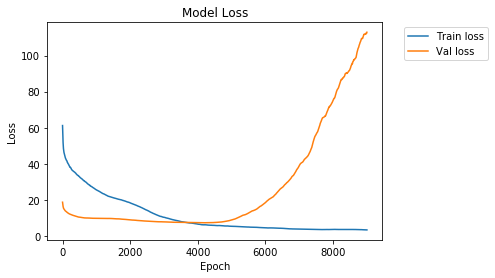

In [29]:
#Plot model loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

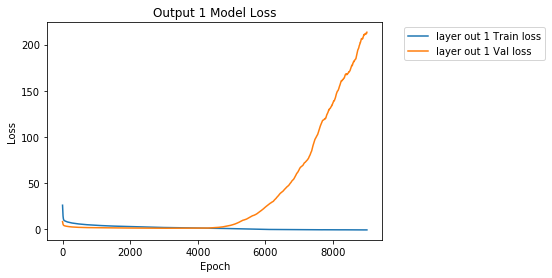

In [30]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

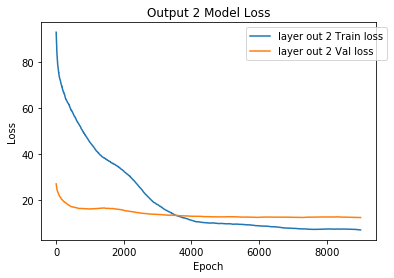

In [31]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [32]:
#Load ground truth RUL

thr = mat['thr']
fleet_NUM = np.arange(0,pad,1)

rul = pd.read_csv(rul_file,index_col=False)
rul = (rul-1)/(thr-1)
rul_Fleet_All = np.zeros(259)
for x in range(259):
    rul_Fleet_All[x] = rul['RUL'][x]
rul_Fleet_All_Full = ((thr-1)*rul_Fleet_All) + 1
rul_Fleet_All_Full

array([18., 50., 50., 50., 15., 50.,  6., 50., 11., 50.,  6., 50., 30.,
       11., 37., 50., 50., 50., 22., 50., 50., 10., 50., 50., 50., 50.,
       50., 50., 50., 50., 50., 11., 50., 50., 50., 50., 50., 50., 48.,
       37., 44., 27., 18.,  6., 15., 50., 50., 13., 50., 13., 50., 50.,
       50., 50., 50., 50., 50., 26., 50., 50., 50., 39., 39., 14., 11.,
       50., 50., 50., 50., 17., 50., 50., 50., 50., 50., 36., 50., 50.,
       50., 15., 50., 50., 50., 17., 47., 50., 21., 50., 50.,  8.,  9.,
       50., 50., 50., 50., 49., 31., 50.,  9., 14., 50.,  8.,  8., 50.,
       50., 50., 50., 50., 35., 50.,  9., 50., 50., 50., 50.,  7., 50.,
       50., 50., 15., 50., 50., 50.,  7., 50., 50., 50., 50., 50., 50.,
       50., 39., 38.,  9., 50., 50., 50.,  7., 50., 50., 50., 47., 50.,
       43., 50., 10., 50., 11., 50., 34., 50., 50., 50., 50., 50., 50.,
       50., 15.,  9., 42., 13., 41., 50., 14., 50., 50., 50., 50., 50.,
       50., 36., 50., 14., 50., 50., 23.,  6., 50., 35., 50., 50

In [33]:
#Make 100 predictions and calculate average RMSE & Score

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)
sc = np.zeros(100)
sc1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    mean_Fleet_All = np.zeros(tens_draw.shape[1])
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for y in range(tens_draw.shape[1]):
        for x in range(tens_draw.shape[0]):
            mean_Fleet[x] = tens_draw[x,y,0]
        mean_Fleet_All[y] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    #RMSE with EU

    mean_Fleet_All1 = np.zeros(tens_draw1.shape[1])
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for y in range(tens_draw1.shape[1]):
        for x in range(tens_draw1.shape[0]):
            mean_Fleet1[x] = tens_draw1[x,y,0]
        mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1
    
    score = mean_Fleet_All-rul_Fleet_All_Full

    for j in range(100):
        if score[j]<0:
            score[j]= math.exp((-score[j])/13)-1
        else:
            score[j] = math.exp(score[j]/10)-1
    
    sc[i] = np.sum(score)
    
    score1 = mean_Fleet_All1-rul_Fleet_All_Full

    for j in range(100):
        if score1[j]<0:
            score1[j]= math.exp((-score1[j])/13)-1
        else:
            score1[j] = math.exp(score1[j]/10)-1
    
    sc1[i] = np.sum(score1)

In [34]:
#Average RMSE with AU & EU
np.mean(rmse),np.mean(rmse1)

(17.744918824801893, 18.736101353613122)

In [35]:
#Average early prediction Score with AU & EU
np.mean(sc),np.mean(sc1)

(2145.7910498978376, 2551.043345731956)

In [36]:
#Calculate Mean & Std of prediction with AU

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [37]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

In [38]:
#Load ground truth RUL

fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)

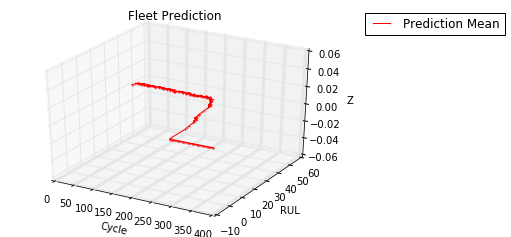

In [40]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("Fleet Prediction")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

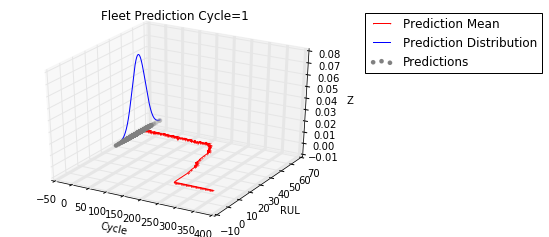

In [41]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("Fleet Prediction Cycle=1")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.1,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

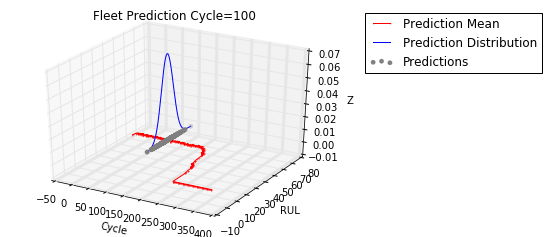

In [49]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 99

ax.set_title("Fleet Prediction Cycle=100")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_2.jpg',bbox_inches='tight')
plt.show()

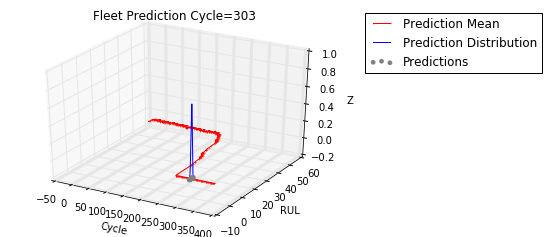

In [48]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 302

ax.set_title("Fleet Prediction Cycle=303")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_3.jpg',bbox_inches='tight')
plt.show()

In [45]:
#Define cycle when RUL ground truth become 0

cycle_lim = np.zeros(259)
S = 0
for K in range(259):
    for L in range(259):
        if fleet_RUL[K][L] == 0:
            S = 0
            break
        else:
            S = S + 1
            cycle_lim[K] = S

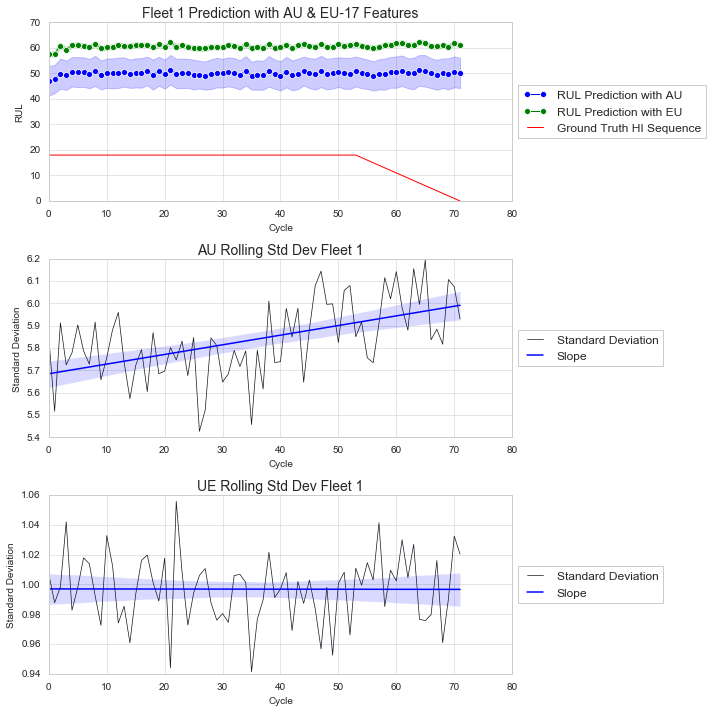

In [51]:
#Visualization Fleet 1

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(0,1):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','RUL']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','RUL']
    
    max_Seq_Arrange1.columns = ['Cycle','RUL']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','RUL']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','RUL']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="RUL", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-17 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'RUL', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'RUL', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

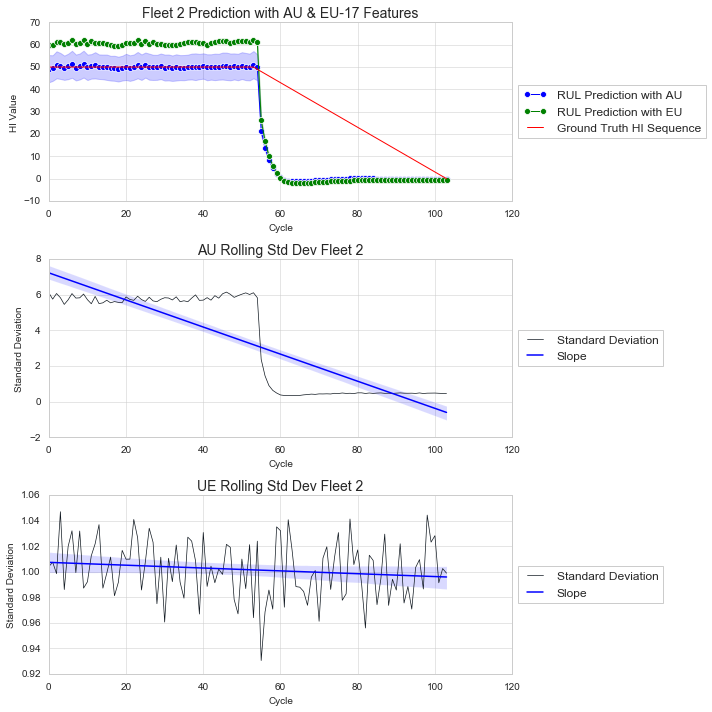

In [53]:
#Visualization Fleet 2

sns.set_style("whitegrid")
for B in range(1,2):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','HI Value']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','HI Value']
    
    max_Seq_Arrange1.columns = ['Cycle','HI Value']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','HI Value']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','HI Value']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="HI Value", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-17 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

In [54]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(pad,17),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 367, 17)]         0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 367, 40)           9280      
_________________________________________________________________
dense_3 (Dense)              (None, 367, 103)          4223      
_________________________________________________________________
dense_4 (Dense)              (None, 367, 1)            104       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 13,607
Trainable params: 13,607
Non-trainable params: 0
_________________________________________________________________


In [55]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [56]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [57]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [58]:
#Extract Feature Names

features = pd.read_csv(train_file, index_col=False)
features = features.drop(['Fleet','Cycle','RUL'],axis=1)
features = np.array(list(features.columns))
features

array(['OC1', 'OC2', 'OC3', 'S2', 'S3', 'S4', 'S7', 'S8', 'S9', 'S11',
       'S12', 'S13', 'S14', 'S15', 'S17', 'S20', 'S21'], dtype='<U3')

In [59]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(train_file, index_col=False)
xtrain = xtrain.drop(['Fleet','Cycle','RUL'],axis=1)

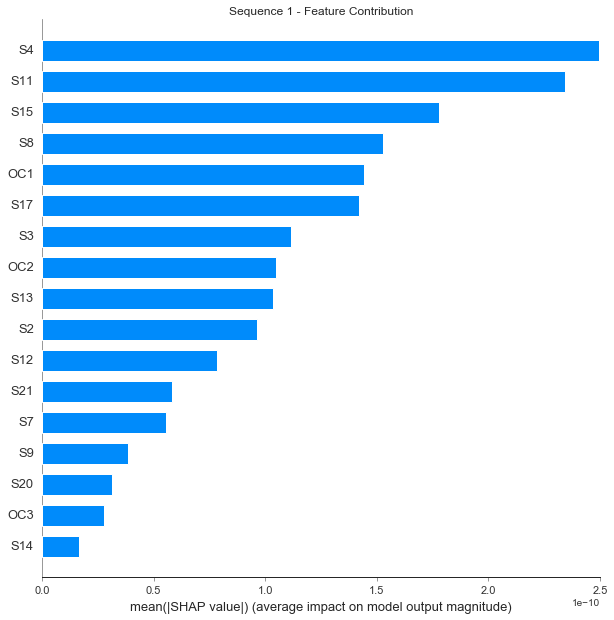

In [65]:
#SHAP Summmary Plot Fleet 1

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(0,1):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

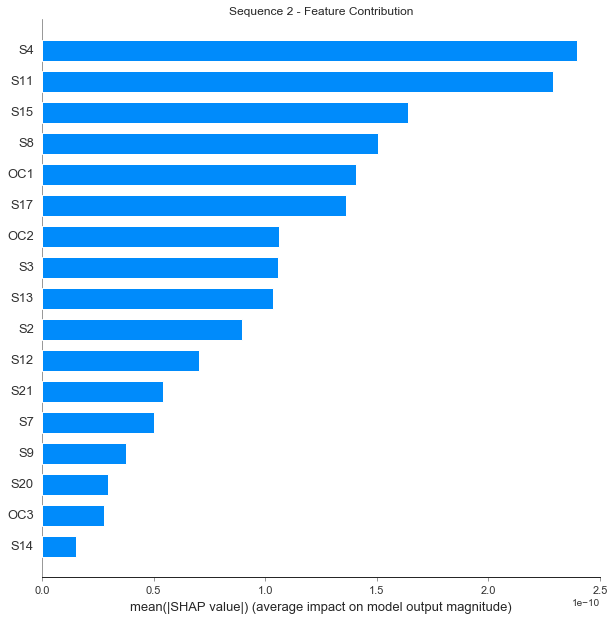

In [66]:
#SHAP Summmary Plot Fleet 2

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(1,2):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

In [62]:
#SHAP Force Plot Fleet 1

sns.set_style("ticks")
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,17),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


1 25


1 26


1 27


1 28


1 29


1 30


1 31


1 32


1 33


1 34


1 35


1 36


1 37


1 38


1 39


1 40


1 41


1 42


1 43


1 44


1 45


1 46


1 47


1 48


1 49


1 50


1 51


1 52


1 53


1 54


1 55


1 56


1 57


1 58


1 59


1 60


1 61


1 62


1 63


1 64


1 65


1 66


1 67


1 68


1 69


1 70


1 71


1 72


1 73


1 74


1 75


1 76


1 77


1 78


1 79


1 80


1 81


1 82


1 83


1 84


1 85


1 86


1 87


1 88


1 89


1 90


1 91


1 92


1 93


1 94


1 95


1 96


1 97


1 98


1 99


1 100


1 101


1 102


1 103


1 104


1 105


1 106


1 107


1 108


1 109


1 110


1 111


1 112


1 113


1 114


1 115


1 116


1 117


1 118


1 119


1 120


1 121


1 122


1 123


1 124


1 125


1 126


1 127


1 128


1 129


1 130


1 131


1 132


1 133


1 134


1 135


1 136


1 137


1 138


1 139


1 140


1 141


1 142


1 143


1 144


1 145


1 146


1 147


1 148


1 149


1 150


1 151


1 152


1 153


1 154


1 155


1 156


1 157


1 158


1 159


1 160


1 161


1 162


1 163


1 164


1 165


1 166


1 167


1 168


1 169


1 170


1 171


1 172


1 173


1 174


1 175


1 176


1 177


1 178


1 179


1 180


1 181


1 182


1 183


1 184


1 185


1 186


1 187


1 188


1 189


1 190


1 191


1 192


1 193


1 194


1 195


1 196


1 197


1 198


1 199


1 200


1 201


1 202


1 203


1 204


1 205


1 206


1 207


1 208


1 209


1 210


1 211


1 212


1 213


1 214


1 215


1 216


1 217


1 218


1 219


1 220


1 221


1 222


1 223


1 224


1 225


1 226


1 227


1 228


1 229


1 230


1 231


1 232


1 233


1 234


1 235


1 236


1 237


1 238


1 239


1 240


1 241


1 242


1 243


1 244


1 245


1 246


1 247


1 248


1 249


1 250


1 251


1 252


1 253


1 254


1 255


1 256


1 257


1 258


1 259


1 260


1 261


1 262


1 263


1 264


1 265


1 266


1 267


1 268


1 269


1 270


1 271


1 272


1 273


1 274


1 275


1 276


1 277


1 278


1 279


1 280


1 281


1 282


1 283


1 284


1 285


1 286


1 287


1 288


1 289


1 290


1 291


1 292


1 293


1 294


1 295


1 296


1 297


1 298


1 299


1 300


1 301


1 302


1 303


1 304


1 305


1 306


1 307


1 308


1 309


1 310


1 311


1 312


1 313


1 314


1 315


1 316


1 317


1 318


1 319


1 320


1 321


1 322


1 323


1 324


1 325


1 326


1 327


1 328


1 329


1 330


1 331


1 332


1 333


1 334


1 335


1 336


1 337


1 338


1 339


1 340


1 341


1 342


1 343


1 344


1 345


1 346


1 347


1 348


1 349


1 350


1 351


1 352


1 353


1 354


1 355


1 356


1 357


1 358


1 359


1 360


1 361


1 362


1 363


1 364


1 365


1 366


1 367


In [63]:
#SHAP Force Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,17),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


2 25


2 26


2 27


2 28


2 29


2 30


2 31


2 32


2 33


2 34


2 35


2 36


2 37


2 38


2 39


2 40


2 41


2 42


2 43


2 44


2 45


2 46


2 47


2 48


2 49


2 50


2 51


2 52


2 53


2 54


2 55


2 56


2 57


2 58


2 59


2 60


2 61


2 62


2 63


2 64


2 65


2 66


2 67


2 68


2 69


2 70


2 71


2 72


2 73


2 74


2 75


2 76


2 77


2 78


2 79


2 80


2 81


2 82


2 83


2 84


2 85


2 86


2 87


2 88


2 89


2 90


2 91


2 92


2 93


2 94


2 95


2 96


2 97


2 98


2 99


2 100


2 101


2 102


2 103


2 104


2 105


2 106


2 107


2 108


2 109


2 110


2 111


2 112


2 113


2 114


2 115


2 116


2 117


2 118


2 119


2 120


2 121


2 122


2 123


2 124


2 125


2 126


2 127


2 128


2 129


2 130


2 131


2 132


2 133


2 134


2 135


2 136


2 137


2 138


2 139


2 140


2 141


2 142


2 143


2 144


2 145


2 146


2 147


2 148


2 149


2 150


2 151


2 152


2 153


2 154


2 155


2 156


2 157


2 158


2 159


2 160


2 161


2 162


2 163


2 164


2 165


2 166


2 167


2 168


2 169


2 170


2 171


2 172


2 173


2 174


2 175


2 176


2 177


2 178


2 179


2 180


2 181


2 182


2 183


2 184


2 185


2 186


2 187


2 188


2 189


2 190


2 191


2 192


2 193


2 194


2 195


2 196


2 197


2 198


2 199


2 200


2 201


2 202


2 203


2 204


2 205


2 206


2 207


2 208


2 209


2 210


2 211


2 212


2 213


2 214


2 215


2 216


2 217


2 218


2 219


2 220


2 221


2 222


2 223


2 224


2 225


2 226


2 227


2 228


2 229


2 230


2 231


2 232


2 233


2 234


2 235


2 236


2 237


2 238


2 239


2 240


2 241


2 242


2 243


2 244


2 245


2 246


2 247


2 248


2 249


2 250


2 251


2 252


2 253


2 254


2 255


2 256


2 257


2 258


2 259


2 260


2 261


2 262


2 263


2 264


2 265


2 266


2 267


2 268


2 269


2 270


2 271


2 272


2 273


2 274


2 275


2 276


2 277


2 278


2 279


2 280


2 281


2 282


2 283


2 284


2 285


2 286


2 287


2 288


2 289


2 290


2 291


2 292


2 293


2 294


2 295


2 296


2 297


2 298


2 299


2 300


2 301


2 302


2 303


2 304


2 305


2 306


2 307


2 308


2 309


2 310


2 311


2 312


2 313


2 314


2 315


2 316


2 317


2 318


2 319


2 320


2 321


2 322


2 323


2 324


2 325


2 326


2 327


2 328


2 329


2 330


2 331


2 332


2 333


2 334


2 335


2 336


2 337


2 338


2 339


2 340


2 341


2 342


2 343


2 344


2 345


2 346


2 347


2 348


2 349


2 350


2 351


2 352


2 353


2 354


2 355


2 356


2 357


2 358


2 359


2 360


2 361


2 362


2 363


2 364


2 365


2 366


2 367


Contribution: [-6.93559657e-14 -2.00929741e-13  1.47938929e-14  2.45625189e-13
 -7.91111087e-14 -4.33892234e-13  1.97060358e-13 -8.60914462e-14
  1.78346345e-14  7.76859181e-14  5.09062248e-13 -1.37229217e-13
 -1.89079336e-14 -3.60356113e-13 -2.42065564e-13  1.83917091e-13
  1.06951808e-13]


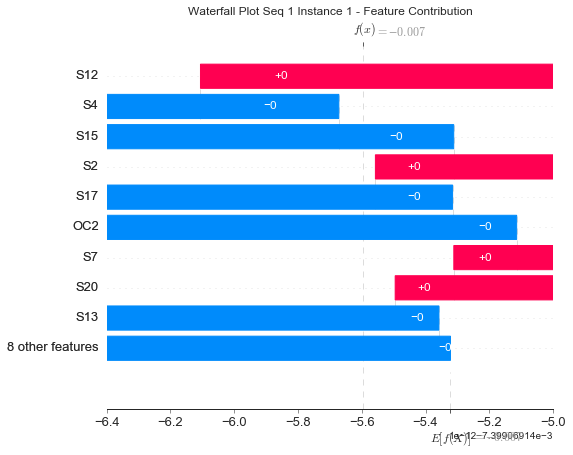

None

Contribution: [ 2.25012554e-13 -1.74212434e-14  2.70032731e-14 -5.16573167e-13
  3.36649301e-13  3.89623934e-13 -1.78970594e-13 -2.76601306e-13
 -9.62625026e-14  3.31533195e-13 -2.82845118e-13 -6.46607266e-14
 -3.23659421e-14 -1.00876637e-13  3.85868936e-13 -6.71030343e-14
 -2.03837828e-13]


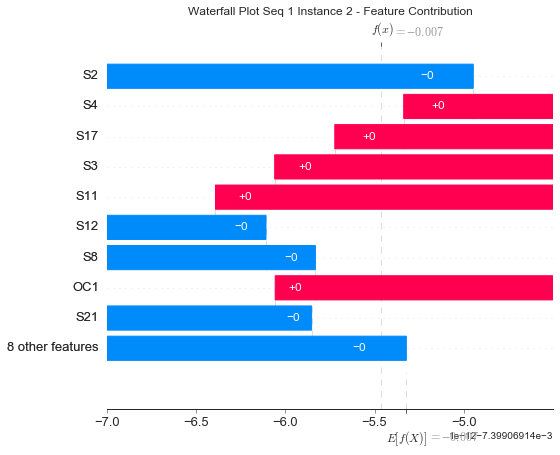

None

Contribution: [-5.66527348e-13 -1.74330046e-13  0.00000000e+00  8.45187256e-13
 -5.68050381e-13 -1.37533203e-12  4.80654850e-13  3.29875802e-13
  2.65331079e-13 -8.59517644e-13  7.60585117e-13  1.54500461e-15
 -6.13601780e-14  1.11648483e-12 -6.99473140e-13  2.05282582e-13
  3.84688375e-13]


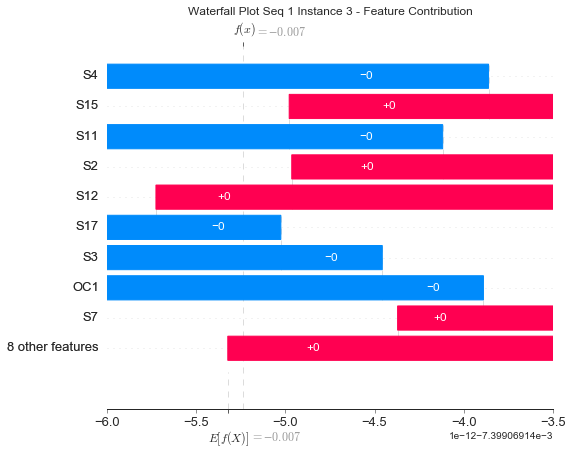

None

Contribution: [-3.42532697e-13 -4.13695770e-14  4.19719293e-14  2.02541095e-13
 -2.10980593e-13 -1.68885291e-13  1.87136155e-13  2.82748153e-14
  3.67771711e-14  4.35644867e-14  1.85255538e-13 -4.52610903e-14
 -2.91413961e-14  1.60814572e-13 -9.98056686e-14  1.65649067e-14
  2.20177026e-13]


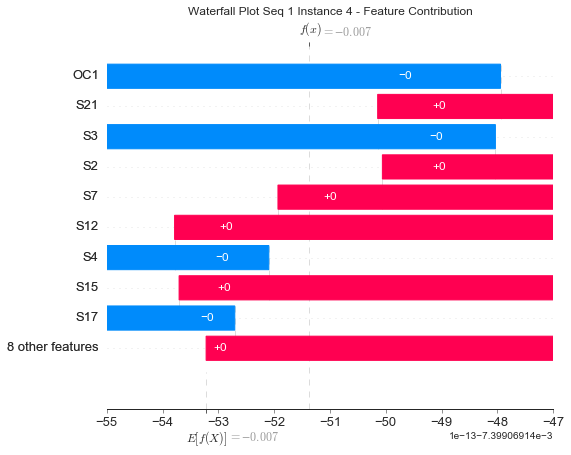

None

Contribution: [-2.33887156e-13 -2.12122949e-13 -4.74564561e-13  6.24760606e-13
 -9.37246700e-13 -1.32646205e-12  2.75088519e-13  8.66882087e-13
  1.32249409e-13 -1.42409229e-12  4.48147135e-13  6.61047606e-13
 -2.22533878e-13  2.10072389e-12 -9.94820437e-13  1.25207434e-13
  2.25058457e-13]


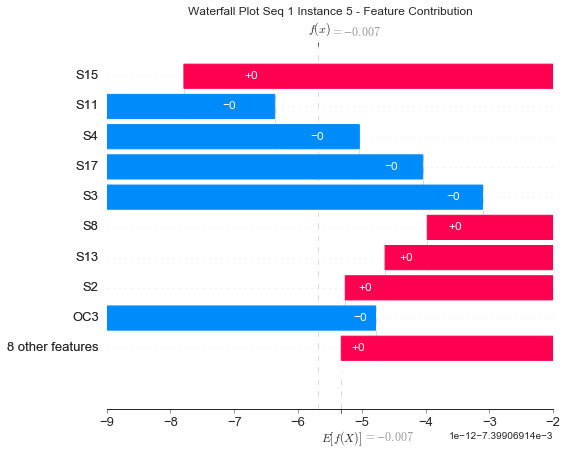

None

Contribution: [ 1.03547184e-12  4.79405903e-13 -9.82420308e-13  1.47729038e-13
 -1.05783134e-12 -1.16993589e-12  5.47479339e-14  1.39572316e-12
 -1.03734058e-13 -2.36075959e-12 -7.57077438e-14  9.83603281e-13
 -3.48038764e-13  3.02959437e-12 -1.06696390e-12  4.34558124e-14
 -2.36802324e-14]


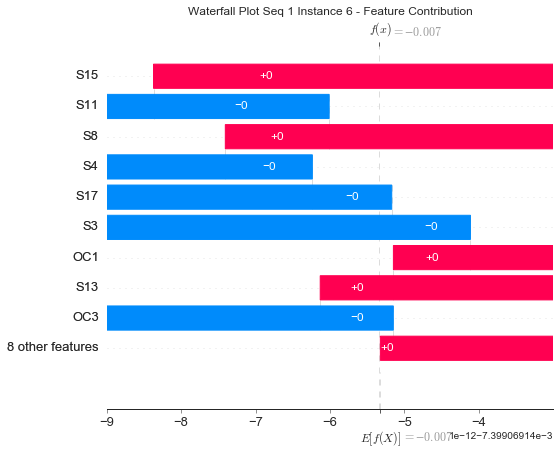

None

Contribution: [-1.28287322e-12 -4.82387947e-13  5.98424413e-13  4.00690006e-13
  3.71441972e-13 -7.88878545e-15  4.20553674e-13 -7.71483788e-13
  1.61408200e-13  1.32427652e-12  5.95454675e-13 -7.19551914e-13
  1.34562649e-13 -1.39788214e-12  2.34744190e-13  1.28358180e-13
  4.60734749e-13]


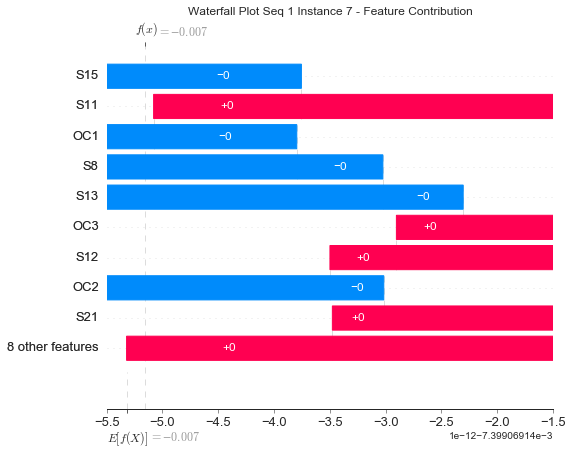

None

Contribution: [-6.21761106e-13 -1.83492463e-13  7.12701247e-14  6.12672565e-13
 -4.62233442e-13 -7.82943588e-13  4.01837824e-13  1.87721786e-13
  1.44391443e-13 -3.64970017e-13  6.10037791e-13 -4.80393076e-14
 -2.55125561e-14  5.76717114e-13 -4.65848931e-13  1.83296466e-13
  3.89294798e-13]


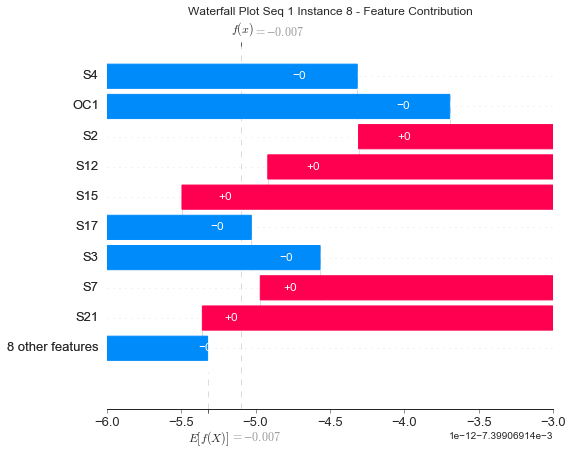

None

Contribution: [-1.97649709e-12 -8.45847047e-13  0.00000000e+00  2.56878156e-12
 -1.90951898e-12 -3.97815244e-12  1.86049418e-12  9.43593402e-13
  5.39261507e-13 -2.09239462e-12  2.62998499e-12  1.76047010e-15
 -1.87229369e-13  2.35853416e-12 -2.10625896e-12  8.15659768e-13
  1.55943856e-12]


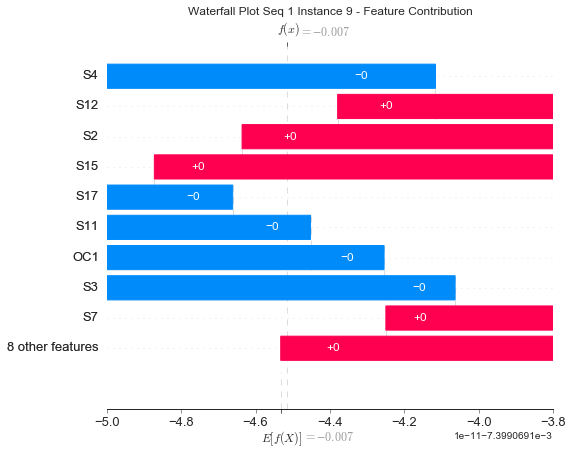

None

Contribution: [-6.01443916e-13 -5.28048579e-13  1.68461396e-13  2.05307315e-13
 -3.80836828e-13 -1.04402880e-12  3.25703765e-13  2.49564800e-13
  1.72675595e-13 -7.72941336e-13  6.15211874e-13  9.94543667e-14
 -8.38344422e-14  1.97690150e-12 -4.54203027e-13  1.98360656e-13
  2.74853545e-13]


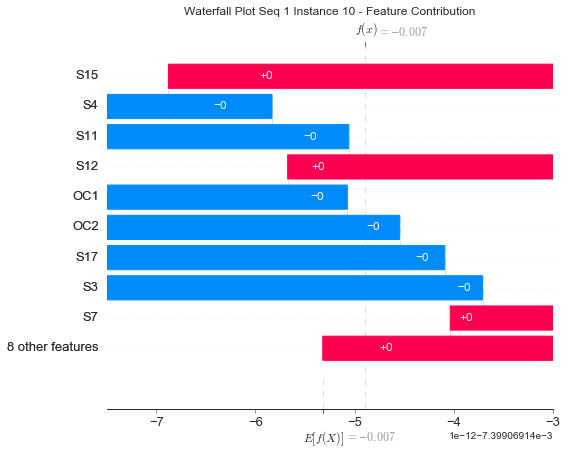

None

Contribution: [ 8.80163021e-13  5.19058592e-13  8.64408317e-13 -2.04158955e-12
  2.89548138e-12  4.68080349e-12 -8.36410205e-13 -2.78313462e-12
 -4.65500360e-13  4.36560336e-12 -1.28613233e-12 -1.91146079e-12
  4.70233715e-13 -6.99358019e-12  3.10387046e-12 -2.84946220e-13
 -7.66335725e-13]


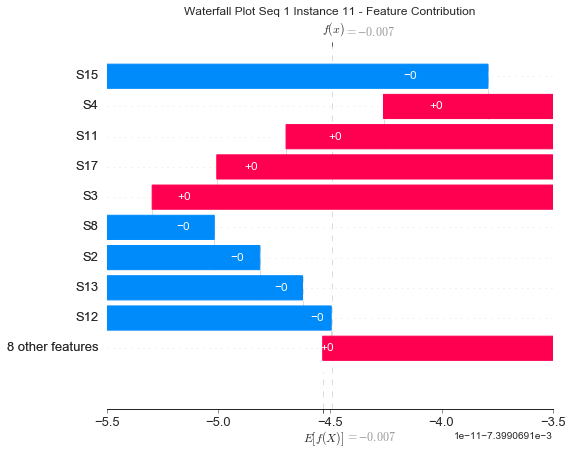

None

Contribution: [-1.43960446e-13  8.38337104e-14  1.16365888e-13 -8.84010747e-14
  1.05322482e-13  3.97465670e-13 -4.48095540e-14 -1.24713973e-13
 -4.09489811e-14  4.23182838e-13 -1.02135016e-13 -9.72329584e-14
  3.10763513e-14 -3.82281500e-13  1.49052659e-13 -6.86259521e-14
  5.14200295e-14]


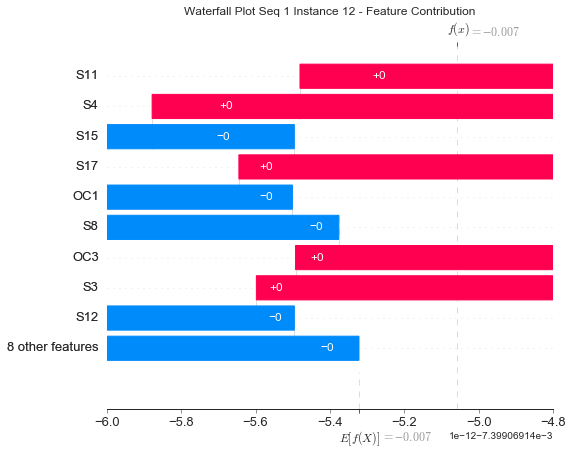

None

Contribution: [-3.48326213e-13 -2.78013208e-13 -1.03563198e-12  1.23260657e-12
 -2.09862162e-12 -3.41893354e-12  6.30864339e-13  2.14233037e-12
  1.93085036e-13 -3.64768025e-12  8.67303083e-13  1.61470848e-12
 -5.08757424e-13  5.60146157e-12 -2.14125028e-12  2.33248235e-13
  5.45534375e-13]


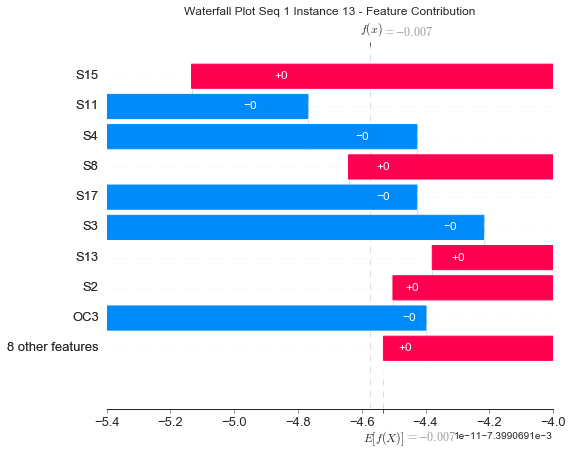

None

Contribution: [-9.45091553e-13 -9.92858682e-14  0.00000000e+00  1.63262307e-12
 -1.01652226e-12 -1.57269521e-12  7.33790795e-13  6.00172147e-13
  3.10731475e-13 -8.47324435e-13  1.10300755e-12  1.72402344e-15
 -4.02119320e-15  4.67920028e-13 -1.04855610e-12  3.01804453e-13
  7.06970019e-13]


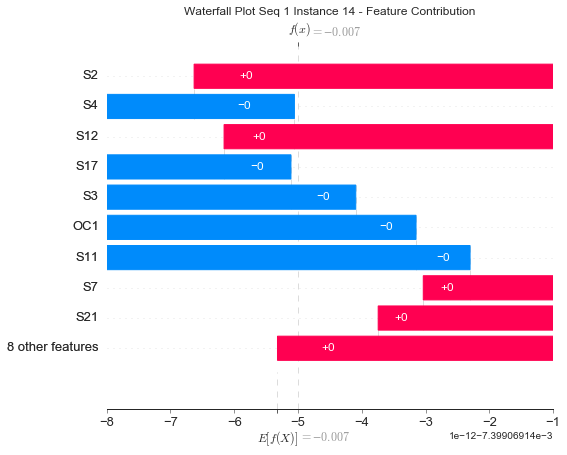

None

Contribution: [ 1.97635029e-12  1.00202670e-12 -1.84978375e-14 -2.10192519e-12
  1.17216946e-12  3.31361436e-12 -1.76020136e-12 -2.83036046e-13
 -3.88625736e-13  1.28864356e-12 -2.48417693e-12  5.07925841e-13
  1.11327492e-13 -1.60877821e-12  1.46753584e-12 -7.09522230e-13
 -1.36977506e-12]


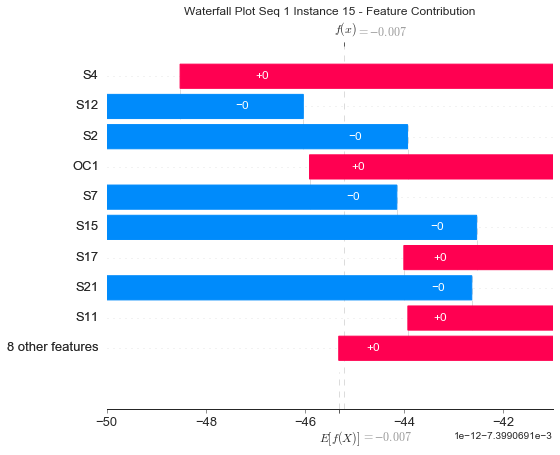

None

Contribution: [ 1.01013913e-12  4.33919393e-13 -1.22837959e-12  1.67773564e-13
 -1.26137154e-12 -1.27883804e-12  2.55698766e-14  1.51834947e-12
 -1.43467310e-13 -2.50675392e-12 -8.92416973e-14  1.22140904e-12
 -2.58811066e-13  3.31068051e-12 -1.00181311e-12  2.67260342e-14
 -3.58600309e-14]


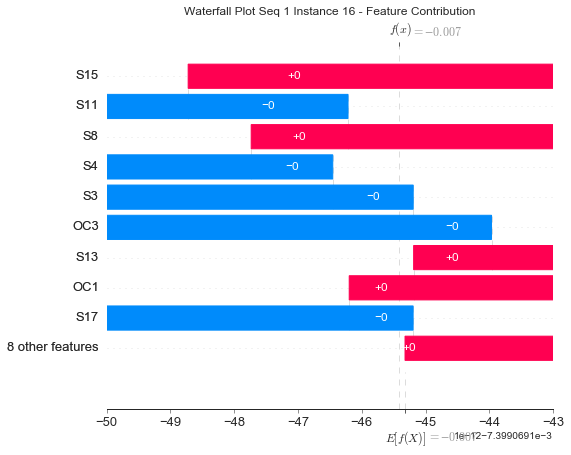

None

Contribution: [ 1.12014337e-12  4.15260762e-13 -1.05633742e-12 -7.15078631e-14
 -1.03186697e-12 -8.87788974e-13 -5.63832428e-14  1.36683243e-12
 -1.67151815e-13 -2.42852158e-12 -1.83602333e-13  1.13122435e-12
 -2.99225082e-13  3.04366254e-12 -9.16288204e-13 -9.20666114e-15
 -1.38321836e-13]


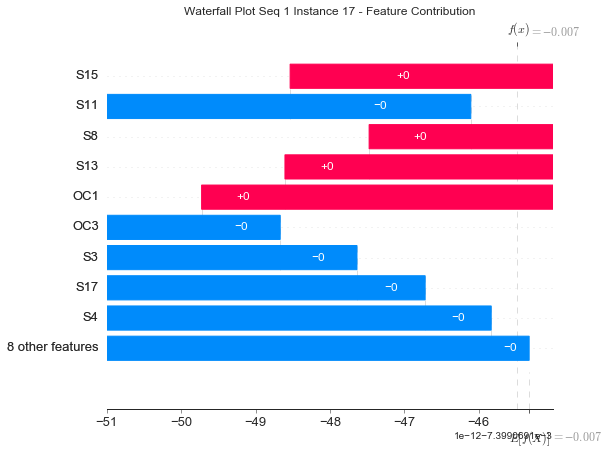

None

Contribution: [-1.32727954e-12 -1.22634498e-12  3.21479903e-13  5.35948456e-13
 -1.41384192e-13 -1.46572815e-12  1.12145915e-12 -4.84620861e-13
  1.22457830e-13 -1.28838007e-13  1.58943724e-12 -6.26475813e-13
 -1.08264194e-13  6.00846521e-13 -3.05036785e-13  5.29070982e-13
  8.08987155e-13]


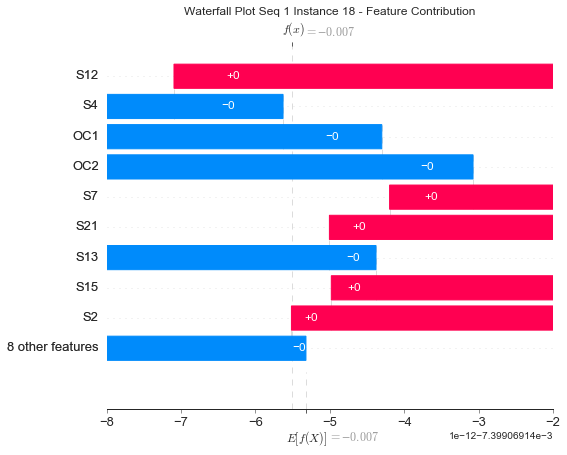

None

Contribution: [ 3.30919699e-13  1.83384273e-13  0.00000000e+00 -3.66016218e-13
  1.71396629e-13  6.02988308e-13 -2.17003580e-13 -1.24224050e-13
 -1.10332404e-13  4.27729710e-13 -3.69102237e-13  5.49302560e-16
  7.60266196e-15 -3.69093075e-13  2.32717708e-13 -1.24511417e-13
 -1.81766996e-13]


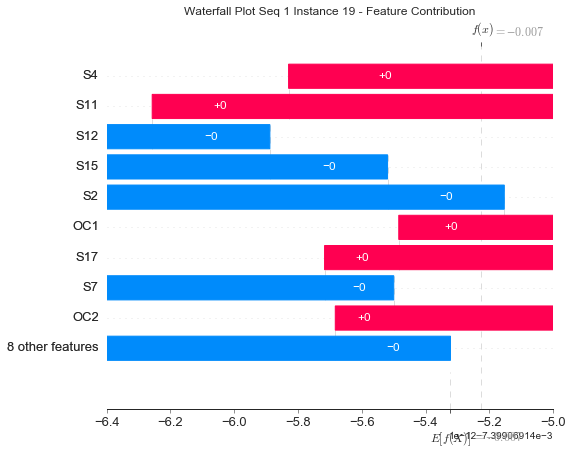

None

Contribution: [-1.51062268e-12 -5.38143369e-13  7.39754869e-14  1.55351545e-12
 -1.06426088e-12 -2.28247803e-12  1.05066975e-12  4.44259430e-13
  3.56281546e-13 -1.12182475e-12  1.52719038e-12 -8.47144620e-14
 -1.01383515e-13  1.54637349e-12 -1.15124913e-12  5.26913799e-13
  9.59241258e-13]


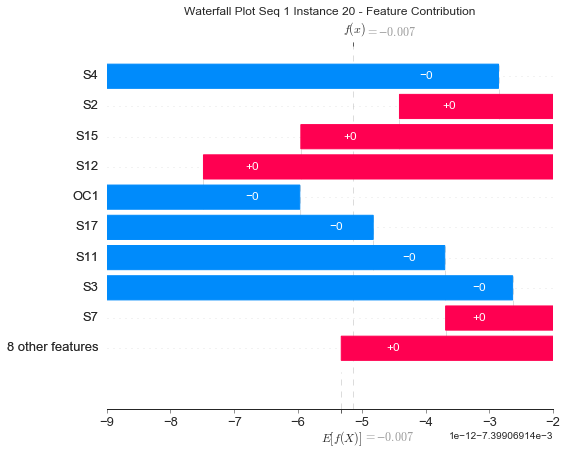

None

Contribution: [-6.81171319e-13 -5.38256614e-13  6.84362574e-14  1.00363218e-12
 -8.32007369e-13 -1.56132301e-12  9.15549862e-13  2.43122037e-13
  1.50466120e-13 -7.23180793e-13  1.29123752e-12 -1.32520297e-13
  4.45101033e-15  3.71158128e-13 -7.73058429e-13  4.17590414e-13
  6.24417727e-13]


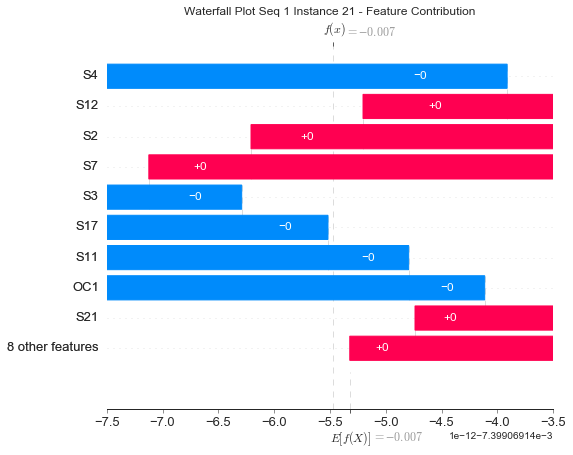

None

Contribution: [-1.59249198e-12 -5.40890412e-13  0.00000000e+00  1.76486581e-12
 -1.22822260e-12 -2.86319839e-12  1.10598108e-12  6.51215843e-13
  3.93485483e-13 -1.41054258e-12  1.62793292e-12  1.35042950e-15
 -1.14975941e-13  1.70381482e-12 -1.37308166e-12  5.54006981e-13
  1.01138390e-12]


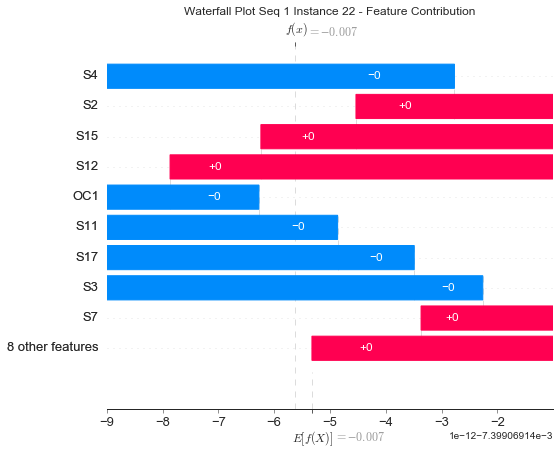

None

Contribution: [-2.97578450e-13 -2.17520812e-13  0.00000000e+00  1.08483426e-12
 -6.96509799e-13 -1.01794387e-12  7.17398580e-13  4.02582048e-13
  1.36747845e-13 -8.35517636e-13  1.00569932e-12 -6.21510160e-16
  5.18738291e-14 -2.86629309e-13 -7.89422618e-13  3.18119120e-13
  4.67776588e-13]


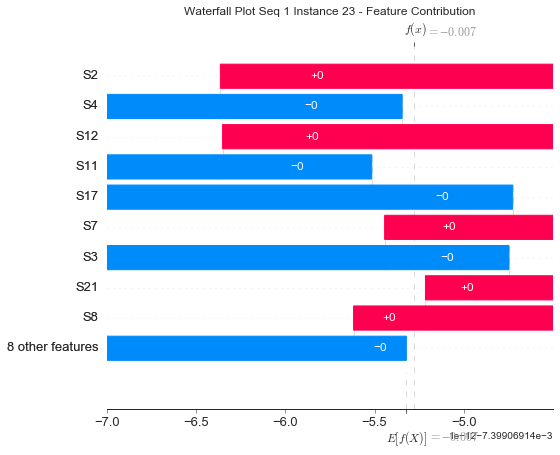

None

Contribution: [-1.62488642e-12 -4.15671620e-13  4.50543872e-13  2.07507492e-12
 -7.03340055e-13 -1.64780212e-12  9.71493610e-13  9.47978607e-14
  4.11974654e-13 -2.56436836e-14  1.41415471e-12 -5.32577400e-13
  8.17313068e-14 -8.44936968e-13 -8.40971661e-13  3.65757039e-13
  9.03888509e-13]


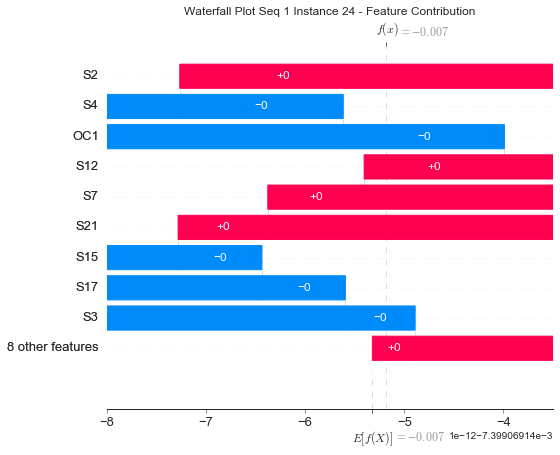

None

Contribution: [ 8.64049446e-13  5.50110142e-13  0.00000000e+00 -6.06299082e-13
  5.13684418e-13  1.27308309e-12 -5.30674951e-13 -2.36362525e-13
 -1.64759157e-13  5.02453222e-13 -8.17990695e-13  4.04354603e-16
  6.75991855e-14 -1.43410511e-12  6.05292617e-13 -2.46830849e-13
 -4.89497386e-13]


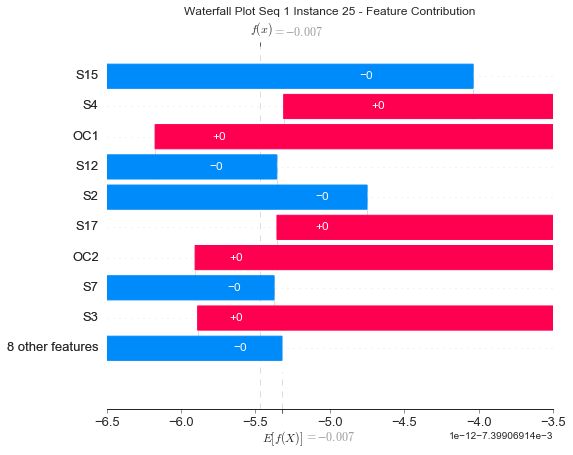

None

Contribution: [-1.83103619e-12 -3.35028012e-13 -4.19218290e-13  3.71455991e-12
 -3.08614224e-12 -5.10781608e-12  1.88326611e-12  2.40232985e-12
  6.80953395e-13 -3.88565655e-12  2.78922393e-12  7.83453326e-13
 -1.46233801e-13  4.07535854e-12 -3.39735206e-12  7.58375079e-13
  1.66160065e-12]


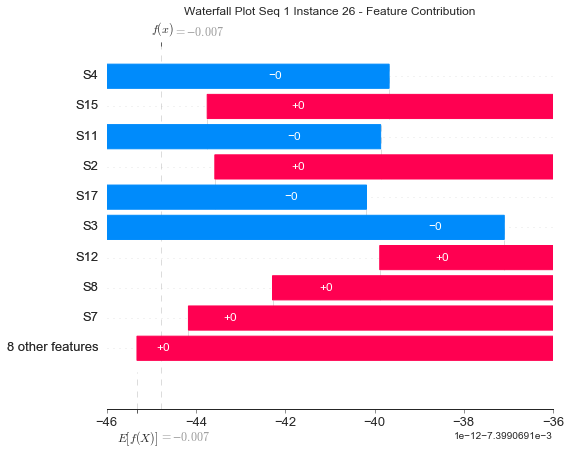

None

Contribution: [ 5.32379479e-13  2.19684473e-13  1.60518268e-12 -2.62856989e-12
  3.47626593e-12  5.47955648e-12 -1.67026061e-12 -3.24070371e-12
 -3.44952636e-13  5.64023828e-12 -2.44058571e-12 -1.90564838e-12
  5.17637257e-13 -6.67724556e-12  3.64670707e-12 -8.65915575e-13
 -1.28912603e-12]


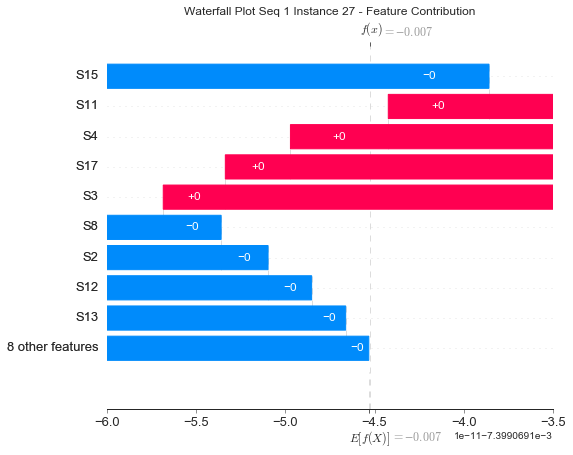

None

Contribution: [-1.20623791e-12 -3.11562462e-13  0.00000000e+00  1.25254635e-12
 -8.61497180e-13 -2.09566739e-12  9.30175967e-13  4.88491192e-13
  2.33235360e-13 -1.18572220e-12  1.16386035e-12  2.55687123e-15
 -6.81892693e-14  9.40885282e-13 -1.09306509e-12  3.62626704e-13
  8.77700419e-13]


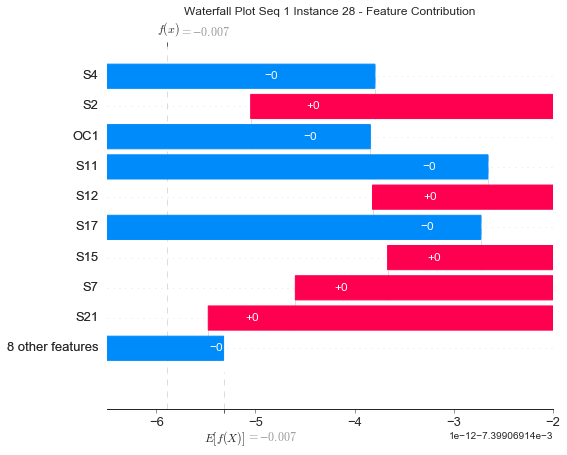

None

Contribution: [-1.29565250e-12 -3.72118894e-13  0.00000000e+00  1.46950095e-12
 -1.02436495e-12 -1.86159660e-12  8.36357188e-13  5.54279062e-13
  2.84932207e-13 -1.13106497e-12  1.29436338e-12 -1.11217925e-15
 -6.87543758e-14  9.62148547e-13 -1.10855942e-12  3.38862375e-13
  8.05402511e-13]


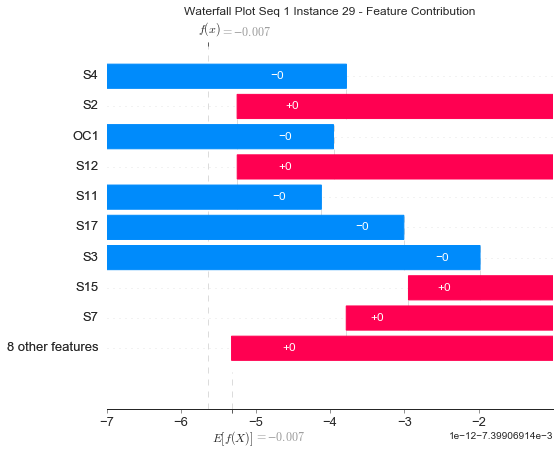

None

Contribution: [-2.17629742e-15 -2.43709488e-14  1.00285469e-13 -1.47095484e-13
  1.55134206e-13  4.10651304e-13 -4.90392401e-14 -1.82077037e-13
 -1.76073094e-14  3.40368060e-13 -9.35874100e-14 -1.11459588e-13
  1.55113925e-14 -3.56322285e-13  1.43308664e-13 -3.94327210e-14
 -4.17786601e-14]


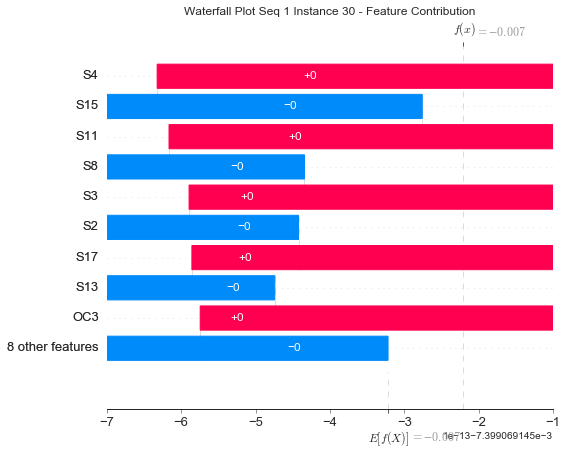

None

Contribution: [-9.07111138e-13 -2.75336584e-13  0.00000000e+00  9.03913717e-13
 -7.74953832e-13 -1.37086534e-12  6.40644059e-13  3.37992600e-13
  1.66168972e-13 -6.57985656e-13  8.89193721e-13 -1.94675740e-16
 -6.07379883e-14  8.33787141e-13 -7.30821165e-13  2.64744390e-13
  6.14214029e-13]


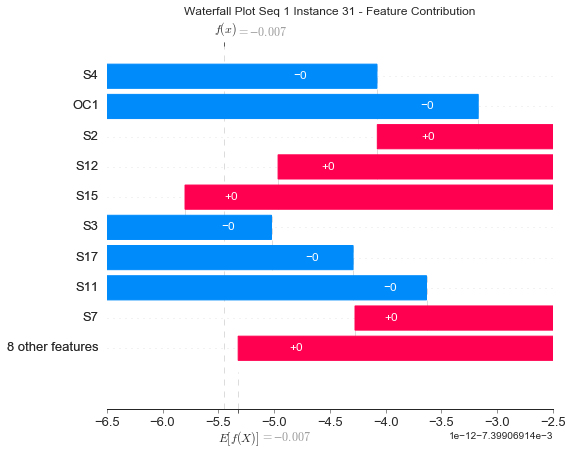

None

Contribution: [-1.82258006e-12 -2.87723458e-13 -1.51285763e-13  3.22883430e-12
 -2.17916765e-12 -3.61254624e-12  1.34740580e-12  1.50374396e-12
  6.38895241e-13 -2.50179001e-12  2.03061613e-12  2.64840260e-13
 -8.28027290e-14  1.96894584e-12 -2.35303508e-12  5.52633568e-13
  1.31053740e-12]


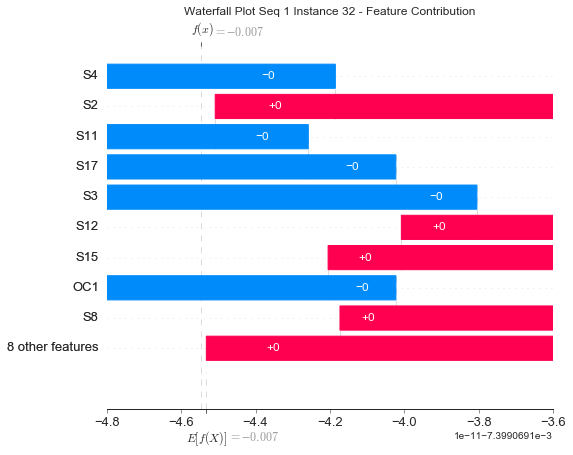

None

Contribution: [ 1.03969784e-12  2.50041172e-13  1.56865149e-13 -8.40871481e-13
  6.51897861e-13  1.10673113e-12 -4.56364384e-13 -5.17762157e-13
 -1.47505258e-13  6.18253712e-13 -8.14536589e-13 -1.69863201e-13
  3.08438306e-14 -1.34222939e-12  7.32967235e-13 -1.88728224e-13
 -5.18175888e-13]


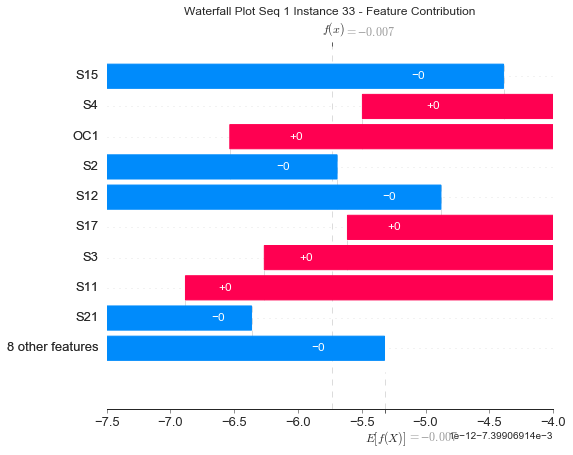

None

Contribution: [ 5.30365411e-13  6.80976055e-13 -1.13999673e-12  3.19629848e-13
 -6.84579780e-13 -3.61859360e-13 -3.60613096e-13  1.10517650e-12
 -1.17847301e-13 -1.38083989e-12 -8.27221158e-13  9.54474672e-13
 -3.31808745e-13  1.99661034e-12 -7.58488270e-13 -3.34944231e-13
 -1.35707689e-13]


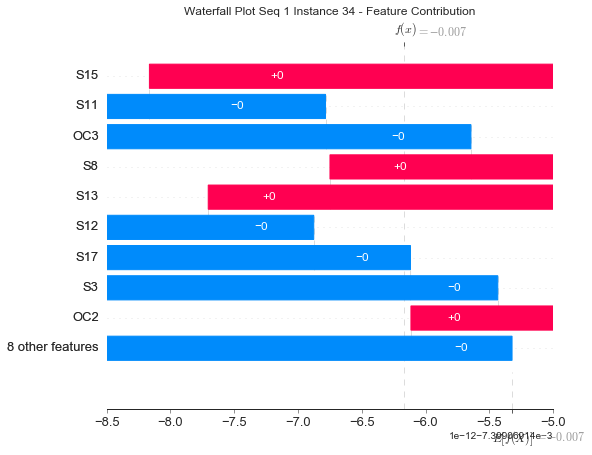

None

Contribution: [ 8.01900430e-13  8.84076558e-13  0.00000000e+00  5.74791950e-14
  3.11528228e-13  1.20727376e-12 -6.07632976e-13 -2.81796321e-15
 -3.74642469e-14  5.29009616e-13 -1.04329794e-12  9.99336247e-16
  1.02243734e-13 -1.88654062e-12  4.66085558e-13 -3.51373634e-13
 -3.48410726e-13]


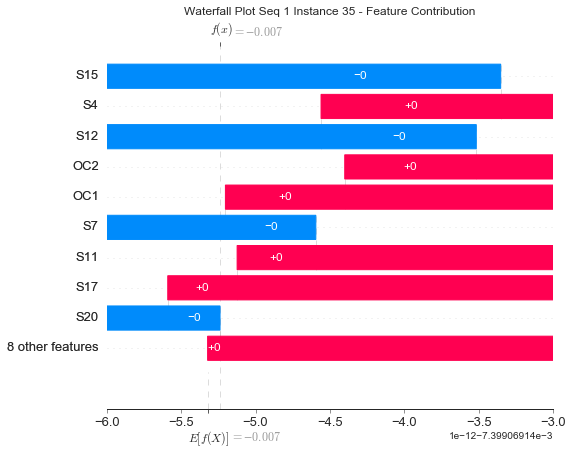

None

Contribution: [-9.00416081e-13 -6.60890234e-13  8.86663681e-13 -2.66599893e-13
  1.48706015e-12  1.14985332e-12  1.43471078e-13 -1.97775151e-12
  1.65934957e-14  2.84158916e-12  1.41395698e-13 -1.49229077e-12
  8.10944736e-14 -3.65539326e-12  1.35556865e-12  6.25973408e-14
  8.87777333e-14]


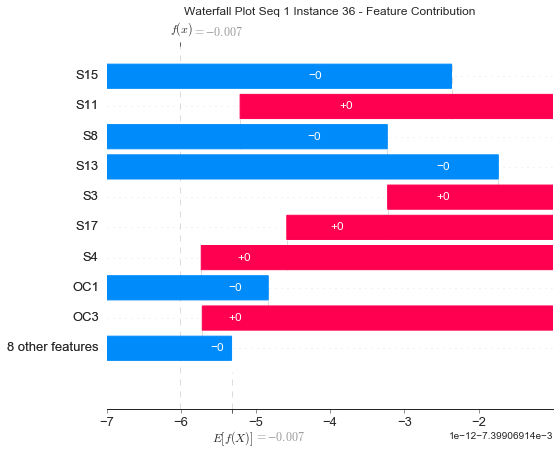

None

Contribution: [-4.37247948e-13  1.24785815e-13 -1.01097895e-12  2.15948917e-12
 -2.79443829e-12 -4.37698402e-12  4.50946111e-13  2.94839153e-12
  4.56928278e-13 -4.42015565e-12  7.90574203e-13  2.39265790e-12
 -5.21661544e-13  6.14879935e-12 -3.06454493e-12  1.45014507e-13
  4.53850526e-13]


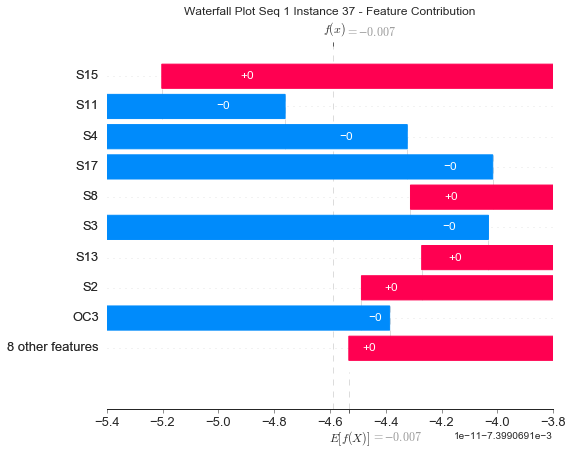

None

Contribution: [-1.84741545e-12 -5.71401379e-13  0.00000000e+00  1.93534208e-12
 -1.45621308e-12 -2.86048507e-12  1.37636137e-12  7.32795064e-13
  3.63459751e-13 -1.37947585e-12  1.82930168e-12  9.95232373e-16
 -1.15435696e-13  1.94800925e-12 -1.56445310e-12  5.28336706e-13
  1.29275746e-12]


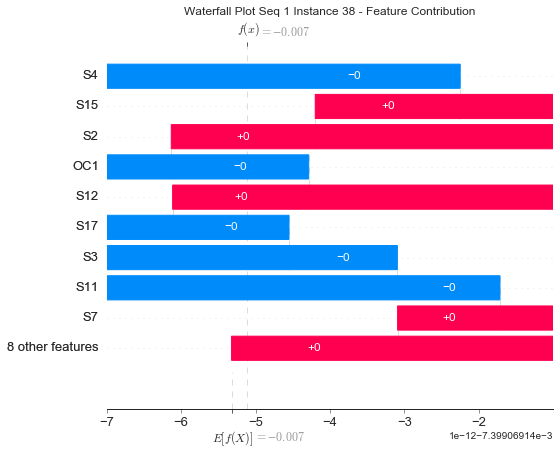

None

Contribution: [ 2.81139630e-12  1.19133035e-12  0.00000000e+00 -3.34336725e-12
  2.25779660e-12  4.61779746e-12 -2.30331054e-12 -1.22042285e-12
 -6.94152472e-13  2.30116317e-12 -3.41817048e-12 -6.18331457e-16
  1.74995340e-13 -2.95115278e-12  2.63958538e-12 -9.91153882e-13
 -1.97875874e-12]


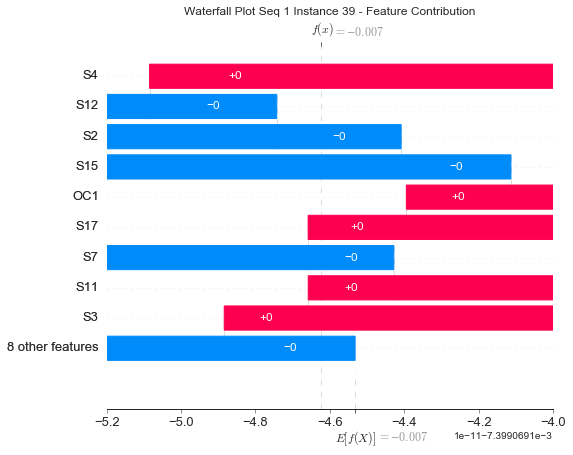

None

Contribution: [-2.28469804e-13  1.79875968e-14 -2.63216803e-13  1.21403235e-12
 -9.91927786e-13 -1.67590432e-12  2.36869145e-13  1.04068859e-12
  3.02174084e-13 -1.53488507e-12  5.46527233e-13  5.98383105e-13
 -7.97530648e-14  1.59818708e-12 -1.10328977e-12  1.62630177e-13
  2.28611807e-13]


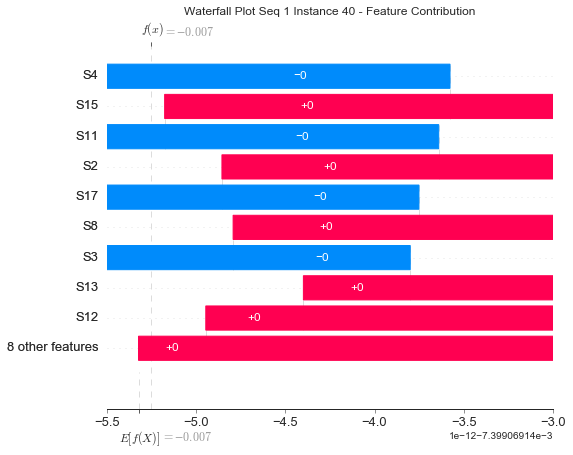

None

Contribution: [ 4.78536264e-13 -3.83338299e-13 -1.15632178e-12  1.32176887e-12
 -2.63446339e-12 -3.93372444e-12  2.45480475e-13  2.97845234e-12
  3.71237898e-13 -4.66127484e-12  6.32457032e-13  2.63624279e-12
 -5.95729358e-13  7.01889588e-12 -3.04930191e-12  1.10024457e-13
  1.11749955e-14]


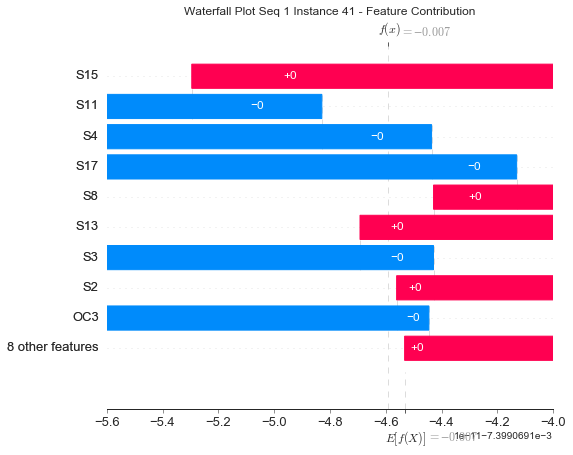

None

Contribution: [-1.88981643e-12 -6.64613221e-13  7.45099945e-13  1.38653661e-12
 -2.64682265e-13 -1.52804245e-12  1.13043993e-12 -4.66527316e-13
  2.35977416e-13  3.12676019e-13  1.44549010e-12 -9.38123711e-13
  6.37765733e-14 -1.06419778e-12 -4.50734366e-13  4.04781894e-13
  1.03655290e-12]


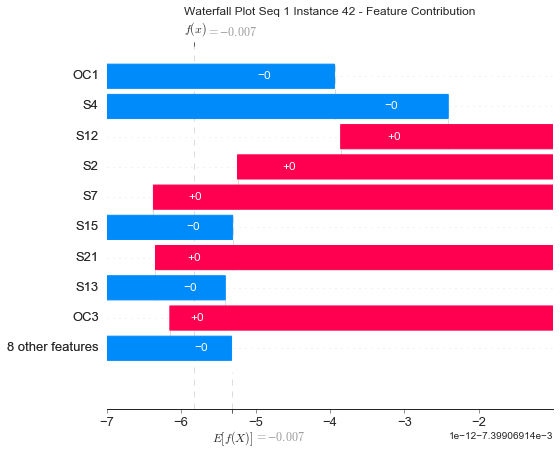

None

Contribution: [ 9.25228427e-13  9.50958713e-13 -2.91018511e-13 -1.37307732e-12
  1.45709584e-12  3.32091364e-12 -1.32007881e-12 -1.01932406e-12
 -4.58395474e-13  2.31156110e-12 -2.17352286e-12 -2.52934582e-13
  2.14862294e-13 -3.91112273e-12  1.88743747e-12 -6.11367348e-13
 -9.24113650e-13]


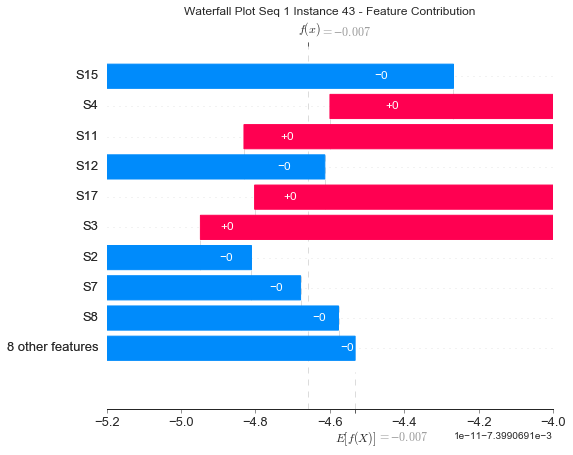

None

Contribution: [-1.96541936e-12 -7.31456508e-13 -2.30105431e-13  2.16869426e-12
 -1.35787844e-12 -2.53539269e-12  1.17364723e-12  7.64837250e-13
  4.16723622e-13 -8.56720023e-13  1.43479781e-12  4.71744659e-13
 -2.28830220e-13  1.05645158e-12 -1.60850131e-12  3.39427027e-13
  1.09193047e-12]


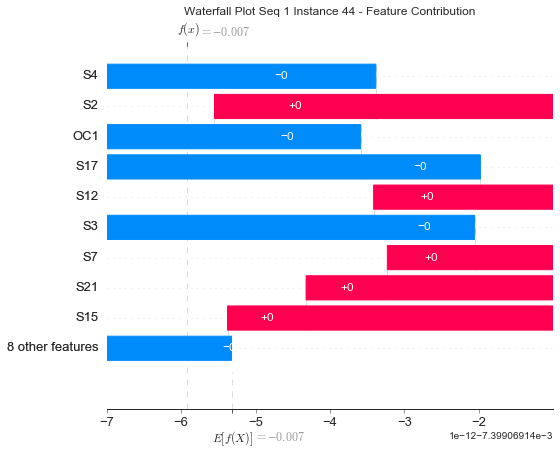

None

Contribution: [-4.25403961e-13 -6.30248458e-13 -1.74531925e-13 -4.78422586e-13
  2.66923392e-13 -5.27478831e-13  8.24371170e-13 -8.64551378e-13
 -3.02588819e-13  2.44951954e-13  6.21920918e-13 -3.82923131e-13
 -2.64699639e-13 -1.16198243e-13  3.31289141e-13  2.96357557e-13
  4.67757940e-13]


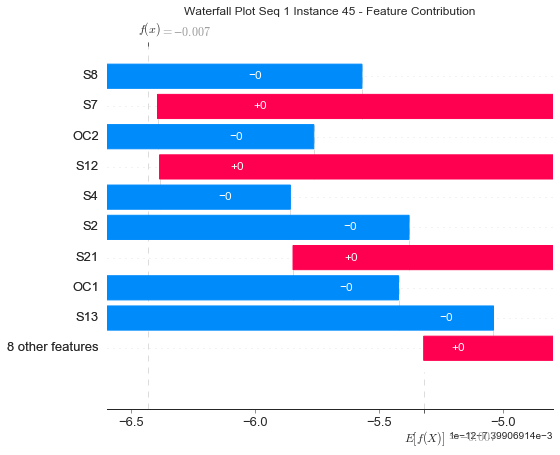

None

Contribution: [ 1.79867988e-13  6.87245793e-16  0.00000000e+00 -5.93183949e-14
  2.39625451e-15 -1.63601595e-13 -2.95119865e-14 -3.08888115e-14
 -1.30943543e-14 -4.23979530e-14 -7.35779371e-14 -1.52338537e-15
  3.16279392e-14 -1.78262610e-13  1.04150714e-14 -9.35723141e-15
 -7.59324922e-14]


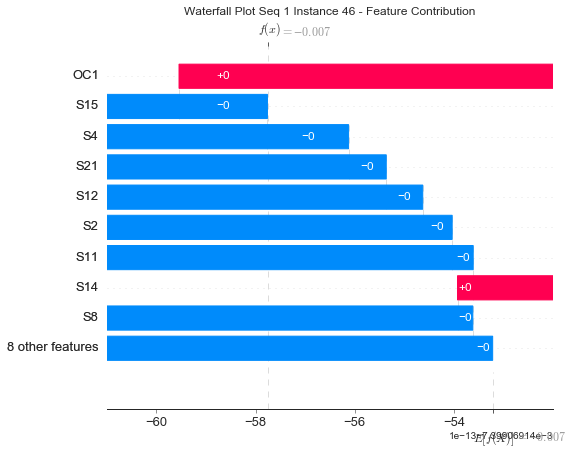

None

Contribution: [-1.64905763e-12 -2.46461136e-13  0.00000000e+00  2.58676761e-12
 -1.62972500e-12 -2.64131273e-12  1.29902165e-12  9.19351509e-13
  4.21760771e-13 -1.44385361e-12  1.74521671e-12 -8.14069654e-16
  2.04423728e-14  4.41232418e-13 -1.70471948e-12  4.71466453e-13
  1.34540328e-12]


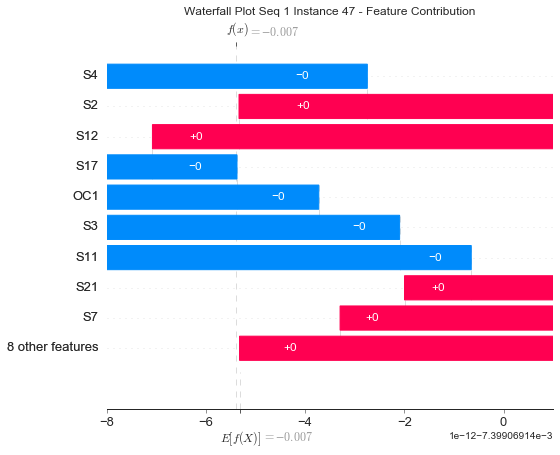

None

Contribution: [-1.91742715e-12 -8.68711949e-13  1.36418220e-13  1.37720293e-12
 -5.40084091e-13 -1.75895160e-12  1.18078008e-12 -1.56050018e-13
  2.36136821e-13  2.79343633e-13  1.21497278e-12 -1.37512343e-13
 -1.65865910e-13  3.24891562e-13 -6.06432385e-13  3.41360702e-13
  1.07459657e-12]


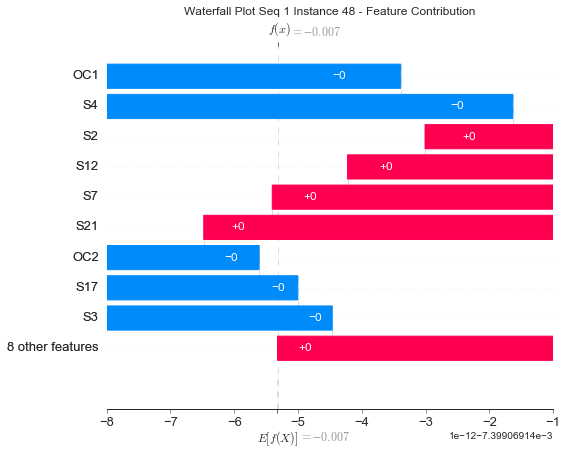

None

Contribution: [-1.36065584e-13 -4.87234927e-13  0.00000000e+00 -1.19218838e-12
  3.23076147e-13 -4.18618482e-13  2.33612798e-13 -3.68124612e-13
 -2.28780997e-13 -2.88007628e-13 -1.48174879e-14 -1.20747162e-15
 -1.99296322e-13  1.47344864e-12  3.59466986e-13  2.69078396e-14
  4.47292248e-14]


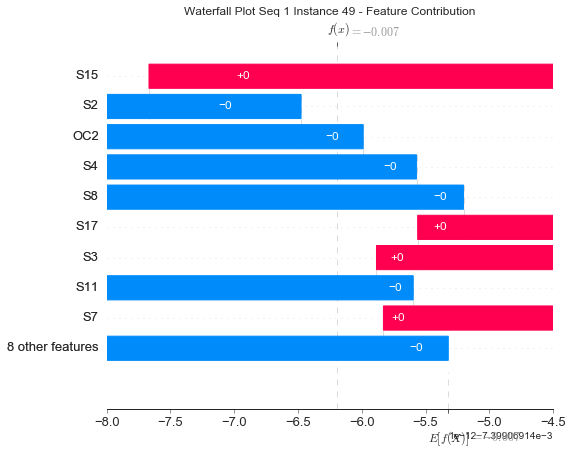

None

Contribution: [ 1.30468553e-14 -4.97553279e-13  8.20899772e-13 -1.23902483e-12
  8.69038999e-13  3.77945152e-13  2.81031742e-14 -1.01107219e-12
 -1.51533652e-13  8.48394759e-13 -2.20463472e-13 -7.98160908e-13
  1.51067892e-13 -3.93219772e-13  8.56207846e-13 -7.84192047e-14
 -2.28187396e-13]


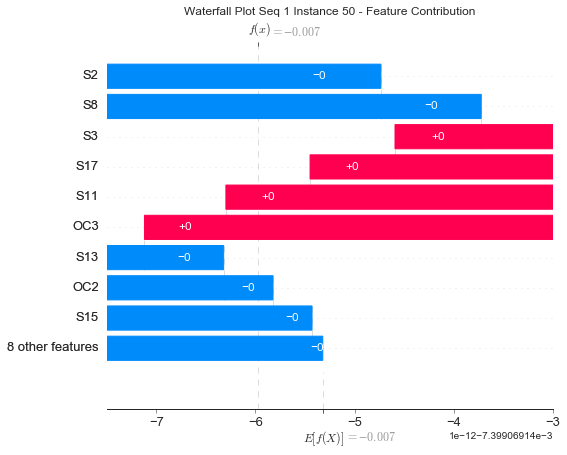

None

Contribution: [ 6.43503642e-13 -1.30405140e-13  4.64108949e-13 -2.70902051e-12
  2.73042569e-12  3.64359714e-12 -8.40395570e-13 -2.72287488e-12
 -5.56695857e-13  3.70829062e-12 -1.07586683e-12 -1.47845408e-12
  3.10681087e-13 -4.74120613e-12  3.03167777e-12 -2.54682424e-13
 -8.69140805e-13]


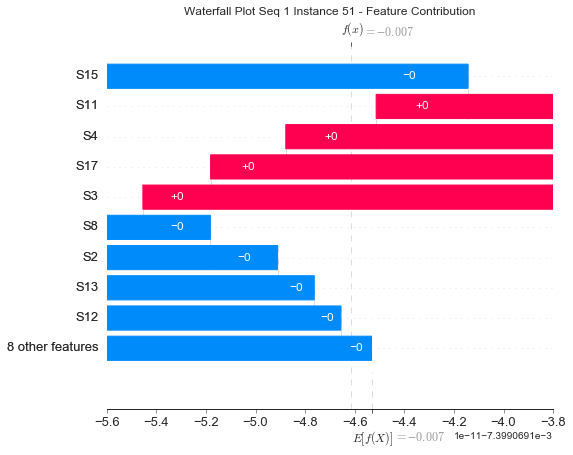

None

Contribution: [-5.13011834e-13 -3.02617415e-13  0.00000000e+00  7.57136541e-13
 -5.51539500e-13 -1.44316135e-12  5.98955401e-13  2.81575571e-13
  1.48959959e-13 -9.41168476e-13  7.02432307e-13 -2.79388227e-15
 -5.71417506e-14  5.84118311e-13 -6.97914274e-13  2.31191097e-13
  4.68661351e-13]


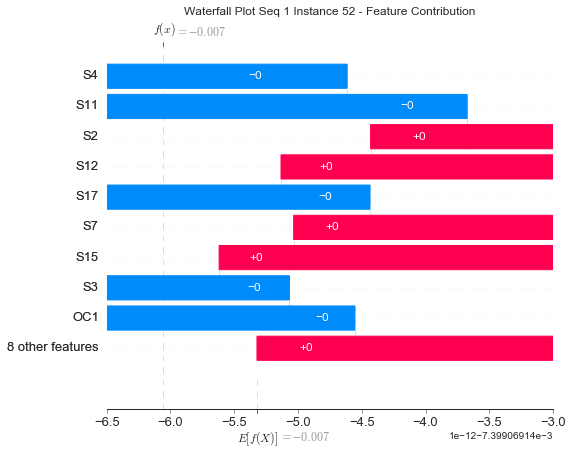

None

Contribution: [-2.24825800e-12 -8.82504464e-13  1.90467325e-13  2.39054306e-12
 -1.87148235e-12 -3.73071843e-12  1.46451048e-12  1.02572378e-12
  5.33569770e-13 -2.25988759e-12  2.31132908e-12  1.21509722e-13
  3.96131966e-14  2.40929911e-12 -1.87062388e-12  6.58823094e-13
  1.41769398e-12]


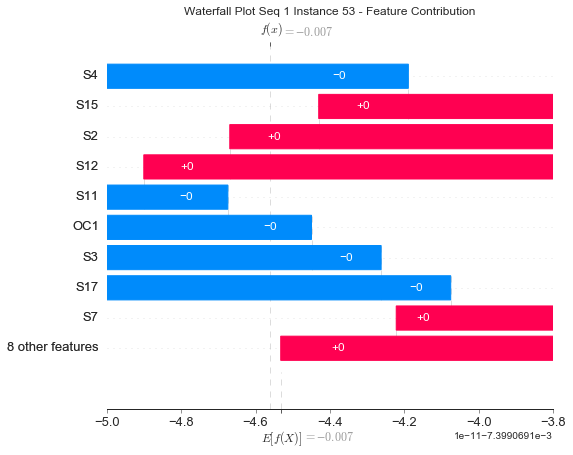

None

Contribution: [-2.14548485e-13  2.66565009e-13  9.92109701e-14  1.38733513e-12
 -4.63957269e-13 -8.65423943e-13  2.53926437e-13  3.23207254e-13
  2.34362036e-13 -5.13013297e-13  5.04951766e-13 -1.30327850e-13
  2.02474674e-13 -1.20949702e-12 -6.35643068e-13  1.51057633e-13
  2.61464868e-13]


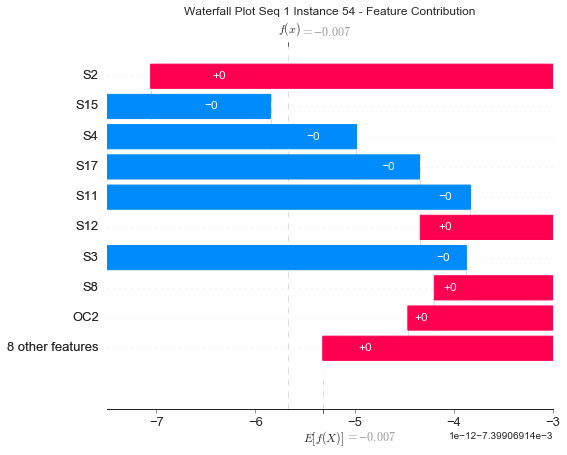

None

Contribution: [-5.86497864e-13 -3.78064144e-13  0.00000000e+00  9.41557813e-13
 -5.28771037e-13 -1.38669859e-12  5.45964532e-13  2.89647809e-13
  1.63774620e-13 -8.33790773e-13  8.52992156e-13 -7.50121631e-16
 -1.39953001e-14  4.46511805e-13 -7.85965477e-13  2.77998599e-13
  4.53502877e-13]


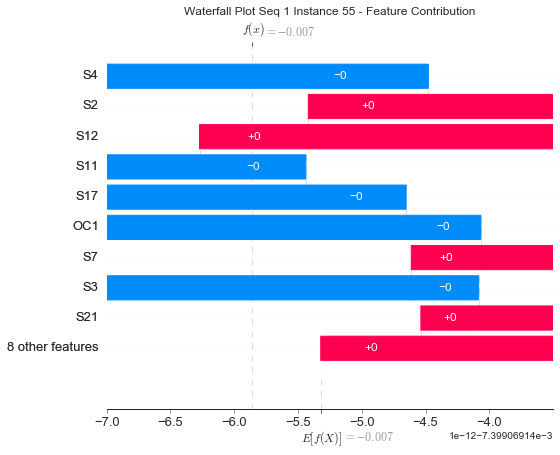

None

Contribution: [ 6.56038537e-13  7.67107732e-13  8.98447170e-14  4.77620764e-13
 -4.87691010e-14  9.10399035e-13 -3.96690656e-13  4.94483808e-14
 -9.22031362e-15  4.59848197e-13 -4.22337350e-13 -9.66607369e-14
  3.76613508e-13 -2.48235070e-12 -4.25535868e-14 -1.17146622e-13
 -3.39683631e-13]


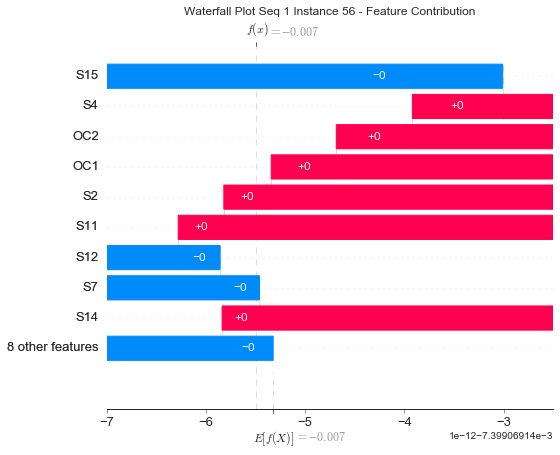

None

Contribution: [ 8.37793159e-13  4.24638542e-13  1.18397913e-13 -1.06406984e-12
  7.24261688e-13  1.54243187e-12 -6.88570945e-13 -4.29046149e-13
 -2.03409270e-13  7.21089963e-13 -1.11963336e-12 -9.78481619e-14
  1.02998712e-13 -9.57663853e-13  7.03847408e-13 -3.50114848e-13
 -5.47723650e-13]


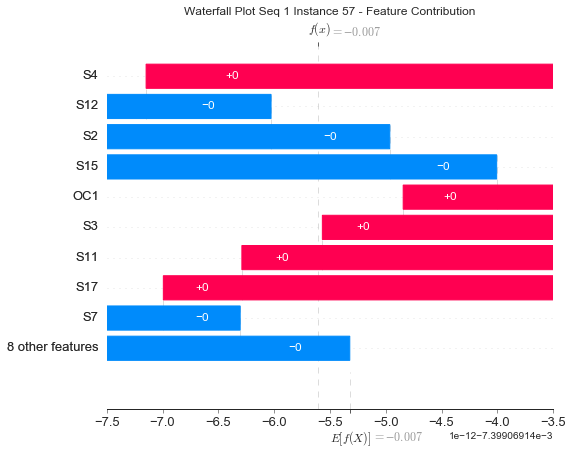

None

Contribution: [-2.90585763e-12 -1.58680610e-12  0.00000000e+00  3.95678065e-12
 -2.94574716e-12 -6.25528232e-12  2.73887792e-12  1.44476781e-12
  7.97256792e-13 -3.37827596e-12  4.04317465e-12 -1.08187146e-15
 -6.21909547e-14  3.24857784e-12 -3.28876423e-12  1.22498810e-12
  2.15346144e-12]


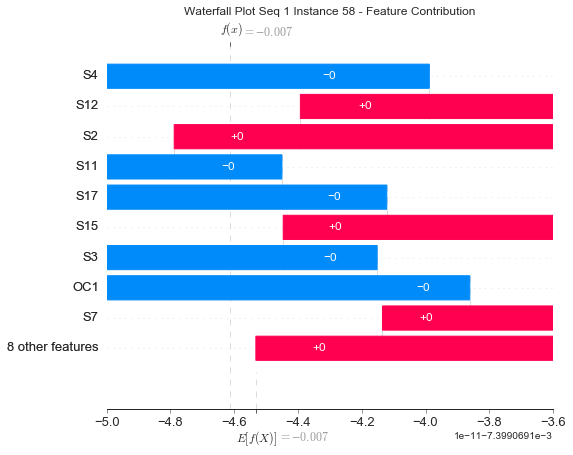

None

Contribution: [-2.29272135e-12 -1.02035914e-12  0.00000000e+00  2.44227880e-12
 -1.79563927e-12 -4.25761683e-12  1.56901358e-12  8.73896116e-13
  5.95747139e-13 -2.29752003e-12  2.42209833e-12 -4.22635533e-16
 -1.78872067e-13  3.41303158e-12 -1.82876284e-12  6.72576198e-13
  1.38556137e-12]


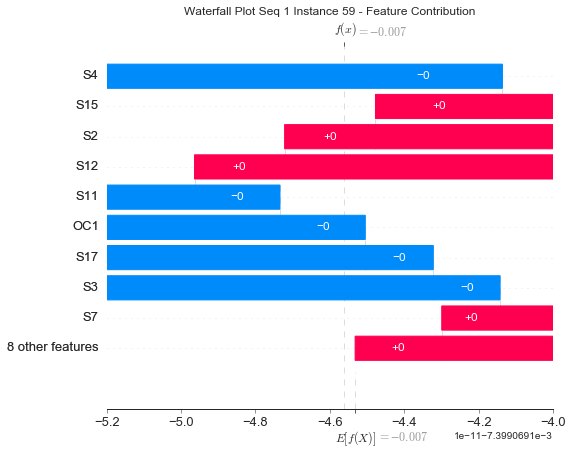

None

Contribution: [-1.74345076e-12 -1.59988993e-13  0.00000000e+00  3.83481398e-12
 -2.02338623e-12 -3.46948512e-12  1.33534221e-12  1.32511515e-12
  7.33783639e-13 -2.06913089e-12  2.05428426e-12 -1.18299925e-15
  2.97007021e-14  5.32339797e-13 -2.26479209e-12  5.44640234e-13
  1.39904104e-12]


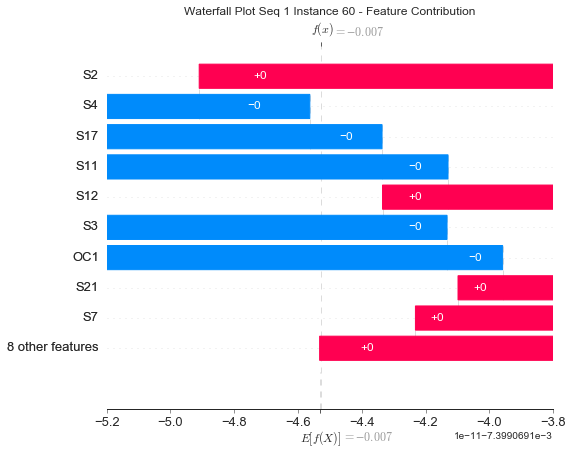

None

Contribution: [-8.93186621e-13 -4.60561222e-13  1.56668656e-12 -1.38590441e-12
  2.52067941e-12  3.31596317e-12 -2.18591380e-13 -2.96947558e-12
 -2.13780260e-13  4.59627215e-12 -5.45690229e-13 -2.23847113e-12
  5.46819426e-13 -6.20929697e-12  2.47747916e-12 -1.80403096e-13
 -1.44168640e-13]


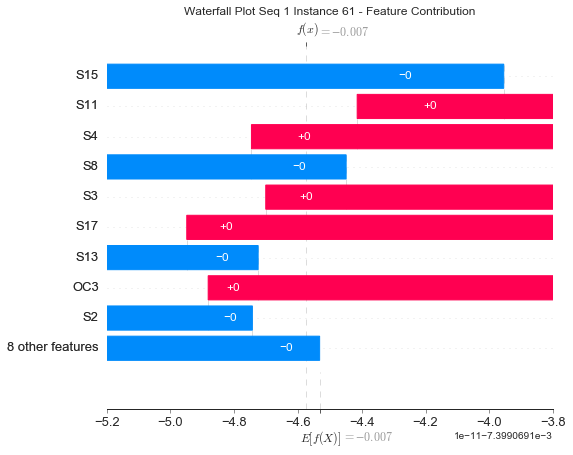

None

Contribution: [ 1.26209254e-12  6.91327258e-13  1.66772154e-13 -1.53052842e-12
  9.17406992e-13  2.10865049e-12 -1.00536528e-12 -4.02461023e-13
 -3.63557193e-13  7.39681645e-13 -1.53655452e-12 -1.09690611e-13
  2.07753113e-13 -1.35719636e-12  7.81730529e-13 -4.46135018e-13
 -8.22310969e-13]


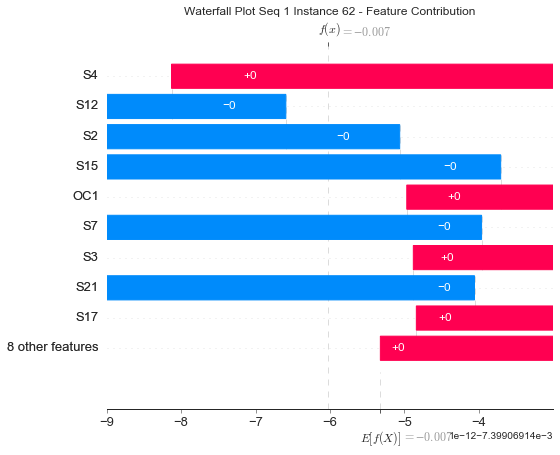

None

Contribution: [-1.79568776e-13 -4.14231691e-13  1.28075035e-12 -2.22922960e-12
  3.05123852e-12  3.72931417e-12 -6.08423630e-13 -3.42377363e-12
 -3.72730492e-13  4.93486935e-12 -7.46057025e-13 -2.31959309e-12
  6.31910594e-13 -6.36389162e-12  3.23267541e-12 -2.00567671e-13
 -6.24150579e-13]


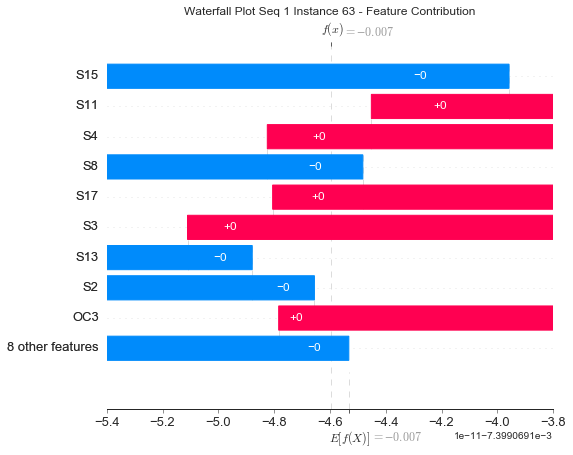

None

Contribution: [-1.58342079e-12 -1.16862357e-12 -3.33629613e-15  5.72328372e-13
 -9.55229710e-13 -3.15185703e-12  9.18295279e-13  4.43096731e-13
  2.57080300e-13 -1.84632388e-12  1.28267492e-12  2.07058369e-13
 -3.04421717e-13  4.07285924e-12 -1.05878359e-12  3.41505172e-13
  8.43187878e-13]


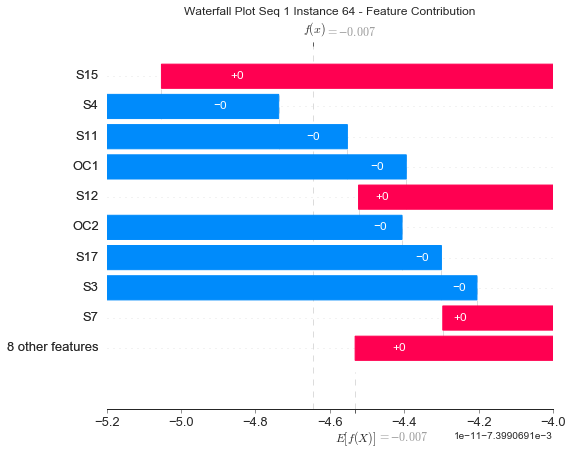

None

Contribution: [-8.45771099e-13  5.88238158e-14 -4.82342505e-14  4.40224409e-13
 -4.57879123e-13 -5.48849215e-13  1.47775658e-13  2.92850976e-13
  1.16545194e-14 -1.66510658e-13  3.51631647e-13  7.84296334e-14
  1.15756946e-13  2.37382623e-13 -4.15011070e-13  2.19220089e-14
  3.88230924e-13]


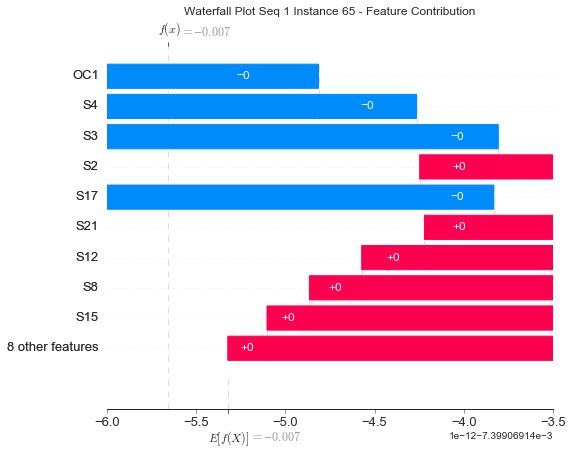

None

Contribution: [ 8.02702292e-14  3.59010158e-13 -4.81764388e-14 -5.38255150e-13
  5.51978473e-14  1.08821882e-12 -3.79047027e-13 -5.29771198e-16
 -2.05982990e-13  4.11610931e-13 -5.95835718e-13  9.87077783e-14
  1.39587235e-13 -4.30955808e-13  3.22347699e-13 -2.22098490e-13
 -1.60347538e-13]


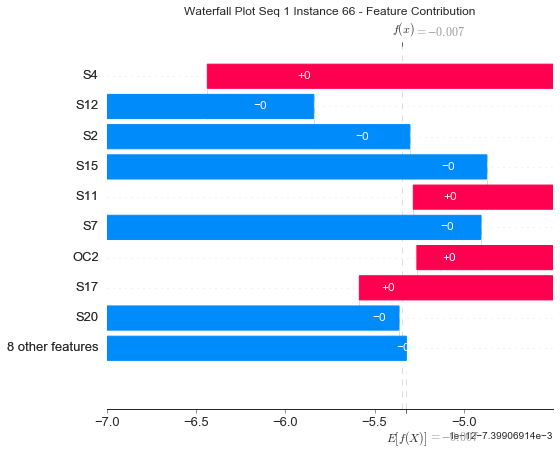

None

Contribution: [ 1.61716712e-12  1.89302979e-12  0.00000000e+00  8.15810567e-14
  4.07131279e-13  2.36634735e-12 -1.35802556e-12 -1.74128527e-14
 -1.58162817e-13  1.26478515e-12 -1.63679920e-12 -9.53334523e-16
  5.78689928e-13 -4.89674100e-12  7.14958474e-13 -5.73047740e-13
 -1.04211279e-12]


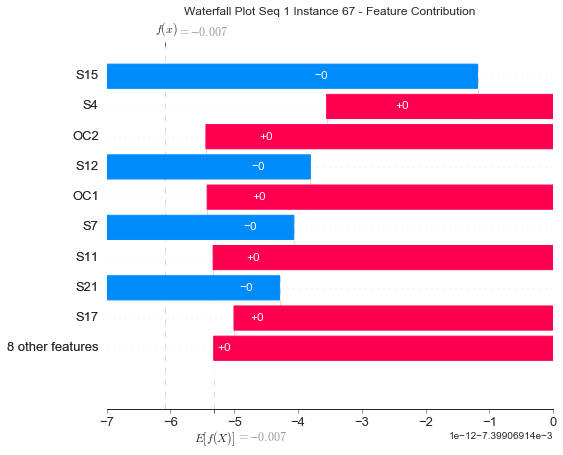

None

Contribution: [-2.07416354e-12 -8.91968465e-13  0.00000000e+00  1.91858660e-12
 -1.40012221e-12 -3.73698685e-12  1.43110502e-12  6.79383036e-13
  4.12194205e-13 -2.20402841e-12  2.02119419e-12  1.51242947e-16
 -1.74297710e-13  2.83336137e-12 -1.39075849e-12  5.93291746e-13
  1.28971540e-12]


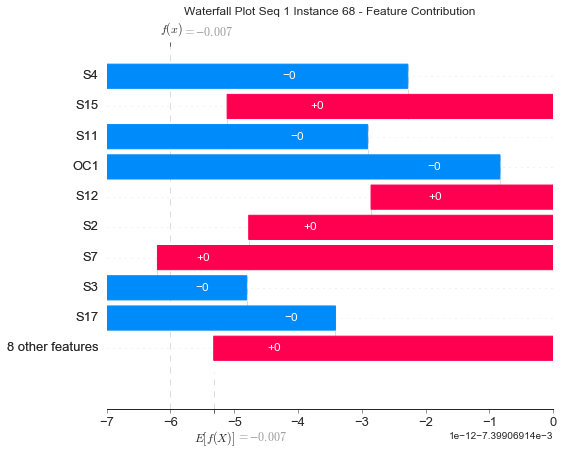

None

Contribution: [-4.43580909e-13  1.15676850e-13 -4.30457970e-13  1.64152665e-12
 -1.14610209e-12 -1.53966412e-12  5.60293673e-13  1.12804026e-12
  1.94472829e-13 -1.40158208e-12  5.13630913e-13  6.63200506e-13
 -5.86399283e-14  7.73015983e-13 -1.35102725e-12  1.70279128e-13
  5.71539289e-13]


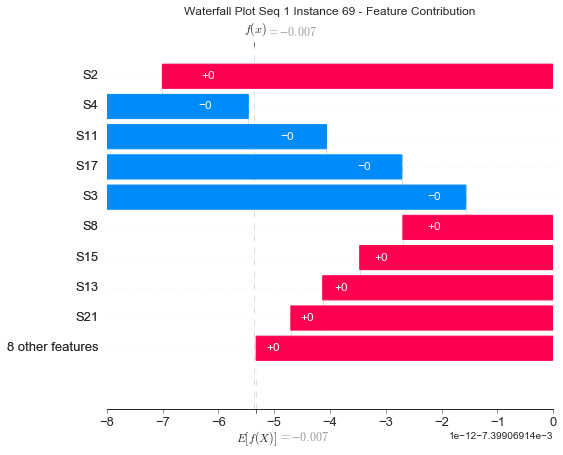

None

Contribution: [-1.28764208e-12 -4.87637491e-13 -6.08917322e-13  2.57486263e-12
 -3.18471573e-12 -5.87106405e-12  7.02162775e-13  3.37481302e-12
  8.31260082e-13 -5.85587655e-12  1.36046339e-12  2.16840369e-12
 -3.85729155e-13  9.93445257e-12 -4.11143558e-12  2.35413278e-13
  9.05762661e-13]


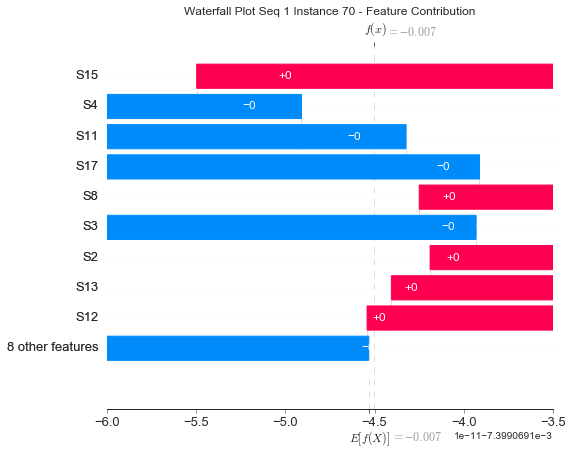

None

Contribution: [-2.44592367e-12 -1.21049503e-12  2.37285864e-12 -1.27191627e-12
  4.54525783e-12  4.98889385e-12 -3.20924981e-13 -5.12772984e-12
 -8.78474810e-15  8.84097916e-12 -3.04673875e-13 -3.84109628e-12
  1.18367404e-12 -1.15220264e-11  4.48853064e-12 -2.01522894e-13
 -1.39191881e-13]


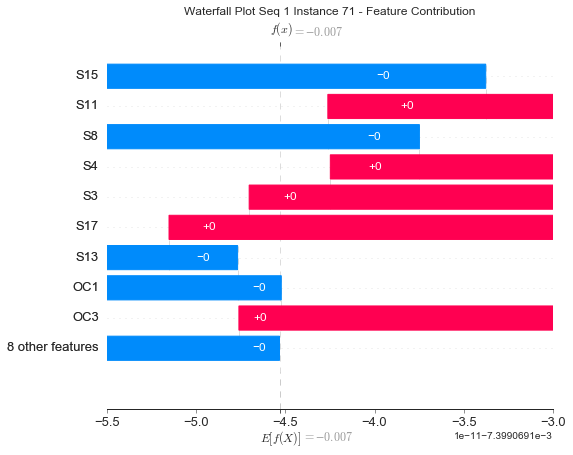

None

Contribution: [-1.28866508e-13  2.76689397e-13 -1.27159093e-13  7.62014895e-14
 -3.42805320e-13 -9.96307854e-13 -2.63064364e-13  5.35726249e-13
  5.75022004e-14 -1.23829072e-12 -4.99300362e-13  4.39433944e-13
 -5.95634246e-14  1.67946538e-12 -5.24262762e-13 -1.91805596e-13
 -3.66622321e-14]


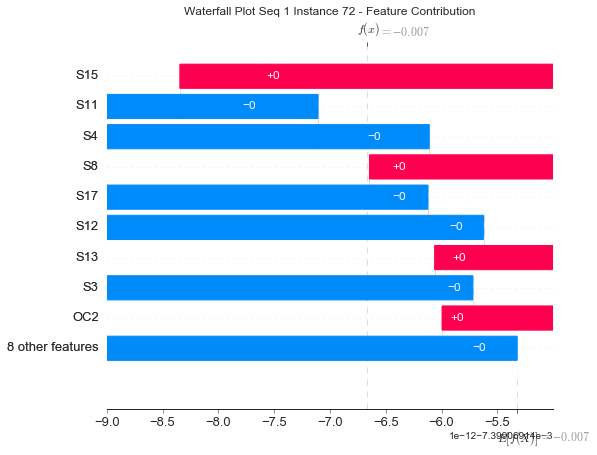

None

Contribution: [ 3.21304116e-12  3.29503541e-13  0.00000000e+00 -5.13007085e-12
  3.34123484e-12  4.82776926e-12 -2.16969086e-12 -1.89031082e-12
 -9.77135148e-13  2.60855400e-12 -3.34118171e-12 -6.50963751e-15
  2.18257944e-14 -1.27616461e-12  3.36097686e-12 -8.14021485e-13
 -2.36062168e-12]


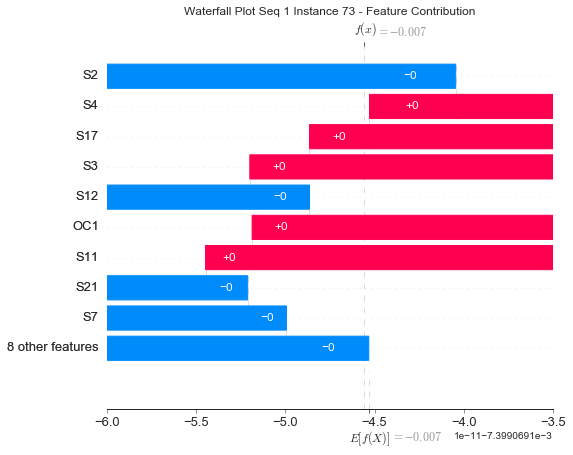

None

Contribution: [ 1.22582879e-12  5.56063984e-13 -1.04639591e-13 -1.42987044e-12
  7.44825154e-13  2.03990926e-12 -8.71191899e-13 -2.10947525e-13
 -4.39761536e-13  7.15375946e-13 -1.48118703e-12  1.62020936e-13
  1.56085499e-13 -9.66343650e-13  9.15620986e-13 -4.54129356e-13
 -7.56076625e-13]


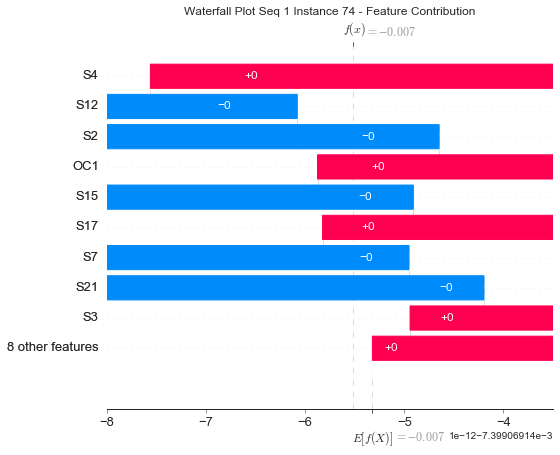

None

Contribution: [-8.38835403e-13 -4.75353643e-13  2.72868772e-12 -2.99178651e-12
  5.94747342e-12  7.70412120e-12 -1.61179848e-12 -6.01015895e-12
 -3.26960301e-13  1.04573945e-11 -1.47739525e-12 -4.37869532e-12
  1.72423761e-12 -1.48270944e-11  5.92102062e-12 -6.39954994e-13
 -1.38470030e-12]


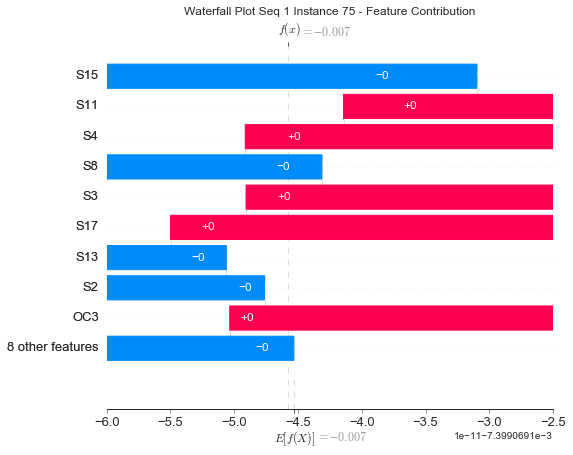

None

Contribution: [ 6.87110655e-12  2.19609248e-12 -3.66886697e-13 -6.44571852e-12
  3.86017130e-12  8.84729789e-12 -4.47446247e-12 -1.60344470e-12
 -1.50673289e-12  3.32353264e-12 -6.80664466e-12  5.53346594e-13
  1.76971488e-13 -5.11621691e-12  4.57814515e-12 -1.80638512e-12
 -4.32100536e-12]


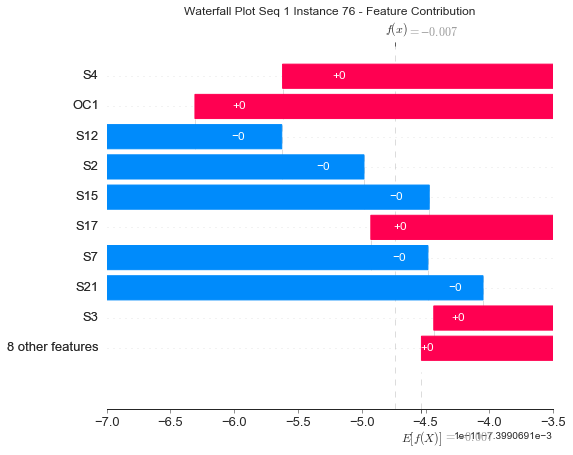

None

Contribution: [ 6.16429217e-13  1.73948865e-12 -1.50550945e-13  2.22387083e-12
 -1.09160326e-12  4.87824733e-13 -3.15054352e-13  1.21471377e-12
  1.53138678e-13 -5.29672877e-13 -6.27833777e-13  3.66296457e-13
  5.32311716e-13 -3.70495301e-12 -1.01224400e-12 -2.75701364e-13
  9.26437068e-14]


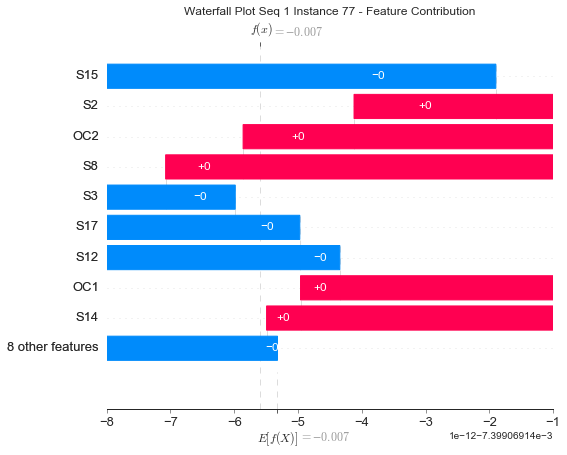

None

Contribution: [ 4.89811880e-12  1.52901411e-12 -1.77717769e-12 -2.32408840e-12
 -8.61366859e-13  8.67482681e-13 -1.61996848e-12  2.17917242e-12
 -7.86674708e-13 -4.20061468e-12 -2.48990325e-12  2.22127742e-12
 -5.03126945e-13  4.42269095e-12 -5.91695096e-13 -4.85560106e-13
 -1.96319935e-12]


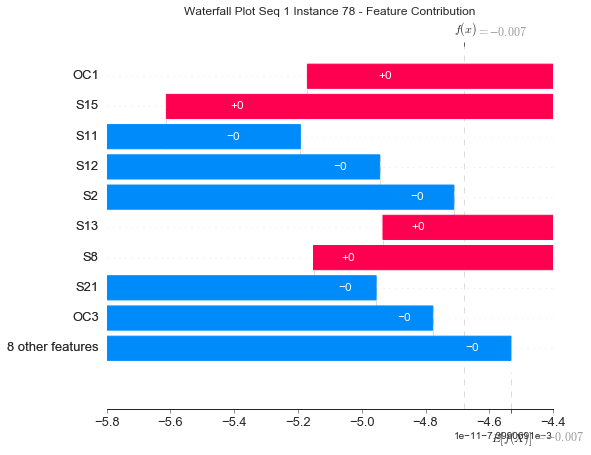

None

Contribution: [ 3.37552165e-12  1.26108596e-12 -3.30579639e-13 -3.48834395e-12
  2.13969250e-12  5.32126817e-12 -2.24395936e-12 -7.41317327e-13
 -8.69414512e-13  1.56398852e-12 -3.75082951e-12  4.18472006e-13
  1.29482308e-13 -2.03306751e-12  2.52390123e-12 -8.52253489e-13
 -2.02757819e-12]


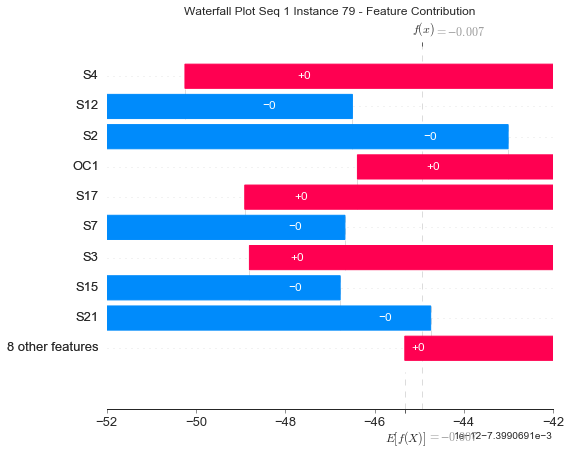

None

Contribution: [-1.38365415e-12 -2.80296653e-14  0.00000000e+00  1.36817456e-12
 -1.25340114e-12 -5.97509618e-13  3.14503550e-13  4.40800987e-13
  2.23957598e-13 -4.54388670e-13  9.57909858e-13 -1.21609981e-15
  9.85625156e-14  4.82416353e-13 -1.11707605e-12  1.20769212e-13
  5.41868145e-13]


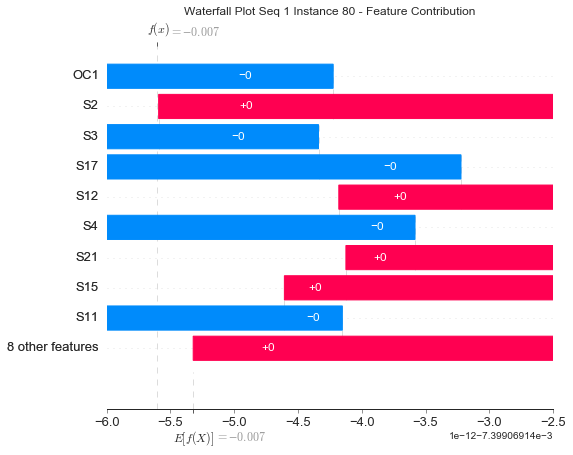

None

Contribution: [ 6.68241330e-12  2.08650957e-12 -1.32184899e-12 -4.85345878e-12
  1.51300435e-12  5.47427381e-12 -3.00991393e-12  8.14216750e-13
 -1.32120595e-12 -1.39183012e-12 -5.01676218e-12  1.71325335e-12
 -2.22258667e-13  7.20132667e-13  1.52516715e-12 -1.23392279e-12
 -3.04667055e-12]


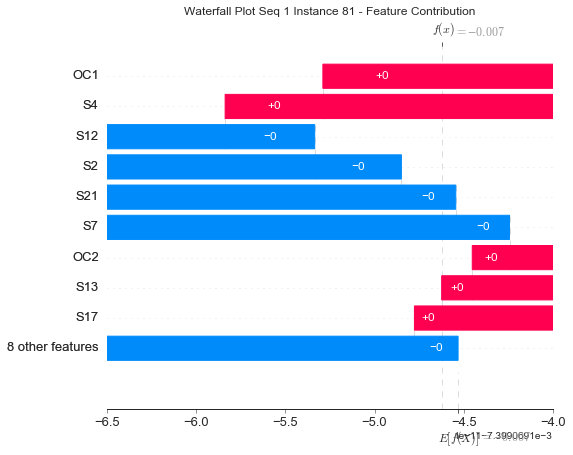

None

Contribution: [-2.06396141e-12 -4.50947195e-13  0.00000000e+00  1.87419524e-12
 -1.14626429e-12 -2.84462688e-12  1.22949101e-12  7.53740928e-13
  4.31754648e-13 -1.31799779e-12  1.73858790e-12  2.95972873e-16
 -7.75430406e-14  2.16341116e-12 -1.80126020e-12  4.95559106e-13
  1.39513162e-12]


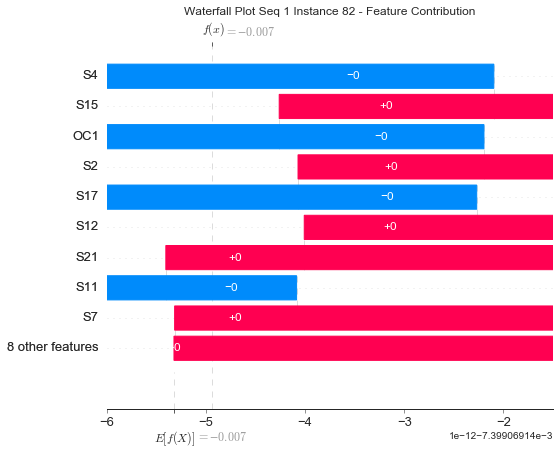

None

Contribution: [-1.39922622e-12 -8.58743523e-13  2.54933813e-12 -5.41812255e-13
  2.89451341e-12  3.26333014e-12  1.49512808e-13 -3.78202981e-12
  1.26536260e-13  5.67127595e-12  1.47203430e-13 -2.93878854e-12
  9.63355589e-13 -8.42500028e-12  2.91249663e-12  7.28761466e-14
  6.01608810e-14]


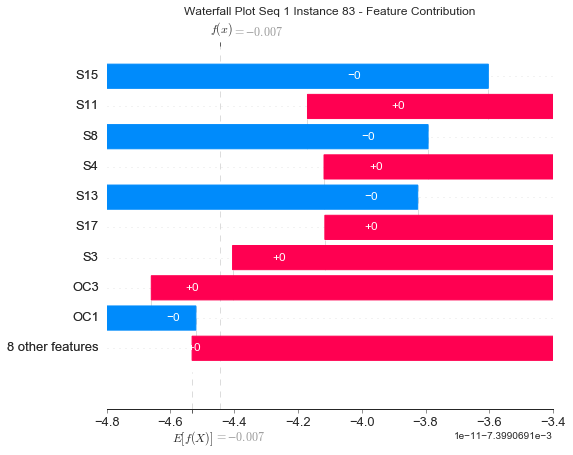

None

Contribution: [-2.40772354e-12  1.44190364e-13 -2.45171548e-12  8.70087162e-12
 -8.34003439e-12 -1.19605150e-11  2.71039549e-12  7.88499561e-12
  1.78558600e-12 -1.19736131e-11  4.16678150e-12  4.62848293e-12
 -8.53803844e-13  1.36421716e-11 -9.24492947e-12  9.54105393e-13
  2.83414156e-12]


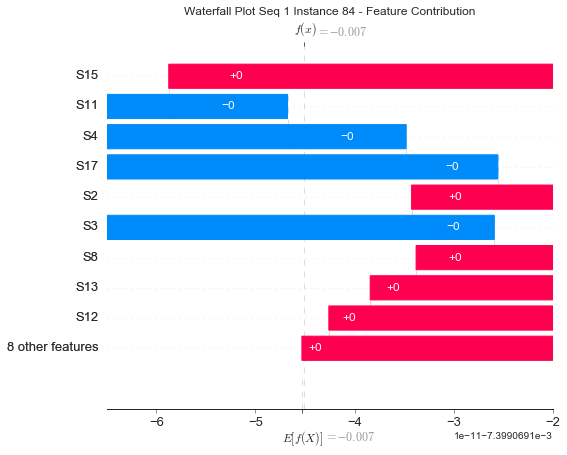

None

Contribution: [-2.41917760e-13  1.60463480e-13 -2.75713935e-12  3.64629117e-12
 -6.23409484e-12 -8.67661585e-12  1.65592334e-12  6.12309162e-12
  5.87809098e-13 -1.16153068e-11  3.04938670e-12  3.86126938e-12
 -1.16991974e-12  1.50525165e-11 -6.27314129e-12  8.55675123e-13
  1.38240125e-12]


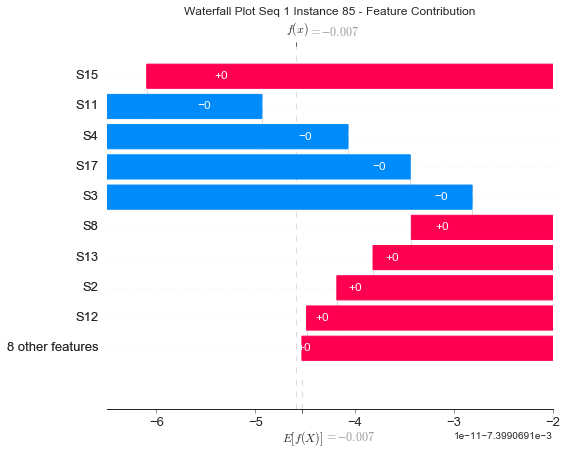

None

Contribution: [ 3.15472670e-12  2.34370834e-12  3.83506681e-12 -7.51250017e-12
  1.12500625e-11  1.86876296e-11 -5.75411246e-12 -9.72399418e-12
 -1.35655029e-12  1.70760593e-11 -7.62687656e-12 -7.01242927e-12
  3.14590758e-12 -2.53230614e-11  1.20511960e-11 -2.30832779e-12
 -4.56906952e-12]


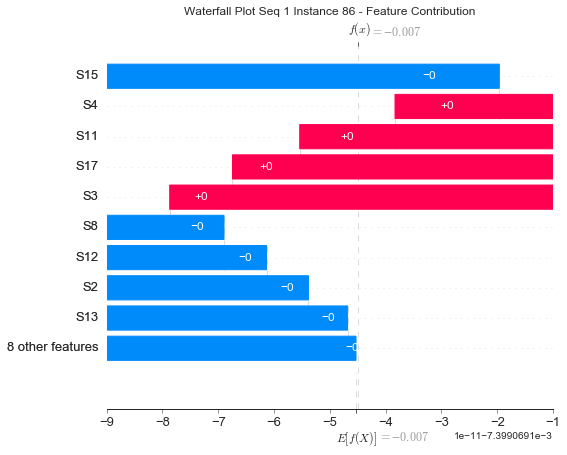

None

Contribution: [ 4.76891183e-12  4.07618031e-13  0.00000000e+00 -7.70558530e-12
  4.60438285e-12  7.28038203e-12 -3.75108061e-12 -2.82555186e-12
 -1.36856488e-12  3.75954606e-12 -5.27790225e-12 -6.30581386e-15
 -1.45127617e-13 -1.26074108e-12  5.07370231e-12 -1.46132607e-12
 -3.95422887e-12]


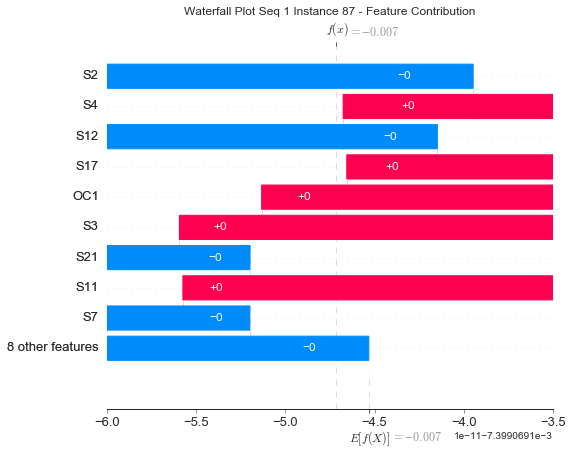

None

Contribution: [-7.26379026e-12 -2.11590836e-12  0.00000000e+00  7.54103377e-12
 -5.74389494e-12 -1.18845316e-11  5.35314544e-12  2.74802251e-12
  1.58440568e-12 -6.30248458e-12  8.01625780e-12  5.32384432e-15
 -3.99084357e-13  7.76219193e-12 -6.57444498e-12  2.33323625e-12
  5.03121286e-12]


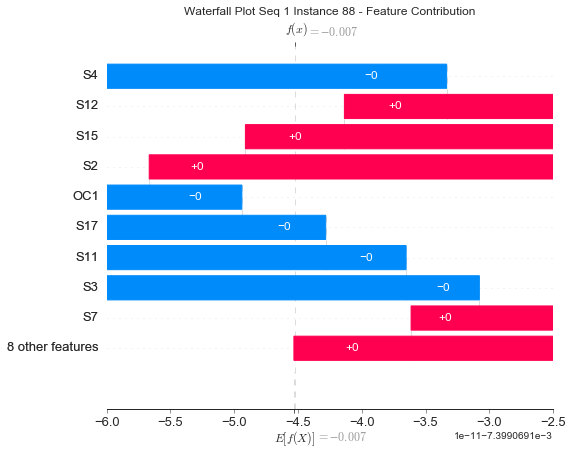

None

Contribution: [-9.91790070e-12 -3.40226024e-12 -1.77956283e-12  1.51942729e-11
 -1.46736113e-11 -2.48155524e-11  9.72252140e-12  9.76135405e-12
  2.89386375e-12 -1.74975243e-11  1.35958172e-11  4.57125960e-12
 -1.95075054e-12  2.16686148e-11 -1.57822453e-11  3.63837129e-12
  8.59399010e-12]


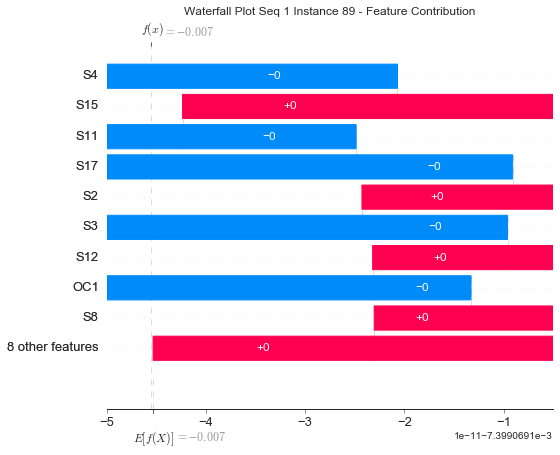

None

Contribution: [-5.06750761e-12 -1.45024119e-12  0.00000000e+00  5.77368448e-12
 -3.63707610e-12 -8.28840642e-12  3.23362539e-12  2.08562074e-12
  1.33410622e-12 -3.84221994e-12  6.12209936e-12 -3.43911576e-16
  2.34828111e-14  5.89798783e-12 -5.36514800e-12  1.48887825e-12
  2.78671552e-12]


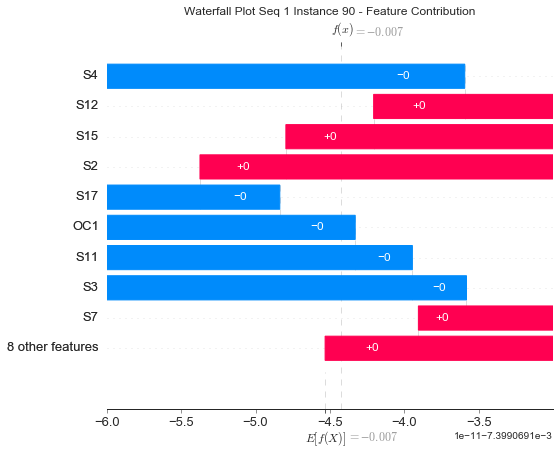

None

Contribution: [ 1.91037420e-12  9.66971186e-14  1.52085462e-12 -4.90532658e-12
  6.19958251e-12  9.39530224e-12 -3.05179861e-12 -4.47117473e-12
 -7.15584872e-13  9.51785872e-12 -4.35973306e-12 -2.02343350e-12
  4.52775540e-13 -1.20491195e-11  7.10134035e-12 -1.40335345e-12
 -2.79947333e-12]


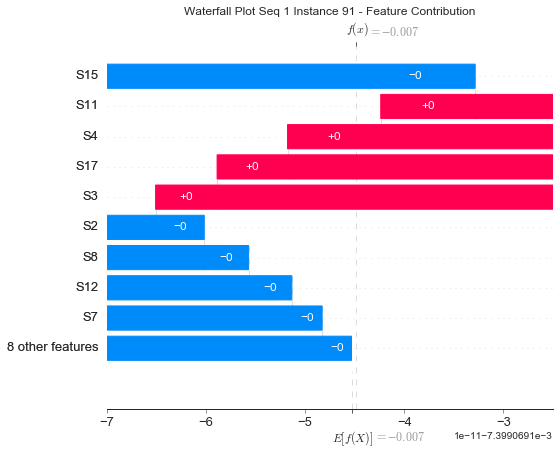

None

Contribution: [ 1.16623226e-12  2.58574493e-13  0.00000000e+00 -1.07941043e-12
  1.09688625e-12  2.11774652e-12 -7.67716511e-13 -3.95205082e-13
 -2.39022994e-13  1.00198701e-12 -1.08460604e-12  3.25553857e-16
  4.04677106e-14 -1.31795323e-12  9.29148902e-13 -3.19835304e-13
 -7.60506458e-13]


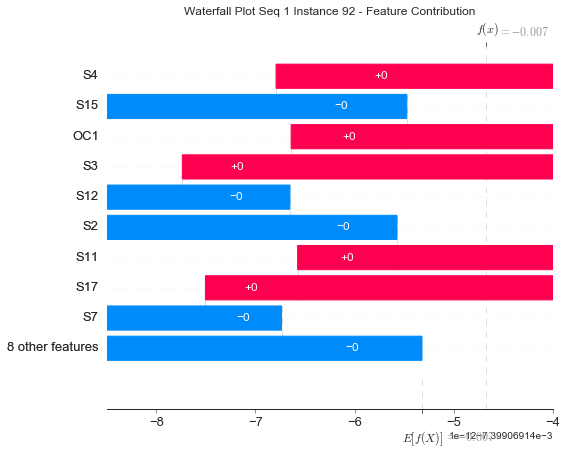

None

Contribution: [-4.04763376e-12 -3.59665726e-12  0.00000000e+00  3.73460984e-12
 -2.63816876e-12 -7.85935206e-12  3.71468004e-12  1.31212012e-12
  9.24743572e-13 -4.69115458e-12  5.51754909e-12 -3.74550854e-15
 -6.07654389e-13  6.91502931e-12 -3.68537839e-12  1.70239571e-12
  2.85024044e-12]


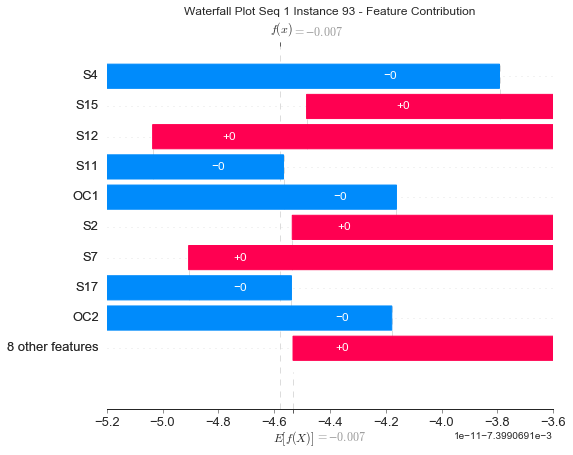

None

Contribution: [ 6.16206738e-12  3.38368374e-12  4.69381478e-12 -1.43555749e-11
  1.80155509e-11  2.93545362e-11 -8.11231290e-12 -1.46740727e-11
 -2.76657495e-12  2.58962140e-11 -1.15607636e-11 -1.08582032e-11
  2.97383125e-12 -3.50706929e-11  1.83587555e-11 -3.71978099e-12
 -6.43740443e-12]


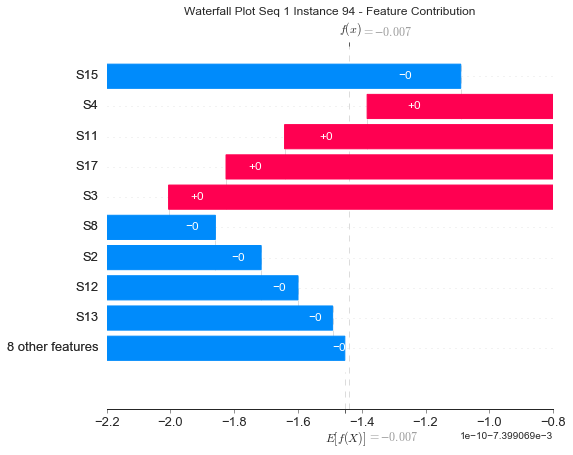

None

Contribution: [-5.46607594e-12 -5.27589777e-12  2.69587548e-13  3.05763769e-12
 -1.72512384e-12 -5.65058460e-12  4.89218865e-12 -6.07535615e-13
  5.69792531e-13 -9.36255956e-13  6.51635343e-12 -2.05896042e-12
 -3.20681849e-13  3.87228964e-12 -1.95103525e-12  2.12913714e-12
  3.53505398e-12]


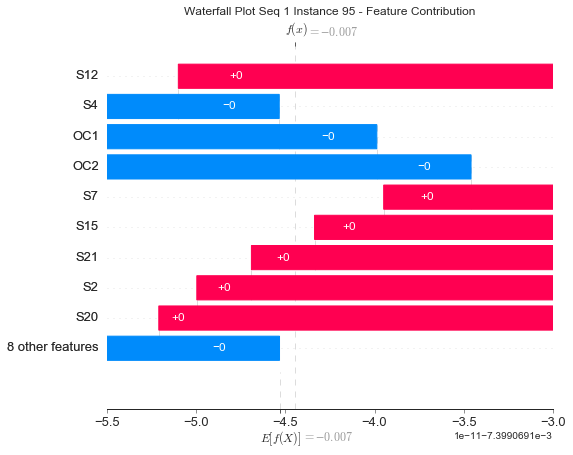

None

Contribution: [-3.79388188e-12 -2.46393075e-12  3.32398930e-12  8.14750014e-13
  1.97156028e-12 -8.53954928e-13  1.69069478e-12 -3.29227552e-12
  9.10238248e-13  4.28191423e-12  3.04074062e-12 -3.63506491e-12
  4.40276992e-13 -5.37491102e-12  7.26843932e-13  8.87030900e-13
  1.34773789e-12]


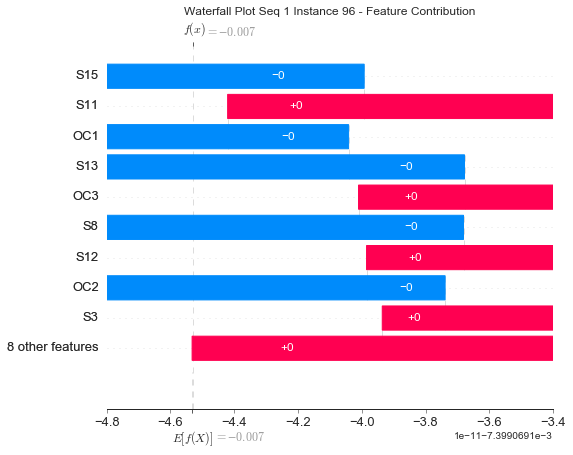

None

Contribution: [-8.97254406e-12 -5.51682094e-12  6.59290276e-13  5.36627340e-12
 -3.69545800e-12 -1.04488163e-11  6.71020184e-12 -1.78962395e-13
  1.23276476e-12 -3.23557587e-12  9.07848016e-12 -2.33507571e-12
 -9.03563032e-13  8.38699162e-12 -3.21519677e-12  3.00640394e-12
  5.64842183e-12]


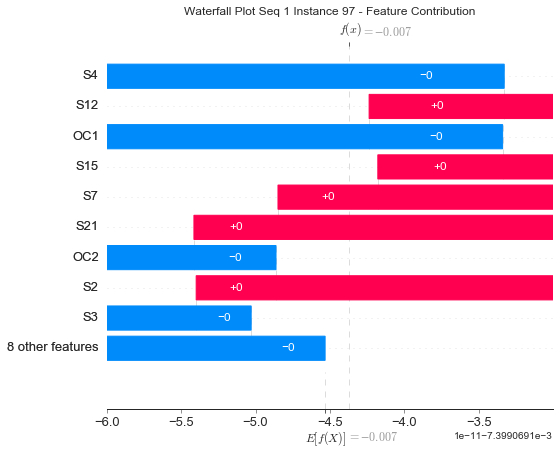

None

Contribution: [ 2.48419102e-12  3.52566088e-12  0.00000000e+00 -2.48884225e-12
  2.61358318e-12  8.76992489e-12 -3.70933015e-12 -1.01901777e-12
 -7.12664465e-13  3.70007367e-12 -5.52108359e-12  1.64192625e-15
  4.69686356e-13 -5.16311082e-12  3.18957924e-12 -1.80021514e-12
 -2.19320417e-12]


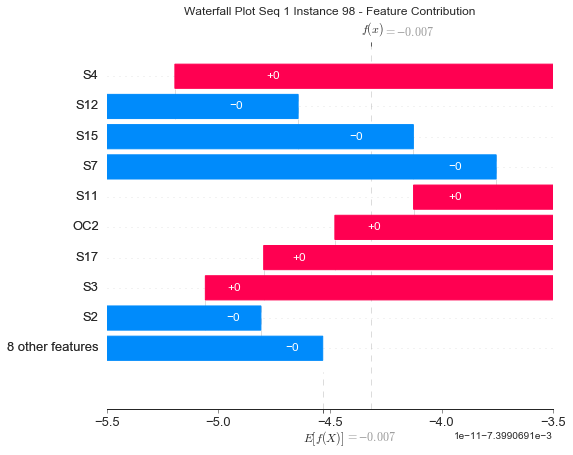

None

Contribution: [ 4.34584270e-12  2.14188671e-12 -4.42023545e-12  8.92007768e-13
 -5.94313227e-12 -5.44448254e-12 -1.04863018e-13  7.16703173e-12
 -5.07121580e-13 -1.19100042e-11 -1.33470532e-13  6.64180256e-12
 -1.54317368e-12  1.59620494e-11 -5.55337287e-12  1.28538727e-13
 -1.25855123e-13]


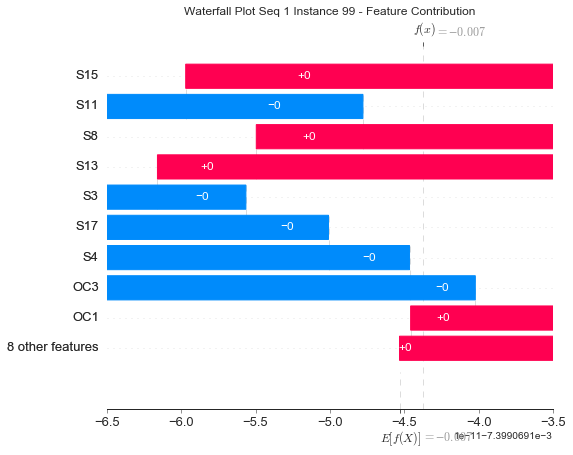

None

Contribution: [ 2.01446867e-12 -1.90654372e-12  0.00000000e+00 -5.76492716e-12
  3.50460134e-12  3.02406039e-12 -1.41114822e-12 -1.94591695e-12
 -7.69617660e-13  1.81230801e-12 -2.78859184e-12  5.60154577e-15
 -7.05247167e-13  2.65888548e-12  3.26279086e-12 -4.15014540e-13
 -1.65570541e-12]


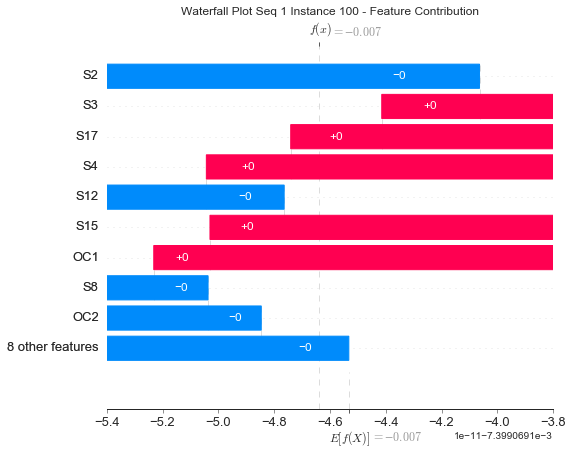

None

Contribution: [ 8.69813878e-13  3.46959739e-13  0.00000000e+00 -1.18726611e-12
  1.14257768e-12  2.02579988e-12 -7.83301538e-13 -4.02558764e-13
 -2.93187512e-13  2.00292755e-12 -1.17786846e-12  6.42993044e-15
  1.84671055e-14 -1.09324182e-12  1.41720956e-12 -4.03748215e-13
 -6.77021915e-13]


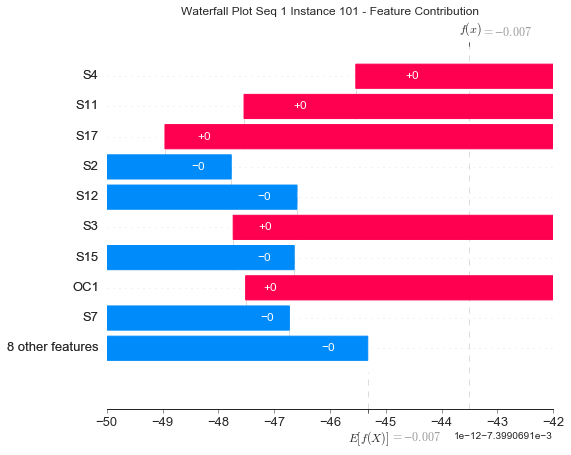

None

Contribution: [-5.74899199e-12  1.28533837e-12  0.00000000e+00  1.05700587e-11
 -6.55475977e-12 -8.59251299e-12  4.37641199e-12  3.81312126e-12
  1.94395910e-12 -5.09137697e-12  6.54583636e-12  8.85574302e-15
  4.39951732e-13  3.13930197e-13 -7.13393277e-12  1.89879427e-12
  4.51142639e-12]


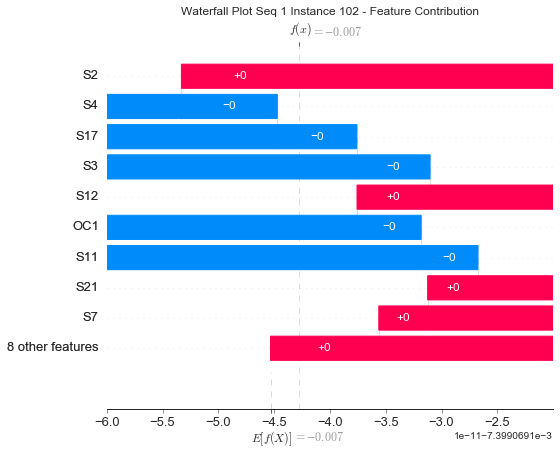

None

Contribution: [ 3.00039290e-12 -1.89460521e-13 -6.65559296e-13 -1.38178011e-12
  3.22594510e-15  1.18599683e-13 -3.26527542e-13  9.43300559e-13
 -2.94979969e-13 -1.63022569e-12 -1.00246027e-12  1.58491698e-12
 -4.69874519e-13  1.51325979e-12  1.23032459e-14  2.66687334e-13
 -1.26151260e-12]


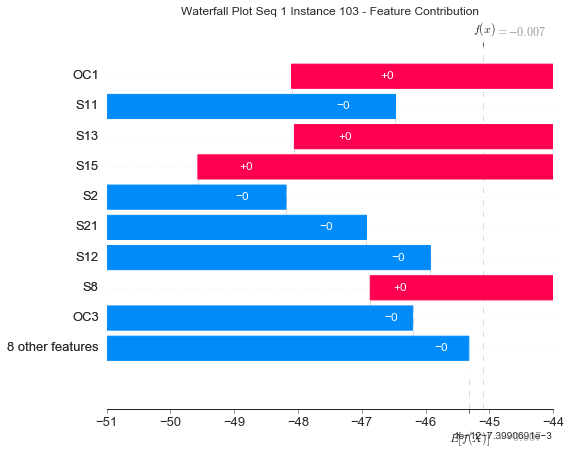

None

Contribution: [ 7.70627160e-13  4.84817319e-13  0.00000000e+00 -3.87764473e-12
  2.39413047e-12  5.00959387e-12 -2.08340723e-12 -1.24008009e-12
 -9.71916124e-13  3.17946017e-12 -3.28937745e-12  1.57042060e-14
  2.86817851e-13 -1.58368631e-12  3.59314705e-12 -8.63948453e-13
 -1.47279270e-12]


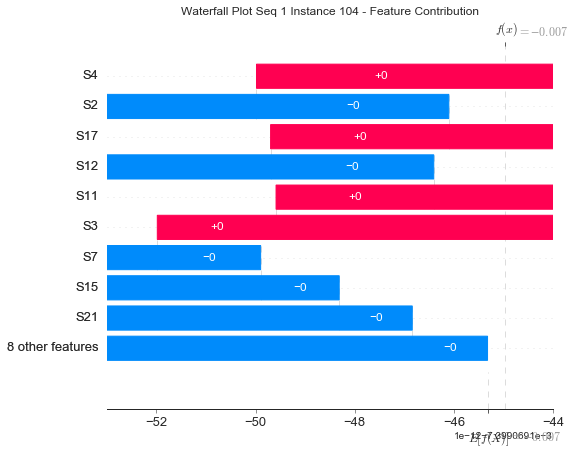

None

Contribution: [ 3.90342880e-12  2.37582046e-12 -7.00974435e-12  5.14712058e-12
 -1.35365920e-11 -1.61288309e-11  1.63628898e-12  1.39275987e-11
  8.14272478e-13 -2.47926974e-11  2.51603903e-12  1.10987998e-11
 -2.49389376e-12  3.31517695e-11 -1.34453490e-11  8.25216414e-13
  1.23749947e-12]


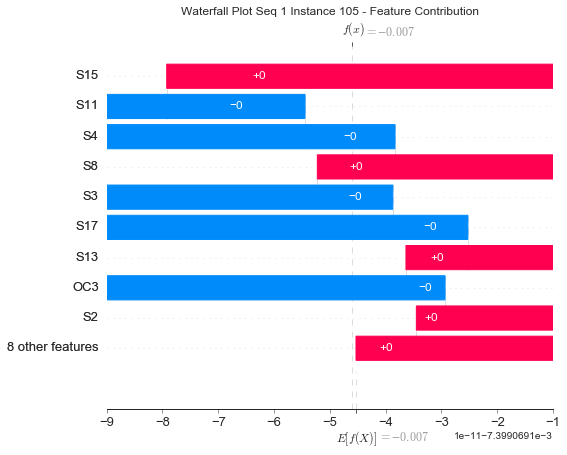

None

Contribution: [-3.23857542e-12 -3.24898225e-12 -4.39825303e-12  7.15301473e-12
 -1.16883126e-11 -1.97527342e-11  5.73238765e-12  1.16523327e-11
  1.55849953e-12 -1.95128427e-11  6.34499571e-12  1.01253545e-11
 -3.57338594e-12  3.22373170e-11 -1.29789235e-11  2.04136014e-12
  4.77156379e-12]


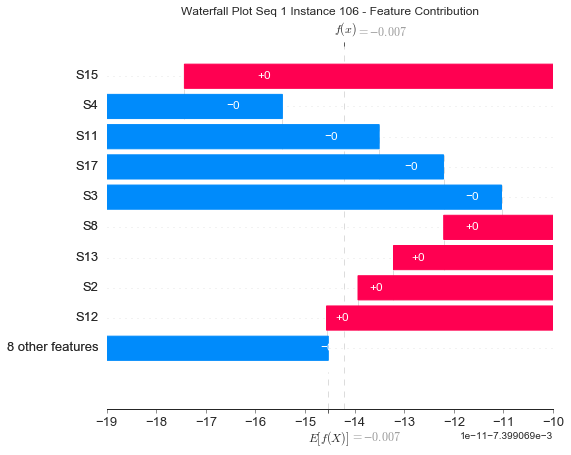

None

Contribution: [-3.43815276e-12 -1.43629574e-13  3.70228544e-12 -3.00647658e-12
  6.72955528e-12  1.06630564e-11 -2.15457600e-12 -6.28593922e-12
 -2.42848574e-13  1.29695308e-11 -2.42240191e-12 -6.42769171e-12
  2.24724211e-12 -1.38346097e-11  6.07405445e-12 -1.28360354e-12
 -9.95110461e-13]


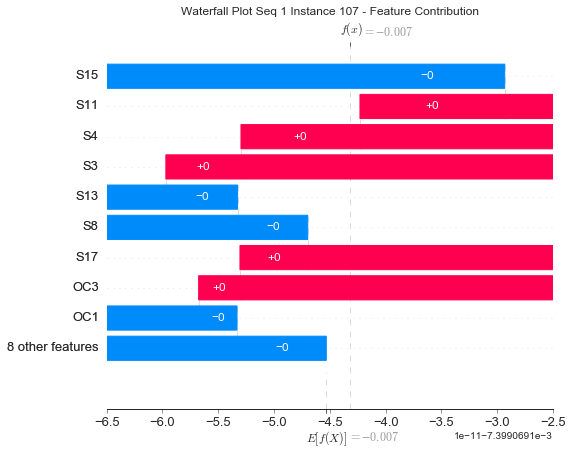

None

Contribution: [ 5.78225445e-12  3.81633006e-12  1.29927991e-12 -6.47112225e-12
  8.28019858e-12  1.71422373e-11 -8.22205238e-12 -4.71396620e-12
 -6.39854923e-13  1.11579279e-11 -9.37111586e-12 -3.84273212e-12
  2.66521310e-12 -1.22669349e-11  8.72758376e-12 -3.21465771e-12
 -6.31277279e-12]


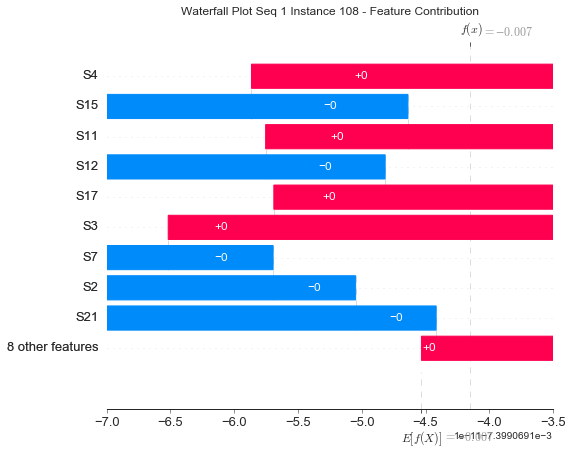

None

Contribution: [ 8.68646301e-12  2.03981103e-12  6.74273788e-12 -1.92281677e-11
  2.31943614e-11  3.78796855e-11 -1.33961722e-11 -1.84357859e-11
 -3.30181455e-12  3.73519063e-11 -1.81645272e-11 -9.67164456e-12
  4.35949887e-12 -4.39176716e-11  2.52481664e-11 -5.67109163e-12
 -1.21893563e-11]


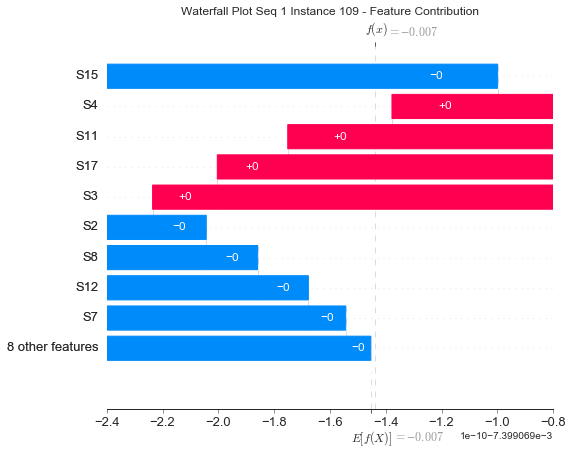

None

Contribution: [-1.30360618e-11 -7.08154195e-12 -7.08766325e-13  1.26556673e-11
 -1.03903865e-11 -2.29460877e-11  1.03281186e-11  5.92708044e-12
  3.03227994e-12 -1.31261408e-11  1.48133433e-11  1.32910599e-12
 -2.39816760e-12  2.25959442e-11 -1.20899792e-11  4.19341905e-12
  9.47364062e-12]


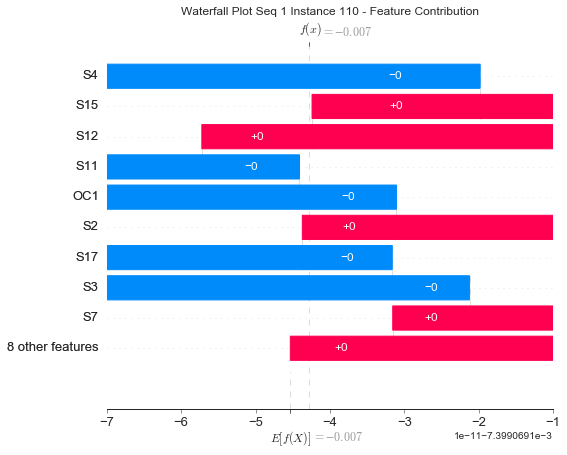

None

Contribution: [-3.88118834e-12 -1.66129946e-12  0.00000000e+00  6.82491216e-12
 -4.66648335e-12 -8.61938038e-12  3.79799707e-12  2.43971315e-12
  1.62884799e-12 -5.51856390e-12  6.34040693e-12 -3.70140100e-15
 -4.38915316e-13  4.62771184e-12 -5.63063832e-12  1.80862270e-12
  3.47266400e-12]


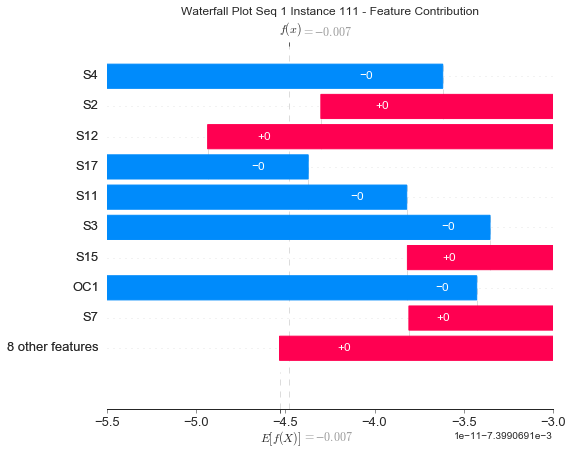

None

Contribution: [-7.60242347e-13 -1.57350034e-12  1.92718411e-12 -1.80447237e-12
  4.20320549e-12  4.99344750e-12 -6.76631548e-13 -4.09263465e-12
 -7.23542252e-14  7.86844548e-12 -1.05718589e-13 -2.36654793e-12
  6.50158909e-13 -9.79095711e-12  3.70424524e-12 -2.11135674e-13
 -9.47662847e-13]


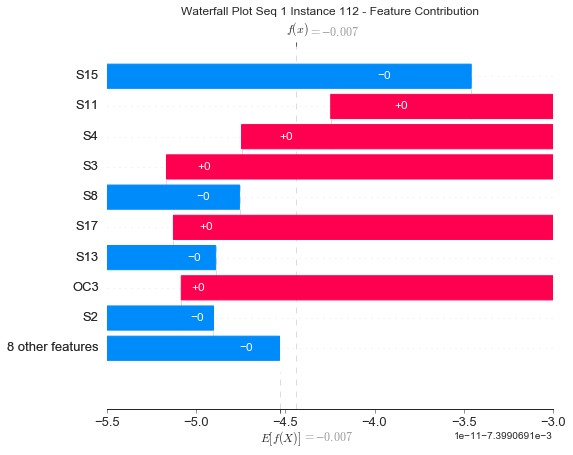

None

Contribution: [-3.25941422e-12 -2.65991331e-12  0.00000000e+00  7.97457911e-13
 -5.87470665e-13 -4.38072321e-12  1.97237560e-12  3.24378572e-13
  6.40662003e-13 -1.48871985e-12  3.04357190e-12 -4.62158032e-15
 -1.21145769e-12  7.89761399e-12 -1.10564292e-12  8.81279099e-13
  1.89530878e-12]


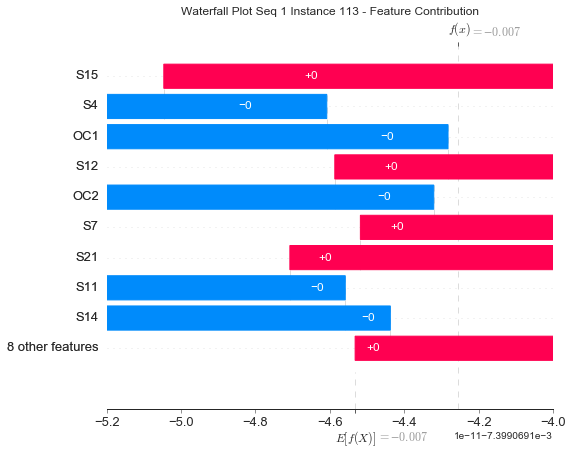

None

Contribution: [-2.39342639e-12 -1.10018234e-12 -1.58497987e-12  4.18864075e-12
 -4.07284493e-12 -5.89132042e-12  2.34952596e-12  3.01348985e-12
  1.08632157e-12 -3.84236436e-12  3.53252887e-12  2.15029296e-12
 -1.27983821e-12  7.81202446e-12 -3.44475793e-12  9.24890915e-13
  2.19624666e-12]


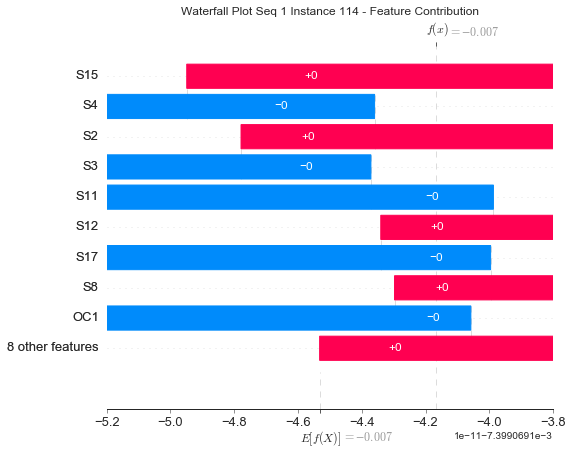

None

Contribution: [ 7.27378227e-12  1.98304784e-12  0.00000000e+00 -1.23871087e-11
  7.76032710e-12  1.48220498e-11 -6.51204871e-12 -4.56098874e-12
 -2.66888313e-12  9.07773596e-12 -8.85534441e-12 -8.71572921e-16
  3.71641276e-13 -6.01985432e-12  8.50463883e-12 -2.59532413e-12
 -6.01991200e-12]


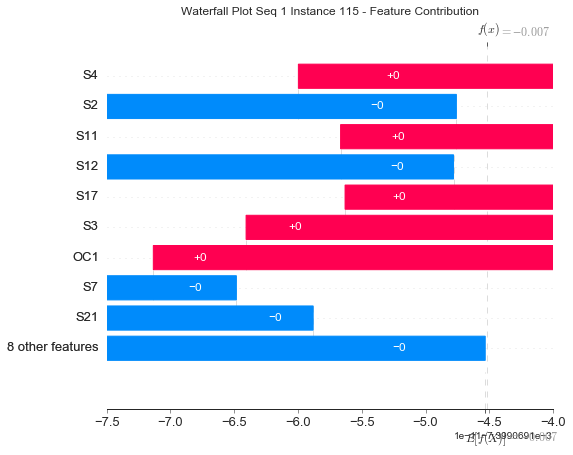

None

Contribution: [-5.67231288e-12 -1.25309507e-12  1.95856937e-12  6.54609917e-12
 -2.44794658e-12 -5.01678386e-12  1.60312443e-12  1.57713274e-12
  1.85455123e-12  1.07832330e-12  2.79455820e-12 -1.17282608e-13
  2.01282852e-13  7.96500995e-13 -3.42291863e-12  2.01306406e-13
  2.16628733e-12]


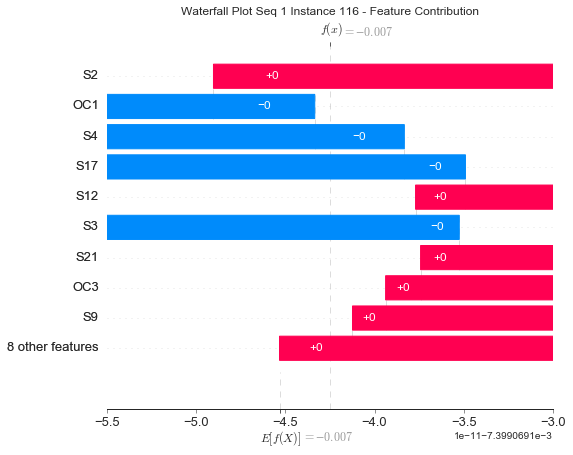

None

Contribution: [ 4.87983655e-12  3.31811792e-12 -5.92441732e-13 -5.12814661e-12
  3.15562442e-12  9.93998980e-12 -3.79835876e-12 -7.45582361e-13
 -1.46380846e-12  4.93967020e-12 -5.53119616e-12  1.06179648e-12
  4.15613019e-13 -5.87906026e-12  3.60134318e-12 -1.71494535e-12
 -3.29843488e-12]


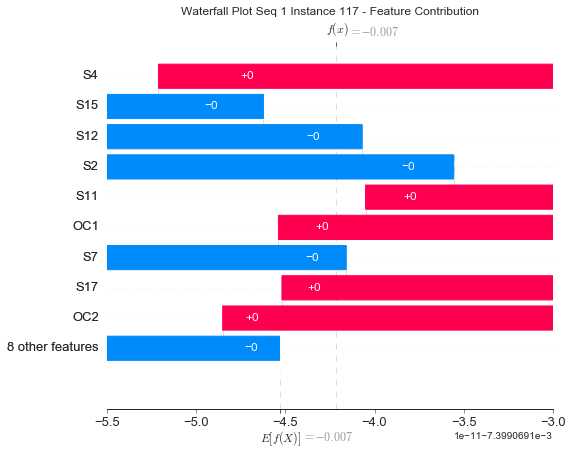

None

Contribution: [-7.57425025e-12 -1.36238004e-12 -4.38118118e-12  1.57448967e-11
 -1.44194144e-11 -2.40189778e-11  7.51751005e-12  1.15549506e-11
  3.59772628e-12 -2.03669772e-11  1.09828873e-11  5.39605990e-12
 -2.75843823e-12  2.49146780e-11 -1.51590823e-11  3.17446460e-12
  7.42520021e-12]


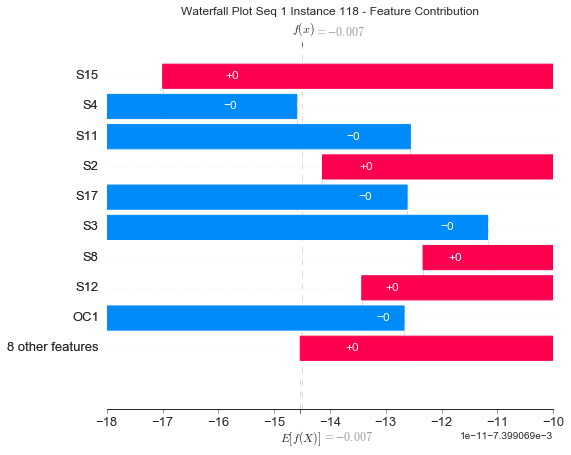

None

Contribution: [-1.17956881e-12  8.24356588e-14 -1.23321698e-12  2.13513408e-12
 -1.61211170e-12 -2.43489365e-12  3.72318333e-13  2.06276034e-12
  8.47000530e-13 -2.74842584e-12  9.87360909e-13  2.04725798e-12
 -1.30577764e-12  5.41313218e-12 -1.13649931e-12  1.40108262e-13
  6.49933232e-13]


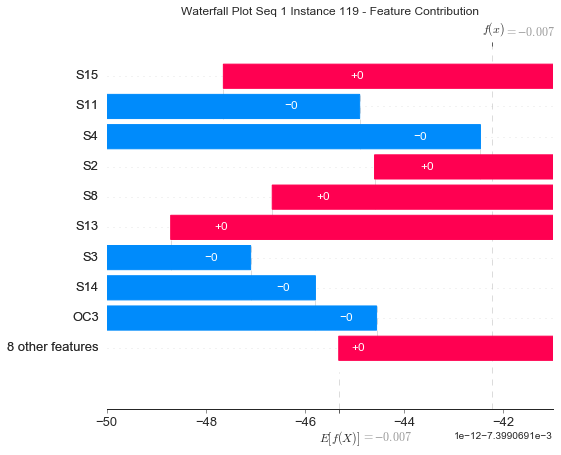

None

Contribution: [-1.00105384e-12 -6.33646130e-13  2.23724901e-12 -4.79546654e-12
  5.70531860e-12  7.25482825e-12 -1.39778033e-12 -5.33593352e-12
 -8.38952280e-13  1.01091739e-11 -1.85848103e-12 -2.65260145e-12
  6.86825542e-13 -8.59768940e-12  5.55907100e-12 -6.82245059e-13
 -9.57484959e-13]


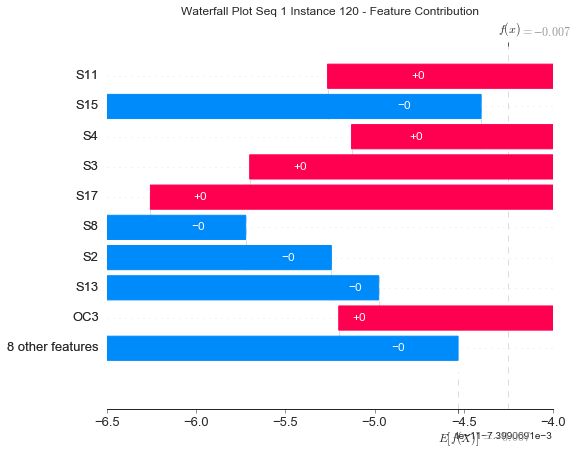

None

Contribution: [-9.19689758e-12 -3.62399563e-12  1.84205299e-12  5.88783362e-12
 -1.84434564e-12 -8.25040557e-12  5.13854107e-12 -8.89633311e-13
  1.81897954e-12 -2.53210386e-14  7.25976224e-12 -2.34776283e-12
 -5.80229061e-13  4.47331148e-12 -2.31389799e-12  1.92967105e-12
  4.89671715e-12]


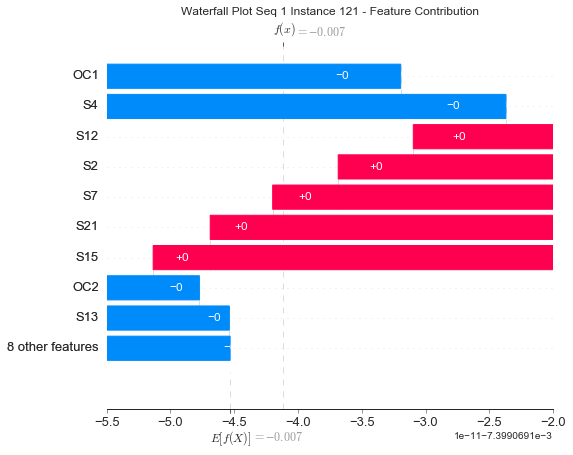

None

Contribution: [ 4.12446639e-12  1.13158463e-12  2.44957375e-12 -7.72000172e-12
  8.86904092e-12  1.41615547e-11 -4.59777398e-12 -7.09362256e-12
 -1.36984868e-12  1.30388166e-11 -6.23614485e-12 -3.59211380e-12
  1.34455348e-12 -1.47271466e-11  9.73456905e-12 -1.71280980e-12
 -4.17855854e-12]


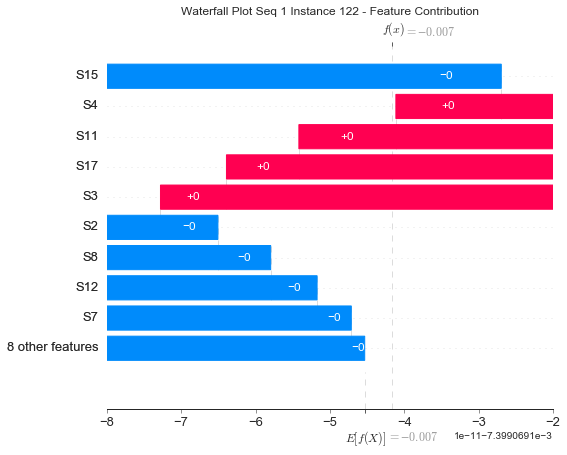

None

Contribution: [-3.23664923e-12  3.69259397e-12  0.00000000e+00  9.13111080e-12
 -4.59946317e-12 -1.14582790e-12  2.18743990e-12  3.54232746e-12
  1.35693832e-12 -4.82194959e-13  2.29233754e-12  2.78473347e-15
  8.91608890e-13 -6.95374184e-12 -4.31194750e-12  4.79426882e-13
  3.05861955e-12]


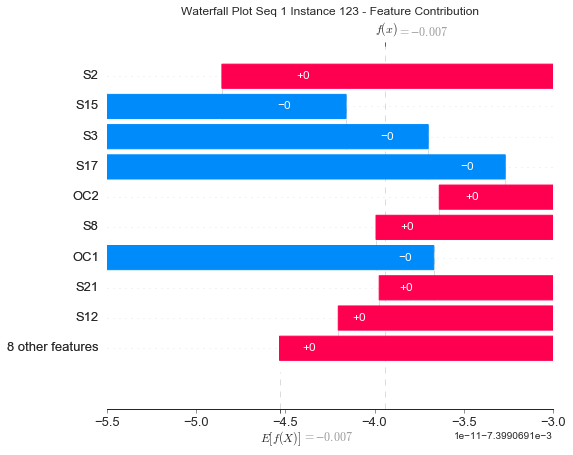

None

Contribution: [ 4.48544023e-12  2.13060754e-12 -6.00531040e-12  5.64472124e-12
 -1.11432131e-11 -1.21901586e-11  1.50815222e-12  1.15264994e-11
  5.00131891e-13 -1.86044808e-11  2.05920610e-12  8.92373328e-12
 -2.89523071e-12  2.34469597e-11 -1.08258758e-11  8.89429372e-13
  1.07111401e-12]


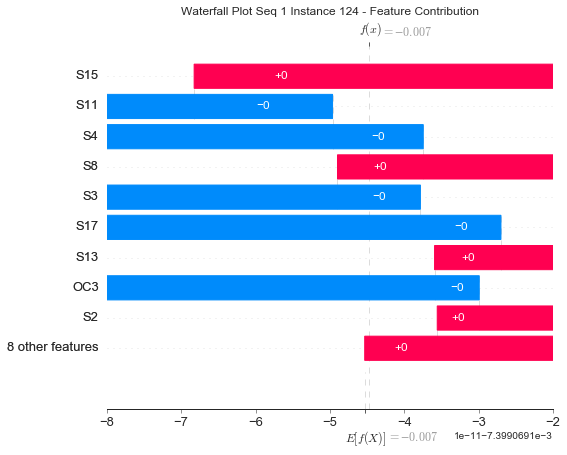

None

Contribution: [ 4.12782569e-12  1.63921882e-12  0.00000000e+00 -4.19504622e-12
  3.20300253e-12  7.44372099e-12 -2.73314422e-12 -1.40616967e-12
 -8.01549636e-13  3.53245211e-12 -3.91778667e-12  1.44810288e-16
  1.48728184e-13 -3.27378446e-12  3.76319418e-12 -1.18946476e-12
 -2.81747325e-12]


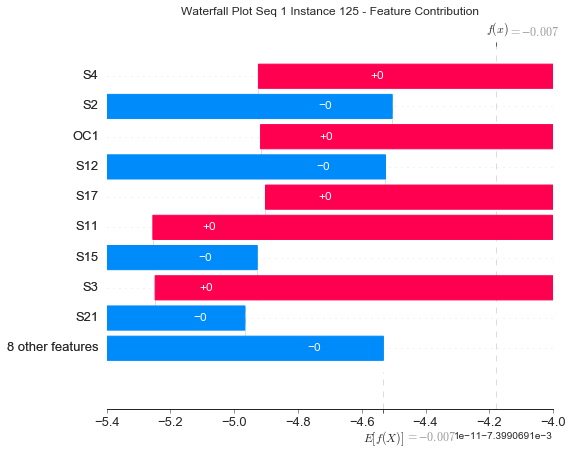

None

Contribution: [-1.26360727e-12  1.15466599e-12 -3.01881675e-12  1.14078417e-11
 -1.11822634e-11 -1.33784884e-11  9.37665202e-13  1.23213774e-11
  2.75173113e-12 -1.52966147e-11  3.19005044e-12  7.66068806e-12
 -1.28811545e-12  1.95470359e-11 -1.24959322e-11  2.33464642e-13
  1.70340413e-12]


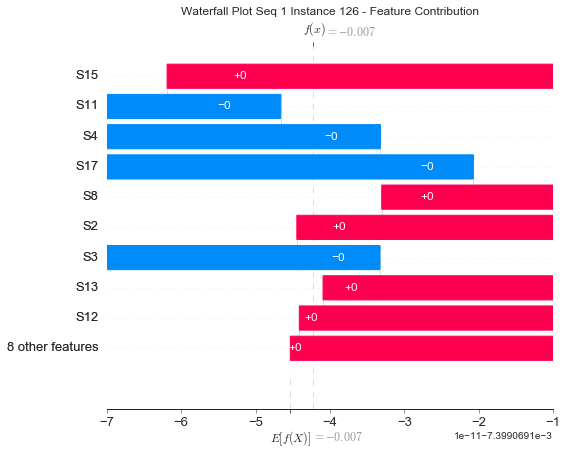

None

Contribution: [-1.17641790e-13  4.35995071e-13 -2.87540445e-13  6.79188354e-14
  1.59860013e-13 -7.02803633e-14 -6.21546271e-13  1.74325032e-13
  2.71217537e-13 -3.46614041e-13 -2.78067008e-14  3.84271770e-13
 -3.96655202e-13  2.10271817e-12  6.07203307e-13 -1.21440632e-13
 -3.50106635e-13]


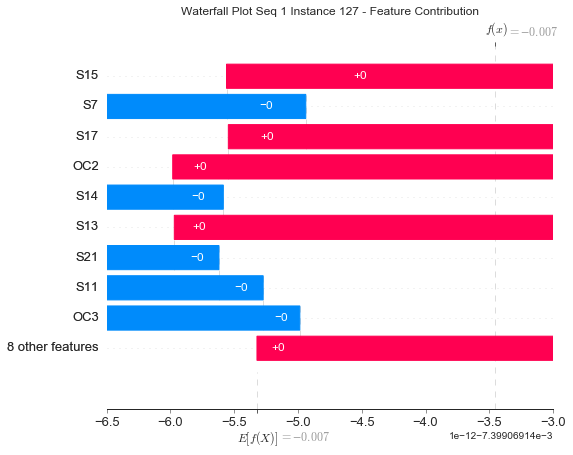

None

Contribution: [-6.48803407e-12 -2.55111036e-12 -2.39001202e-12  9.11907876e-12
 -7.58490493e-12 -1.48927936e-11  6.10820249e-12  5.20764161e-12
  1.89731304e-12 -9.99266121e-12  8.00679228e-12  3.02001024e-12
 -2.18587605e-12  1.36765399e-11 -8.18264033e-12  2.59991507e-12
  5.40560608e-12]


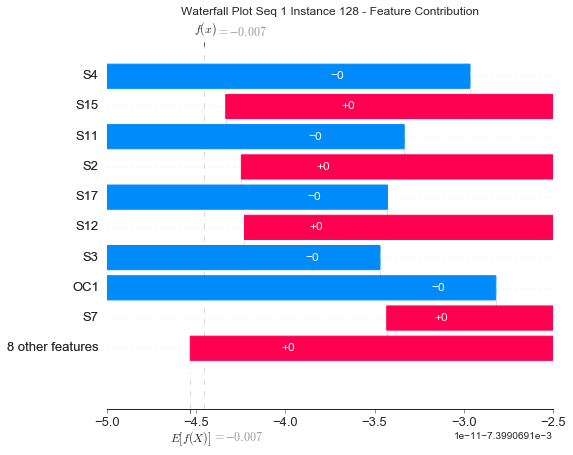

None

Contribution: [ 8.51174513e-12  2.79251578e-12  0.00000000e+00 -9.98818823e-12
  7.73033113e-12  1.65789535e-11 -6.11058730e-12 -3.35209074e-12
 -2.08117226e-12  9.21377297e-12 -9.25737872e-12  4.20266027e-15
  2.53698782e-13 -9.80456862e-12  7.63406959e-12 -2.86540691e-12
 -5.62027334e-12]


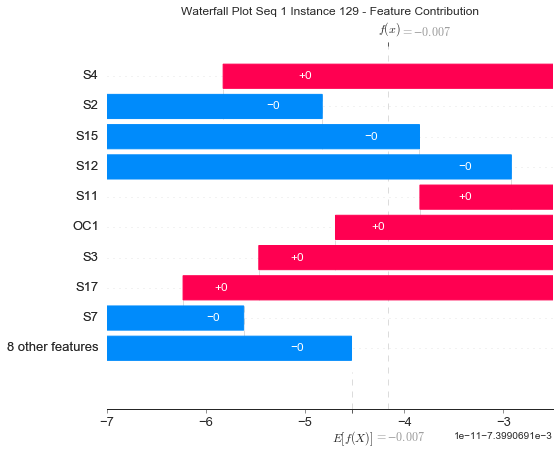

None

Contribution: [-6.32152230e-12 -6.64756618e-12  0.00000000e+00  3.71455904e-12
 -4.05473224e-12 -1.09009798e-11  5.49945246e-12  1.27296860e-12
  1.22335443e-12 -6.23053258e-12  8.55266465e-12 -4.34424776e-15
 -1.42749408e-12  1.37787264e-11 -4.06430185e-12  2.62247580e-12
  3.84985316e-12]


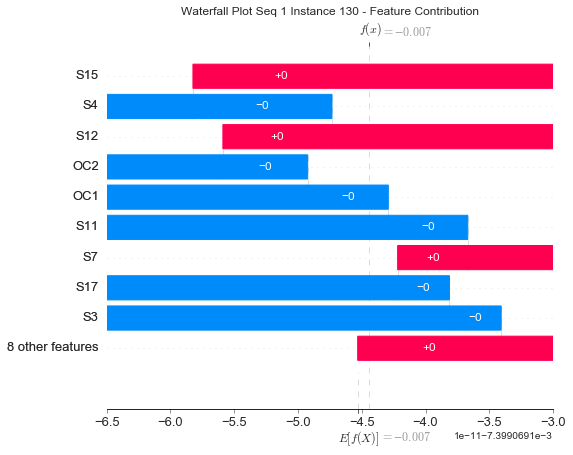

None

Contribution: [-2.05731807e-12  5.44927601e-13  0.00000000e+00  5.98253261e-12
 -2.58821068e-12 -4.42777542e-12  4.54183268e-13  1.85306046e-12
  1.22146173e-12 -1.45846399e-12  3.10742166e-12  6.51619355e-15
  4.24227439e-13  7.20636794e-14 -3.61206703e-12  6.91752591e-13
  5.14836546e-13]


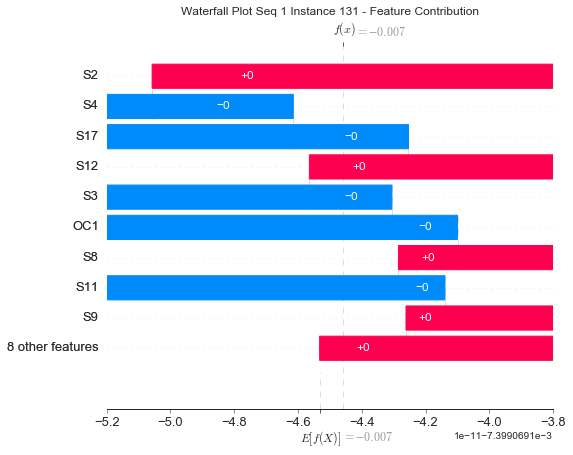

None

Contribution: [ 1.96440563e-12  1.60331839e-12  2.37475881e-12 -6.39042074e-12
  8.30782318e-12  1.41681077e-11 -2.71549081e-12 -6.13205623e-12
 -1.10124941e-12  1.09750108e-11 -5.54622190e-12 -5.10349792e-12
  9.98771270e-13 -1.43738693e-11  8.77648388e-12 -1.51861238e-12
 -1.60867381e-12]


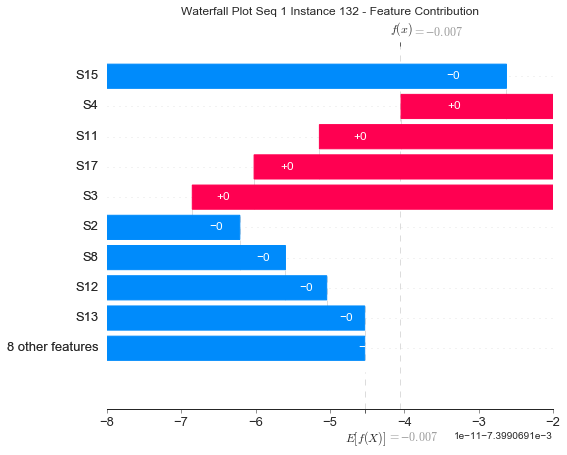

None

Contribution: [ 7.67989058e-12  3.19808741e-12  5.67617264e-12 -1.34062457e-11
  1.57549390e-11  2.72498014e-11 -8.07815707e-12 -1.30368338e-11
 -2.33597386e-12  2.39742462e-11 -9.44602296e-12 -1.03575733e-11
  3.61146920e-12 -3.31021564e-11  1.58561671e-11 -2.90053290e-12
 -7.30889654e-12]


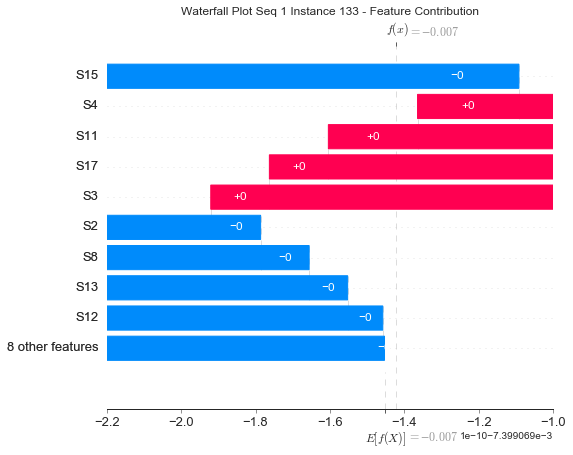

None

Contribution: [ 5.71390288e-12  1.23996882e-13 -9.39371194e-13 -1.02098512e-11
  7.31663948e-12  1.19034053e-11 -4.11505075e-12 -4.36430883e-12
 -2.09792882e-12  7.44819137e-12 -6.53874914e-12  4.77714385e-13
 -5.68911183e-13 -4.31854595e-12  8.79957478e-12 -1.74252778e-12
 -4.57893792e-12]


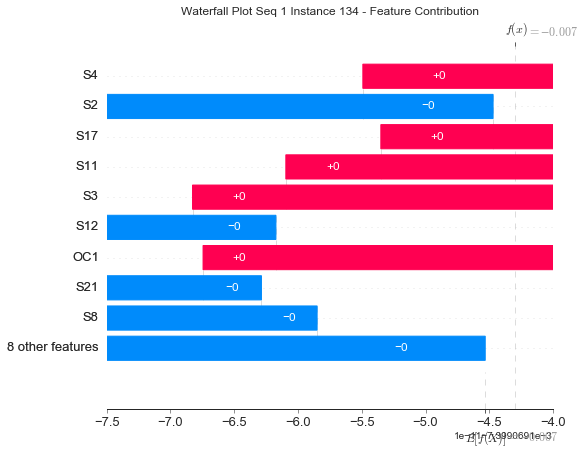

None

Contribution: [ 8.59759920e-12  6.09012406e-12  1.59017255e-12 -1.54545092e-11
  1.52667358e-11  3.06059830e-11 -1.01802074e-11 -1.04798965e-11
 -3.27583750e-12  2.13018145e-11 -1.66781658e-11 -5.30403802e-12
  1.38449658e-12 -2.65411183e-11  1.74631507e-11 -4.81214721e-12
 -7.40350836e-12]


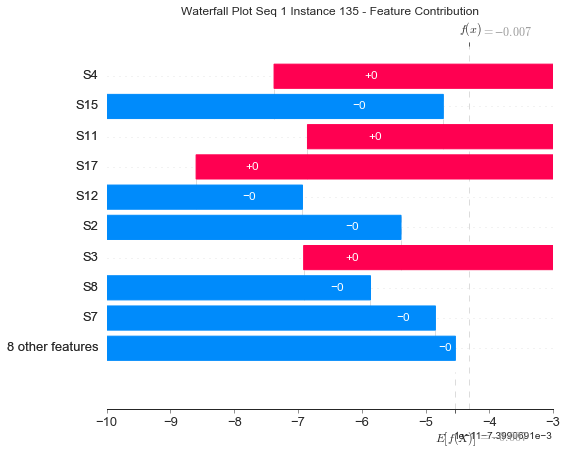

None

Contribution: [ 8.34118907e-13 -3.76824266e-12  0.00000000e+00 -5.27918985e-12
  2.65774859e-12 -1.66759369e-12  1.33582002e-13 -1.99056375e-12
 -5.45646319e-13  1.17379370e-12  8.57093910e-13  5.57207072e-15
 -1.20497004e-12  7.82725534e-12  2.08764147e-12  5.26681509e-13
 -1.15991125e-12]


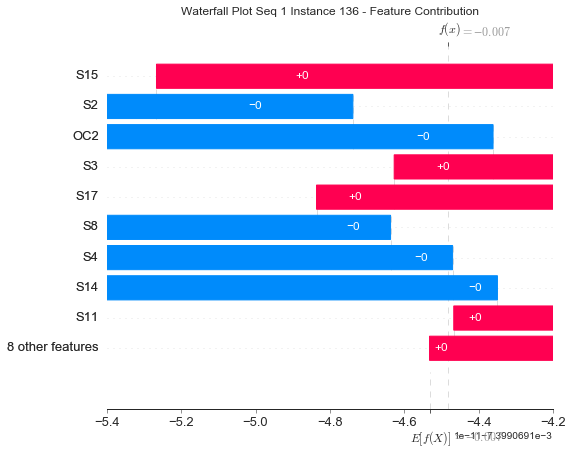

None

Contribution: [-4.82457444e-13 -1.20719136e-12  0.00000000e+00 -1.41577798e-12
  8.90638529e-13 -4.16481953e-13  3.07401077e-13 -4.04990847e-13
 -1.41689215e-15 -6.22705893e-14  5.10408610e-13  2.34835819e-15
 -2.71360869e-13  4.79943689e-12  1.22636298e-12  1.88256312e-13
  7.20994241e-14]


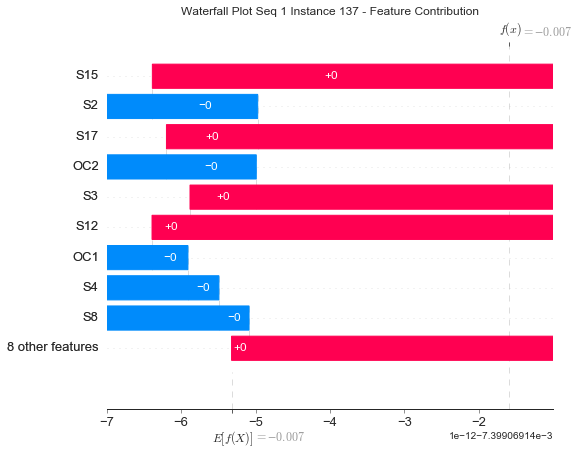

None

Contribution: [-2.34388529e-12 -1.91036184e-12  0.00000000e+00  4.89147221e-12
 -3.60198633e-12 -7.15143222e-12  3.96403787e-12  1.88193016e-12
  1.28651072e-12 -5.45716337e-12  4.97220407e-12  4.47616467e-15
 -8.49797392e-13  5.72329814e-12 -3.85448791e-12  1.73898038e-12
  3.01620946e-12]


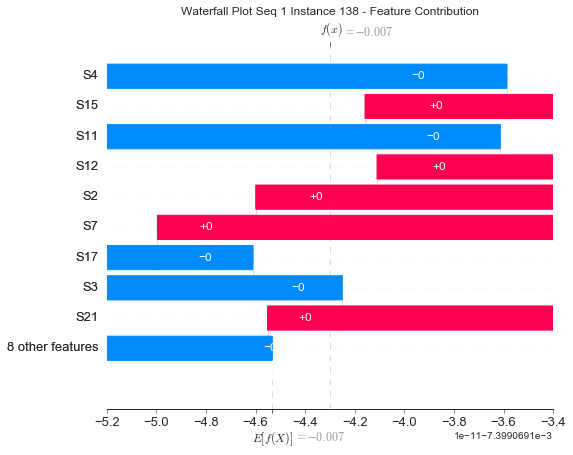

None

Contribution: [-7.06480827e-13 -9.41207615e-13  0.00000000e+00  3.18572902e-12
 -1.68596831e-12 -4.59007875e-12  1.61792498e-12  9.34909919e-13
  9.22510007e-13 -2.54678917e-12  3.16049075e-12  6.02127516e-15
 -2.65220815e-13  4.04522032e-12 -2.07403560e-12  9.67315529e-13
  6.83901124e-13]


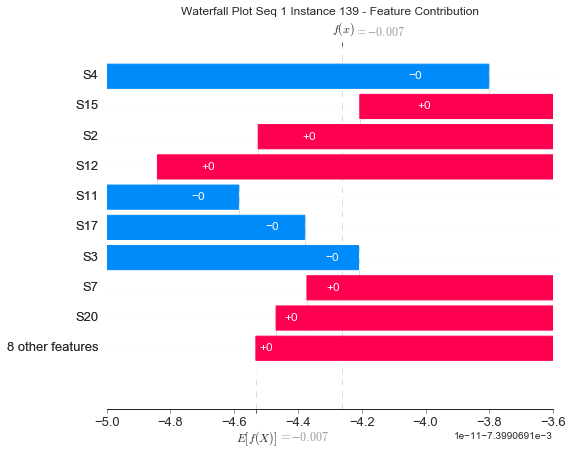

None

Contribution: [-7.86857818e-12 -9.55632058e-13  3.10005737e-13  1.24261400e-11
 -6.18267069e-12 -9.51586813e-12  4.97273967e-12  3.30825081e-12
  2.26451431e-12 -4.22040224e-12  8.14858337e-12 -6.10694980e-13
  4.27398968e-14  8.23607729e-13 -6.78850032e-12  2.08753305e-12
  4.93566429e-12]


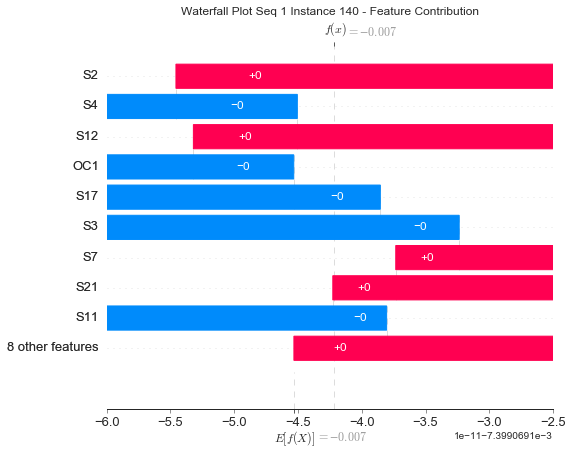

None

Contribution: [ 1.64251442e-11  1.00952293e-11  3.86295305e-14 -1.87884343e-11
  1.44652545e-11  3.06285830e-11 -1.55811527e-11 -7.38889679e-12
 -3.54256056e-12  1.82127403e-11 -2.11401660e-11 -4.37365205e-13
  9.56662158e-13 -2.02545428e-11  1.60559101e-11 -6.21355745e-12
 -1.25051098e-11]


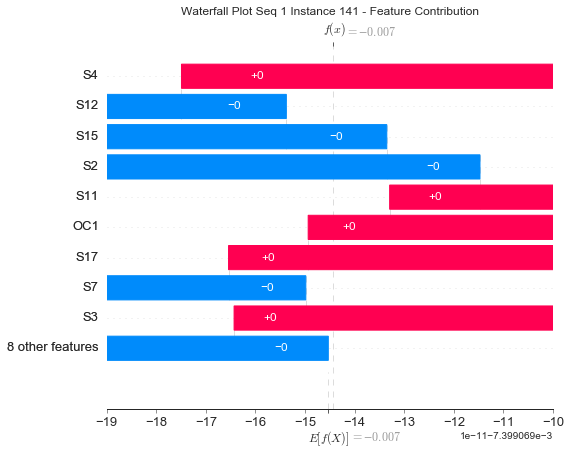

None

Contribution: [-6.99221675e-15 -1.29609843e-12  3.21023590e-13  2.75514854e-13
  2.01603534e-12  1.96093315e-12  6.92321526e-13 -2.45909933e-12
  4.57534455e-13  3.92057263e-12  9.92112317e-13 -9.15814083e-13
 -6.57768002e-13 -5.64487259e-12  2.78821974e-12  5.80773873e-13
 -7.87804677e-14]


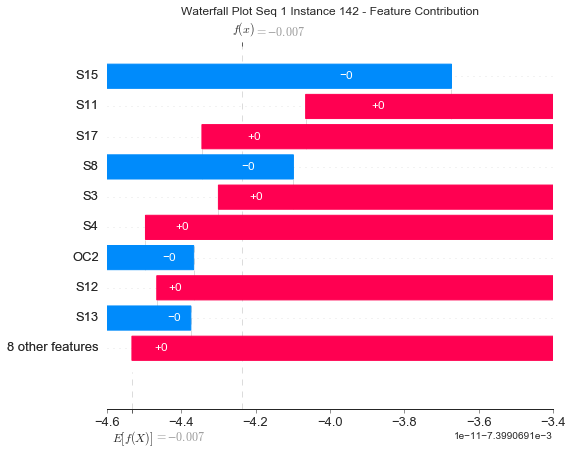

None

Contribution: [ 1.31885735e-11  6.47548681e-12  3.87641308e-12 -1.88288118e-11
  1.63323972e-11  3.31834490e-11 -1.44252492e-11 -9.96770114e-12
 -3.03410855e-12  2.09601277e-11 -1.76873551e-11 -4.75362458e-12
  3.07303640e-12 -2.33755515e-11  1.68200540e-11 -5.99700498e-12
 -1.16491495e-11]


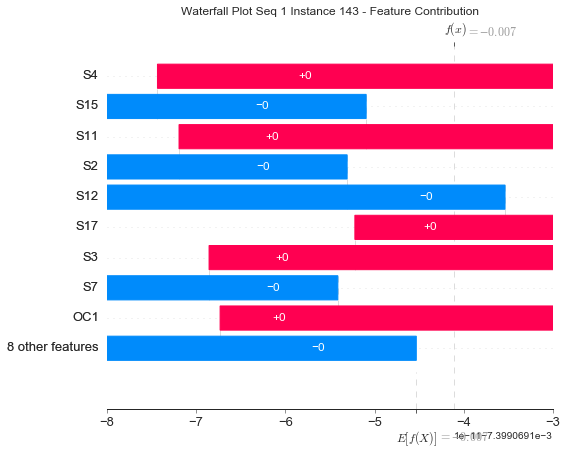

None

Contribution: [ 4.22353038e-12 -5.69291576e-13  0.00000000e+00 -3.13583990e-12
  2.57523538e-12  4.27980741e-12 -4.28482933e-13 -1.26323398e-12
 -1.02523328e-12  3.70444691e-12 -1.17075533e-12  2.92906619e-15
  4.08615172e-13 -6.47016555e-12  2.13472295e-12  3.17586235e-13
 -1.54476497e-12]


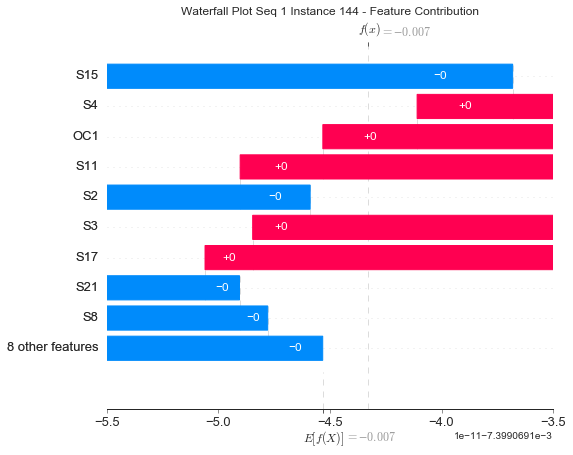

None

Contribution: [-1.26027704e-11 -6.57645943e-12  3.42926490e-12  1.36474313e-11
 -4.00792073e-12 -1.56516744e-11  9.16807255e-12 -1.57905633e-12
  3.54734970e-12 -2.56600188e-13  1.50900230e-11 -4.61103334e-12
  2.41440358e-13 -2.08161418e-12 -6.74291612e-12  4.77532033e-12
  6.66233605e-12]


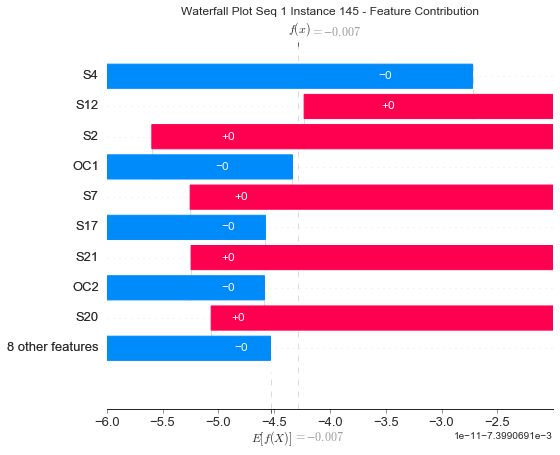

None

Contribution: [-1.53664026e-11 -1.04628251e-11 -6.62370809e-12  3.13319683e-11
 -3.68187529e-11 -6.71457334e-11  1.64242855e-11  3.08568032e-11
  7.78275014e-12 -5.60031223e-11  2.80739113e-11  1.96690528e-11
 -5.13840012e-12  8.31217456e-11 -4.22383517e-11  7.54266875e-12
  1.25123306e-11]


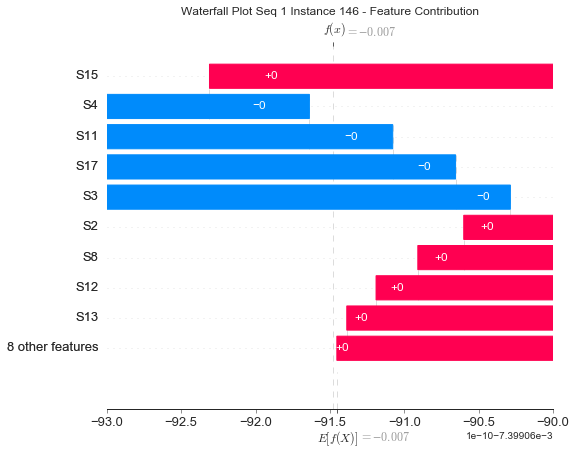

None

Contribution: [ 2.33061552e-12  3.55042211e-12 -9.23381163e-12  1.52745629e-11
 -2.02010925e-11 -2.78223573e-11  4.17706408e-12  2.33430948e-11
  2.61513641e-12 -3.74689758e-11  4.37163717e-12  1.56885008e-11
 -3.66432752e-12  4.68392755e-11 -2.25877147e-11  1.45629873e-12
  4.28735086e-12]


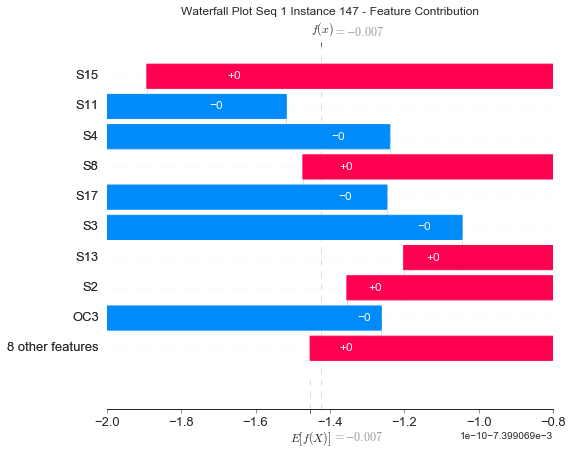

None

Contribution: [ 1.87802595e-12  2.08500057e-12 -9.90438807e-12  1.57927508e-11
 -2.26286472e-11 -2.87570991e-11  4.76114677e-12  2.39267529e-11
  2.98068016e-12 -3.90581317e-11  6.70974474e-12  1.64688940e-11
 -4.24210103e-12  4.98711107e-11 -2.38293343e-11  2.04184087e-12
  4.32674903e-12]


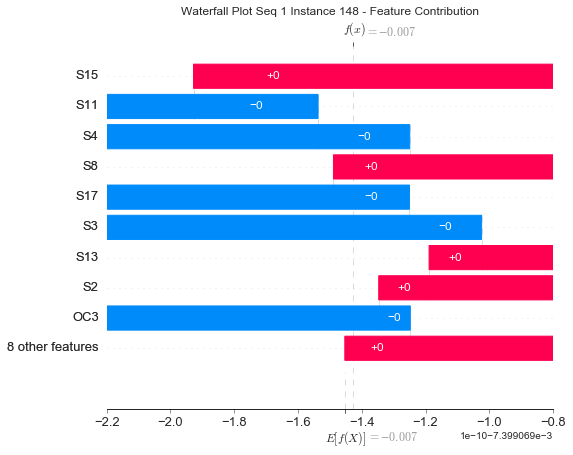

None

Contribution: [ 5.20860828e-12  4.24440561e-12 -9.78809481e-12  1.17054977e-11
 -1.83061101e-11 -2.20382115e-11  3.10797785e-12  2.13174860e-11
  1.43195037e-12 -3.28995060e-11  2.86491360e-12  1.51778486e-11
 -4.39369895e-12  3.80898195e-11 -1.92522821e-11  1.07003100e-12
  2.86456362e-12]


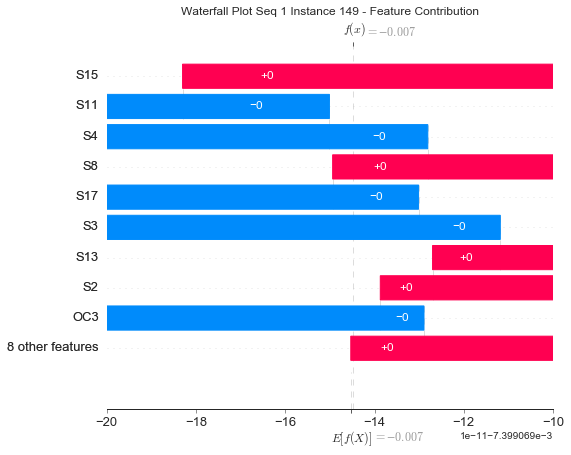

None

Contribution: [ 1.48045378e-11  5.57253028e-12  0.00000000e+00 -1.32205913e-11
  9.40011784e-12  2.33576769e-11 -9.91065650e-12 -4.57896568e-12
 -2.95194273e-12  1.13448478e-11 -1.47790634e-11 -1.44935384e-14
  1.12246464e-12 -1.88792055e-11  1.22207149e-11 -4.04524634e-12
 -9.29186155e-12]


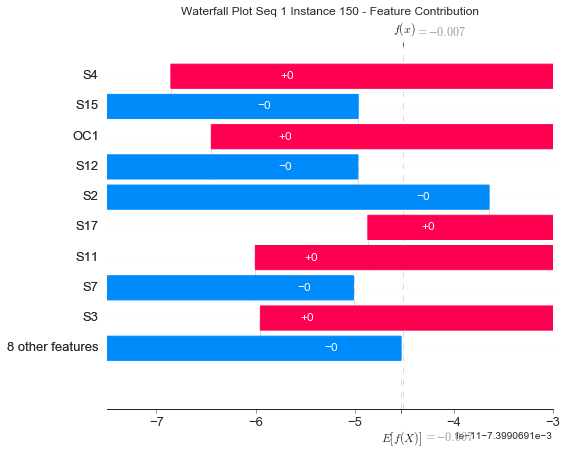

None

Contribution: [ 1.14970030e-11  3.98173942e-12  3.84415329e-12 -3.04748969e-11
  2.55859032e-11  4.54231652e-11 -1.32980744e-11 -1.89163355e-11
 -6.35347807e-12  3.54044918e-11 -2.26524736e-11 -8.14104253e-12
  2.28598152e-12 -3.67328321e-11  3.06049491e-11 -6.71654702e-12
 -1.09851451e-11]


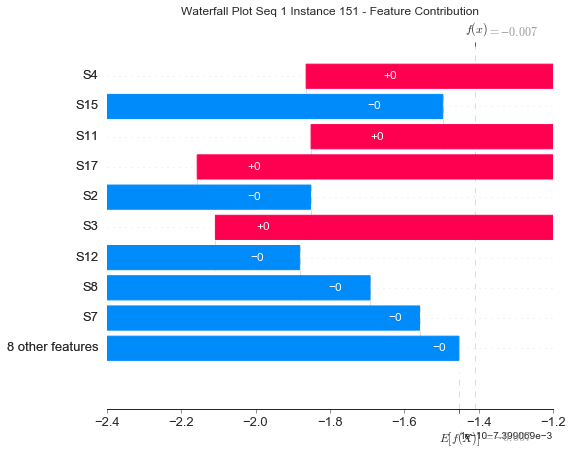

None

Contribution: [ 2.31988422e-11  1.38612941e-11  5.80643769e-13 -2.59156342e-11
  2.24875639e-11  5.13119026e-11 -2.27013807e-11 -1.11216132e-11
 -5.95827554e-12  2.95407032e-11 -3.26943680e-11 -1.85582062e-12
  3.01632569e-12 -3.94259521e-11  2.52261146e-11 -1.03602300e-11
 -1.83263960e-11]


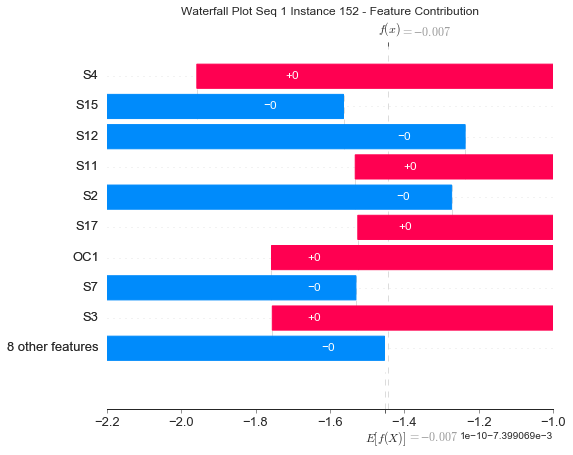

None

Contribution: [ 5.38826189e-12  6.39525488e-13 -2.12071124e-13 -2.43054079e-12
 -8.75262455e-14  5.95673088e-13 -2.98841941e-12  1.45646310e-12
 -1.82761317e-13 -4.10083772e-12 -2.47594957e-12  2.00992933e-12
 -1.59761527e-13  4.06136800e-12 -7.60136528e-13 -1.18344202e-12
 -3.39034833e-12]


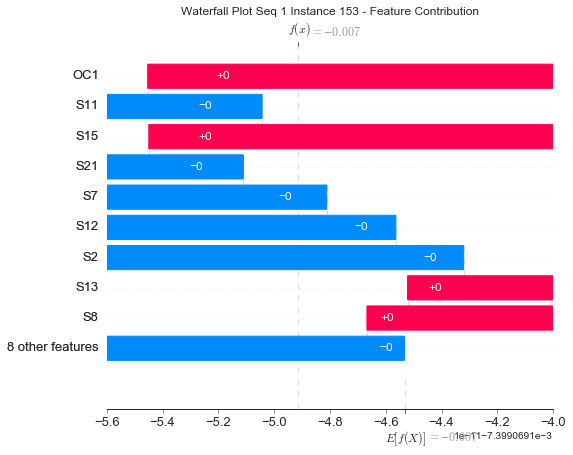

None

Contribution: [ 1.85886224e-12  9.34420943e-13  3.15285688e-12 -5.23309434e-12
  6.13550096e-12  7.69097459e-12 -3.17155330e-12 -4.22548411e-12
 -6.73631398e-13  7.51434678e-12 -5.65548216e-12 -4.05777452e-12
  9.63675862e-13 -9.01866429e-12  5.92945181e-12 -1.41581798e-12
 -2.28813496e-12]


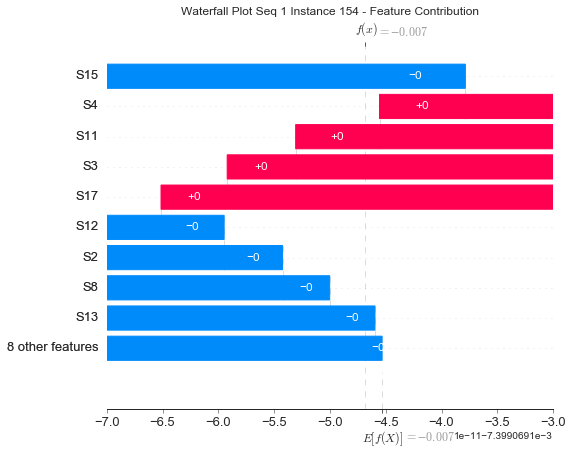

None

Contribution: [-1.18096461e-11 -3.23179721e-12  6.25209476e-12 -1.36739806e-12
  1.18369724e-11  1.16129450e-11  7.69734686e-14 -1.24968777e-11
  8.09868990e-13  2.46966215e-11 -4.25437477e-14 -9.35456747e-12
  1.58079951e-12 -2.85598611e-11  1.12353408e-11 -5.35493653e-14
  1.86919642e-12]


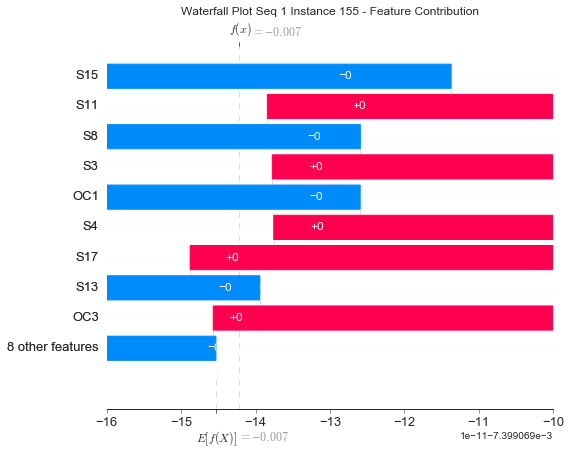

None

Contribution: [-2.30166684e-11 -1.31946858e-11  0.00000000e+00  3.13721202e-11
 -2.45273264e-11 -5.32215279e-11  2.37601223e-11  1.08416037e-11
  5.89985829e-12 -2.53119296e-11  3.81724721e-11 -1.32256309e-14
 -7.98687776e-13  2.33922864e-11 -2.83071518e-11  1.18563423e-11
  1.71535564e-11]


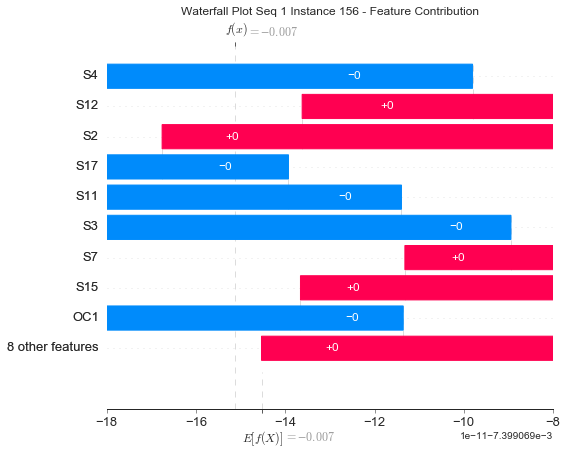

None

Contribution: [ 3.02462361e-11  2.26650712e-11  6.49040630e-12 -4.26841479e-11
  4.92994326e-11  9.70505343e-11 -3.37903663e-11 -3.44418799e-11
 -9.50781814e-12  6.84232671e-11 -4.94849960e-11 -2.04056858e-11
  8.93893813e-12 -1.00085482e-10  5.52717178e-11 -1.54124248e-11
 -2.60533071e-11]


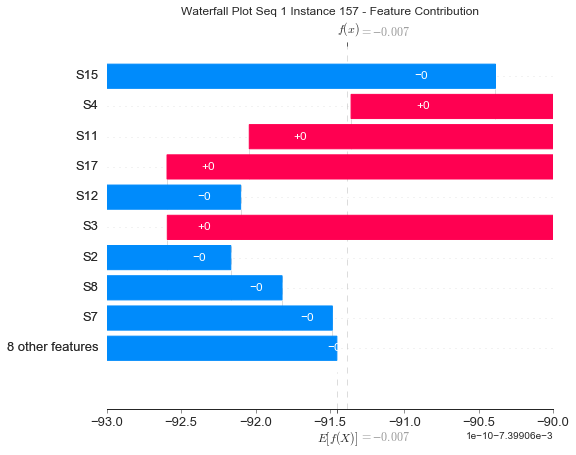

None

Contribution: [-8.75009613e-12 -6.69332732e-12  1.24287950e-12  5.35312116e-12
 -2.36335517e-12 -1.42288776e-11  5.97291010e-12 -5.41756581e-13
  2.00118437e-12 -5.62569175e-12  9.71211740e-12 -2.41965194e-12
 -1.53225251e-12  1.64348153e-11 -4.28053253e-12  2.70904089e-12
  4.63691975e-12]


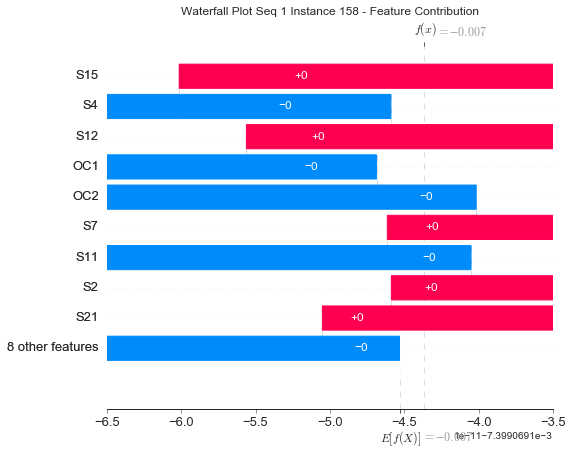

None

Contribution: [-1.74027719e-11 -6.94595423e-12  0.00000000e+00  2.67782792e-11
 -2.02955344e-11 -4.11449798e-11  1.69053486e-11  9.36149422e-12
  5.92772836e-12 -2.24662944e-11  2.68174805e-11 -1.35240431e-14
 -1.52747617e-12  2.53229174e-11 -2.35781915e-11  8.46928170e-12
  1.29653961e-11]


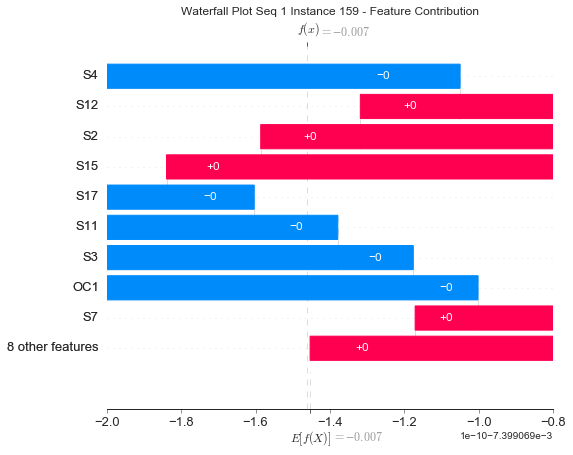

None

Contribution: [ 1.73367778e-11  4.61796920e-12  0.00000000e+00 -2.94516980e-11
  1.68249217e-11  3.28386450e-11 -1.31202584e-11 -1.00780538e-11
 -5.65548563e-12  1.66222452e-11 -2.24533586e-11 -1.93679504e-14
 -1.11972626e-13 -1.34970047e-11  2.27833308e-11 -5.45269515e-12
 -1.17169885e-11]


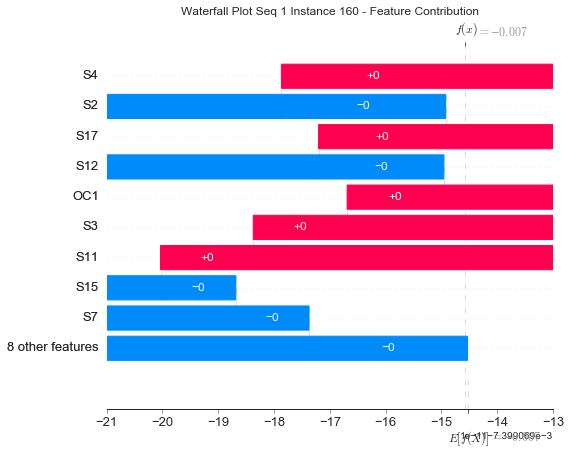

None

Contribution: [-3.58582348e-12 -5.96133169e-13 -6.18084316e-12  8.07317234e-12
 -1.27652342e-11 -1.93024624e-11  2.33711791e-12  1.25177368e-11
  1.61869845e-12 -1.71803179e-11  4.86621247e-12  1.11632708e-11
 -2.80545639e-12  2.48602371e-11 -1.11436563e-11  5.91650535e-13
  2.31531612e-12]


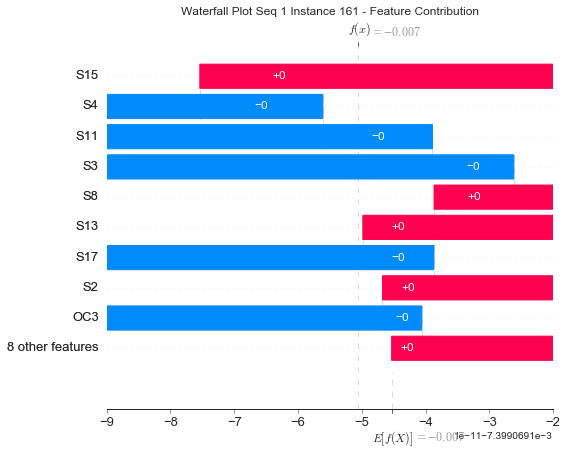

None

Contribution: [ 2.84113358e-12 -2.14569313e-12 -7.81494400e-12  9.91072415e-12
 -2.78460241e-11 -4.25485480e-11  6.55694520e-13  2.90576764e-11
  3.60785880e-12 -5.02687059e-11  6.73285126e-12  2.74796366e-11
 -6.05398284e-12  8.31484326e-11 -3.12652508e-11  1.49763589e-12
 -1.52666454e-13]


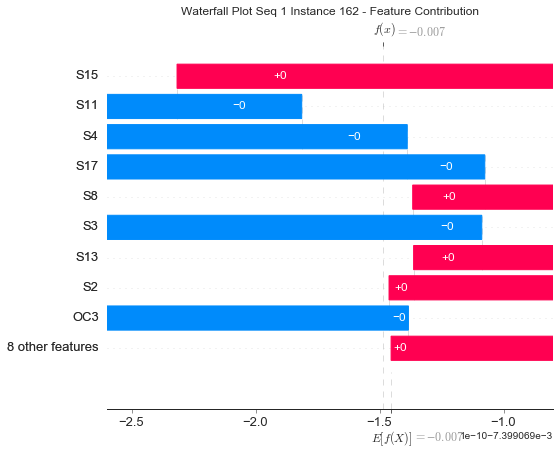

None

Contribution: [ 4.34090888e-11  1.45379334e-11 -5.73991809e-12 -3.53532863e-11
  1.30946625e-11  3.88478728e-11 -3.18942199e-11  7.27218199e-12
 -5.07795195e-12 -1.74562079e-12 -4.49724112e-11  2.14608106e-11
 -3.62962611e-12  1.68345251e-11  1.71105040e-11 -1.40748576e-11
 -2.73589901e-11]


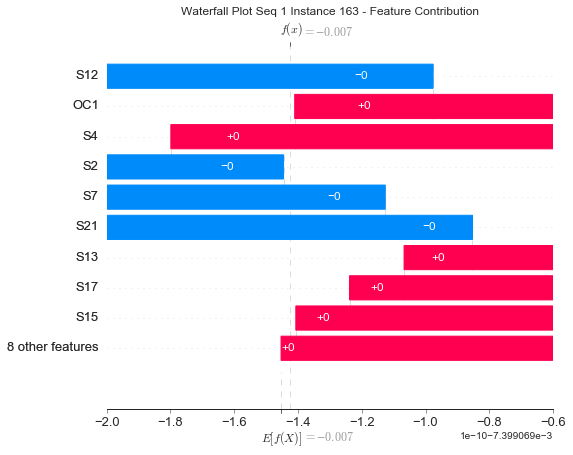

None

Contribution: [ 1.47273409e-11  3.22780041e-12  7.82804724e-12 -3.80921926e-11
  4.46783686e-11  7.07990680e-11 -2.23813502e-11 -3.54060566e-11
 -7.49134088e-12  5.83503801e-11 -3.12969026e-11 -2.35020007e-11
  6.93383241e-12 -6.94242719e-11  4.78651216e-11 -9.49603157e-12
 -1.77479125e-11]


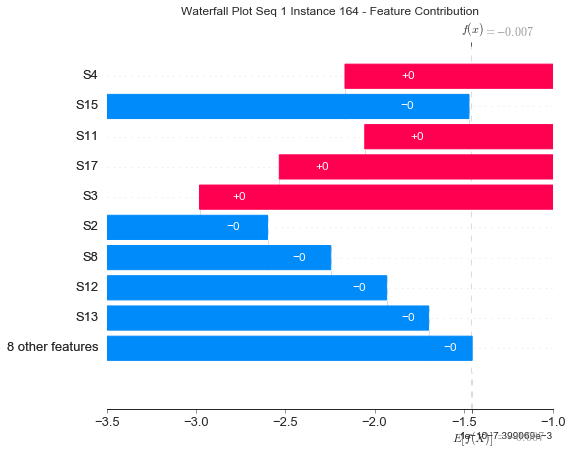

None

Contribution: [-3.33455173e-11 -1.02662453e-11  0.00000000e+00  3.48140509e-11
 -2.96408453e-11 -5.54460644e-11  2.69366075e-11  1.37579965e-11
  6.72808510e-12 -2.80391526e-11  3.95616699e-11 -1.39741598e-14
 -1.69513307e-12  2.96494426e-11 -3.43869759e-11  1.08408976e-11
  2.43300189e-11]


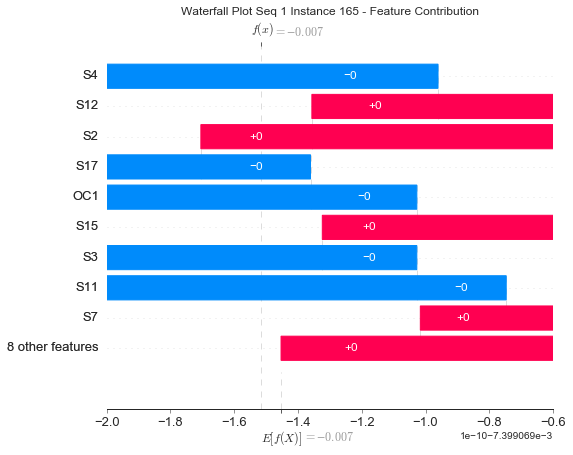

None

Contribution: [ 2.10952280e-11  8.49981197e-12  1.83594242e-12 -2.31231614e-11
  1.93231958e-11  3.69738025e-11 -2.16759059e-11 -1.03335595e-11
 -3.46111356e-12  1.98472662e-11 -2.54956958e-11 -2.21470390e-12
  2.17439716e-12 -2.04690310e-11  1.88093915e-11 -8.06510067e-12
 -1.83428463e-11]


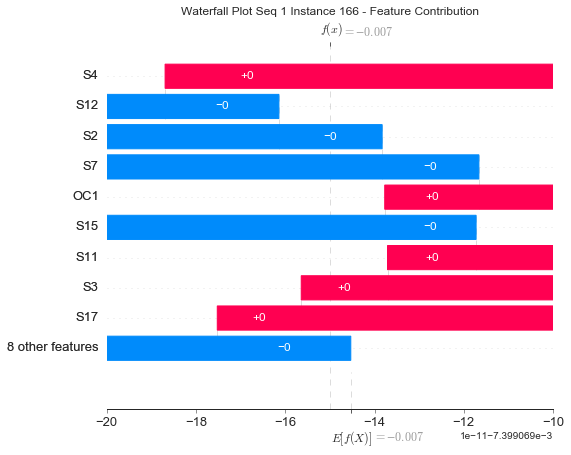

None

Contribution: [-4.10176580e-12 -3.29953187e-12 -4.61325422e-12  5.35577659e-13
 -1.20413497e-11 -2.43683320e-11  6.75996845e-12  8.59906417e-12
 -7.97714813e-13 -2.59352487e-11  7.51151571e-12  6.46554164e-12
 -3.60773716e-12  4.36434812e-11 -1.04821212e-11  2.67231983e-12
  4.65961644e-12]


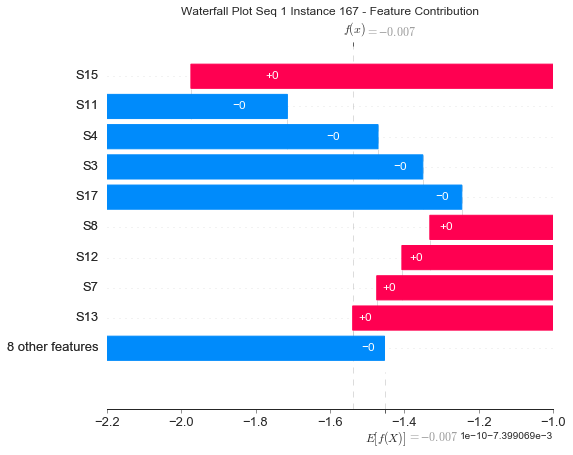

None

Contribution: [ 4.88503300e-11  1.04899457e-11  2.44443701e-12 -5.87743673e-11
  4.37260922e-11  8.53508861e-11 -3.52210101e-11 -2.63887540e-11
 -1.30967858e-11  4.93527233e-11 -5.43751329e-11 -5.11000617e-12
  3.91565252e-12 -6.46461634e-11  5.11058175e-11 -1.51277758e-11
 -3.44791591e-11]


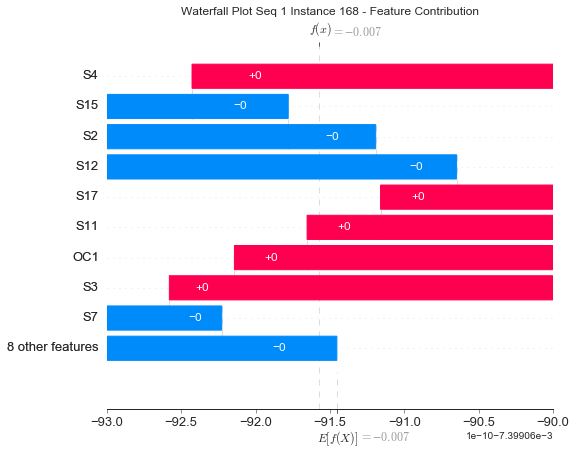

None

Contribution: [-4.27546158e-11 -2.21069135e-11 -7.09052391e-12  5.45349807e-11
 -5.95251973e-11 -1.12039565e-10  3.39524416e-11  4.46666246e-11
  1.41792637e-11 -7.27080479e-11  5.05031919e-11  3.15819974e-11
 -1.24546467e-11  1.16641821e-10 -6.35882666e-11  1.19139846e-11
  2.95576064e-11]


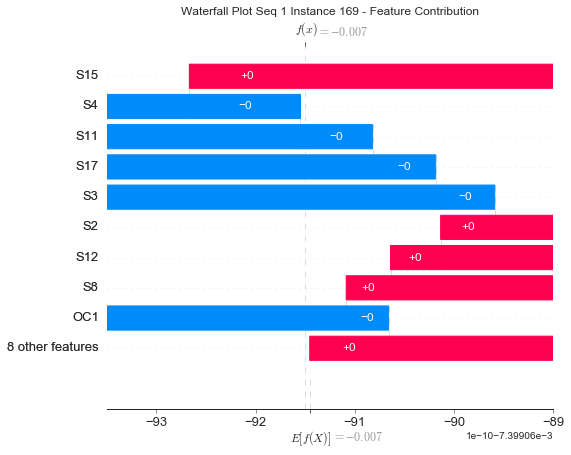

None

Contribution: [-2.29361165e-11 -8.04561799e-12 -1.23861971e-11  5.05149429e-11
 -5.87671231e-11 -1.05238963e-10  3.75022201e-11  4.18074395e-11
  8.73893145e-12 -9.01961630e-11  5.29696668e-11  1.70430978e-11
 -8.34379180e-12  1.01205988e-10 -6.75156875e-11  1.64060189e-11
  3.01881957e-11]


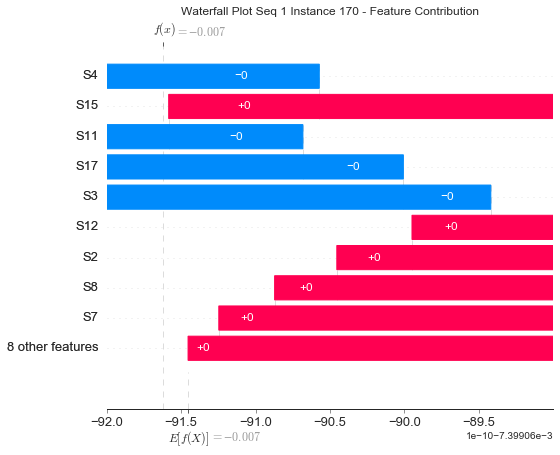

None

Contribution: [ 4.07477489e-11  8.64294660e-12 -5.46670478e-12 -3.80797095e-11
  1.77456817e-11  4.60016573e-11 -2.69397248e-11 -1.18090303e-12
 -8.75443381e-12  1.24448689e-11 -4.00527077e-11  1.32305425e-11
 -6.00385301e-13 -1.27352616e-11  2.24723989e-11 -1.10872492e-11
 -2.60663834e-11]


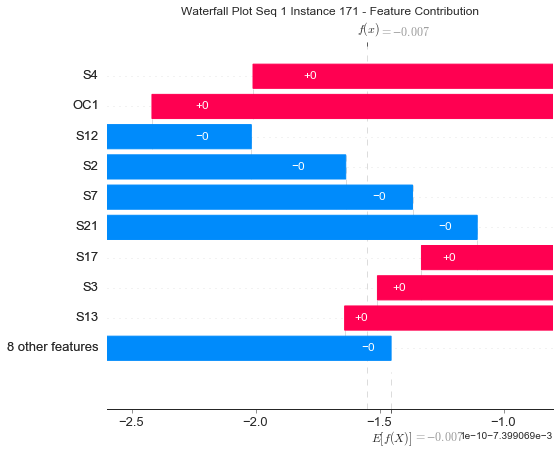

None

Contribution: [-6.50714075e-13  4.59233866e-12  2.17951048e-12  4.76814812e-12
  1.40283217e-12  6.92432223e-12 -4.62897559e-12 -1.11928218e-12
  1.01117725e-12  7.82969349e-12 -6.65763018e-12 -2.56860570e-12
  2.04109646e-12 -2.01410208e-11  4.30031314e-12 -2.60862274e-12
 -1.67495445e-12]


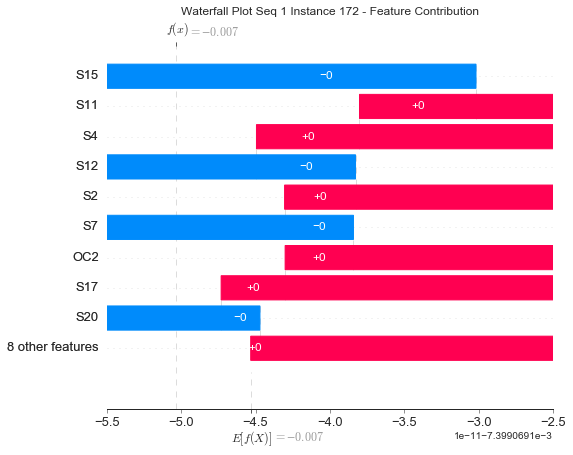

None

Contribution: [ 2.24097633e-11  8.67666963e-12  3.12264754e-12 -2.65533862e-11
  2.84658078e-11  5.42812115e-11 -9.21332802e-12 -2.68026278e-11
 -9.11420852e-12  3.87518732e-11 -1.82953548e-11 -1.83177171e-11
  6.73201382e-12 -7.96162025e-11  3.34782549e-11 -2.57470130e-12
 -1.11997937e-11]


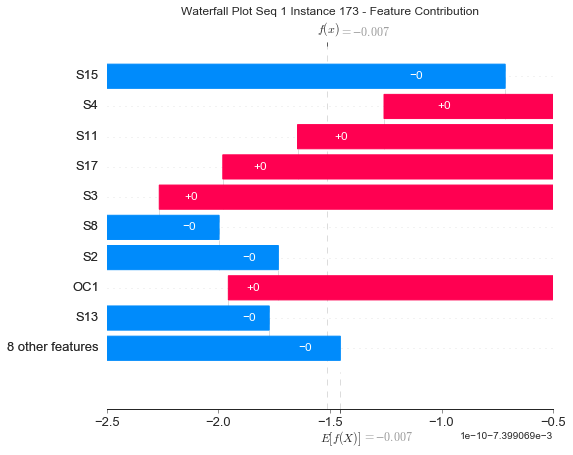

None

Contribution: [-2.52599521e-11 -8.07809028e-12  1.22891801e-11  2.10940414e-11
  4.40045222e-12 -1.01977394e-11  1.67995097e-11 -1.85818305e-11
  4.87534709e-12  1.50181412e-11  2.82379554e-11 -2.80068625e-11
  8.18330907e-12 -5.05026056e-11 -3.38250803e-13  8.07941908e-12
  1.41506347e-11]


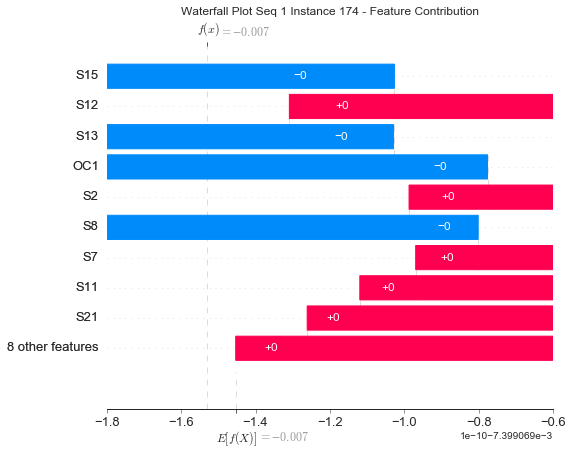

None

Contribution: [ 3.88221486e-12  8.22370644e-12 -1.67923791e-12  9.75571793e-12
 -7.28872518e-12 -8.10767686e-12 -3.95302324e-12  7.47021802e-12
  1.09711502e-12 -1.08080636e-11 -5.11041643e-12  1.32700578e-12
  2.40242895e-12 -2.87875626e-12 -6.57014894e-12 -1.81068767e-12
 -1.16925870e-12]


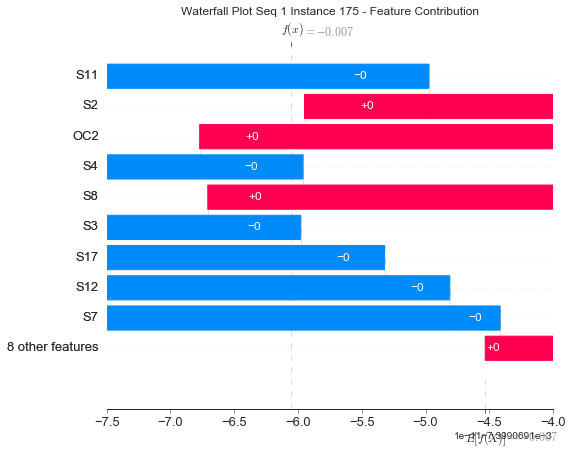

None

Contribution: [-2.49690130e-11 -1.43569210e-11  3.06310641e-12  5.51980293e-12
 -1.06939882e-11 -3.26832242e-11  2.02324008e-11 -1.13025377e-12
  1.48817948e-12 -8.99319594e-12  2.56835265e-11 -4.22511592e-12
 -1.73880420e-12  2.46277183e-11 -9.28985448e-12  7.38317914e-12
  1.64448628e-11]


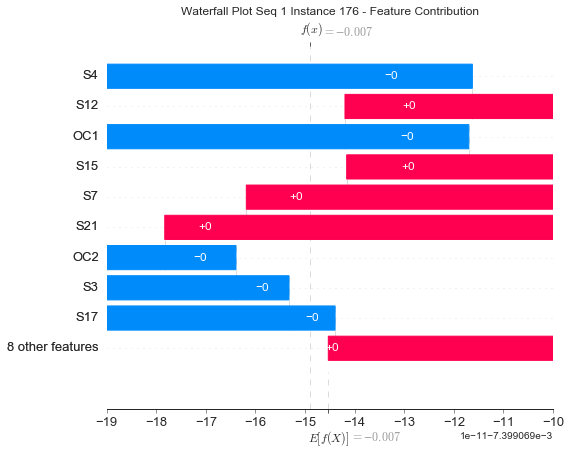

None

Contribution: [ 1.71986054e-11  3.44129673e-12 -1.61290668e-11 -8.46843974e-15
 -2.23446157e-11 -2.74731626e-11 -6.81175645e-12  3.24114832e-11
  1.34240861e-12 -5.38296595e-11 -7.41079594e-12  3.00971505e-11
 -7.81321882e-12  8.21810536e-11 -2.41810443e-11 -1.85700565e-12
 -7.25642203e-12]


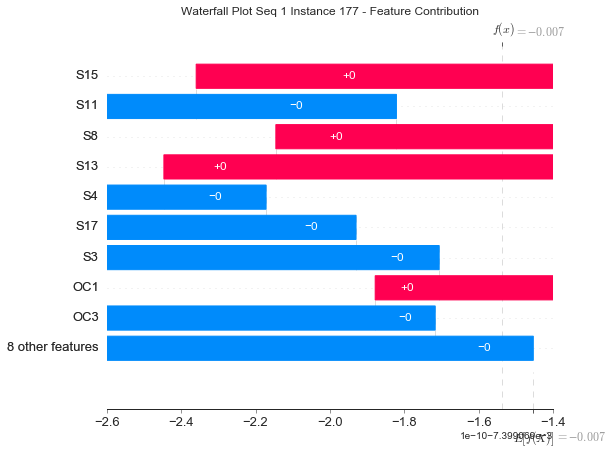

None

Contribution: [ 1.97360253e-11  8.83012760e-12 -1.79133861e-11  8.40829413e-13
 -2.13069805e-11 -1.87290825e-11 -1.37003722e-12  2.69553685e-11
 -2.51390597e-12 -5.03395520e-11 -2.96692987e-12  2.13581479e-11
 -6.12659446e-12  5.91051721e-11 -2.45515483e-11 -5.02235277e-14
 -2.34428579e-12]


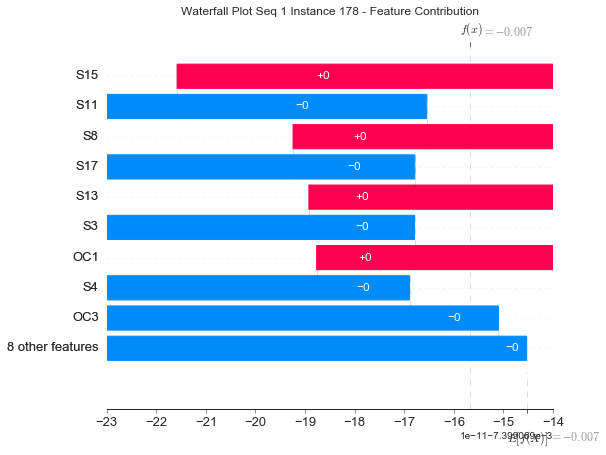

None

Contribution: [-9.39175994e-12  1.55943693e-12  0.00000000e+00  2.54869528e-11
 -1.27467498e-11 -2.15344895e-11  8.13136884e-12  9.02754781e-12
  4.85804582e-12 -1.26700603e-11  1.20375550e-11 -1.58980715e-14
  1.81466257e-12 -5.21167050e-12 -1.46020765e-11  3.47495296e-12
  9.13530016e-12]


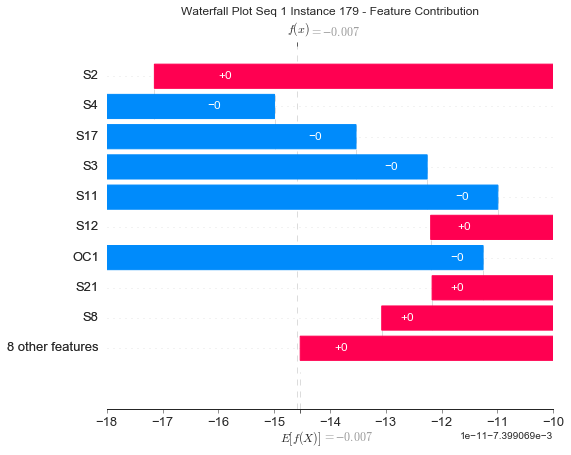

None

Contribution: [-2.37258043e-11  6.31339989e-12  1.36697329e-11  1.87983708e-11
  1.09764810e-11  1.31246940e-11  5.62537517e-12 -2.34736102e-11
  2.61727640e-12  3.64550473e-11  1.44642484e-11 -3.08034709e-11
  1.21028161e-11 -8.86106050e-11  1.14239009e-11  3.20831361e-12
  8.08684369e-12]


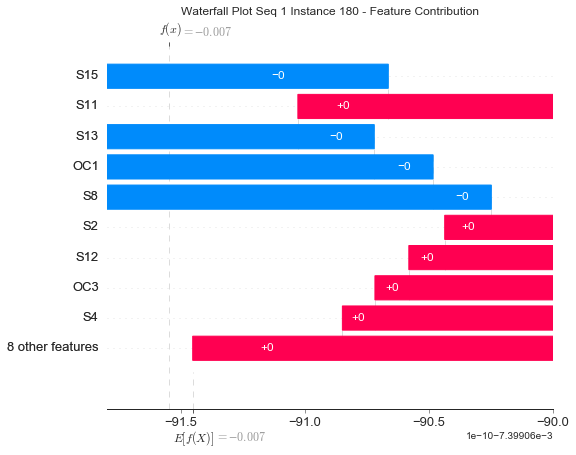

None

Contribution: [ 9.96329148e-12  8.80057572e-12 -2.33020287e-11  1.45903550e-11
 -3.32377251e-11 -5.11040862e-11  5.72603466e-12  3.63645607e-11
  6.40018474e-13 -7.11326067e-11  7.20548144e-12  2.86834393e-11
 -6.63732827e-12  8.90737761e-11 -3.70084380e-11  3.25170489e-12
  5.58308304e-12]


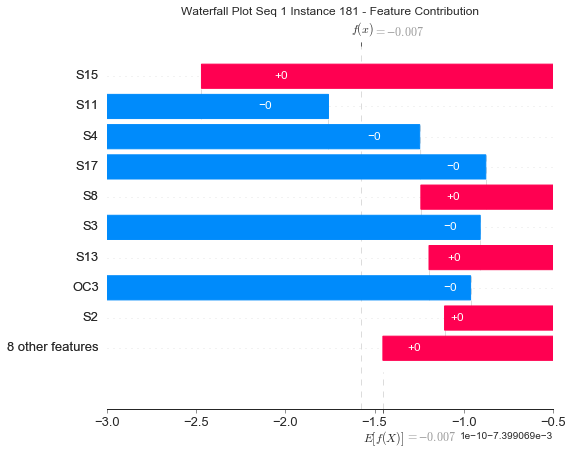

None

Contribution: [-7.00028273e-12 -2.88387218e-12  9.17286559e-12 -8.80361702e-13
  8.84887476e-12  8.56387877e-12 -4.81733685e-13 -1.16574909e-11
  1.15615850e-12  1.70124349e-11 -7.78904285e-13 -1.03989577e-11
  4.78632238e-12 -2.35950096e-11  6.66211357e-12 -1.17940868e-12
  2.28524041e-13]


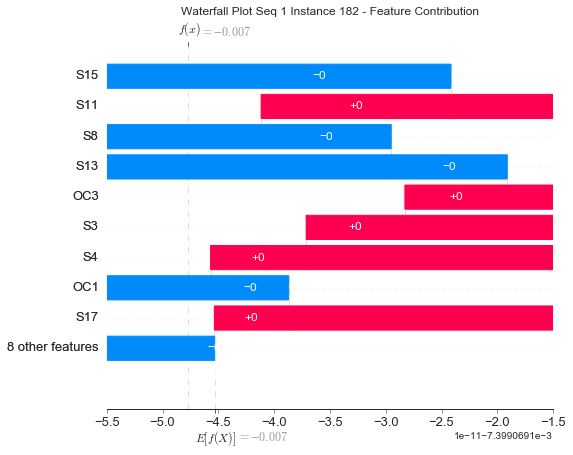

None

Contribution: [ 6.39194114e-11  3.55299887e-11  0.00000000e+00 -8.92911092e-11
  5.89516075e-11  1.30249825e-10 -6.12008291e-11 -3.17332688e-11
 -1.81154848e-11  6.67024561e-11 -8.62734953e-11  9.56009157e-15
  5.59169117e-12 -7.55932608e-11  7.06651404e-11 -2.73887683e-11
 -5.08427953e-11]


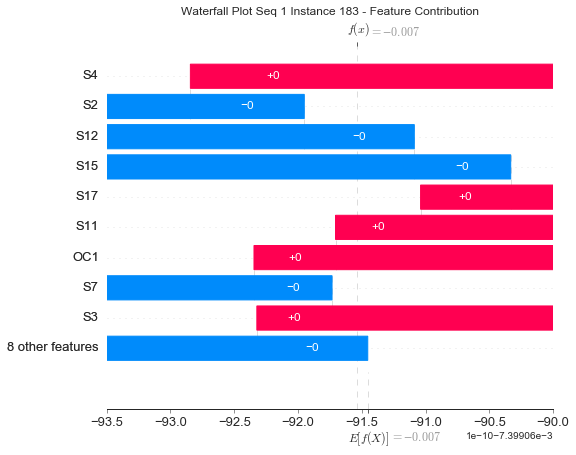

None

Contribution: [ 2.43231685e-11 -1.11765822e-11  0.00000000e+00 -3.98194672e-11
  2.76080131e-11  3.50165938e-11 -1.95801292e-11 -1.60018110e-11
 -6.40682993e-12  2.02467505e-11 -2.44995829e-11 -3.27718707e-14
 -1.15789919e-12 -1.47323600e-13  2.68248531e-11 -6.27366822e-12
 -2.05916985e-11]


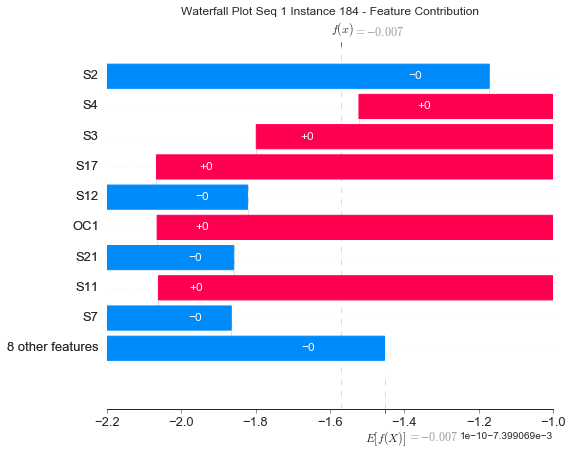

None

Contribution: [ 2.53429673e-11  4.27373718e-12  0.00000000e+00 -2.28913607e-11
  1.60689795e-11  3.57135779e-11 -1.57125684e-11 -8.93118999e-12
 -3.76601788e-12  1.41625956e-11 -2.06475219e-11 -3.06965350e-14
  1.62246985e-12 -2.31291531e-11  1.89596949e-11 -4.78569831e-12
 -1.55368374e-11]


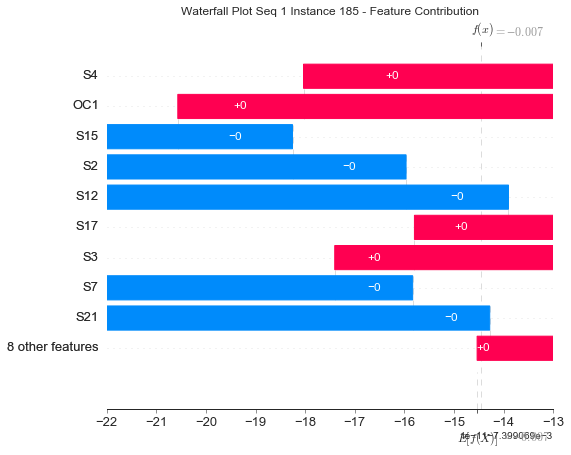

None

Contribution: [ 2.95022028e-11  1.36709108e-11  3.45279079e-12 -4.17037932e-11
  3.72873676e-11  6.93815977e-11 -3.37547906e-11 -2.06455842e-11
 -7.14627663e-12  4.33739260e-11 -4.87365634e-11 -5.10285911e-12
  3.61755634e-12 -5.13696620e-11  3.76362275e-11 -1.52971472e-11
 -2.58660610e-11]


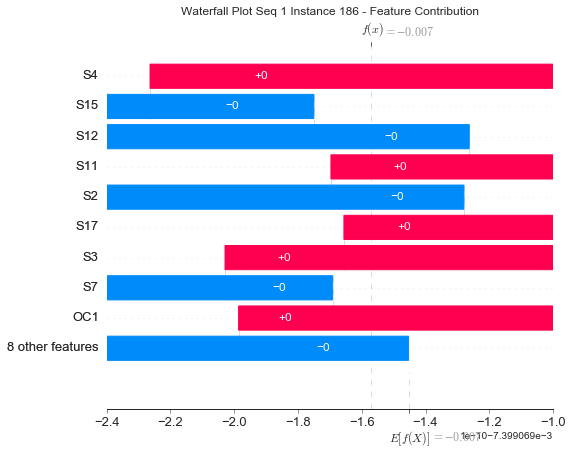

None

Contribution: [-1.64085655e-11 -1.35734661e-11  1.27166350e-11  1.37798609e-11
  1.01412602e-11 -3.03498459e-12  1.53750762e-11 -1.92430603e-11
  2.13405986e-12  1.90102552e-11  2.15204052e-11 -2.49822732e-11
  8.16192600e-12 -5.32720951e-11  3.36158770e-12  7.54412765e-12
  1.10122952e-11]


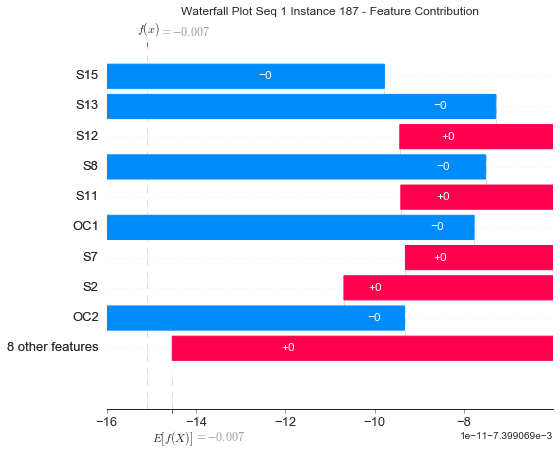

None

Contribution: [-2.62723038e-11 -4.61414457e-12  1.54514075e-11  1.54759313e-11
  1.01373025e-11  9.21174855e-12  6.99571260e-12 -2.38018997e-11
  3.57360517e-12  3.01298292e-11  1.89638461e-11 -3.18640739e-11
  1.12326641e-11 -6.49252804e-11  9.93256952e-12  4.68452100e-12
  7.71043385e-12]


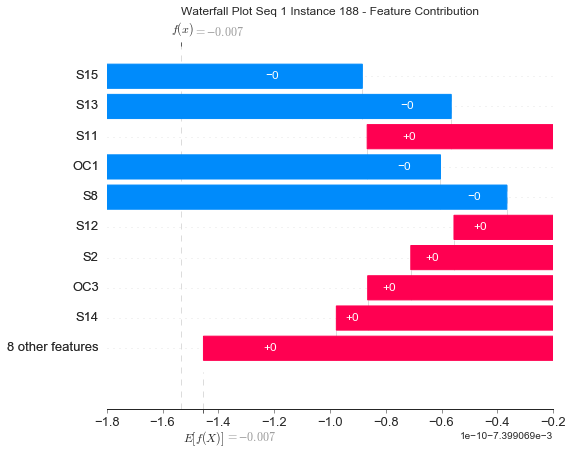

None

Contribution: [ 3.11970484e-11  1.32609418e-11 -3.44708810e-11  1.22458849e-11
 -4.87102650e-11 -5.56696529e-11  3.98012656e-12  5.44717708e-11
 -1.79485333e-12 -1.01398362e-10  4.21201962e-12  4.83966998e-11
 -1.32984361e-11  1.20378651e-10 -4.61630317e-11  3.29620554e-12
  1.32718793e-12]


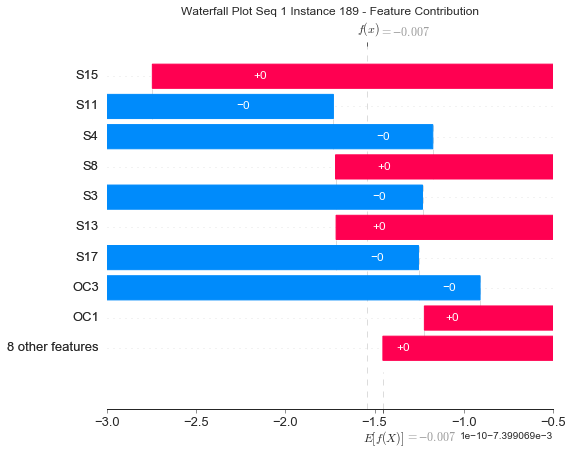

None

Contribution: [ 3.39972078e-11  2.52116314e-11  0.00000000e+00 -1.96102995e-11
  2.38024392e-11  6.70694611e-11 -3.53091688e-11 -8.15915131e-12
 -4.82116907e-12  3.29894827e-11 -4.81502303e-11  1.89809953e-14
  6.56640280e-12 -5.88633170e-11  2.92572494e-11 -1.52076754e-11
 -2.65121779e-11]


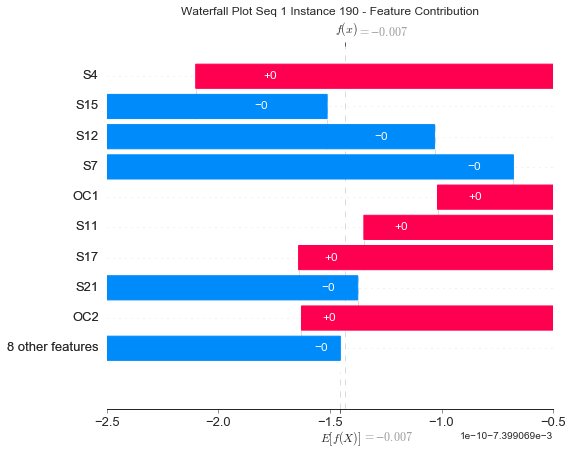

None

Contribution: [ 3.05022743e-11  7.64300168e-12  1.63373655e-11 -4.92562970e-11
  5.26910807e-11  8.69558522e-11 -3.16922530e-11 -3.82100220e-11
 -8.20872623e-12  7.41576106e-11 -4.45228888e-11 -1.90024090e-11
  9.27662721e-12 -9.61886126e-11  5.51644459e-11 -1.29213645e-11
 -2.91284809e-11]


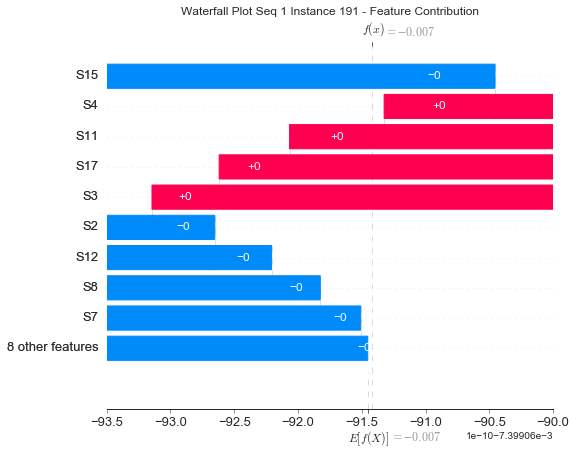

None

Contribution: [-6.92960142e-12 -6.14862805e-12  4.16164022e-12  1.26957507e-11
 -3.88161074e-12 -1.41453177e-11  7.99838581e-12 -4.76674429e-12
  2.31512617e-12 -3.90670612e-12  1.12341794e-11 -9.14000126e-12
  1.88075141e-12 -1.08568996e-11 -4.05192026e-12  3.80014509e-12
  5.46545881e-12]


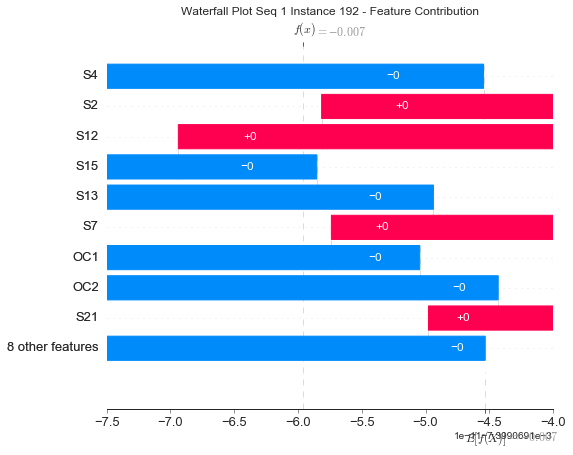

None

Contribution: [-5.95345856e-11 -2.03418705e-11  0.00000000e+00  6.85777962e-11
 -5.10653429e-11 -9.82609619e-11  4.73346119e-11  2.46523479e-11
  1.25606791e-11 -5.27898905e-11  6.63059468e-11 -1.57062067e-14
 -2.80464671e-12  5.89231164e-11 -5.35159209e-11  1.77002111e-11
  4.13325034e-11]


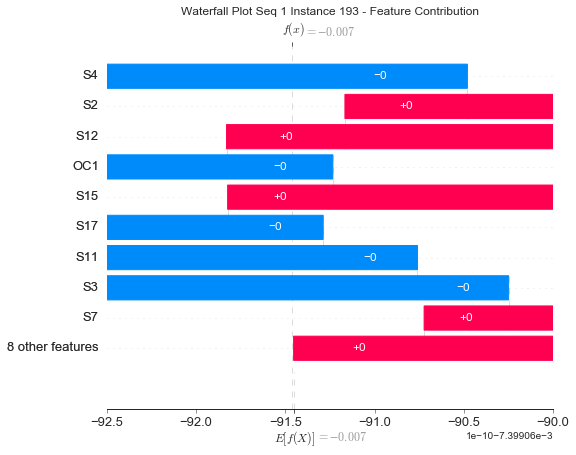

None

Contribution: [-2.97598855e-11 -1.65270124e-11  1.42789400e-11  1.77363020e-11
 -2.64467137e-12 -3.31043283e-11  2.27346319e-11 -1.11706824e-11
  4.54174068e-12  2.29410046e-12  2.91790168e-11 -1.96592499e-11
  2.38862250e-12 -1.23522078e-11 -7.51000651e-12  9.07582516e-12
  1.80164252e-11]


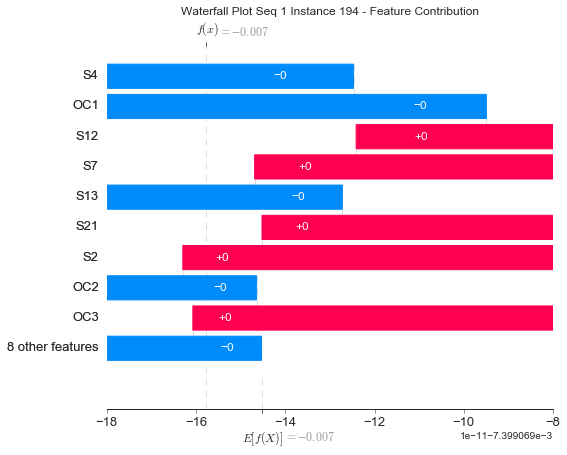

None

Contribution: [ 6.12747630e-11  2.79821964e-11  0.00000000e+00 -6.00505062e-11
  4.94369372e-11  1.04799829e-10 -5.02635711e-11 -2.18208802e-11
 -1.29166634e-11  5.46446742e-11 -7.24056648e-11  3.42983630e-14
  5.94042610e-12 -7.99903407e-11  5.10319252e-11 -2.19164721e-11
 -4.05942190e-11]


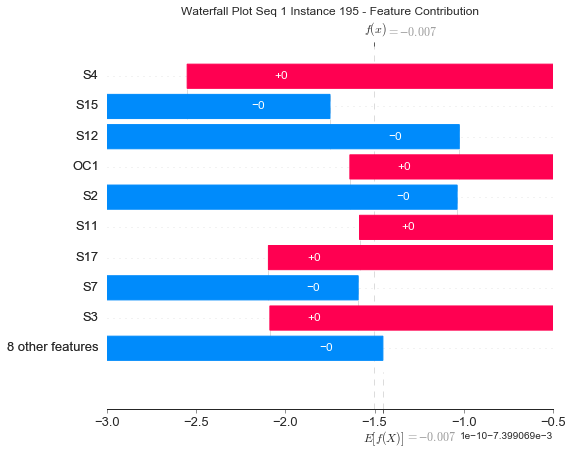

None

Contribution: [ 2.90738007e-12  1.84728383e-12  1.66499800e-12  1.81154711e-12
 -2.76390044e-12 -8.91387311e-12 -8.49362074e-12  4.71301210e-12
  2.22698856e-12 -6.47824719e-12 -4.30751962e-12  3.54042273e-12
  4.39827341e-12  6.63007973e-12 -2.52248743e-12 -1.75832656e-12
 -7.39284328e-12]


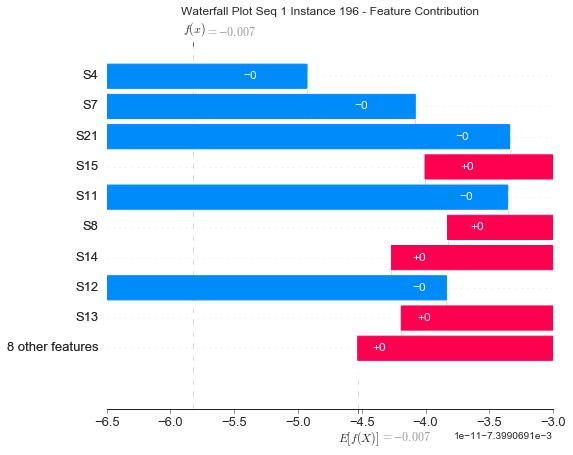

None

Contribution: [ 1.53943282e-11  1.41959595e-11 -2.00523799e-11  1.22069395e-11
 -3.09305637e-11 -3.21589734e-11 -8.91737552e-12  4.16683493e-11
  1.91333624e-12 -5.74041127e-11 -1.08459873e-11  4.01001940e-11
 -5.61417709e-12  6.82340295e-11 -3.17653681e-11 -4.38400835e-12
 -5.52682943e-12]


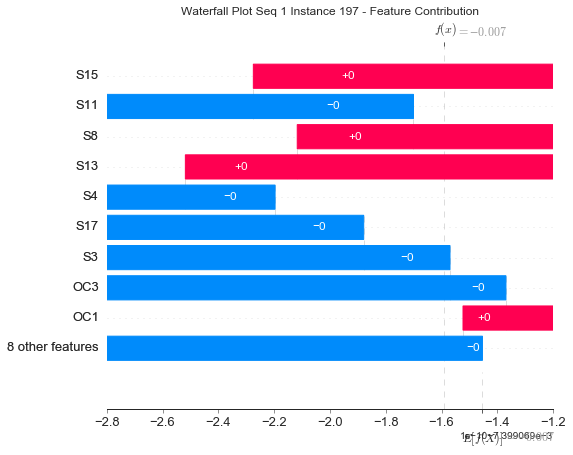

None

Contribution: [-3.77514478e-11 -2.05100017e-11 -2.00398465e-11  7.04325626e-11
 -7.62320346e-11 -1.36335471e-10  4.07764274e-11  6.36876801e-11
  1.51255137e-11 -1.13292591e-10  5.49479663e-11  3.94905914e-11
 -1.37463374e-11  1.50660165e-10 -8.36702443e-11  1.63442333e-11
  3.56329584e-11]


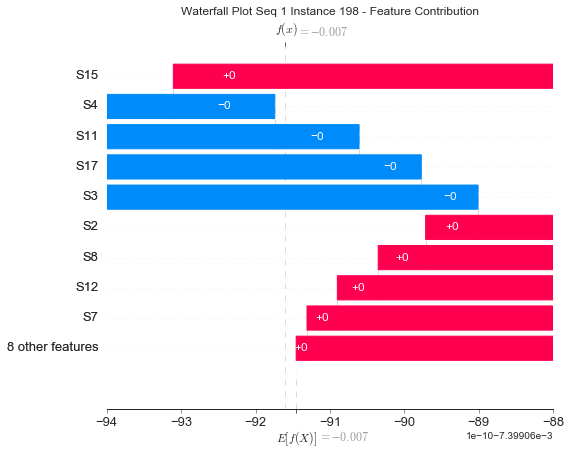

None

Contribution: [-1.31452809e-11 -6.65278900e-12  4.87955249e-12  1.94982919e-11
 -5.49574232e-12 -2.84631520e-11  1.18834014e-11 -1.93411194e-12
  6.30627885e-12 -1.00634570e-11  2.27811815e-11 -1.00973023e-11
  1.62460496e-12 -3.51299849e-12 -1.23297865e-11  5.79343865e-12
  8.63102038e-12]


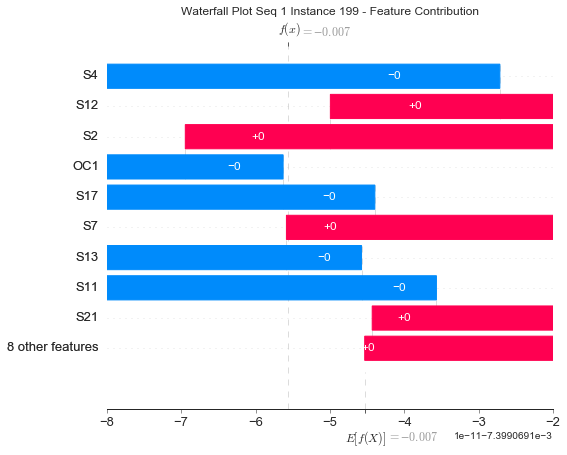

None

Contribution: [-1.16751131e-11 -8.92880041e-12  4.38948010e-12 -6.73659436e-12
  9.93280458e-12  1.12893841e-12  5.39030496e-12 -1.38964075e-11
 -1.48915786e-12  1.39673984e-11  2.35878526e-12 -6.51224907e-12
 -8.82921882e-13 -1.08831208e-11  1.12011849e-11  1.81095796e-12
  4.15785505e-12]


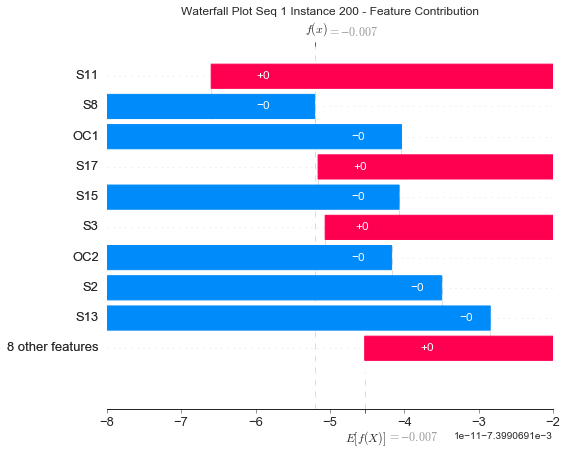

None

Contribution: [-2.87876632e-11 -7.51390183e-12  9.09518381e-12  1.68553400e-11
 -1.07500293e-12 -9.30264199e-12  7.53123085e-12 -4.54408950e-12
  5.33039238e-12  1.89734131e-11  8.77506314e-12 -5.70075888e-12
  4.13834592e-12 -2.47601575e-11 -1.99569636e-13  7.74176567e-13
  1.00107240e-11]


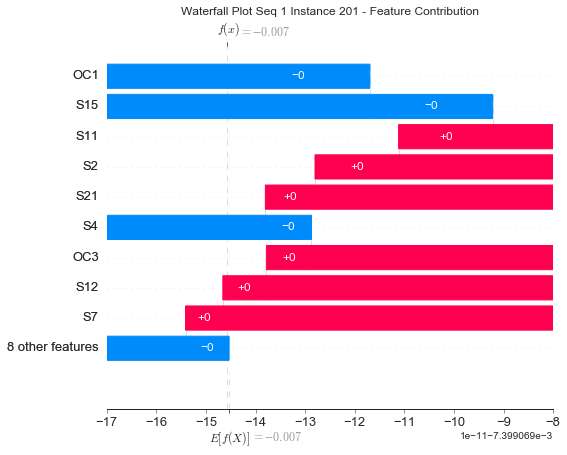

None

Contribution: [ 1.29536538e-11  1.03527751e-11  0.00000000e+00 -1.28937911e-11
  1.28044745e-11  3.72141623e-11 -1.67138352e-11 -4.51056640e-12
 -2.97828537e-12  1.77849489e-11 -2.46991004e-11  1.58979038e-14
  3.28881280e-12 -2.74630284e-11  1.47627795e-11 -8.24581375e-12
 -1.13536455e-11]


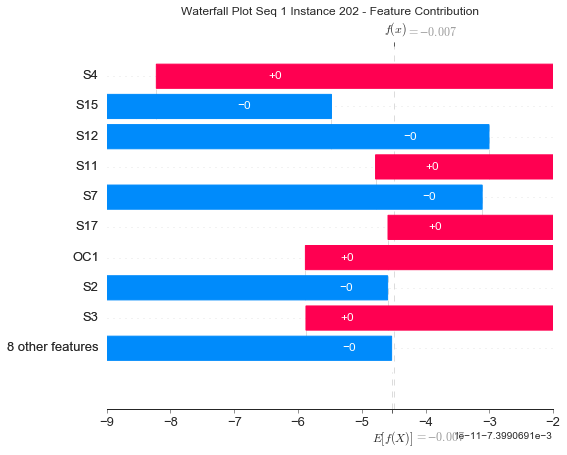

None

Contribution: [ 1.45207128e-11  9.42442391e-12  0.00000000e+00 -1.99225515e-11
  1.45099965e-11  3.14237074e-11 -1.55162758e-11 -6.94296617e-12
 -3.77329721e-12  1.51294671e-11 -2.52945304e-11  1.78140888e-14
  1.31544276e-12 -1.70268417e-11  1.79293195e-11 -7.74842690e-12
 -1.12303040e-11]


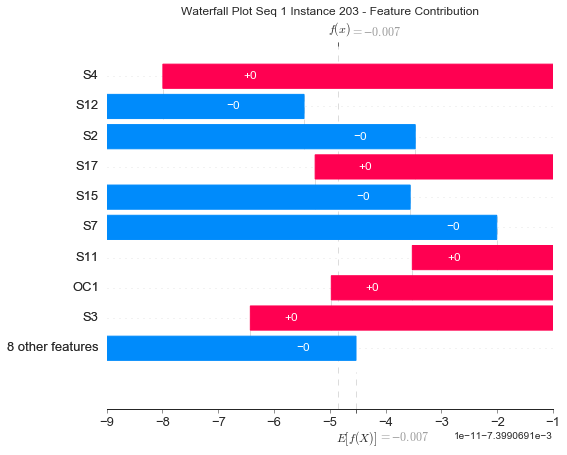

None

Contribution: [-6.09960389e-12 -3.30493879e-12 -1.00225002e-11  1.90566677e-11
 -3.09465578e-11 -5.30403846e-11  9.20393015e-12  2.77673804e-11
  4.29598197e-12 -5.05188946e-11  1.27751438e-11  2.45300620e-11
 -6.42428168e-12  7.75478987e-11 -3.25678165e-11  4.48139963e-12
  7.44332894e-12]


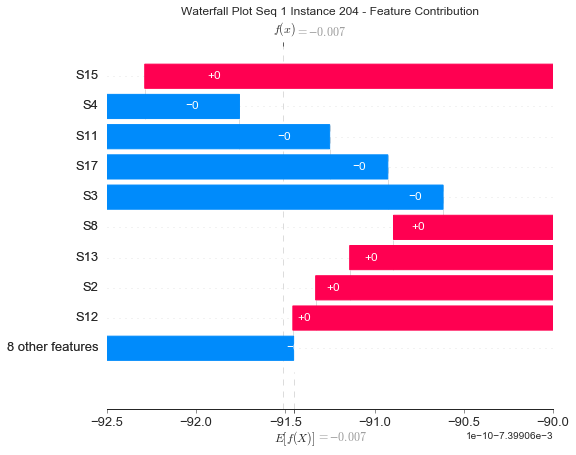

None

Contribution: [ 2.73741845e-11  2.25292666e-11  0.00000000e+00 -2.53134944e-11
  2.04426892e-11  5.08041630e-11 -2.82241158e-11 -9.87568360e-12
 -5.69710164e-12  2.40983882e-11 -3.74308674e-11  8.82964170e-15
  4.17204032e-12 -4.09217868e-11  2.47802022e-11 -1.20054262e-11
 -2.19440317e-11]


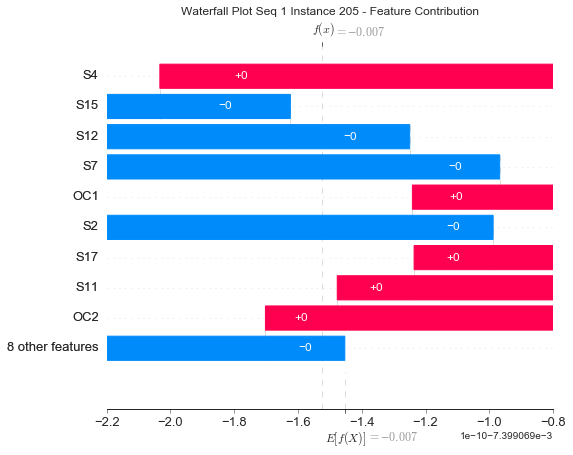

None

Contribution: [-1.70910924e-11 -3.12598233e-12  8.65083786e-12  1.27704488e-11
 -3.35576228e-12 -7.39623814e-12  8.22571698e-12 -3.75735033e-12
  3.13079727e-12  5.96208369e-12  9.48766673e-12 -1.09442134e-11
  3.73446196e-12 -1.23626109e-11 -5.55991451e-12  2.67425383e-12
  9.13882772e-12]


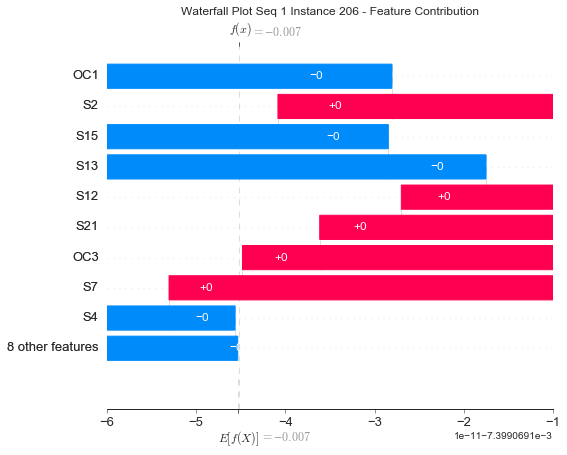

None

Contribution: [ 1.51567682e-11  2.06754058e-11  0.00000000e+00 -3.91097484e-12
  6.16768008e-12  3.37604389e-11 -1.74353778e-11 -1.56517421e-12
 -2.24804615e-12  1.48262236e-11 -2.43060485e-11  2.65725637e-14
  5.08889328e-12 -4.67298596e-11  8.34135018e-12 -8.88198629e-12
 -1.15329968e-11]


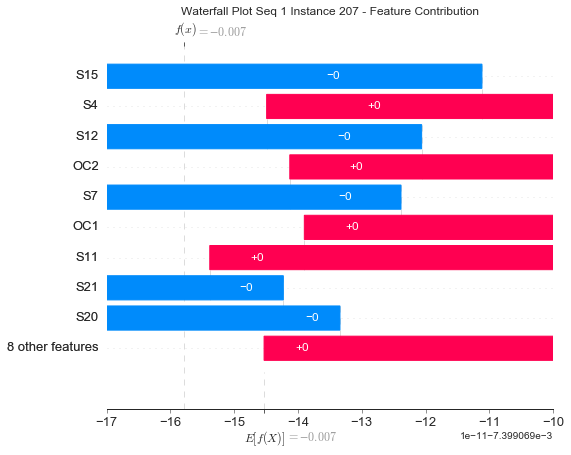

None

Contribution: [-1.99140773e-11 -1.98312321e-11  7.36068498e-12  2.05860294e-11
 -1.09870342e-11 -4.02231651e-11  2.09082838e-11 -5.29432509e-13
  5.41870151e-12 -1.49340852e-11  3.50666371e-11 -1.13102670e-11
  3.01065683e-12  2.61977289e-12 -1.53106798e-11  1.08652939e-11
  1.33610328e-11]


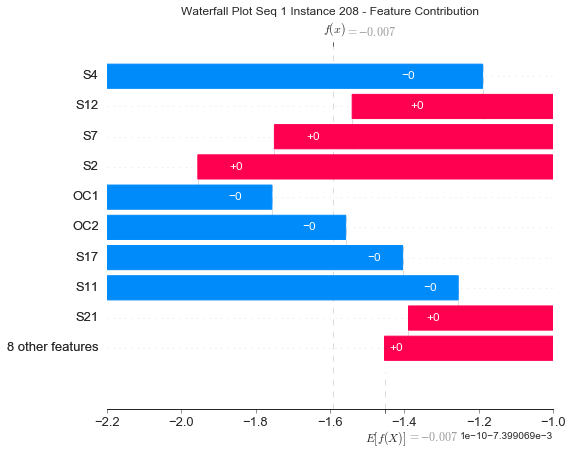

None

Contribution: [-6.84485238e-12 -3.61049016e-12  1.10676997e-11 -9.61495120e-12
  2.54660026e-11  2.94105781e-11  2.10198569e-12 -2.76968882e-11
 -2.87062301e-12  4.63934689e-11 -4.25045459e-12 -2.11321464e-11
  5.85174964e-12 -7.33760969e-11  2.73554235e-11  3.14721014e-13
  1.48388073e-12]


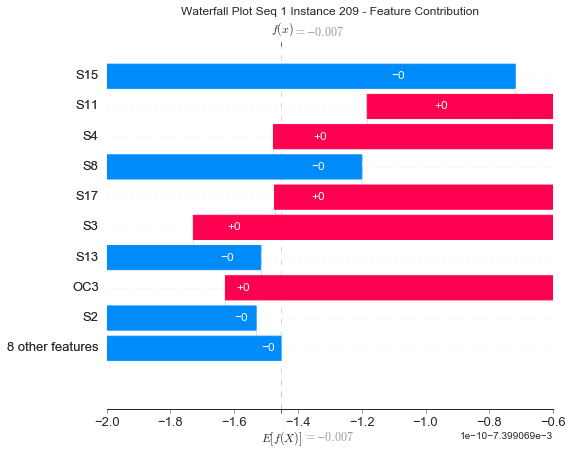

None

Contribution: [-4.45491422e-11 -1.76269693e-11  7.32958225e-12  4.81540988e-11
 -3.31453094e-11 -7.16894460e-11  3.47368141e-11  1.26589182e-11
  1.10747462e-11 -3.29451189e-11  5.55950321e-11 -1.00505914e-11
  2.48717214e-12  2.58436259e-11 -4.29023067e-11  1.60578217e-11
  3.01323862e-11]


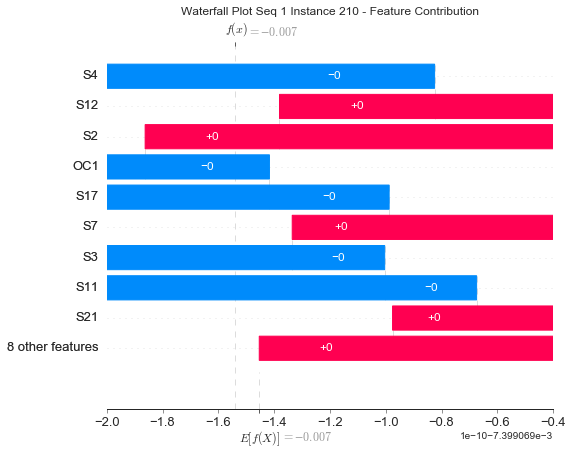

None

Contribution: [-3.29996204e-11 -1.35466499e-11 -1.87731740e-11  5.94912036e-11
 -6.91796273e-11 -1.18997520e-10  4.16228267e-11  5.08838388e-11
  8.98442432e-12 -9.31367622e-11  5.31392048e-11  3.78350441e-11
 -1.40383165e-11  1.27681352e-10 -7.26279037e-11  1.56899372e-11
  3.26302076e-11]


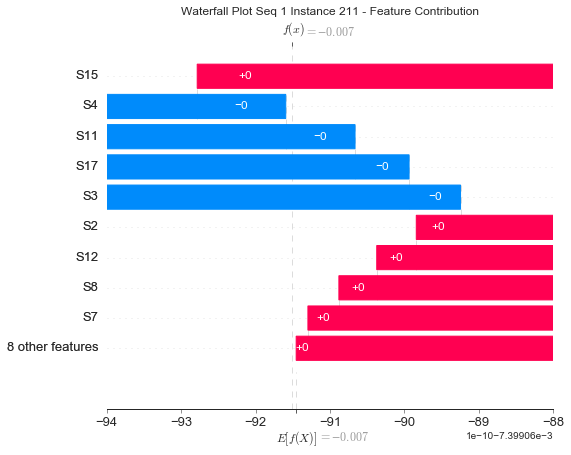

None

Contribution: [-1.68397657e-11 -1.48474267e-12  3.57414879e-12  3.94185969e-11
 -2.39857179e-11 -3.90320207e-11  1.55689871e-11  1.27950827e-11
  8.60555724e-12 -2.53179890e-11  2.34091184e-11 -4.50651842e-12
  1.13567163e-12  6.37924435e-12 -2.74719501e-11  6.46458841e-12
  1.47940271e-11]


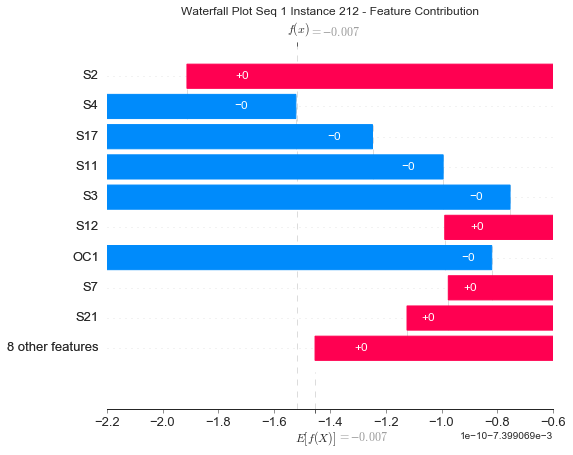

None

Contribution: [ 1.23322160e-11  4.08452135e-12  0.00000000e+00 -1.77829539e-11
  1.12179996e-11  3.02272062e-11 -1.13693594e-11 -6.41829732e-12
 -4.83817023e-12  1.55670529e-11 -1.73228914e-11  1.09786558e-14
  2.06876053e-12 -2.45266325e-11  1.54608132e-11 -4.65837438e-12
 -9.40246058e-12]


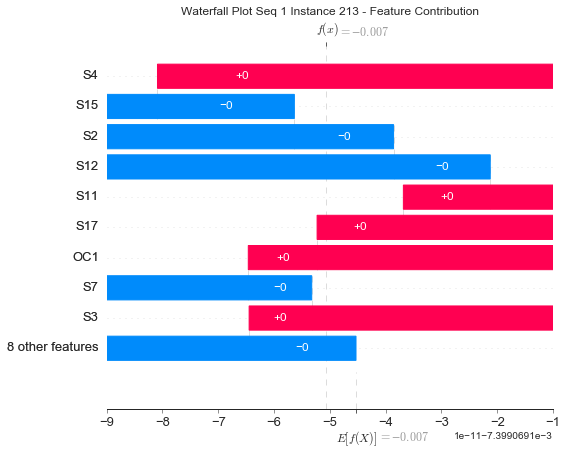

None

Contribution: [ 1.48646568e-12  8.48461113e-13  1.32776038e-12 -3.66216779e-12
  2.31337020e-12  1.95745330e-12 -6.48848813e-13 -1.69876201e-12
 -7.98536801e-13  1.28941703e-12 -6.17884476e-12 -2.58618279e-12
  1.03268631e-13 -6.74560754e-12  3.30318368e-12 -7.43214409e-13
  5.43245028e-13]


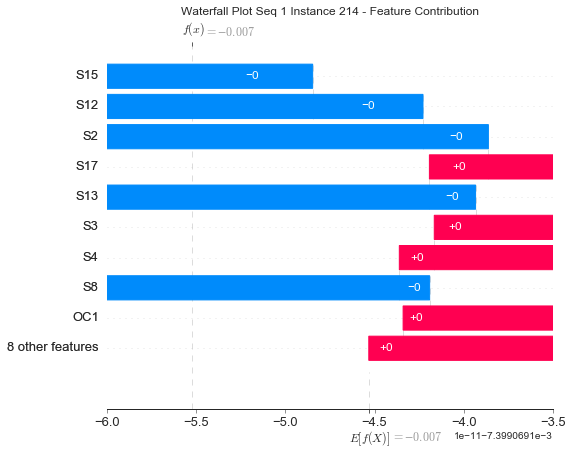

None

Contribution: [-4.32691279e-11 -2.13840230e-11  3.86977299e-12  5.60403321e-11
 -4.68772313e-11 -9.17011467e-11  3.89805931e-11  2.32415129e-11
  1.21173393e-11 -5.40139183e-11  6.21784638e-11 -7.71710170e-13
 -1.92342279e-12  5.88590635e-11 -5.39418406e-11  1.68378887e-11
  3.09336931e-11]


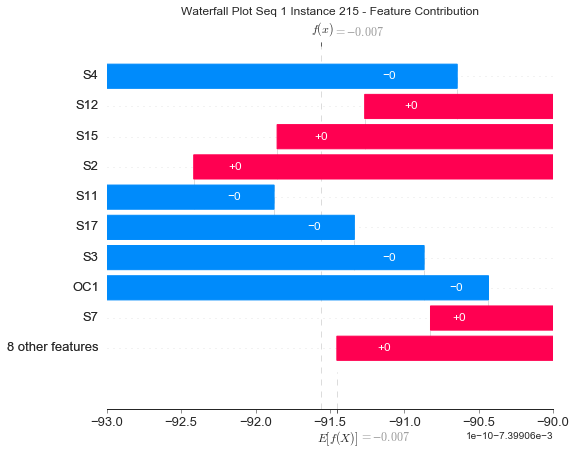

None

Contribution: [-1.12815104e-11 -5.52422095e-13  0.00000000e+00  2.87011335e-11
 -1.78979973e-11 -3.19688997e-11  1.08506867e-11  9.75683163e-12
  5.71797037e-12 -1.78988699e-11  1.59918918e-11 -1.14376705e-14
  4.43881856e-13  4.38916644e-13 -1.91477147e-11  4.87485313e-12
  9.83200067e-12]


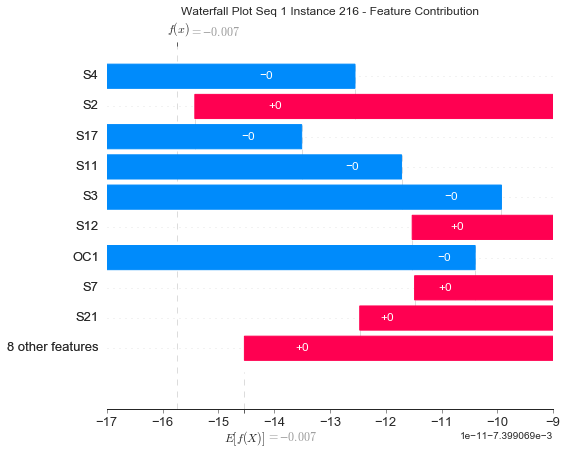

None

Contribution: [ 2.18773545e-12  3.26793432e-12  2.03326356e-13 -7.89454385e-13
  1.39789699e-12 -1.36350501e-12 -3.78547844e-12  8.84452745e-15
  5.81071649e-13 -1.26548902e-12 -2.83718947e-12  2.40529249e-13
 -5.47299510e-13  3.41531621e-12 -1.47242342e-12 -2.14510939e-12
 -2.39442233e-12]


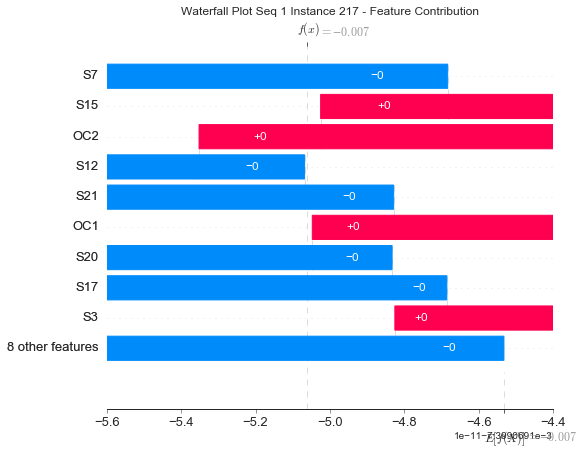

None

Contribution: [ 1.41018508e-11  5.44342999e-12 -2.06826969e-11 -8.23948462e-12
 -1.33064436e-11  5.22195676e-13 -4.73429672e-12  2.30355058e-11
 -4.76357105e-12 -2.89425307e-11 -1.42340480e-11  3.35960634e-11
 -5.58752003e-12  3.80509270e-11 -8.00760153e-12 -2.91380657e-12
 -2.47870062e-12]


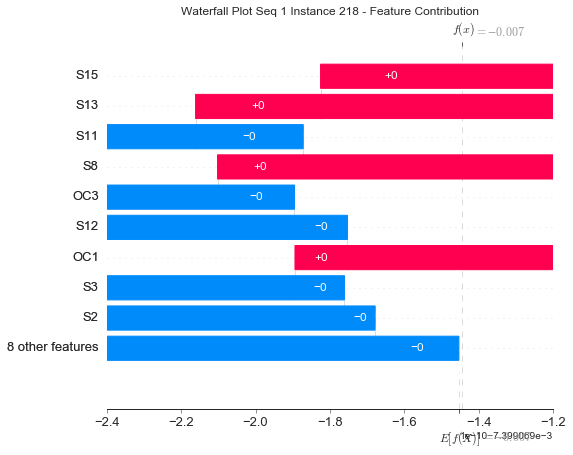

None

Contribution: [-3.45006940e-11 -2.09289443e-11 -1.85973077e-11  6.21717330e-11
 -7.46976578e-11 -1.36067907e-10  4.68254359e-11  5.78710829e-11
  1.20953039e-11 -1.05214774e-10  6.23823979e-11  4.11494866e-11
 -1.62380161e-11  1.53528634e-10 -8.11742132e-11  1.84221857e-11
  3.50746307e-11]


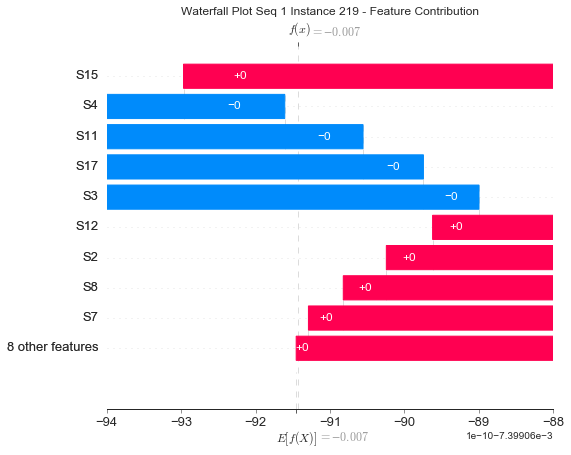

None

Contribution: [ 3.45941401e-11  9.97906445e-12  1.07882724e-14 -2.46910721e-11
  1.42662427e-11  3.31428669e-11 -2.10721822e-11 -3.48666278e-12
 -4.39133539e-12  2.24781912e-12 -2.61526391e-11 -1.25597839e-12
 -4.49633379e-14  5.46442557e-13  1.24198473e-11 -8.12155117e-12
 -2.12305538e-11]


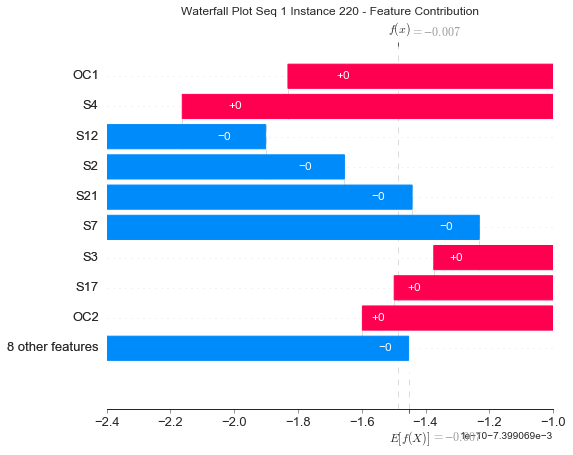

None

Contribution: [-1.60910781e-11 -2.12083259e-12  0.00000000e+00  1.58813709e-11
 -1.01342563e-11 -2.73285630e-11  9.26878019e-12  5.61666078e-12
  3.75654282e-12 -1.41650199e-11  1.30735900e-11  1.82756981e-14
 -1.97133672e-12  1.93708868e-11 -1.36619726e-11  3.72761978e-12
  9.69777297e-12]


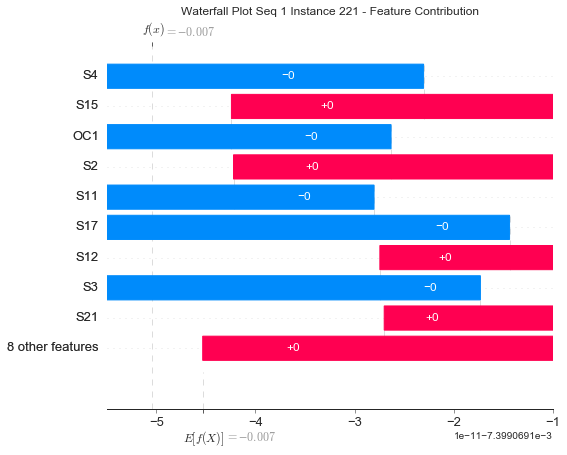

None

Contribution: [ 1.51665121e-11  6.54782348e-12  1.35391524e-11 -3.23120419e-11
  4.09120203e-11  7.00717262e-11 -2.08180053e-11 -3.72190265e-11
 -5.41738703e-12  6.43673101e-11 -2.29980843e-11 -2.73955442e-11
  9.41344225e-12 -9.46211165e-11  4.48982865e-11 -8.07167354e-12
 -1.79711575e-11]


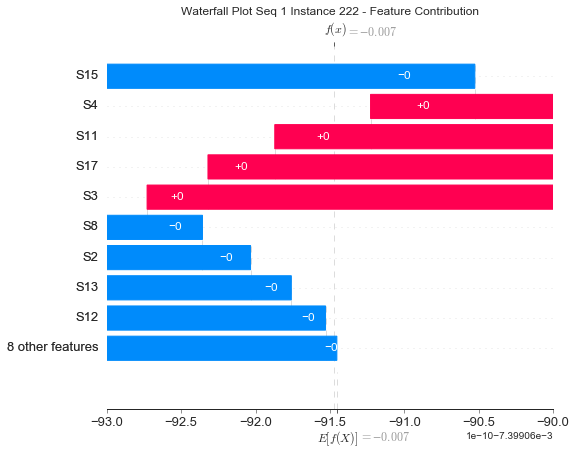

None

Contribution: [ 2.24952400e-11  4.92002186e-12  0.00000000e+00 -2.76823876e-11
  1.83846358e-11  3.69305107e-11 -1.74685596e-11 -1.04356029e-11
 -5.08149686e-12  1.53569935e-11 -2.38263905e-11  1.48443032e-14
 -2.63329912e-13 -1.34888021e-11  2.09444805e-11 -7.43176527e-12
 -1.72156872e-11]


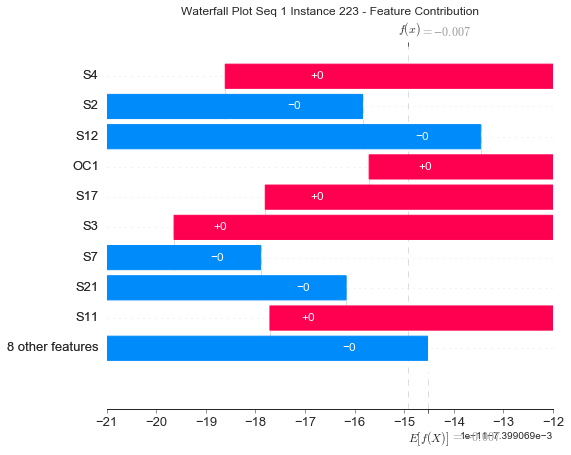

None

Contribution: [ 2.68146633e-11  1.94923643e-11  1.91972653e-11 -6.66597957e-11
  8.70258310e-11  1.60793837e-10 -4.03098874e-11 -7.31888161e-11
 -1.69401871e-11  1.34688385e-10 -6.93040625e-11 -5.05465080e-11
  1.86087621e-11 -1.99321282e-10  9.99158534e-11 -1.83110749e-11
 -3.15455301e-11]


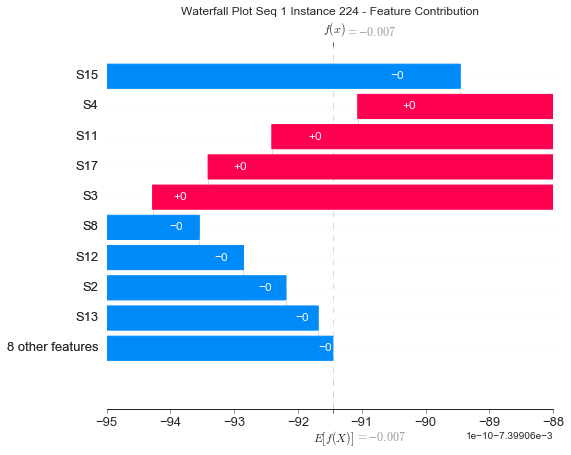

None

Contribution: [-1.09632043e-11 -2.41272020e-12 -1.60546958e-11  2.19798346e-11
 -3.36854988e-11 -5.16893056e-11  1.35768792e-11  3.09384150e-11
  4.23228249e-12 -5.05782777e-11  1.35271100e-11  2.78105265e-11
 -1.16642329e-11  8.15989290e-11 -3.28325978e-11  4.04282857e-12
  1.29999579e-11]


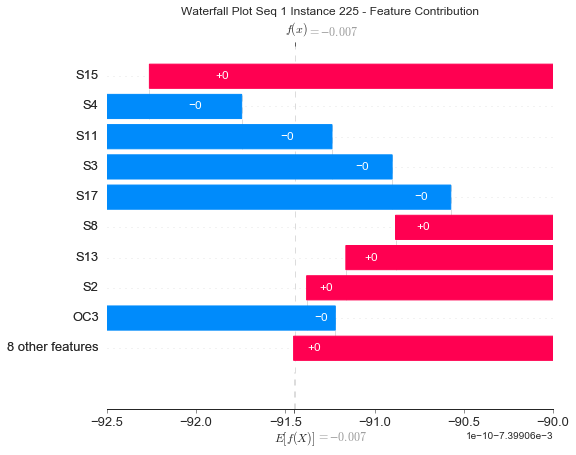

None

Contribution: [-9.92929914e-13  1.08758770e-12 -1.66558672e-12  3.78150717e-13
 -2.25485733e-12 -5.34031847e-12 -7.40337858e-13  3.15655466e-12
  4.12479133e-13 -5.05211281e-12  2.72361842e-12  1.98170907e-12
 -1.29158988e-12  1.36426955e-11 -1.13831893e-12 -7.42854075e-13
 -3.54447645e-13]


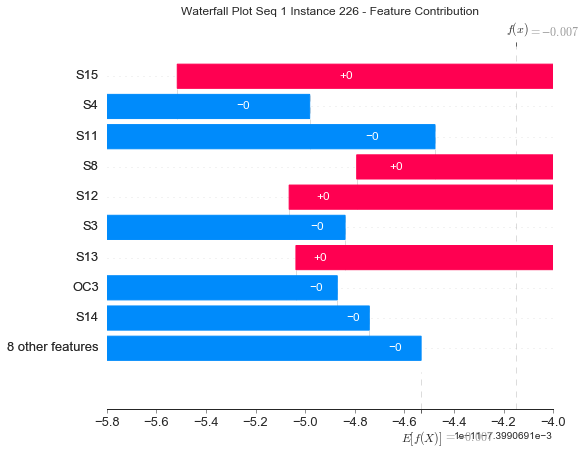

None

Contribution: [ 8.54695308e-12  8.85267814e-12 -2.47605907e-12  1.81271578e-12
  1.47610786e-12  1.24232647e-11 -5.96407819e-12  1.90164638e-12
 -9.58656006e-13  5.84824420e-12 -1.01867152e-11  3.72238828e-12
  2.22912162e-12 -2.62230463e-11  3.33265837e-12 -2.52103676e-12
 -4.05299926e-12]


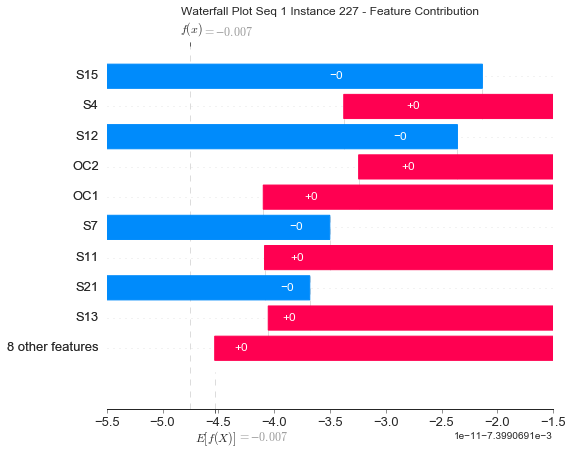

None

Contribution: [ 5.46002132e-11  1.32652309e-11  0.00000000e+00 -6.40771325e-11
  5.00208833e-11  1.03956579e-10 -4.71144131e-11 -2.55311241e-11
 -1.40955086e-11  5.54907162e-11 -7.10160333e-11  8.12975447e-15
  1.98070900e-12 -7.21770491e-11  5.83848664e-11 -1.64097572e-11
 -4.22673251e-11]


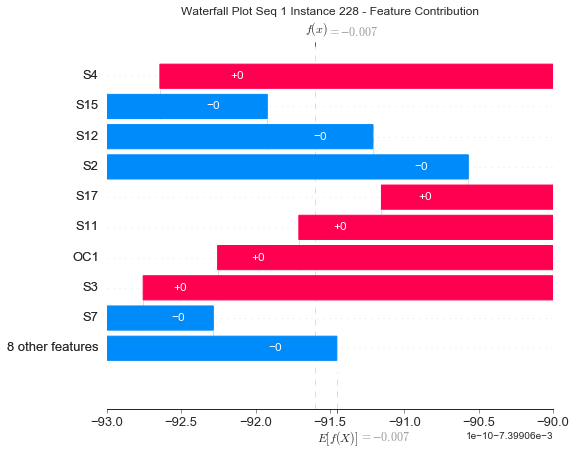

None

Contribution: [ 4.93191703e-11  1.48387674e-11  0.00000000e+00 -5.69288089e-11
  4.33751958e-11  8.95291688e-11 -4.19866537e-11 -2.26629861e-11
 -1.16466515e-11  4.58725766e-11 -6.40780970e-11  2.79061463e-15
  1.78773543e-12 -5.90078611e-11  5.11318765e-11 -1.26875793e-11
 -3.55419791e-11]


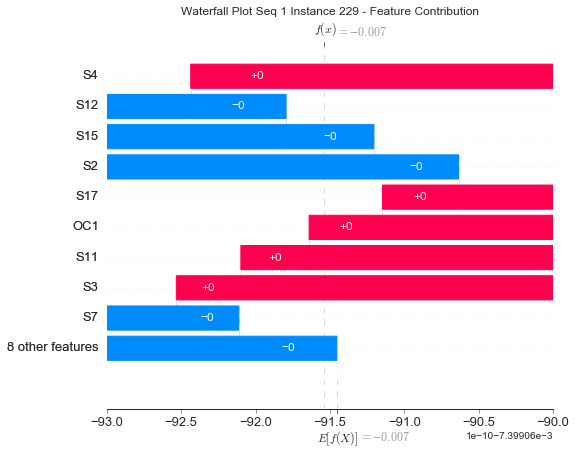

None

Contribution: [-6.68471311e-12 -4.05757025e-12  0.00000000e+00  1.19845592e-11
 -1.31492768e-11 -2.25728568e-11  6.99818155e-12  3.69556382e-12
  2.84897149e-12 -1.08464704e-11  1.72536603e-11  2.50812775e-14
 -1.82122741e-12  1.92112680e-11 -1.22718892e-11  1.36568675e-12
  3.30029623e-12]


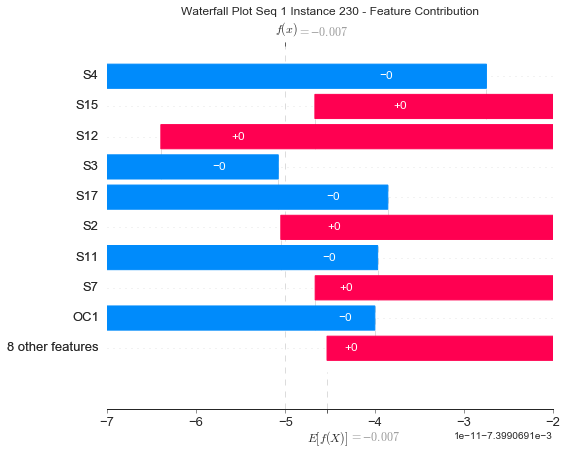

None

Contribution: [ 2.64153404e-11  6.88773821e-12 -1.29879631e-11 -5.33645914e-12
 -1.30070503e-11 -1.22127300e-11 -4.74946948e-12  2.07090681e-11
 -1.51643379e-12 -4.30504452e-11 -1.01013859e-11  1.30873923e-11
 -8.34037180e-12  5.63486202e-11 -8.79219007e-12  6.98110894e-13
 -6.68970825e-12]


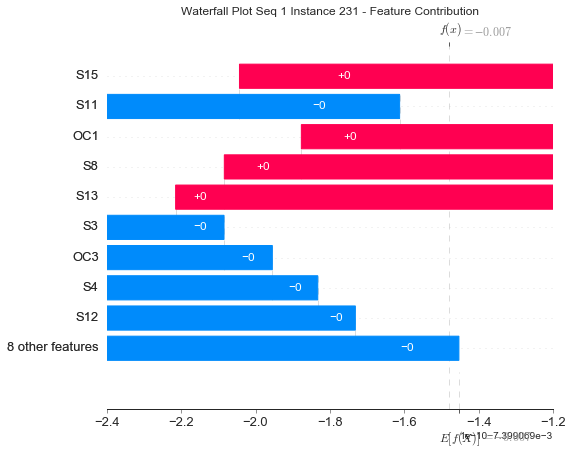

None

Contribution: [-3.73556481e-12  3.09284889e-12 -1.30372067e-11  1.90904115e-11
 -3.36757983e-11 -4.88143727e-11  6.84008839e-12  3.19713422e-11
  4.10782779e-12 -5.33898238e-11  1.59770114e-11  1.69672991e-11
 -1.04941810e-11  8.99787189e-11 -3.58321844e-11  1.42606207e-12
  6.77167914e-12]


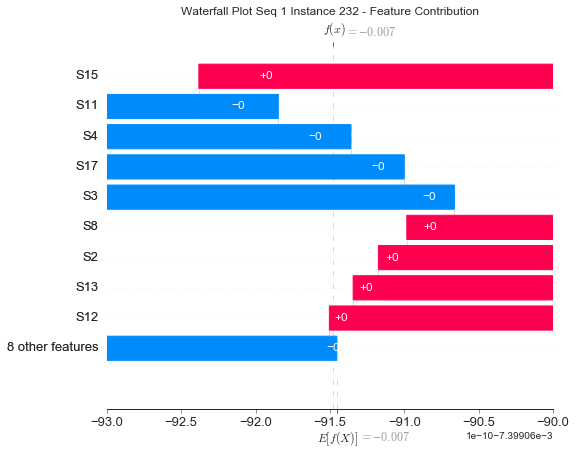

None

Contribution: [-6.27145211e-11 -9.78597932e-12  0.00000000e+00  7.50294896e-11
 -5.64505387e-11 -1.08191990e-10  4.70737858e-11  2.81965892e-11
  1.68903346e-11 -5.76190103e-11  7.14156234e-11  1.71602743e-14
 -3.89623533e-12  6.88571769e-11 -6.25305849e-11  1.63421238e-11
  4.48242971e-11]


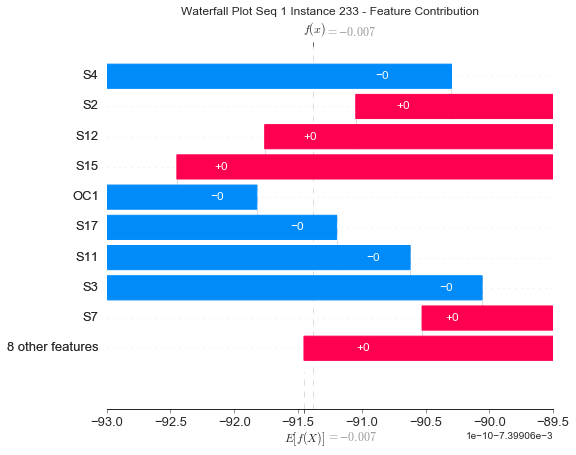

None

Contribution: [-4.36166936e-11 -1.64858387e-11 -1.28844478e-11  6.09658227e-11
 -7.03545763e-11 -1.27513611e-10  3.76168159e-11  5.84911911e-11
  1.79798954e-11 -1.02969418e-10  5.46584410e-11  2.90746871e-11
 -1.77034169e-11  1.65523012e-10 -8.00544145e-11  1.45217293e-11
  3.61165542e-11]


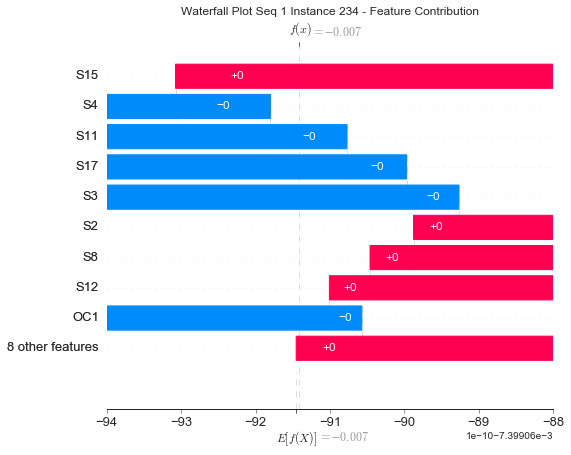

None

Contribution: [-1.87766035e-11 -1.14368402e-11  3.04139804e-11 -1.26007789e-11
  4.39627813e-11  5.17389881e-11 -1.29806235e-12 -5.61900006e-11
 -1.78455525e-12  8.82301940e-11  8.36154930e-12 -4.33856978e-11
  1.77851033e-11 -1.33803885e-10  4.14199404e-11 -9.24688169e-13
 -3.11887820e-12]


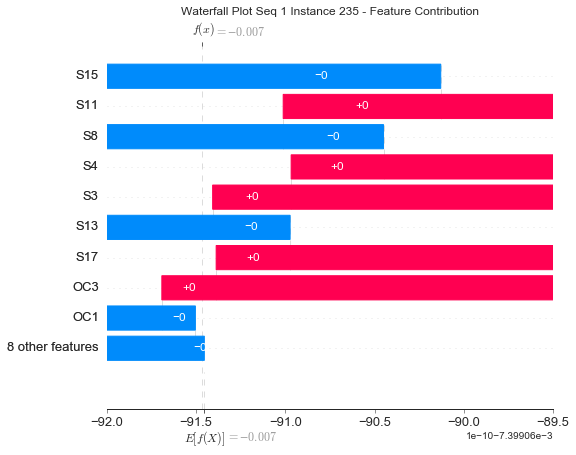

None

Contribution: [ 3.31272995e-11  6.80055318e-12  0.00000000e+00 -4.84315851e-11
  3.62717738e-11  7.11833162e-11 -3.07755731e-11 -1.89785930e-11
 -9.90794599e-12  3.68710409e-11 -4.37946034e-11  6.71493907e-14
 -8.48486646e-13 -2.62000716e-11  4.31811011e-11 -1.14224498e-11
 -2.82826575e-11]


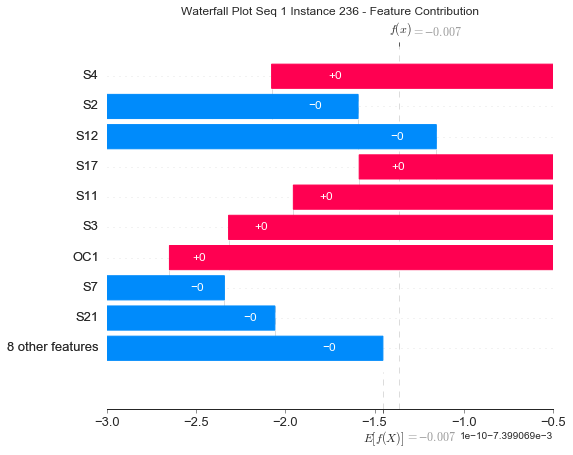

None

Contribution: [-2.26597734e-11  3.21366544e-12 -3.74424059e-12  2.00957636e-11
 -2.17724953e-11 -3.89156242e-11  7.07298282e-12  1.70182878e-11
  6.38457473e-12 -2.82842534e-11  1.12195930e-11  8.85656305e-12
 -1.00106555e-11  6.21411117e-11 -2.51777054e-11  1.06650203e-12
  1.24924160e-11]


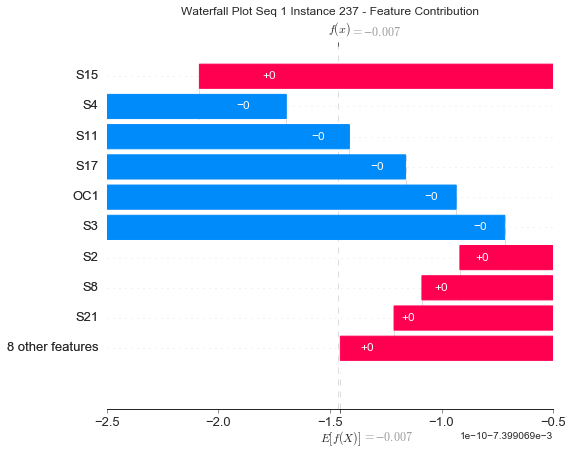

None

Contribution: [-3.09313720e-11 -4.04173700e-12  0.00000000e+00  4.47859388e-11
 -3.19916316e-11 -5.08545012e-11  2.44231545e-11  1.81192648e-11
  8.91201696e-12 -2.39020036e-11  3.38319130e-11  7.03366808e-14
 -5.57813615e-13  1.30657889e-11 -3.51383124e-11  7.75367010e-12
  2.50263820e-11]


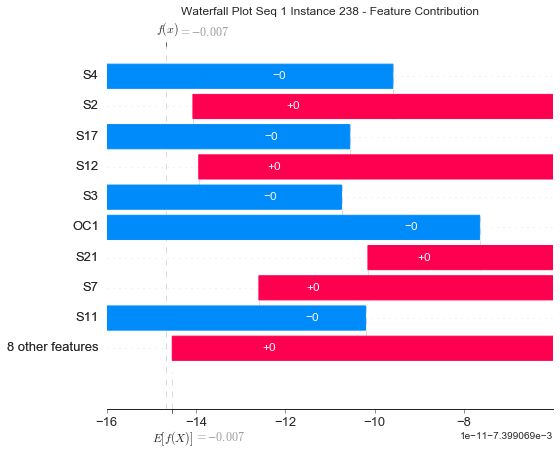

None

Contribution: [-4.72498464e-11 -5.09888529e-12  1.48051554e-11  4.87871479e-11
 -1.11581161e-11 -2.00850621e-11  3.17286995e-11 -1.25944376e-11
  7.22061733e-12  2.42155740e-11  4.22219065e-11 -2.33623815e-11
  1.09231591e-11 -7.98745653e-11 -1.26711575e-11  1.07431208e-11
  3.31908875e-11]


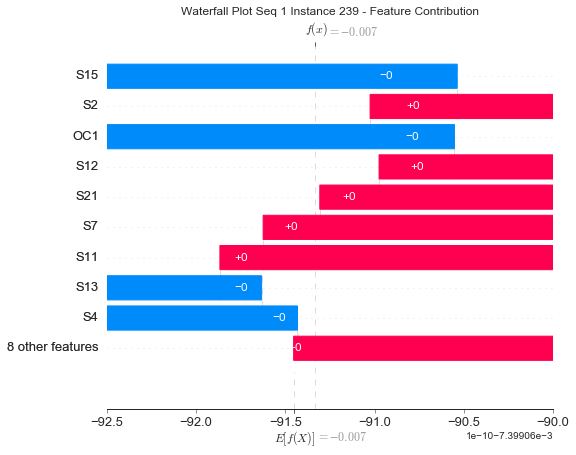

None

Contribution: [ 4.28960166e-11  9.25154311e-12 -2.28458116e-12 -4.18492498e-11
  3.47791310e-11  7.39553349e-11 -2.98878769e-11 -1.52371744e-11
 -8.51333153e-12  3.42697815e-11 -4.22435385e-11  3.36312250e-12
  7.37362536e-13 -5.54411309e-11  3.90655702e-11 -1.02576116e-11
 -2.86252775e-11]


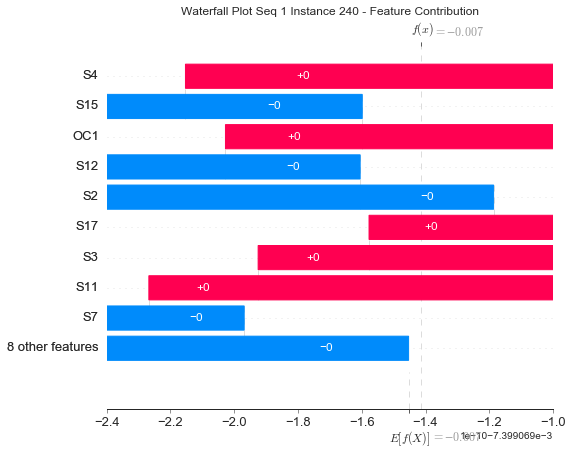

None

Contribution: [-1.35223629e-11 -6.73125835e-12 -1.44675504e-13 -4.40749135e-13
 -6.55405287e-12 -2.24122023e-11  9.29965913e-12 -8.09734766e-13
  1.71314005e-12 -8.19920520e-12  1.58237711e-11  2.63815337e-12
 -5.69139744e-12  3.76798731e-11 -6.03182088e-12  3.13000494e-12
  7.55593504e-12]


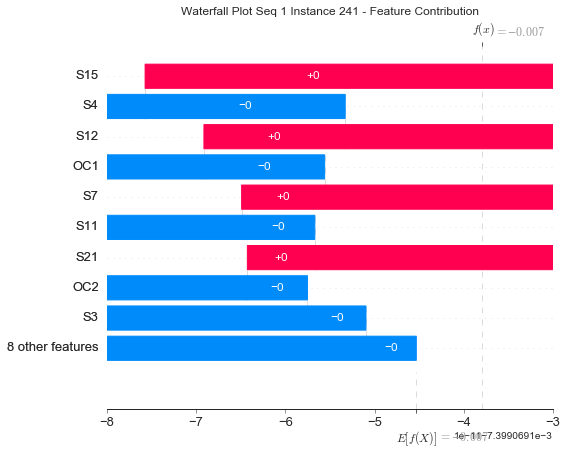

None

Contribution: [-5.45209711e-11 -3.52863606e-11  3.45491240e-11  7.95949938e-12
  1.81714609e-11 -2.59501726e-11  3.01218217e-11 -4.53372756e-11
  5.53754915e-12  5.44073848e-11  5.05062034e-11 -3.39759262e-11
  4.87751940e-12 -5.08911767e-11  1.11959088e-11  1.37096124e-11
  2.20401093e-11]


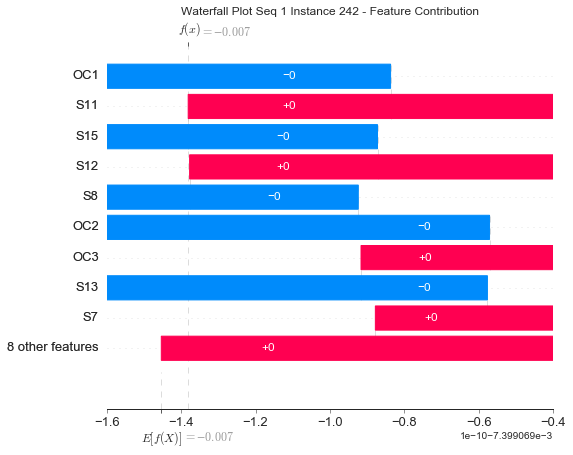

None

Contribution: [-5.58118864e-11 -2.13013513e-11 -1.55541118e-11  9.95316399e-11
 -9.77362496e-11 -1.75543399e-10  5.91337049e-11  7.42423970e-11
  2.45406941e-11 -1.26740882e-10  8.63147956e-11  3.30891287e-11
 -1.88187608e-11  1.76699419e-10 -1.09965682e-10  2.50742344e-11
  5.31640183e-11]


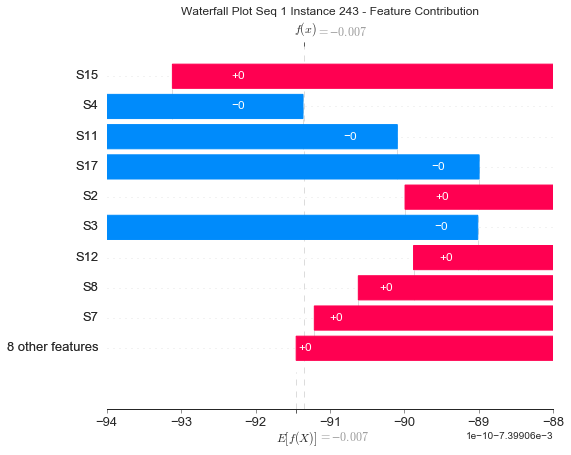

None

Contribution: [-5.62631643e-11 -7.11859868e-12 -2.94095260e-12  7.66244221e-11
 -6.32168207e-11 -1.11114770e-10  5.48174631e-11  4.07256937e-11
  1.57985795e-11 -6.31842634e-11  7.29371563e-11  7.16133966e-12
 -1.45486054e-12  4.99980994e-11 -7.49025911e-11  2.45331238e-11
  4.95056184e-11]


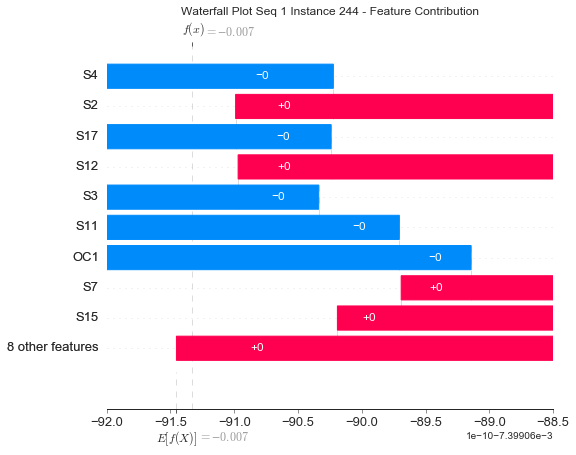

None

Contribution: [ 3.68408221e-11  1.06656012e-11 -1.91317621e-11 -6.26551285e-12
 -2.33614950e-11 -1.11030169e-11 -9.39161249e-12  3.43614859e-11
 -2.54072956e-12 -5.25819596e-11 -1.45533360e-11  2.76176755e-11
 -1.02430382e-11  7.65577671e-11 -1.96990237e-11 -2.66115645e-12
 -1.07031346e-11]


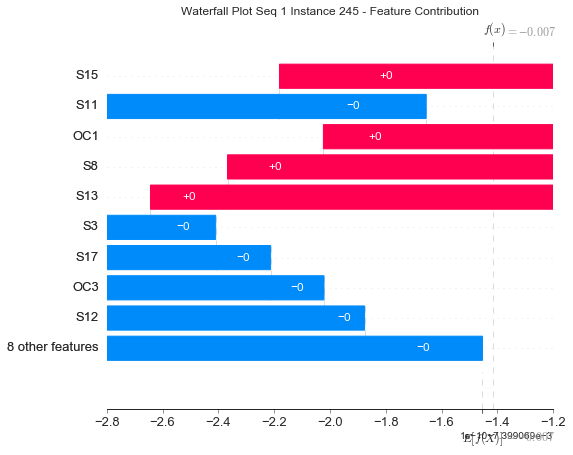

None

Contribution: [-6.19346796e-11 -5.48840530e-12  0.00000000e+00  7.78360362e-11
 -5.63721500e-11 -1.03008768e-10  5.61578804e-11  3.42834303e-11
  1.66247797e-11 -5.76643004e-11  7.79577028e-11  5.05069754e-14
  1.10370285e-12  3.31074612e-11 -6.92278040e-11  2.73791684e-11
  5.16099802e-11]


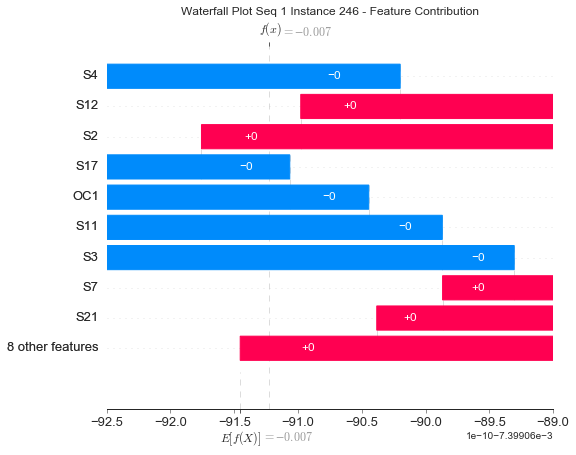

None

Contribution: [ 1.40617648e-11  1.74670157e-11 -2.82638659e-13  7.21236222e-12
  9.15077736e-12  3.54452925e-11 -2.18049172e-11  2.50167205e-12
  1.91417563e-12  1.54025126e-11 -2.52993650e-11 -6.01184380e-12
  7.17511933e-13 -4.33947635e-11  8.21925340e-12 -1.29447711e-11
 -1.30715282e-11]


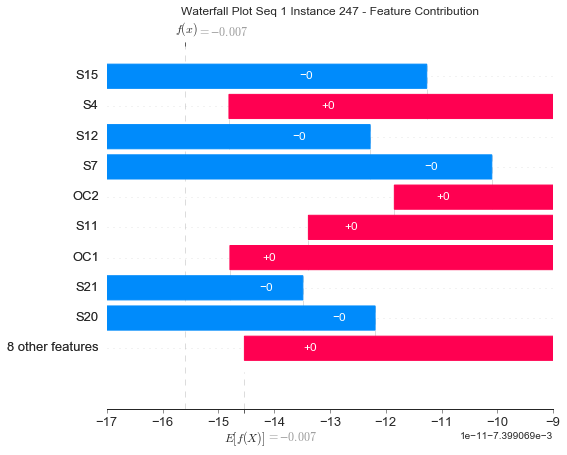

None

Contribution: [-2.39691270e-11 -2.95078233e-11 -3.28757126e-11  7.45714393e-11
 -1.27287680e-10 -2.24992691e-10  5.86248966e-11  1.19319388e-10
  2.11102438e-11 -2.00162276e-10  7.87915219e-11  9.27832533e-11
 -3.97987338e-11  3.15915821e-10 -1.41660864e-10  2.93797625e-11
  4.45566119e-11]


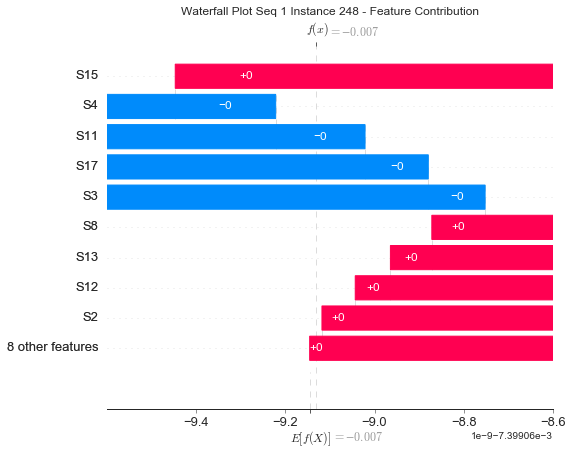

None

Contribution: [-6.44746409e-11 -8.00924604e-12 -1.98393402e-11  1.13427351e-10
 -1.29940420e-10 -2.17986004e-10  8.09801184e-11  1.00340312e-10
  2.43175653e-11 -1.62306599e-10  1.08271468e-10  5.62710226e-11
 -2.30424325e-11  2.00645861e-10 -1.48751497e-10  3.54214366e-11
  7.12525178e-11]


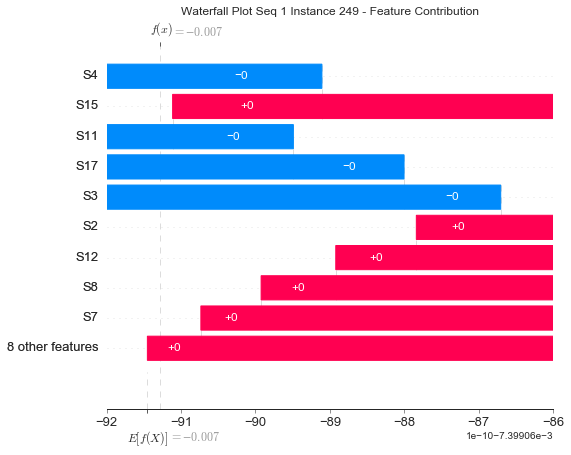

None

Contribution: [ 8.08463158e-11  2.16653952e-11  4.57873496e-12 -9.26306254e-11
  8.53054363e-11  1.94365621e-10 -7.32933852e-11 -4.78282934e-11
 -2.34342042e-11  1.16119656e-10 -1.01954452e-10 -5.92903894e-12
  1.20611585e-11 -1.49433188e-10  1.05054583e-10 -3.15676686e-11
 -6.75390993e-11]


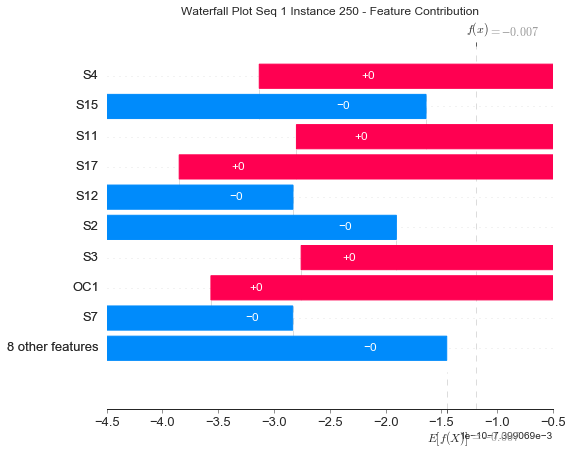

None

Contribution: [ 2.05863018e-12 -1.49985157e-12  0.00000000e+00 -6.48744123e-12
  3.48372611e-12  1.16839463e-11 -1.82146269e-12 -7.93069874e-13
  1.22858093e-12  7.68432800e-12 -3.95399338e-12  1.22612085e-13
 -2.57453108e-12  1.46693774e-13  4.84709278e-12  1.02906193e-12
 -2.17676636e-12]


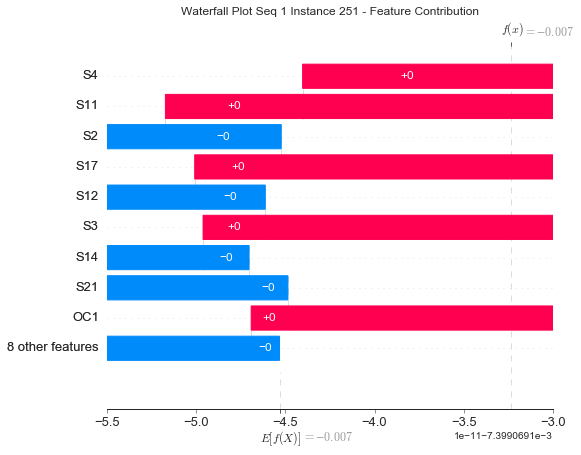

None

Contribution: [ 1.17188923e-11  2.25302329e-11 -2.65818929e-11  6.05205747e-11
 -7.12851306e-11 -7.40770362e-11  6.24998100e-12  8.14706497e-11
  1.21748037e-11 -9.86709187e-11  8.85838625e-12  5.18506522e-11
 -1.21015680e-11  8.92307200e-11 -7.27230914e-11  1.43461252e-12
  9.42307603e-12]


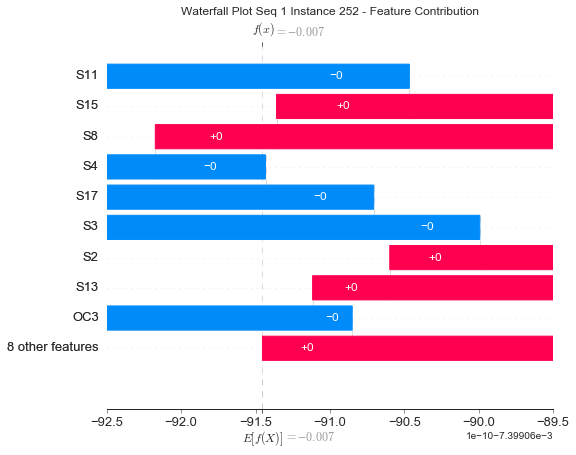

None

Contribution: [-3.74024145e-11 -2.16796660e-14  0.00000000e+00  4.78469070e-11
 -3.58083146e-11 -4.65707022e-11  2.55360316e-11  2.01339275e-11
  8.90280991e-12 -1.79186301e-11  3.67191867e-11  8.51987006e-14
  7.25178598e-13  8.64610380e-12 -3.76014948e-11  1.04847138e-11
  3.06008309e-11]


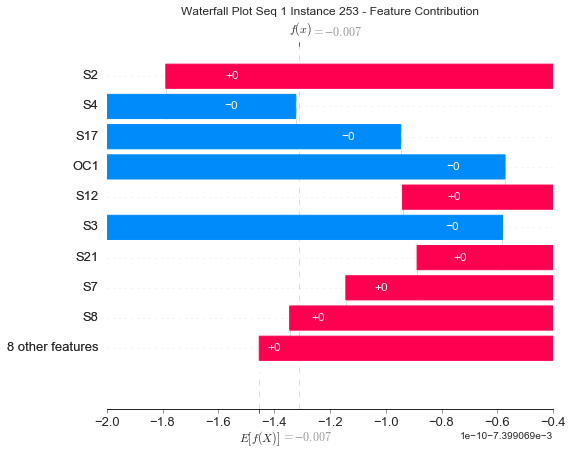

None

Contribution: [ 4.03223600e-11  9.69098066e-12 -2.20498359e-12 -3.59575321e-11
  2.98638475e-11  5.45752298e-11 -2.73268543e-11 -1.00958313e-11
 -6.12709276e-12  2.17952028e-11 -3.79046725e-11  5.41033537e-12
 -1.68325672e-12 -3.01022367e-11  3.11584855e-11 -8.27628417e-12
 -2.53825502e-11]


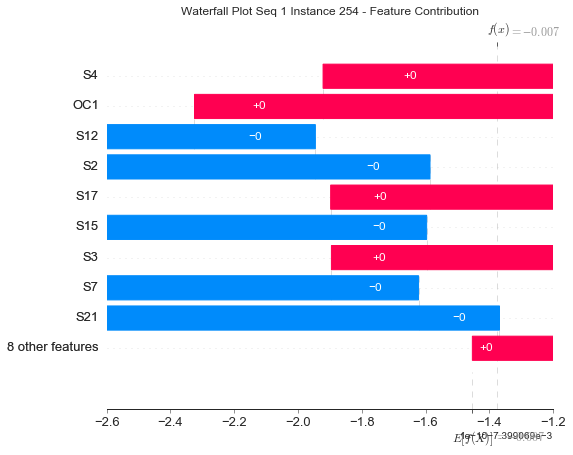

None

Contribution: [-4.72727135e-11 -1.03451241e-11  0.00000000e+00  6.88089585e-11
 -5.08585604e-11 -8.91716423e-11  3.96834302e-11  2.85570786e-11
  1.88857662e-11 -5.43588542e-11  5.49059374e-11  4.59649476e-14
 -4.89286996e-12  4.98311392e-11 -5.89539320e-11  1.86556031e-11
  4.04114173e-11]


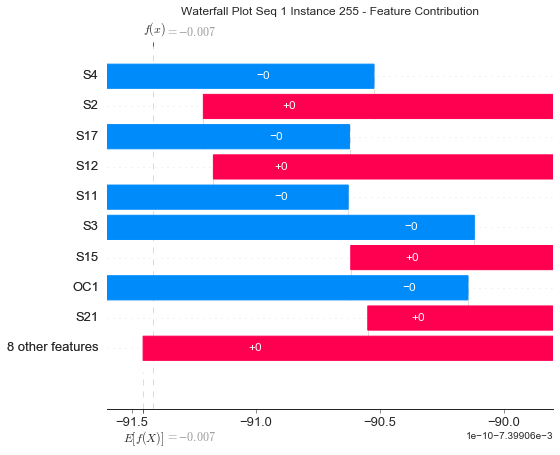

None

Contribution: [ 6.38638309e-11  3.09111070e-11  6.40869302e-12 -6.43055539e-11
  7.83091716e-11  1.50615950e-10 -6.03664133e-11 -4.86237370e-11
 -1.73240658e-11  8.86042142e-11 -8.08778461e-11 -2.88253293e-11
  1.18934558e-11 -1.33947478e-10  8.41883577e-11 -2.71007661e-11
 -5.48383942e-11]


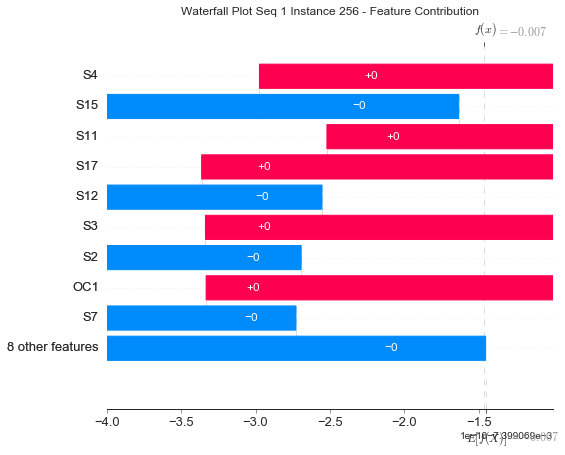

None

Contribution: [ 1.88009885e-11  3.38457496e-12  0.00000000e+00 -1.16058326e-11
  1.27048242e-11  1.85868976e-11 -1.07782394e-11 -4.69686269e-12
 -1.76420326e-12  8.65225773e-12 -1.56390022e-11  6.25285685e-14
 -2.46708274e-12 -9.95646187e-12  9.05292941e-12 -3.39399450e-12
 -1.17494521e-11]


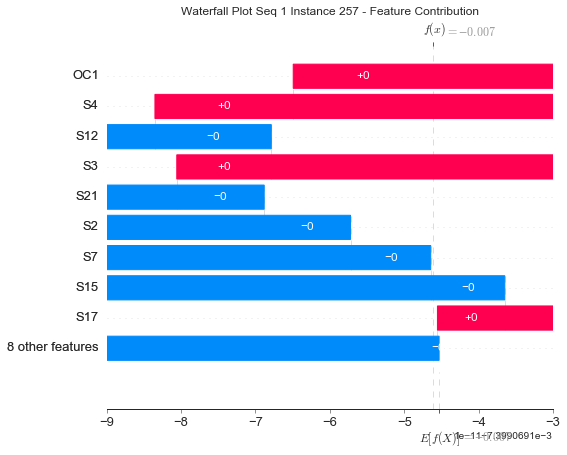

None

Contribution: [-1.04597955e-10 -3.50729897e-11 -3.75846056e-12  8.43589018e-11
 -8.49461543e-11 -1.71025957e-10  7.71211081e-11  5.29925583e-11
  2.47944547e-11 -9.86749918e-11  1.06387885e-10  1.10516362e-11
 -1.32372360e-11  1.43081463e-10 -1.00913139e-10  3.98602852e-11
  8.23029908e-11]


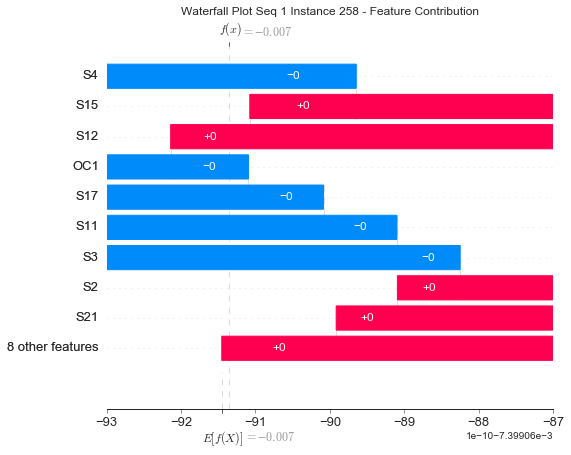

None

Contribution: [-6.27912028e-11 -3.99092565e-11  2.91072999e-11 -4.62670458e-11
  6.52285170e-11  7.22542928e-11 -9.37386193e-12 -6.66392289e-11
 -9.50635317e-12  1.02133663e-10 -1.02719317e-11 -4.10290690e-11
  1.10140994e-11  1.39618261e-10  6.51244822e-11  1.05857456e-12
 -1.20942483e-11]


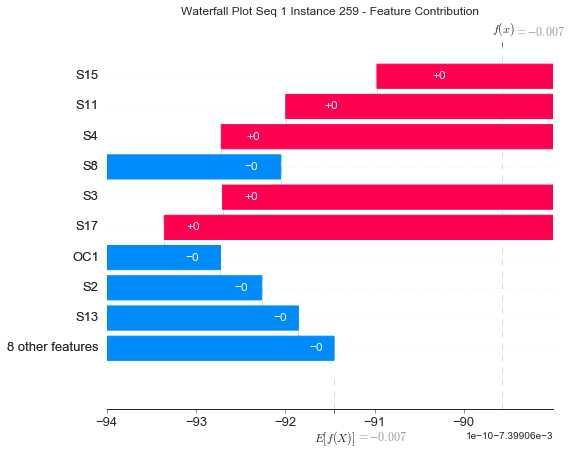

None

Contribution: [-6.38737951e-11 -4.73705380e-11  3.12501240e-11 -1.17988449e-11
  2.19816144e-11  4.24740928e-12 -4.27410250e-13 -1.14305856e-11
  9.24413931e-12  1.81397120e-11  1.30368103e-11 -3.06551312e-11
  2.40152353e-13  2.13766296e-10  9.03755022e-12  1.19954203e-11
  3.10386330e-12]


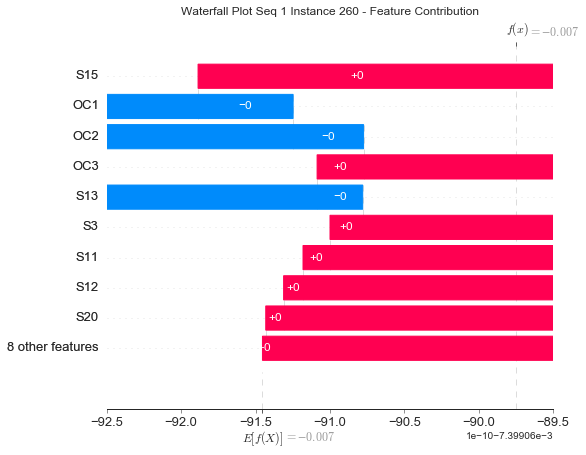

None

Contribution: [-5.97956754e-11 -1.41707314e-11  2.48486440e-11 -7.31697272e-11
  1.05372454e-10  1.97268521e-10 -4.35079160e-11 -1.28358713e-10
 -3.02035896e-11  2.06167555e-10 -6.25947974e-11 -8.49334700e-11
  2.52960639e-11 -1.23450680e-10  1.25723182e-10 -2.75759537e-11
 -4.37862628e-11]


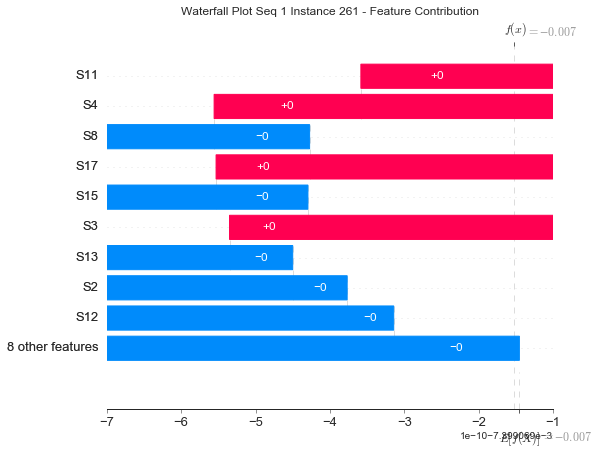

None

Contribution: [-5.56761755e-11 -2.79769367e-11  8.64889618e-11 -1.62720913e-11
  4.85485090e-11  3.98211776e-11 -2.86571929e-11 -4.20764083e-11
  2.57996853e-11  7.13289983e-11  1.83091866e-12 -8.08852499e-11
  1.00337403e-11  4.83347425e-11  1.69327503e-11 -3.32302220e-12
 -1.57757470e-11]


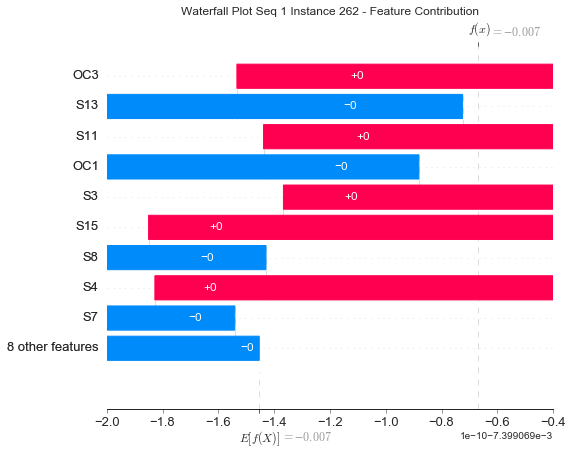

None

Contribution: [-1.73975320e-10 -1.15638027e-10  1.02649618e-10  1.16499838e-10
 -5.10903646e-11 -2.44956916e-10  7.13502105e-11  3.46524510e-11
  8.08871720e-11 -6.62378277e-11  2.05978276e-10 -5.91724586e-11
 -9.60061783e-13  9.15596002e-11 -1.46014534e-10  8.40051015e-11
  8.79825379e-11]


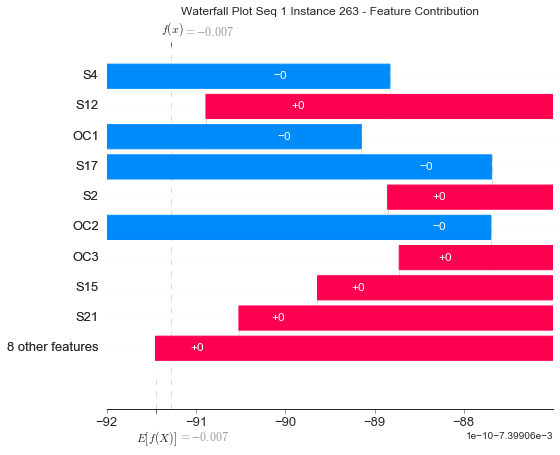

None

Contribution: [-5.93445432e-11  7.49235049e-12  1.07724829e-10  3.47927485e-11
  3.18413503e-12 -3.75771463e-11  1.57525382e-12  6.26005584e-12
  4.25861707e-11  5.70419796e-12  3.73295075e-11 -9.19194512e-11
  6.42397680e-12 -3.07523798e-11 -5.36522562e-11  1.17110826e-11
  1.38862056e-11]


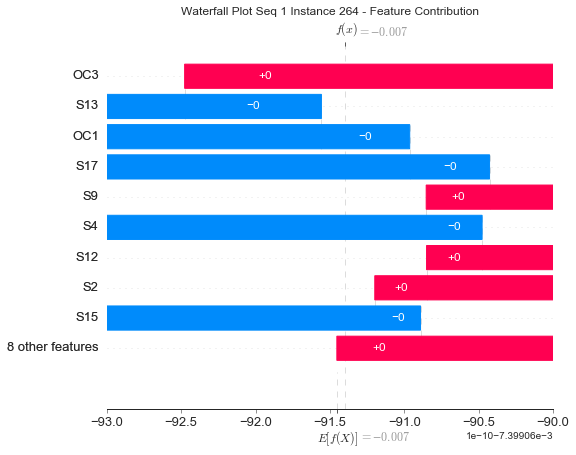

None

Contribution: [-1.14259999e-11  1.01549108e-12  1.38365777e-10  7.43118830e-11
 -6.57910532e-11 -2.38051745e-10  2.55058839e-11  1.08626871e-10
  8.23456442e-11 -1.65366595e-10  1.16394852e-10 -5.14377881e-11
  4.77636030e-12  1.08859463e-10 -1.70909925e-10  4.73493258e-11
  4.35333054e-11]


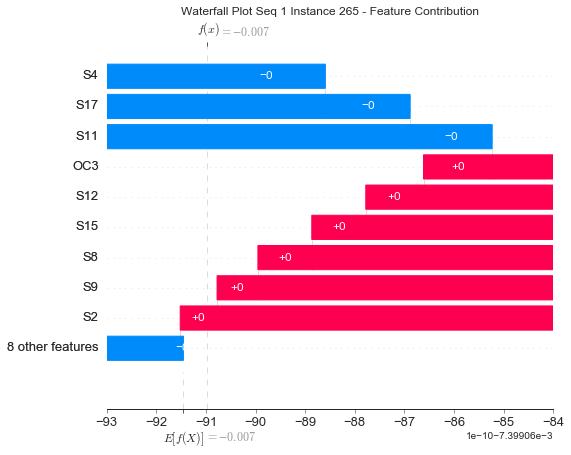

None

Contribution: [-8.53705301e-11 -8.87334164e-11  1.35943035e-10  2.00260281e-10
 -1.93308466e-10 -5.59267299e-10  1.40822284e-10  2.12231663e-10
  1.33819109e-10 -3.63444330e-10  3.32285366e-10 -1.14294407e-11
 -3.24769443e-12  1.75904249e-10 -3.54870300e-10  1.54082427e-10
  1.58642252e-10]


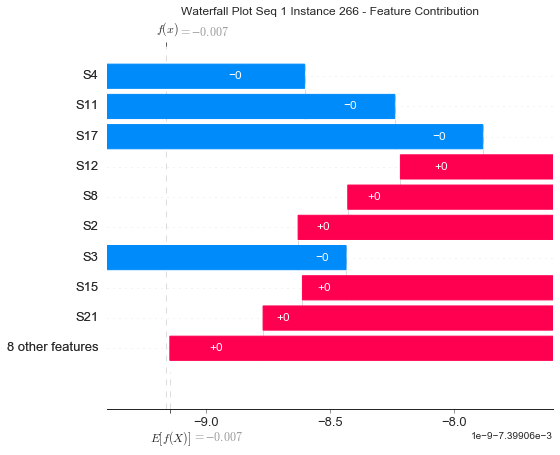

None

Contribution: [ 2.26745331e-10  2.08890946e-10  1.42319351e-10 -8.62516378e-11
  1.02800737e-11  4.12369236e-11 -9.36234770e-11  5.59644345e-11
  3.00726770e-11 -6.62733826e-11 -5.57248206e-11 -1.05358125e-10
  3.54056819e-11 -1.19751459e-10 -4.93467003e-11 -2.75238391e-11
 -5.83573953e-11]


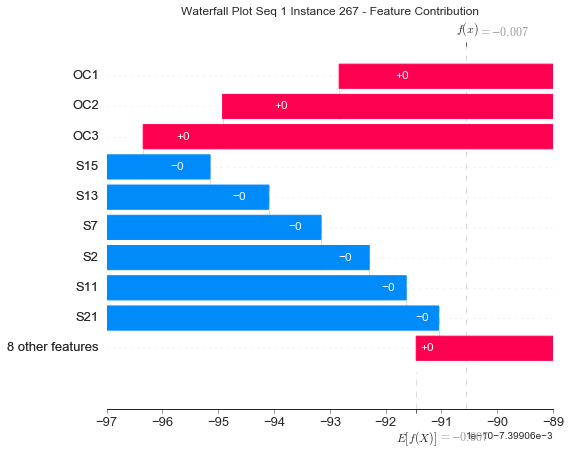

None

Contribution: [ 1.04773253e-10  1.92781388e-10  7.07201450e-11 -2.62788905e-11
  4.50998371e-11  7.07086126e-11 -1.88941363e-11 -8.89133212e-11
  5.39224871e-12  9.06155012e-11 -3.87892106e-12 -1.26615163e-10
  1.02952967e-11 -6.42737863e-10  1.95146642e-11 -1.35500031e-12
 -3.78479447e-13]


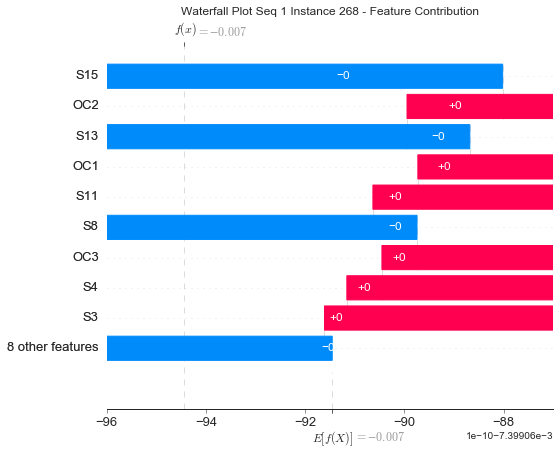

None

Contribution: [ 2.75707318e-10  3.02151582e-10  1.79643939e-10  1.15985596e-10
 -1.26497160e-10 -2.67713934e-10  7.20155836e-12  2.09088843e-10
  1.04603270e-10 -2.84600621e-10  6.85484933e-11 -6.16550005e-11
  2.58409197e-11 -2.95898139e-10 -2.40258896e-10  2.93294763e-11
  3.16733167e-11]


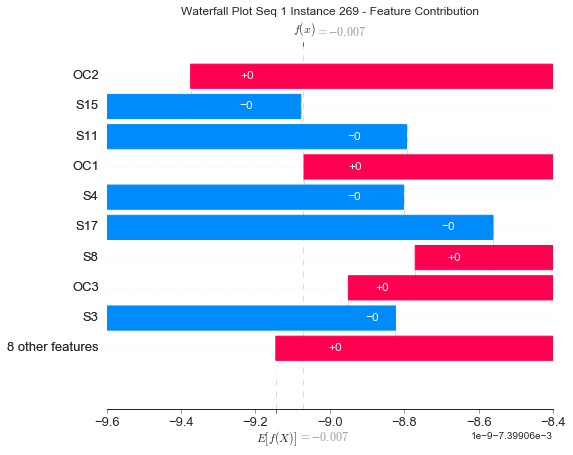

None

Contribution: [ 2.82123019e-10  3.47012391e-10  1.53569657e-11 -1.03776043e-10
  7.16207024e-11  1.48614079e-10 -6.77110590e-11 -1.66171146e-10
 -3.07600855e-11  1.81738791e-10 -5.18383288e-11 -1.13101625e-10
  1.01601852e-11 -1.02353337e-09  9.17227821e-11 -2.31054099e-11
 -4.16435636e-11]


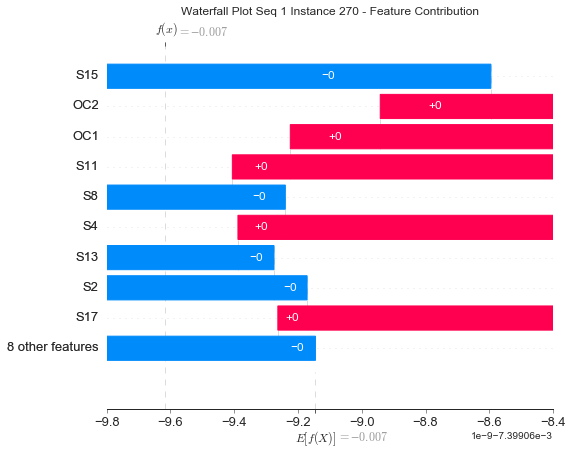

None

Contribution: [ 6.01152850e-10  4.89497942e-10  2.13650070e-10 -1.04260912e-10
 -7.06129599e-11 -9.40238928e-11 -7.50808790e-11  1.96082234e-10
  4.34109935e-11 -3.06974363e-10 -6.75996967e-11 -8.05501013e-11
  3.36507870e-11 -3.60831753e-10 -1.50490301e-10 -2.37186677e-11
 -6.01727210e-11]


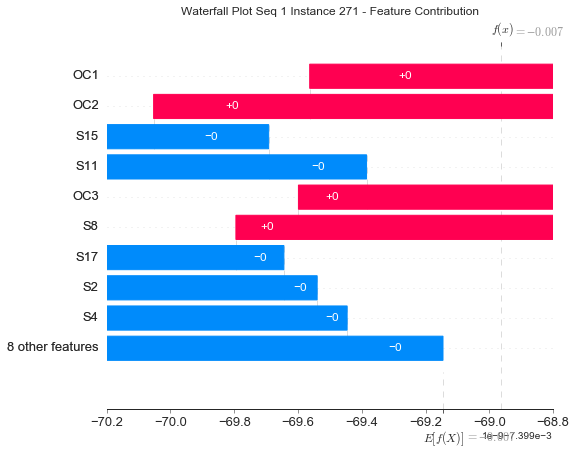

None

Contribution: [ 3.62381986e-10  5.01346575e-10  1.09801855e-10  8.20342197e-11
 -6.54032939e-11 -1.98881592e-10 -6.60758167e-12  2.07908638e-11
  6.58915214e-11 -7.95261981e-11  1.03235601e-10 -9.09037914e-11
 -5.54055369e-12 -1.16320076e-09 -1.73434309e-10  4.04459556e-11
  5.76924272e-11]


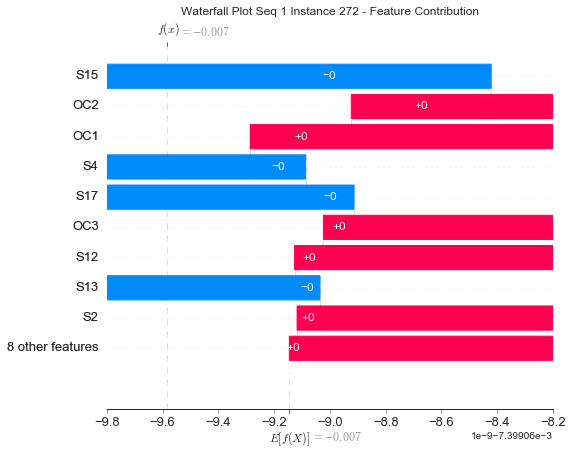

None

Contribution: [ 5.80346826e-10  5.87031368e-10  9.99282879e-11  3.00043358e-11
 -1.08506995e-10 -2.29496699e-10 -5.81944258e-12  1.23492452e-10
  4.78598619e-11 -2.50703375e-10  2.29742735e-11 -2.39524980e-11
  7.35726237e-12 -1.16111565e-09 -1.73302872e-10  8.91442475e-12
  2.42646927e-11]


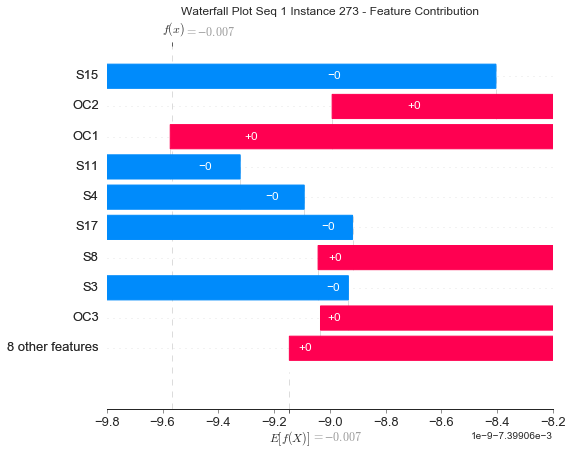

None

Contribution: [ 9.99523797e-10  8.19399826e-10  1.68358133e-10 -1.36195999e-10
 -9.09702383e-11 -6.57834134e-11 -1.50061366e-10  1.44332116e-10
  2.66822051e-11 -2.68839728e-10 -1.61595792e-10 -4.68288672e-11
  2.50553016e-11 -1.19285182e-09 -1.08448500e-10 -8.14817380e-11
 -1.36938794e-10]


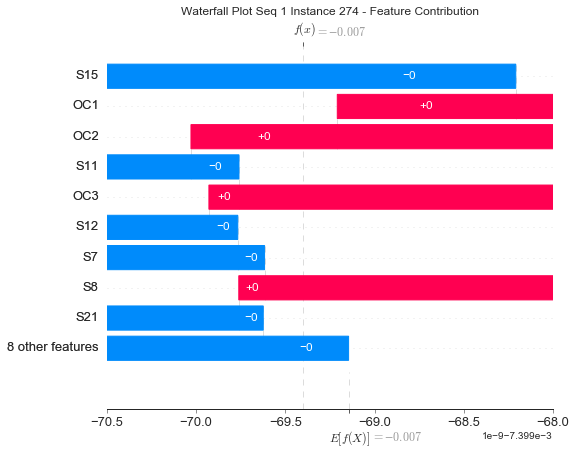

None

Contribution: [ 4.12423429e-10  4.72257955e-10  1.59480845e-10  3.49506812e-10
 -3.96812916e-10 -1.00790709e-09  1.70541886e-10  2.45783671e-10
  1.84188179e-10 -5.78264880e-10  4.90825769e-10  3.45243625e-11
 -4.52318807e-11 -1.48667079e-09 -6.34037878e-10  1.95053071e-10
  2.37996650e-10]


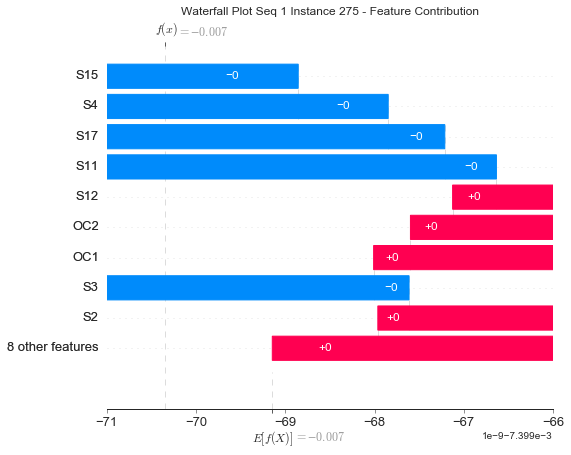

None

Contribution: [ 1.13986842e-09  9.41910216e-10  1.97467223e-10  8.30357588e-11
 -2.91951796e-10 -5.47417001e-10 -9.97887883e-12  4.11510936e-10
  9.99438310e-11 -6.99783620e-10  1.16621166e-11  1.32312813e-10
 -1.94536071e-11 -1.59149749e-09 -4.13053425e-10 -1.65013478e-12
  1.39084022e-11]


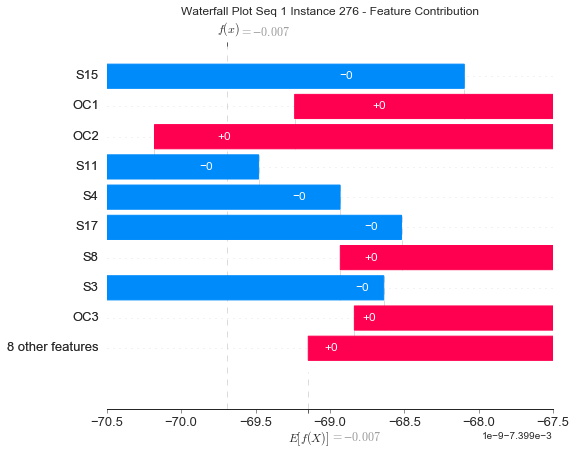

None

Contribution: [ 1.65175637e-10  1.84679980e-10  3.28053834e-10  1.30762579e-09
 -1.24973765e-09 -3.26971605e-09  7.36227357e-10  1.43713308e-09
  6.46298515e-10 -2.31745378e-09  1.38030198e-09  6.78307077e-10
 -1.54645033e-10 -3.64603403e-10 -1.84656812e-09  5.65406055e-10
  8.14409096e-10]


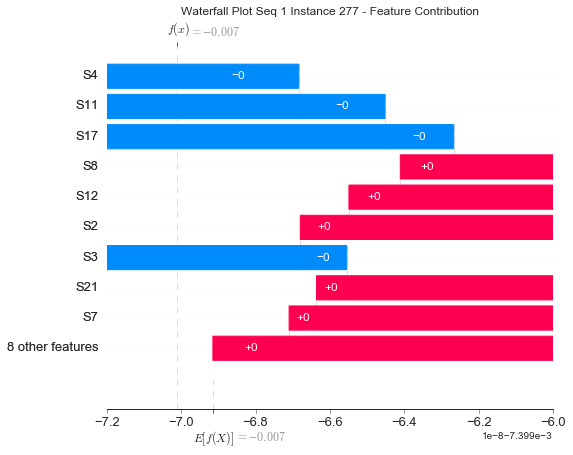

None

Contribution: [ 8.49476323e-10  7.30550787e-10  2.55447302e-10  8.06928913e-10
 -1.00649011e-09 -2.28108976e-09  3.58711033e-10  1.27200994e-09
  4.33096808e-10 -2.00867745e-09  7.45718765e-10  5.81393822e-10
 -1.55318383e-10 -8.85990503e-10 -1.43767076e-09  2.85059643e-10
  4.51425952e-10]


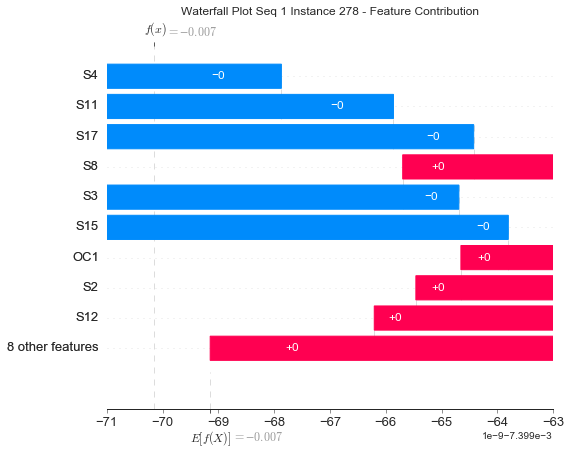

None

Contribution: [ 8.20773838e-10  7.44066031e-10  9.22700527e-11  8.68248584e-10
 -9.68580327e-10 -2.38937581e-09  4.63698219e-10  1.13103249e-09
  4.35750852e-10 -1.91573690e-09  8.44034564e-10  5.82222326e-10
 -1.48412505e-10 -1.83076343e-09 -1.35710188e-09  3.42183171e-10
  5.67290992e-10]


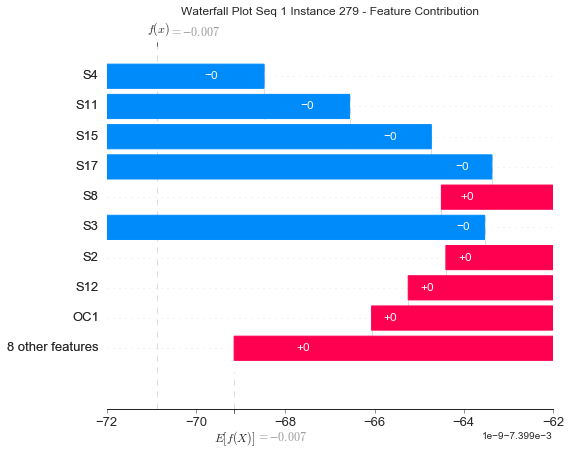

None

Contribution: [ 1.36075762e-09  9.37891986e-10  1.30864972e-10  9.83135684e-10
 -1.28338484e-09 -2.86477486e-09  5.18191601e-10  1.61682989e-09
  4.61957167e-10 -2.66853650e-09  9.06335229e-10  7.85634280e-10
 -1.41757370e-10 -1.09662268e-09 -1.75649417e-09  3.56420865e-10
  5.38386724e-10]


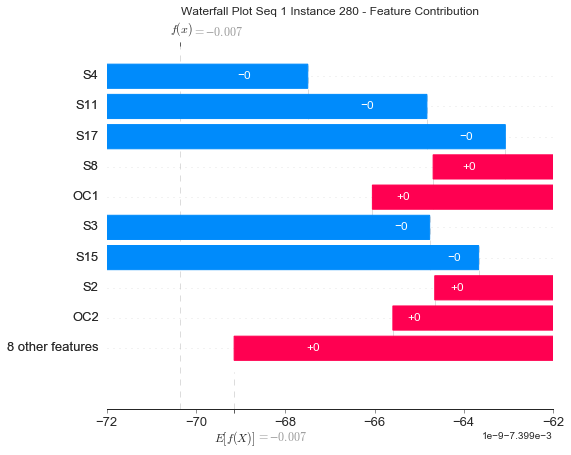

None

Contribution: [ 2.17225793e-09  1.66391723e-09  1.12196828e-10  3.25125121e-10
 -9.06883180e-10 -1.46408963e-09  3.40361142e-11  1.42162360e-09
  2.36150238e-10 -2.11927853e-09  1.07452096e-10  7.09149406e-10
 -4.45652126e-11 -1.78961068e-09 -1.13414012e-09  4.45879167e-11
  1.20391877e-10]


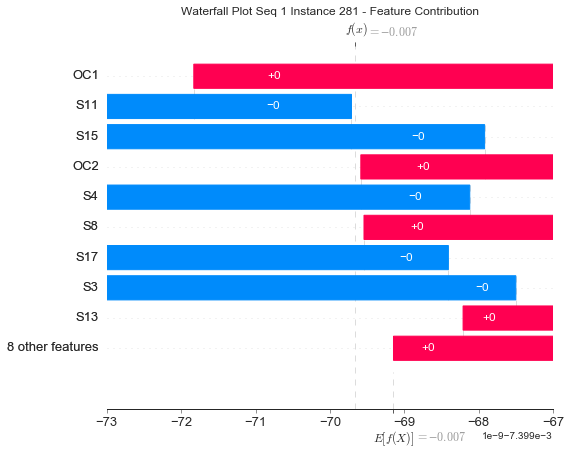

None

Contribution: [ 1.98796513e-09  1.82017024e-09  1.36330003e-10  9.66225433e-10
 -1.24294353e-09 -2.22446750e-09  2.65150707e-10  1.89129934e-09
  5.05782027e-10 -2.55339949e-09  5.30549993e-10  9.75337366e-10
 -4.22730705e-11 -1.95276817e-09 -1.68314696e-09  2.08596196e-10
  4.20509960e-10]


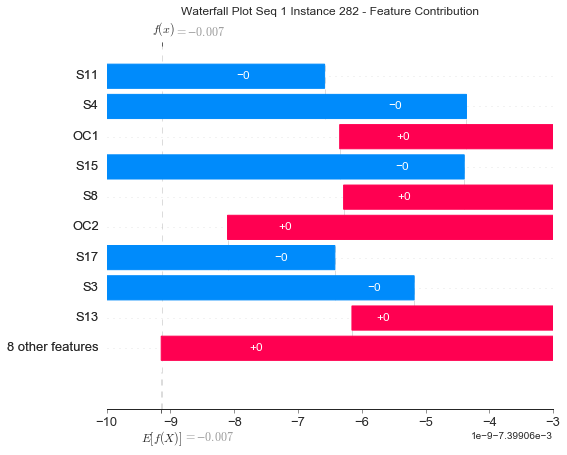

None

Contribution: [ 1.81416271e-09  1.88806903e-09  4.94928230e-11  7.97826694e-10
 -8.74079420e-10 -1.74253756e-09  2.51713345e-10  9.74476499e-10
  3.69205416e-10 -1.57282065e-09  4.94647046e-10  4.79556839e-10
 -5.96268937e-11 -3.91236243e-09 -1.11389942e-09  1.86452853e-10
  4.12795076e-10]


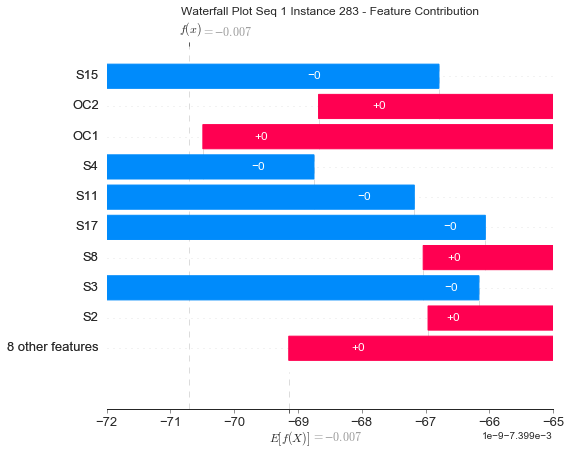

None

Contribution: [ 2.04013628e-09  1.94333927e-09  0.00000000e+00  3.09122658e-11
 -2.54242349e-10 -6.63675115e-10 -1.13770321e-11  5.83572557e-12
  3.19104465e-11 -3.75829728e-10  6.68036043e-11  3.26908422e-12
 -1.04728830e-11 -5.46161205e-09 -2.83911977e-10 -8.90266593e-12
  1.11220380e-10]


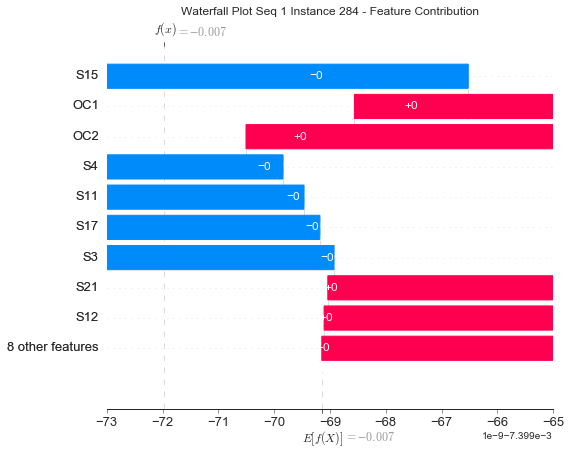

None

Contribution: [ 9.82335324e-10  7.93839827e-10  1.97165576e-10  2.25919727e-09
 -2.37932496e-09 -5.90254956e-09  1.23572597e-09  2.95886782e-09
  1.01537956e-09 -4.63901273e-09  1.99870565e-09  1.93009875e-09
 -3.10200532e-10 -1.15052123e-09 -3.18456994e-09  7.53385965e-10
  1.32994993e-09]


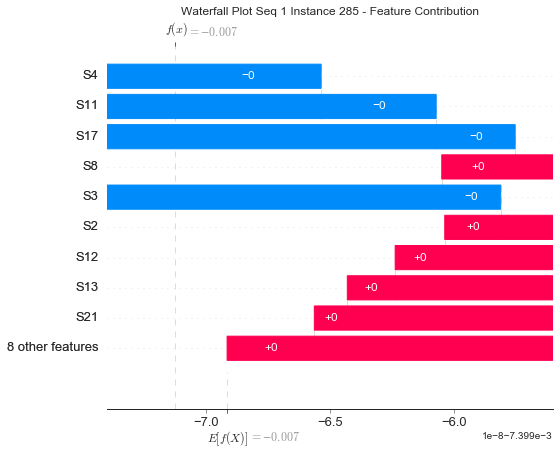

None

Contribution: [ 2.02624140e-09  1.41103473e-09  4.43883229e-11  1.62756264e-09
 -2.13828799e-09 -4.69699346e-09  8.76518358e-10  2.70224354e-09
  7.26938454e-10 -4.40865344e-09  1.33551570e-09  1.75441617e-09
 -2.61253491e-10 -1.83143067e-09 -2.63636890e-09  5.35292477e-10
  9.10324593e-10]


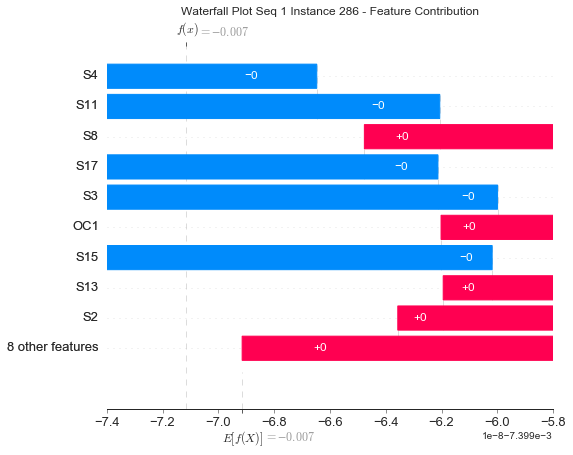

None

Contribution: [ 1.25598199e-09  9.07485254e-10 -1.25739641e-10  2.68612177e-09
 -3.00709546e-09 -6.59790222e-09  1.76333237e-09  3.34286376e-09
  9.40955314e-10 -5.51933432e-09  2.55358312e-09  2.04616479e-09
 -3.96049971e-10 -1.51965218e-09 -3.76949982e-09  1.05975839e-09
  1.66009007e-09]


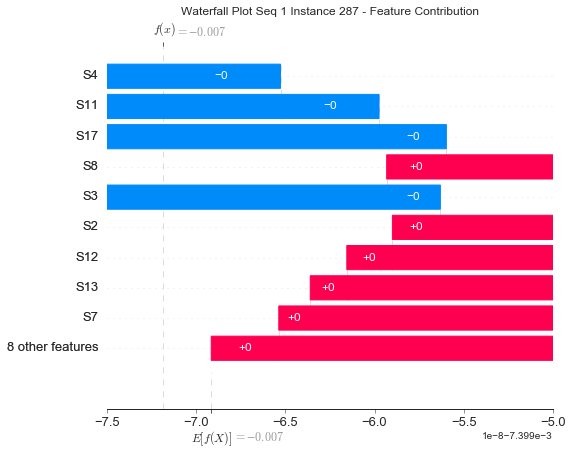

None

Contribution: [ 2.95685210e-09  2.37852871e-09 -2.24293542e-10  1.53859714e-09
 -2.11124407e-09 -3.77597331e-09  4.34342257e-10  3.00475711e-09
  6.72647826e-10 -4.19153823e-09  7.63147767e-10  1.90109639e-09
 -1.52060850e-10 -3.09953530e-09 -2.59985389e-09  2.38106701e-10
  6.51625864e-10]


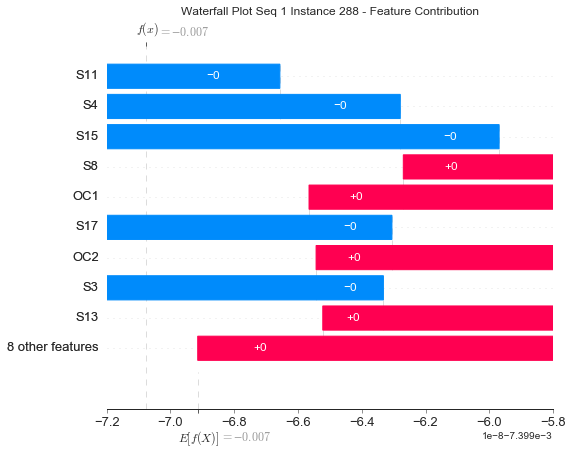

None

Contribution: [ 2.61129518e-09  1.62826352e-09 -2.18175589e-10  2.05494910e-09
 -2.66418931e-09 -6.07240569e-09  1.09684906e-09  3.36373907e-09
  8.37174718e-10 -5.67093483e-09  1.67375747e-09  2.13159224e-09
 -2.54425758e-10 -2.11898721e-09 -3.42857542e-09  6.13092521e-10
  1.14358656e-09]


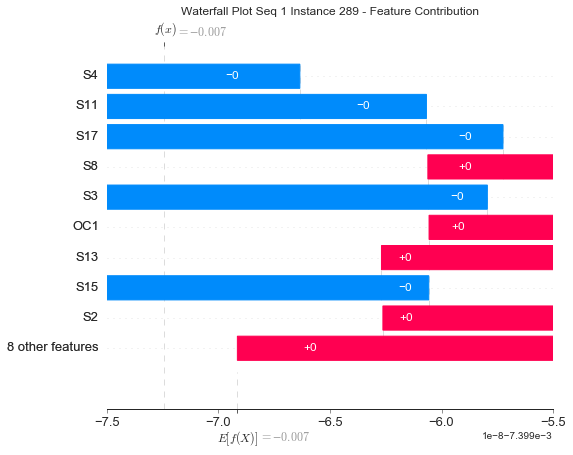

None

Contribution: [ 1.80981596e-09  1.51793234e-09 -3.09541448e-10  3.20049964e-09
 -3.13014836e-09 -7.12242443e-09  1.47798107e-09  4.29745173e-09
  1.26424526e-09 -6.28695451e-09  2.17477258e-09  2.71234679e-09
 -2.32033795e-10 -2.47800980e-09 -4.12287937e-09  8.46593406e-10
  1.64711278e-09]


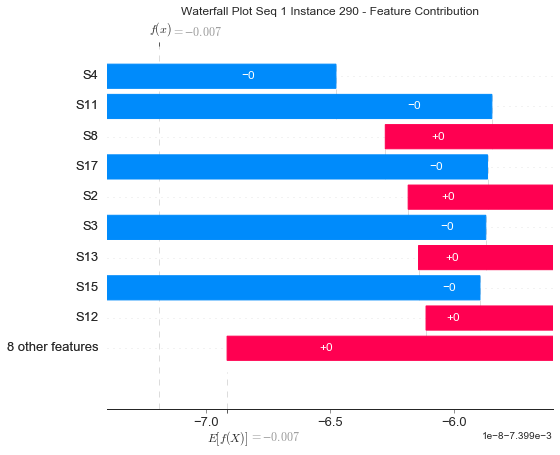

None

Contribution: [ 3.56754648e-09  2.26344343e-09 -3.97956779e-10  1.76558856e-09
 -2.29851493e-09 -5.50916912e-09  6.18369134e-10  3.72117182e-09
  9.39697209e-10 -5.75317571e-09  1.02879594e-09  2.33720865e-09
  7.32875149e-11 -2.68371458e-09 -3.20380744e-09  3.85638299e-10
  8.25635171e-10]


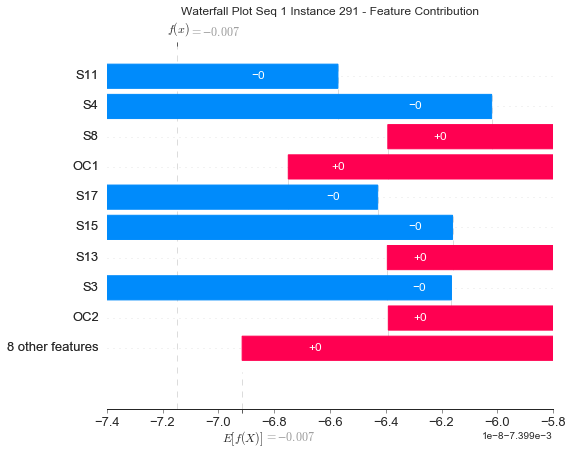

None

Contribution: [ 2.67818479e-09  2.20855023e-09 -4.67194228e-10  1.94249639e-09
 -2.36887754e-09 -5.31438848e-09  1.09138165e-09  2.60452260e-09
  6.11104556e-10 -4.63641037e-09  1.48942869e-09  2.09829043e-09
 -6.97514199e-11 -4.66699168e-09 -2.77965273e-09  5.79506443e-10
  1.21629407e-09]


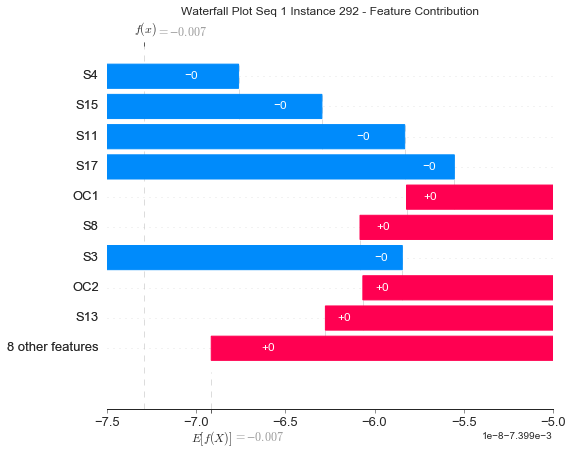

None

Contribution: [ 6.14639228e-09  4.39277548e-09  1.34623479e-10  3.15385551e-10
 -8.18477730e-10 -2.35961428e-09  2.28005700e-12  2.09936868e-09
  4.40424197e-10 -3.07030801e-09  1.46780487e-11  8.58207061e-10
  5.04210729e-10 -5.90062221e-09 -1.40393430e-09 -2.16392130e-11
  1.19565260e-10]


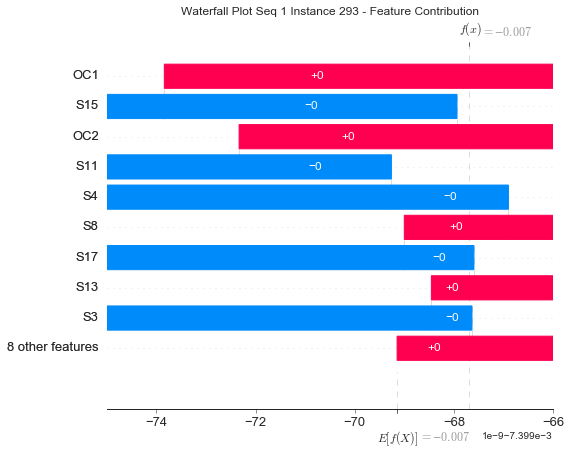

None

Contribution: [ 1.53517332e-09  1.22960486e-09 -5.79295667e-10  1.70089476e-09
 -1.86097304e-09 -3.35649464e-09  8.60578386e-10  2.56388466e-09
  3.48539142e-10 -3.34017303e-09  1.01269404e-09  2.13810369e-09
  3.98617250e-11 -1.81550075e-09 -2.09211981e-09  4.47356402e-10
  9.66937086e-10]


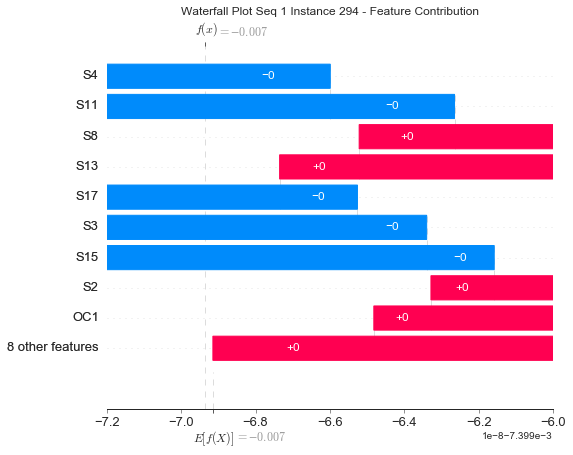

None

Contribution: [ 1.94776839e-13  0.00000000e+00 -6.90305813e-10  2.24111063e-09
 -2.29142283e-09 -5.71014569e-09  2.05661732e-09  2.88951241e-09
  3.79602016e-10 -4.60885419e-09  2.13083973e-09  2.35620656e-09
  1.26565312e-11 -3.52677249e-10 -2.73222067e-09  1.07514297e-09
  1.87948634e-09]


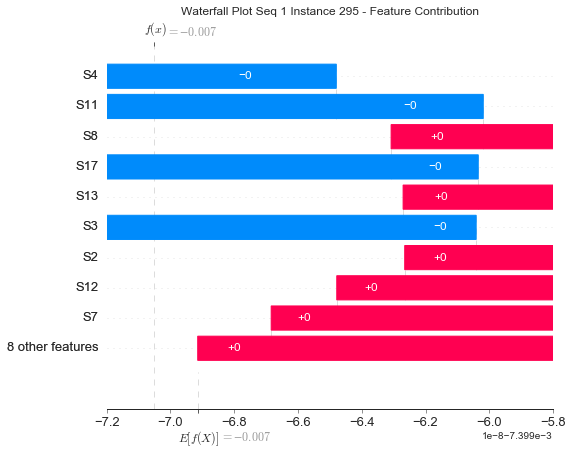

None

Contribution: [ 3.13733861e-09  1.49025270e-09 -7.25592142e-10  1.73379699e-10
 -7.59311281e-10 -1.38308098e-09  1.60471083e-12  1.79858783e-09
  1.32518397e-11 -2.47812659e-09  1.87292629e-12  1.95293626e-09
  4.14635715e-10 -1.48983181e-09 -7.98067001e-10  2.12787448e-12
  2.20220561e-11]


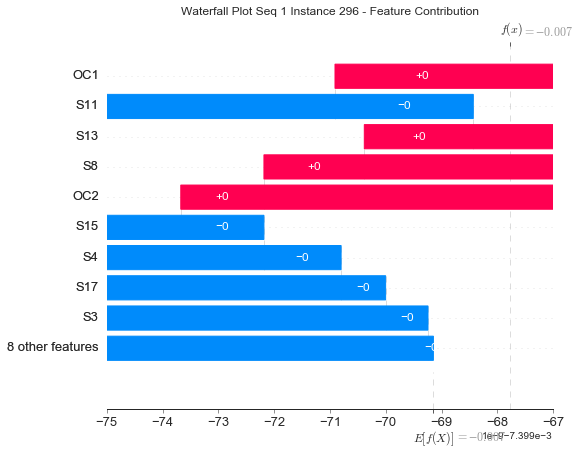

None

Contribution: [ 1.78446681e-13  9.76617875e-13 -8.60377602e-10  1.81097104e-09
 -1.27860322e-09 -4.71066119e-09  2.12798001e-09  3.06542836e-09
  4.74278561e-10 -4.30486491e-09  1.44998780e-09  2.65498867e-09
  5.61993785e-10 -3.53796631e-10 -1.41916634e-09  8.61824112e-10
  1.73967962e-09]


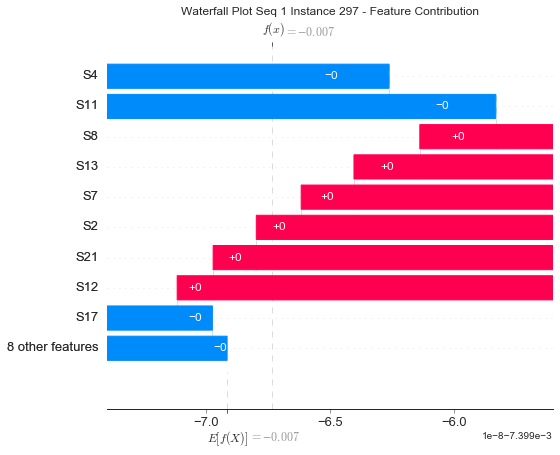

None

Contribution: [ 4.15441592e-09  1.84387461e-09 -1.21261734e-09  3.39575257e-10
 -3.14630350e-10 -1.06773490e-09  4.11068679e-10  2.62306954e-09
  4.38623915e-10 -2.52024224e-09  2.14009643e-10  3.30694472e-09
  1.09963694e-09 -1.30611166e-09 -9.47309453e-11  1.60064642e-10
  4.23969915e-10]


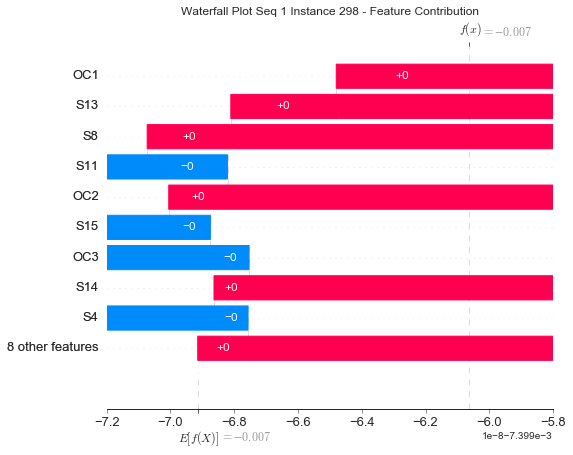

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


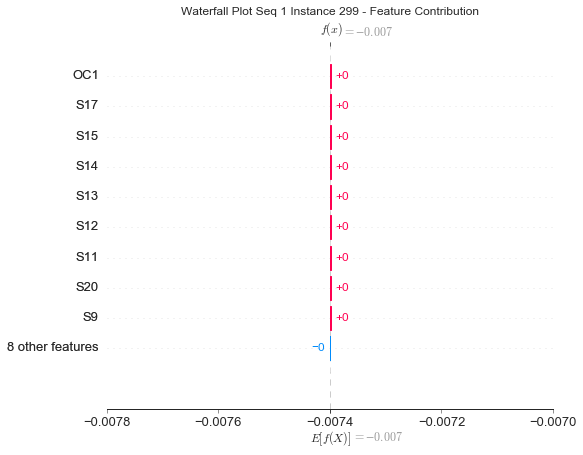

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


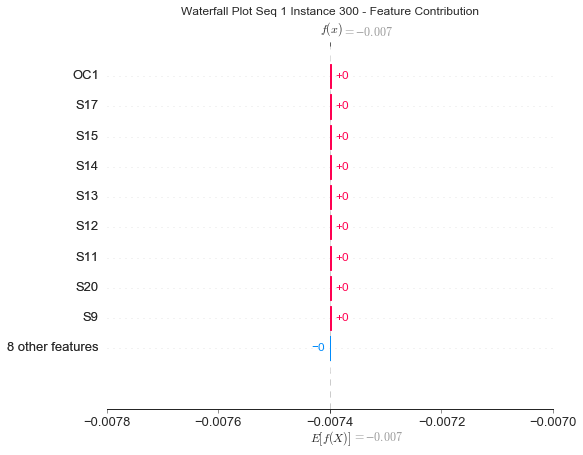

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


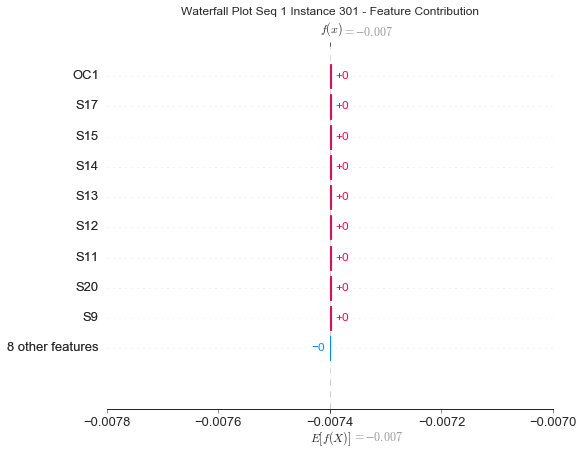

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


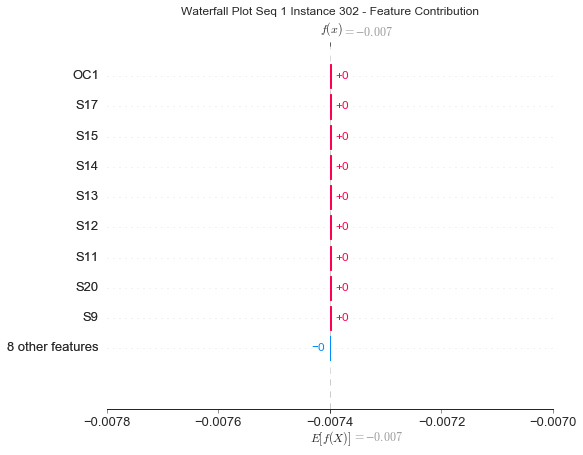

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


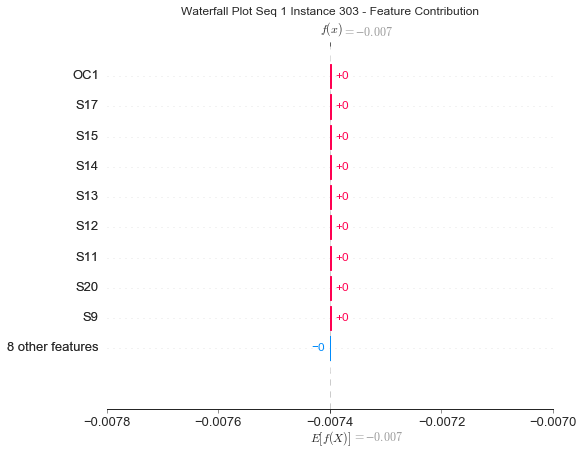

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


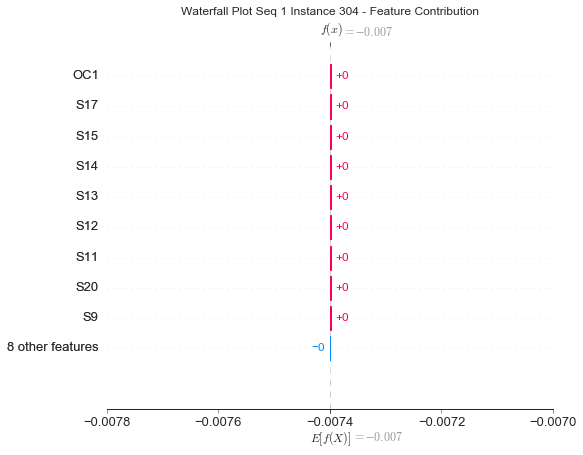

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


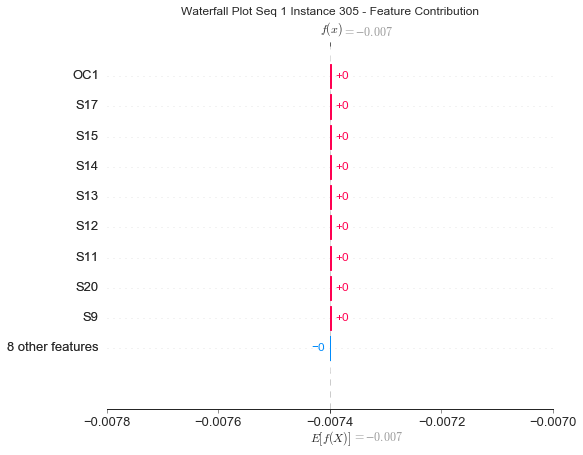

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


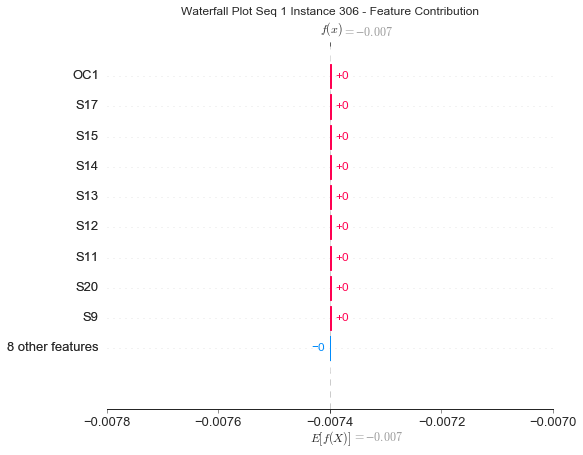

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


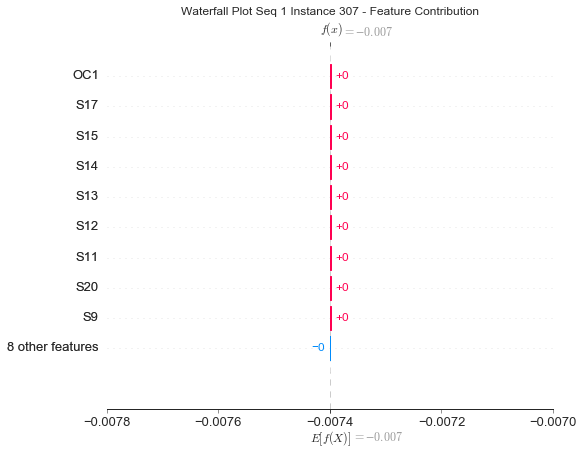

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


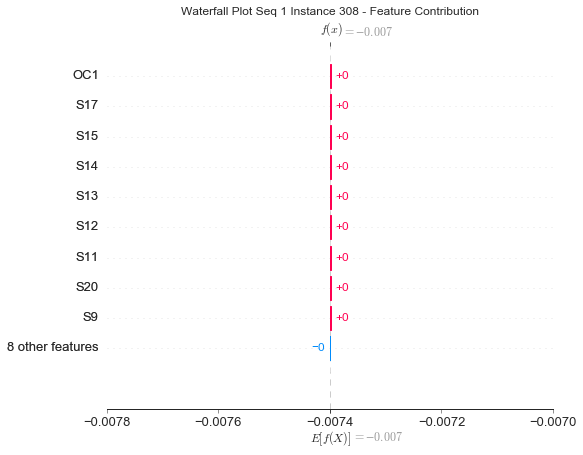

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


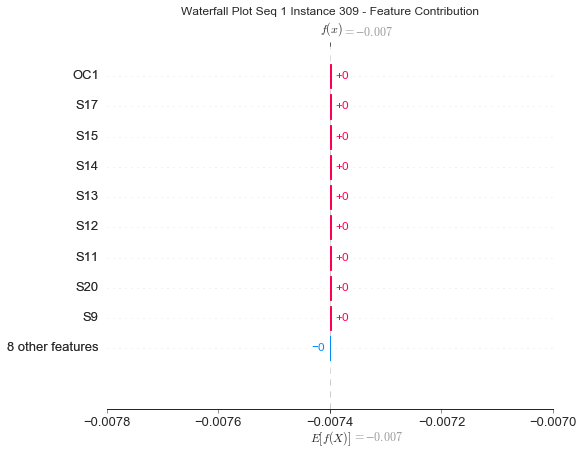

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


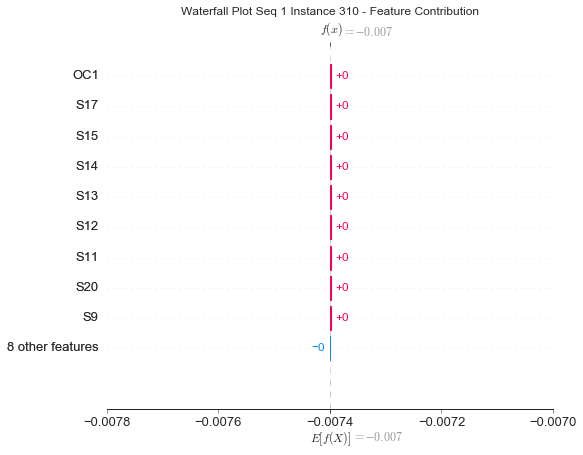

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


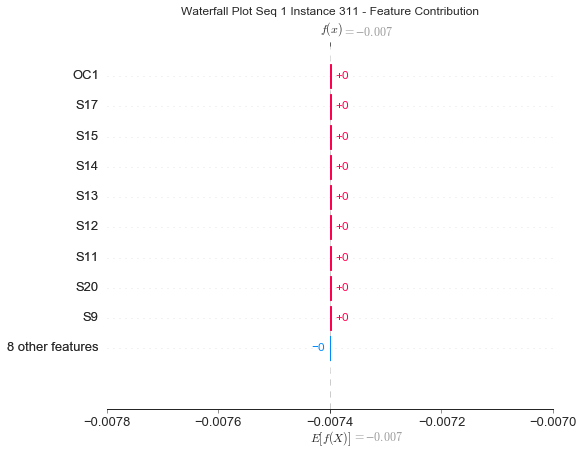

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


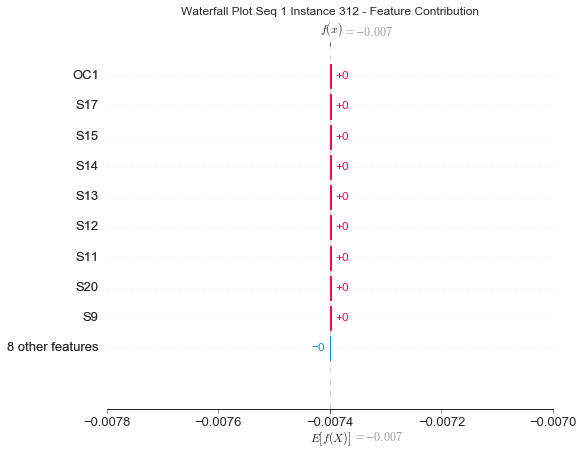

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


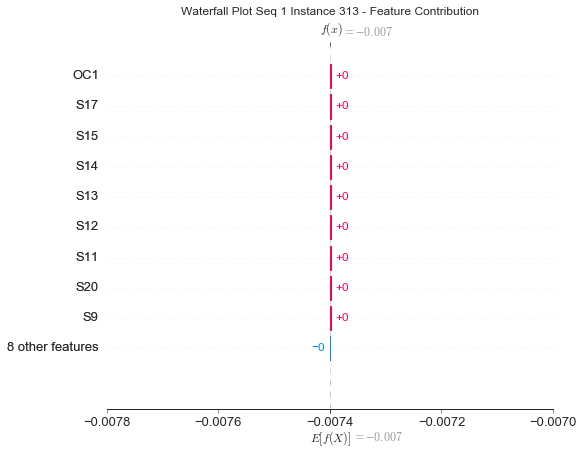

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


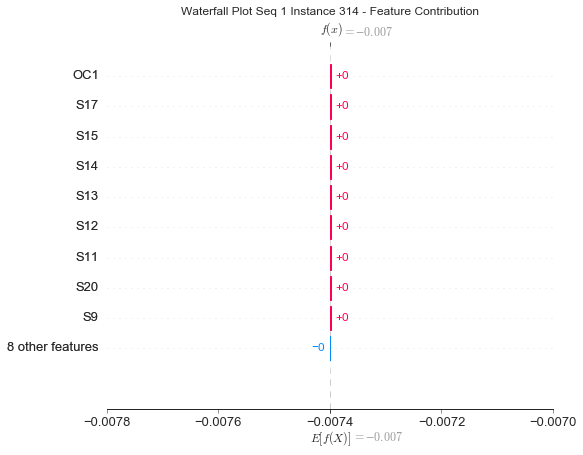

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


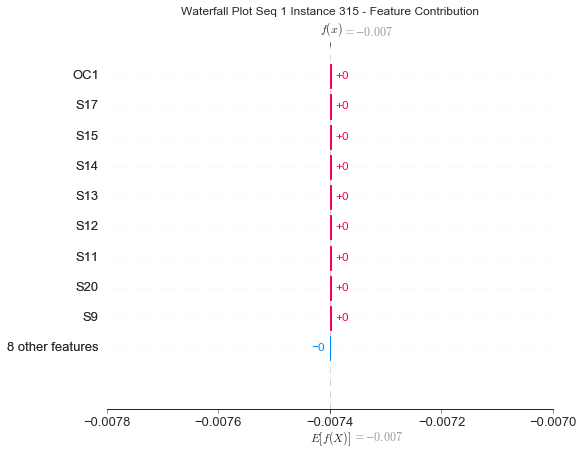

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


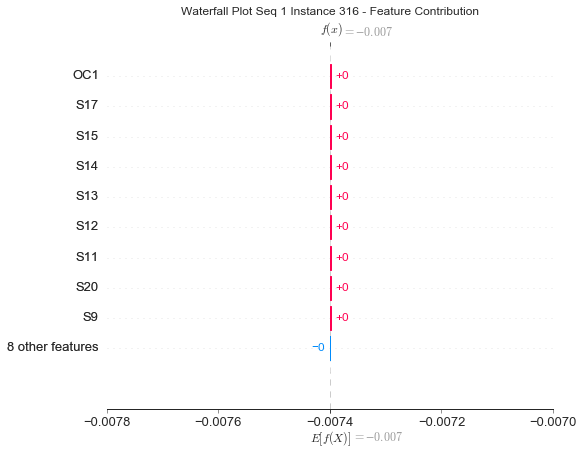

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


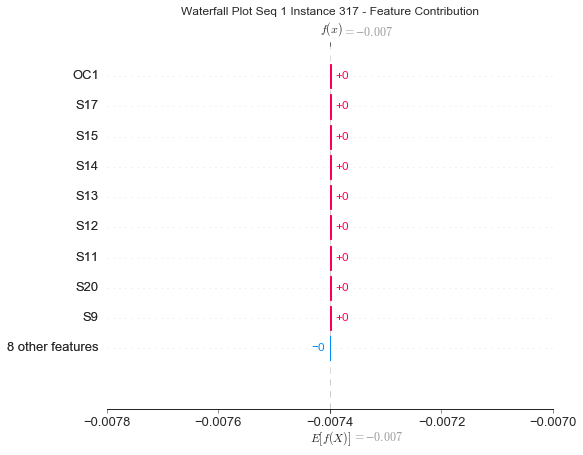

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


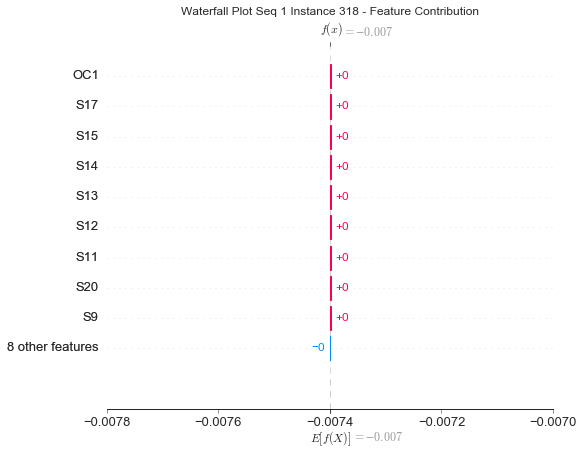

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


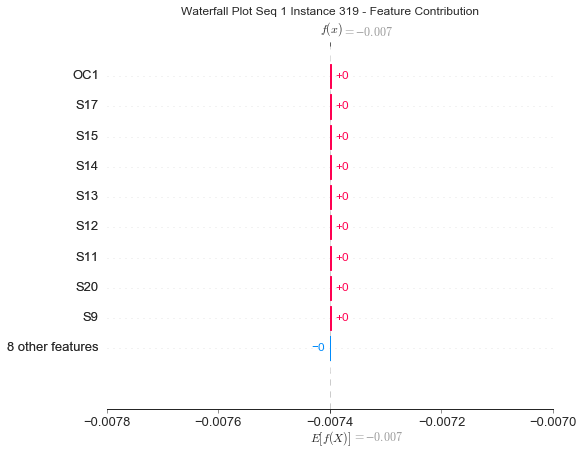

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


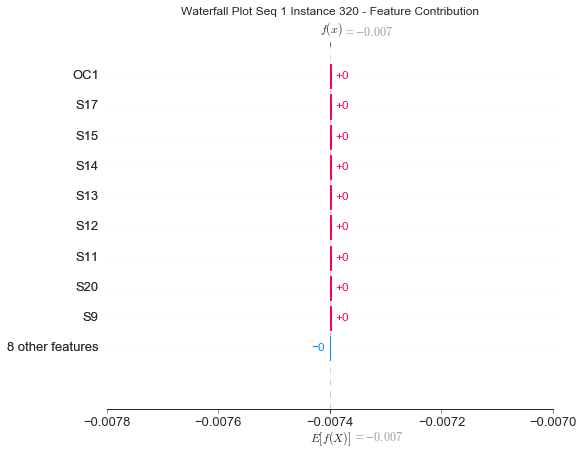

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


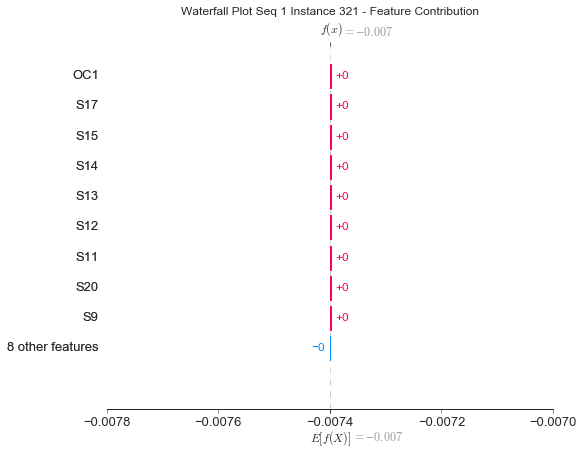

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


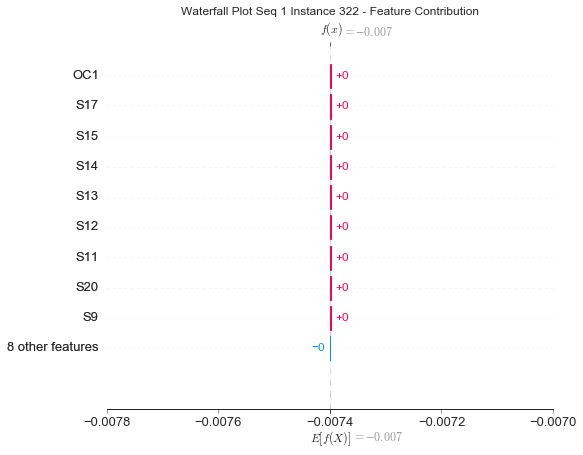

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


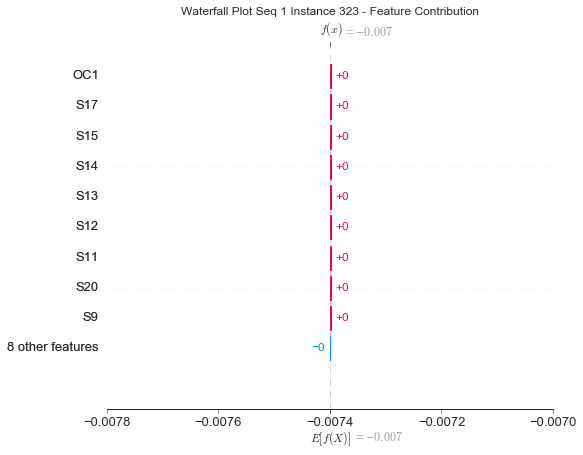

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


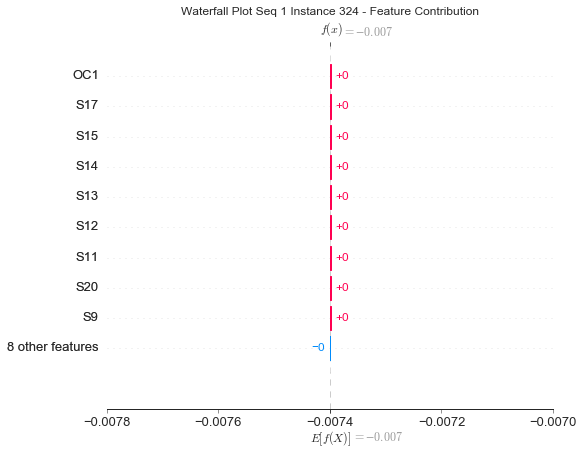

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


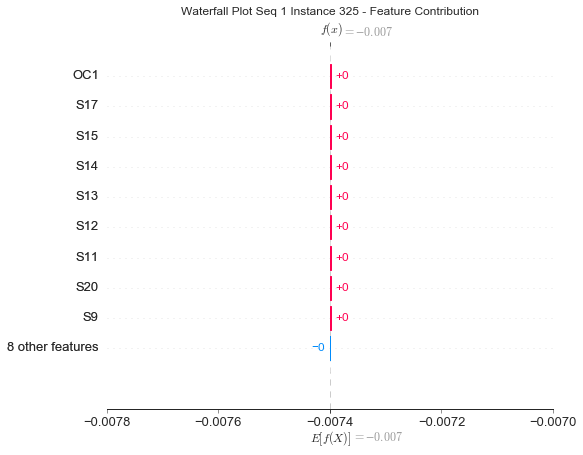

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


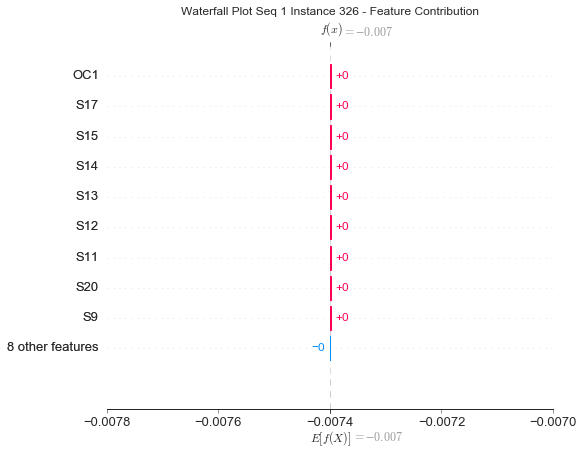

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


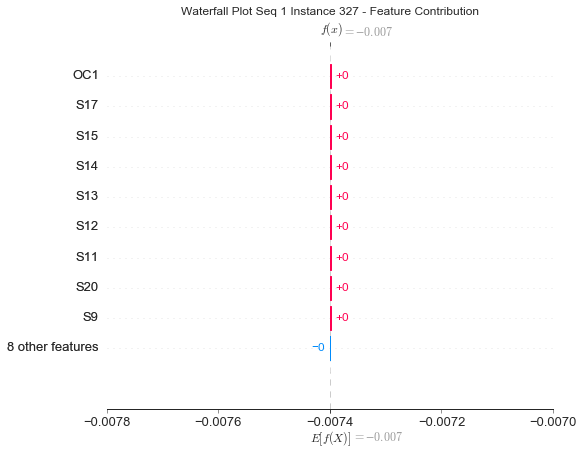

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


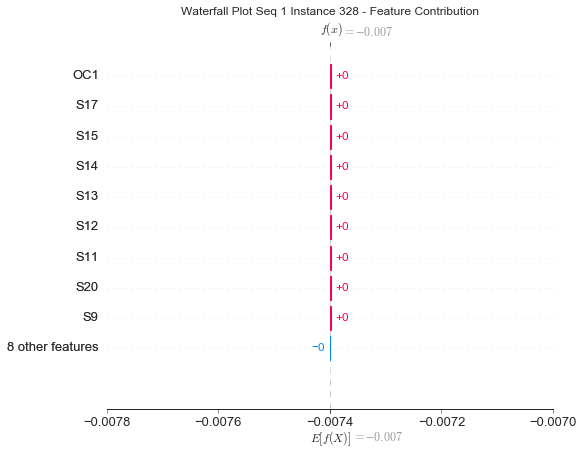

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


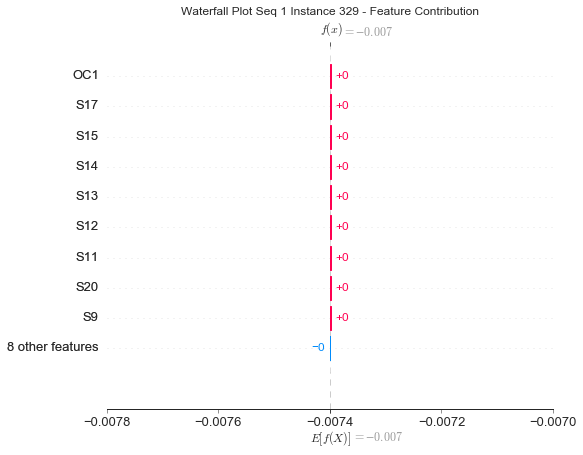

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


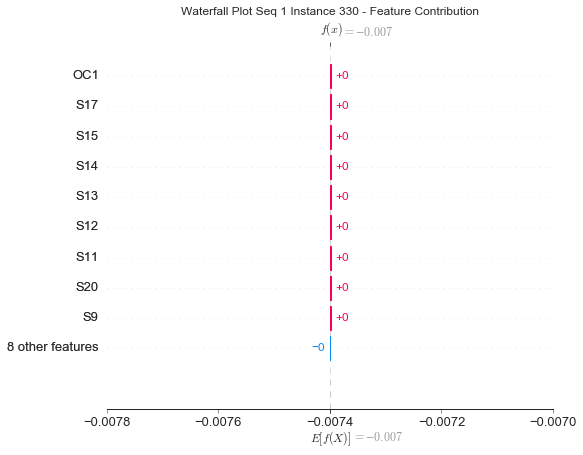

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


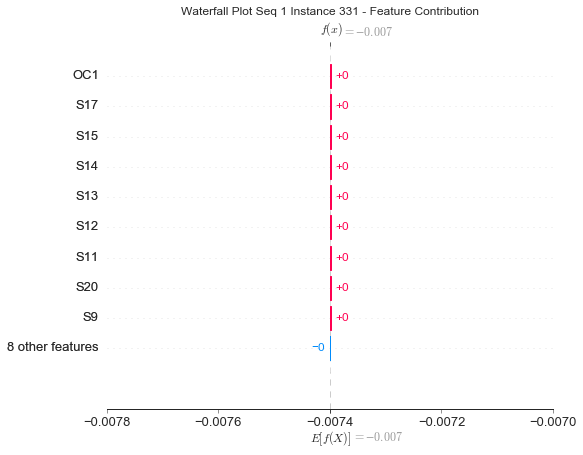

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


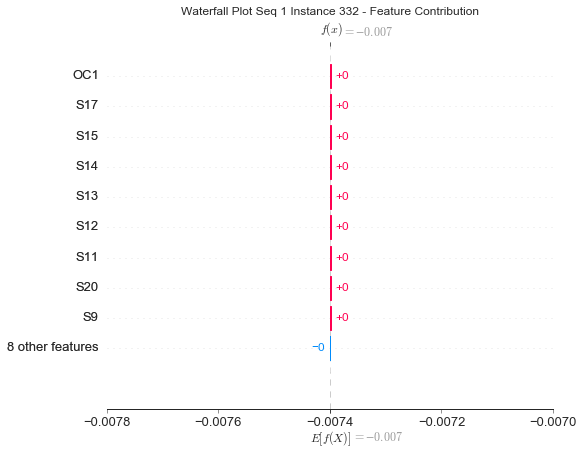

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


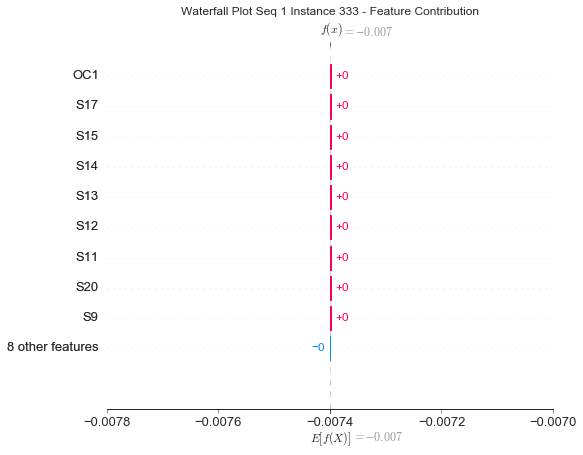

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


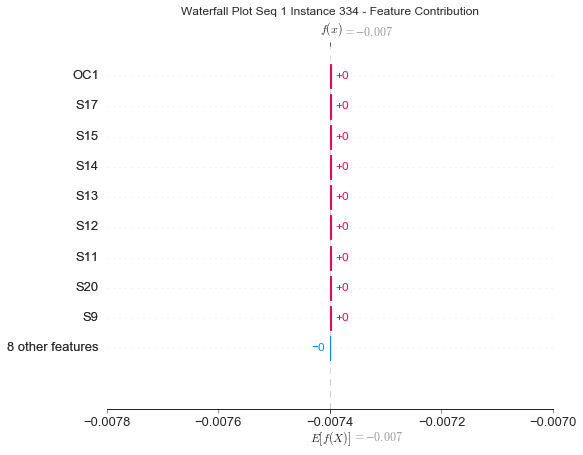

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


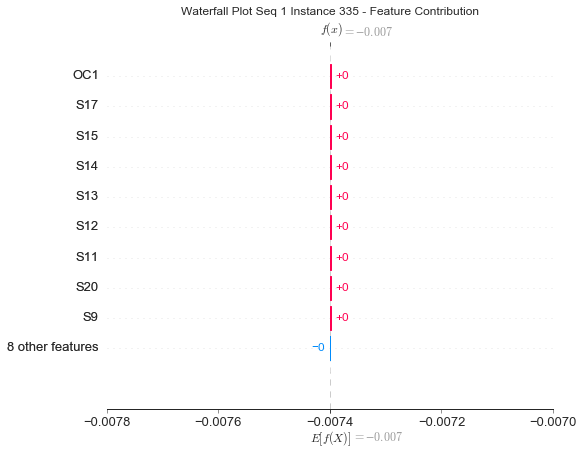

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


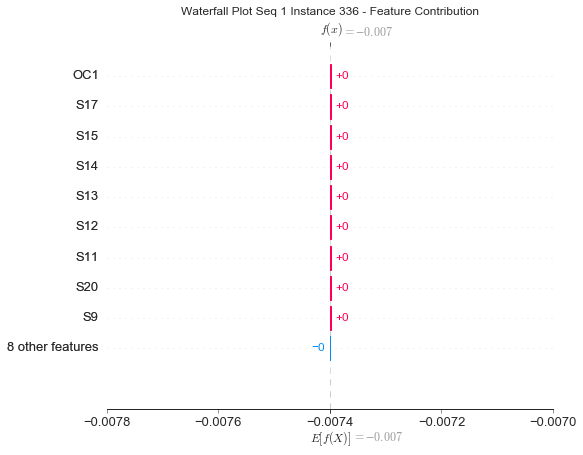

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


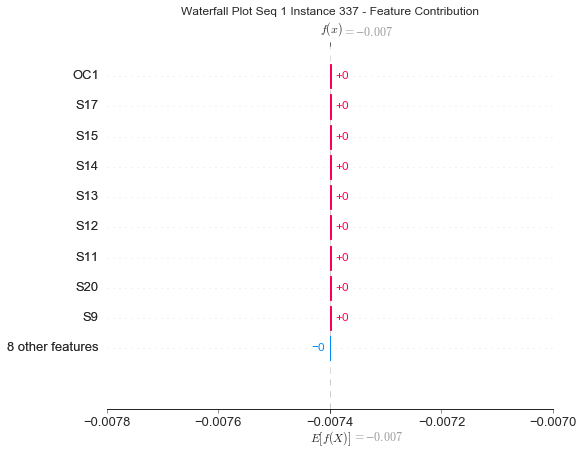

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


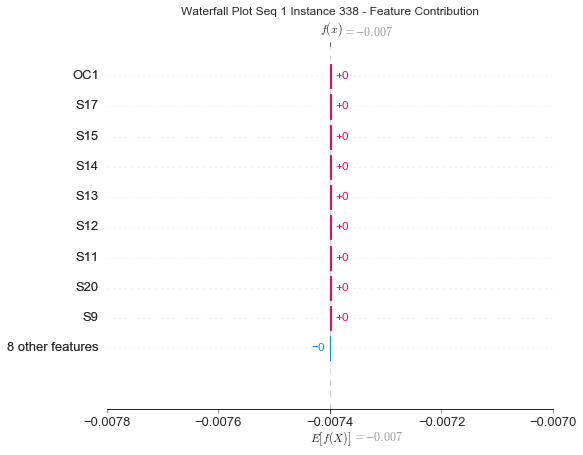

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


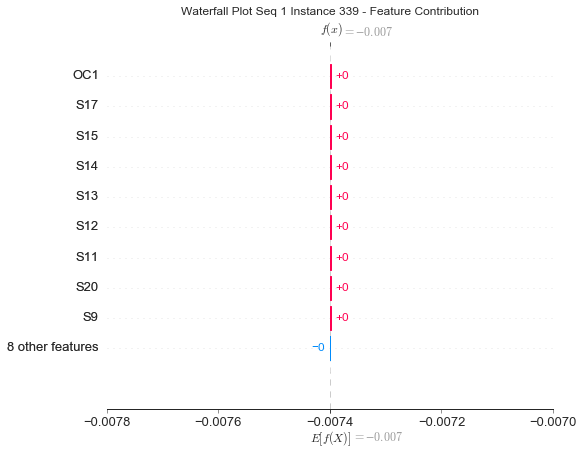

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


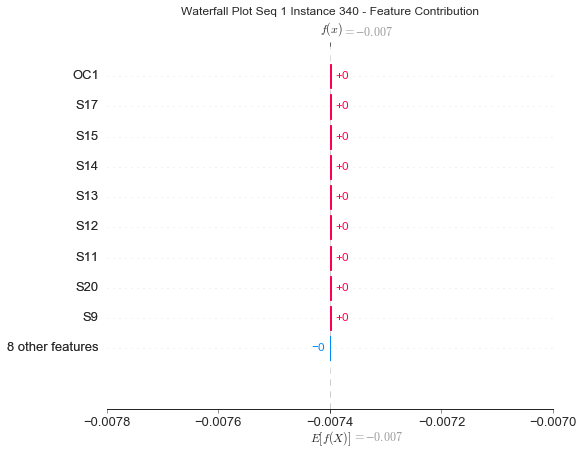

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


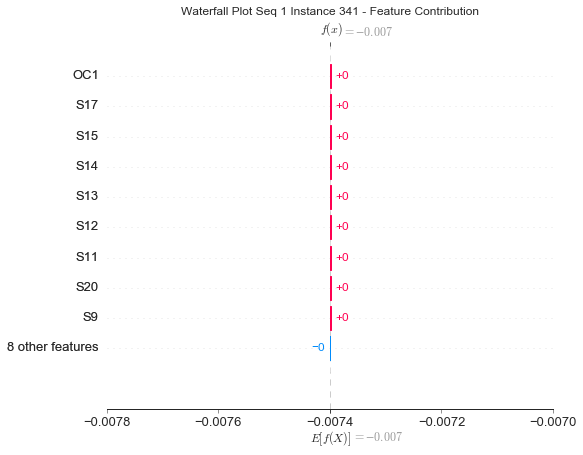

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


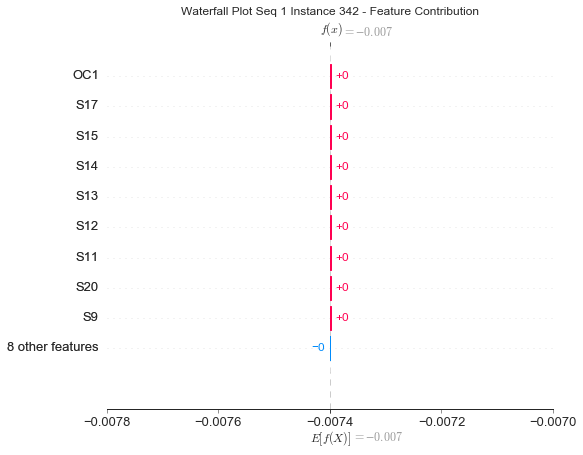

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


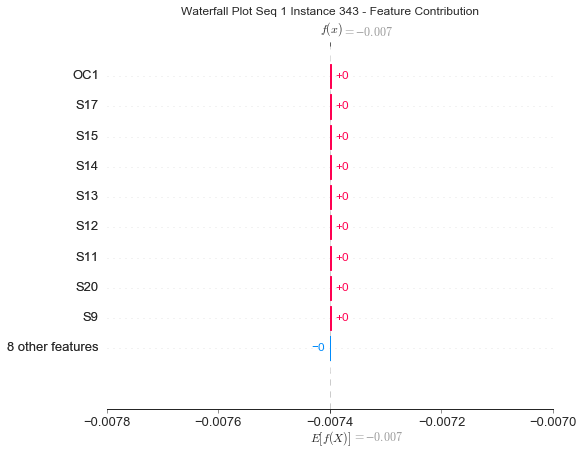

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


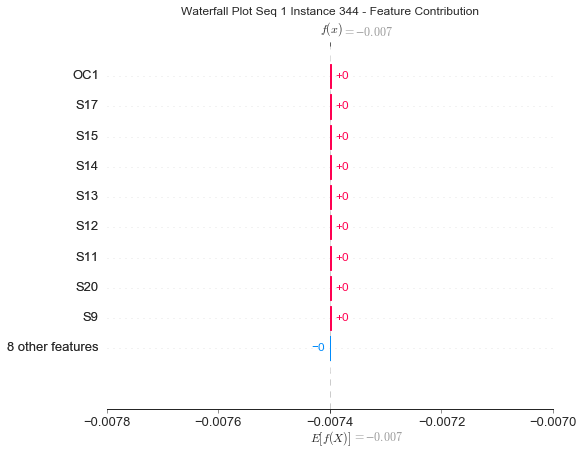

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


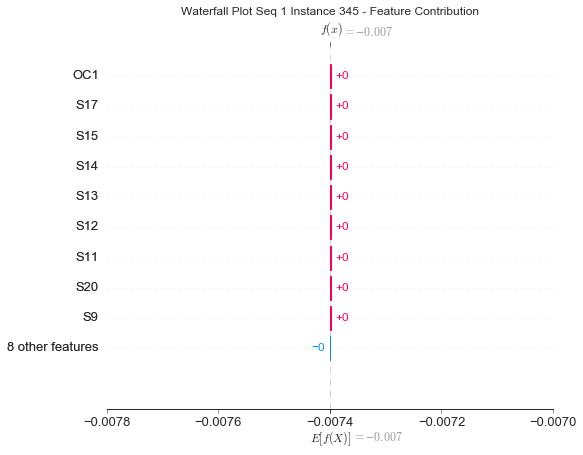

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


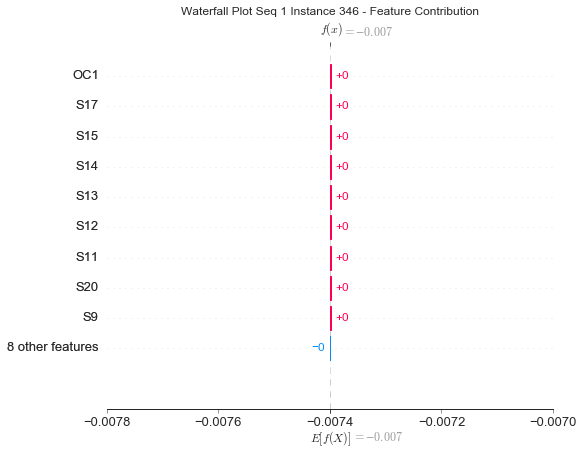

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


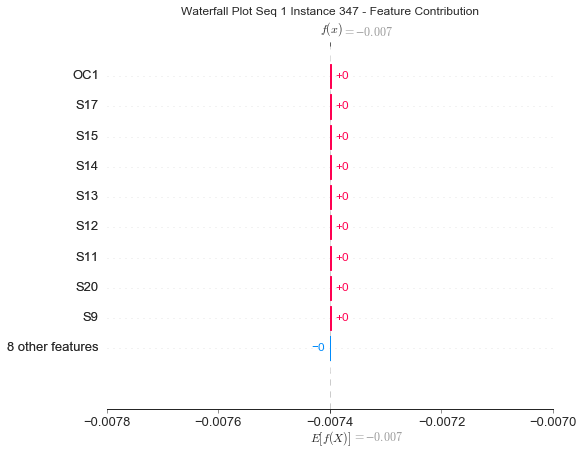

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


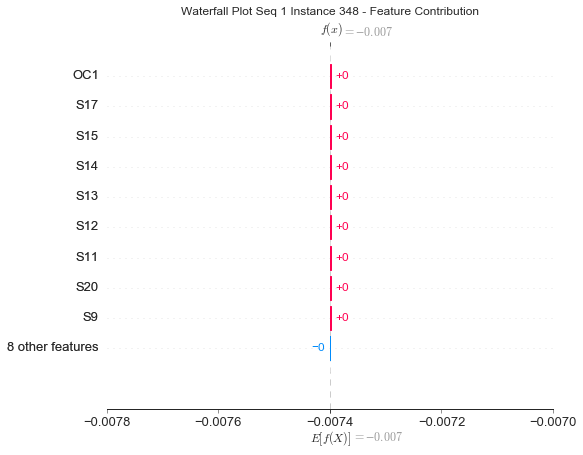

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


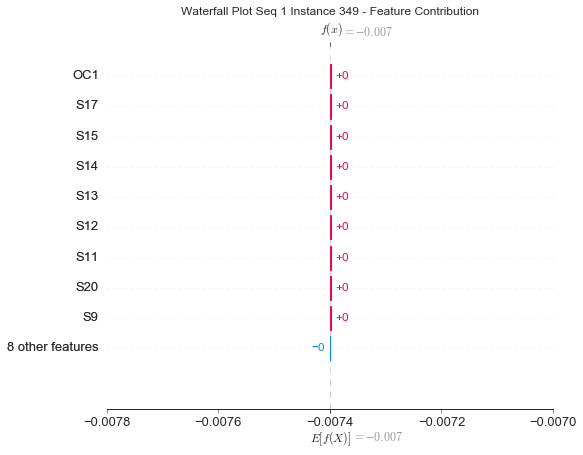

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


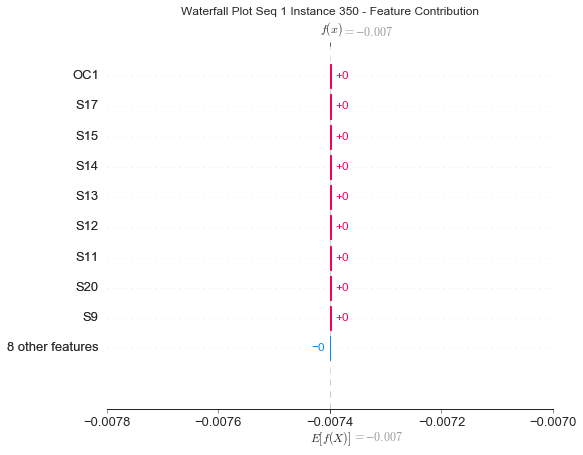

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


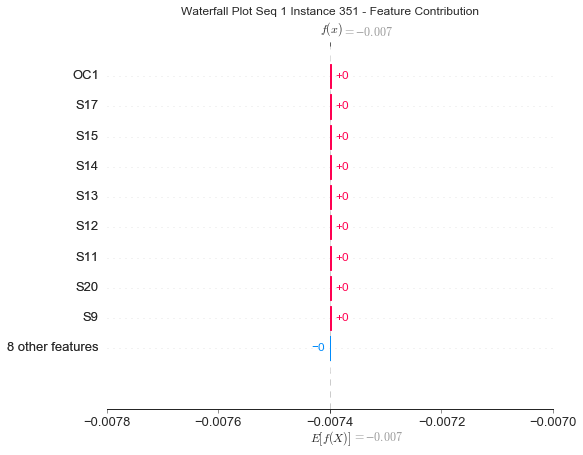

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


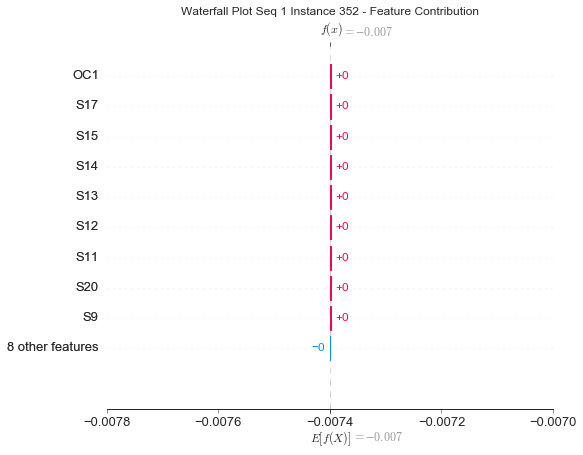

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


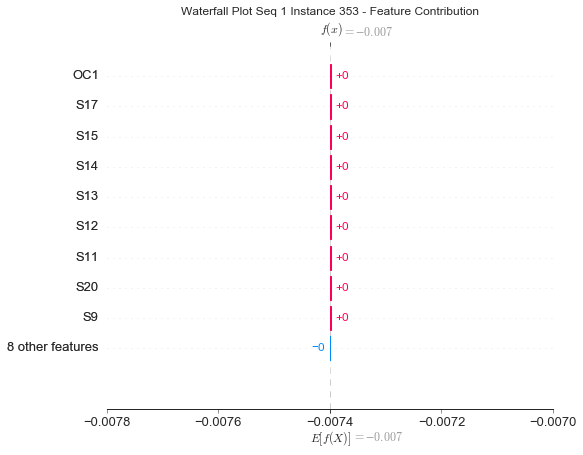

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


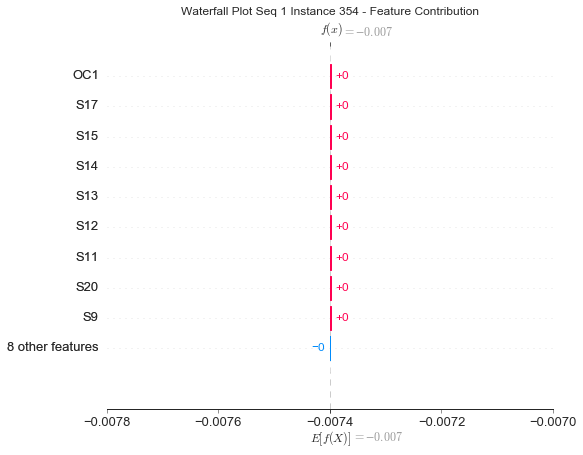

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


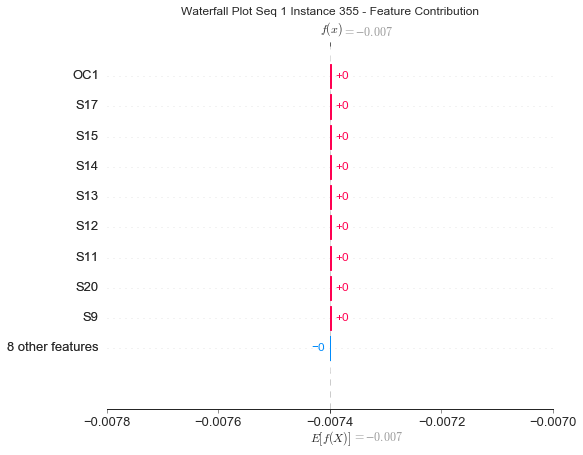

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


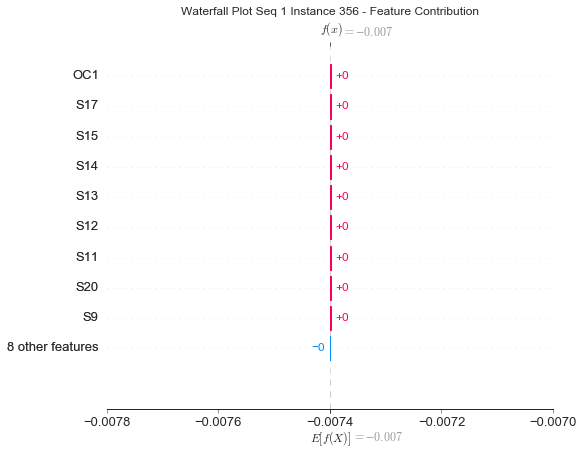

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


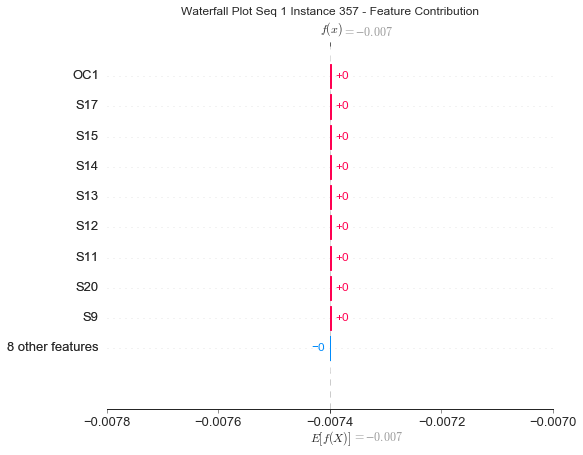

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


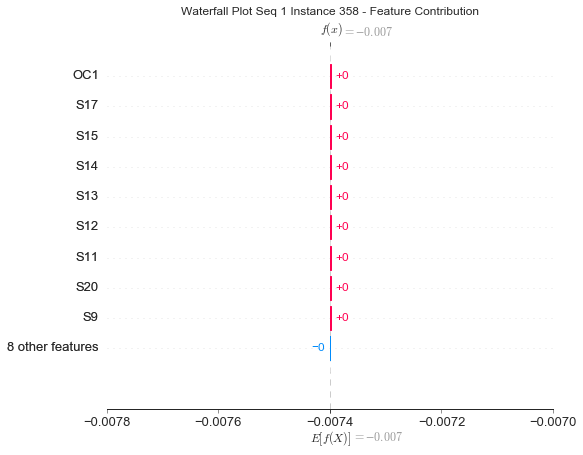

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


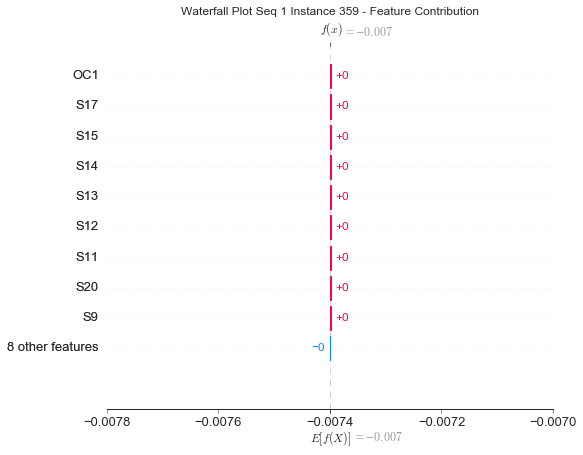

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


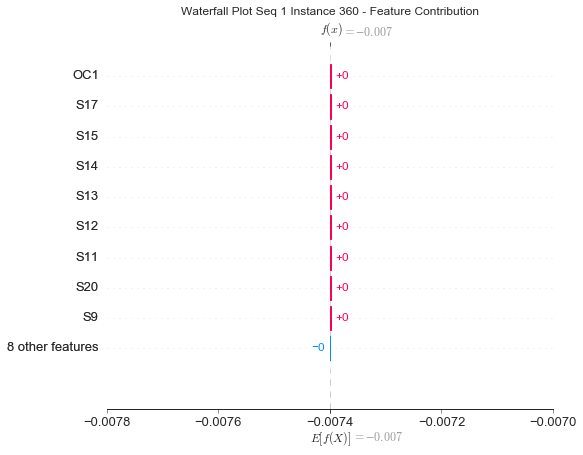

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


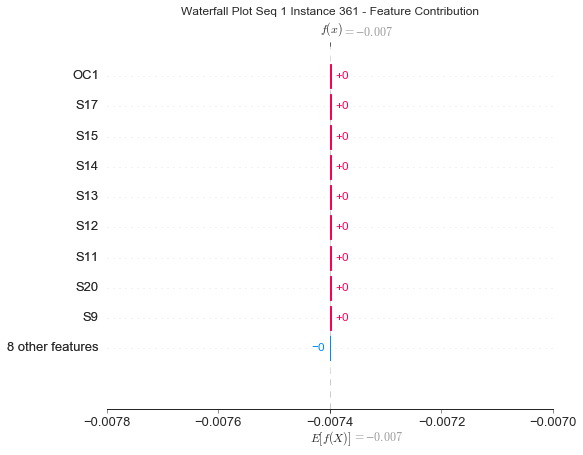

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


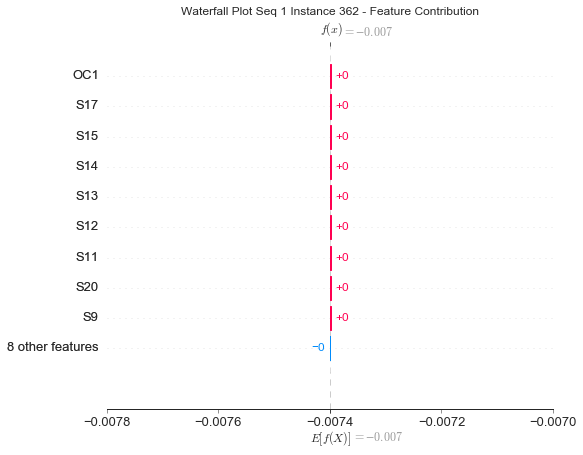

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


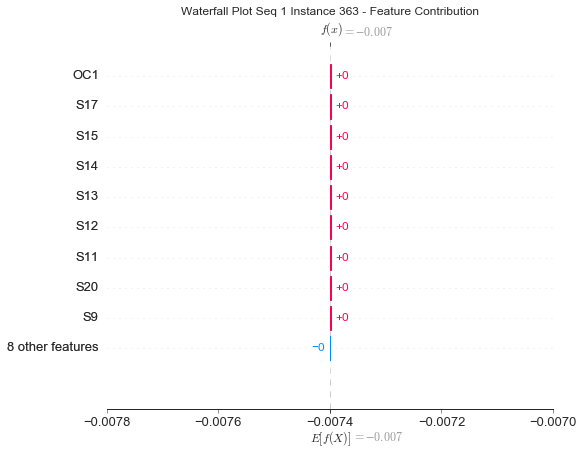

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


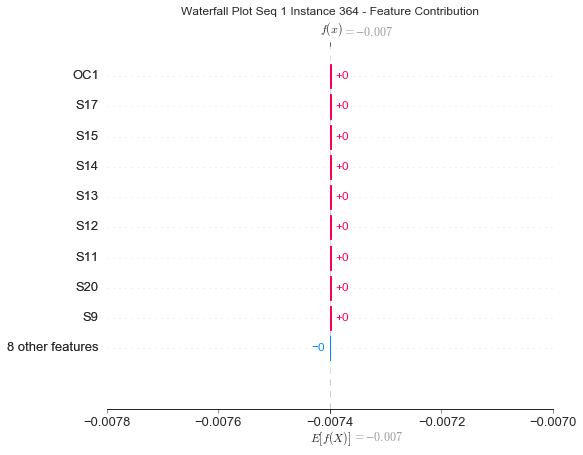

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


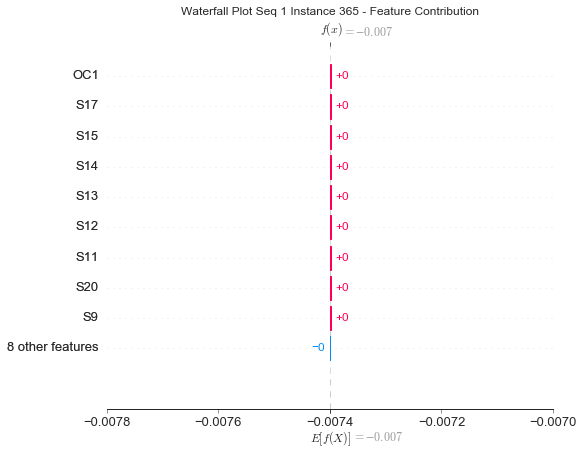

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


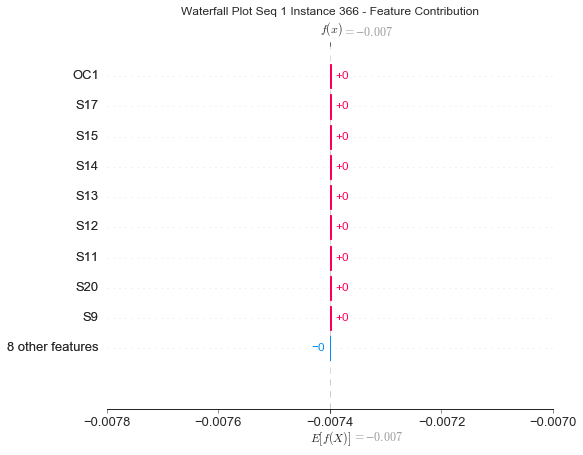

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


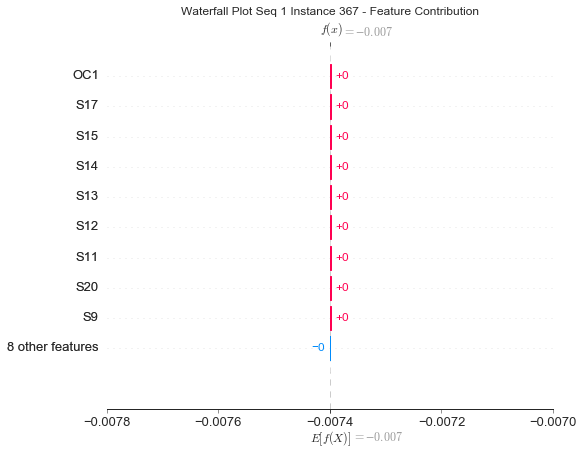

None

<Figure size 432x288 with 0 Axes>

In [67]:
#Waterfall Plot Fleet 1

for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure

Contribution: [-2.12505365e-21 -1.12439134e-22  4.63002332e-22  1.03826909e-21
 -2.55804999e-22  2.22433734e-22  1.16288579e-21 -1.60076841e-22
  2.96797316e-22  1.16124809e-21 -3.28731087e-22 -1.58651424e-21
 -1.15605647e-22  1.32694877e-23  3.78625770e-22 -5.67491515e-23
  8.67585740e-22]


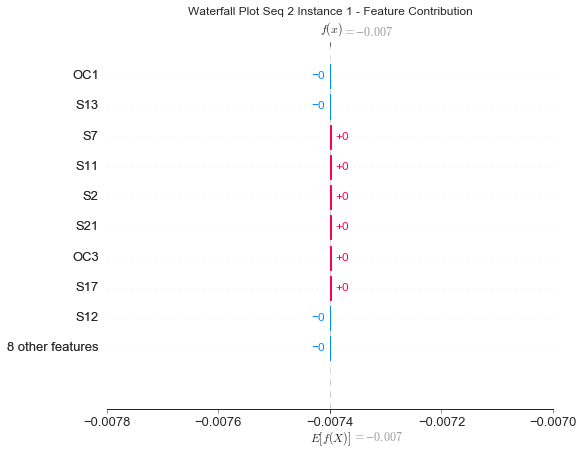

None

Contribution: [-2.20318627e-21 -1.11167440e-21  2.41654727e-22  2.51076256e-21
 -1.33450537e-21 -3.98542687e-21  2.14226854e-21  6.07359435e-22
  6.84096290e-22 -1.53176007e-21  2.66311041e-21 -3.30076442e-22
 -4.06207073e-22  3.68303985e-21 -1.72709072e-21  8.51358985e-22
  1.72517746e-21]


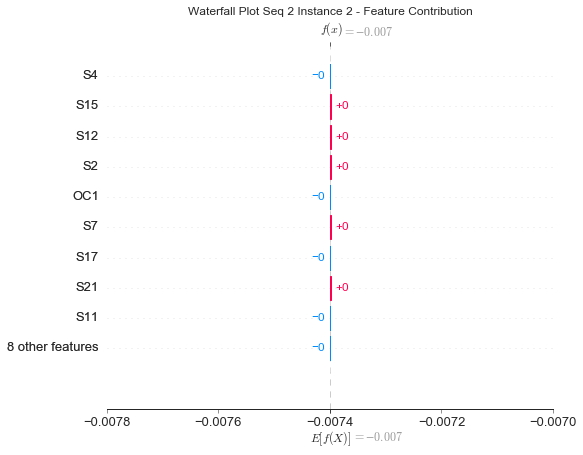

None

Contribution: [ 2.22406208e-21  5.46865239e-22  0.00000000e+00 -2.08456704e-21
  1.56104158e-21  3.13261840e-21 -1.02123807e-21 -7.13058516e-22
 -4.47627950e-22  1.17338751e-21 -1.83525246e-21  3.02693640e-24
 -7.11572416e-23 -1.83708938e-21  1.92465097e-21 -4.34247052e-22
 -1.08470773e-21]


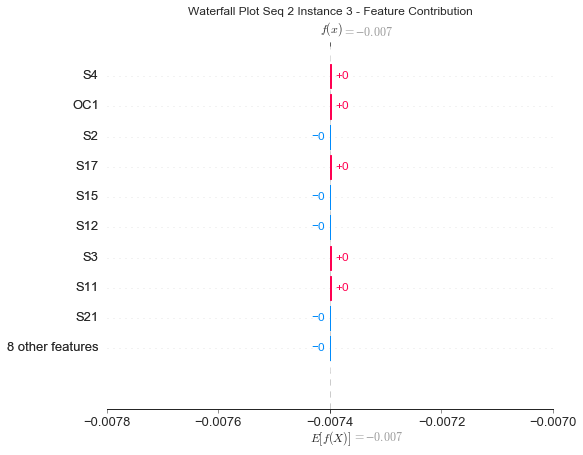

None

Contribution: [-6.13914144e-21 -2.61094653e-21  3.76252093e-22  7.35462519e-21
 -4.80946557e-21 -1.00651595e-20  5.35715850e-21  2.24593188e-21
  1.50204932e-21 -4.78444134e-21  7.37674743e-21 -4.36482671e-22
 -4.91744233e-22  5.38427007e-21 -5.34249260e-21  2.27932425e-21
  4.31721556e-21]


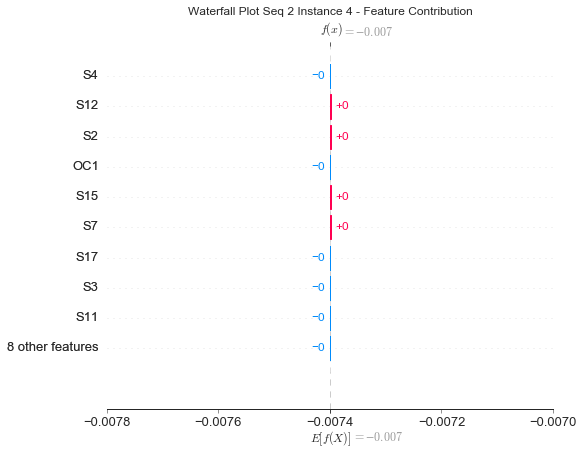

None

Contribution: [ 3.02476665e-21  2.72373703e-22 -2.13531697e-22 -2.35629122e-21
  1.54400110e-22  2.13111836e-21 -2.21166104e-21  1.38116736e-21
 -1.46398852e-22 -7.66357897e-22 -2.27777409e-21  1.88238338e-21
  8.64877751e-23  2.71211662e-21  1.49296508e-22 -8.11459435e-22
 -2.07022951e-21]


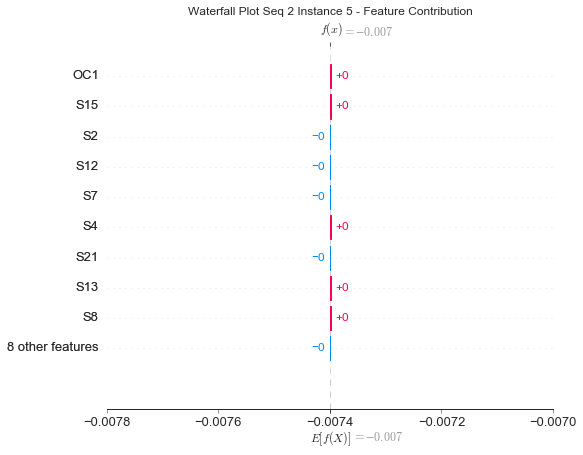

None

Contribution: [ 1.47609734e-21  4.72275903e-22  3.70993963e-22 -1.92000959e-21
  2.18920619e-21  3.67572326e-21 -1.51360239e-21 -1.35513662e-21
 -2.25089683e-22  2.91846768e-21 -1.37043330e-21 -6.40698337e-22
  2.49223728e-22 -3.38397710e-21  2.26283133e-21 -4.47961367e-22
 -1.36947273e-21]


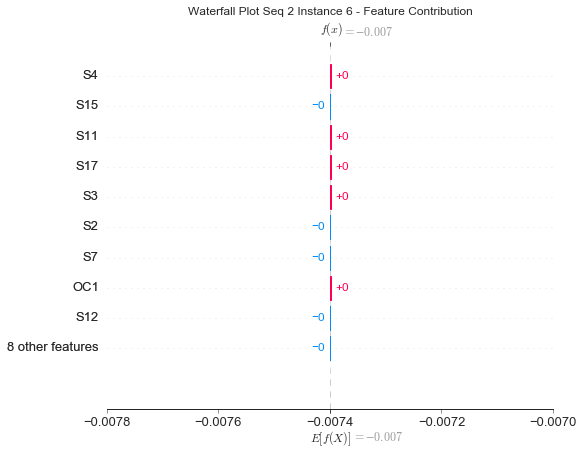

None

Contribution: [-4.00363252e-21 -6.61674919e-22 -9.56428492e-22  8.94455519e-21
 -7.07053227e-21 -1.21082020e-20  4.05120187e-21  5.57318350e-21
  1.83319905e-21 -9.71170624e-21  5.98226793e-21  1.38479445e-21
 -3.60167737e-22  1.15174779e-20 -7.76539145e-21  1.68346270e-21
  3.61465043e-21]


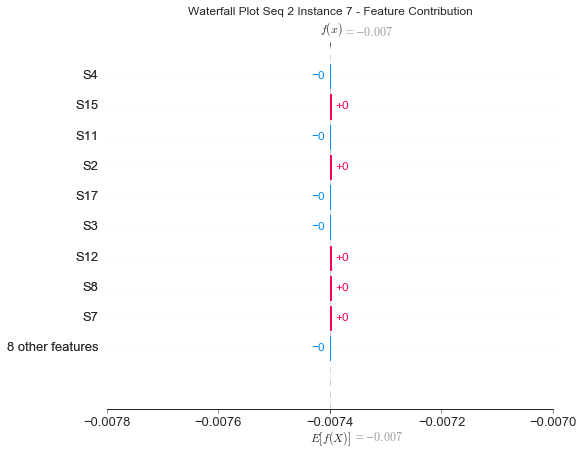

None

Contribution: [-1.67923713e-21 -9.96904402e-22 -3.95297619e-21  3.31048223e-21
 -5.01781815e-21 -7.44109949e-21  1.59440265e-21  4.98885027e-21
  4.14841377e-22 -7.45685308e-21  2.31128097e-21  4.51163895e-21
 -1.74252705e-21  1.34884077e-20 -4.69994613e-21  7.25533979e-22
  1.41562046e-21]


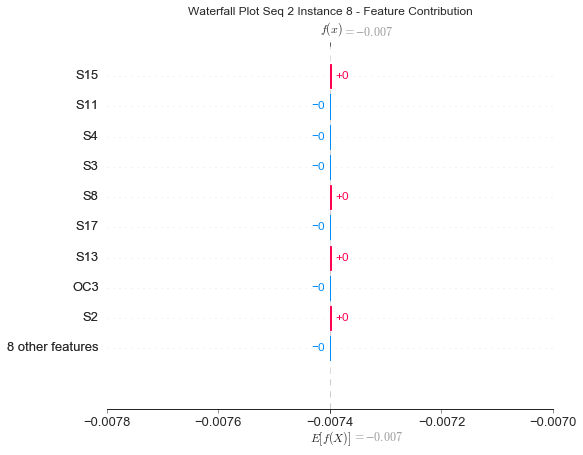

None

Contribution: [-1.19323641e-21 -9.36555054e-22  0.00000000e+00  1.96152816e-21
 -1.42490282e-21 -2.32255776e-21  1.87330802e-21  8.78612526e-22
  3.34710552e-22 -1.30981283e-21  2.38017546e-21 -4.25880917e-24
 -2.43442602e-22  1.88951660e-21 -1.63399180e-21  6.33162886e-22
  1.25419413e-21]


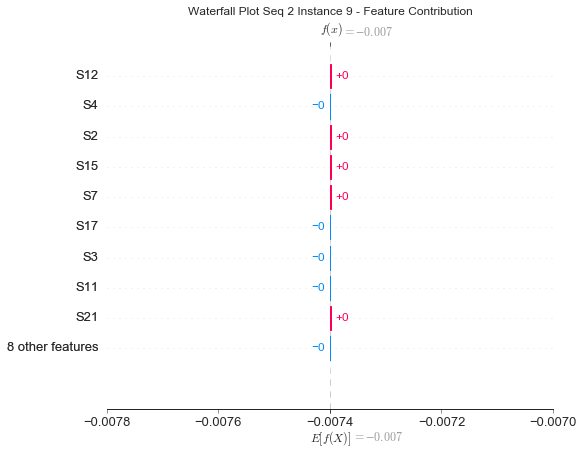

None

Contribution: [ 2.14821239e-22  2.96356640e-22  4.02125333e-21 -1.33693693e-21
  4.13551249e-21  6.00746705e-21 -7.93688885e-22 -4.36314872e-21
  3.09061819e-23  7.91062627e-21 -1.55009295e-21 -3.90055927e-21
  9.42954394e-22 -1.21580856e-20  4.15614960e-21 -5.19929867e-22
 -6.39639472e-22]


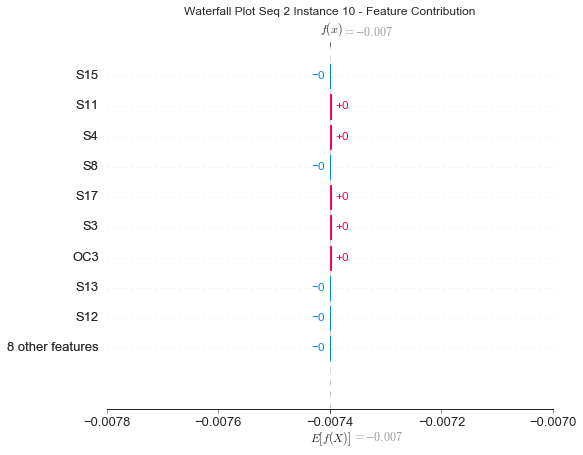

None

Contribution: [ 3.16114286e-22  6.20622749e-22  3.74092230e-22  5.49826509e-22
 -1.42009241e-21 -1.21645482e-21  2.25059921e-22  1.02648590e-21
  7.05599035e-23 -1.36464081e-21  1.81674502e-22  2.27249622e-22
  9.97683178e-23  2.74986663e-21 -1.33368111e-21  3.27401320e-23
  3.22925702e-22]


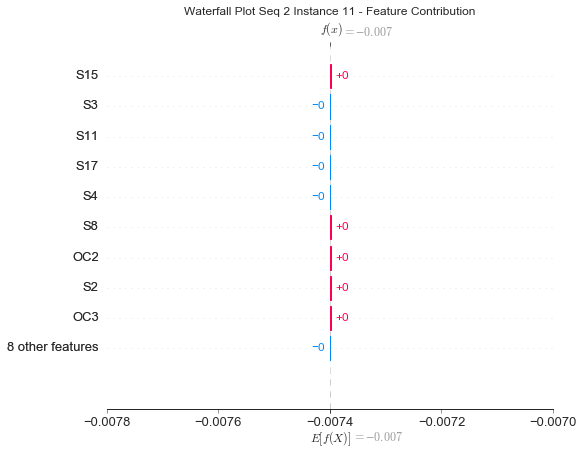

None

Contribution: [-1.65114742e-21 -1.15207862e-21 -2.98973366e-21  2.60951573e-21
 -3.06528396e-21 -5.66596223e-21  1.82290129e-21  2.54167621e-21
  7.53125064e-23 -4.28253375e-21  1.88614628e-21  2.38708169e-21
 -1.61113750e-21  8.65502582e-21 -2.74281843e-21  6.52538572e-22
  1.44294408e-21]


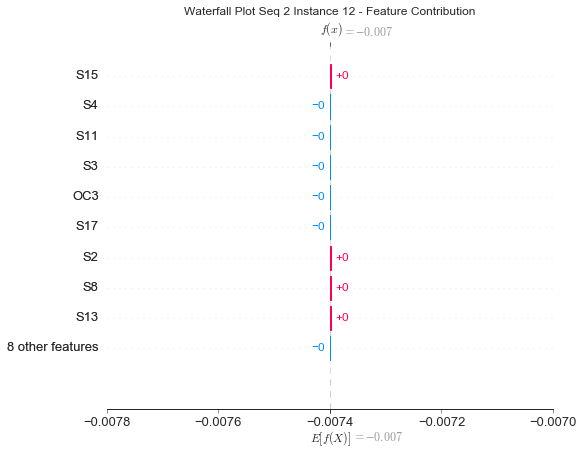

None

Contribution: [ 1.81185351e-21  1.45189221e-21  0.00000000e+00 -3.91061398e-22
  7.19615982e-22  3.54098451e-21 -1.06390270e-21  5.28503753e-24
 -2.61728195e-22  1.78211378e-21 -1.98624685e-21  8.82832186e-25
  2.28826057e-22 -3.04601486e-21  9.02748994e-22 -7.39467509e-22
 -7.38462412e-22]


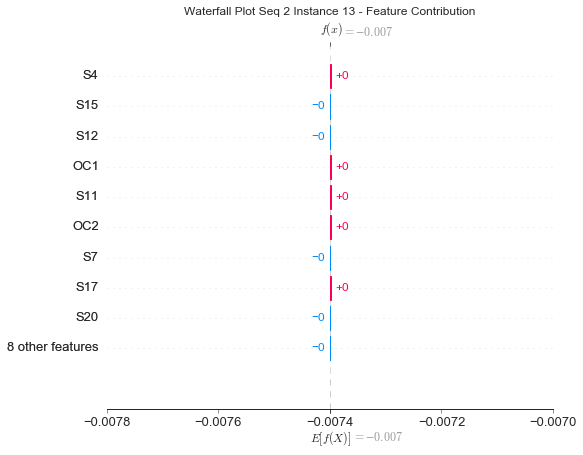

None

Contribution: [ 2.66589951e-21 -7.54185357e-22  0.00000000e+00 -5.35104350e-21
  3.43058700e-21  5.40297089e-21 -2.31350704e-21 -1.94023311e-21
 -8.22502377e-22  3.30225465e-21 -2.99175940e-21  2.12641460e-24
 -7.16371025e-23 -8.29459853e-22  3.75957223e-21 -8.42874174e-22
 -2.21059111e-21]


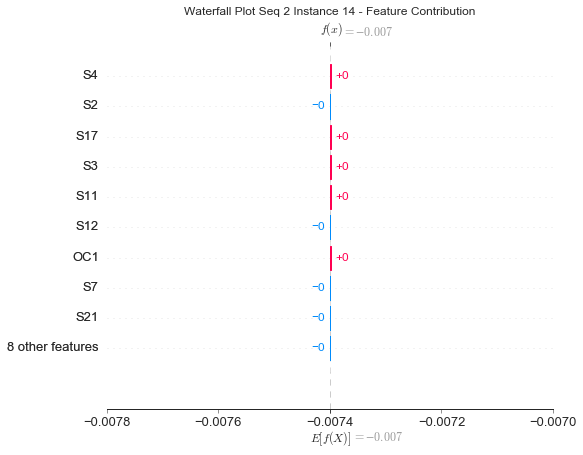

None

Contribution: [-1.71641714e-21 -3.43372598e-22  2.62580064e-21  2.01197204e-21
  1.01419421e-21  2.36677633e-22  9.17297760e-22 -1.77316827e-21
  8.40681064e-22  2.70584693e-21  1.89673928e-21 -2.67593655e-21
  7.11014596e-22 -5.55465918e-21  3.67150254e-22  6.60136678e-22
  8.34480996e-22]


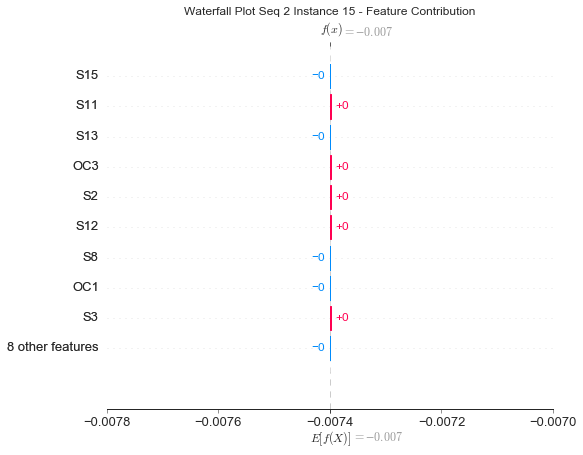

None

Contribution: [-2.93585726e-21 -3.74643095e-22  0.00000000e+00  4.84321882e-21
 -2.92428319e-21 -3.84976198e-21  2.00977262e-21  1.63336142e-21
  8.18530961e-22 -1.81254962e-21  3.20335891e-21  3.44740104e-24
 -2.25973801e-24  1.15271587e-21 -3.13310429e-21  9.31440913e-22
  1.86095645e-21]


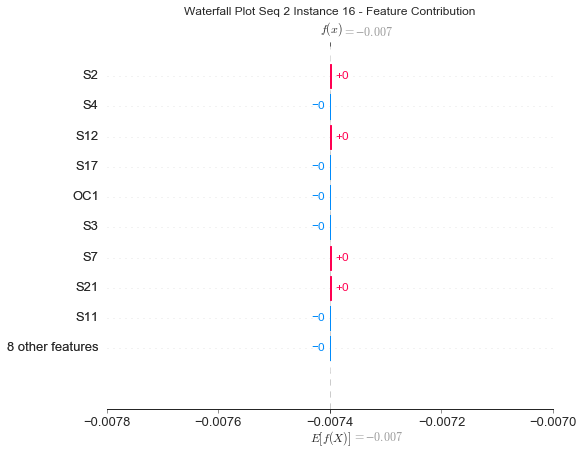

None

Contribution: [-2.21988518e-21 -3.45277047e-22  0.00000000e+00  2.37284493e-21
 -1.55228469e-21 -2.02673912e-21  1.24821726e-21  7.53236098e-22
  3.31063389e-22 -4.84052675e-22  2.10068393e-21  4.13695304e-24
 -2.42281761e-23  6.73172800e-22 -1.60809909e-21  6.99631624e-22
  1.25794936e-21]


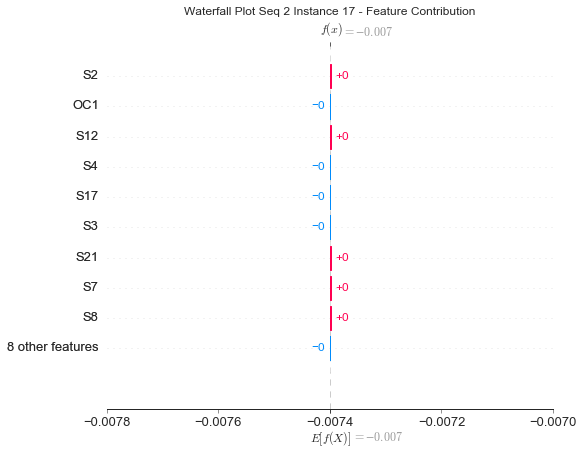

None

Contribution: [ 5.67483382e-21  3.00720199e-21  1.81575575e-21 -8.03866963e-21
  6.86235337e-21  1.27511951e-20 -5.24301888e-21 -4.47864705e-21
 -1.18204786e-21  8.77293298e-21 -8.04802469e-21 -1.49160950e-21
  5.12205492e-22 -9.89659080e-21  7.25871505e-21 -2.46067310e-21
 -3.85669326e-21]


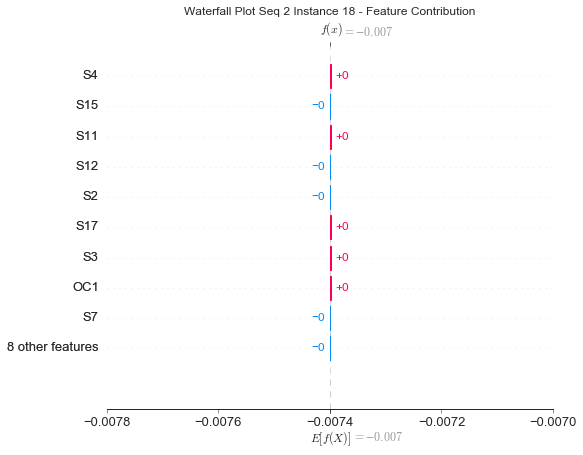

None

Contribution: [-2.58159555e-21 -3.02229829e-22  0.00000000e+00  2.55546888e-21
 -1.98178480e-21 -3.37975214e-21  1.99127233e-21  1.04607914e-21
  3.49670207e-22 -1.51467776e-21  2.31525450e-21  4.42720455e-24
 -2.36973513e-22  3.04445339e-21 -2.08093439e-21  5.94230719e-22
  1.94111502e-21]


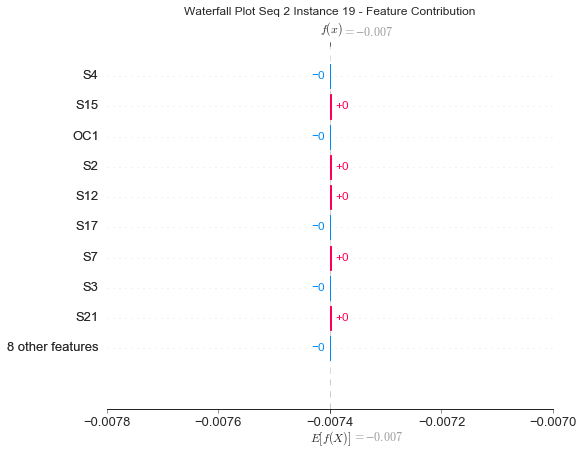

None

Contribution: [ 3.84868762e-21  7.85754838e-22  2.50084003e-22 -4.91205293e-21
  3.76272586e-21  7.12997215e-21 -3.37327828e-21 -2.00357584e-21
 -7.17608211e-22  4.44800501e-21 -4.07220329e-21 -1.70751101e-22
  3.62068425e-22 -5.85906609e-21  3.74592052e-21 -1.08258626e-21
 -2.92436054e-21]


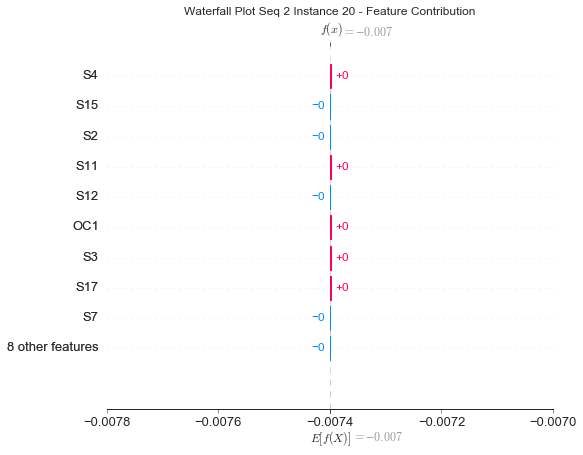

None

Contribution: [ 4.95128908e-21  4.49909796e-21 -2.80929034e-21 -7.09041773e-21
  6.55458241e-21  1.39546823e-20 -4.23062453e-21 -4.73743745e-21
 -2.43964482e-21  8.77435955e-21 -8.02809642e-21 -2.85146000e-21
 -1.15124033e-21 -8.03630280e-21  7.40301445e-21 -2.79719141e-21
 -2.94671966e-21]


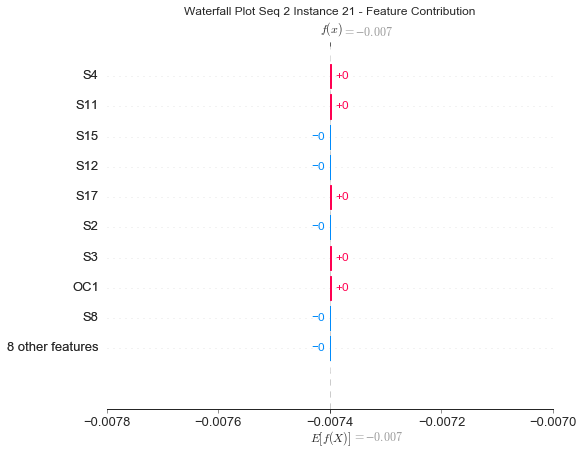

None

Contribution: [ 1.14507979e-21 -1.28485262e-21  0.00000000e+00 -1.30199198e-21
  1.01933380e-21  2.26383541e-21 -9.61790727e-22 -6.69032252e-22
 -2.39331185e-23  1.46640806e-21  4.84614988e-23  7.53591526e-25
  2.56684257e-22 -2.28979547e-21  7.76533117e-22  3.05256429e-22
 -1.30526516e-21]


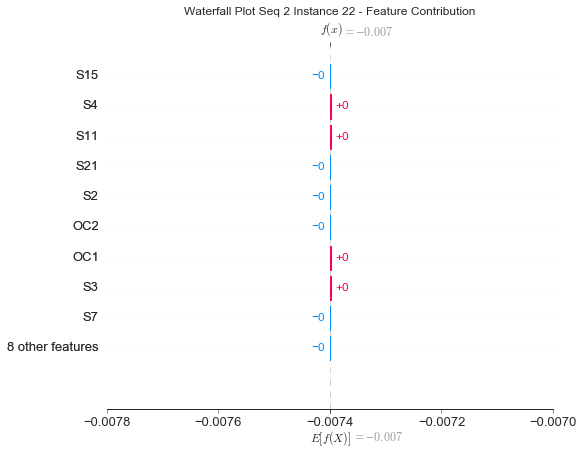

None

Contribution: [ 3.96293265e-21  3.16714936e-21  0.00000000e+00 -4.89204308e-21
  4.26022088e-21  8.72606480e-21 -4.55603044e-21 -1.80164703e-21
 -8.20203599e-22  5.21659434e-21 -6.56408812e-21  1.52063757e-24
  1.15358690e-22 -4.93416507e-21  4.56608666e-21 -2.06215440e-21
 -3.18380889e-21]


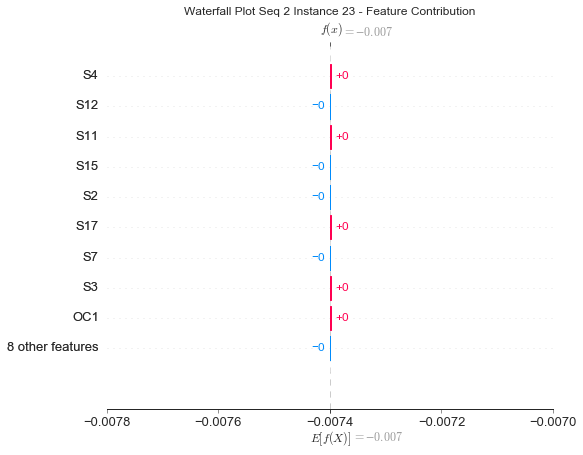

None

Contribution: [ 2.64373063e-21  4.01692593e-22  1.78817122e-21 -7.56826801e-21
  5.45843521e-21  7.60482309e-21 -2.45513608e-21 -4.18454193e-21
 -1.34599885e-21  6.39157128e-21 -3.92160714e-21 -1.58807692e-21
  2.41076524e-22 -4.23181441e-21  5.38806347e-21 -1.16867191e-21
 -2.20629688e-21]


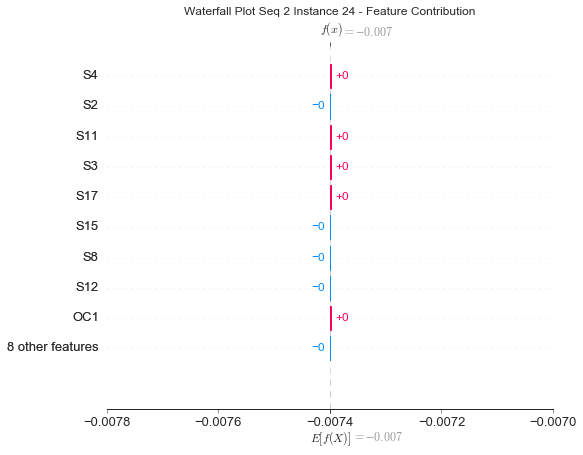

None

Contribution: [ 4.69234843e-21  8.85590550e-22  0.00000000e+00 -8.02579340e-21
  4.66841068e-21  6.54835149e-21 -2.71789658e-21 -2.69846470e-21
 -1.45051290e-21  4.03821538e-21 -5.01061102e-21 -3.18168804e-24
 -2.59145200e-22 -8.04315561e-22  4.78530810e-21 -1.45141077e-21
 -2.64118547e-21]


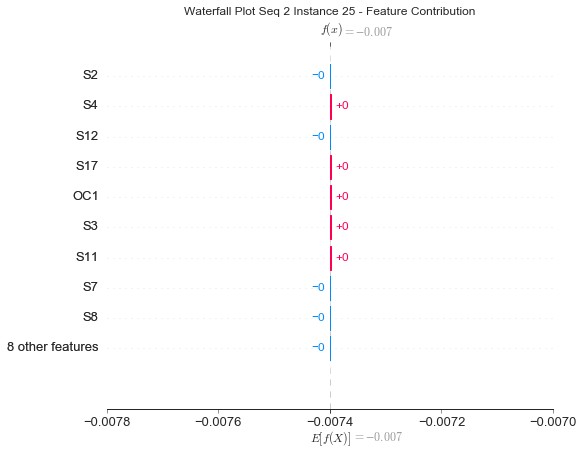

None

Contribution: [ 1.83212549e-21  3.21013579e-22  1.93710089e-21 -5.17461411e-21
  1.84602741e-21  3.35862410e-21 -7.75349346e-22 -1.27781078e-21
 -8.50047128e-22  1.81770920e-21 -1.65153163e-21 -3.69844650e-22
  2.92199810e-22  1.44167716e-21  1.86847398e-21 -6.57755959e-22
 -8.80224680e-22]


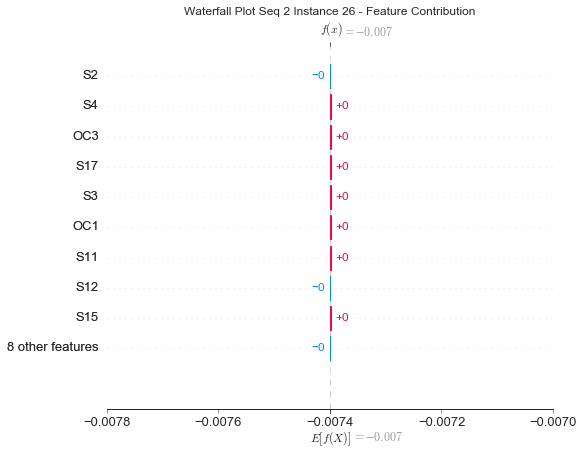

None

Contribution: [-3.49814116e-21 -2.28109534e-21 -1.44847918e-21  7.18393841e-21
 -9.30050377e-21 -1.58047219e-20  3.16684017e-21  9.34173678e-21
  2.27301942e-21 -1.43597876e-20  5.18496155e-21  6.53939306e-21
 -1.13362074e-21  2.18678120e-20 -9.87071959e-21  1.57120716e-21
  2.93801730e-21]


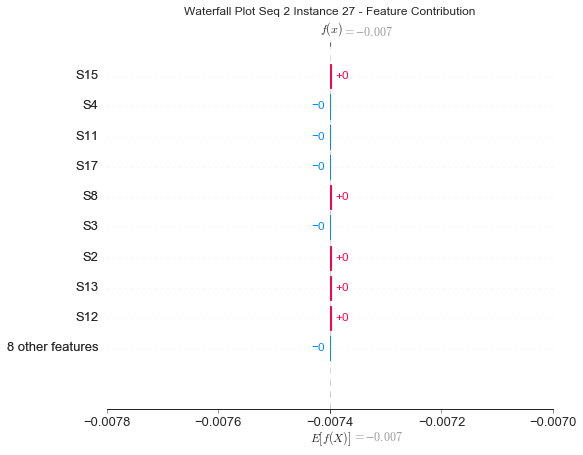

None

Contribution: [ 1.79311391e-21  3.42549002e-22  0.00000000e+00 -2.30118698e-21
  1.67924248e-21  3.51484552e-21 -2.01261747e-21 -9.20755722e-22
 -2.09864693e-22  2.01760034e-21 -2.11051357e-21 -1.55042032e-24
  3.44203742e-23 -1.31636808e-21  2.17692894e-21 -6.30886372e-22
 -1.76171134e-21]


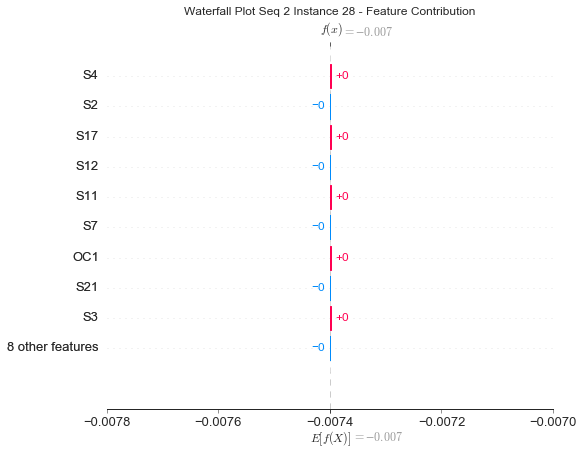

None

Contribution: [ 8.03897821e-21  2.84124949e-21  0.00000000e+00 -7.72094423e-21
  5.32714533e-21  1.09826095e-20 -4.62539406e-21 -2.95454960e-21
 -1.69900495e-21  4.79866295e-21 -7.42353160e-21 -7.05275728e-24
  1.45877825e-22 -7.24998281e-21  6.38338752e-21 -2.00390744e-21
 -4.29585346e-21]


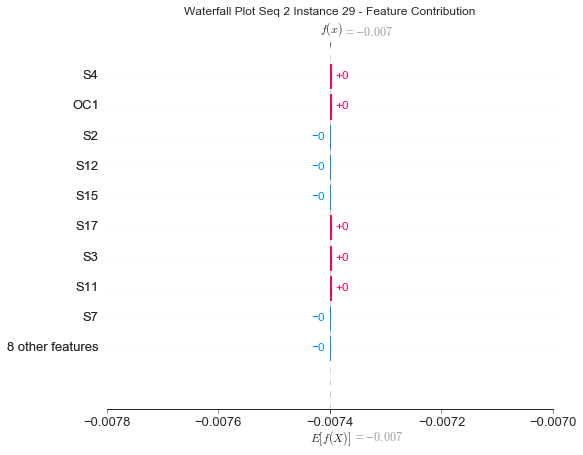

None

Contribution: [-6.11717834e-21 -7.32442078e-22  1.01140557e-22  1.01376865e-20
 -5.89671452e-21 -9.00293201e-21  3.76297103e-21  3.87760622e-21
  1.98580620e-21 -5.31444157e-21  6.45878293e-21  1.35380699e-22
  4.11548009e-23  1.88267842e-21 -6.70633572e-21  1.59179004e-21
  3.78128128e-21]


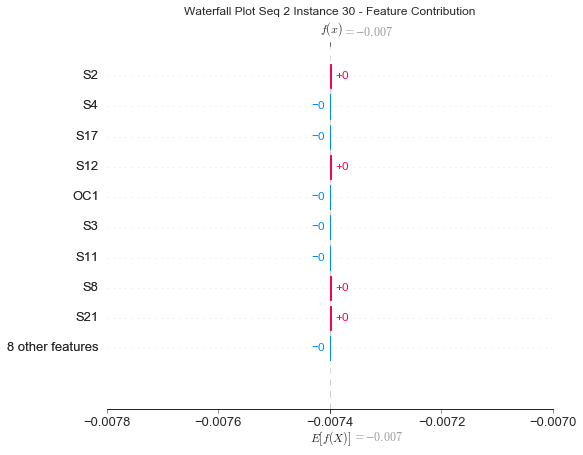

None

Contribution: [-3.58866104e-22  2.20385447e-22  0.00000000e+00  4.88804066e-22
 -2.38825784e-22 -1.06922959e-21  6.39298532e-22  2.38717287e-22
 -3.61745989e-23 -5.43720246e-22  3.28823706e-22  4.72266471e-25
 -1.98904058e-22  9.07639073e-22  3.09901672e-23  7.50557543e-23
  6.59955126e-22]


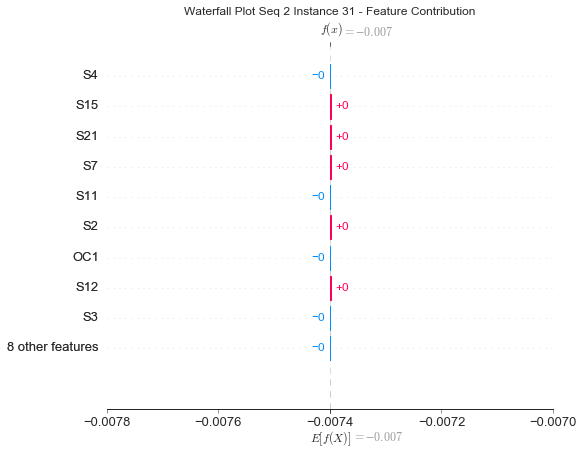

None

Contribution: [ 5.51368304e-21  7.66582615e-22  4.94994390e-22 -8.75457991e-21
  3.97333218e-21  7.14652545e-21 -3.22402630e-21 -2.85729772e-21
 -1.44740249e-21  3.48021864e-21 -5.26967163e-21  3.72759150e-23
 -1.07661414e-22 -1.90268025e-22  5.64393329e-21 -1.26827548e-21
 -3.35542443e-21]


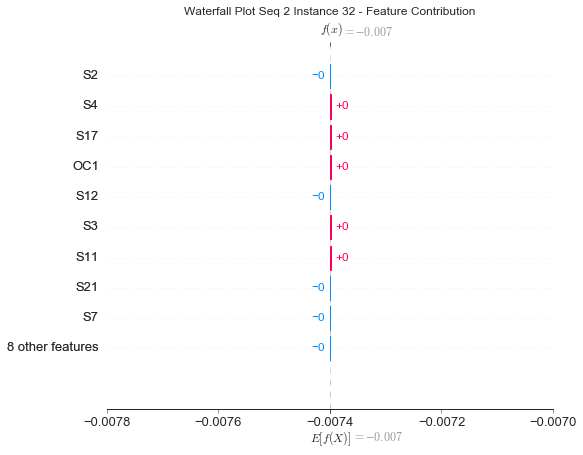

None

Contribution: [ 1.87535335e-21  6.85065440e-22  8.54070672e-23 -1.29129184e-21
  5.98787432e-22  1.54916277e-21 -4.33148806e-22 -7.64815731e-23
 -2.87908659e-22 -6.45801725e-22 -1.30391655e-21  1.79885580e-22
  3.00801530e-23 -1.92011673e-22  5.90335236e-22 -3.48051995e-22
 -4.89087198e-22]


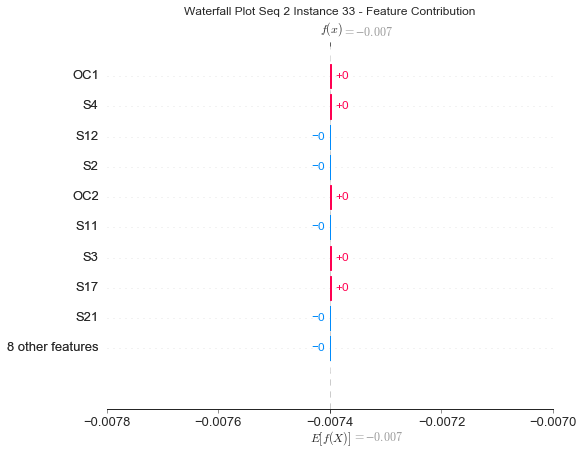

None

Contribution: [ 1.60168921e-20  5.99014311e-21  0.00000000e+00 -1.65209019e-20
  1.14193818e-20  2.46661801e-20 -9.64628627e-21 -5.74691041e-21
 -3.84474478e-21  1.27137676e-20 -1.67707622e-20 -7.73333440e-24
  4.47949907e-22 -1.46617699e-20  1.31231098e-20 -5.22127833e-21
 -8.38256109e-21]


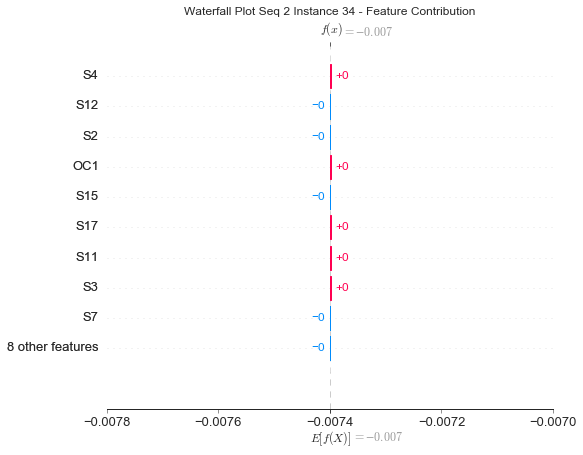

None

Contribution: [-9.56937382e-21 -9.64414804e-21  0.00000000e+00  7.33706618e-21
 -6.42044909e-21 -1.83097689e-20  8.17416004e-21  2.66851131e-21
  1.86254821e-21 -9.52619321e-21  1.23091963e-20  3.54886039e-24
 -1.15176742e-21  1.70771454e-20 -7.74509402e-21  3.90069337e-21
  5.63401762e-21]


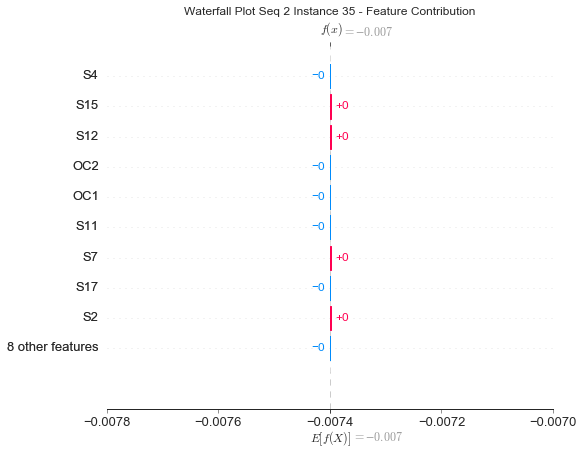

None

Contribution: [-1.08547786e-20 -6.14536832e-21 -3.72845199e-21  1.80439676e-20
 -1.89172151e-20 -3.66687518e-20  7.58545947e-21  1.68703227e-20
  5.13696447e-21 -2.88262330e-20  1.35716961e-20  1.04780648e-20
 -2.12120674e-21  4.34751202e-20 -2.10328911e-20  3.89738141e-21
  6.66476464e-21]


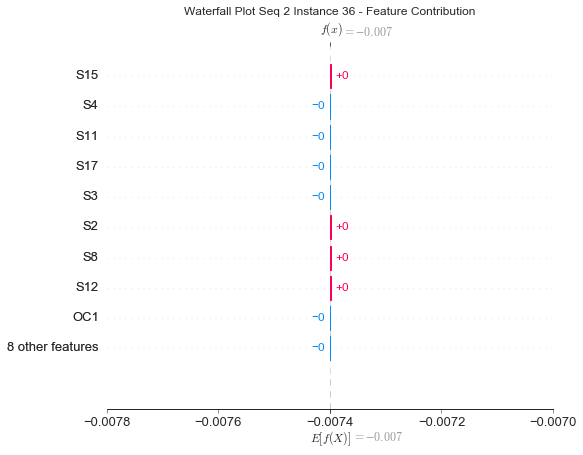

None

Contribution: [ 4.12671926e-21  2.11046752e-21  4.71963691e-21 -1.26440623e-20
  1.61325875e-20  2.83316145e-20 -5.43336938e-21 -1.73156464e-20
 -3.12801337e-21  2.81377085e-20 -8.22162114e-21 -1.22499649e-20
  2.68626843e-21 -4.23156456e-20  1.88519874e-20 -2.37149673e-21
 -4.84794038e-21]


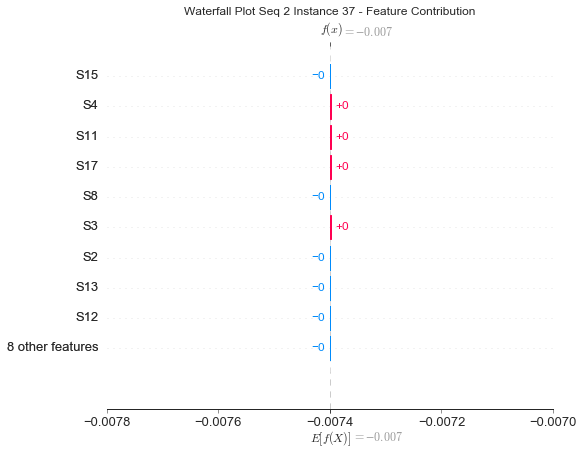

None

Contribution: [-5.56045611e-22 -7.76527475e-23  7.31745942e-21 -1.28917480e-20
  2.14684841e-20  3.17478026e-20 -6.04535257e-21 -2.31511633e-20
 -2.46125148e-21  3.87892390e-20 -8.01686890e-21 -1.63564093e-20
  3.56651684e-21 -5.33607040e-20  2.40493506e-20 -2.39189452e-21
 -5.02251991e-21]


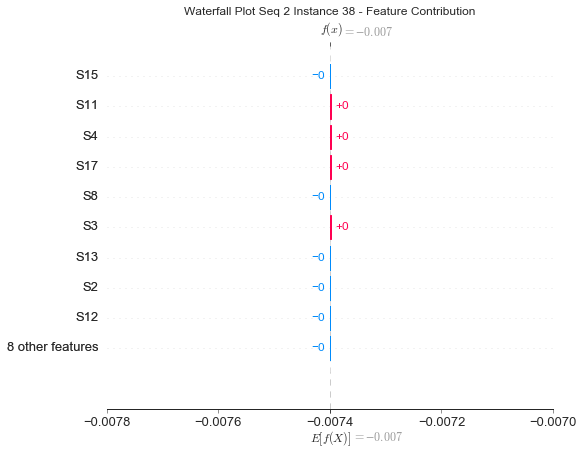

None

Contribution: [ 1.16829245e-20  4.81607373e-21  0.00000000e+00 -1.32824276e-20
  8.09649634e-21  2.05114280e-20 -8.73022978e-21 -4.89539259e-21
 -3.03433032e-21  1.02907642e-20 -1.41286181e-20  1.71783396e-24
  5.14356798e-22 -1.23026629e-20  1.06718044e-20 -3.80114735e-21
 -7.51458124e-21]


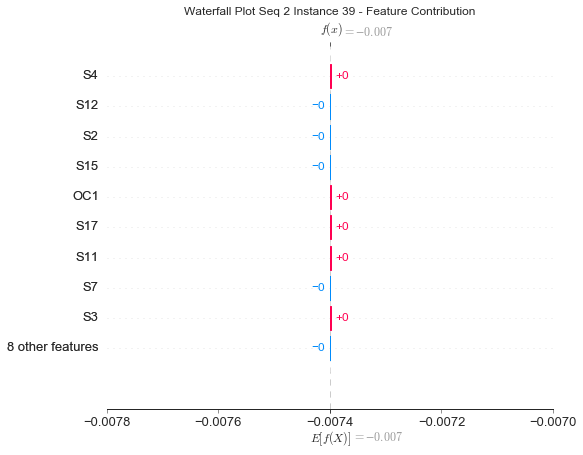

None

Contribution: [ 5.93942054e-21  7.11976628e-22 -3.09222418e-22 -2.85553350e-21
 -5.70047753e-22  2.67187290e-22 -9.54475853e-22  3.63971814e-22
 -5.75404383e-22 -3.22463700e-21 -2.64756018e-21  9.29890656e-22
 -1.93142445e-22  4.88865156e-22  7.75586837e-22 -4.40598278e-22
 -2.14056430e-21]


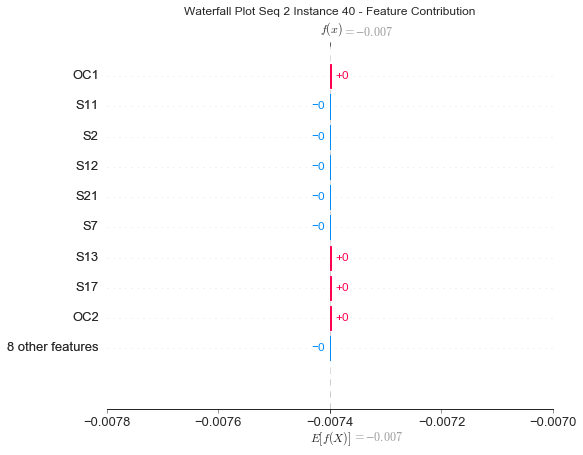

None

Contribution: [-6.29245137e-21  2.00378707e-21 -2.59942255e-21  2.05319783e-20
 -1.77161909e-20 -2.38982463e-20  5.87221495e-21  1.56865610e-20
  3.63887536e-21 -2.18908729e-20  9.35836441e-21  7.67437089e-21
 -4.79105141e-22  1.65196337e-20 -1.87742033e-20  2.17394778e-21
  6.18186888e-21]


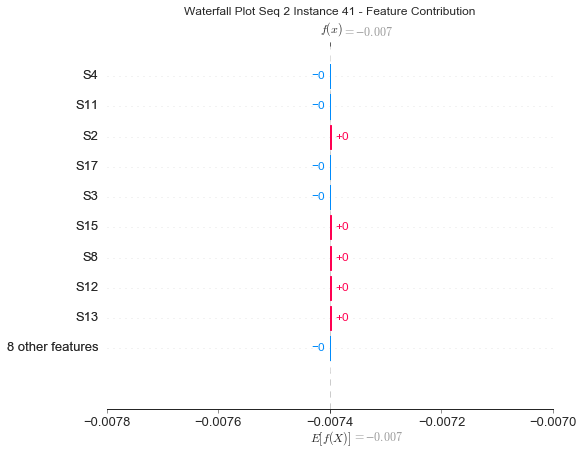

None

Contribution: [ 1.85225740e-20  7.41589553e-21  5.18664913e-22 -1.93905159e-20
  1.31437497e-20  2.69233605e-20 -1.35187557e-20 -5.57596756e-21
 -3.43564298e-21  1.06669044e-20 -2.03425491e-20  3.88472975e-22
  9.67555041e-22 -1.53939491e-20  1.40312822e-20 -6.02626441e-21
 -1.12893206e-20]


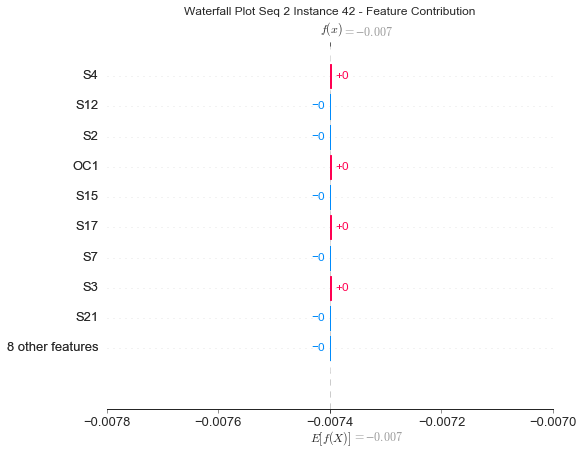

None

Contribution: [-1.48569377e-20 -1.22494018e-20 -4.12117042e-22  1.53790534e-20
 -1.22280058e-20 -3.33714774e-20  1.27929766e-20  6.97992368e-21
  3.59341637e-21 -1.92858905e-20  2.00303659e-20  1.43627908e-21
 -1.12586552e-21  2.56406926e-20 -1.54298346e-20  6.24189400e-21
  8.98532291e-21]


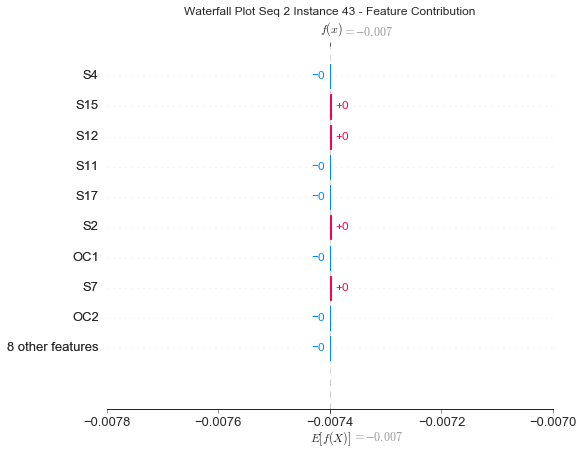

None

Contribution: [-2.50795204e-21 -1.09032906e-21  1.18892988e-20 -2.07620023e-20
  3.10596433e-20  4.52623925e-20 -7.19258746e-21 -3.42297483e-20
 -4.34907413e-21  5.45942112e-20 -1.15101439e-20 -2.47099496e-20
  3.99210167e-21 -7.15649783e-20  3.22026615e-20 -3.48815158e-21
 -5.58197431e-21]


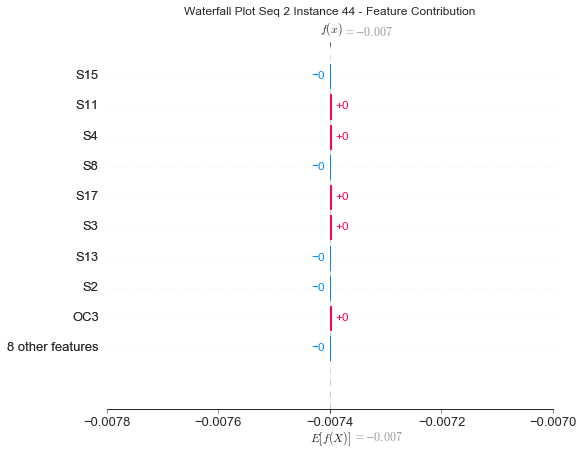

None

Contribution: [ 8.04771773e-21  2.74359492e-21  1.34539610e-20 -3.44500950e-20
  4.36392380e-20  6.57459177e-20 -1.51382243e-20 -4.16855246e-20
 -6.95121066e-21  6.39701161e-20 -2.18243882e-20 -2.89148447e-20
  6.31945914e-21 -9.22085435e-20  4.64359486e-20 -6.04194449e-21
 -1.21697453e-20]


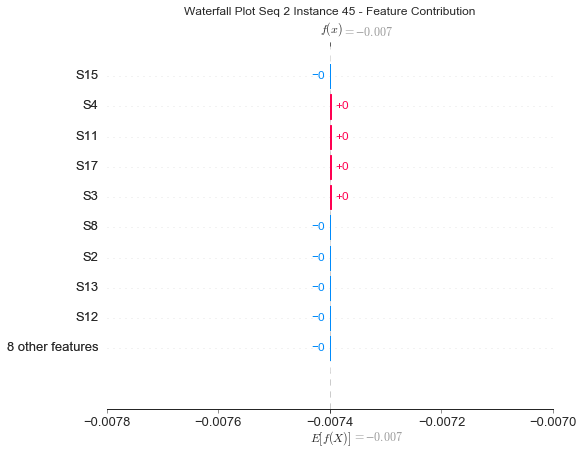

None

Contribution: [-1.72740515e-20 -7.11341884e-21  1.28829770e-20 -4.30506352e-21
  2.11643659e-20  1.97144540e-20 -1.72437332e-22 -2.66036746e-20
  1.86553310e-22  4.40052396e-20  5.01386360e-22 -2.14313320e-20
  5.55889040e-21 -5.38800959e-20  2.13097769e-20 -5.99095050e-22
  1.31077118e-21]


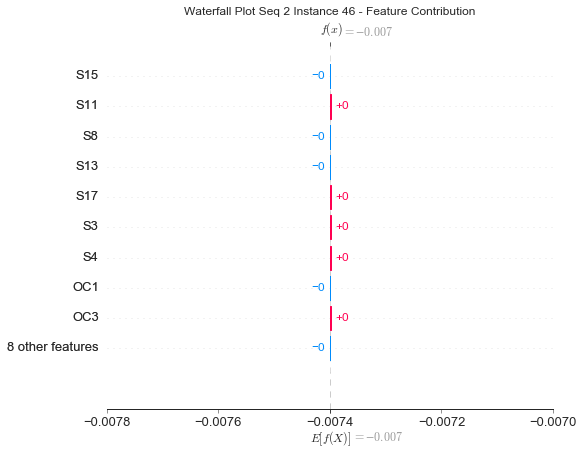

None

Contribution: [-2.57288552e-20 -1.27456157e-20  0.00000000e+00  2.69578792e-20
 -2.05590523e-20 -4.33650276e-20  2.12662174e-20  1.02121755e-20
  5.70103501e-21 -2.43025599e-20  3.10751400e-20 -6.65650929e-24
 -1.33726348e-21  2.37257727e-20 -2.49756507e-20  8.51757651e-21
  1.84872169e-20]


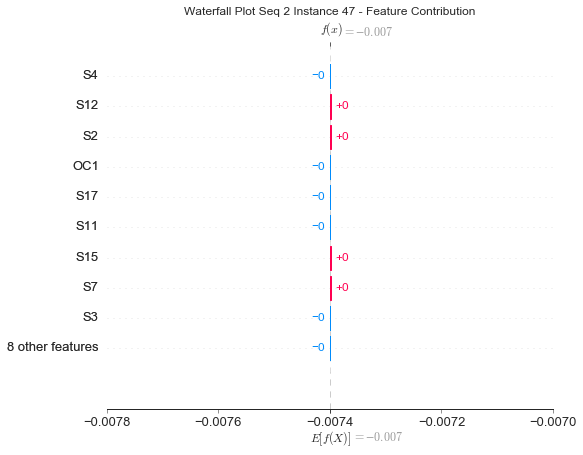

None

Contribution: [ 1.43080064e-20  5.41962396e-21  0.00000000e+00 -1.57859568e-20
  1.21990383e-20  2.32252493e-20 -1.20314373e-20 -5.72042407e-21
 -2.18771783e-21  1.10997945e-20 -1.63570281e-20 -1.84399471e-23
  7.10247950e-22 -1.23932133e-20  1.27863301e-20 -4.87823183e-21
 -1.00975803e-20]


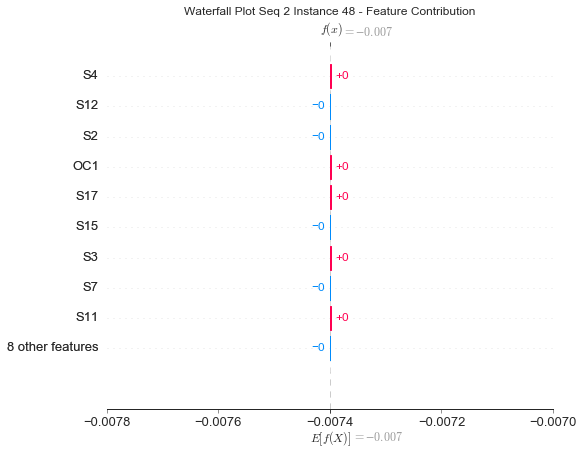

None

Contribution: [ 2.75412855e-20  6.22188374e-21  0.00000000e+00 -3.46263944e-20
  2.29317633e-20  4.06138863e-20 -1.92371450e-20 -1.27389037e-20
 -6.87337894e-21  2.07921282e-20 -2.92655693e-20 -1.73535294e-23
  5.72604470e-22 -1.98018654e-20  2.55951282e-20 -8.25850096e-21
 -1.91899197e-20]


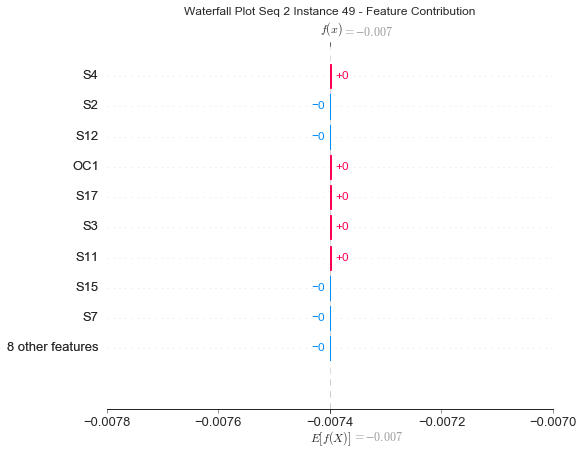

None

Contribution: [-2.49083583e-20 -1.80246129e-20 -6.87609475e-21  3.17254946e-20
 -3.19911326e-20 -6.51531718e-20  2.70691996e-20  1.76881071e-20
  4.86888242e-21 -4.30666125e-20  3.65862890e-20  1.03787919e-20
 -5.73790149e-21  5.38105804e-20 -3.31223086e-20  1.08588288e-20
  2.05422518e-20]


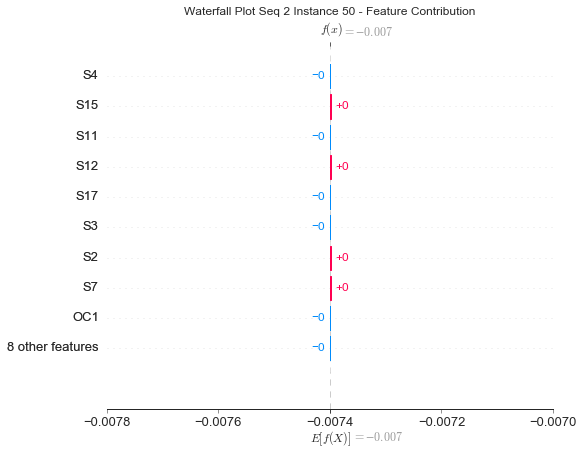

None

Contribution: [ 9.70499186e-21  9.61289087e-22  0.00000000e+00 -1.47899683e-20
  1.00653276e-20  1.35069353e-20 -6.10817104e-21 -5.64287508e-21
 -2.79465353e-21  7.21493911e-21 -9.42815454e-21 -8.21751672e-24
 -2.19357883e-22 -4.13535497e-21  1.02434153e-20 -2.12077376e-21
 -6.77871604e-21]


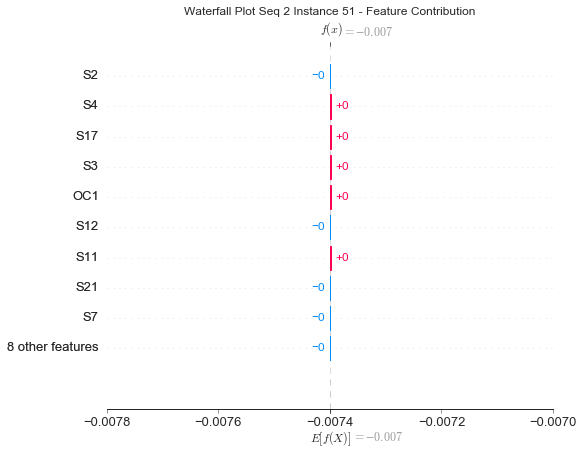

None

Contribution: [ 1.21205555e-20  2.91386084e-21  0.00000000e+00 -1.03567100e-20
  7.20667295e-21  1.30925897e-20 -5.28787000e-21 -4.07697695e-21
 -2.59292991e-21  4.43417963e-21 -9.23210304e-21 -1.32045368e-23
  5.08584810e-22 -1.10951747e-20  8.86303508e-21 -1.77964859e-21
 -6.78108287e-21]


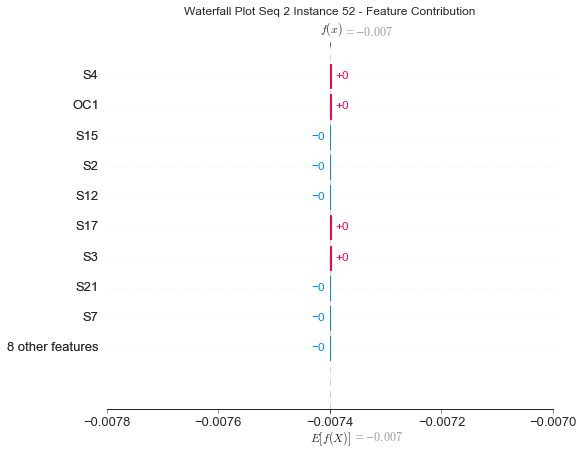

None

Contribution: [ 1.09290511e-20  4.45771227e-21 -4.11089701e-21 -1.86341194e-21
 -8.34803033e-21 -8.31536962e-21 -1.99729039e-21  9.31008178e-21
 -1.00559222e-21 -1.86841909e-20 -3.20172595e-21  5.43211124e-21
 -1.64512522e-21  1.55180278e-20 -8.11233071e-21 -1.30881301e-22
 -2.30769396e-21]


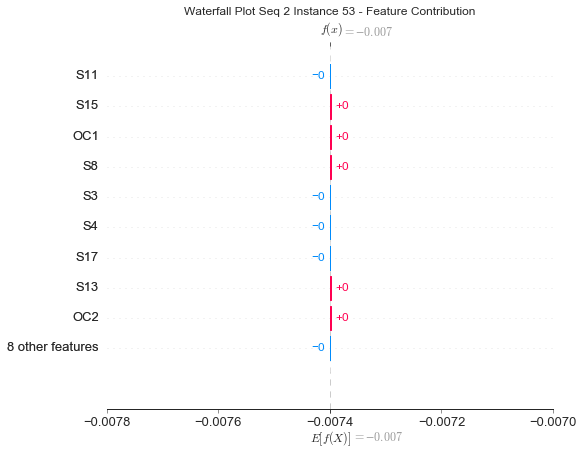

None

Contribution: [ 4.45048009e-21  1.80537480e-21 -6.44152715e-22 -4.01225693e-21
  6.48401608e-22  3.73242512e-21 -2.44776375e-21 -2.37600083e-22
 -1.23114162e-21 -9.72531768e-23 -3.75109363e-21  1.01332240e-21
  1.64837510e-22 -2.15016593e-21  9.19544436e-22 -1.05483784e-21
 -2.49705188e-21]


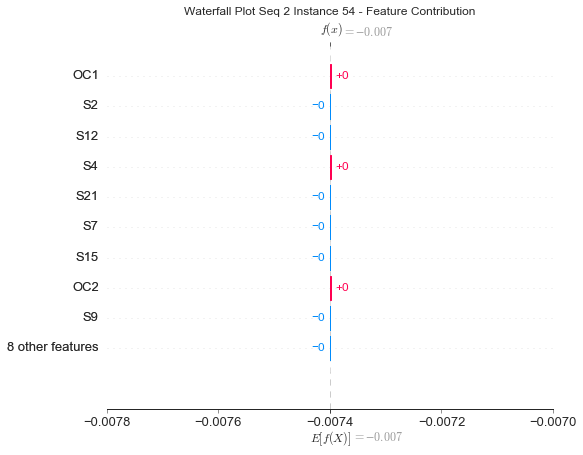

None

Contribution: [-3.00268598e-20 -2.75399122e-20  0.00000000e+00  2.74231925e-20
 -2.44878387e-20 -5.45777064e-20  3.01239986e-20  7.65758817e-21
  1.69645555e-21 -2.55635370e-20  3.61442773e-20  1.06469306e-23
 -3.17507240e-21  2.66685001e-20 -2.25935208e-20  1.19575993e-20
  2.21278246e-20]


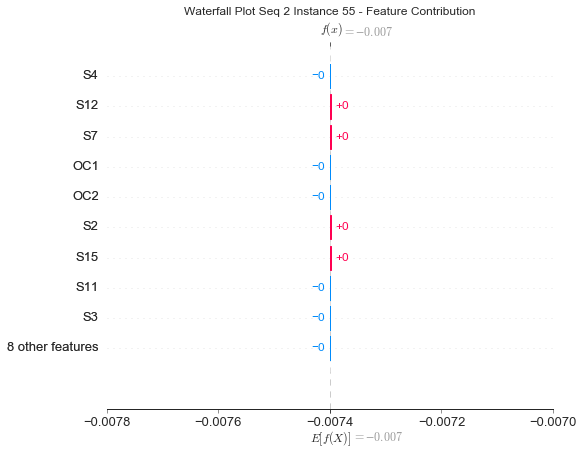

None

Contribution: [-2.79707344e-20 -2.09486269e-20  2.15112810e-20 -2.04286615e-20
  3.44960973e-20  4.53701199e-20 -1.49956924e-20 -2.66508207e-20
  3.26022505e-22  4.90329726e-20 -1.51284225e-20 -3.03182891e-20
  1.15406656e-20  1.60628555e-20  2.75383612e-20 -4.17657345e-21
 -1.31176523e-20]


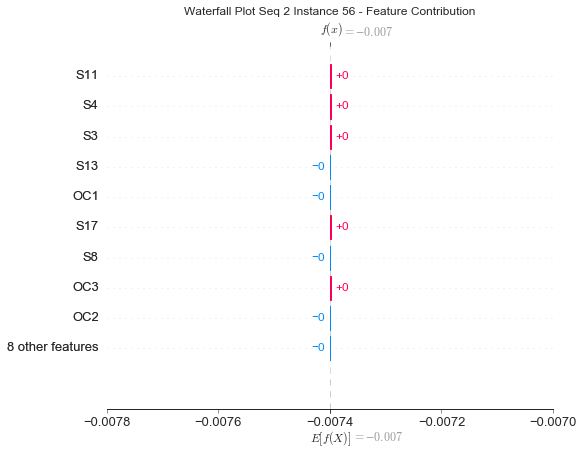

None

Contribution: [-1.31734102e-20  4.30666254e-21  3.02538950e-20 -3.39400509e-20
  2.84187076e-20  5.53894743e-20 -1.09937433e-20 -3.19224767e-20
 -9.87869413e-21  4.10012621e-20 -1.87291074e-20 -5.13702586e-20
  1.17896841e-20  1.32406510e-20  2.43787720e-20 -6.06891026e-21
 -1.23554910e-20]


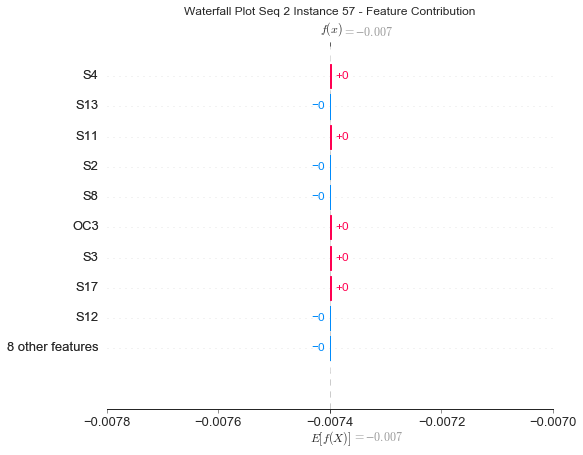

None

Contribution: [-2.11356553e-20 -7.39547693e-21  3.62277256e-20 -9.05149171e-21
  2.51974514e-20  2.02606259e-20 -1.71465639e-20 -1.17930736e-20
  8.10150870e-21  2.16336278e-20 -8.46138962e-21 -4.26052396e-20
  1.12511685e-20  6.78919898e-22  5.42787678e-21 -3.87392753e-21
 -1.12923854e-20]


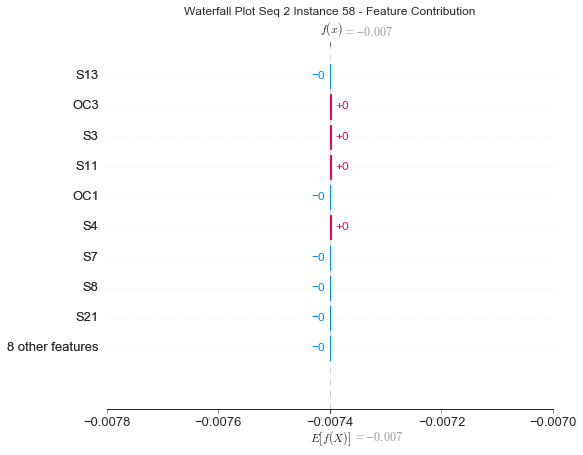

None

Contribution: [ 3.74537882e-20  4.87349097e-20  4.18258125e-20 -5.10989499e-20
  2.89869936e-20  6.32477806e-20 -2.26959102e-20 -2.73542392e-20
 -1.23193059e-20  2.56662059e-20 -3.52992056e-20 -6.56000949e-20
  1.58702000e-20 -8.93231631e-21  1.90093876e-20 -1.35650900e-20
 -2.13688411e-20]


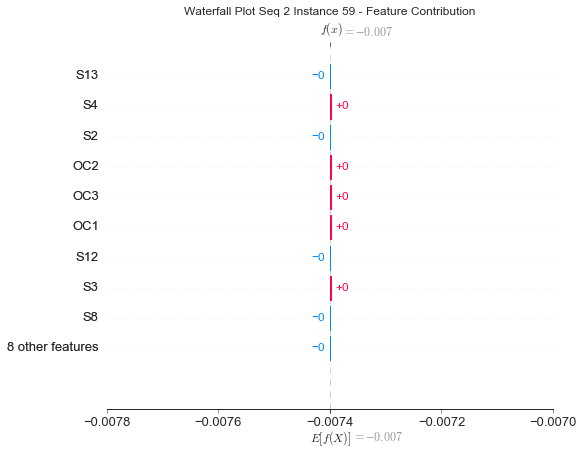

None

Contribution: [ 7.35041804e-20  8.29566059e-20  5.09588978e-20 -5.02655105e-20
  2.06112697e-20  5.07481639e-20 -2.61015259e-20 -1.29972830e-20
 -8.51281295e-21  5.09611072e-21 -3.81599452e-20 -6.27875709e-20
  2.10188726e-20 -2.90747911e-20  1.30777707e-20 -1.59616325e-20
 -2.18906370e-20]


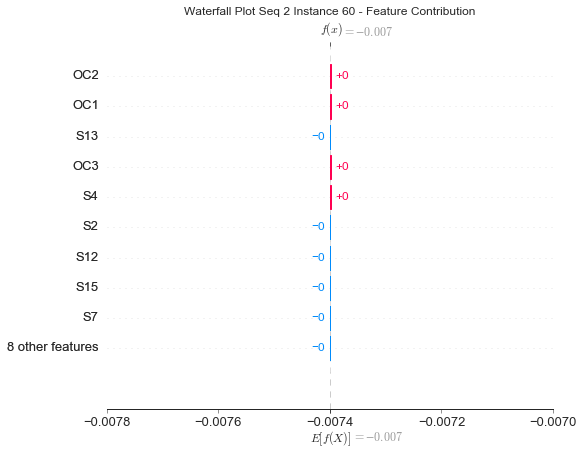

None

Contribution: [ 4.25787149e-20  7.62690122e-20  3.72215960e-20 -5.27495048e-20
  3.23395469e-20  5.29731828e-20 -2.43257129e-20 -5.78815433e-20
 -1.37072358e-20  5.86505628e-20 -2.54470984e-20 -7.10428593e-20
  7.34743421e-21 -1.15170037e-19  2.98809755e-20 -1.45325633e-20
 -1.93322740e-20]


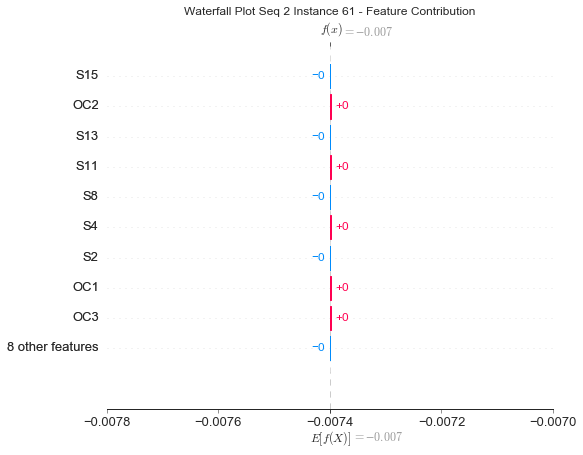

None

Contribution: [ 9.27179188e-20  9.95447373e-20  6.05453751e-20  1.37284307e-20
 -3.21745341e-20 -6.35599508e-20 -2.23818595e-20  8.21053208e-20
  2.41742710e-20 -1.09676252e-19 -4.44542977e-21  4.36719294e-21
  2.66446136e-20 -1.86165543e-20 -6.06810844e-20 -4.17541225e-21
 -8.54170288e-21]


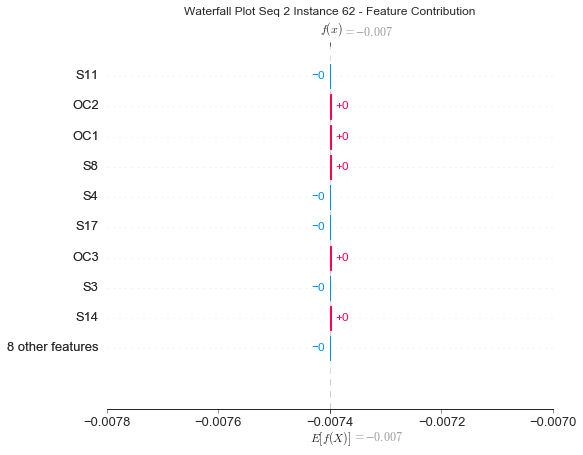

None

Contribution: [ 1.33846638e-19  1.46520712e-19  5.14524306e-20  4.06798830e-20
 -6.31110244e-20 -1.07063893e-19 -1.87546822e-20  1.25164214e-19
  3.50571131e-20 -1.63725513e-19  5.07807471e-21  4.32314541e-20
  2.35183959e-20 -5.09672504e-20 -8.80112158e-20 -3.85041589e-21
 -2.74924382e-21]


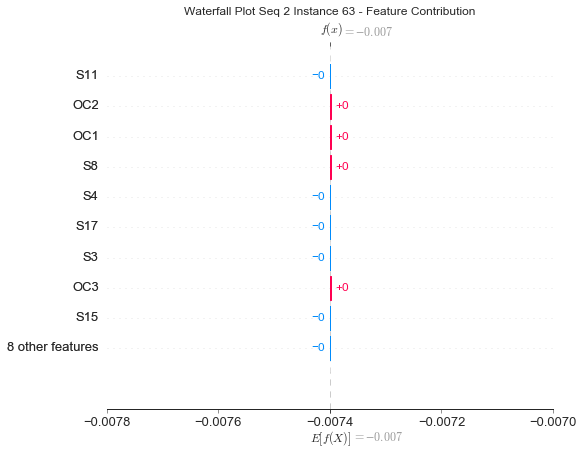

None

Contribution: [ 1.47912754e-19  2.03251951e-19  6.64700304e-20  1.38836708e-19
 -7.63195672e-20 -1.76846665e-19 -1.99070676e-20  1.76844610e-19
  8.23283687e-20 -1.92607183e-19  3.43714289e-20  5.69234678e-20
  2.74019701e-20 -1.83519105e-19 -1.40663188e-19  6.34356693e-21
  1.19107489e-20]


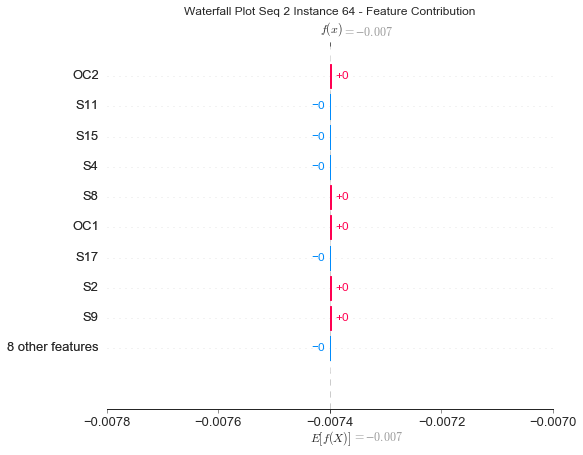

None

Contribution: [ 3.00531674e-19  2.89075843e-19  6.80325035e-20  2.34037539e-20
 -8.69377034e-20 -1.32873589e-19 -1.72790760e-21  1.44921268e-19
  2.26515284e-20 -2.24826605e-19 -6.33220340e-22  3.22668843e-20
  3.75729506e-20 -1.63612797e-19 -1.17728429e-19 -1.63491794e-21
 -6.99194456e-22]


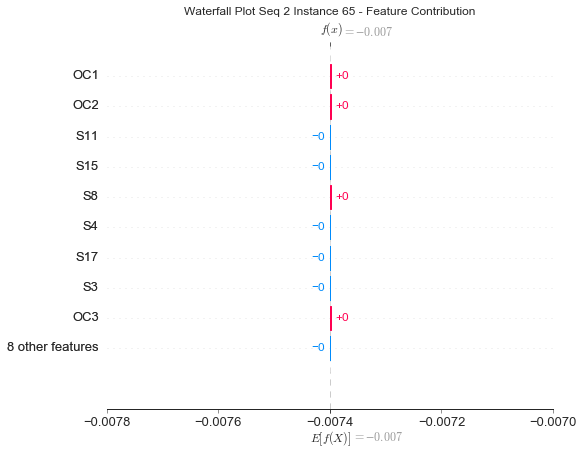

None

Contribution: [ 4.35696553e-19  3.74777027e-19  9.11907430e-20  7.94073355e-21
 -9.50174938e-20 -1.48477640e-19 -2.96681122e-20  1.85964587e-19
  2.94426538e-20 -2.74005025e-19 -1.86375085e-20  7.68411821e-20
  5.38077370e-20 -2.19584270e-19 -1.23970256e-19 -1.06143994e-20
 -2.19404601e-20]


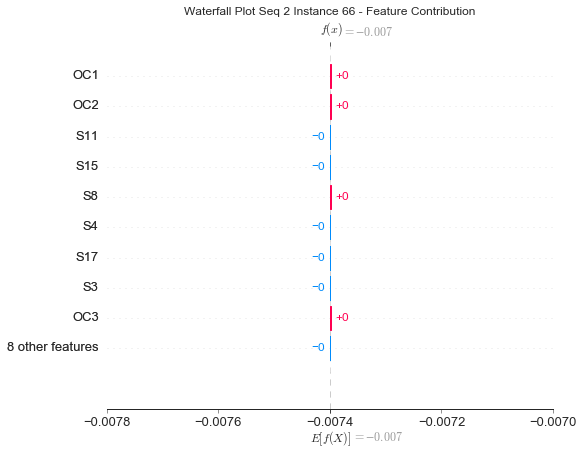

None

Contribution: [ 7.42142633e-20  9.28123983e-20  9.17614266e-20  4.29943900e-19
 -3.26148242e-19 -8.67116789e-19  1.69142628e-19  4.62533446e-19
  1.99932475e-19 -6.55114379e-19  3.15299769e-19  2.86468931e-19
  2.37345389e-20 -8.86898723e-20 -4.53741912e-19  1.24647821e-19
  1.82656252e-19]


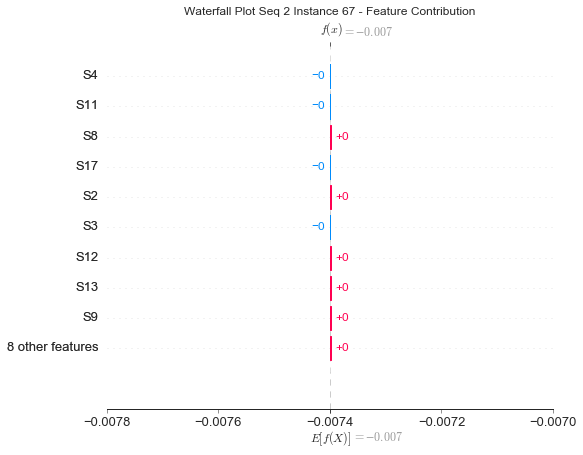

None

Contribution: [ 2.52956510e-19  2.77153559e-19  7.05231443e-20  3.56566362e-19
 -3.40074267e-19 -7.46112518e-19  1.35286811e-19  4.83774100e-19
  1.60743243e-19 -6.55062835e-19  2.19134258e-19  3.07214621e-19
  3.11420899e-20 -2.19735825e-19 -4.25171145e-19  9.00901534e-20
  1.53514524e-19]


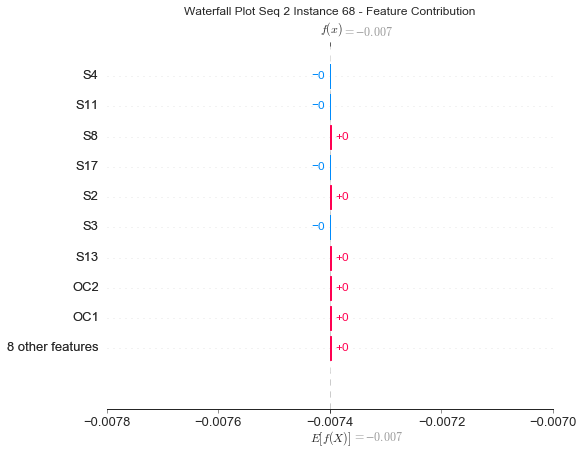

None

Contribution: [ 4.42265453e-19  4.89510959e-19  3.05082531e-20  3.88726369e-19
 -3.45503442e-19 -6.71693250e-19  8.96713156e-20  5.33549021e-19
  1.67530957e-19 -6.65485983e-19  1.67869171e-19  3.43139876e-19
  3.22766715e-20 -4.80957498e-19 -4.25493151e-19  6.69553592e-20
  1.27276807e-19]


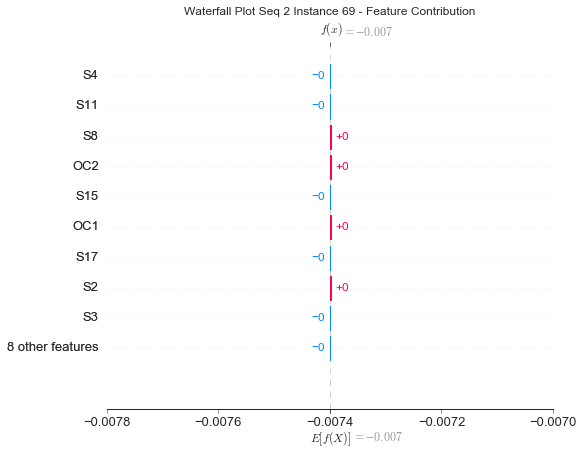

None

Contribution: [ 4.44066949e-19  4.29709885e-19  8.19941425e-20  2.33702899e-19
 -2.31433865e-19 -5.66432397e-19  4.98209138e-20  3.11273803e-19
  1.38175610e-19 -4.63902533e-19  1.62434736e-19  1.65293162e-19
  2.45586208e-20 -7.35236696e-19 -3.17705520e-19  5.64395542e-20
  9.47969403e-20]


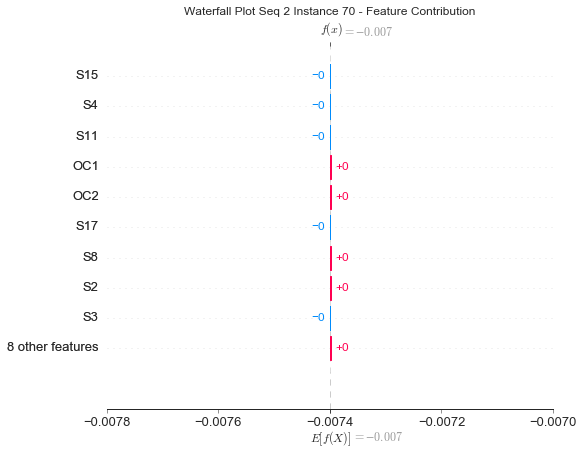

None

Contribution: [ 8.81179687e-19  6.79948305e-19 -1.43062890e-20  1.35041616e-19
 -3.17922939e-19 -5.01330233e-19  6.59435210e-21  5.16565659e-19
  7.35272381e-20 -7.51904023e-19  3.46431092e-20  3.92107676e-19
  2.97021656e-20 -4.65213459e-19 -3.59237974e-19  1.14843842e-20
  2.67530195e-20]


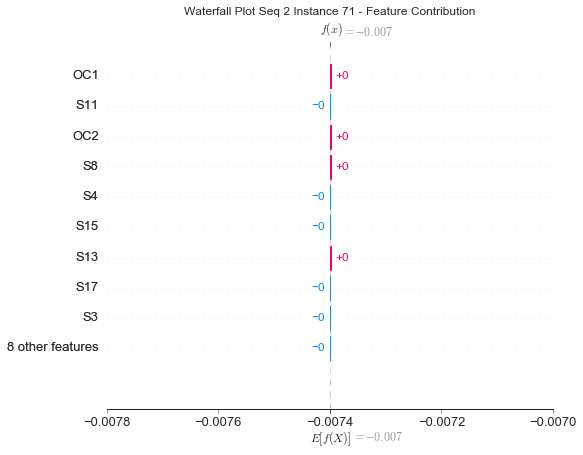

None

Contribution: [ 4.77186278e-19  4.17510160e-19 -5.05179492e-20  5.43475240e-19
 -5.68748503e-19 -1.19030194e-18  2.40179077e-19  7.56643251e-19
  2.15690705e-19 -1.07564499e-18  3.70135717e-19  5.89985021e-19
 -2.73548402e-20 -3.81422907e-19 -6.69265371e-19  1.48853995e-19
  2.65315364e-19]


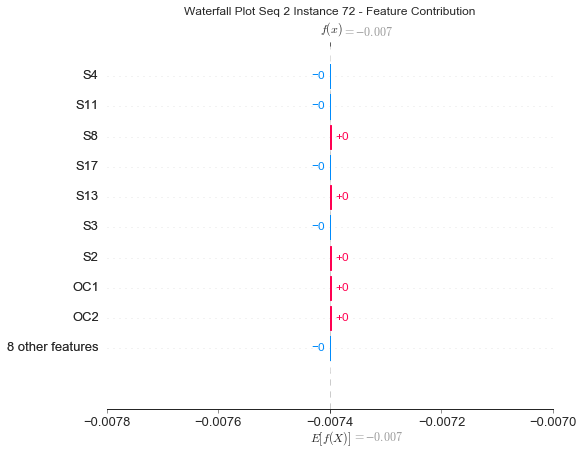

None

Contribution: [ 5.88916459e-19  5.54037302e-19 -9.79229851e-20  6.99226473e-19
 -6.64711949e-19 -1.28126668e-18  2.67378843e-19  9.01638241e-19
  2.47755612e-19 -1.20018127e-18  3.67543126e-19  7.13282133e-19
 -2.32708977e-20 -5.39891118e-19 -7.46840282e-19  1.50082836e-19
  2.92590869e-19]


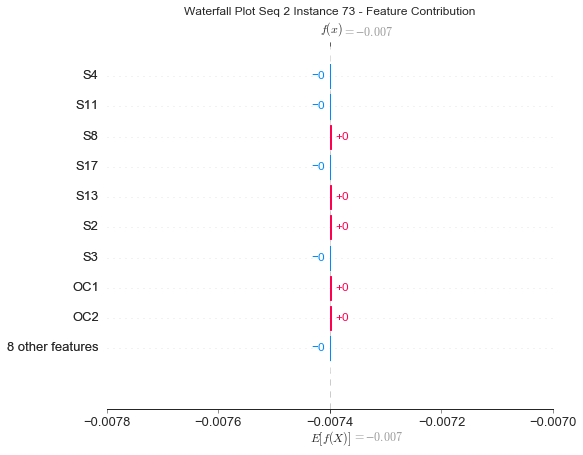

None

Contribution: [ 9.93806738e-19  7.46976508e-19 -1.32594842e-19  2.59792537e-19
 -4.43112434e-19 -7.23716965e-19  4.91942017e-20  7.00862120e-19
  1.26898359e-19 -9.68016487e-19  1.12047262e-19  6.45171203e-19
  4.25148742e-21 -6.21844348e-19 -4.86055671e-19  4.18896476e-20
  9.26432399e-20]


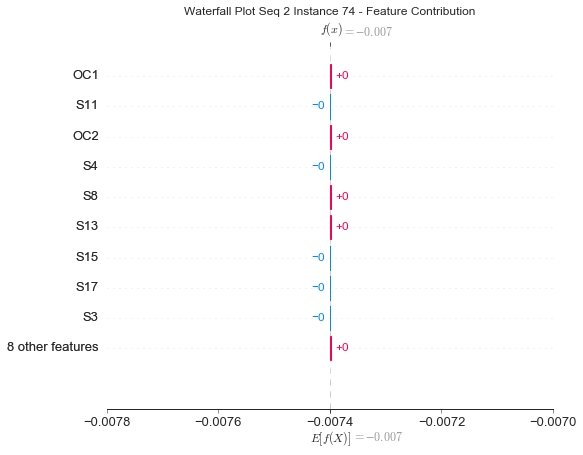

None

Contribution: [ 4.43668351e-19  2.62120017e-19 -1.87520798e-19  9.09935277e-19
 -8.63845548e-19 -1.90081142e-18  4.66161615e-19  1.04225047e-18
  3.26197382e-19 -1.51924799e-18  7.04868104e-19  9.17476889e-19
 -8.42264833e-20 -3.72146205e-19 -1.00544248e-18  2.95752483e-19
  4.51150975e-19]


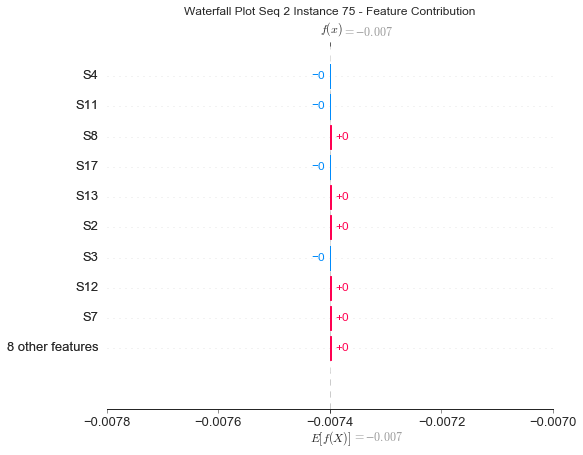

None

Contribution: [ 4.38604972e-19  4.19658529e-19 -2.79608192e-19  1.02442317e-18
 -9.26835404e-19 -1.78832168e-18  5.04856969e-19  1.08979598e-18
  2.97445411e-19 -1.53065171e-18  6.42014526e-19  9.76485369e-19
 -1.18074384e-19 -5.73941491e-19 -9.84243186e-19  2.60914220e-19
  4.82035573e-19]


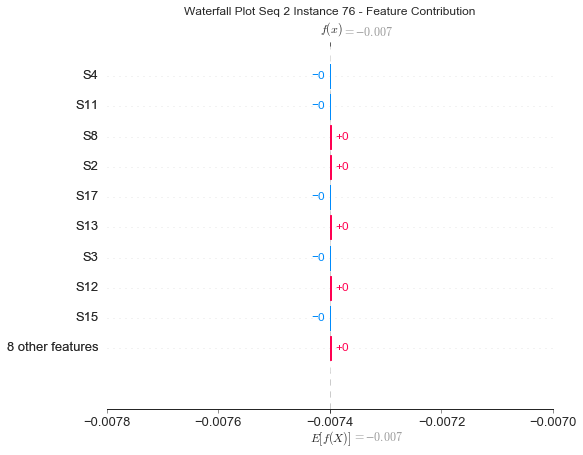

None

Contribution: [ 1.10651185e-18  8.65549075e-19 -3.34887457e-19  3.12116959e-19
 -6.32303323e-19 -7.99678046e-19  2.08037488e-19  7.56789869e-19
  1.14067891e-20 -1.11115844e-18  9.39527056e-20  8.21107659e-19
 -8.17804068e-20 -6.78671087e-19 -5.15129311e-19  2.53850227e-20
  1.64728224e-19]


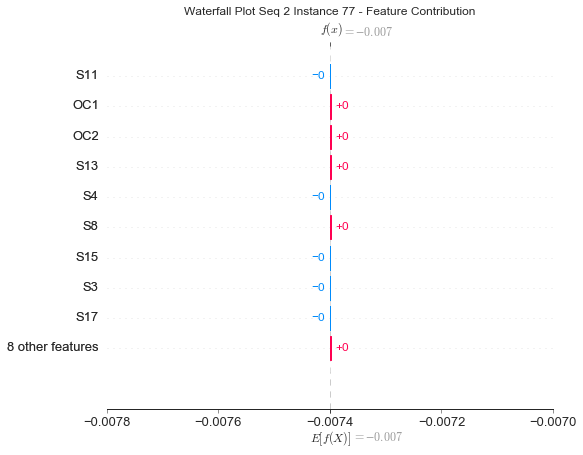

None

Contribution: [ 3.54288384e-19  1.47795914e-19 -1.12605286e-19  9.70089815e-19
 -9.20323114e-19 -1.95977575e-18  5.13319233e-19  1.15772343e-18
  3.73007585e-19 -1.60927120e-18  6.78748532e-19  9.56777067e-19
 -7.60418025e-20 -2.89794818e-19 -1.03807227e-18  2.94043579e-19
  5.15548692e-19]


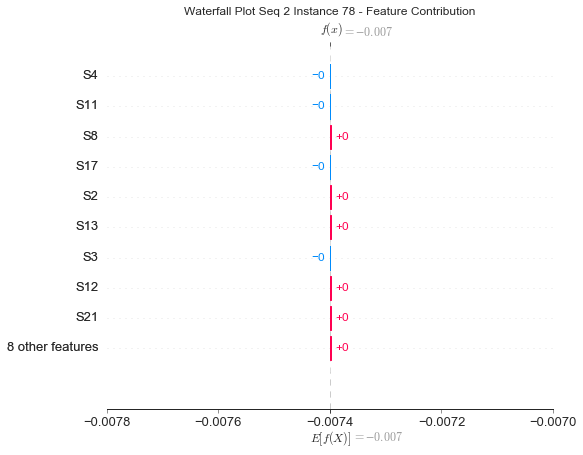

None

Contribution: [ 6.14381783e-19  1.87367097e-19 -5.44944261e-19  7.45782111e-19
 -7.68661410e-19 -1.54330458e-18  3.41771254e-19  9.53301564e-19
  2.51221421e-19 -1.39789522e-18  5.72930314e-19  1.12887055e-18
 -1.70054298e-19 -4.15070882e-19 -8.03290137e-19  2.45944655e-19
  3.28445814e-19]


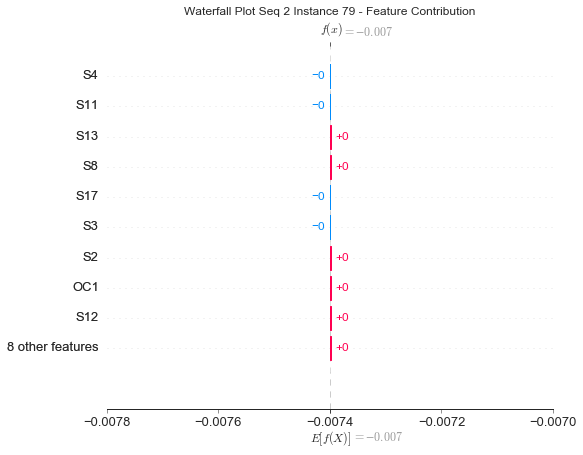

None

Contribution: [ 6.33044218e-19  4.00770687e-19 -7.54499561e-19  6.52139579e-19
 -7.07808421e-19 -9.43554999e-19  2.33679143e-19  8.72514970e-19
  1.18035365e-19 -1.05884567e-18  2.61767896e-19  1.16231883e-18
 -1.84848048e-19 -6.81945740e-19 -5.78414625e-19  1.10708897e-19
  2.66174132e-19]


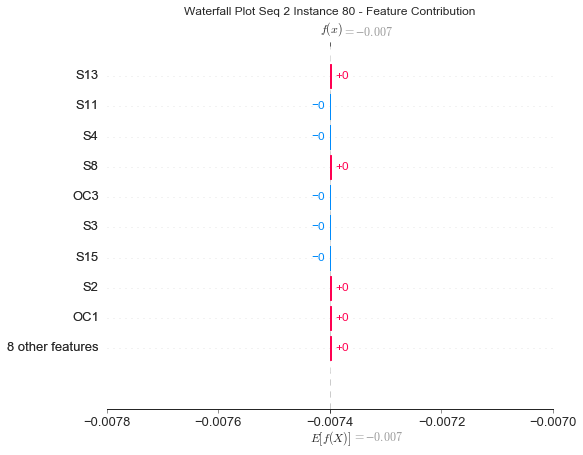

None

Contribution: [ 8.16871512e-19  6.59683311e-19 -8.34068494e-19 -1.65987167e-19
 -1.45148277e-19  5.71449920e-19  6.78750031e-20 -1.59571438e-19
 -3.40432359e-19  1.75592634e-19 -2.99074052e-19  4.55454176e-19
 -2.78247299e-19 -1.37886914e-18  2.96774774e-19 -1.57767396e-19
 -2.06322901e-20]


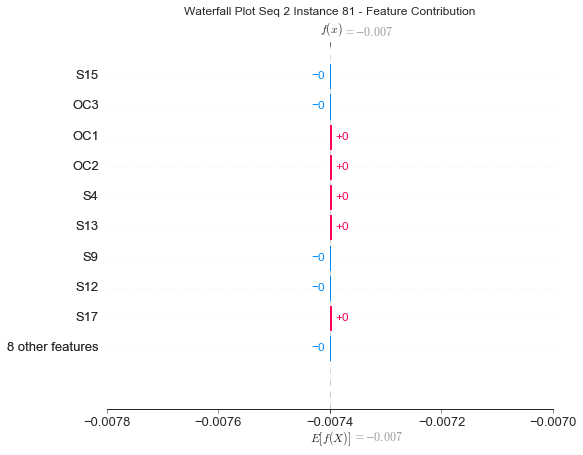

None

Contribution: [ 1.19010910e-18  5.78246087e-19 -1.00077025e-18 -5.09315834e-19
 -1.34603366e-19  9.25019535e-19 -1.12833109e-19 -8.41168754e-20
 -4.57019822e-19  8.50405518e-20 -5.64216587e-19  6.87213588e-19
 -2.94640002e-19 -5.02518219e-19  4.21250645e-19 -2.71932266e-19
 -2.33517223e-19]


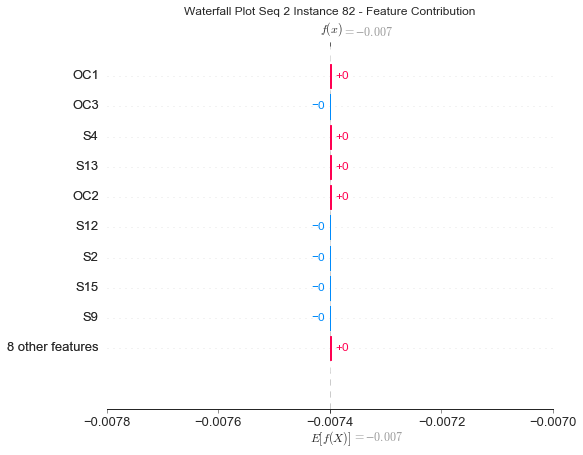

None

Contribution: [-3.58162898e-19 -7.82923710e-19 -9.41955231e-19  2.01222508e-20
  1.03278708e-19  3.52654444e-19  1.24361810e-19 -5.04816282e-19
 -1.87845634e-19  5.66350558e-19  3.43296918e-20  4.79874719e-19
 -3.86423420e-19 -8.22411399e-19  4.03563843e-19 -2.41555863e-21
  5.00205648e-20]


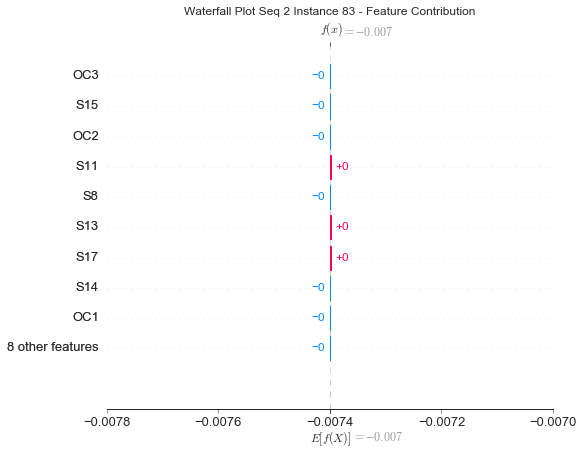

None

Contribution: [-2.61959854e-19 -1.21015800e-18 -7.43673835e-19  1.20078139e-19
 -3.23752495e-19 -1.61397646e-19  1.11843569e-19  5.23679929e-19
 -2.34752161e-20 -6.14852138e-19  3.45405905e-20  9.41279735e-19
 -2.50266441e-19  1.76199148e-18 -1.44572391e-19  3.93697517e-20
  1.98531974e-20]


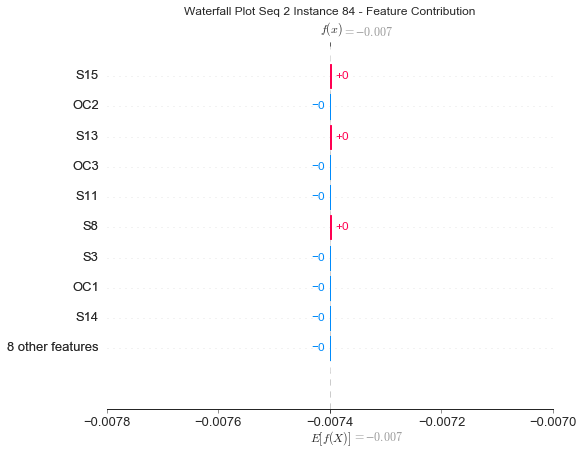

None

Contribution: [-4.86780436e-19 -1.19446483e-18 -9.13581385e-19 -9.94575731e-20
 -3.54954419e-19  2.34766085e-19  3.29677951e-19  2.86398466e-19
 -3.56401753e-19 -3.18405703e-19 -2.30323453e-19  8.59554859e-19
 -3.04839113e-19  2.72921812e-18  2.29305012e-19 -1.31422310e-20
  3.62805843e-20]


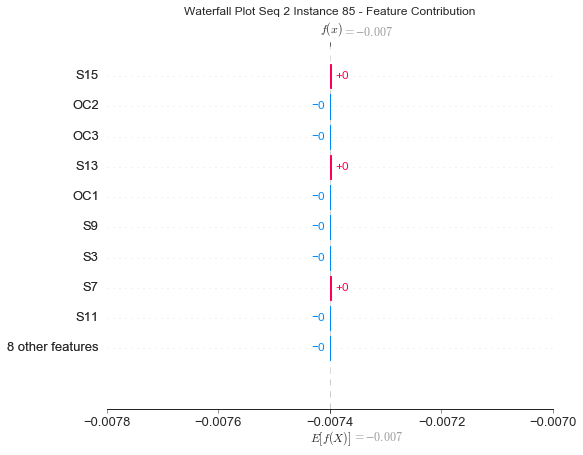

None

Contribution: [ 5.08116422e-19 -2.12167364e-21 -1.44583127e-18 -2.91473901e-18
  1.91050866e-18  6.14426947e-18 -1.20479952e-18 -2.63038306e-18
 -1.57177882e-18  4.05698466e-18 -2.73871705e-18 -6.38413654e-19
 -2.27300211e-19  3.46386082e-20  3.41743632e-18 -1.07769919e-18
 -1.33537691e-18]


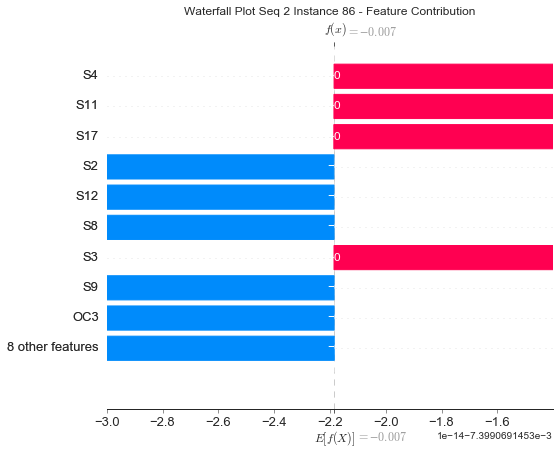

None

Contribution: [-1.71468275e-18 -2.40557357e-18 -1.41514007e-18 -2.25876762e-18
  1.48271091e-18  3.64342165e-18 -1.62369648e-19 -2.93482916e-18
 -1.39208055e-18  3.57741925e-18 -1.16615323e-18 -7.14884951e-19
 -3.93474101e-19  2.43039478e-18  2.80097810e-18 -4.14962289e-19
 -6.16583531e-19]


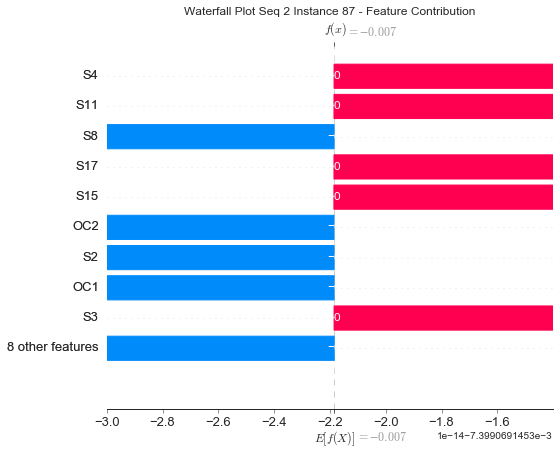

None

Contribution: [-4.12516130e-18 -3.39053206e-18 -1.35723609e-18 -7.19797731e-19
  1.15782828e-18  2.96715000e-18  4.26725107e-19 -2.65985117e-18
 -9.61492514e-19  4.01464500e-18 -4.05265276e-19 -6.02958263e-19
 -6.18365071e-19  2.38566995e-18  2.25013124e-18 -1.11246732e-19
  8.59366339e-20]


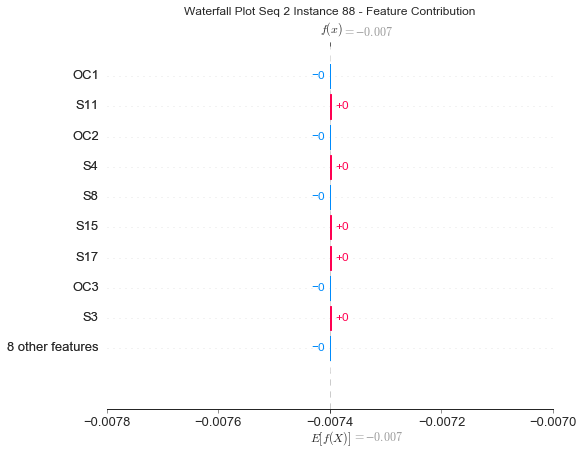

None

Contribution: [-5.13869495e-18 -4.80152496e-18 -8.64872648e-19 -1.95966863e-18
  2.37025192e-18  4.59018900e-18 -3.43265866e-20 -4.24262218e-18
 -1.25776845e-18  5.80034721e-18 -7.85130731e-19 -2.01356730e-18
 -4.34054341e-19  3.13911403e-18  3.37578240e-18 -2.99808744e-19
 -3.88085821e-19]


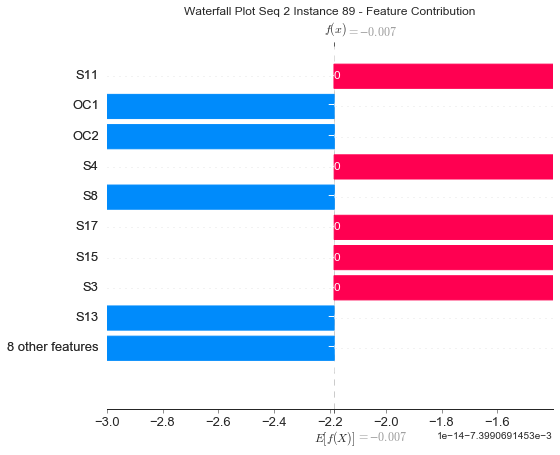

None

Contribution: [-4.14121935e-18 -3.46410088e-18 -1.22195876e-18 -4.15856326e-18
  3.91148317e-18  9.72281740e-18 -1.46850274e-18 -5.84492935e-18
 -2.34299901e-18  8.77432414e-18 -3.42843947e-18 -2.72537793e-18
 -4.92796159e-19  2.55711327e-18  5.97879240e-18 -1.56547002e-18
 -1.69574600e-18]


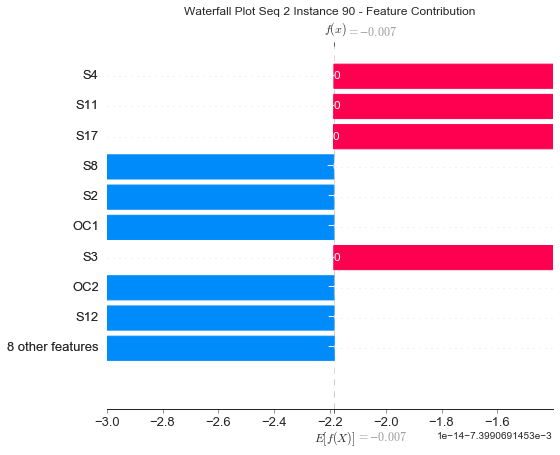

None

Contribution: [-8.55092416e-18 -7.97209377e-18 -5.21117479e-19 -5.84672402e-19
  2.10304653e-18  3.31963462e-18  5.24215632e-19 -3.16825333e-18
 -6.23575275e-19  5.15213250e-18 -1.27091462e-20 -1.55880118e-18
 -4.37740103e-19  7.59783591e-18  2.59231973e-18  1.17046923e-19
  1.57600758e-19]


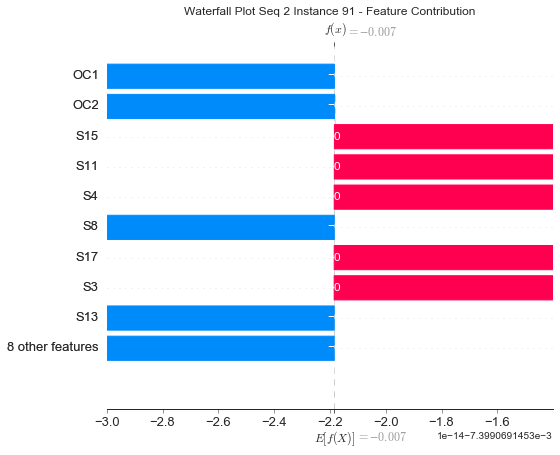

None

Contribution: [-1.05478291e-17 -9.16216431e-18 -1.53157443e-18 -1.58111118e-18
  3.77436599e-18  6.13144734e-18  8.78893101e-20 -6.29020687e-18
 -1.13018907e-18  8.99545102e-18 -3.46230611e-19 -3.48173224e-18
 -8.90597345e-19  6.07508987e-18  4.90938849e-18 -9.83662311e-20
 -3.22990067e-19]


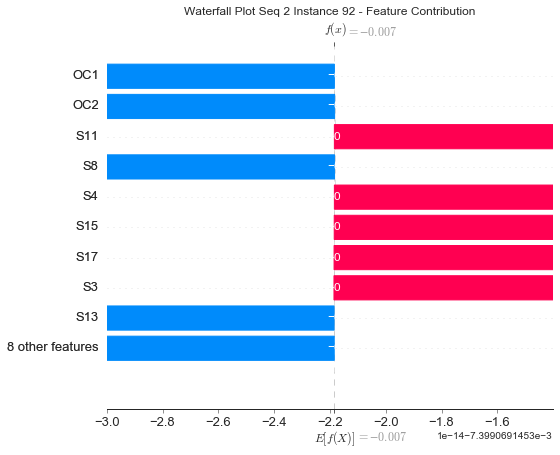

None

Contribution: [-1.51070187e-18 -2.06667292e-18 -1.16459296e-18 -1.34957528e-17
  1.08372745e-17  2.68985189e-17 -6.95210398e-18 -1.31896918e-17
 -5.49011643e-18  1.97481530e-17 -1.09037956e-17 -8.26981676e-18
  4.24517071e-20  2.72489651e-18  1.43844326e-17 -4.91134766e-18
 -6.85819044e-18]


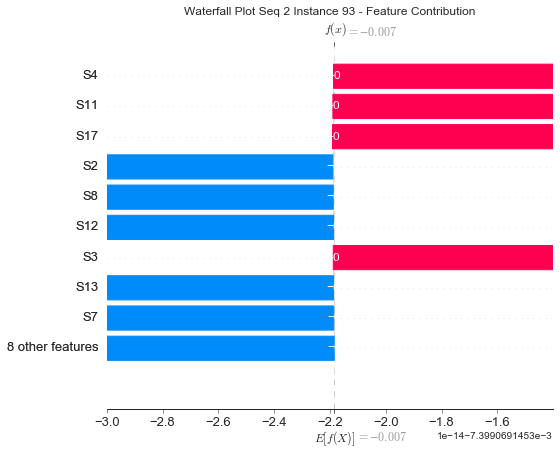

None

Contribution: [-6.66670723e-18 -7.88511491e-18 -3.22885454e-19 -8.58343484e-18
  7.59281988e-18  1.66154512e-17 -4.21884488e-18 -8.61840307e-18
 -3.08604936e-18  1.29827924e-17 -6.21183110e-18 -5.63591156e-18
  1.49118486e-19  1.16571172e-17  9.13240649e-18 -2.61759547e-18
 -4.39614318e-18]


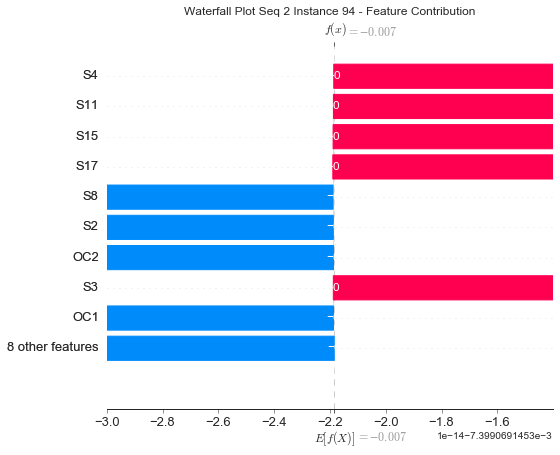

None

Contribution: [-9.85656589e-18 -1.06560103e-17  8.64994399e-19 -7.27852682e-18
  6.70352752e-18  1.30179592e-17 -2.48227348e-18 -8.11412565e-18
 -2.46490765e-18  1.15633530e-17 -3.92911122e-18 -6.45626173e-18
  1.15697016e-19  1.68781423e-17  7.64548978e-18 -1.49155936e-18
 -3.06313315e-18]


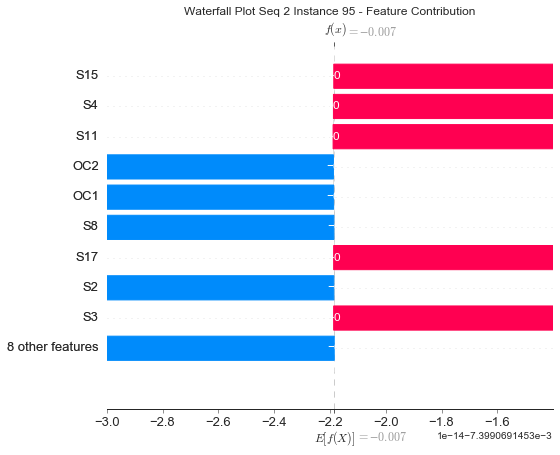

None

Contribution: [-1.02804041e-17 -1.07207289e-17  7.15889820e-19 -1.33422239e-17
  1.20455513e-17  2.24513842e-17 -4.63914610e-18 -1.61958440e-17
 -4.86426992e-18  2.15504852e-17 -6.95964952e-18 -1.14499887e-17
  2.66743672e-19  1.13041187e-17  1.42500290e-17 -2.86890018e-18
 -5.30313183e-18]


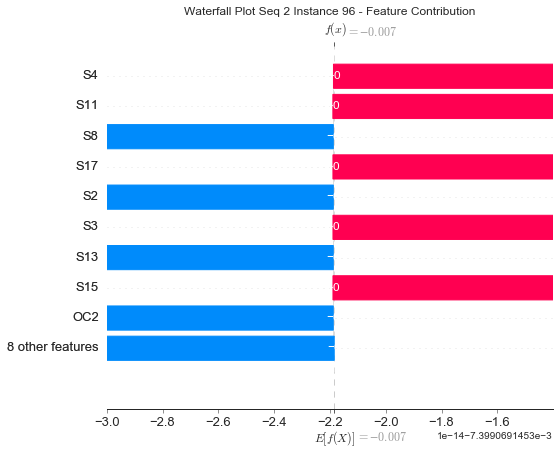

None

Contribution: [-1.15460633e-17 -1.08778014e-17  1.59054217e-18 -1.13202579e-17
  1.14160098e-17  2.18213935e-17 -4.73835318e-18 -1.49303255e-17
 -4.05530796e-18  2.11007422e-17 -6.29108741e-18 -1.12594377e-17
  7.89213953e-19  1.22424865e-17  1.30004197e-17 -2.54920893e-18
 -5.23242692e-18]


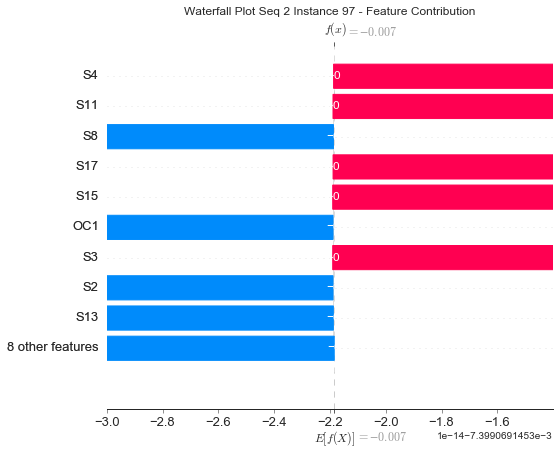

None

Contribution: [-1.20342090e-17 -1.17672001e-17  2.96745317e-18 -1.50726370e-17
  1.48569248e-17  2.68574328e-17 -7.35209626e-18 -1.85764400e-17
 -4.52448191e-18  2.58526185e-17 -8.23897450e-18 -1.38137036e-17
  1.17860737e-18  1.09956631e-17  1.62340713e-17 -3.55833123e-18
 -6.96585834e-18]


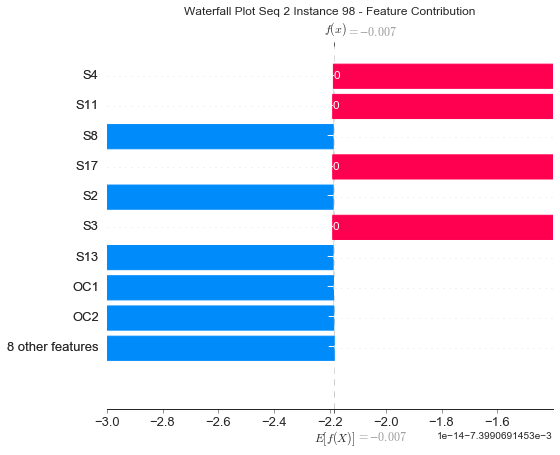

None

Contribution: [-2.09316929e-17 -1.70198813e-17  9.10232441e-19 -2.90131801e-18
  7.24057908e-18  9.80360483e-18 -5.94625401e-19 -1.02757463e-17
 -1.42203049e-18  1.52569527e-17 -7.00760532e-19 -7.33206112e-18
  1.35978928e-19  1.80276074e-17  7.57231821e-18 -2.32378092e-19
 -1.28519186e-18]


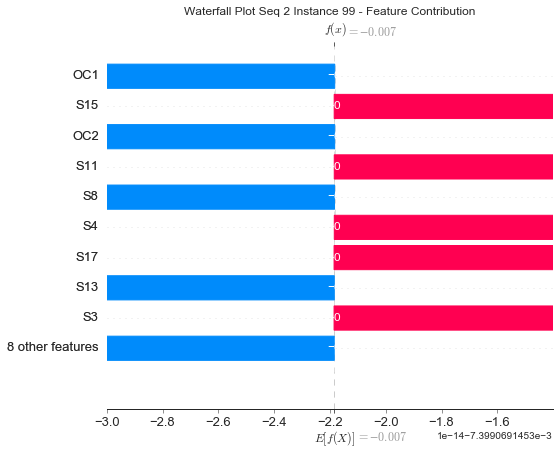

None

Contribution: [-1.47690121e-17 -1.00647474e-17  5.20214301e-18 -1.45321257e-17
  1.57880671e-17  2.99752718e-17 -6.74096489e-18 -1.96637541e-17
 -4.67455522e-18  2.85620238e-17 -9.40515441e-18 -1.73664138e-17
  1.86031203e-18  1.02260121e-17  1.69974482e-17 -3.88512920e-18
 -6.64965035e-18]


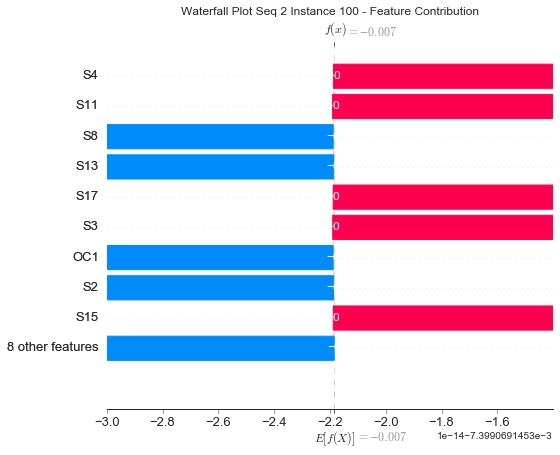

None

Contribution: [-2.43631905e-17 -1.70304130e-17  6.39679819e-18 -4.10123096e-18
  1.04600123e-17  1.34978753e-17 -4.31587869e-19 -1.50052251e-17
 -1.30538076e-18  2.11150540e-17 -8.79264764e-19 -1.58484811e-17
  1.27091090e-18  1.37885102e-17  9.49926026e-18 -2.73446911e-19
 -1.15961861e-18]


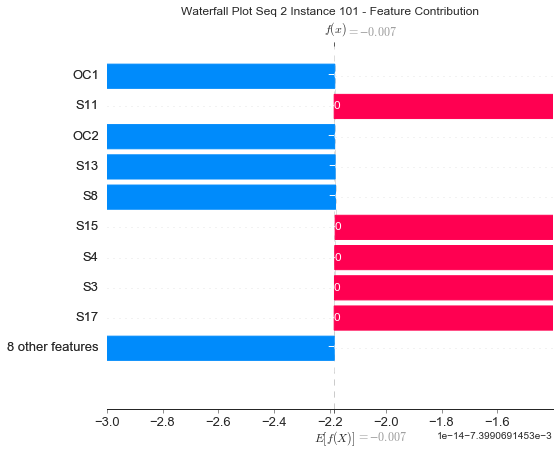

None

Contribution: [-1.25414966e-17 -9.36203348e-18  8.40311195e-18 -1.78541013e-17
  1.68763539e-17  2.96684473e-17 -7.07167955e-18 -2.17149502e-17
 -5.53363729e-18  2.88044903e-17 -9.69589433e-18 -2.15455651e-17
  2.68018513e-18  1.21589652e-17  1.75939695e-17 -4.11166047e-18
 -7.82137237e-18]


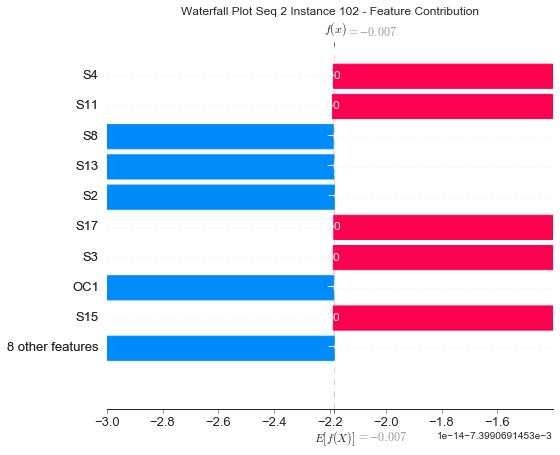

None

Contribution: [-2.54461403e-17 -1.70037596e-17  9.30824689e-18 -3.06273817e-18
  1.07515679e-17  1.12583699e-17 -1.95598436e-18 -1.26489407e-17
  9.57735563e-19  1.93828650e-17  8.02390320e-19 -1.65197828e-17
  2.44999296e-18  1.37795940e-17  7.04346111e-18  5.25237510e-19
 -9.32383097e-19]


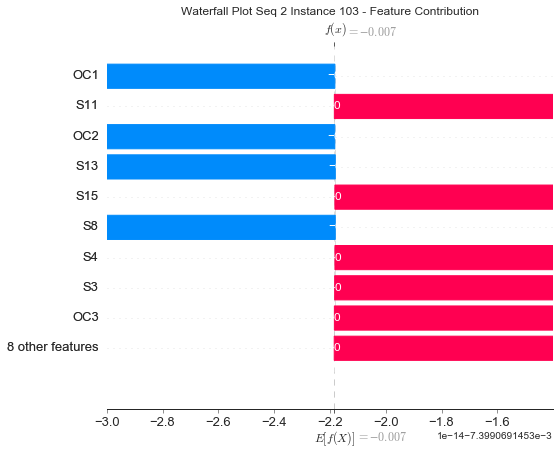

None

Contribution: [-7.72054650e-18 -1.22121234e-18  1.19067959e-17 -1.74230028e-17
  1.75912299e-17  3.39849537e-17 -1.00582623e-17 -1.96604520e-17
 -4.71594527e-18  2.88263444e-17 -1.33326874e-17 -2.41256573e-17
  4.00112143e-18  6.29256434e-18  1.76472879e-17 -6.18103144e-18
 -9.33809570e-18]


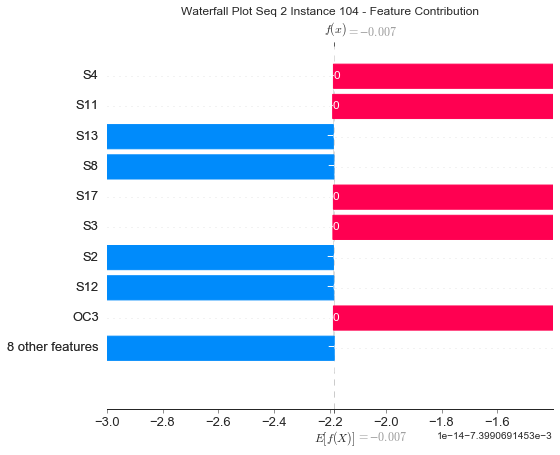

None

Contribution: [-1.40819012e-17 -6.31602649e-18  7.85798338e-18 -4.21802142e-18
  6.99712990e-18  1.03417752e-17 -2.34155062e-18 -7.83379414e-18
 -5.65599426e-19  1.13522689e-17 -2.04270846e-18 -1.22652406e-17
  2.63399433e-18  1.52402039e-17  5.11513932e-18 -8.09863380e-19
 -2.37106504e-18]


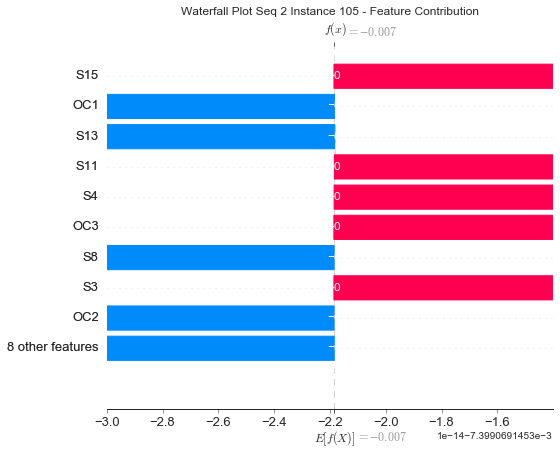

None

Contribution: [-3.28666258e-18  3.74521573e-18  1.09624385e-17 -1.51428712e-17
  1.70381074e-17  2.94602129e-17 -1.13897021e-17 -1.84986602e-17
 -2.43483157e-18  2.71601015e-17 -9.85413067e-18 -2.21213391e-17
  4.61082923e-18 -7.13541878e-18  1.47242086e-17 -4.80620391e-18
 -9.41292411e-18]


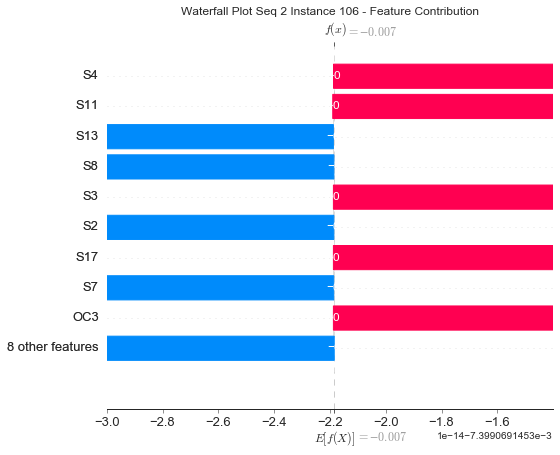

None

Contribution: [-5.59008286e-18  3.61678519e-18  1.83586004e-17 -1.28344827e-18
  3.45438441e-18  9.15410695e-19 -2.09635050e-18 -2.29837096e-18
  2.55877859e-18  3.12306011e-18 -1.00018072e-19 -1.70329061e-17
  4.96739577e-18  6.20862743e-18 -1.84731620e-18 -2.49697832e-19
 -1.35123500e-18]


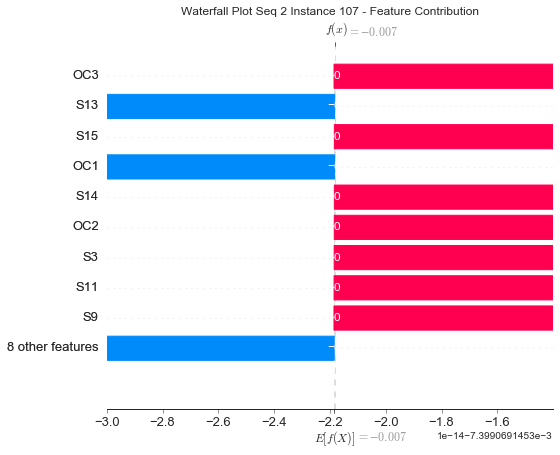

None

Contribution: [-6.68792358e-18 -2.78961057e-18  2.29522900e-17  6.00219086e-18
  1.13551591e-18 -2.53066743e-17 -1.54787837e-18  6.45364411e-18
  1.22137568e-17 -1.08571715e-17  1.45072077e-17 -1.26538484e-17
  6.10902537e-18  5.84176414e-18 -1.58453031e-17  6.36593815e-18
  3.08928426e-18]


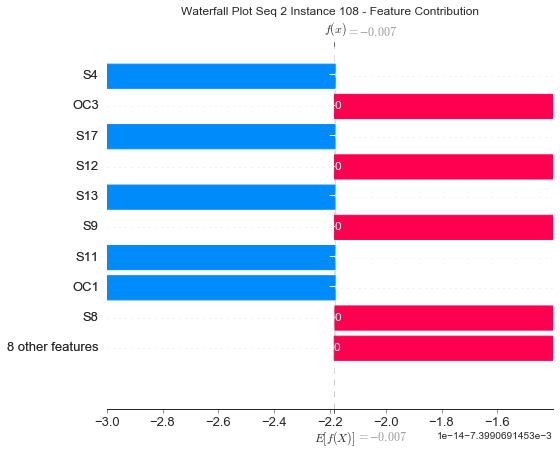

None

Contribution: [ 1.41378815e-17  2.07652774e-17  1.33021983e-17 -4.09392339e-19
  2.34779687e-18 -6.22929247e-18 -8.52619477e-18  6.86061160e-18
  6.42646751e-18 -7.29555268e-18 -4.43425108e-19 -3.84994714e-18
  5.61265744e-18 -1.41312194e-17 -6.88978957e-18 -8.29215270e-19
 -3.12451264e-18]


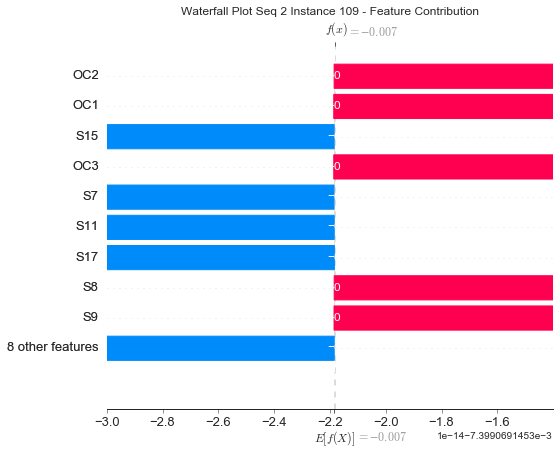

None

Contribution: [ 3.08949543e-17  2.92891155e-17  2.93300014e-17 -1.23207043e-18
 -3.40032278e-18 -2.10544184e-17 -7.44777294e-18  1.45926472e-17
  9.88045073e-18 -2.38830320e-17  3.08906857e-18 -8.22201647e-18
  9.58872895e-18 -1.37902878e-17 -1.61655857e-17  4.41043707e-19
 -2.85135299e-18]


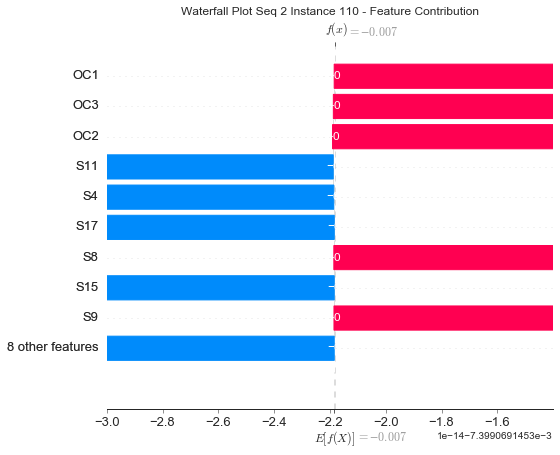

None

Contribution: [-8.30874967e-18 -2.04004535e-18  3.31622167e-17  6.22380751e-17
 -4.08253337e-17 -1.35578582e-16  2.48389682e-17  5.74864718e-17
  3.57534923e-17 -8.74034637e-17  6.19189753e-17  1.92622720e-17
  6.58480559e-18 -2.10069713e-18 -7.38283049e-17  2.56247848e-17
  3.04221776e-17]


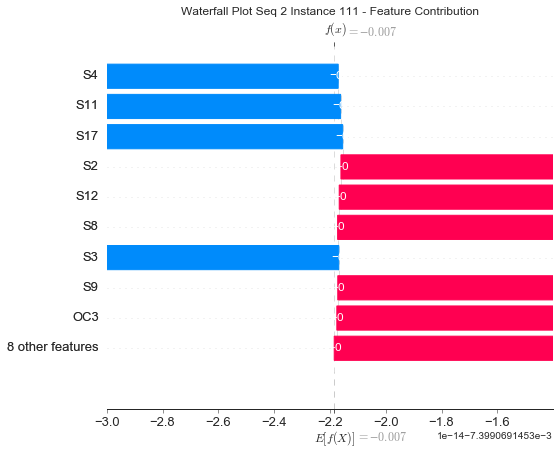

None

Contribution: [ 5.52960686e-18  9.64892371e-18  2.98991480e-17  7.35493068e-17
 -5.25781408e-17 -1.55893185e-16  2.95898850e-17  7.25814128e-17
  3.95866903e-17 -1.09215991e-16  7.12703051e-17  3.30174634e-17
  6.77649229e-18 -1.30747096e-17 -8.64127263e-17  2.97183396e-17
  3.49040639e-17]


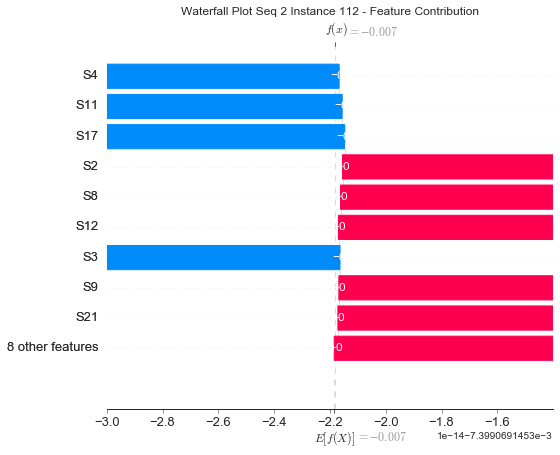

None

Contribution: [ 3.20867628e-17  3.25150107e-17  3.51132942e-17  6.78001435e-17
 -5.37785255e-17 -1.56453351e-16  2.04006347e-17  8.97654482e-17
  4.27848319e-17 -1.24433812e-16  5.46900620e-17  4.48495144e-17
  1.05775009e-17 -2.53047718e-17 -8.81064349e-17  2.32503943e-17
  3.14058045e-17]


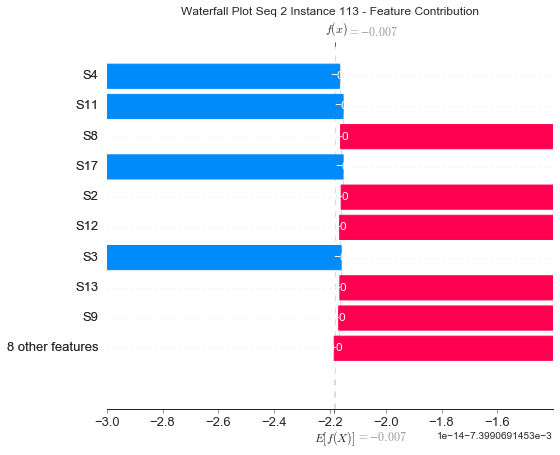

None

Contribution: [ 4.74236740e-17  5.19132795e-17  1.45770995e-17  8.21705339e-17
 -7.28807066e-17 -1.76330051e-16  2.73391183e-17  1.02336059e-16
  4.11448603e-17 -1.47039017e-16  5.90411412e-17  6.44972179e-17
  3.09764726e-18 -5.05323677e-17 -1.01458579e-16  2.33553735e-17
  3.60535405e-17]


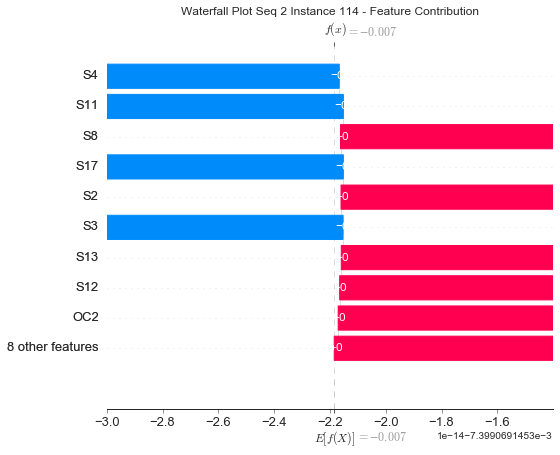

None

Contribution: [ 1.15018829e-16  1.22051810e-16  2.56294915e-17  6.76678674e-17
 -6.98666524e-17 -1.34576528e-16  6.37538786e-18  1.16273510e-16
  3.63837576e-17 -1.52162296e-16  2.93300477e-17  5.42926282e-17
  1.23679987e-17 -1.02117571e-16 -1.00342157e-16  1.07923454e-17
  1.97833032e-17]


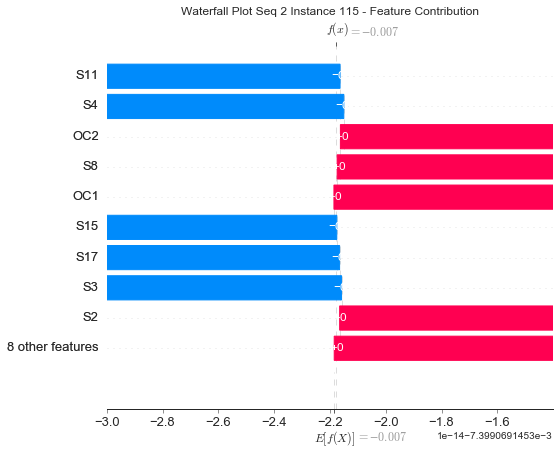

None

Contribution: [ 1.59715513e-16  1.55547635e-16  1.90906949e-17  6.89210724e-17
 -7.44038042e-17 -1.38159081e-16  5.95327098e-18  1.19421216e-16
  3.59236632e-17 -1.66215313e-16  2.71303528e-17  6.21438096e-17
  1.00753485e-17 -1.39860082e-16 -1.03423940e-16  8.18177413e-18
  1.71401501e-17]


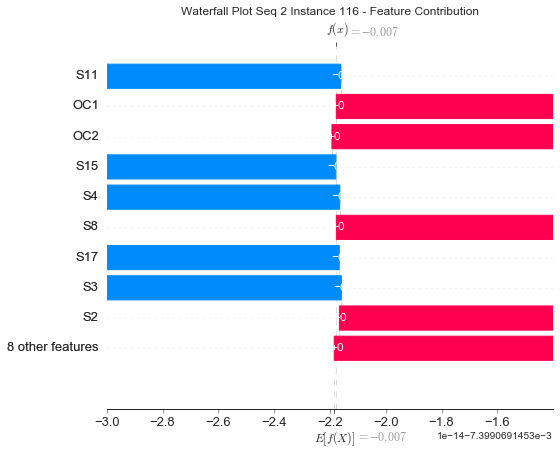

None

Contribution: [ 1.36659793e-16  1.37384297e-16  2.25127031e-17  1.10047222e-16
 -1.13837747e-16 -2.44812242e-16  3.93732843e-17  1.71567701e-16
  5.55958214e-17 -2.38737798e-16  6.90760596e-17  9.81895746e-17
  1.14858404e-17 -1.11564139e-16 -1.50931729e-16  3.17556126e-17
  5.01949839e-17]


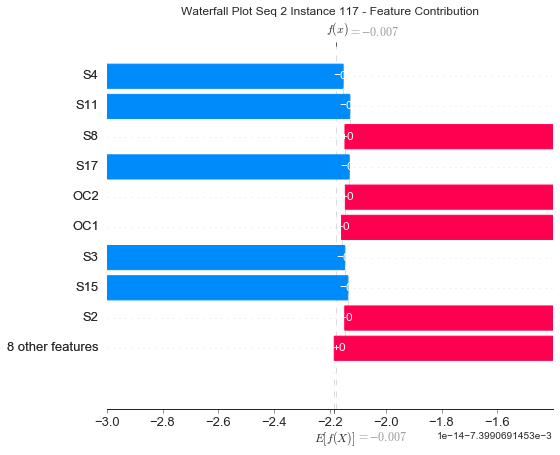

None

Contribution: [ 1.53970327e-16  1.59165776e-16  2.81580949e-17  1.12643669e-16
 -1.08749137e-16 -2.35144552e-16  3.78524830e-17  1.45308145e-16
  5.53243275e-17 -2.09994754e-16  7.27715056e-17  8.43035349e-17
  6.54784592e-18 -2.16844736e-16 -1.42470320e-16  2.99128627e-17
  5.25311007e-17]


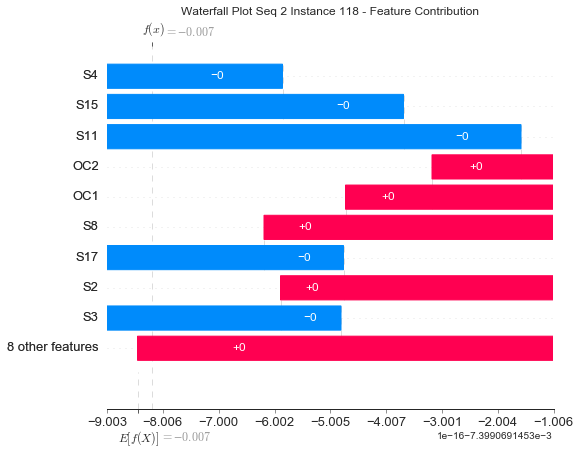

None

Contribution: [ 1.42245009e-16  1.38774980e-16  1.40162727e-17  1.46638370e-16
 -1.29019185e-16 -3.11640891e-16  5.46009151e-17  1.62067883e-16
  6.87932036e-17 -2.45207647e-16  1.09540372e-16  1.07874291e-16
 -2.03155600e-18 -2.45385657e-16 -1.71085448e-16  4.16664771e-17
  6.93986402e-17]


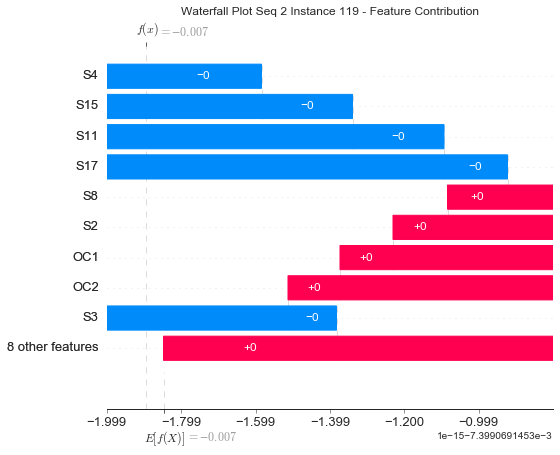

None

Contribution: [ 3.10022450e-16  2.65381352e-16 -1.51817355e-17  7.45734954e-17
 -1.23367159e-16 -1.79720949e-16  3.42238658e-18  1.88653097e-16
  3.70442117e-17 -2.63223535e-16  2.30003161e-17  1.38013775e-16
  2.38579568e-18 -2.54762338e-16 -1.41371599e-16  5.81702399e-18
  1.95432587e-17]


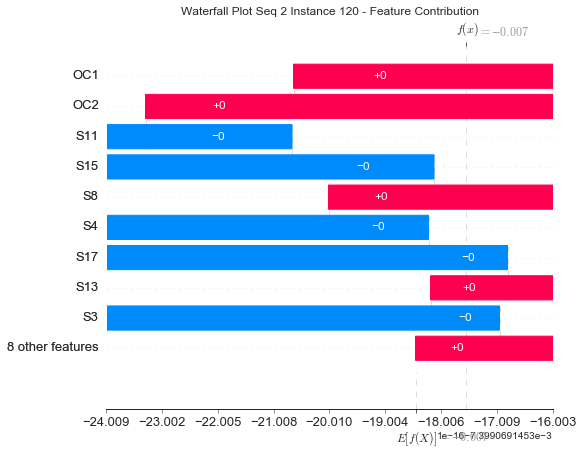

None

Contribution: [ 2.49186849e-16  2.14069379e-16 -2.82902850e-17  1.68674674e-16
 -1.82229398e-16 -3.54451736e-16  5.71263504e-17  2.46794299e-16
  7.03051044e-17 -3.53782739e-16  9.70012073e-17  1.86678994e-16
 -1.26204997e-17 -2.47900789e-16 -2.15416188e-16  3.66268792e-17
  7.09972561e-17]


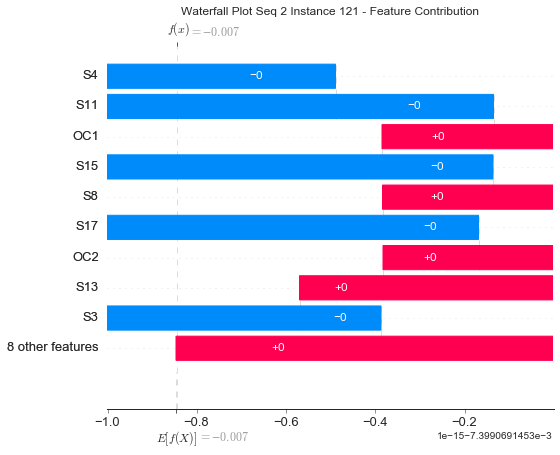

None

Contribution: [ 3.35410224e-16  2.42087601e-16 -5.27202505e-17  1.31555969e-16
 -1.83013141e-16 -3.48108068e-16  4.38871196e-17  2.49325154e-16
  5.50592525e-17 -3.85581838e-16  8.75911675e-17  2.04294685e-16
 -1.32044223e-17 -2.32595883e-16 -2.15668101e-16  3.18910849e-17
  4.89085757e-17]


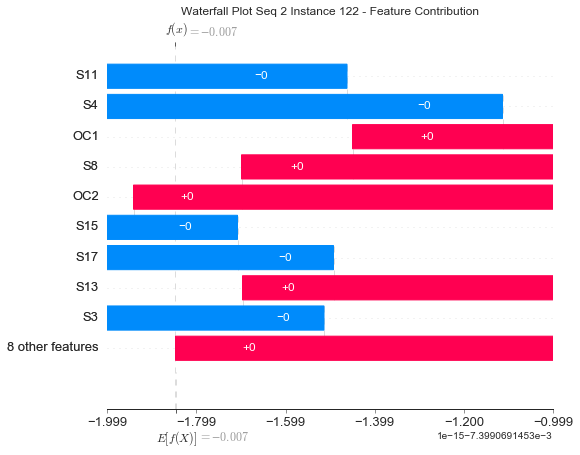

None

Contribution: [ 3.34272315e-16  2.76837710e-16 -7.80533714e-17  2.18280351e-16
 -2.45513770e-16 -4.08059737e-16  7.80267891e-17  3.27703627e-16
  6.82467416e-17 -4.58575379e-16  1.03706227e-16  2.70456773e-16
 -1.86207356e-17 -2.61700120e-16 -2.66994288e-16  4.26691888e-17
  8.44814118e-17]


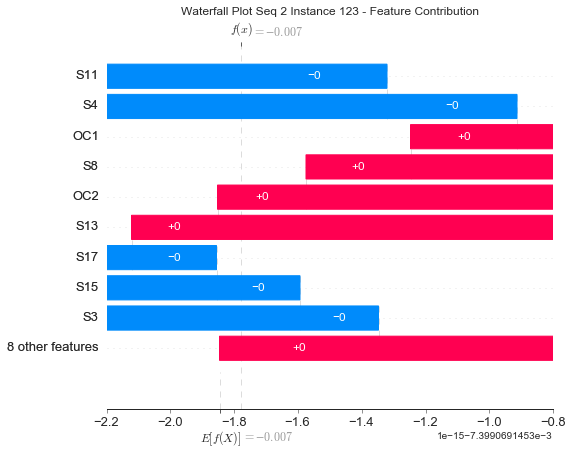

None

Contribution: [ 3.79582039e-16  3.01415536e-16 -4.77511945e-17  9.48142211e-17
 -1.65762283e-16 -2.34612324e-16  2.20870409e-17  2.22118826e-16
  3.67752026e-17 -3.23368618e-16  3.37784199e-17  1.83318947e-16
 -1.23585027e-17 -3.68045583e-16 -1.71239833e-16  1.17990383e-17
  3.73398461e-17]


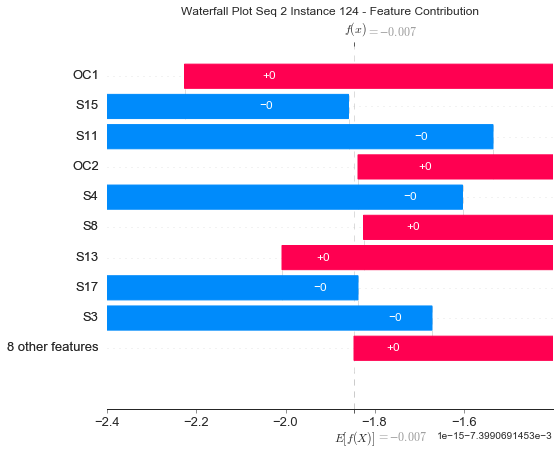

None

Contribution: [ 2.71276463e-16  2.46811398e-16 -1.28025536e-16  3.09230024e-16
 -3.13036405e-16 -5.16687716e-16  1.32909912e-16  3.81697186e-16
  7.90192206e-17 -5.22733519e-16  1.45613090e-16  3.43795771e-16
 -4.63606907e-17 -2.71410453e-16 -3.08704440e-16  5.94720493e-17
  1.32461831e-16]


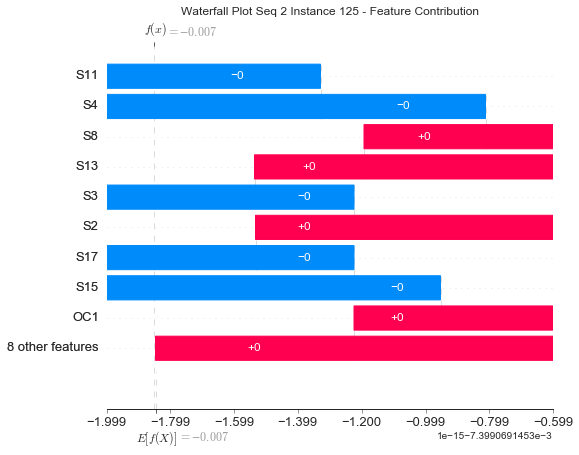

None

Contribution: [ 2.96562487e-16  2.53041484e-16 -1.58514632e-16  2.64776173e-16
 -3.07219909e-16 -4.63564138e-16  1.53974801e-16  3.39286326e-16
  3.81063116e-17 -4.88150487e-16  1.19968492e-16  3.28384377e-16
 -5.43200442e-17 -2.58904726e-16 -2.68537767e-16  5.20022809e-17
  1.29911283e-16]


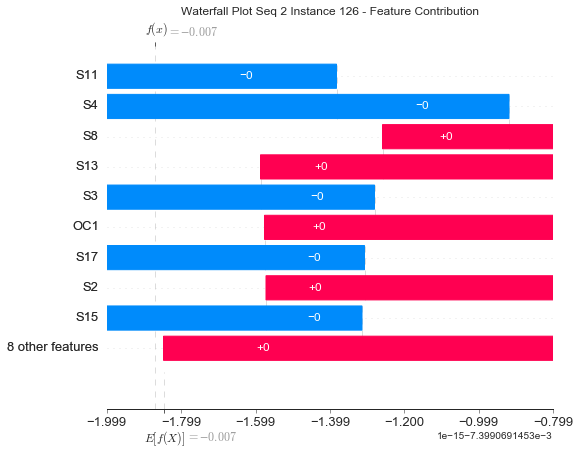

None

Contribution: [ 3.40173170e-16  2.34798512e-16 -1.94865065e-16  1.35778111e-16
 -2.40512014e-16 -3.15027038e-16  1.00095551e-16  2.67889601e-16
  1.25261439e-18 -4.00937858e-16  4.73512858e-17  3.21797505e-16
 -6.31011686e-17 -2.16283735e-16 -1.75963419e-16  1.84318059e-17
  7.68579101e-17]


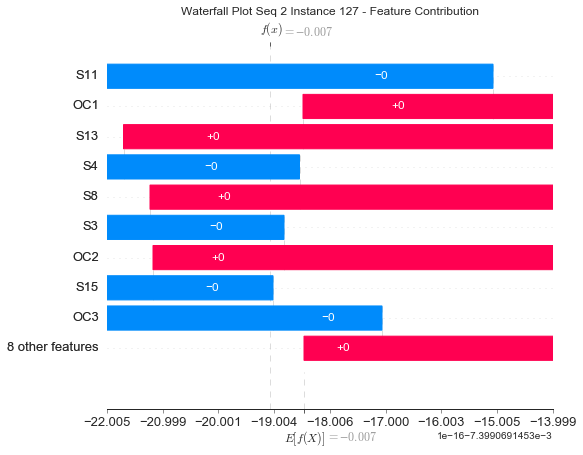

None

Contribution: [ 3.09982718e-16  1.78042077e-16 -1.53079169e-16  1.25227495e-16
 -2.19380700e-16 -3.01161109e-16  9.34101581e-17  2.44270538e-16
  6.98682075e-18 -3.74447167e-16  5.81753544e-17  2.78874586e-16
 -5.52863996e-17 -1.68551020e-16 -1.71944763e-16  2.97223497e-17
  7.31464831e-17]


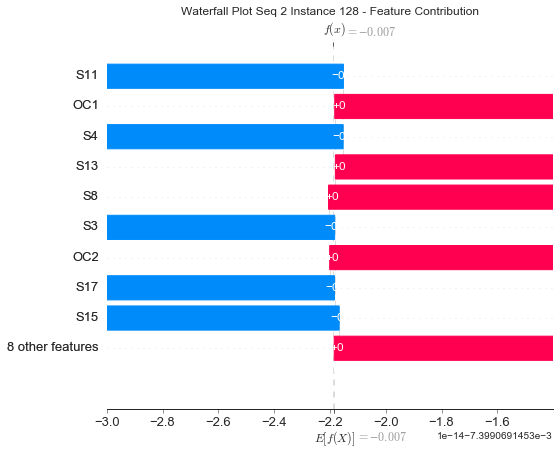

None

Contribution: [ 2.72853585e-16  1.23158498e-16 -2.75417474e-16  6.82694791e-17
 -1.56049780e-16 -1.51143937e-16  4.32852266e-17  1.82464502e-16
 -1.17193890e-17 -2.48397891e-16  1.88080374e-17  3.51810529e-16
 -7.61505053e-17 -1.66677979e-16 -8.57274171e-17  9.35277650e-18
  3.73642843e-17]


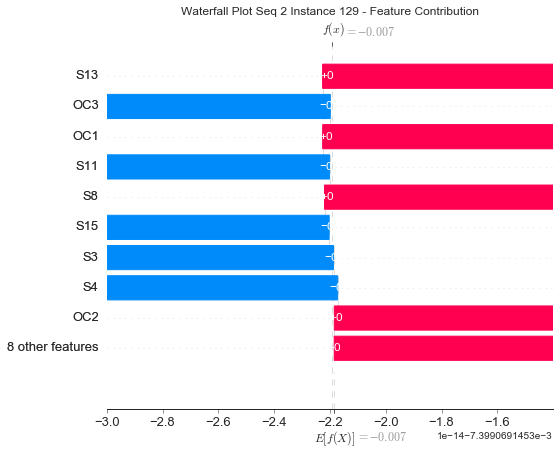

None

Contribution: [ 1.92539456e-17  1.29425493e-17 -3.10988623e-16  2.31598951e-16
 -3.27244694e-16 -3.62248781e-16  3.01355370e-16  1.72804211e-16
 -8.57659373e-17 -3.14331518e-16  1.02248695e-16  3.36101138e-16
 -1.33296437e-16 -1.74657234e-17 -1.10705995e-16  5.57506498e-17
  2.00261789e-16]


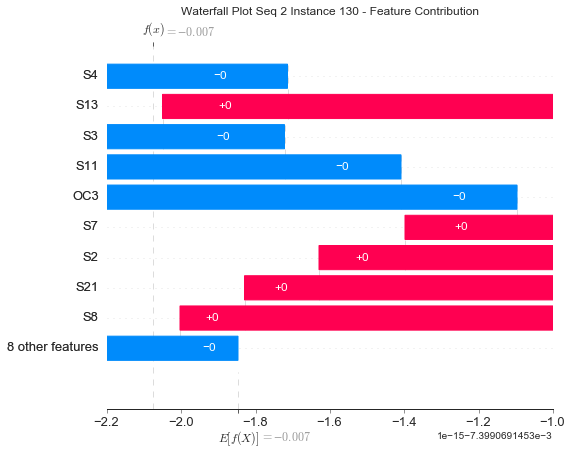

None

Contribution: [ 1.86268947e-17 -7.33686638e-17 -3.51382301e-16  5.66327353e-17
 -1.75480874e-16 -5.36662241e-17  1.72344378e-16  1.70309854e-17
 -1.29350759e-16 -9.27528606e-17 -1.24177785e-17  2.81610715e-16
 -1.24770322e-16  2.94631907e-17  5.20380481e-17 -1.91330681e-18
  8.86964198e-17]


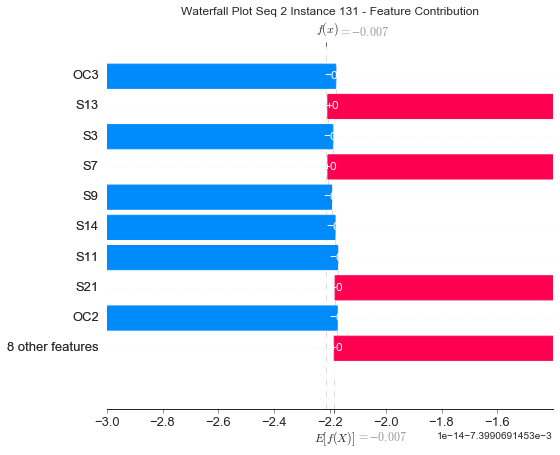

None

Contribution: [-1.06563991e-16 -1.60573240e-16 -3.26695420e-16  6.56816272e-18
 -2.44960324e-17  2.39414736e-16  9.20532047e-17 -1.15492651e-16
 -1.38841194e-16  1.76264512e-16 -8.92350997e-17  1.75298418e-16
 -1.22613088e-16 -2.77243661e-17  1.89245914e-16 -4.12628494e-17
  3.39102858e-17]


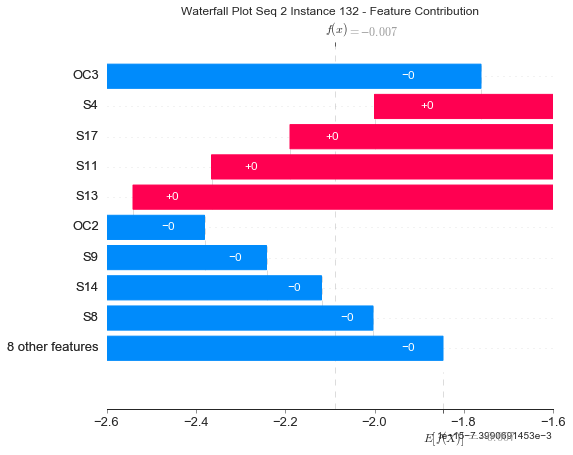

None

Contribution: [-2.88154150e-16 -4.03905332e-16 -2.75473299e-16 -5.87429550e-18
 -4.68611978e-17  1.60125795e-16  1.44375482e-16 -1.08009982e-16
 -1.37627501e-16  1.04401139e-16 -1.74199985e-17  1.20397356e-16
 -1.31397124e-16  4.65207171e-16  1.37668900e-16 -1.29971341e-17
  4.53617444e-17]


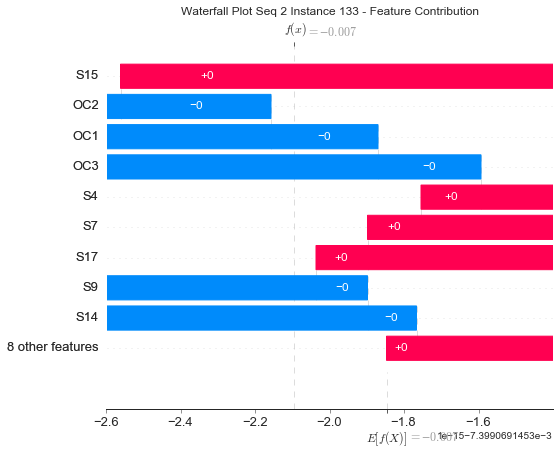

None

Contribution: [-6.64918905e-16 -7.55765518e-16 -3.40228359e-16  8.36389780e-17
 -3.25026361e-17  4.12844586e-17  1.40825223e-16 -6.76107257e-17
 -7.03118807e-17  1.45628628e-16  5.23245868e-17  2.34596283e-16
 -1.25729269e-16  7.94034466e-16  1.13737030e-16  3.22753037e-17
  7.93528457e-17]


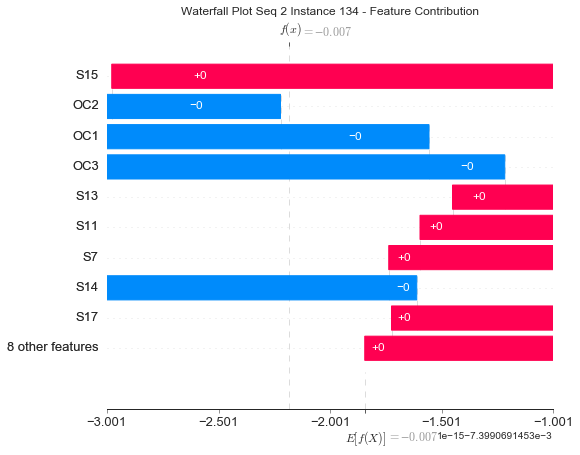

None

Contribution: [-4.45652250e-16 -6.31878161e-16 -2.86223100e-16 -3.25317138e-16
  2.46212943e-16  7.62051614e-16 -5.42743971e-17 -3.78521633e-16
 -2.30743051e-16  5.85166200e-16 -2.60588336e-16 -1.70182683e-17
 -7.18911538e-17  8.90616181e-16  4.74382126e-16 -8.33833262e-17
 -1.41889520e-16]


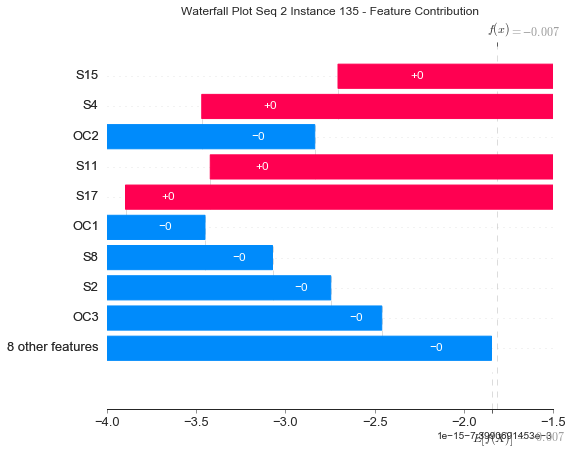

None

Contribution: [-7.97285114e-16 -7.25048503e-16 -4.63971085e-16 -5.51232843e-16
  5.57068000e-16  1.51754126e-15 -1.17223762e-16 -9.37560758e-16
 -4.03272598e-16  1.41270516e-15 -4.70599012e-16 -2.70462755e-16
 -1.26322219e-16  5.32817923e-16  9.79721717e-16 -1.83080176e-16
 -2.18490203e-16]


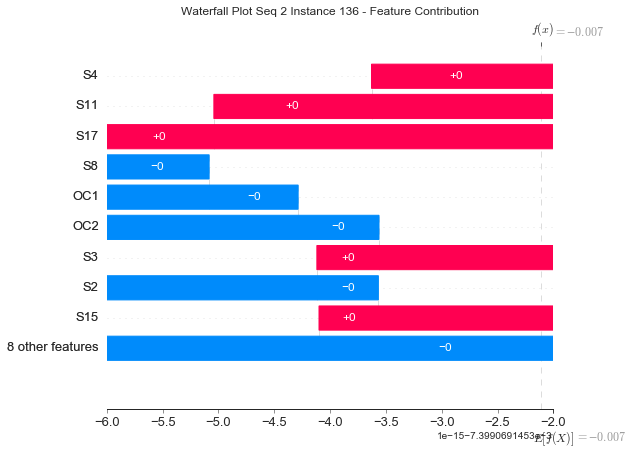

None

Contribution: [-7.96766942e-16 -9.02947286e-16 -4.15410342e-16 -1.13475596e-15
  8.80348924e-16  2.15141964e-15 -2.30613852e-16 -1.46106111e-15
 -6.42921353e-16  1.93056745e-15 -7.17762379e-16 -5.90709237e-16
 -8.52087484e-17  9.28575115e-16  1.43346244e-15 -2.71327708e-16
 -4.08057752e-16]


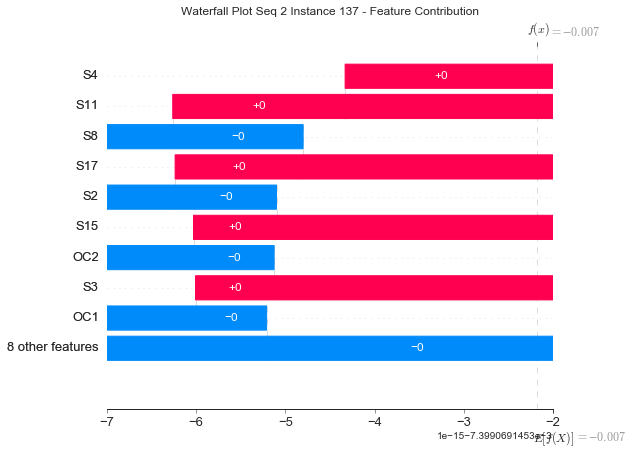

None

Contribution: [-1.82694864e-15 -1.58045972e-15 -3.50404692e-16 -5.04638990e-16
  8.67952755e-16  1.67242410e-15 -1.30480992e-16 -1.27758085e-15
 -3.23335187e-16  2.04344433e-15 -3.27888757e-16 -4.33423318e-16
 -1.21606839e-16  1.07534994e-15  1.15250352e-15 -1.28436929e-16
 -1.63163440e-16]


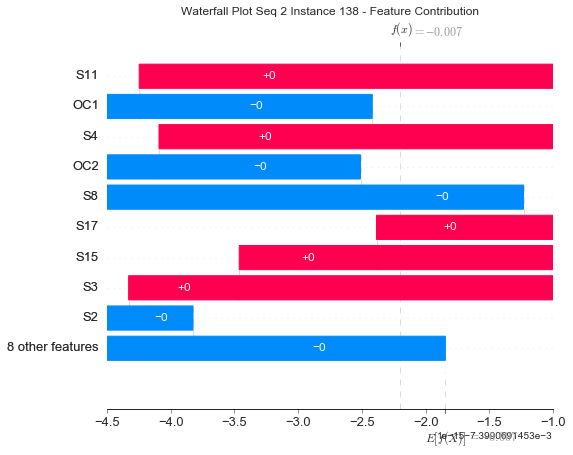

None

Contribution: [-2.23843999e-15 -1.92964418e-15 -3.57558706e-16 -5.38163759e-16
  9.77020741e-16  1.75252483e-15 -1.23021303e-17 -1.58104639e-15
 -3.86629327e-16  2.28614192e-15 -2.74502546e-16 -6.98218364e-16
 -1.62501471e-16  1.42121742e-15  1.31802879e-15 -1.02583075e-16
 -1.47848211e-16]


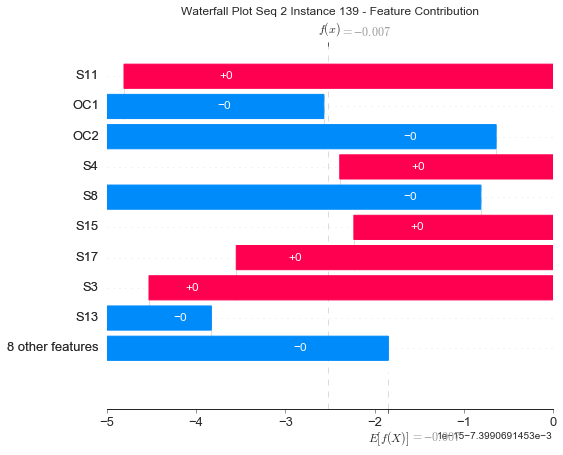

None

Contribution: [-1.90401932e-15 -2.16346360e-15 -2.82385935e-16 -1.97882800e-15
  1.60885279e-15  3.18811216e-15 -4.22710945e-16 -2.51976145e-15
 -8.96329630e-16  3.26560170e-15 -9.43870836e-16 -1.26004769e-15
 -7.79066891e-17  2.24178810e-15  2.25620016e-15 -3.64608694e-16
 -6.48711618e-16]


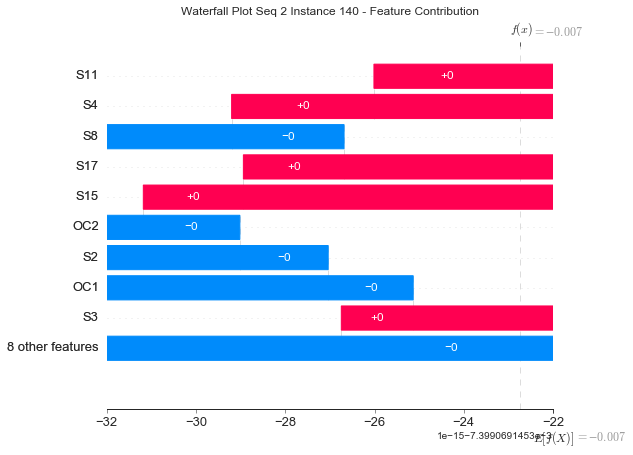

None

Contribution: [-2.80886967e-15 -2.56816705e-15 -1.65563707e-16 -1.42543098e-15
  1.63959119e-15  3.24110868e-15 -3.27634938e-16 -2.53203284e-15
 -7.25063909e-16  3.58622315e-15 -7.43594131e-16 -1.37541570e-15
 -1.45904641e-16  2.18343346e-15  2.16912623e-15 -3.17136150e-16
 -5.18098237e-16]


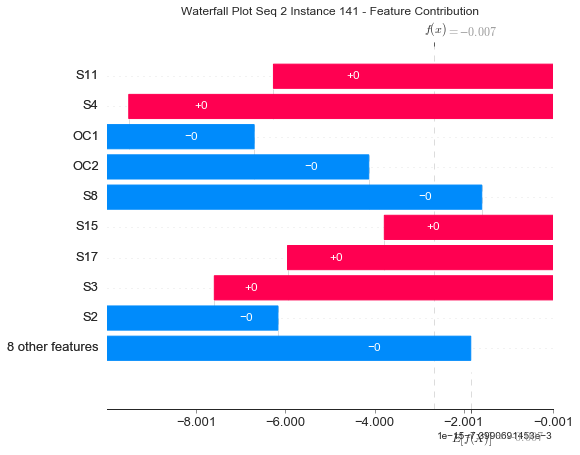

None

Contribution: [-4.21929684e-15 -3.50475361e-15  1.84808759e-16 -5.59361130e-16
  1.48151018e-15  2.19406669e-15 -5.81638334e-17 -2.12239584e-15
 -2.93773631e-16  3.26455752e-15 -1.54088846e-16 -1.44047916e-15
 -1.13982934e-16  2.89500297e-15  1.60000013e-15 -4.92199199e-17
 -1.28233774e-16]


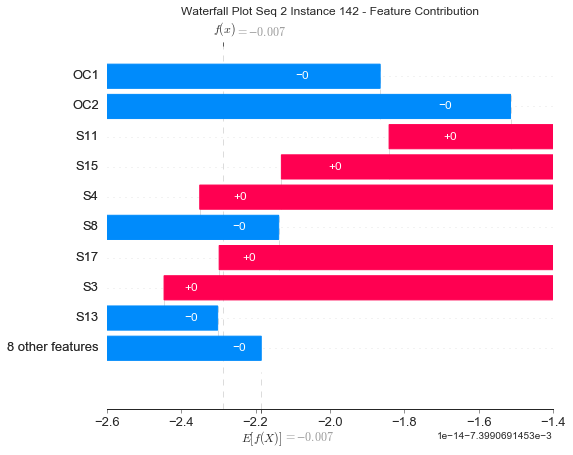

None

Contribution: [-3.10441027e-15 -2.98400263e-15 -2.03925181e-16 -1.45155719e-15
  1.64323322e-15  3.49605586e-15 -4.55694885e-16 -2.25458444e-15
 -7.38172326e-16  3.29891826e-15 -1.10977981e-15 -1.44167464e-15
 -9.60190329e-17  4.02449832e-15  2.27507819e-15 -4.36454134e-16
 -7.05011251e-16]


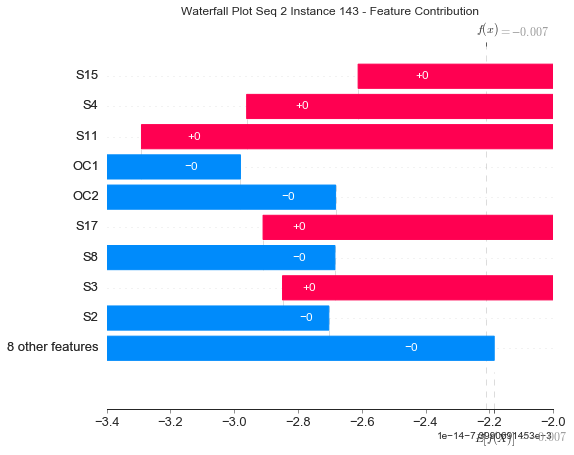

None

Contribution: [-3.23024972e-15 -2.76923679e-15  1.47318300e-16 -2.95126057e-15
  3.31275835e-15  6.63942032e-15 -1.54136714e-15 -4.20943569e-15
 -1.12091184e-15  6.20945496e-15 -2.14201186e-15 -2.98361299e-15
 -1.43755355e-17  2.15293011e-15  3.86562798e-15 -9.62109467e-16
 -1.50206121e-15]


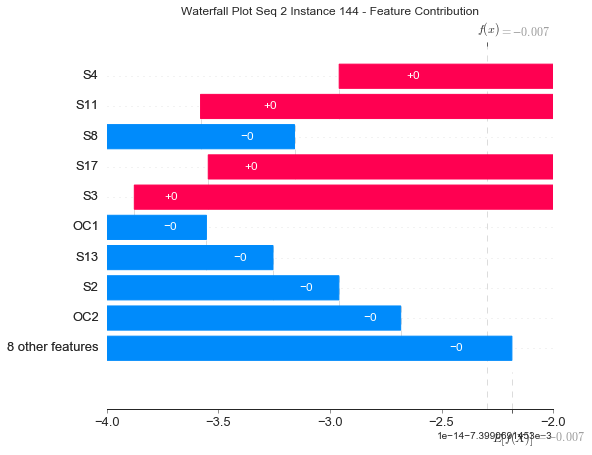

None

Contribution: [-3.82886844e-15 -3.69477677e-15  6.15785382e-16 -2.14262765e-15
  2.56659771e-15  4.70361419e-15 -1.12299014e-15 -2.93345446e-15
 -6.49574903e-16  4.39041486e-15 -1.43003609e-15 -2.52506324e-15
  1.36519609e-16  4.80749346e-15  2.75565250e-15 -5.95701119e-16
 -1.17755452e-15]


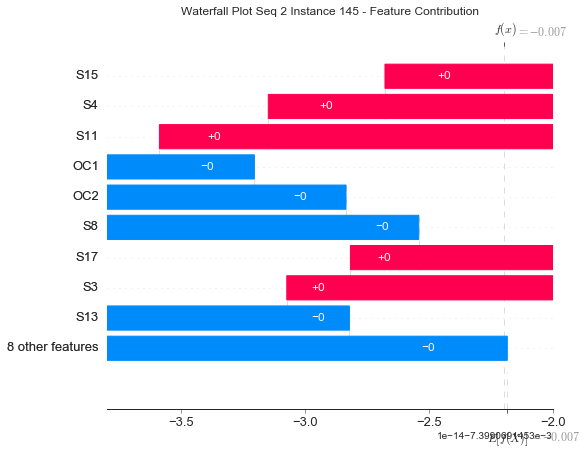

None

Contribution: [-1.82981351e-15 -1.74043417e-15  2.30650618e-16 -4.54340087e-15
  4.13497599e-15  9.63156506e-15 -2.72977395e-15 -4.42560612e-15
 -1.61672194e-15  7.02516040e-15 -3.91731647e-15 -3.17885112e-15
  2.89359743e-16  3.62149826e-15  5.13547860e-15 -1.71310529e-15
 -2.60296782e-15]


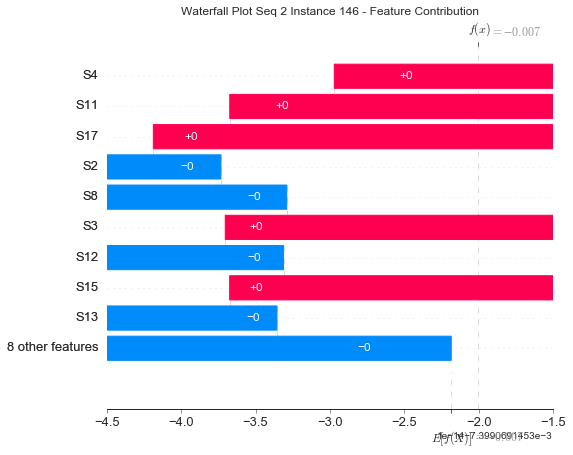

None

Contribution: [-3.64824671e-15 -3.26226185e-15  9.80916563e-16 -4.13454908e-15
  4.31650870e-15  8.08238161e-15 -2.38674509e-15 -4.80597135e-15
 -1.03058350e-15  7.37715129e-15 -2.66308704e-15 -3.98416346e-15
  4.37116514e-16  3.91084387e-15  4.51900590e-15 -1.15651655e-15
 -2.18940272e-15]


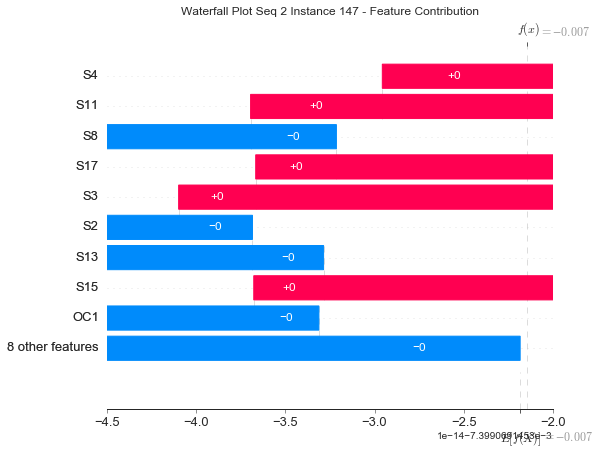

None

Contribution: [-5.02439277e-15 -4.45234822e-15  1.32556061e-15 -3.28686646e-15
  3.67100903e-15  5.63959534e-15 -1.36168995e-15 -4.48935890e-15
 -7.78729057e-16  6.20198075e-15 -1.38511200e-15 -3.99095624e-15
  3.37501548e-16  5.15018309e-15  3.61885001e-15 -5.84289468e-16
 -1.39021029e-15]


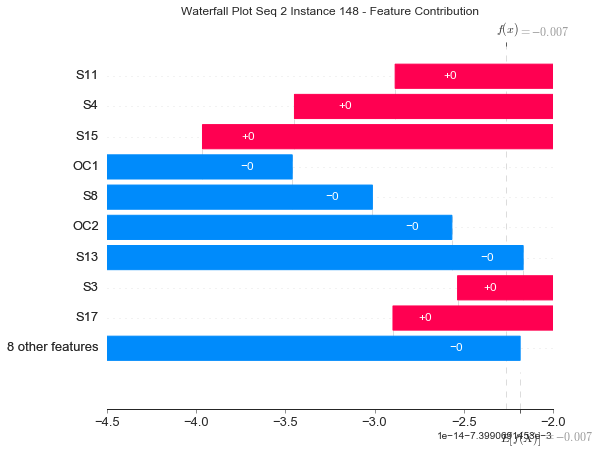

None

Contribution: [-4.56973640e-15 -3.67635127e-15  1.85275011e-15 -3.75385436e-15
  4.38214825e-15  7.02459924e-15 -1.93130775e-15 -5.26596360e-15
 -8.54610663e-16  7.58355374e-15 -1.84499404e-15 -4.94057335e-15
  6.22370481e-16  3.55793479e-15  4.14912525e-15 -8.12332284e-16
 -1.83286622e-15]


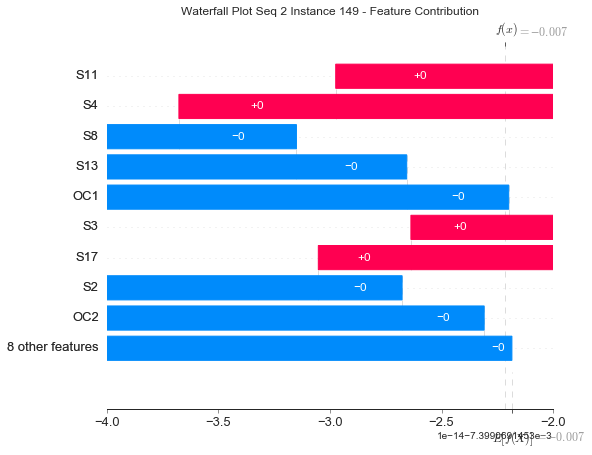

None

Contribution: [-4.89085887e-15 -3.80502616e-15  2.30565841e-15 -3.87237629e-15
  4.16627766e-15  6.52835101e-15 -1.46322496e-15 -5.27441360e-15
 -1.01008298e-15  7.21054838e-15 -1.69357991e-15 -5.32816970e-15
  6.03011225e-16  4.16595918e-15  4.05272019e-15 -7.51036639e-16
 -1.54702817e-15]


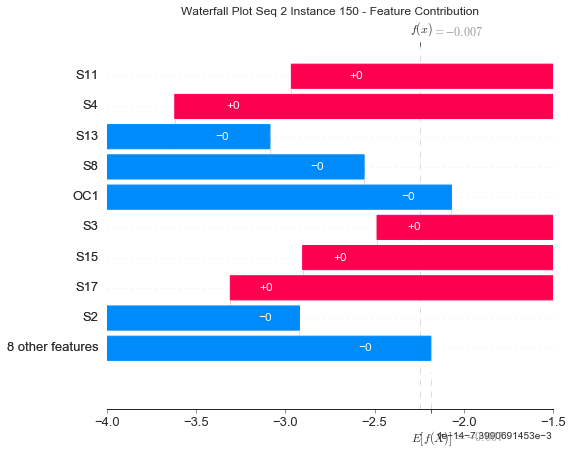

None

Contribution: [-2.75020798e-15 -2.26703138e-15  2.65636711e-15 -3.24505543e-15
  3.75425924e-15  6.25659531e-15 -2.72697514e-15 -3.09666267e-15
 -1.22665194e-16  5.06893188e-15 -2.09518068e-15 -4.16061440e-15
  1.07326899e-15  4.98401386e-15  2.87195626e-15 -9.34462418e-16
 -2.23494429e-15]


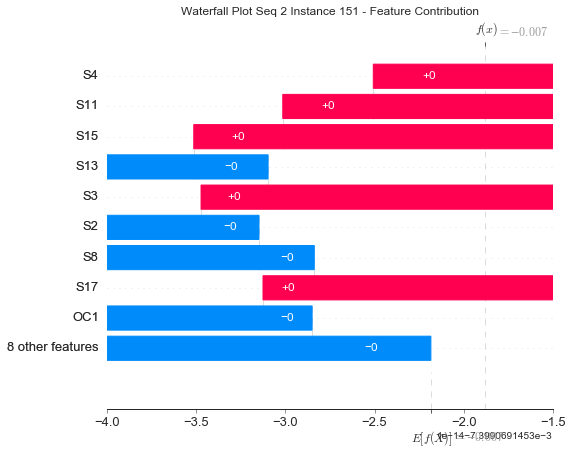

None

Contribution: [-3.83486713e-15 -2.69264828e-15  3.36484812e-15 -2.39164433e-15
  3.54257681e-15  4.23161609e-15 -1.69516915e-15 -3.72827100e-15
  1.55588822e-16  5.25784648e-15 -7.52064090e-16 -5.00490084e-15
  1.02415198e-15  2.91784067e-15  2.33149292e-15 -3.41513785e-16
 -1.41234867e-15]


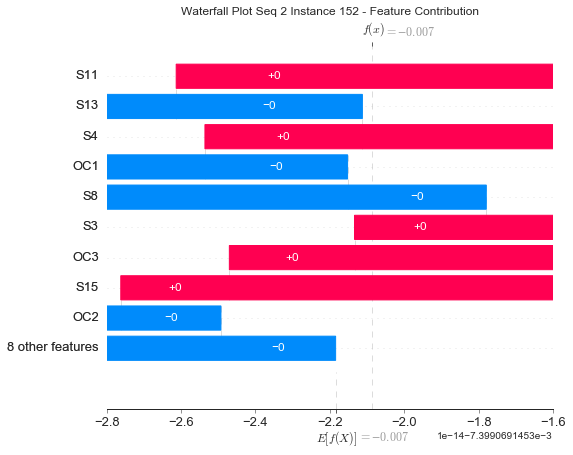

None

Contribution: [-4.28162449e-15 -2.01122701e-15  3.52186177e-15 -3.99216157e-16
  1.87467661e-15  1.17876017e-15 -4.88987726e-16 -1.67364329e-15
  5.98952508e-16  2.79063327e-15  2.79573124e-16 -3.92671303e-15
  1.09269865e-15  3.04860710e-15  5.57326133e-16  1.38643081e-16
 -2.63595250e-16]


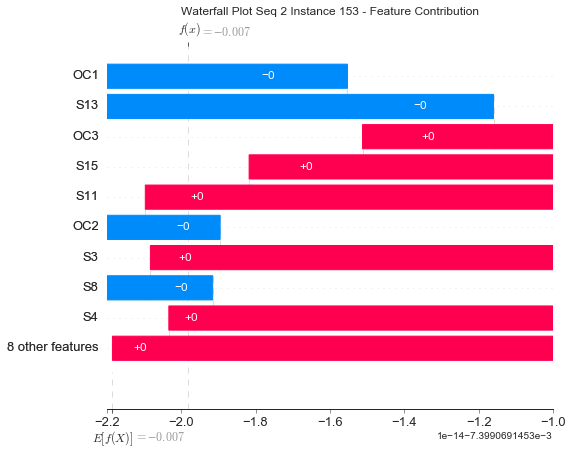

None

Contribution: [-4.33030824e-16  9.50256617e-16  2.11860453e-15 -1.09874276e-15
  1.25868471e-15  1.83968695e-15 -1.19896010e-15 -5.30066442e-16
  1.81304994e-16  1.10355296e-15 -8.00680922e-16 -2.08612187e-15
  9.23720240e-16  2.72044367e-15  3.81613330e-16 -4.30123145e-16
 -1.02294073e-15]


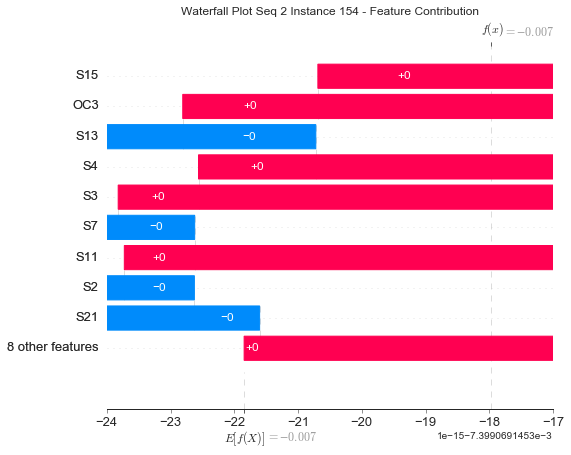

None

Contribution: [-4.20422448e-16  1.03194215e-15  3.51994536e-15 -3.81590063e-16
  1.73289314e-15 -1.88490705e-16 -1.62914421e-15 -8.96585645e-16
  1.32999091e-15  1.26886732e-15  9.03244701e-16 -3.67050505e-15
  1.26399900e-15 -1.40497630e-15 -8.50416420e-16  1.34921721e-16
 -9.61188319e-16]


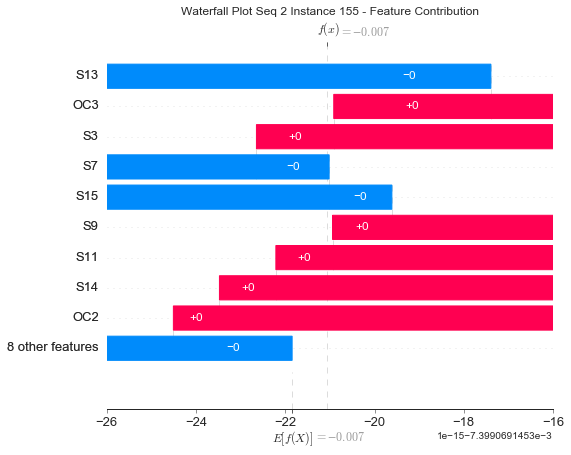

None

Contribution: [ 3.43885382e-15  4.01501579e-15  5.71289799e-15 -8.44043292e-16
  1.02226056e-15 -8.16363208e-16 -1.89909467e-15  1.24479189e-15
  1.72411238e-15 -1.61091013e-15  7.50244014e-17 -3.67390080e-15
  2.21739567e-15 -1.95766509e-15 -1.89099385e-15  6.98467934e-17
 -1.13247267e-15]


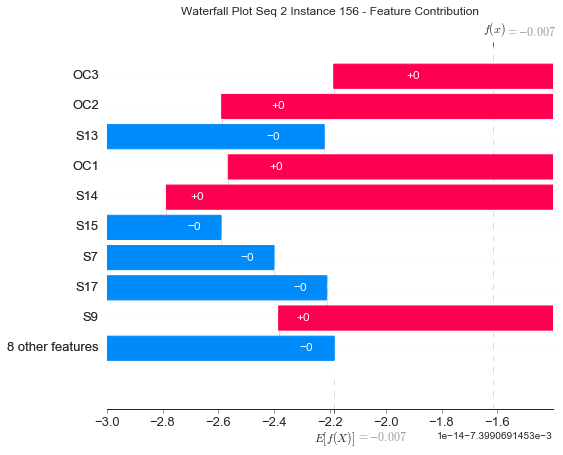

None

Contribution: [ 1.36410305e-15  2.66673564e-15  4.45734783e-15  2.91886749e-15
 -1.60461562e-15 -8.70833048e-15  4.68164586e-16  2.98493373e-15
  3.01978702e-15 -5.38857839e-15  4.44591458e-15 -1.90035590e-15
  1.14668282e-15 -4.24699440e-15 -5.38220320e-15  1.64176330e-15
  1.22093023e-15]


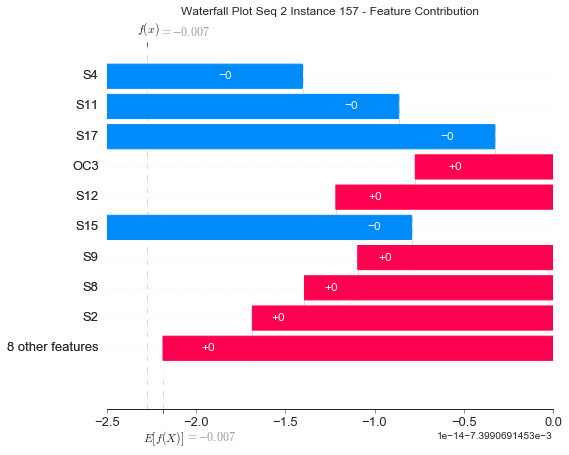

None

Contribution: [ 6.67124716e-15  7.64149842e-15  5.69929761e-15  2.07406182e-15
 -2.71881673e-15 -8.35080719e-15 -7.80407612e-16  6.29243370e-15
  2.99596422e-15 -9.11958870e-15  2.06395078e-15 -8.41542480e-16
  1.80753104e-15 -5.11030139e-15 -6.65509551e-15  7.16225755e-16
  5.56799755e-16]


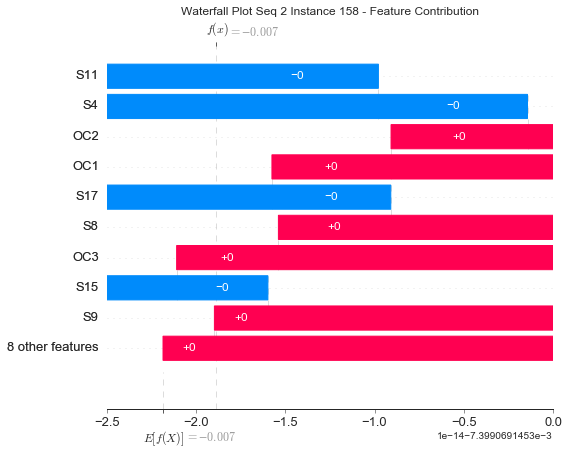

None

Contribution: [ 1.73600639e-14  1.55421279e-14  6.61820850e-15 -9.06128424e-16
 -2.68222470e-15 -4.30034689e-15 -2.49362752e-15  6.87056714e-15
  1.82410282e-15 -1.04335215e-14 -1.40454442e-15 -1.32262257e-15
  2.83829856e-15 -9.62283892e-15 -5.30516259e-15 -6.77049952e-16
 -1.65778652e-15]


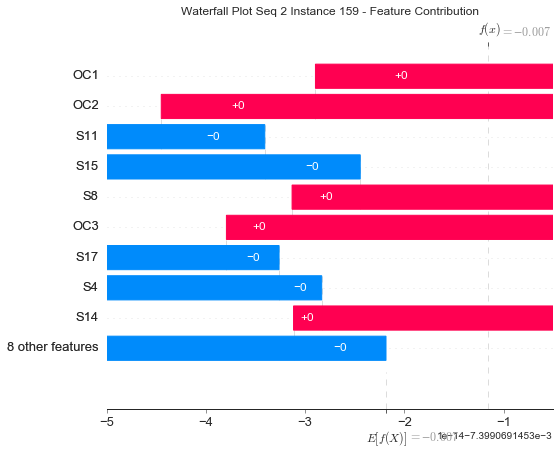

None

Contribution: [ 8.21014975e-15  7.11927635e-15  6.33358722e-15  1.32077915e-14
 -1.05508279e-14 -3.18568820e-14  4.38730032e-15  1.71130471e-14
  8.78092290e-15 -2.58035611e-14  1.32267405e-14  5.51761285e-15
  2.00823211e-15 -6.32791379e-15 -1.97361167e-14  6.19194679e-15
  5.95593843e-15]


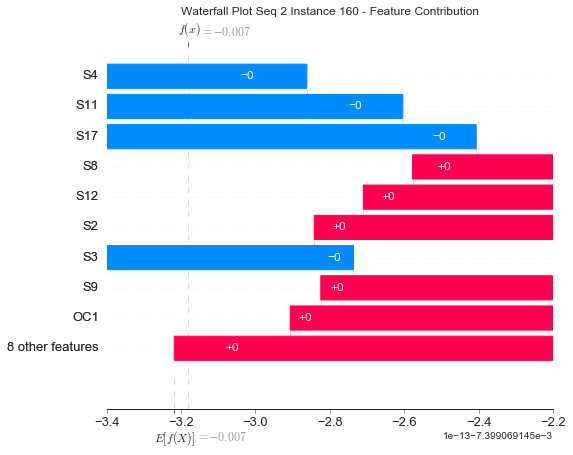

None

Contribution: [ 2.55764834e-14  2.41824196e-14  2.59450575e-15  3.55623056e-15
 -8.48835349e-15 -1.39810767e-14 -1.93264358e-16  1.38595614e-14
  2.62313081e-15 -2.02326271e-14  1.07895639e-15  6.02109474e-15
  2.27535835e-15 -1.64932866e-14 -1.14850290e-14  2.62506575e-16
  7.26123017e-16]


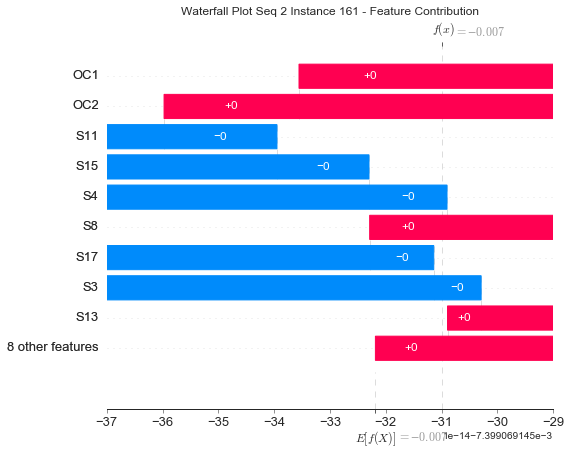

None

Contribution: [ 2.34595533e-14  2.53067356e-14  3.35371451e-15  4.30621090e-15
 -6.07579571e-15 -1.44459352e-14 -1.03010154e-15  8.77218576e-15
  3.70793204e-15 -1.38140028e-14  3.37140056e-15  2.69801042e-15
  1.55352375e-15 -3.49870889e-14 -1.01118285e-14  1.07207658e-15
  1.50801828e-15]


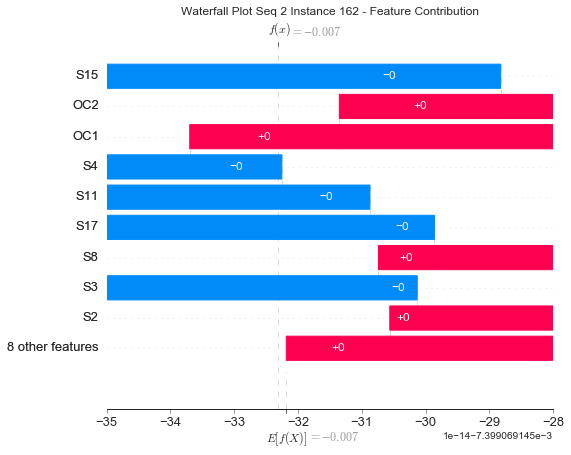

None

Contribution: [ 2.79302795e-14  2.76078463e-14  5.37020837e-15  8.53789221e-15
 -1.15027913e-14 -2.49665180e-14  2.68944989e-15  1.45098980e-14
  4.90823956e-15 -2.37846191e-14  6.75164499e-15  5.41302461e-15
  1.83441798e-15 -3.58170084e-14 -1.64224306e-14  2.63514279e-15
  4.25970667e-15]


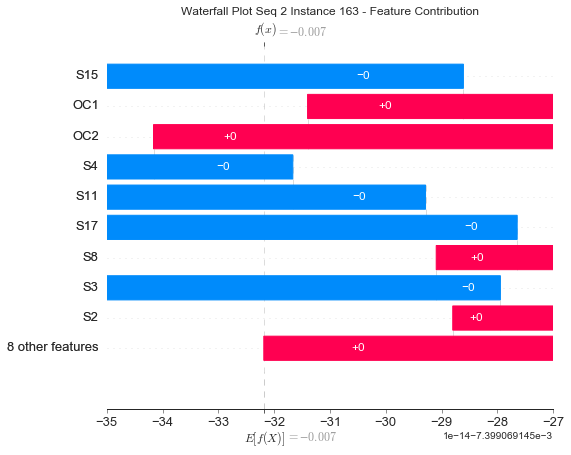

None

Contribution: [ 2.15863128e-14  2.33952685e-14  2.07857925e-15  2.92484068e-14
 -2.53922876e-14 -5.74265096e-14  1.00781132e-14  3.65364985e-14
  1.34377550e-14 -5.02462113e-14  1.84919439e-14  2.24770357e-14
  2.83847570e-16 -2.76385055e-14 -3.49639039e-14  8.05070512e-15
  1.32723981e-14]


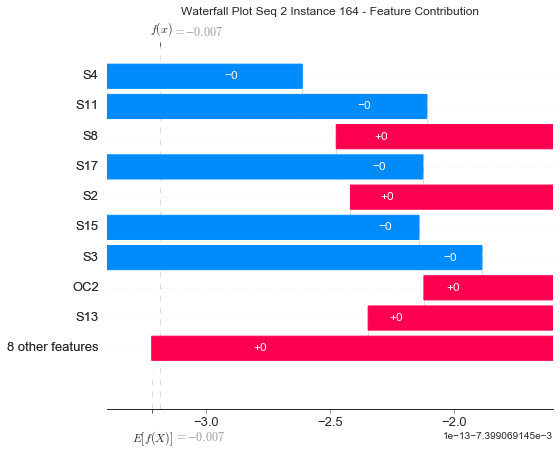

None

Contribution: [ 4.02667876e-14  3.32764076e-14  2.89852959e-15  1.90691934e-14
 -2.44605056e-14 -5.12674450e-14  5.71693665e-15  3.66596639e-14
  1.10148978e-14 -5.38601248e-14  1.43458565e-14  2.05887790e-14
  1.68269342e-15 -2.40718683e-14 -3.47500654e-14  5.99096154e-15
  8.24142814e-15]


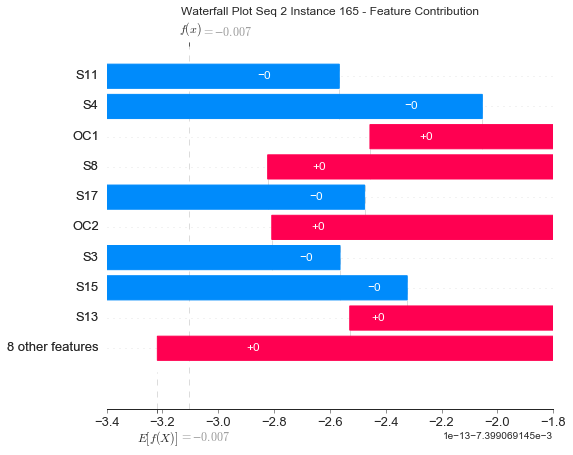

None

Contribution: [ 4.73947901e-14  4.64632164e-14  3.39901870e-15  4.81907071e-15
 -1.25417026e-14 -1.99552424e-14  8.53606611e-16  1.25499332e-14
  2.76860321e-15 -2.25671210e-14  2.36828972e-15  4.35103842e-15
  1.42517719e-15 -6.67045900e-14 -1.45616195e-14  6.10044034e-16
  2.79012187e-15]


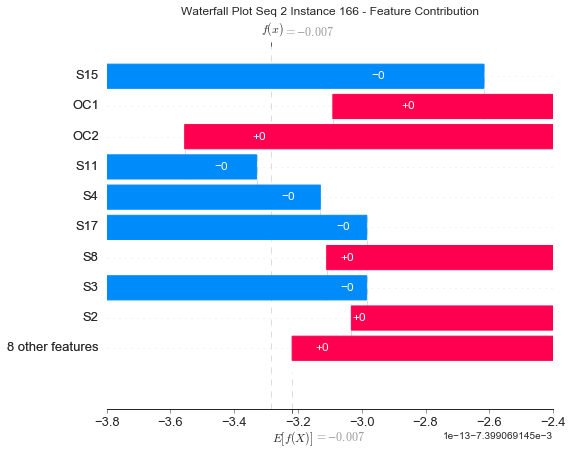

None

Contribution: [ 4.12295117e-14  4.05923227e-14 -4.21908487e-16  3.21642093e-14
 -3.37443933e-14 -6.45585202e-14  1.23603435e-14  4.51624144e-14
  1.29239338e-14 -6.38594876e-14  1.82214236e-14  2.96700259e-14
 -9.13247524e-16 -4.34143213e-14 -4.06367275e-14  7.76431311e-15
  1.50407234e-14]


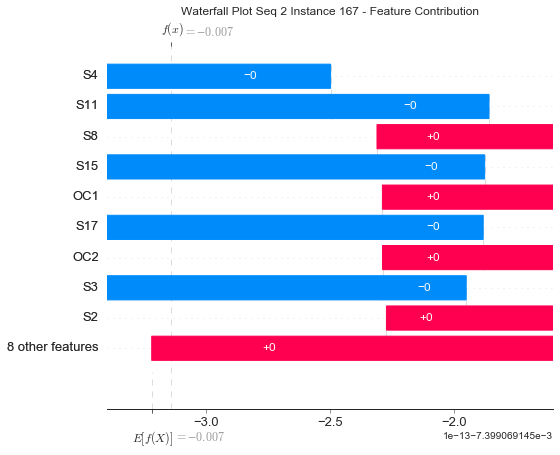

None

Contribution: [ 5.17391068e-14  4.31771962e-14 -2.89212782e-16  3.03259750e-14
 -3.72264475e-14 -7.22671096e-14  1.23534038e-14  5.09199650e-14
  1.33575486e-14 -7.59062138e-14  1.81411706e-14  3.49142780e-14
 -9.13966444e-16 -3.77758534e-14 -4.46629699e-14  8.16857907e-15
  1.46993454e-14]


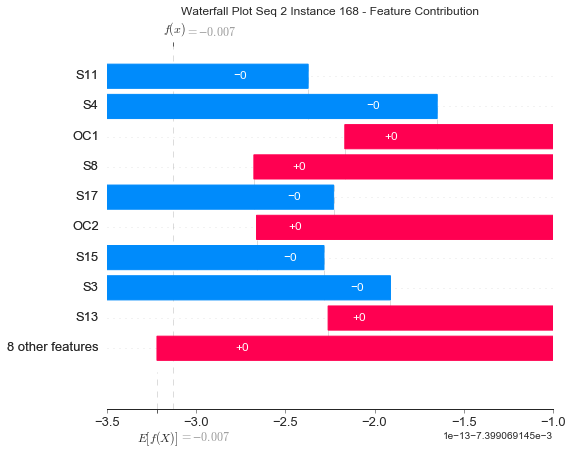

None

Contribution: [ 4.42612018e-14  3.32096817e-14 -3.76328226e-15  4.54078981e-14
 -5.03800289e-14 -1.06852332e-13  2.16430809e-14  6.46695154e-14
  2.00490056e-14 -9.78177161e-14  3.56834686e-14  4.71954188e-14
 -2.29741149e-15 -2.77574781e-14 -6.20186614e-14  1.53988862e-14
  2.34917015e-14]


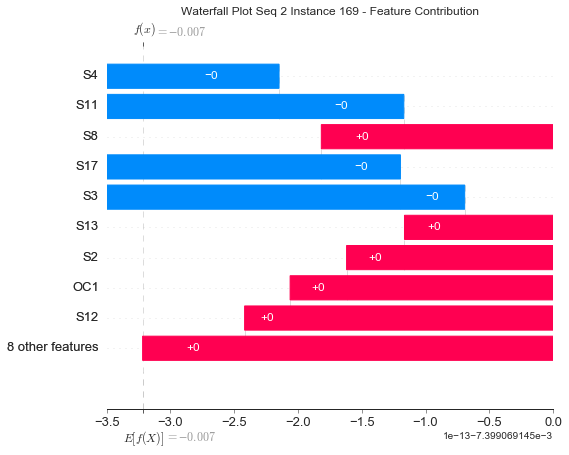

None

Contribution: [ 5.81124233e-14  5.17323848e-14 -2.60559257e-15  2.90727491e-14
 -3.83524457e-14 -7.19261957e-14  1.67321330e-14  4.40265737e-14
  9.76879879e-15 -7.01847570e-14  2.08015588e-14  2.98108028e-14
 -9.01415851e-16 -6.29305229e-14 -4.25810950e-14  9.23886788e-15
  1.67146468e-14]


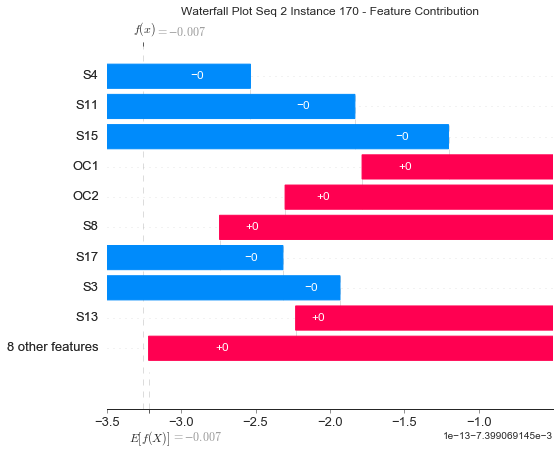

None

Contribution: [ 6.66081028e-14  5.45545529e-14 -9.51525557e-15  2.88112870e-14
 -4.26774298e-14 -7.46888106e-14  1.40792241e-14  5.36502537e-14
  9.75302535e-15 -8.12019045e-14  1.63032463e-14  4.54082979e-14
 -2.64901190e-15 -5.70504337e-14 -4.42846579e-14  7.04680717e-15
  1.56564757e-14]


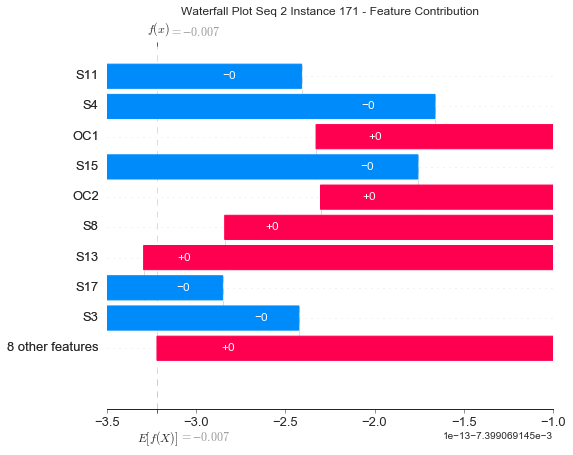

None

Contribution: [ 4.25577711e-14  4.44088295e-14 -1.42606975e-14  7.90152245e-14
 -6.79270821e-14 -1.26739060e-13  3.35686001e-14  8.64149450e-14
  2.56321115e-14 -1.16355561e-13  4.43904760e-14  6.71653217e-14
 -5.12024725e-15 -5.63360665e-14 -7.81604734e-14  1.95589123e-14
  3.55467371e-14]


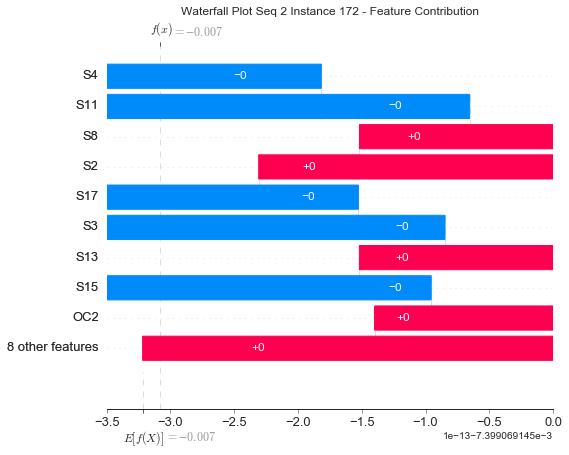

None

Contribution: [ 7.43599586e-14  5.94100574e-14 -1.42655358e-14  3.03275742e-14
 -4.52206936e-14 -7.65569113e-14  1.62315551e-14  5.64116116e-14
  9.39701994e-15 -8.47220514e-14  1.58051537e-14  4.82468544e-14
 -3.04337816e-15 -6.16003356e-14 -4.56380776e-14  6.92925213e-15
  1.65568531e-14]


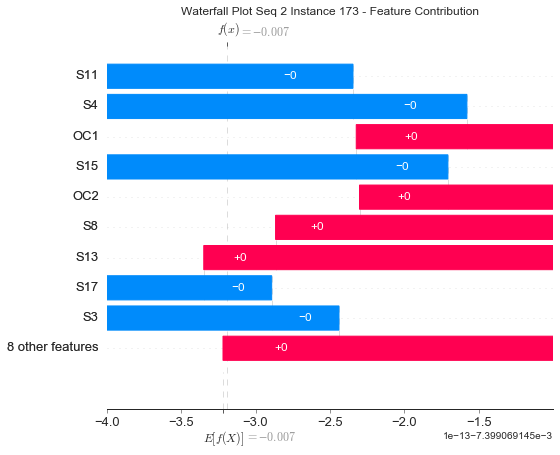

None

Contribution: [ 7.04146485e-14  5.83570667e-14 -2.60431020e-14  2.67334135e-14
 -4.17437691e-14 -6.39521937e-14  1.66016594e-14  4.63841070e-14
  4.47717645e-15 -7.00438852e-14  1.39179033e-14  5.36846094e-14
 -6.16915907e-15 -8.00503869e-14 -3.76450580e-14  6.26136707e-15
  1.66958952e-14]


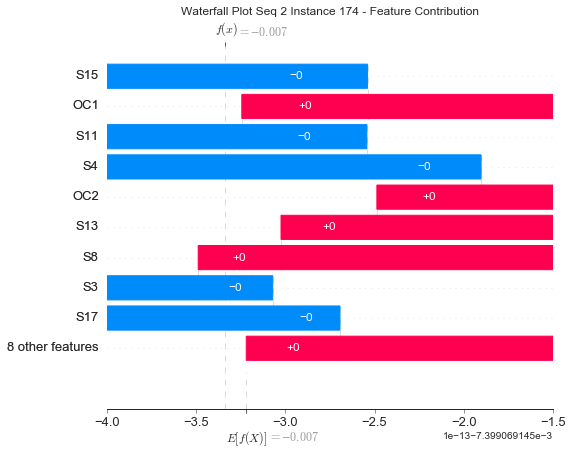

None

Contribution: [ 5.13302474e-14  4.35960946e-14 -1.48451215e-14  3.67677080e-14
 -3.82364598e-14 -7.00214355e-14  2.35252457e-14  3.56064733e-14
  7.07696874e-15 -5.73884812e-14  2.33394491e-14  3.55175687e-14
 -6.03890276e-15 -9.48462093e-14 -3.56250064e-14  9.95568730e-15
  2.25562384e-14]


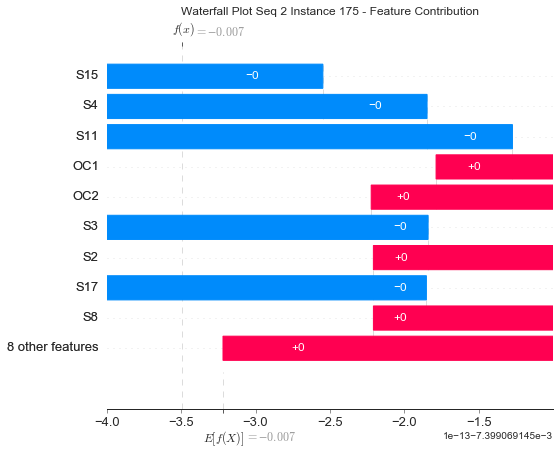

None

Contribution: [ 3.52453899e-14  1.81513502e-14 -3.82296259e-14  6.52397990e-14
 -6.97189295e-14 -1.27664521e-13  4.06300292e-14  7.55474513e-14
  1.41859748e-14 -1.12632194e-13  4.49083418e-14  8.10253557e-14
 -1.34823581e-14 -3.11116015e-14 -6.96328642e-14  1.86562683e-14
  3.60705423e-14]


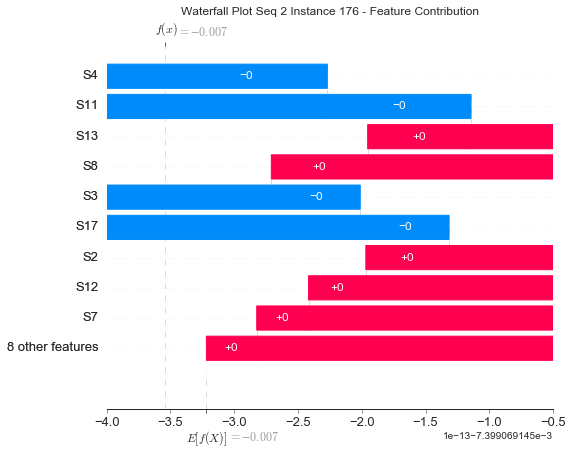

None

Contribution: [ 6.70246465e-14  3.71198874e-14 -2.71001737e-14  1.37269439e-14
 -3.17725785e-14 -3.78594894e-14  4.79251284e-15  4.48541181e-14
  2.54330176e-15 -6.15413346e-14  3.19710257e-15  5.26419186e-14
 -6.49050643e-15 -4.95403448e-14 -2.84664734e-14  1.22123400e-15
  6.71746297e-15]


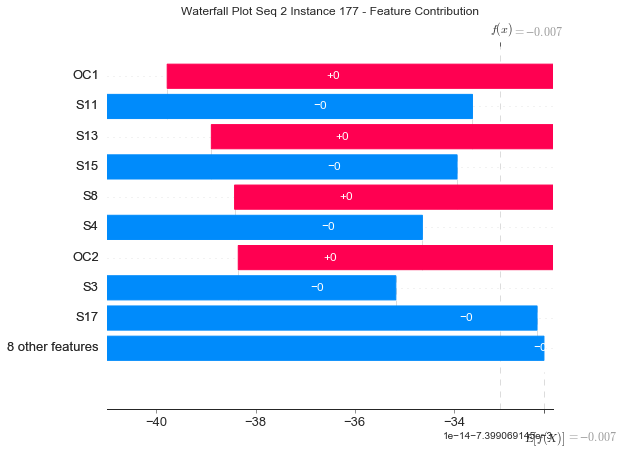

None

Contribution: [ 5.25841645e-14  1.85276904e-14 -3.25574291e-14  2.04867776e-14
 -3.65301830e-14 -5.23555605e-14  1.61394047e-14  4.33169837e-14
  8.12506190e-16 -6.61694685e-14  9.34767434e-15  5.48273619e-14
 -1.02902509e-14 -2.01471310e-14 -2.90615784e-14  4.94616546e-15
  1.25410860e-14]


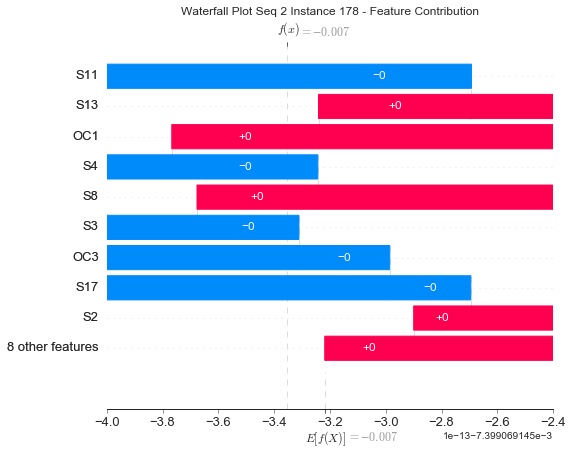

None

Contribution: [ 3.36695461e-14 -2.20295249e-15 -6.22252426e-14  1.23798431e-14
 -3.21652122e-14 -2.85877957e-14  1.46006068e-14  2.67043874e-14
 -1.12905833e-14 -4.35003189e-14  1.23070541e-15  7.20340468e-14
 -1.87934554e-14 -1.60273609e-14 -6.91688036e-15  1.11521639e-15
  8.88248131e-15]


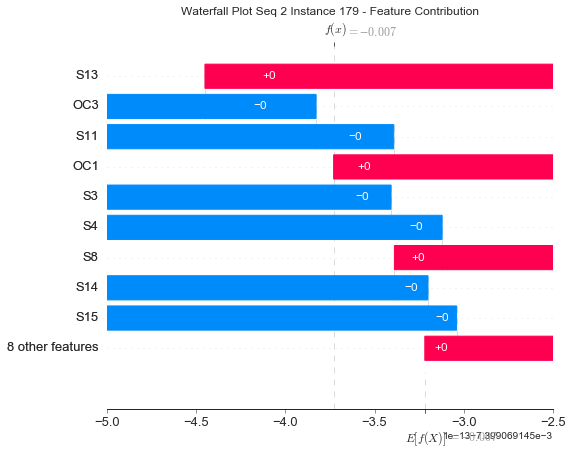

None

Contribution: [-1.51721202e-14 -3.66220014e-14 -5.72409077e-14  3.86222087e-14
 -3.25177371e-14 -4.20113502e-14  1.94300210e-14  3.38863560e-14
  2.35171667e-15 -3.79313009e-14  1.66613600e-14  6.91388475e-14
 -1.97634098e-14  3.36840100e-15 -1.88875201e-14  8.11734628e-15
  1.82265651e-14]


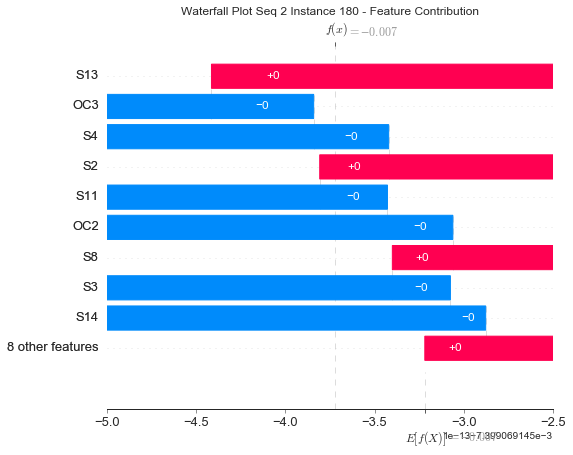

None

Contribution: [ 5.62273430e-15 -3.39027343e-14 -5.04375018e-14 -9.26415435e-15
 -1.22077226e-14  2.58483302e-14  1.33471267e-14  3.72336456e-15
 -2.34593737e-14 -4.23683805e-15 -2.04917141e-14  4.25534851e-14
 -1.48788842e-14  4.21333670e-14  1.94413069e-14 -6.99796810e-15
 -2.41738730e-16]


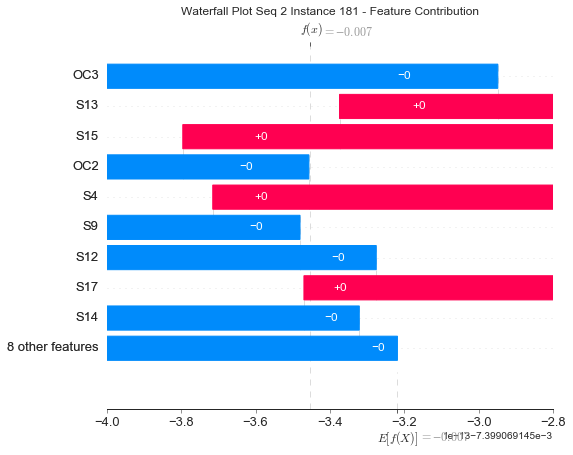

None

Contribution: [-5.21123536e-14 -8.73568728e-14 -1.98774713e-14 -2.28310108e-16
  5.61119093e-15  1.33780951e-14  7.60643295e-15 -5.88531790e-15
 -4.09226816e-15  1.52369725e-14  7.52056731e-16  1.62677455e-14
 -8.80398168e-15  9.31156465e-14  1.31028755e-14  2.48852160e-15
  2.62214994e-15]


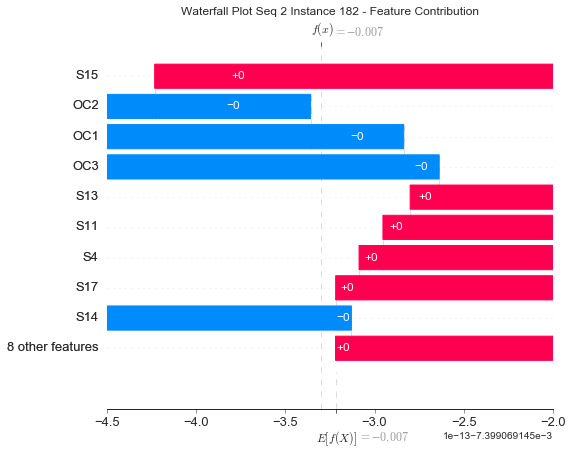

None

Contribution: [-2.02817194e-14 -4.07941740e-14 -9.26093783e-14 -9.68349953e-14
  6.47549167e-14  2.31143663e-13 -2.80325046e-14 -1.05456964e-13
 -6.85149230e-14  1.63839225e-13 -1.00582947e-13  5.18901743e-15
 -1.82805973e-14  3.09525998e-14  1.46340622e-13 -3.97166973e-14
 -4.40875601e-14]


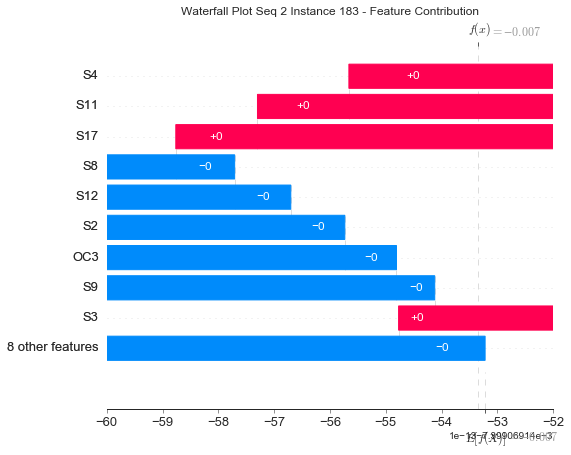

None

Contribution: [-1.21611773e-13 -1.60020678e-13 -1.02021981e-13 -9.07763041e-14
  7.72250170e-14  1.83895190e-13 -1.63049472e-14 -1.35217616e-13
 -6.16151959e-14  1.86427059e-13 -5.19065415e-14 -3.95066924e-15
 -2.71702149e-14  1.23110804e-13  1.34064147e-13 -2.13661655e-14
 -3.25418200e-14]


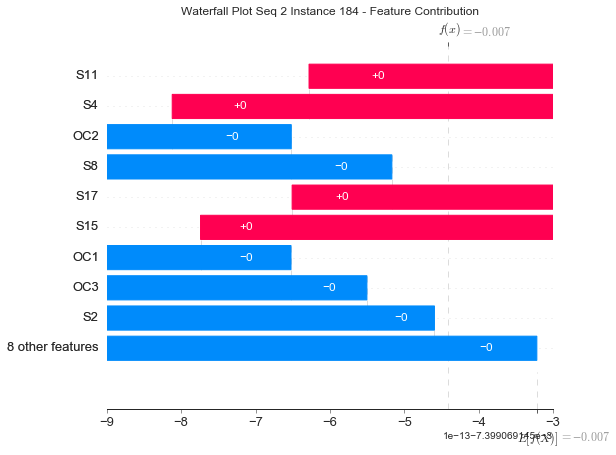

None

Contribution: [-1.70168065e-13 -1.64561127e-13 -1.13574480e-13 -9.46813564e-14
  9.93201696e-14  2.80138624e-13 -1.42866879e-14 -1.78789668e-13
 -7.99650534e-14  2.63056341e-13 -7.76929451e-14 -3.74390765e-14
 -3.53151211e-14  1.14707289e-13  1.81984717e-13 -3.15362462e-14
 -3.79737271e-14]


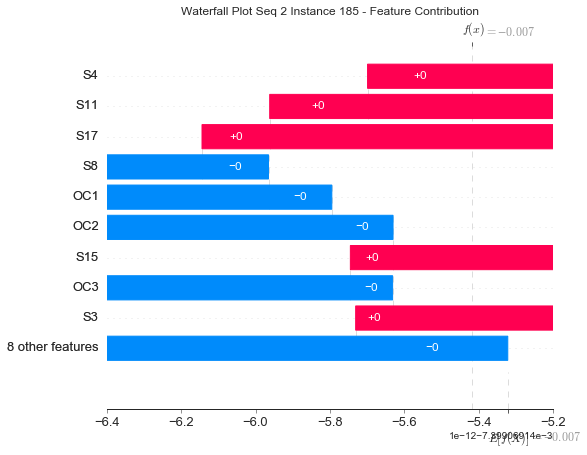

None

Contribution: [-1.56479525e-13 -1.43830667e-13 -1.12440012e-13 -2.12890388e-13
  1.96018847e-13  5.20025754e-13 -9.37358643e-14 -2.70702460e-13
 -1.26356242e-13  4.21779040e-13 -2.10299849e-13 -9.23964681e-14
 -2.79415739e-14  1.13681329e-13  3.08760558e-13 -9.29481915e-14
 -1.07348002e-13]


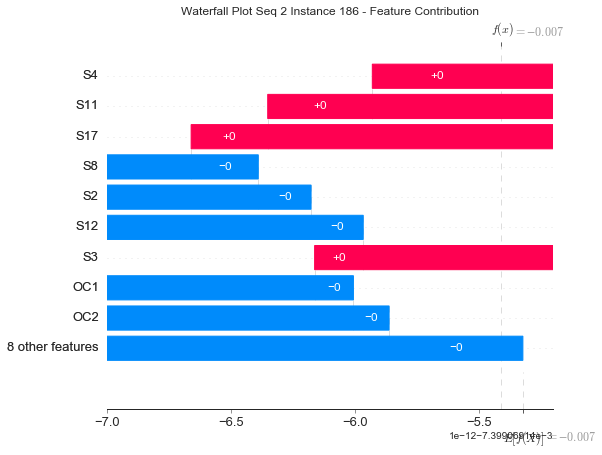

None

Contribution: [-1.29819495e-13 -1.39414251e-13 -7.33542865e-14 -3.20538572e-13
  2.80567534e-13  7.15922601e-13 -1.37946674e-13 -3.95195297e-13
 -1.68158307e-13  5.61723411e-13 -2.75140506e-13 -2.10467481e-13
 -2.17719722e-14  1.39062834e-13  4.15095855e-13 -1.29031700e-13
 -1.66422201e-13]


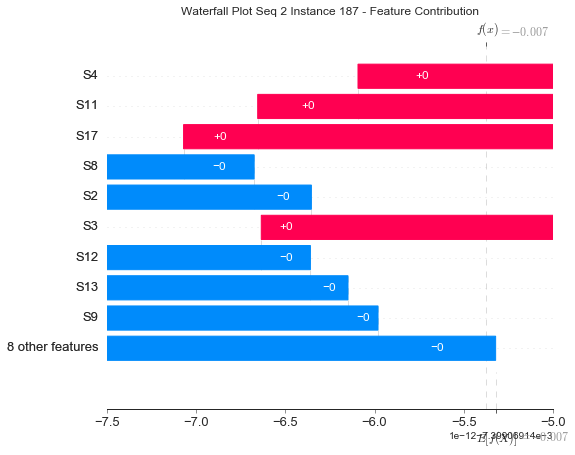

None

Contribution: [-5.20725390e-13 -4.88985588e-13 -7.98854391e-14 -6.63133624e-14
  1.56679845e-13  2.69067131e-13 -5.89855025e-15 -2.38304222e-13
 -4.97555725e-14  3.71318102e-13 -2.18924017e-14 -8.12906396e-14
 -4.54342205e-14  4.03281466e-13  2.07104041e-13 -7.81245084e-15
 -1.82975668e-14]


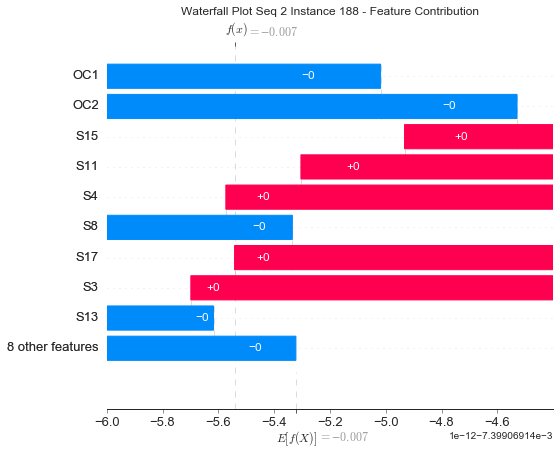

None

Contribution: [-5.26385522e-13 -5.37873836e-13 -5.74650801e-14 -4.13626144e-14
  1.19545690e-13  2.08544919e-13  6.34986042e-15 -1.34145706e-13
 -3.21312428e-14  2.40752432e-13 -1.22927240e-14 -2.84542050e-14
 -2.46466784e-14  7.25357057e-13  1.45237826e-13  1.35737697e-15
 -1.86911643e-14]


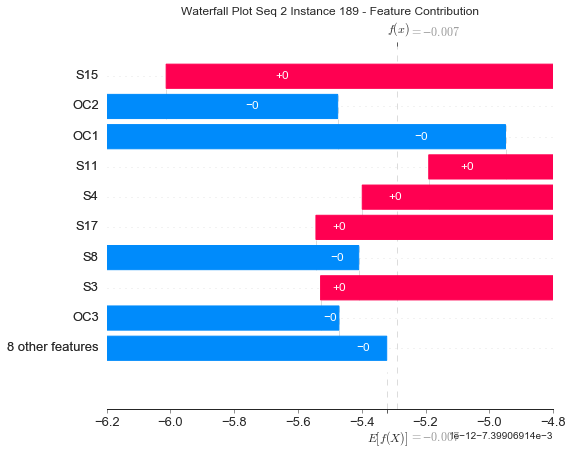

None

Contribution: [-3.23209477e-13 -3.29039638e-13 -7.75382362e-14 -5.61935318e-13
  5.04420128e-13  1.16281767e-12 -2.57458144e-13 -6.61901306e-13
 -2.51561087e-13  9.67991204e-13 -4.41388110e-13 -3.60048742e-13
 -1.69517233e-15  3.12836345e-13  7.00280329e-13 -1.94294098e-13
 -2.75335256e-13]


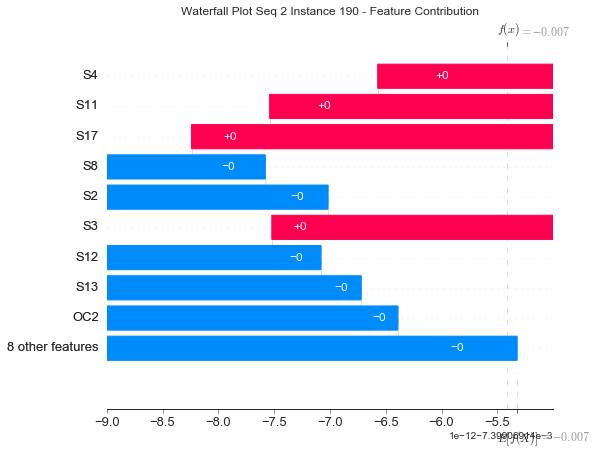

None

Contribution: [-5.75901523e-13 -5.30261436e-13 -4.14501570e-14 -3.19584149e-13
  3.83805753e-13  7.92481098e-13 -1.30394041e-13 -5.23648128e-13
 -1.55303870e-13  7.87875028e-13 -2.11747585e-13 -3.09125094e-13
 -1.07454058e-14  5.35381743e-13  4.93266669e-13 -9.06754598e-14
 -1.57610090e-13]


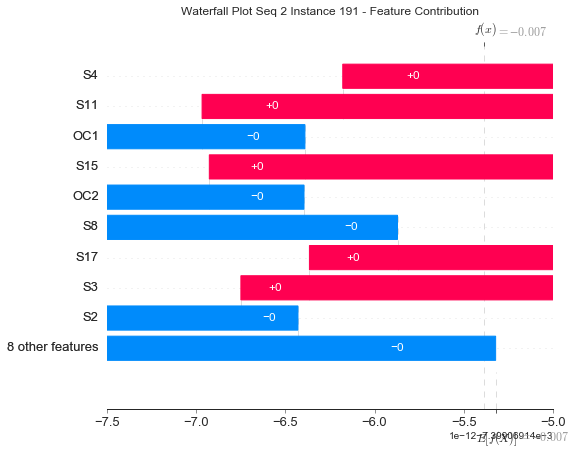

None

Contribution: [-8.24144138e-13 -7.70538581e-13 -1.26851154e-14 -1.30788175e-13
  2.80814055e-13  4.51192116e-13 -1.51613680e-14 -3.88949533e-13
 -6.97126005e-14  5.90494071e-13 -4.89142113e-14 -2.26769246e-13
 -2.42600214e-14  8.65279636e-13  3.39179070e-13 -1.45711571e-14
 -5.75531850e-14]


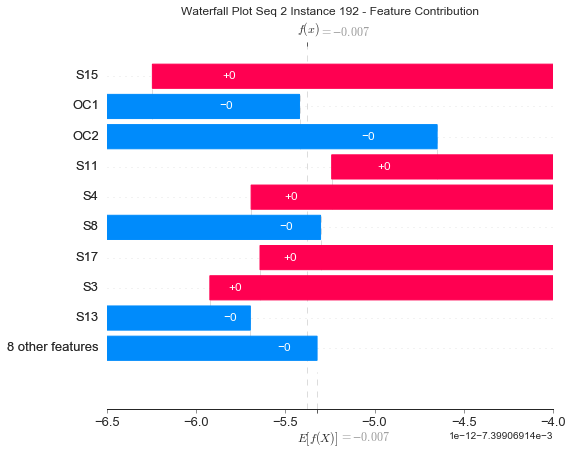

None

Contribution: [-8.21280544e-13 -6.41468595e-13 -1.33352285e-14 -4.15441959e-13
  5.54142669e-13  1.15201978e-12 -1.61774565e-13 -7.80691809e-13
 -2.12560695e-13  1.18045536e-12 -3.16870797e-13 -5.21674988e-13
 -2.34731007e-14  4.84540956e-13  7.21121080e-13 -1.46594393e-13
 -2.02324499e-13]


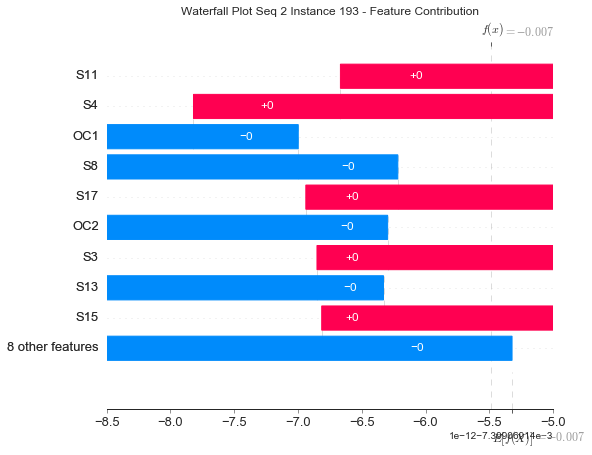

None

Contribution: [-8.09420835e-13 -7.61471019e-13  5.13751774e-14 -5.12894794e-13
  6.02845790e-13  1.10207503e-12 -2.02577091e-13 -7.85125112e-13
 -2.00528884e-13  1.11451245e-12 -3.21715121e-13 -5.88137178e-13
 -2.62658818e-15  8.25894637e-13  6.92659905e-13 -1.37736136e-13
 -2.47145430e-13]


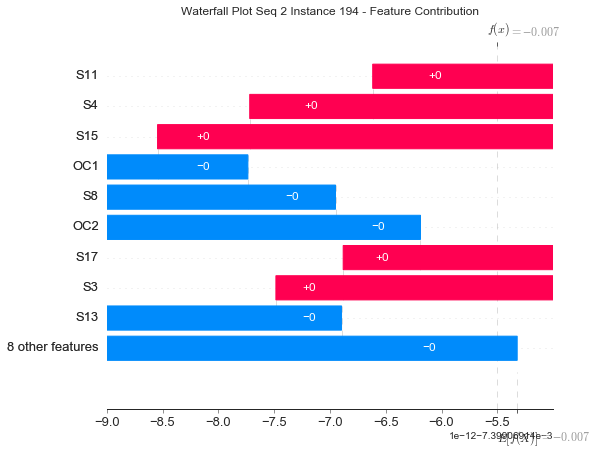

None

Contribution: [-5.61987089e-13 -5.20441329e-13  6.41554409e-14 -1.08271454e-12
  1.00373171e-12  2.16640356e-12 -5.62038859e-13 -1.24136964e-12
 -4.00516073e-13  1.81408881e-12 -7.50455904e-13 -8.74040261e-13
  2.17039894e-14  4.98694944e-13  1.18009845e-12 -3.48237932e-13
 -5.29461945e-13]


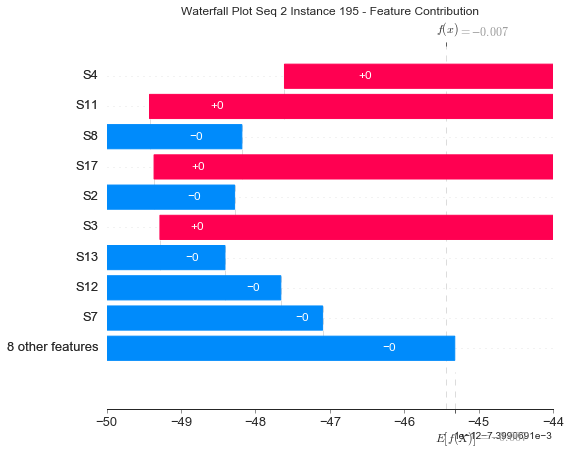

None

Contribution: [-8.83365538e-13 -9.05094034e-13  1.88876878e-14 -3.82918577e-13
  4.04697841e-13  8.50113111e-13 -1.92400783e-13 -3.70125886e-13
 -1.33837887e-13  6.50318395e-13 -2.81829708e-13 -2.71637557e-13
  1.91035610e-14  1.73212779e-12  4.68029695e-13 -1.13152075e-13
 -2.27766780e-13]


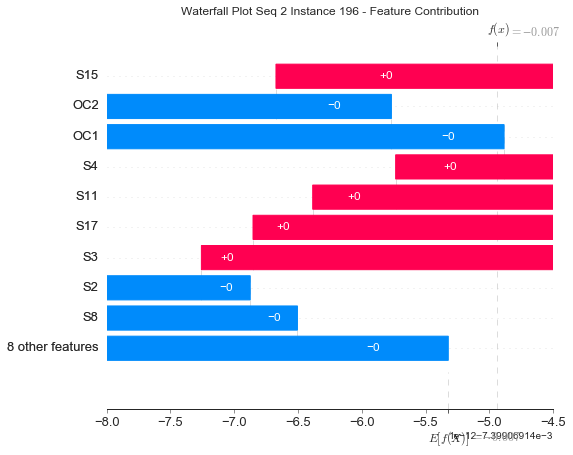

None

Contribution: [-9.00027936e-13 -8.31536229e-13  3.92050487e-14 -6.61882495e-13
  6.73351837e-13  1.31322286e-12 -3.00689784e-13 -8.03789056e-13
 -2.47282284e-13  1.20019641e-12 -4.38597373e-13 -5.73096529e-13
  3.89196494e-14  1.31936779e-12  7.97045915e-13 -1.81870320e-13
 -3.41843605e-13]


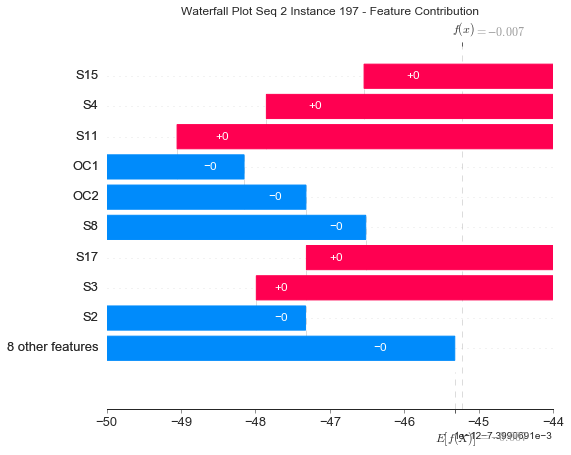

None

Contribution: [-7.72949359e-13 -6.24560137e-13  9.84663807e-14 -7.31115743e-13
  7.96792916e-13  1.69424002e-12 -3.93919164e-13 -8.93376735e-13
 -2.72605397e-13  1.40161504e-12 -5.76662687e-13 -6.77496633e-13
  7.14889370e-14  1.13504215e-12  9.51438255e-13 -2.42661278e-13
 -4.29444864e-13]


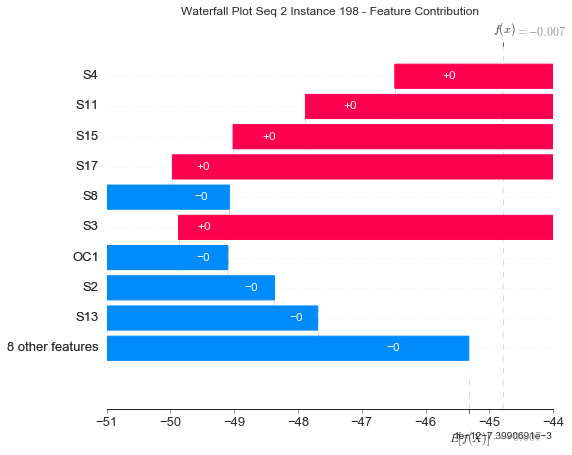

None

Contribution: [-1.47605235e-12 -1.05775382e-12  3.89121488e-13 -2.27266597e-13
  6.33120347e-13  7.88033213e-13 -5.23443051e-14 -8.72590249e-13
 -6.36015763e-14  1.25549929e-12 -4.03905899e-14 -9.07734120e-13
  7.56229999e-14  1.03899896e-12  5.88334394e-13 -1.58615271e-14
 -9.49092421e-14]


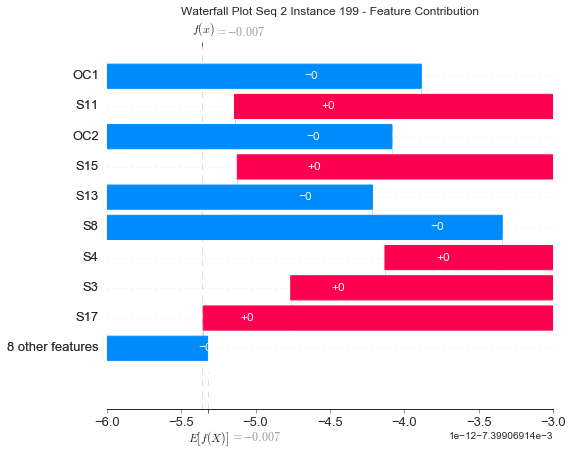

None

Contribution: [-8.55911316e-13 -7.13604902e-13  5.20304015e-13 -1.00365734e-12
  1.06434956e-12  1.73098428e-12 -4.67025940e-13 -1.27481749e-12
 -2.29425718e-13  1.74773618e-12 -4.83186624e-13 -1.23980513e-12
  1.63978030e-13  8.72761986e-13  1.04084775e-12 -2.10529389e-13
 -4.74711687e-13]


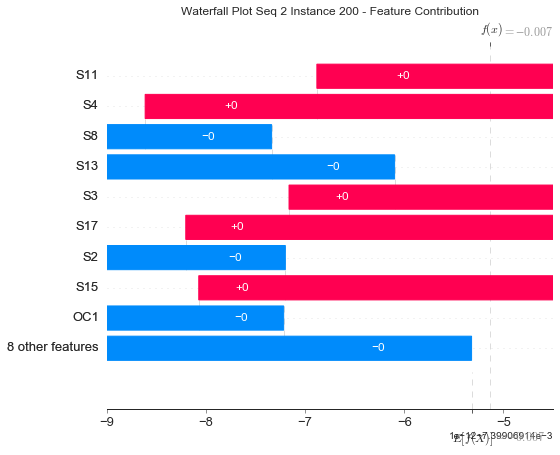

None

Contribution: [-1.23743160e-12 -8.09704463e-13  5.99300557e-13 -3.94026391e-13
  6.98335107e-13  9.38840585e-13 -1.12639641e-13 -8.98403368e-13
 -6.64826945e-14  1.28557907e-12 -1.19611515e-13 -1.09473541e-12
  1.55469902e-13  9.16825752e-13  6.10845576e-13 -4.85276458e-14
 -1.44874279e-13]


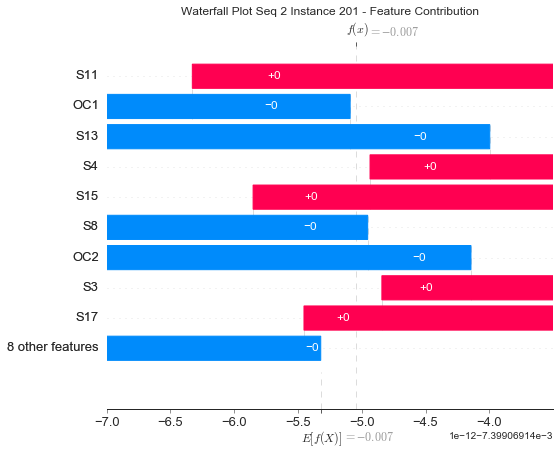

None

Contribution: [-6.53598378e-13 -5.65646813e-13  7.13678465e-13 -9.70116132e-13
  1.10903311e-12  1.61077369e-12 -7.02823325e-13 -1.07744423e-12
 -3.17721178e-14  1.59867800e-12 -4.15715205e-13 -1.25529741e-12
  2.68941472e-13  6.45458676e-13  8.31489283e-13 -1.87618286e-13
 -5.41844727e-13]


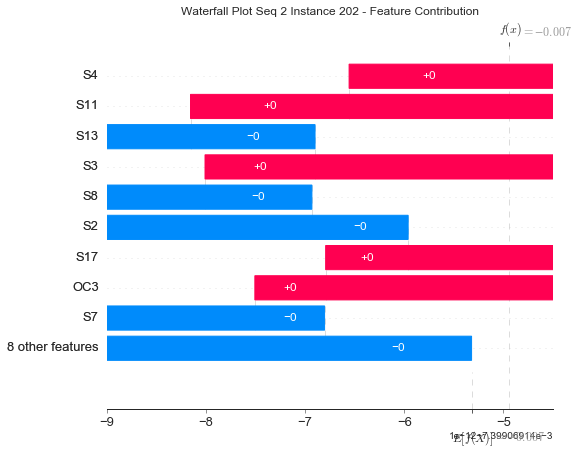

None

Contribution: [-3.46643341e-13 -1.75522059e-13  8.05344506e-13 -8.65987891e-13
  1.06644674e-12  1.63338613e-12 -7.78815272e-13 -9.10608177e-13
  4.08833496e-14  1.49031601e-12 -4.49964908e-13 -1.25201737e-12
  3.22206129e-13  2.46380011e-13  7.17873515e-13 -1.93186111e-13
 -5.66187722e-13]


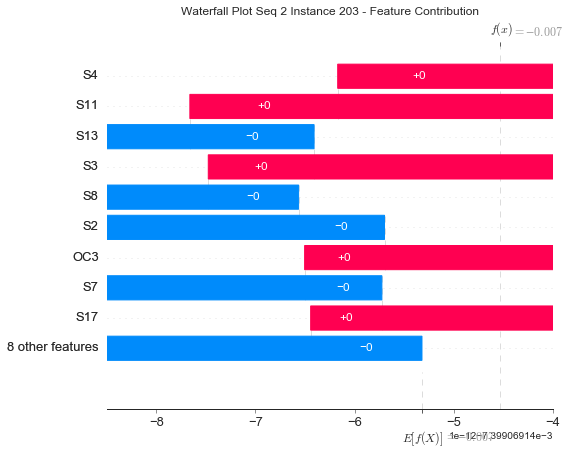

None

Contribution: [ 1.22485586e-13  3.96467337e-13  2.91510604e-13 -1.00498874e-12
  9.95756320e-13  2.00511352e-12 -8.34034827e-13 -9.35013351e-13
 -1.91548193e-13  1.48622640e-12 -7.96017603e-13 -9.00754677e-13
  1.86135056e-13 -2.74003151e-13  9.45781973e-13 -3.92571121e-13
 -6.69577458e-13]


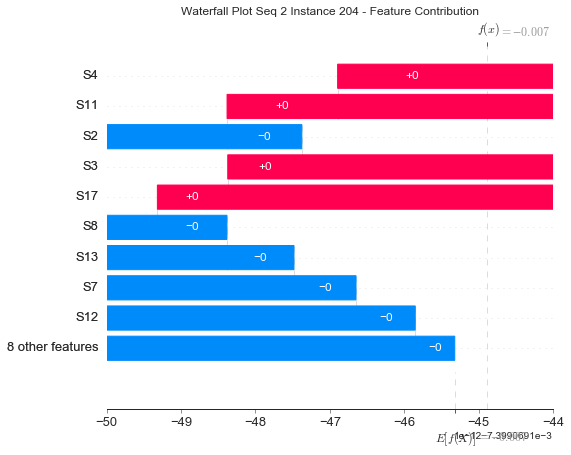

None

Contribution: [-5.21287007e-13 -1.81161889e-13  9.98657428e-13  7.70722123e-14
  3.01616506e-13 -3.36154932e-13 -1.70023148e-13 -1.42725268e-13
  3.75710124e-13  1.69109803e-13  4.42850590e-13 -9.85058606e-13
  2.53258027e-13  2.39341587e-13 -3.79197216e-13  1.46061033e-13
 -4.05601252e-14]


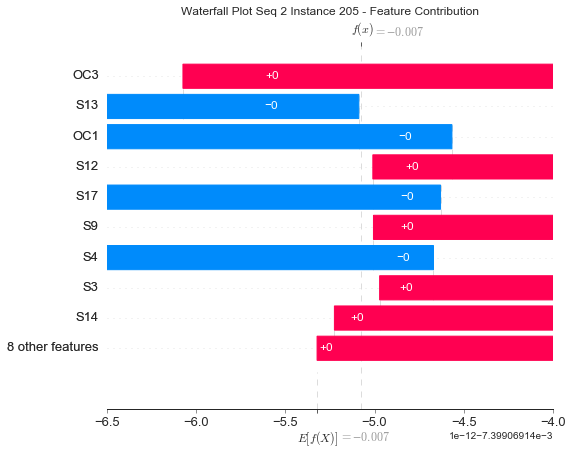

None

Contribution: [ 5.86949380e-13  7.56590591e-13  1.00472983e-12 -5.10047462e-13
  2.93449889e-13  3.27656847e-13 -2.62532698e-13 -1.59513516e-13
  1.74548147e-14  5.97441137e-14 -2.56855897e-13 -9.26472549e-13
  3.13964349e-13 -4.94793991e-14  6.41648532e-14 -1.18020651e-13
 -2.61274699e-13]


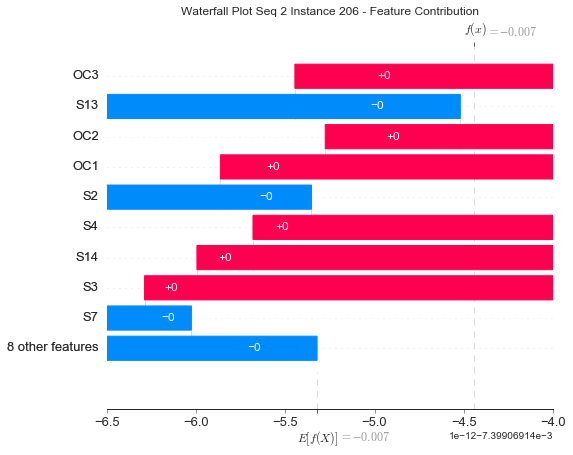

None

Contribution: [-2.71713777e-13 -6.09442916e-14  1.29996285e-12  9.24043502e-13
 -4.91968770e-13 -2.66978063e-12  2.97878231e-13  9.15342563e-13
  9.03526169e-13 -1.58248219e-12  1.46620042e-12 -4.25094123e-13
  2.69714562e-13  2.59913564e-13 -1.57193182e-12  6.11268523e-13
  4.94106709e-13]


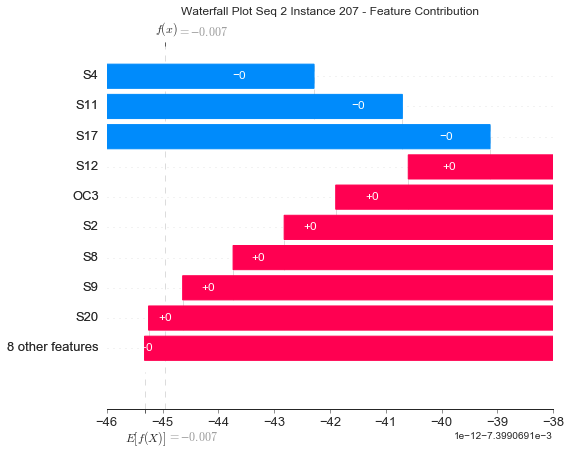

None

Contribution: [ 8.27625837e-13  1.02946373e-12  1.09908599e-12  7.39826494e-13
 -3.87031905e-13 -1.80093635e-12 -2.65427925e-13  1.22823615e-12
  8.84159445e-13 -1.55621859e-12  6.90885771e-13 -4.45569112e-14
  3.22049733e-13 -9.04553234e-13 -1.45557936e-12  2.35023454e-13
  1.42262382e-13]


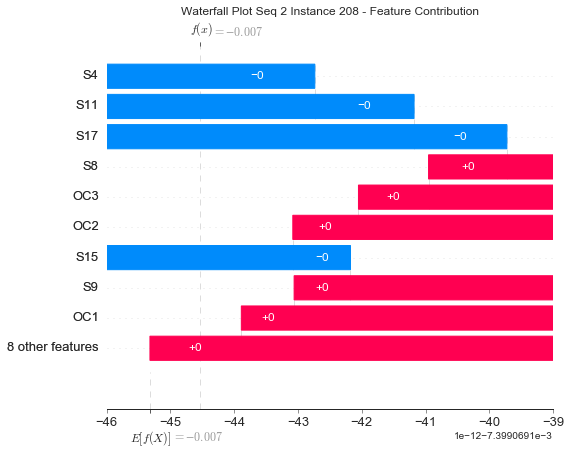

None

Contribution: [ 1.36399377e-12  1.67827612e-12  1.27760920e-12  9.39867975e-13
 -9.51770672e-13 -2.64245743e-12  3.39054956e-14  1.75587225e-12
  8.73952820e-13 -2.49734955e-12  8.69166772e-13 -1.22185411e-13
  3.85579562e-13 -1.30863181e-12 -1.97108671e-12  3.78036551e-13
  3.87747316e-13]


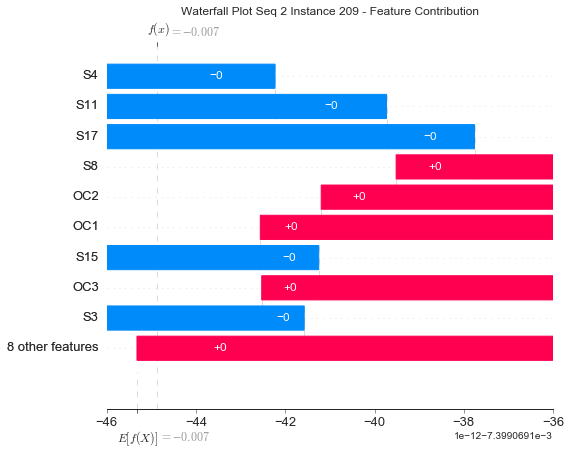

None

Contribution: [ 3.40579258e-12  3.13291970e-12  9.73670905e-13  2.71784114e-13
 -8.55041569e-13 -1.95430607e-12 -2.03331885e-13  1.61647507e-12
  5.30927732e-13 -2.65147192e-12  2.18303769e-13 -9.89561572e-15
  3.91209282e-13 -2.35408828e-12 -1.54614537e-12  4.33485408e-14
 -3.30824540e-14]


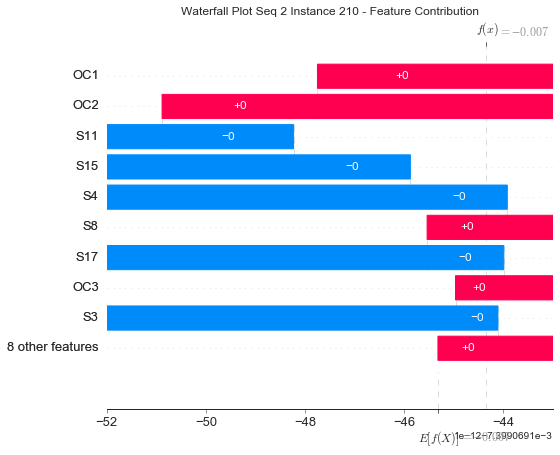

None

Contribution: [ 3.58359154e-12  4.02871573e-12  8.97981342e-13 -1.18669709e-13
 -3.38999770e-13 -9.00918446e-13 -3.76912558e-13  4.61684835e-13
  2.40748068e-13 -1.22936524e-12 -5.52552355e-14 -6.01535748e-13
  2.75215126e-13 -5.96379239e-12 -7.98346903e-13 -9.87043631e-14
 -8.37985483e-14]


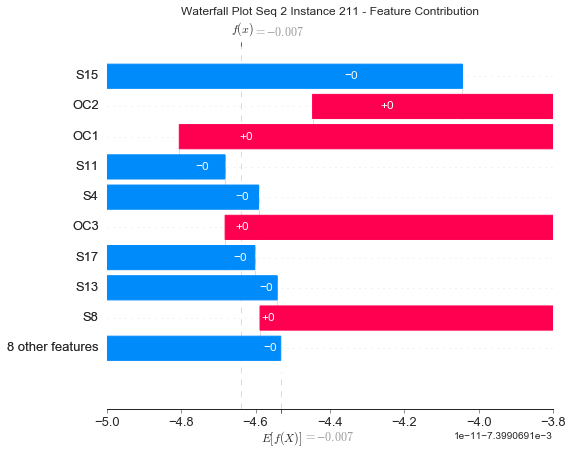

None

Contribution: [ 4.99420861e-12  4.86309604e-12  1.07266474e-12  4.94978407e-13
 -1.51625414e-12 -2.64907974e-12 -3.21206061e-13  2.73400898e-12
  6.29870342e-13 -3.90619481e-12  1.11760299e-13  6.98784617e-13
  3.29960722e-13 -4.28279157e-12 -2.28738122e-12 -2.39011827e-14
  1.02558234e-13]


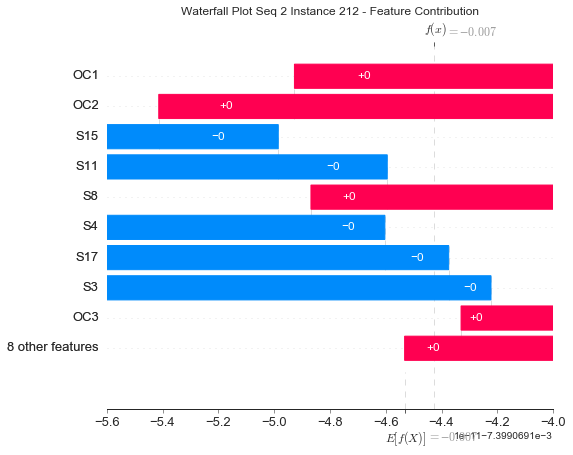

None

Contribution: [ 3.97918460e-12  3.54566463e-12  1.31068951e-12  3.38273051e-12
 -3.63607386e-12 -8.71859702e-12  1.10999469e-12  5.34869241e-12
  2.07179781e-12 -7.91254388e-12  2.71477806e-12  2.28805928e-12
  2.13856710e-13 -2.81359463e-12 -5.52564982e-12  1.12881568e-12
  1.59641180e-12]


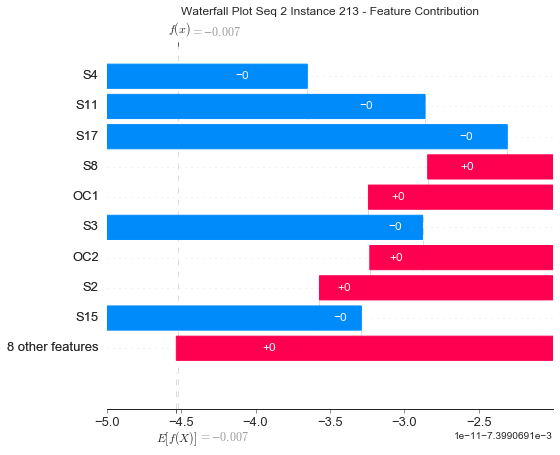

None

Contribution: [ 7.09737520e-12  6.22055879e-12  1.00311979e-12  1.98253848e-12
 -3.37180891e-12 -6.40597167e-12  5.32798198e-13  4.89897879e-12
  1.21893121e-12 -7.68593522e-12  1.40736674e-12  1.98793824e-12
  3.88851494e-13 -4.68707712e-12 -4.61451233e-12  6.32454755e-13
  8.04052734e-13]


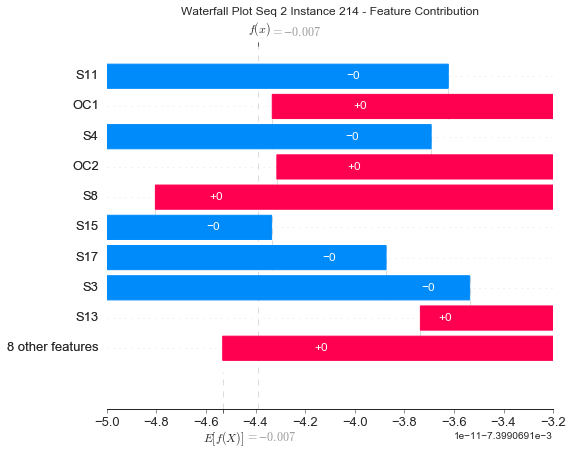

None

Contribution: [ 8.21964719e-12  7.25117405e-12  7.80777624e-13  2.07341826e-12
 -3.35223277e-12 -6.86406704e-12  5.11945195e-13  4.95685827e-12
  1.20330460e-12 -7.83111163e-12  1.18963368e-12  2.53278214e-12
  3.96468448e-13 -6.92436039e-12 -4.37168097e-12  4.93709023e-13
  8.17443010e-13]


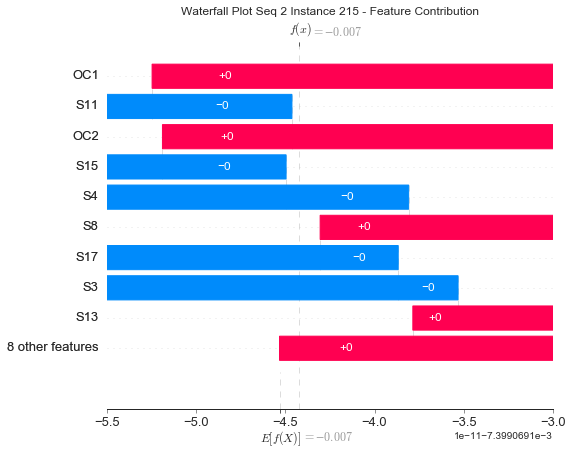

None

Contribution: [ 9.04613710e-12  8.83235238e-12  1.24003921e-12  3.71920029e-12
 -4.71684324e-12 -8.64713943e-12  6.96628085e-13  7.73962838e-12
  2.04395745e-12 -1.04182071e-11  1.78743869e-12  4.07112451e-12
  6.30515009e-13 -6.97093598e-12 -6.36511894e-12  8.14335036e-13
  1.49300234e-12]


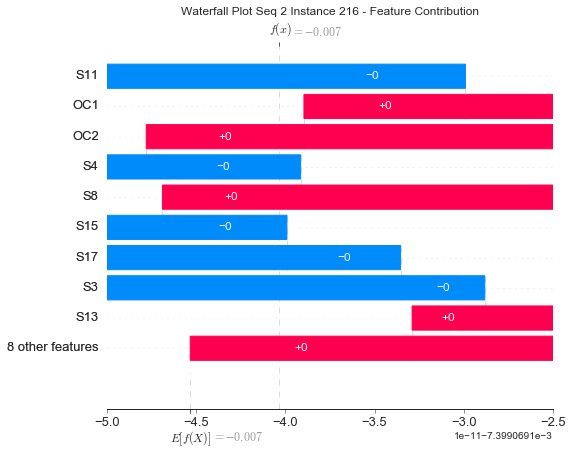

None

Contribution: [ 4.36475465e-12  3.86374179e-12  1.00846122e-12  9.65550990e-12
 -8.75175540e-12 -2.19959728e-11  4.82703200e-12  1.17228094e-11
  4.78092696e-12 -1.71752126e-11  8.20459759e-12  7.19005367e-12
  3.68562982e-13 -4.12413419e-12 -1.22258688e-11  4.13066803e-12
  5.39200152e-12]


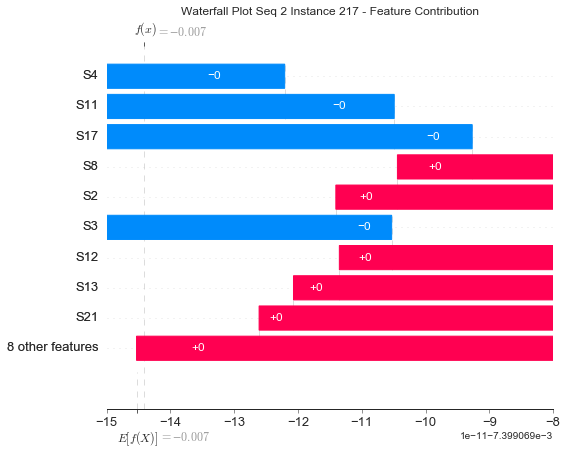

None

Contribution: [ 9.80357115e-12  1.04855820e-11  8.85956076e-13  3.53145009e-12
 -3.81998773e-12 -9.00130491e-12  1.04299176e-12  4.06311877e-12
  1.84242205e-12 -6.94082335e-12  2.82389932e-12  1.85817420e-12
  2.99320735e-13 -1.69804119e-11 -5.10869905e-12  1.27475103e-12
  2.00823711e-12]


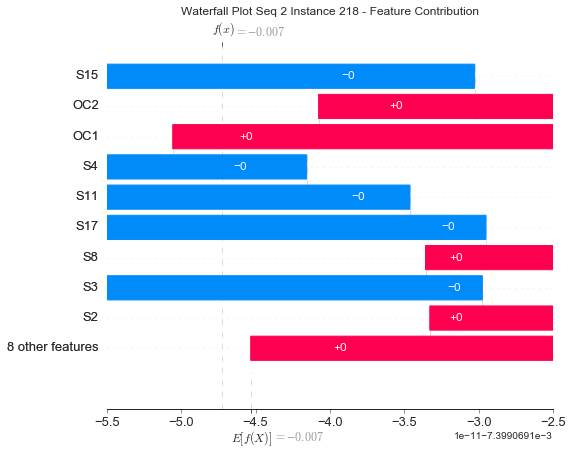

None

Contribution: [ 1.16471641e-11  1.22103803e-11  6.99668513e-13  1.81303431e-12
 -2.71518788e-12 -5.15296660e-12  2.97468403e-13  2.34602268e-12
  1.04266856e-12 -4.06297088e-12  1.14416191e-12  9.13454208e-13
  2.56236926e-13 -2.14621567e-11 -3.30280464e-12  4.84348889e-13
  1.28023232e-12]


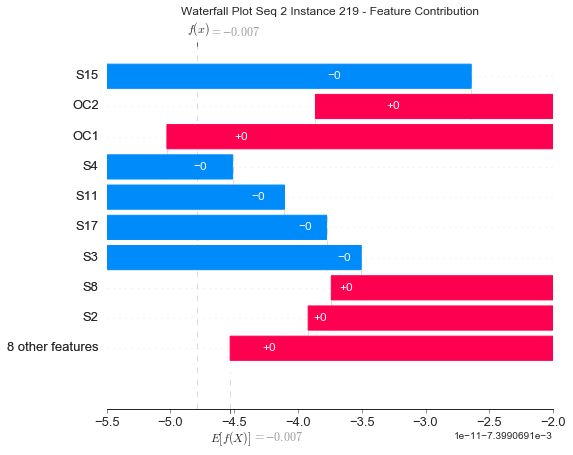

None

Contribution: [ 6.90281773e-12  6.31365446e-12 -1.08891834e-12  1.03047189e-11
 -1.06620476e-11 -2.38087761e-11  6.11483130e-12  1.26927548e-11
  3.82120420e-12 -1.97038046e-11  8.32408968e-12  9.88863592e-12
 -8.42987626e-13 -8.88889136e-12 -1.29490125e-11  3.87433228e-12
  6.35131617e-12]


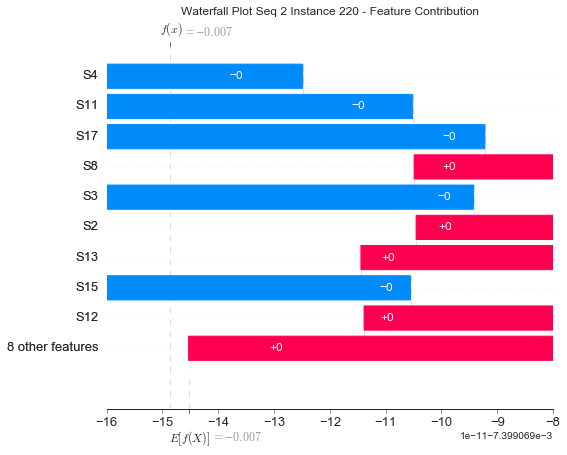

None

Contribution: [ 1.05901754e-11  8.12764352e-12 -8.82476872e-13  9.60684744e-12
 -1.14659194e-11 -2.37548609e-11  5.28694536e-12  1.45449260e-11
  4.10481111e-12 -2.19914087e-11  7.97480658e-12  1.10242683e-11
 -2.75141157e-13 -7.56376732e-12 -1.43872414e-11  3.92562198e-12
  5.70759585e-12]


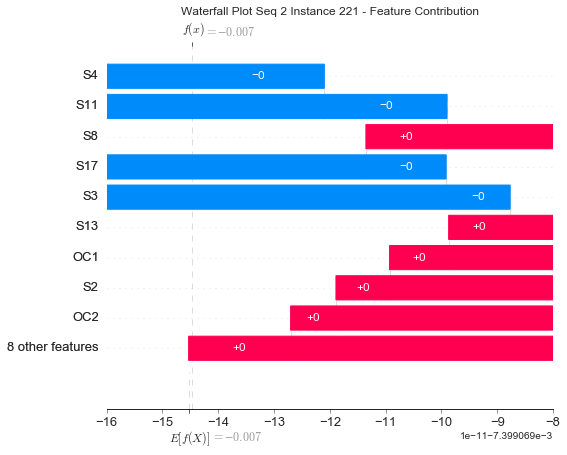

None

Contribution: [ 7.47239336e-12  7.68734468e-12 -1.78941465e-12  1.07741559e-11
 -1.10066669e-11 -2.35904768e-11  7.40572794e-12  1.08078217e-11
  3.02656901e-12 -1.79797462e-11  8.71193222e-12  8.91570585e-12
 -1.31645844e-12 -1.54793192e-11 -1.20252801e-11  4.09288358e-12
  7.06487993e-12]


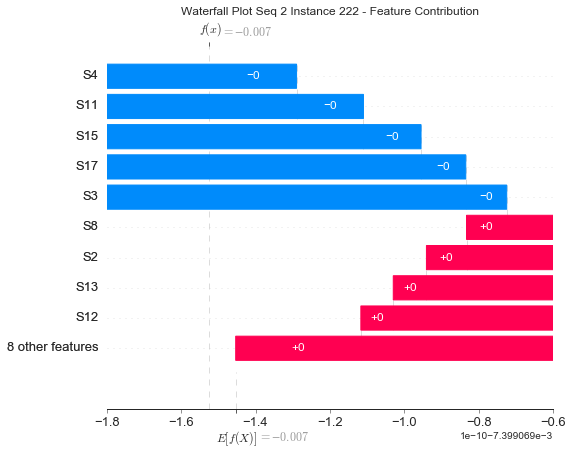

None

Contribution: [ 1.41913850e-11  1.07510320e-11 -2.32830422e-12  9.22780862e-12
 -1.18176319e-11 -2.22429089e-11  4.90419988e-12  1.52165277e-11
  3.12135192e-12 -2.22651758e-11  5.45519012e-12  1.26866989e-11
 -7.07239551e-13 -9.94637619e-12 -1.27706205e-11  2.65784595e-12
  4.88632745e-12]


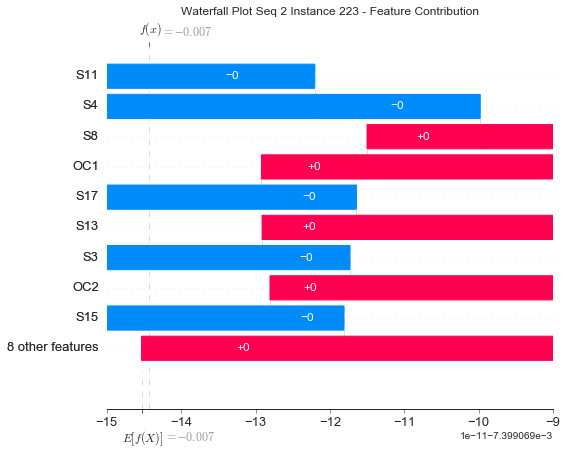

None

Contribution: [ 1.05116992e-11  6.68604148e-12 -3.41179710e-12  1.28913217e-11
 -1.47491810e-11 -3.14741844e-11  7.84942684e-12  1.74478591e-11
  4.85490771e-12 -2.69468753e-11  1.12080779e-11  1.48071503e-11
 -1.06658887e-12 -6.44416031e-12 -1.73130451e-11  5.53918933e-12
  7.94807189e-12]


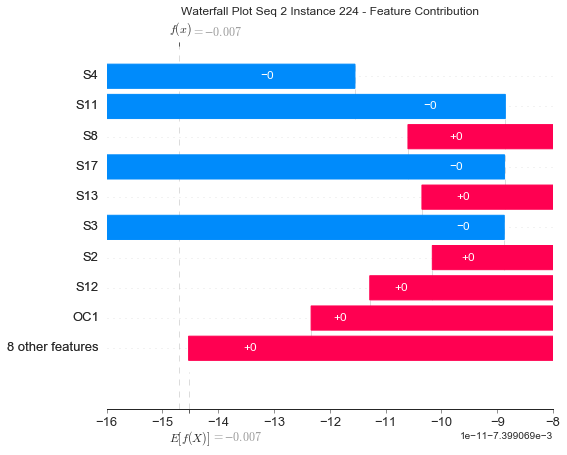

None

Contribution: [ 1.28213334e-11  1.13998012e-11 -4.19307818e-13  3.71944532e-12
 -4.88571900e-12 -1.04367071e-11  2.31143772e-12  4.61914578e-12
  1.29145891e-12 -8.35220955e-12  2.87021340e-12  3.71441246e-12
 -3.64779956e-13 -2.37947058e-11 -5.46090213e-12  1.41703218e-12
  2.98632776e-12]


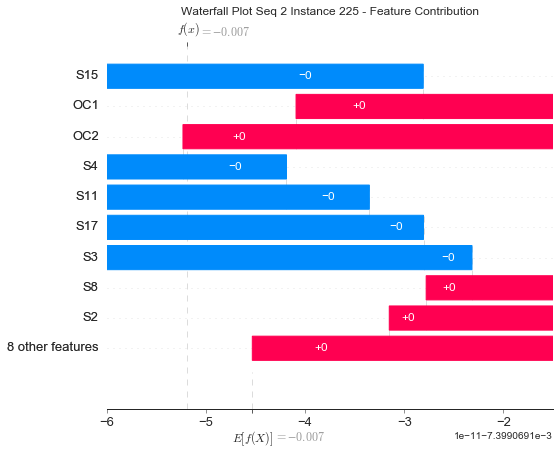

None

Contribution: [ 1.67026497e-11  1.16643353e-11 -5.43561593e-12  5.45303733e-12
 -1.03162756e-11 -1.52203319e-11  3.54922905e-12  1.25011433e-11
  7.20936006e-13 -1.88971686e-11  2.12167870e-12  1.33365480e-11
 -1.43668920e-12 -1.08717774e-11 -9.07518245e-12  1.31515317e-12
  3.14960536e-12]


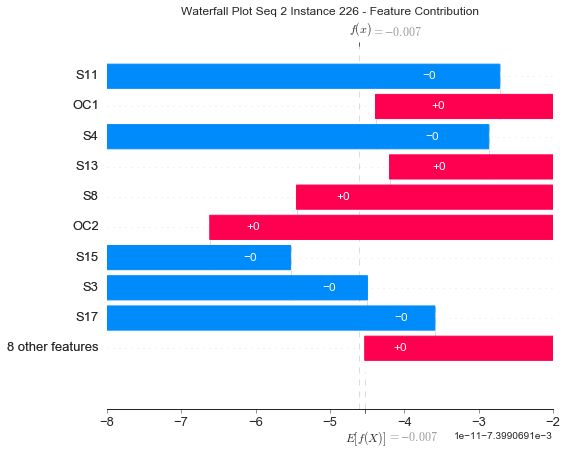

None

Contribution: [ 8.77174288e-12  7.59968651e-12 -4.56366629e-12  1.00318330e-11
 -1.15195822e-11 -2.07167096e-11  6.84512213e-12  1.23987105e-11
  2.19769754e-12 -1.83396423e-11  6.13789054e-12  1.24332827e-11
 -1.84561394e-12 -1.23156927e-11 -1.10665557e-11  3.28382720e-12
  6.51832191e-12]


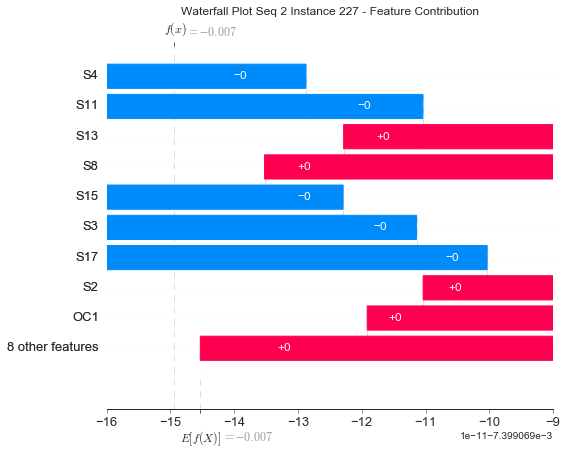

None

Contribution: [ 6.98952745e-12  3.79932934e-12 -7.41902460e-12  1.07451409e-11
 -1.34080802e-11 -2.44653343e-11  8.80188023e-12  1.43550727e-11
  2.01513090e-12 -2.21132574e-11  7.83916421e-12  1.61705805e-11
 -2.49858858e-12 -4.75736117e-12 -1.22401837e-11  4.40038587e-12
  7.67781758e-12]


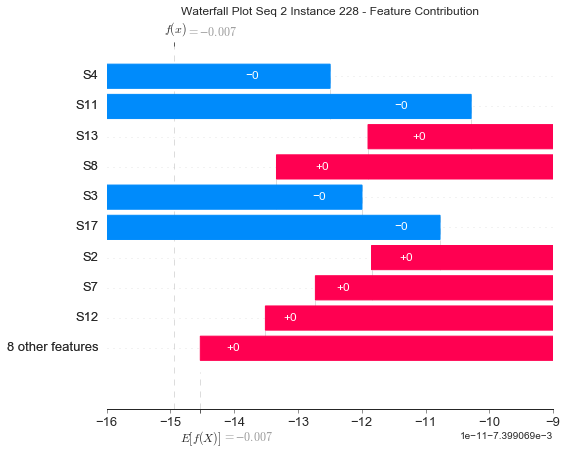

None

Contribution: [ 5.27090828e-12  2.15911837e-12 -9.10965140e-12  1.00982521e-11
 -1.23971423e-11 -2.13680306e-11  8.45016765e-12  1.27249426e-11
  1.19216919e-12 -1.93505177e-11  7.42020681e-12  1.59712989e-11
 -2.50139579e-12 -3.72492922e-12 -1.08853794e-11  4.04320978e-12
  7.25540721e-12]


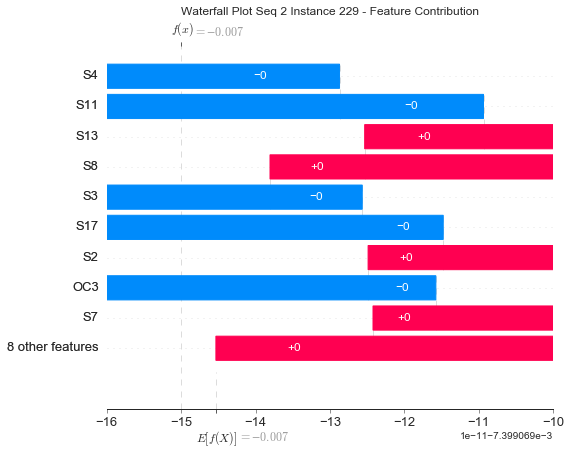

None

Contribution: [ 1.63961310e-11  1.03770326e-11 -1.00737812e-11 -2.50163844e-12
 -3.93250710e-12  3.67134188e-12  1.31142634e-12  4.56756594e-12
 -4.38149213e-12 -6.41568526e-12 -6.59004665e-12  1.15274335e-11
 -1.19397537e-12 -8.25487855e-12  2.47442843e-12 -1.80808168e-12
 -6.20200397e-13]


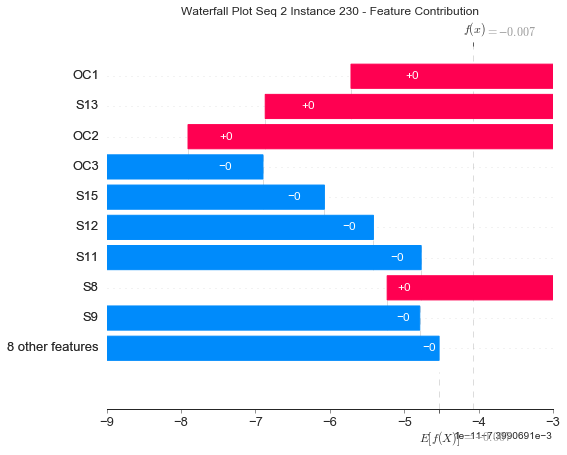

None

Contribution: [ 3.79490753e-12 -1.90772935e-13 -1.06059181e-11  9.61466583e-13
 -1.84493588e-12 -1.27319346e-12  1.00178741e-12  7.03676646e-13
 -1.42225381e-12 -4.76342002e-13  5.90524212e-13  1.06839555e-11
 -1.94370887e-12 -9.68942895e-12  3.55334821e-13  4.87467055e-13
  1.39804249e-12]


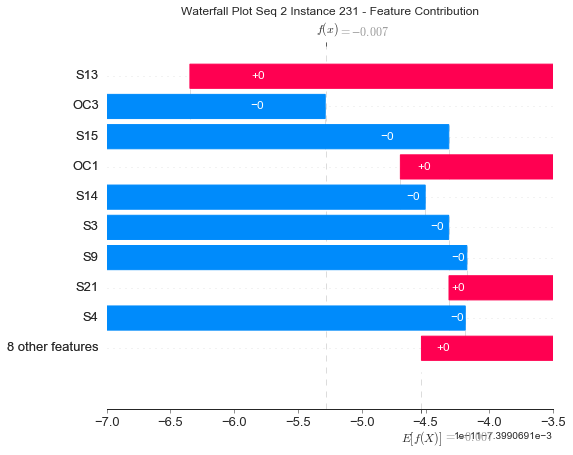

None

Contribution: [ 7.33400493e-12  2.97986722e-12 -1.17487140e-11 -7.17875585e-12
  3.04843347e-12  1.61964140e-11 -6.98306972e-13 -6.86618080e-12
 -6.64683109e-12  9.61104026e-12 -7.81012147e-12  5.81533866e-12
 -1.64207309e-12 -1.04394635e-11  1.06804149e-11 -2.47779900e-12
 -2.52014989e-12]


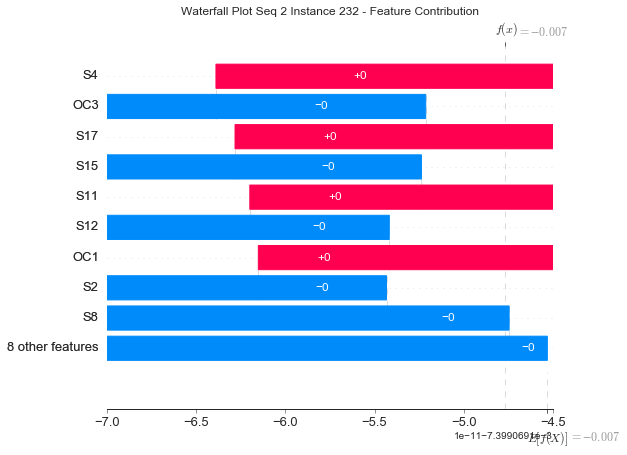

None

Contribution: [ 3.94398923e-12 -6.30072513e-12 -1.25590302e-11 -1.00628906e-11
  3.81161942e-12  1.45526542e-11 -1.28458691e-12 -7.04948860e-12
 -7.08904116e-12  8.06050626e-12 -6.96451837e-12  8.08313659e-12
 -1.68142236e-12  7.24135031e-12  1.09512200e-11 -2.38369264e-12
 -3.52002802e-12]


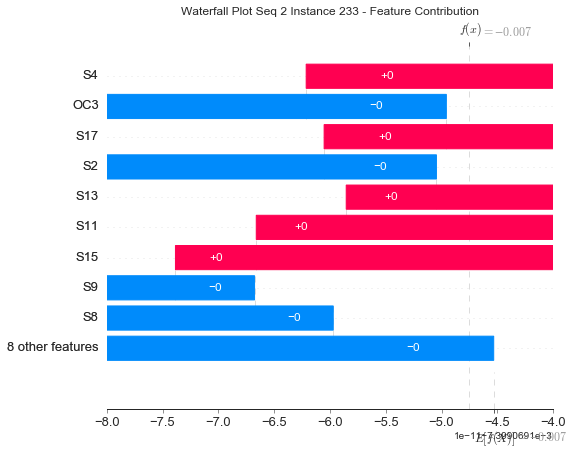

None

Contribution: [-1.21097715e-11 -1.52538815e-11 -1.23737331e-11 -1.44855157e-12
  3.86584167e-12  8.18348948e-12  7.08784160e-13 -7.37224604e-12
 -3.03402832e-12  1.27461644e-11 -3.45905840e-13  6.94554050e-12
 -2.71206885e-12  8.87478632e-12  7.56685773e-12  1.71285078e-13
  2.53070812e-13]


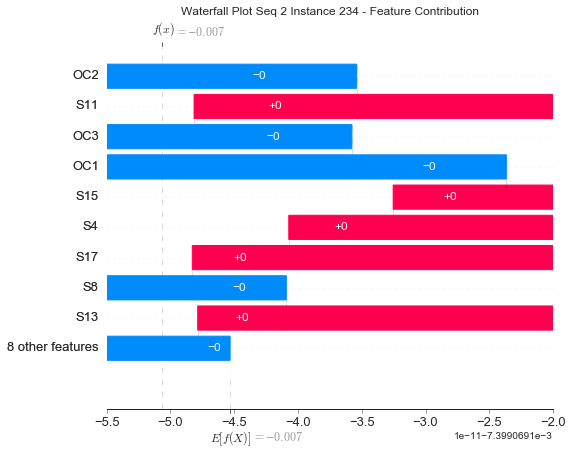

None

Contribution: [ 6.12462988e-12  2.28151130e-13 -1.53114552e-11 -2.97607668e-11
  1.96303876e-11  6.29528929e-11 -1.09884723e-11 -2.56344390e-11
 -1.75937147e-11  3.98253340e-11 -3.22594104e-11 -2.70684712e-12
 -1.27578753e-12  2.99218419e-12  3.87294433e-11 -1.26581592e-11
 -1.48738938e-11]


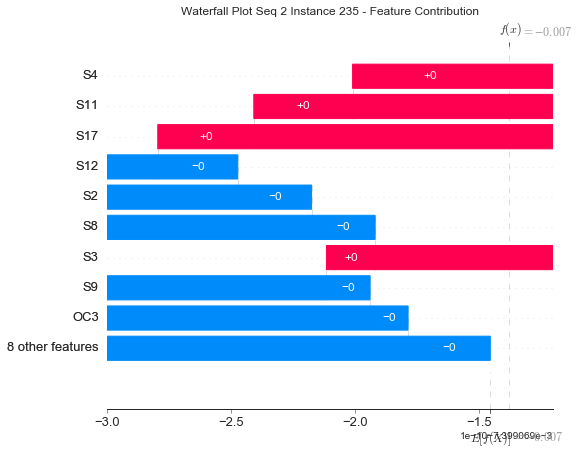

None

Contribution: [-2.74921908e-11 -3.04967024e-11 -1.55448900e-11 -5.21338875e-12
  9.31234170e-12  1.87218886e-11  3.22470371e-12 -1.81759208e-11
 -7.06687269e-12  2.51596764e-11 -2.74684724e-12  2.72624284e-12
 -3.93853006e-12  2.17761399e-11  1.79020444e-11 -2.89405923e-13
 -5.01651021e-13]


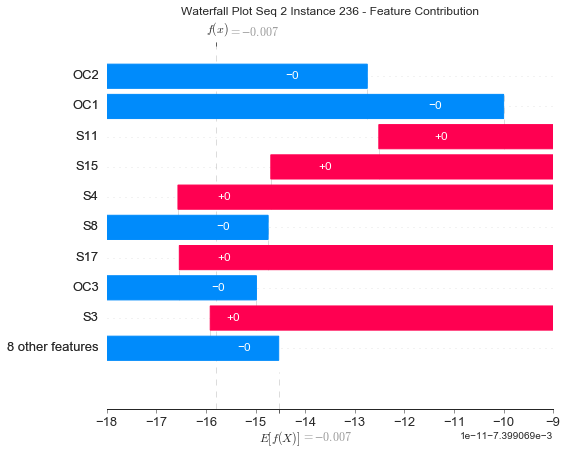

None

Contribution: [-1.53770573e-11 -1.69649138e-11 -1.61641239e-11 -2.71062409e-11
  2.52658137e-11  6.64906602e-11 -9.62916899e-12 -3.59844689e-11
 -1.77883524e-11  5.30542658e-11 -2.51477068e-11 -9.34530318e-12
 -3.36775703e-12  1.52592522e-11  4.13040158e-11 -1.13029837e-11
 -1.43835473e-11]


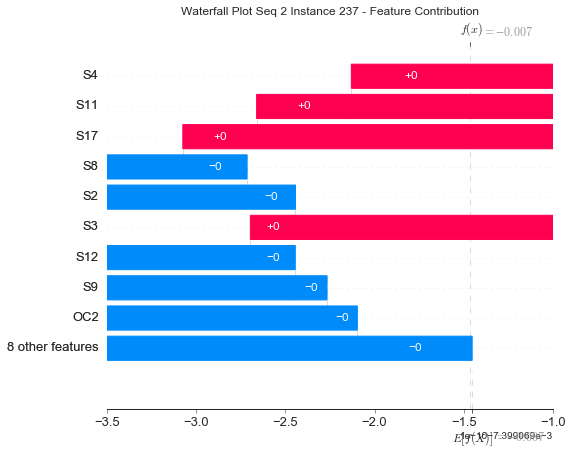

None

Contribution: [-3.96677760e-11 -4.15127967e-11 -1.58774539e-11 -1.71499828e-11
  2.24692522e-11  4.85924530e-11 -3.14677321e-12 -3.61551657e-11
 -1.32740329e-11  5.12916654e-11 -1.26600397e-11 -8.01908106e-12
 -5.10204292e-12  2.85108898e-11  3.57761494e-11 -5.59514587e-12
 -8.17253817e-12]


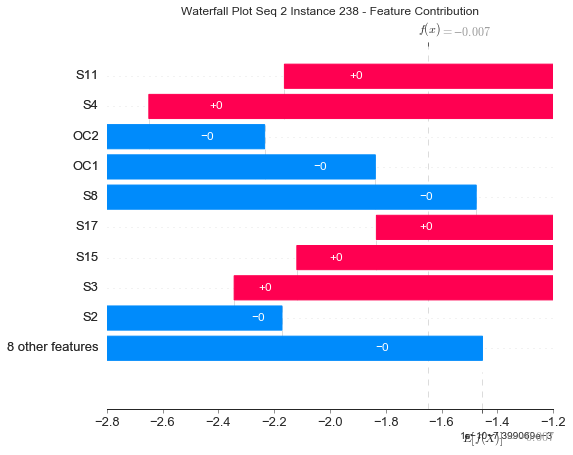

None

Contribution: [-4.21337999e-11 -5.44821722e-11 -1.10673909e-11 -1.51766689e-11
  1.26658900e-11  3.18953683e-11 -1.93763430e-12 -1.55222953e-11
 -9.09680491e-12  2.42082118e-11 -9.27190269e-12  1.16473422e-12
 -1.92589174e-12  8.85995374e-11  2.28397943e-11 -3.85597283e-12
 -7.36718499e-12]


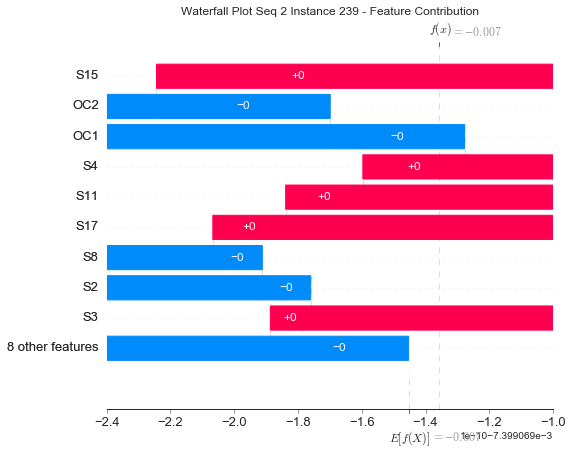

None

Contribution: [-5.06389791e-11 -6.00387587e-11 -8.66962838e-12 -2.23289252e-11
  2.07061018e-11  4.91229141e-11 -4.34342623e-12 -2.68762738e-11
 -1.32070049e-11  4.21432438e-11 -1.60795127e-11 -7.67403936e-12
 -2.15560144e-12  9.52294563e-11  3.58377217e-11 -6.69886672e-12
 -1.11587024e-11]


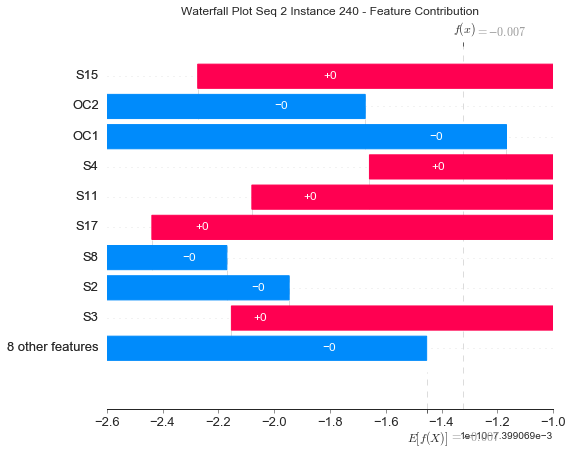

None

Contribution: [-4.21974955e-11 -4.37435331e-11 -1.41760692e-11 -3.90878753e-11
  4.15976385e-11  1.05022206e-10 -1.82038794e-11 -5.08626266e-11
 -2.15131576e-11  8.33469127e-11 -3.58409691e-11 -2.69889527e-11
  8.07639437e-13  6.93417754e-11  5.90332436e-11 -1.47655169e-11
 -2.42839585e-11]


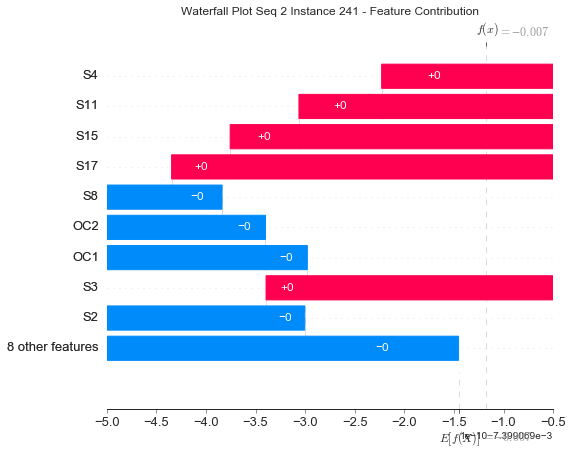

None

Contribution: [-2.31398858e-11 -2.98408798e-11 -1.23829931e-11 -7.76797515e-11
  7.03502118e-11  1.76143392e-10 -4.70669025e-11 -7.45712866e-11
 -3.27875956e-11  1.25394709e-10 -7.76808826e-11 -3.85169605e-11
  5.25858697e-12  6.74147127e-11  9.75531461e-11 -3.43260524e-11
 -4.97979782e-11]


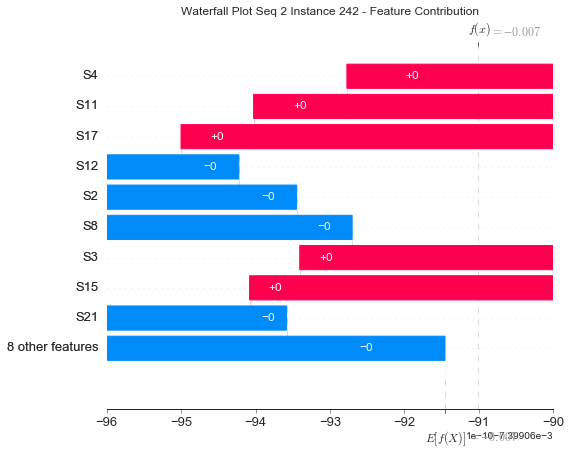

None

Contribution: [-2.94045240e-11 -2.72081420e-11 -8.27164465e-12 -9.22619411e-11
  9.11151640e-11  2.18164389e-10 -5.06901222e-11 -1.10039873e-10
 -4.10719861e-11  1.69763870e-10 -8.40330097e-11 -6.56510263e-11
  6.99341930e-12  3.41329222e-11  1.26017113e-10 -3.69161229e-11
 -5.57869861e-11]


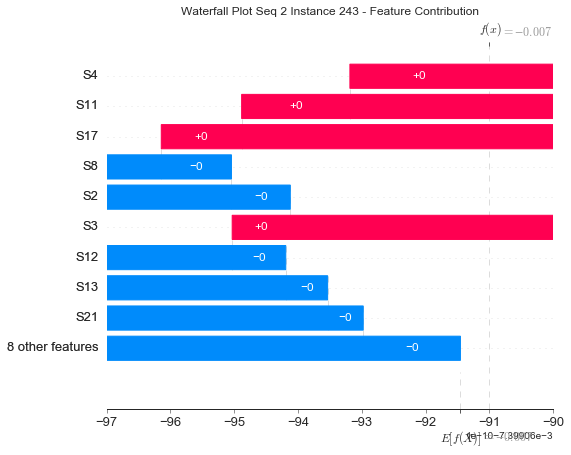

None

Contribution: [-9.90380555e-11 -9.17032908e-11 -5.64073918e-12 -6.26050184e-11
  7.00490985e-11  1.27868410e-10 -1.78573753e-11 -9.73393657e-11
 -2.82734773e-11  1.35574552e-10 -3.31196008e-11 -5.14571163e-11
  1.56824954e-12  9.60442698e-11  8.97695945e-11 -1.35203663e-11
 -2.45203944e-11]


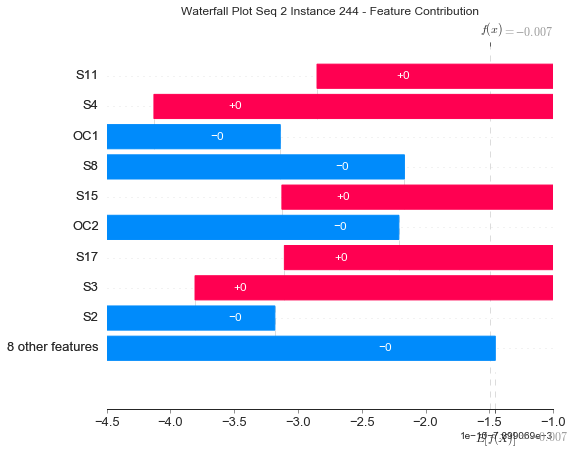

None

Contribution: [-1.46243365e-10 -1.11167735e-10 -2.85261094e-12 -1.43653891e-11
  5.35763586e-11  7.82849618e-11 -2.37825601e-13 -7.15749682e-11
 -9.40103117e-12  1.18177884e-10 -2.29546959e-12 -4.24270723e-11
  4.92719038e-13  1.05861264e-10  5.85715712e-11 -8.63067484e-13
 -2.21940283e-12]


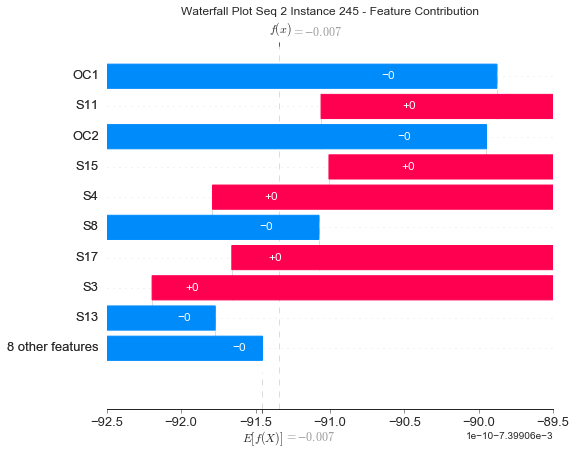

None

Contribution: [-8.18059787e-11 -7.95004479e-11 -7.64939587e-12 -1.04774418e-10
  1.02435616e-10  2.15187007e-10 -4.26574644e-11 -1.34864425e-10
 -4.55105051e-11  1.93631222e-10 -6.98911484e-11 -8.05607872e-11
  5.41059905e-12  9.25114776e-11  1.31953434e-10 -3.05343806e-11
 -5.17016673e-11]


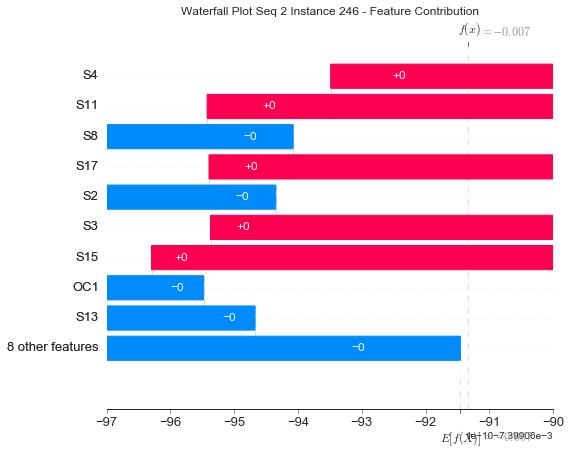

None

Contribution: [-6.51825677e-11 -6.80419610e-11  2.80002107e-12 -1.29775524e-10
  1.24914981e-10  2.61866917e-10 -6.53161344e-11 -1.45635615e-10
 -5.14783320e-11  2.12515602e-10 -1.03382441e-10 -9.09124928e-11
  9.25472633e-12  1.09526034e-10  1.59221289e-10 -4.74101175e-11
 -7.24045060e-11]


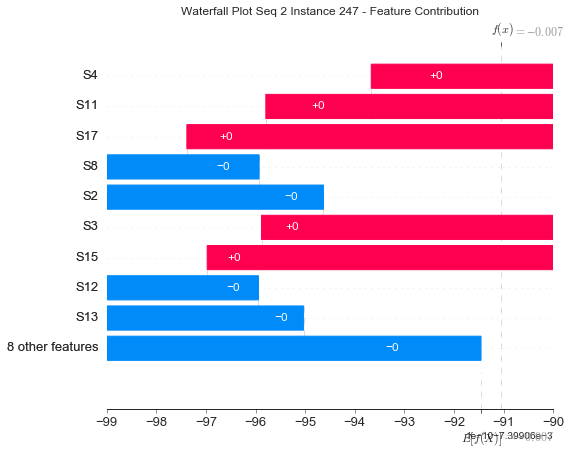

None

Contribution: [-1.18937443e-10 -8.82091344e-11  1.50374869e-11 -7.30820543e-11
  1.03222618e-10  2.04586764e-10 -4.44915389e-11 -1.17273316e-10
 -2.82562324e-11  1.88040236e-10 -6.67016442e-11 -8.48443468e-11
  7.29803371e-12  1.20361318e-10  1.17901688e-10 -3.24665364e-11
 -4.56364911e-11]


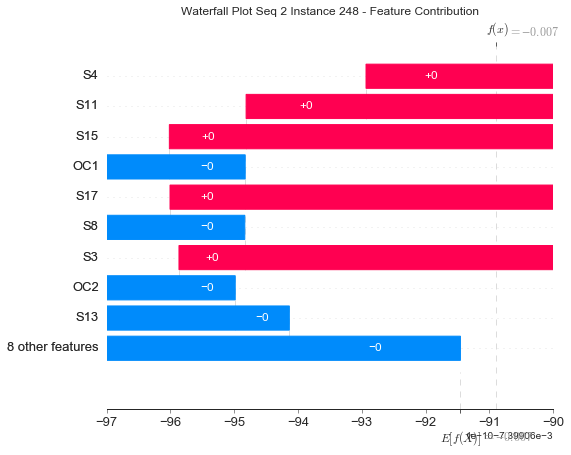

None

Contribution: [-1.51119270e-10 -1.31723923e-10  1.45128198e-11 -7.78072884e-11
  9.87392043e-11  1.60565339e-10 -2.82000239e-11 -1.26992139e-10
 -2.78322816e-11  1.77310583e-10 -3.55251037e-11 -8.92100907e-11
  3.48056978e-12  1.64652944e-10  1.10753996e-10 -1.68451416e-11
 -3.39586172e-11]


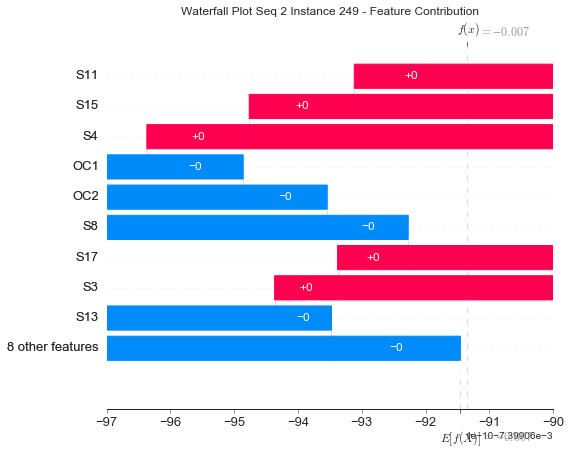

None

Contribution: [-1.41726575e-10 -1.19066978e-10  5.61493733e-12 -4.88553885e-11
  7.69480799e-11  1.50885832e-10 -1.71957310e-11 -9.99368227e-11
 -2.64711343e-11  1.56224270e-10 -4.02499700e-11 -6.67733369e-11
  5.56520455e-12  1.64831981e-10  1.00962384e-10 -1.64233696e-11
 -3.05960639e-11]


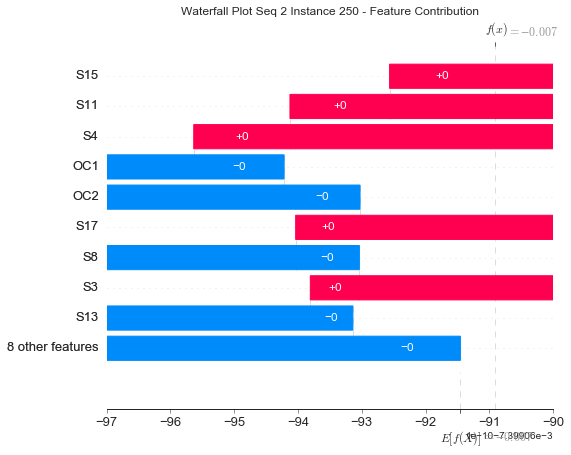

None

Contribution: [-1.67550876e-10 -1.25324112e-10  1.46272161e-11 -8.28491997e-11
  1.14004202e-10  2.03616207e-10 -3.11578645e-11 -1.49443027e-10
 -3.48114350e-11  2.21630811e-10 -5.59313811e-11 -1.08676297e-10
  7.46203793e-12  1.26317359e-10  1.35832887e-10 -2.40766036e-11
 -3.85573622e-11]


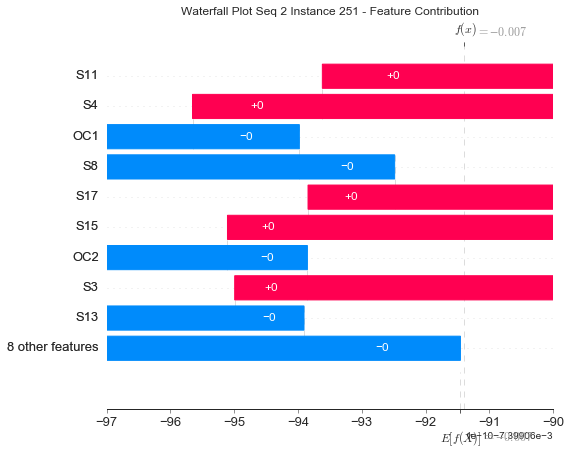

None

Contribution: [-1.10547869e-10 -1.08345700e-10  2.51722376e-11 -1.31916172e-10
  1.34514649e-10  2.44970322e-10 -6.10285086e-11 -1.60255448e-10
 -4.33966890e-11  2.24331054e-10 -7.98560940e-11 -1.25950014e-10
  1.16751209e-11  1.78617218e-10  1.51999371e-10 -3.76213678e-11
 -6.89884330e-11]


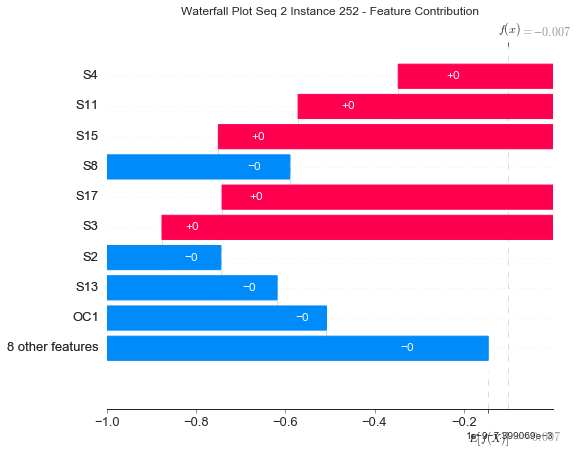

None

Contribution: [-1.09662092e-10 -8.61528279e-11  2.52432606e-11 -1.37104370e-10
  1.54185109e-10  2.96311226e-10 -8.67398167e-11 -1.82598395e-10
 -4.37875916e-11  2.70278105e-10 -9.31252436e-11 -1.36631928e-10
  1.47212468e-11  1.13970985e-10  1.72589595e-10 -4.96383906e-11
 -8.14467244e-11]


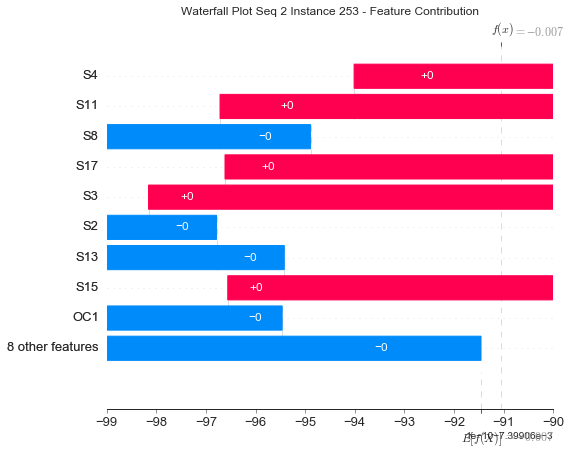

None

Contribution: [-9.76396325e-11 -8.29008112e-11  1.73712416e-11 -9.75493297e-11
  1.15498951e-10  2.46740406e-10 -6.38131353e-11 -1.29837779e-10
 -3.58954498e-11  2.07434084e-10 -7.82062123e-11 -1.01789216e-10
  1.61079587e-11  1.52644578e-10  1.33801470e-10 -3.81993742e-11
 -6.85964549e-11]


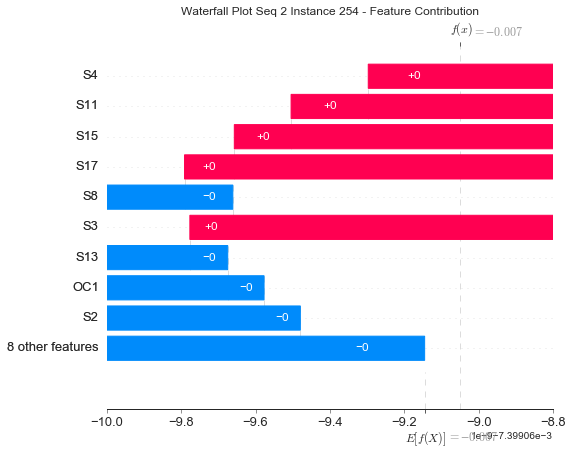

None

Contribution: [-1.47948431e-10 -1.10340265e-10  4.14854956e-11 -6.96303709e-11
  1.13870427e-10  1.86946680e-10 -4.69968404e-11 -1.52145851e-10
 -2.10307084e-11  2.20305857e-10 -3.84112395e-11 -1.34651582e-10
  1.36000039e-11  1.19470614e-10  1.15686481e-10 -2.31544818e-11
 -4.71479002e-11]


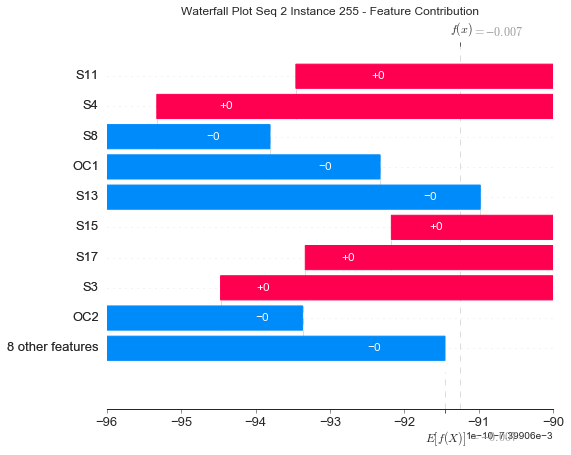

None

Contribution: [-1.47680965e-10 -9.33739960e-11  4.84806986e-11 -6.99103067e-11
  1.10096682e-10  2.07020123e-10 -3.68084244e-11 -1.24976446e-10
 -2.42981069e-11  2.00941846e-10 -6.80049975e-11 -1.30895586e-10
  1.21534362e-11  1.44961890e-10  1.24209171e-10 -2.79569128e-11
 -4.35924907e-11]


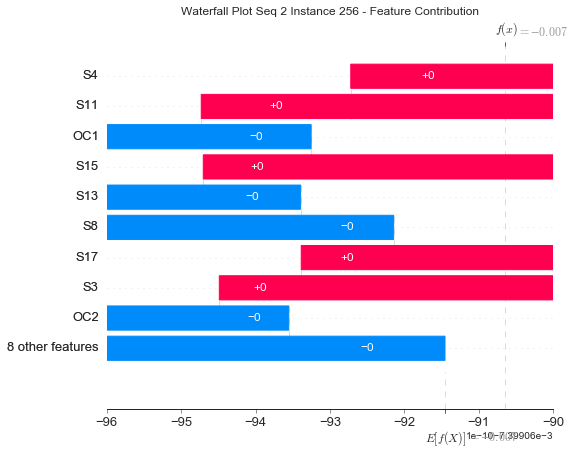

None

Contribution: [-1.67494671e-10 -1.09404055e-10  5.67399044e-11 -6.39633763e-11
  1.08799372e-10  1.62254474e-10 -2.89009944e-11 -1.40536985e-10
 -1.53432753e-11  2.02679068e-10 -3.16648791e-11 -1.42261591e-10
  1.24160127e-11  1.24831964e-10  1.05048435e-10 -1.62733993e-11
 -3.13625098e-11]


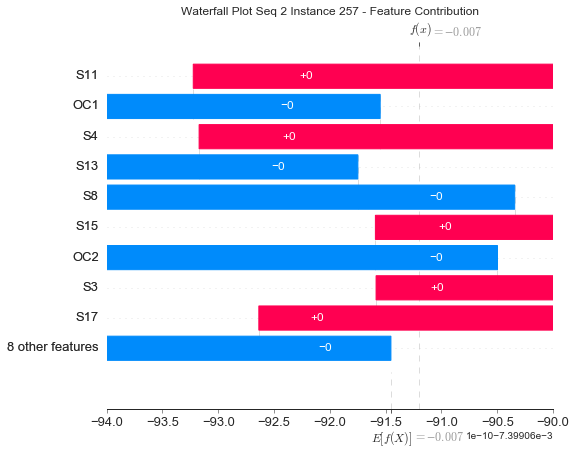

None

Contribution: [-1.44916343e-10 -9.57575824e-11  6.94801508e-11 -4.29796476e-11
  9.69068228e-11  1.29285582e-10 -4.90954638e-11 -1.14460226e-10
  6.69599142e-12  1.75332276e-10  1.95780501e-12 -1.33623390e-10
  1.89275592e-11  1.21553462e-10  6.14938864e-11 -1.08191919e-11
 -3.25280011e-11]


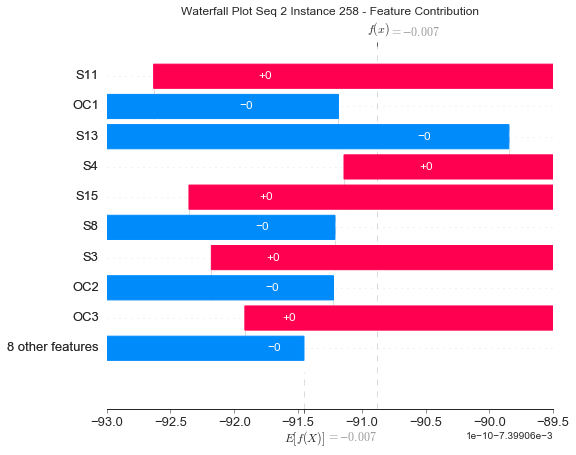

None

Contribution: [-1.25847346e-10 -1.03993189e-10  7.34073843e-11 -8.11076969e-11
  1.03436065e-10  1.35061740e-10 -4.42721311e-11 -1.25940702e-10
 -9.64514926e-12  1.67495740e-10 -2.41662801e-11 -1.42632614e-10
  1.55913893e-11  1.35171027e-10  8.44348827e-11 -1.52882325e-11
 -3.93729112e-11]


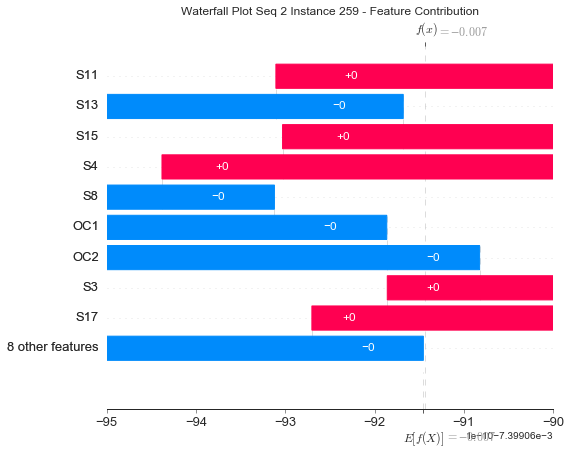

None

Contribution: [-1.01584116e-10 -8.16418946e-11  8.57320326e-11 -3.89519597e-11
  6.07699932e-11  4.90314109e-11 -3.40466370e-11 -5.99509886e-11
  1.37289546e-11  7.90839408e-11  4.17898181e-12 -1.15505196e-10
  1.40482001e-11  1.82576745e-10  2.55873586e-11 -2.65382161e-12
 -2.48139079e-11]


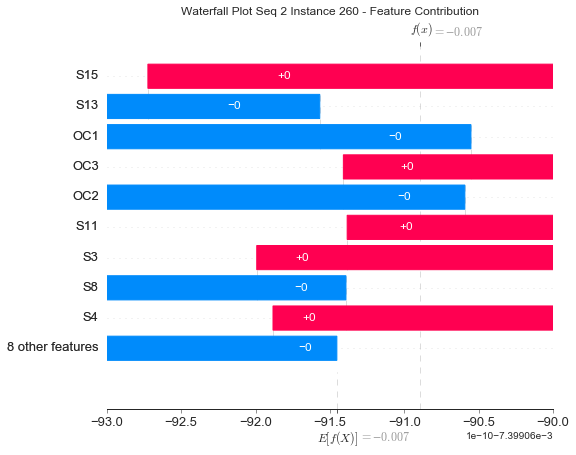

None

Contribution: [-8.96775709e-11 -2.55538802e-11  1.72762638e-11 -8.45077897e-11
  1.05868848e-10  2.14518847e-10 -4.18641684e-11 -1.49058946e-10
 -3.56847919e-11  2.13615334e-10 -6.09250358e-11 -1.12981242e-10
  1.46739409e-11 -1.17266766e-10  1.30618932e-10 -2.83082273e-11
 -4.47345806e-11]


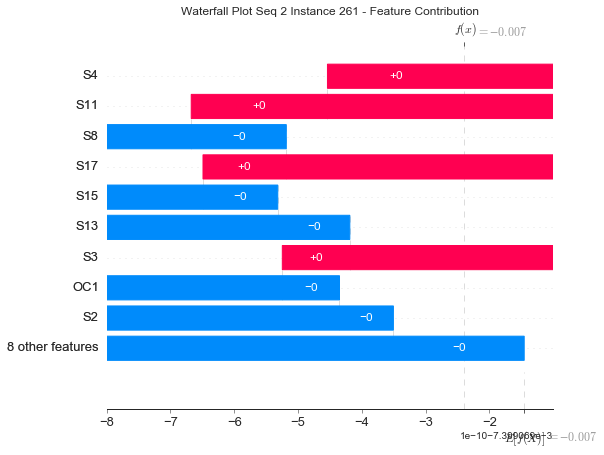

None

Contribution: [-7.54270466e-11 -3.52979451e-11  1.10875857e-10 -1.21662949e-11
  4.73794337e-11  1.47955953e-11 -3.31655398e-11 -4.63287499e-11
  3.35854192e-11  6.58542873e-11  1.66003027e-11 -1.14332890e-10
  1.28155420e-11  5.34236544e-11 -9.35763511e-13 -4.69954284e-12
 -1.93293853e-11]


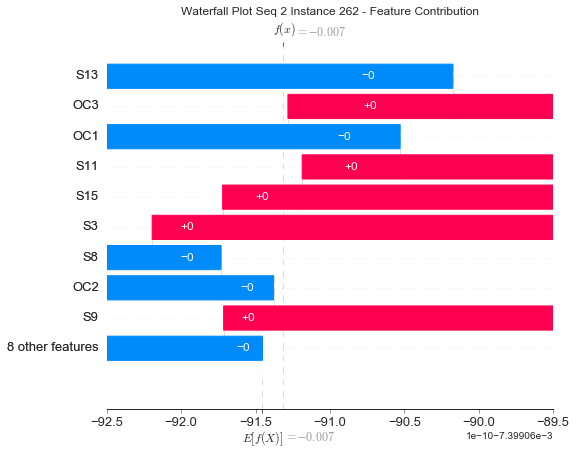

None

Contribution: [-1.77972692e-10 -1.17161433e-10  1.17346216e-10  1.27626770e-10
 -5.86728513e-11 -2.94006514e-10  6.16939555e-11  3.93846032e-11
  8.91353588e-11 -9.22367599e-11  2.17157139e-10 -7.93240543e-11
 -1.33901820e-12  9.55166710e-11 -1.76750531e-10  8.01774619e-11
  8.24296603e-11]


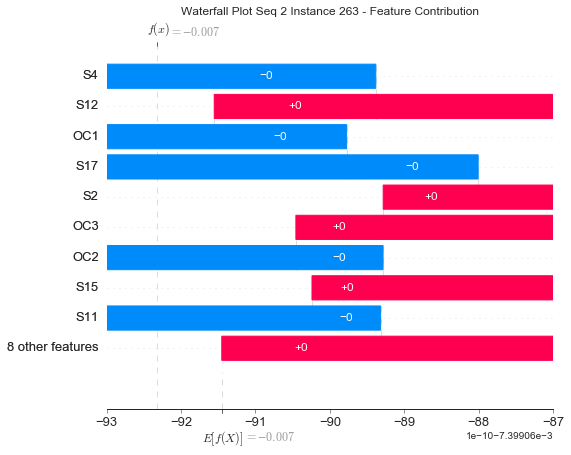

None

Contribution: [-4.08083671e-11  2.17742265e-11  1.12227817e-10  2.63124036e-11
  1.09288728e-12 -4.36322020e-11 -3.94995408e-12  8.09174255e-12
  3.91365967e-11 -7.80823930e-12  2.96303711e-11 -1.04984785e-10
  4.94169289e-12 -4.41266711e-11 -5.85197654e-11  6.25727681e-12
  6.98864447e-12]


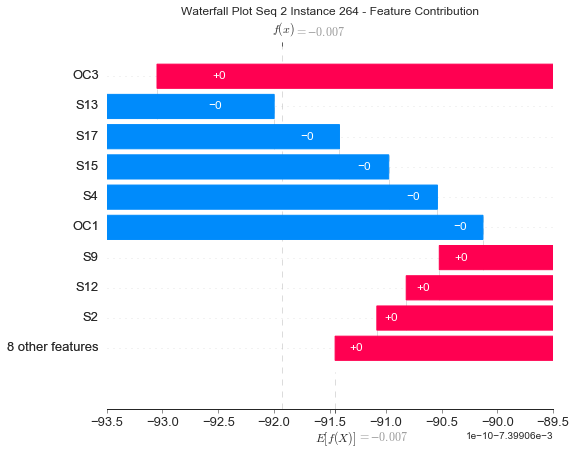

None

Contribution: [-1.19269161e-11  7.18263068e-13  1.37994449e-10  9.65702379e-11
 -8.80708076e-11 -3.03796377e-10  3.49955238e-11  1.38032835e-10
  9.10483980e-11 -2.13227797e-10  1.35089495e-10 -4.15090080e-11
 -1.50505953e-12  1.18223653e-10 -2.06730341e-10  5.14693184e-11
  5.42117948e-11]


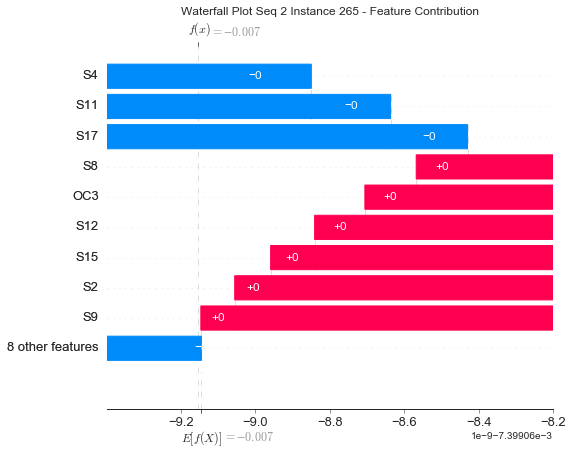

None

Contribution: [-8.70592279e-11 -8.70697056e-11  1.29230460e-10  2.14667409e-10
 -2.08925224e-10 -6.07748074e-10  1.49817006e-10  2.23624938e-10
  1.36091804e-10 -3.95480093e-10  3.46063733e-10 -8.34591597e-12
 -1.11134400e-11  1.63396199e-10 -3.81734810e-10  1.56263030e-10
  1.68817904e-10]


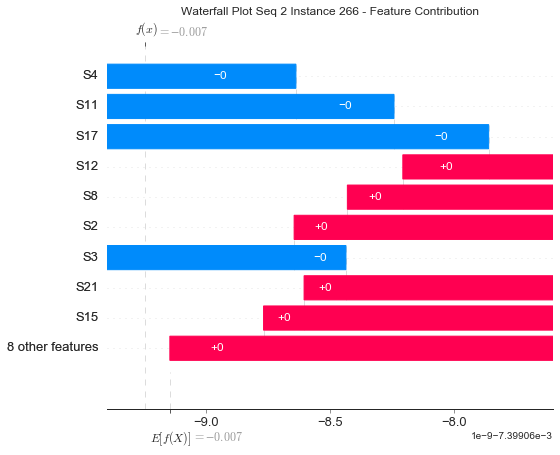

None

Contribution: [ 2.44126885e-10  2.17995733e-10  1.29399214e-10 -9.63611135e-11
  1.39118352e-11  6.35024117e-11 -1.01019235e-10  5.31510773e-11
  2.25552875e-11 -5.93038951e-11 -7.04125300e-11 -1.06984727e-10
  2.98399534e-11 -1.66372360e-10 -4.06260720e-11 -3.48991773e-11
 -6.59888116e-11]


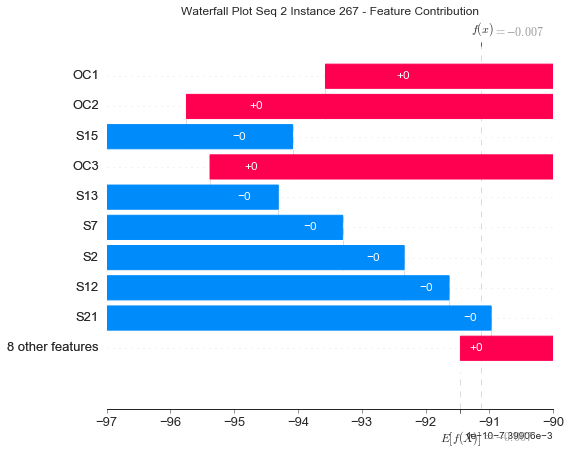

None

Contribution: [ 9.63247121e-11  1.81995599e-10  6.20800009e-11 -1.95361331e-11
  3.95454641e-11  5.42861901e-11 -1.29951093e-11 -8.74077338e-11
  5.22742526e-12  8.70951367e-11  4.30337016e-12 -1.16636367e-10
  6.92680852e-12 -6.86550927e-10  1.51412268e-11  1.46415996e-12
  6.92706786e-12]


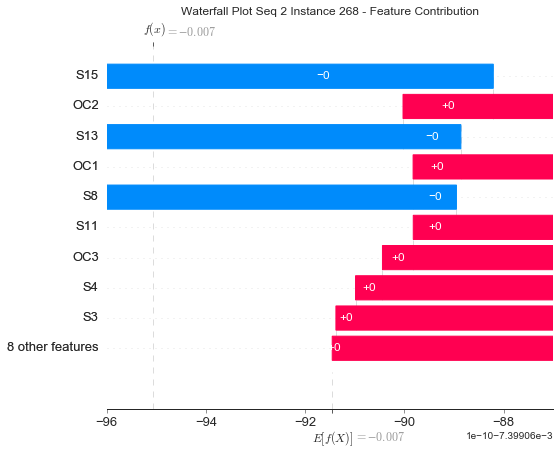

None

Contribution: [ 2.76294598e-10  2.86489998e-10  1.68203201e-10  1.07674626e-10
 -1.26863353e-10 -2.68119665e-10  1.14660842e-11  2.08265488e-10
  9.72610742e-11 -2.91208113e-10  6.60015931e-11 -5.46064305e-11
  1.96025886e-11 -2.94139990e-10 -2.35273634e-10  2.82961744e-11
  3.27943575e-11]


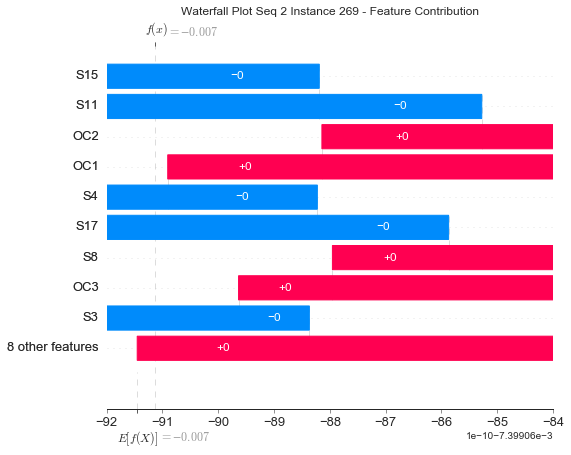

None

Contribution: [ 2.75826834e-10  3.32932099e-10  1.34253294e-11 -8.45861228e-11
  5.20250822e-11  1.10314285e-10 -5.56527324e-11 -1.35002995e-10
 -2.47467064e-11  1.43422885e-10 -3.96188707e-11 -9.34410743e-11
  9.41329306e-12 -9.93657157e-10  7.04244232e-11 -1.60767406e-11
 -2.97653360e-11]


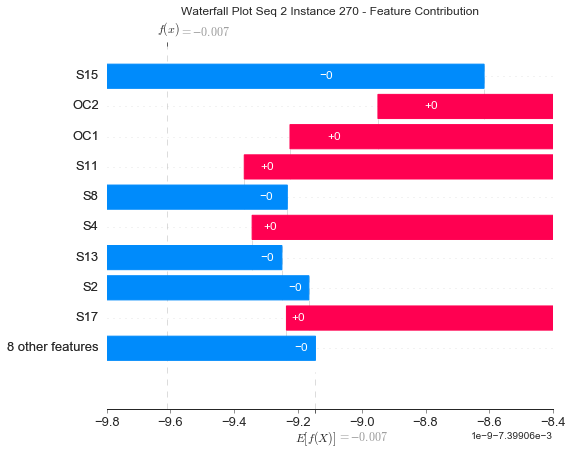

None

Contribution: [ 5.71172498e-10  4.67059780e-10  2.03318792e-10 -9.35398842e-11
 -6.78547982e-11 -9.61527455e-11 -6.73161527e-11  1.99024866e-10
  4.50031540e-11 -2.99790609e-10 -5.96185046e-11 -6.79463222e-11
  3.22040242e-11 -3.52436080e-10 -1.47779552e-10 -1.86440741e-11
 -5.02507584e-11]


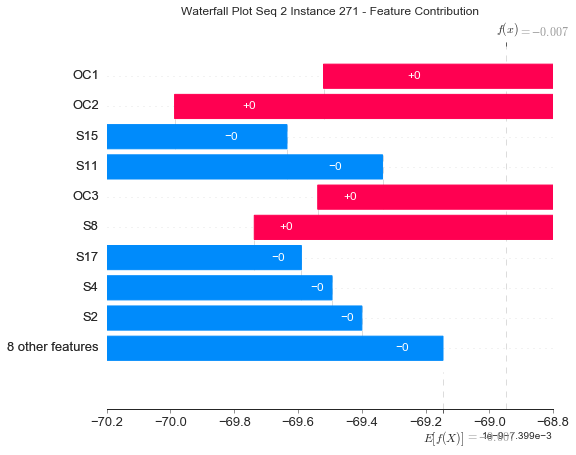

None

Contribution: [ 3.40050182e-10  4.71407635e-10  1.01468660e-10  6.80390466e-11
 -4.56841891e-11 -1.75345113e-10  2.98470124e-13  2.60271795e-12
  5.97203328e-11 -5.58630746e-11  9.79162723e-11 -9.01919303e-11
 -8.94777850e-13 -1.15811361e-09 -1.43752954e-10  4.11687212e-11
  5.94507846e-11]


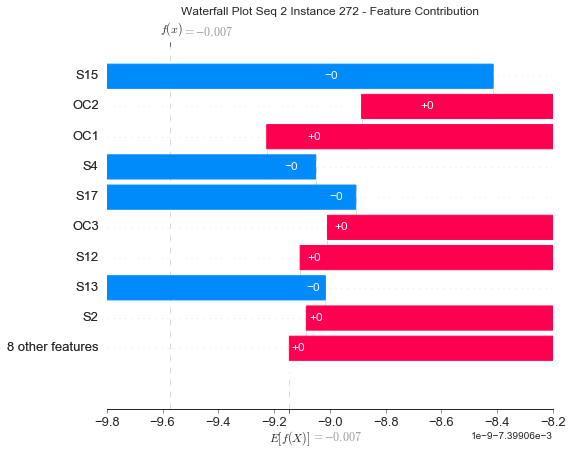

None

Contribution: [ 5.35291034e-10  5.50342771e-10  9.03585470e-11  2.54189603e-11
 -9.14238130e-11 -1.98579306e-10 -5.22613940e-12  9.86081147e-11
  4.27580783e-11 -2.10786597e-10  2.34999329e-11 -2.70579566e-11
  6.16067310e-12 -1.14325716e-09 -1.50878879e-10  9.56235091e-12
  2.44913638e-11]


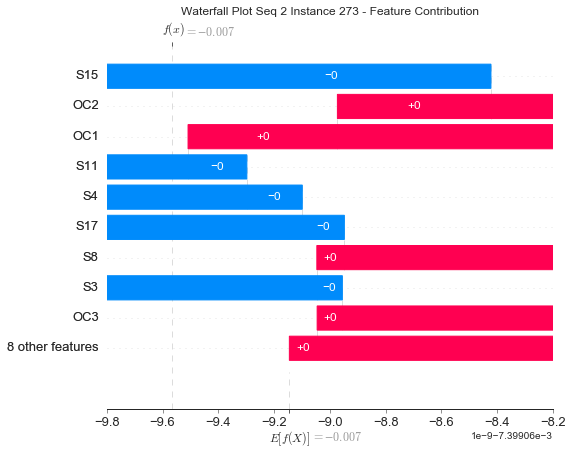

None

Contribution: [ 9.77759429e-10  7.90855381e-10  1.66946193e-10 -1.39714698e-10
 -8.64387242e-11 -4.80956004e-11 -1.50797055e-10  1.51383683e-10
  2.50001599e-11 -2.66517308e-10 -1.67720768e-10 -3.46739581e-11
  2.63687978e-11 -1.10390885e-09 -1.00566791e-10 -8.20189403e-11
 -1.39947665e-10]


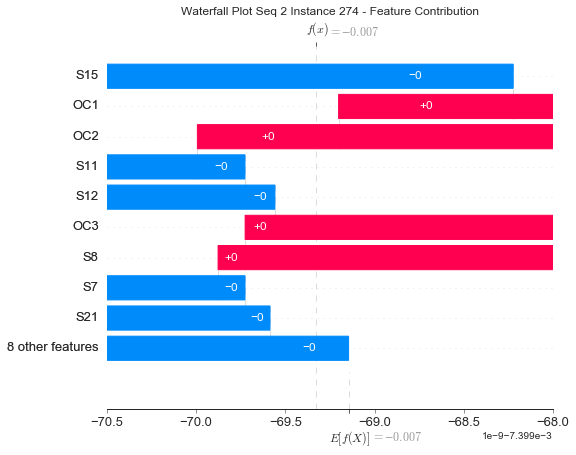

None

Contribution: [ 4.17202994e-10  4.79121687e-10  1.49137452e-10  2.79752693e-10
 -3.33352290e-10 -8.39602721e-10  1.37653888e-10  1.77638293e-10
  1.54367297e-10 -4.68313666e-10  4.20634416e-10  1.88976352e-12
 -3.86454792e-11 -1.50245727e-09 -5.34622735e-10  1.65250022e-10
  2.01309150e-10]


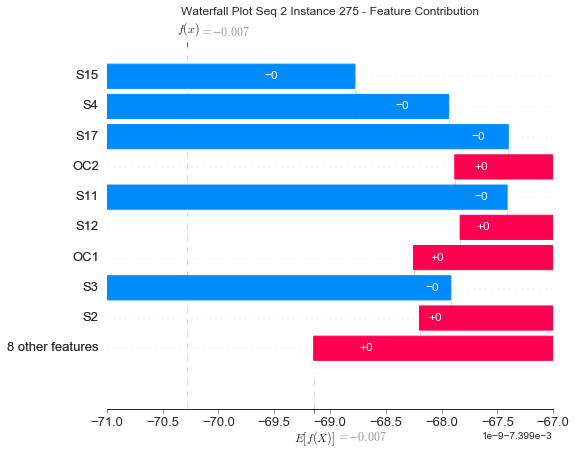

None

Contribution: [ 1.10551834e-09  9.07119935e-10  2.02594982e-10  8.32050262e-11
 -2.92825070e-10 -5.41101886e-10 -1.01902870e-11  4.18089119e-10
  1.01246206e-10 -7.00869418e-10  9.91575832e-12  1.36112357e-10
 -1.97873506e-11 -1.48824830e-09 -4.12817114e-10 -1.92465401e-12
  1.05387409e-11]


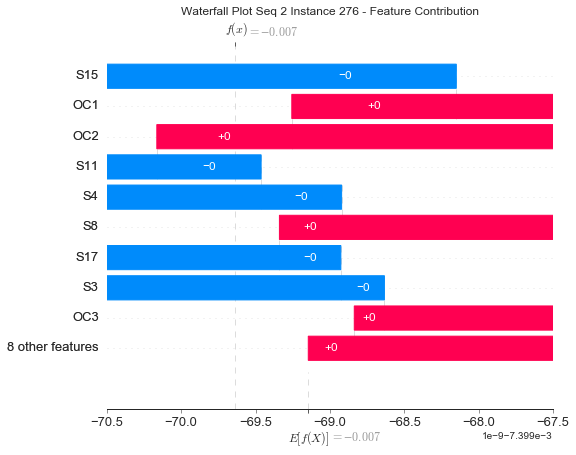

None

Contribution: [ 1.64215738e-10  1.86063165e-10  3.31480898e-10  1.24589683e-09
 -1.19413657e-09 -3.12745785e-09  6.96439184e-10  1.37852318e-09
  6.26911190e-10 -2.21871943e-09  1.32010147e-09  6.41838083e-10
 -1.50248022e-10 -3.60922958e-10 -1.76935899e-09  5.37940970e-10
  7.74605657e-10]


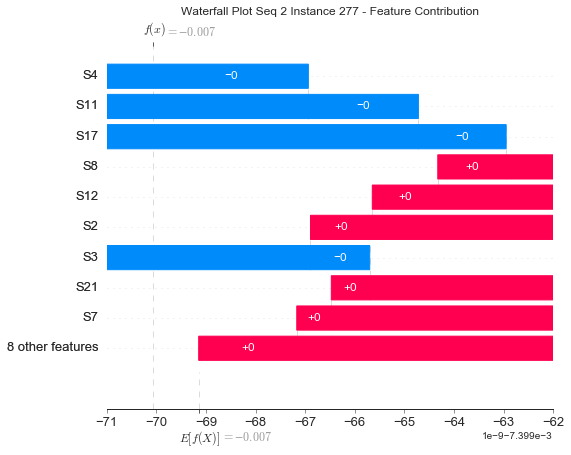

None

Contribution: [ 7.84737109e-10  6.81405432e-10  2.61884708e-10  8.07537204e-10
 -9.96204563e-10 -2.26773045e-09  3.62540636e-10  1.24075306e-09
  4.32517022e-10 -1.96904382e-09  7.54861063e-10  5.56530766e-10
 -1.60271338e-10 -8.41844483e-10 -1.42658818e-09  2.88429614e-10
  4.51881699e-10]


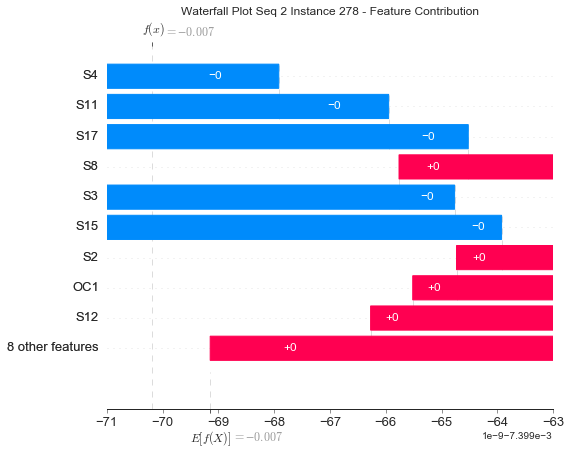

None

Contribution: [ 7.75750353e-10  7.02221392e-10  9.34844979e-11  8.85122753e-10
 -9.80266646e-10 -2.42138154e-09  4.74979056e-10  1.15655985e-09
  4.44170423e-10 -1.94228633e-09  8.60125915e-10  5.98573524e-10
 -1.50904539e-10 -1.70618120e-09 -1.37703382e-09  3.49693191e-10
  5.75485881e-10]


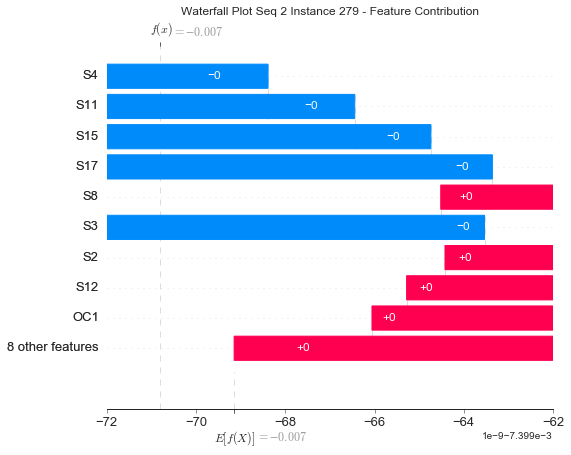

None

Contribution: [ 1.39030298e-09  9.58837232e-10  1.35388326e-10  9.00129860e-10
 -1.21522703e-09 -2.68550093e-09  4.59599692e-10  1.54950985e-09
  4.37720082e-10 -2.55490096e-09  8.24320501e-10  7.39507622e-10
 -1.32151123e-10 -1.10746479e-09 -1.66765712e-09  3.20560467e-10
  4.83980966e-10]


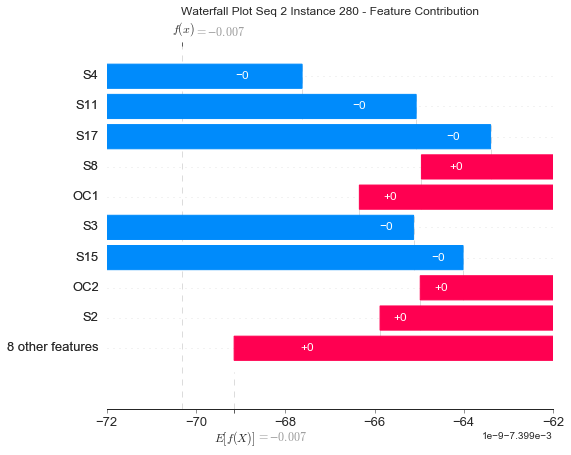

None

Contribution: [ 2.11165396e-09  1.63126579e-09  1.19145402e-10  3.21524252e-10
 -8.86886342e-10 -1.42998324e-09  3.47193177e-11  1.39462142e-09
  2.35827247e-10 -2.06913575e-09  1.09339586e-10  6.82779888e-10
 -4.41070305e-11 -1.75537196e-09 -1.11373688e-09  4.53514622e-11
  1.22055352e-10]


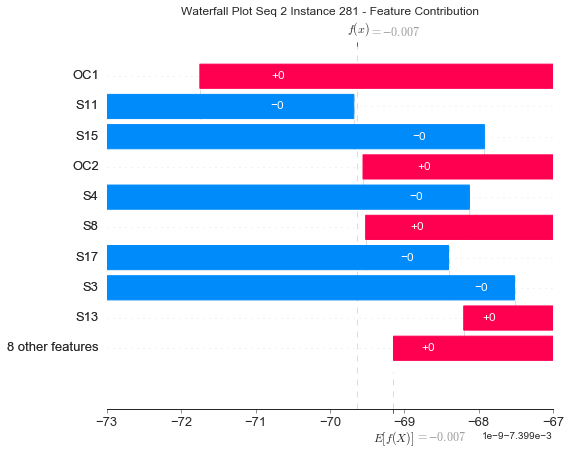

None

Contribution: [ 1.97267225e-09  1.80023474e-09  1.46429827e-10  9.08756181e-10
 -1.19789789e-09 -2.13629425e-09  2.41143439e-10  1.83724091e-09
  4.90497476e-10 -2.47763654e-09  4.98700636e-10  9.34119671e-10
 -3.75804839e-11 -1.91446903e-09 -1.63011704e-09  1.94839728e-10
  3.95812272e-10]


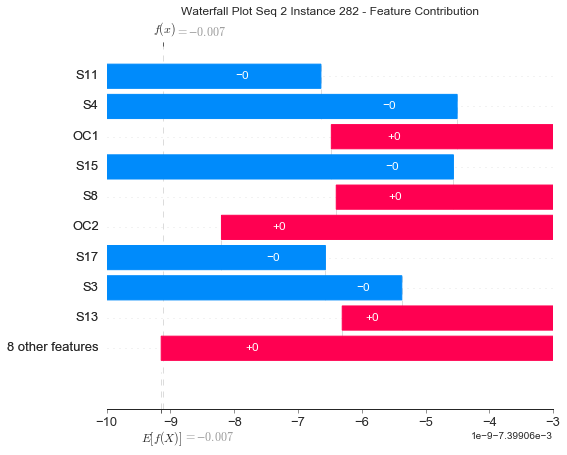

None

Contribution: [ 1.79078607e-09  1.86504190e-09  6.34379077e-11  7.33112682e-10
 -8.15506829e-10 -1.63584712e-09  2.25379271e-10  8.95440444e-10
  3.50281387e-10 -1.47031454e-09  4.60969735e-10  4.19873025e-10
 -5.70090641e-11 -3.90863564e-09 -1.04889120e-09  1.71057307e-10
  3.85278670e-10]


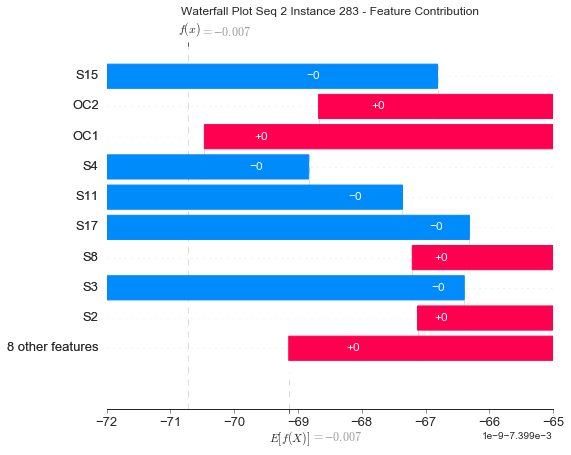

None

Contribution: [ 2.00617567e-09  1.91563765e-09  0.00000000e+00  3.04731483e-11
 -2.48541632e-10 -6.55318355e-10 -1.17031567e-11  5.79109243e-12
  3.22961380e-11 -3.70248304e-10  6.68893343e-11  3.21018559e-12
 -1.03215327e-11 -5.39058398e-09 -2.79807177e-10 -8.66025134e-12
  1.09608739e-10]


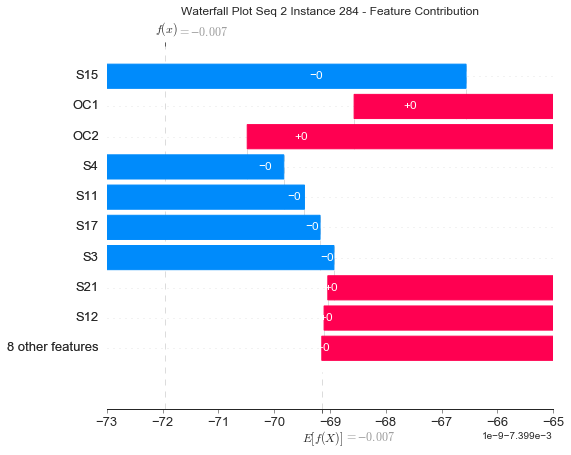

None

Contribution: [ 9.68989555e-10  7.86857746e-10  2.18364021e-10  2.22998819e-09
 -2.34319941e-09 -5.82963589e-09  1.21405463e-09  2.91762858e-09
  1.01365105e-09 -4.57565452e-09  1.97896854e-09  1.88793048e-09
 -3.08066239e-10 -1.13976073e-09 -3.14814841e-09  7.43662409e-10
  1.31027822e-09]


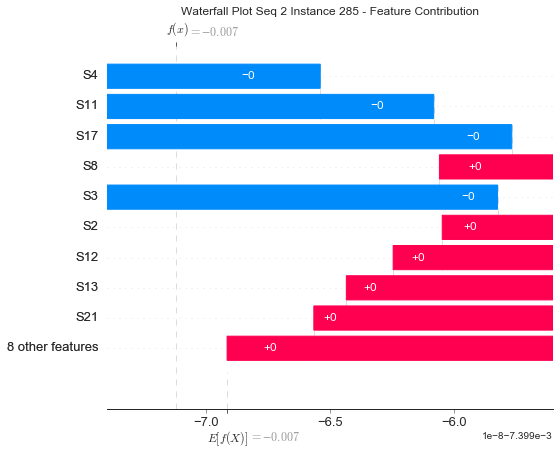

None

Contribution: [ 1.94454874e-09  1.36643830e-09  6.91689622e-11  1.64884906e-09
 -2.13570539e-09 -4.71697259e-09  8.94041396e-10  2.69139822e-09
  7.39488470e-10 -4.38835634e-09  1.35972711e-09  1.72737080e-09
 -2.67194933e-10 -1.79891846e-09 -2.64208477e-09  5.45226919e-10
  9.26803745e-10]


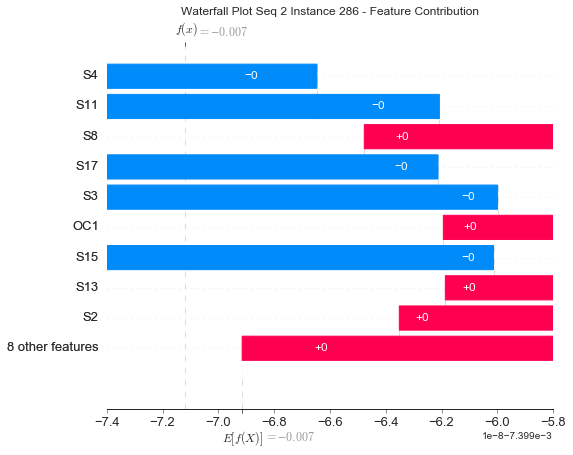

None

Contribution: [ 1.18319332e-09  8.63448424e-10 -1.01308781e-10  2.72023115e-09
 -3.01632652e-09 -6.65012800e-09  1.79257231e-09  3.33895889e-09
  9.55121870e-10 -5.52270540e-09  2.59352806e-09  2.01622674e-09
 -4.05201900e-10 -1.48547108e-09 -3.79157683e-09  1.07656595e-09
  1.68230496e-09]


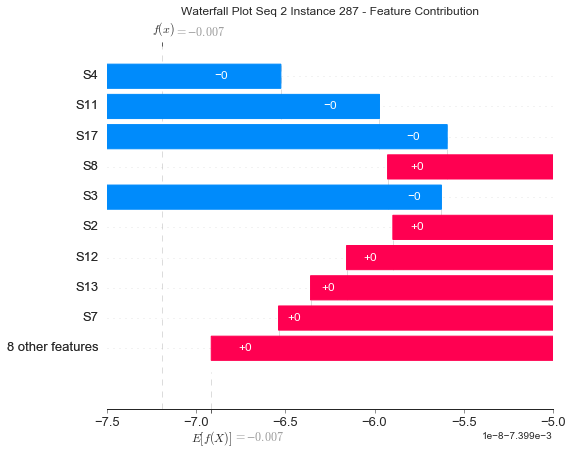

None

Contribution: [ 2.95516189e-09  2.37597808e-09 -2.01896652e-10  1.50384738e-09
 -2.08245998e-09 -3.72089937e-09  4.08626466e-10  2.96957192e-09
  6.76441791e-10 -4.14965973e-09  7.43415274e-10  1.85172133e-09
 -1.56817045e-10 -3.09212278e-09 -2.58055999e-09  2.25507793e-10
  6.29223063e-10]


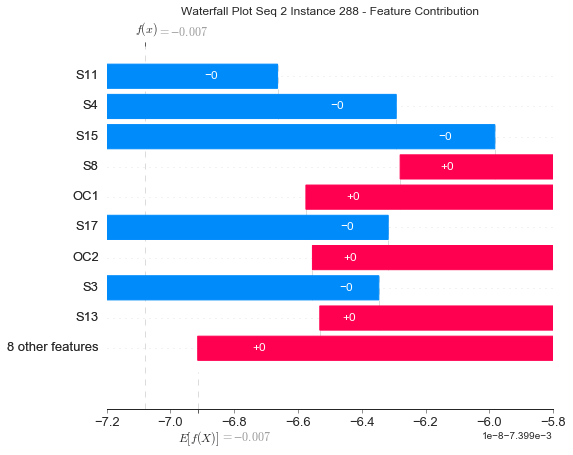

None

Contribution: [ 2.65537037e-09  1.65366942e-09 -1.93036101e-10  2.01741157e-09
 -2.63249689e-09 -5.99631322e-09  1.04050102e-09  3.32968897e-09
  8.49528781e-10 -5.62169333e-09  1.64027536e-09  2.08087014e-09
 -2.61504818e-10 -2.14249818e-09 -3.41333473e-09  5.88224747e-10
  1.10213982e-09]


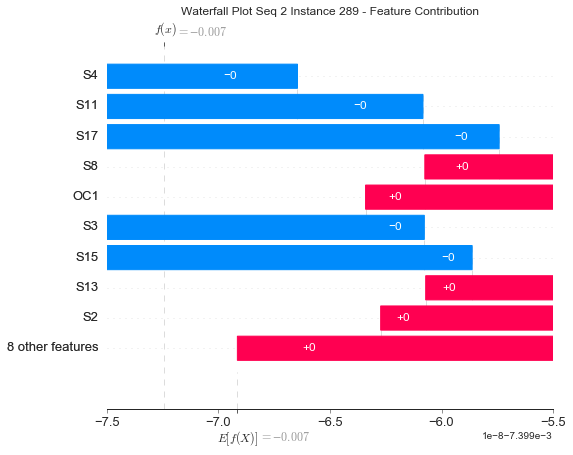

None

Contribution: [ 1.79274717e-09  1.51296431e-09 -2.85019647e-10  3.21222027e-09
 -3.14147641e-09 -7.15520132e-09  1.47419266e-09  4.28933289e-09
  1.28193411e-09 -6.29297769e-09  2.18877161e-09  2.67193889e-09
 -2.47337845e-10 -2.47303111e-09 -4.15327150e-09  8.48266124e-10
  1.64706293e-09]


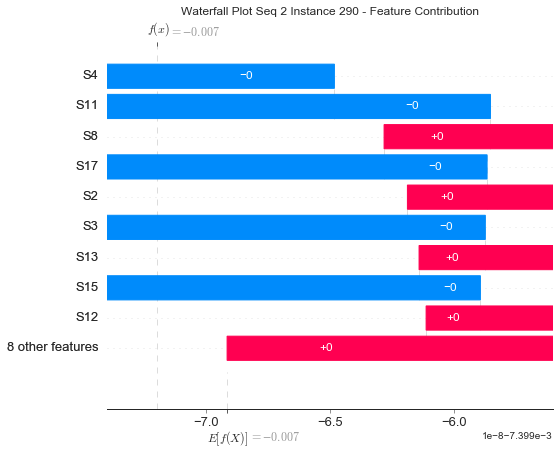

None

Contribution: [ 3.59984287e-09  2.28845698e-09 -3.65289576e-10  1.76774684e-09
 -2.30908315e-09 -5.52282176e-09  5.84632232e-10  3.70628883e-09
  9.56296931e-10 -5.74896752e-09  1.02803810e-09  2.28376096e-09
  5.12755047e-11 -2.70658784e-09 -3.24606098e-09  3.77332582e-10
  8.05428779e-10]


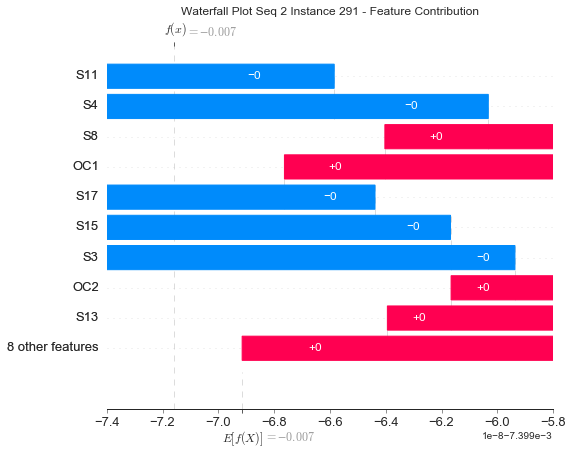

None

Contribution: [ 2.65694999e-09  2.21654406e-09 -4.84261964e-10  1.96737204e-09
 -2.40139331e-09 -5.37990541e-09  1.09954768e-09  2.63856959e-09
  6.12793538e-10 -4.68876671e-09  1.50508450e-09  2.13649698e-09
 -7.27589447e-11 -4.70789852e-09 -2.81635892e-09  5.84363447e-10
  1.22531585e-09]


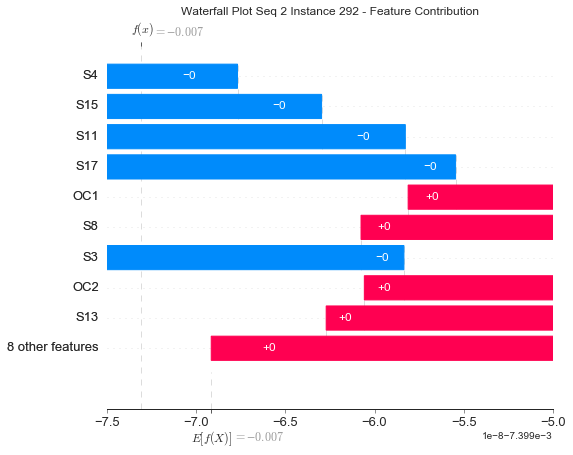

None

Contribution: [ 6.09827300e-09  4.44437154e-09  2.24991609e-10  3.19777649e-10
 -8.37513059e-10 -2.40634712e-09  2.87751095e-12  2.06557438e-09
  4.46046228e-10 -3.07182879e-09  1.49607150e-11  7.09341919e-10
  4.64220246e-10 -5.96853988e-09 -1.46265333e-09 -2.17703234e-11
  1.20501789e-10]


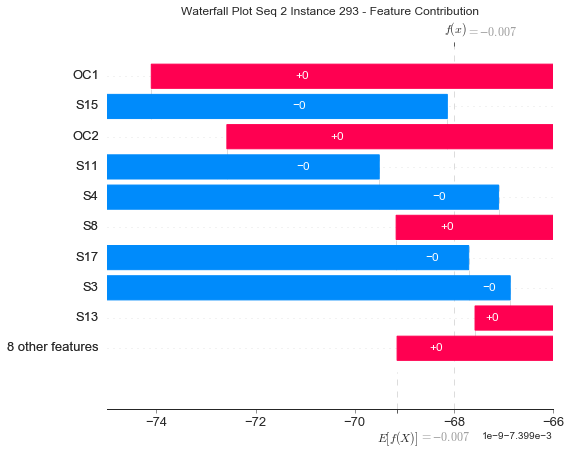

None

Contribution: [ 1.55067403e-09  1.23779498e-09 -5.99398253e-10  1.71293124e-09
 -1.88071447e-09 -3.38382922e-09  8.74448403e-10  2.58864286e-09
  3.40880768e-10 -3.37223849e-09  1.02149245e-09  2.17677054e-09
  4.45896965e-11 -1.82645632e-09 -2.10331685e-09  4.54444316e-10
  9.78973902e-10]


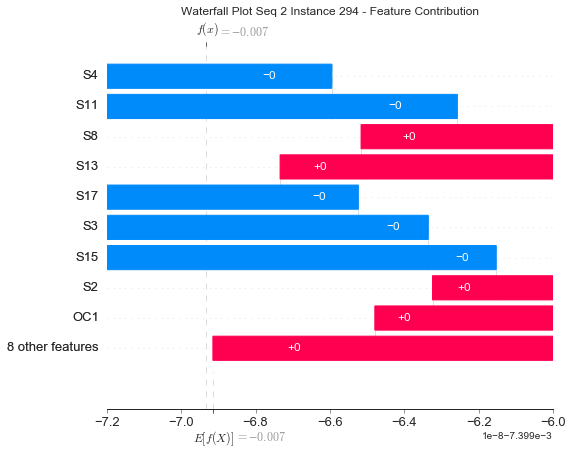

None

Contribution: [ 1.95821630e-13  0.00000000e+00 -7.12446324e-10  2.24592189e-09
 -2.30533903e-09 -5.73112979e-09  2.08111417e-09  2.90748448e-09
  3.62503971e-10 -4.63723637e-09  2.13602136e-09  2.39422948e-09
  2.09016103e-11 -3.53915175e-10 -2.72828582e-09  1.08539833e-09
  1.89544225e-09]


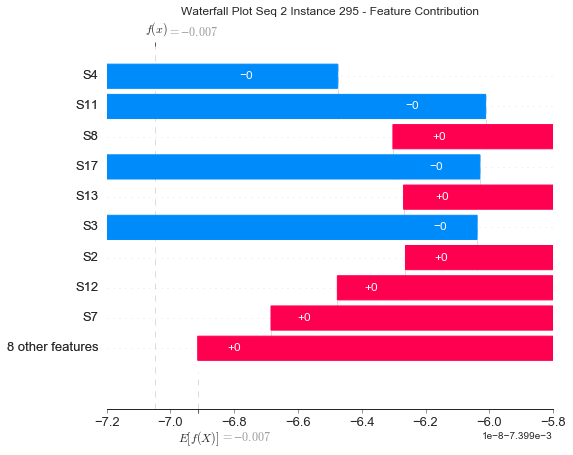

None

Contribution: [ 3.15915516e-09  1.49247736e-09 -7.50229712e-10  1.73367209e-10
 -7.58484109e-10 -1.38136369e-09  1.69791947e-12  1.81148130e-09
  7.22059782e-12 -2.48719845e-09  1.94714384e-12  2.00019112e-09
  4.25003005e-10 -1.48806234e-09 -7.89230181e-10  2.38458905e-12
  2.24793951e-11]


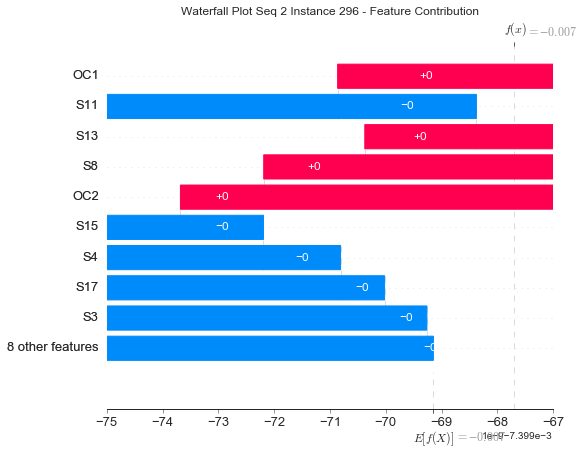

None

Contribution: [ 1.77953504e-13  9.57073179e-13 -8.90605867e-10  1.78156878e-09
 -1.26285626e-09 -4.65566918e-09  2.14845119e-09  3.06315640e-09
  4.43828779e-10 -4.29920499e-09  1.42485679e-09  2.69488698e-09
  5.80529735e-10 -3.52127549e-10 -1.35984035e-09  8.57893978e-10
  1.74256087e-09]


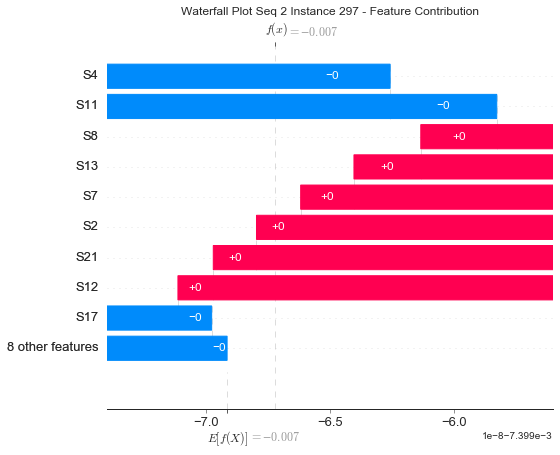

None

Contribution: [ 4.17432044e-09  1.81448800e-09 -1.25357968e-09  3.34284600e-10
 -3.01633329e-10 -1.03982978e-09  4.24681568e-10  2.63101763e-09
  4.31517627e-10 -2.51416532e-09  2.18518176e-10  3.38665229e-09
  1.11858955e-09 -1.28505973e-09 -5.51961012e-11  1.65357603e-10
  4.31112201e-10]


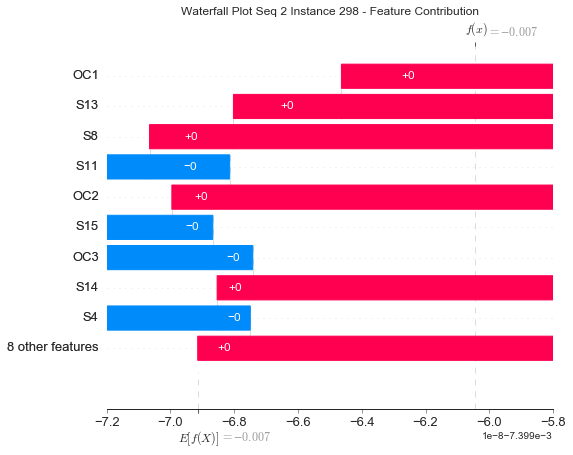

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


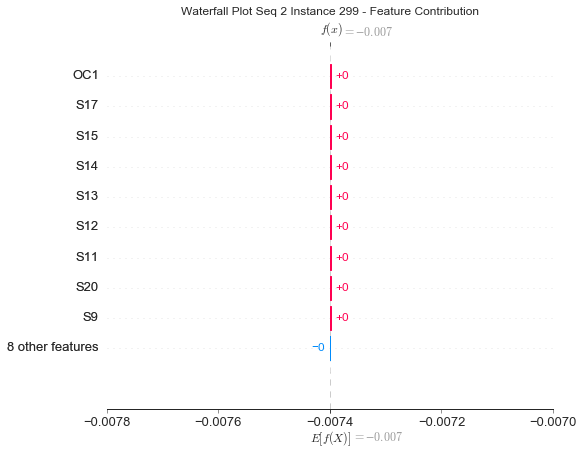

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


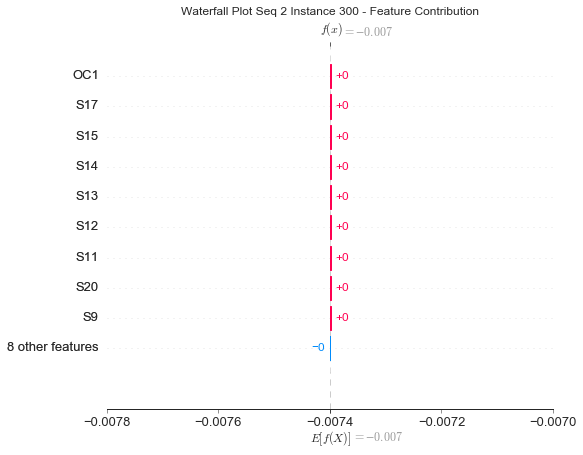

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


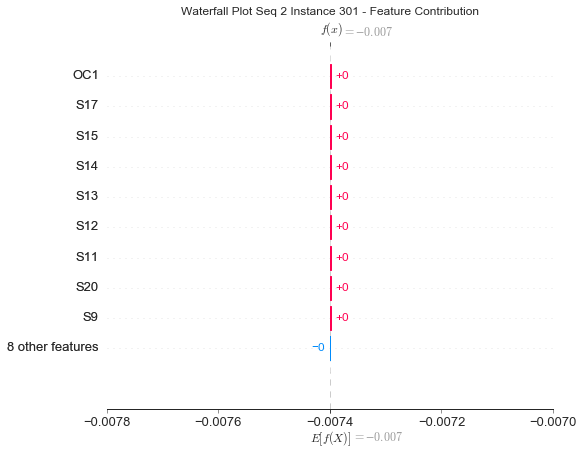

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


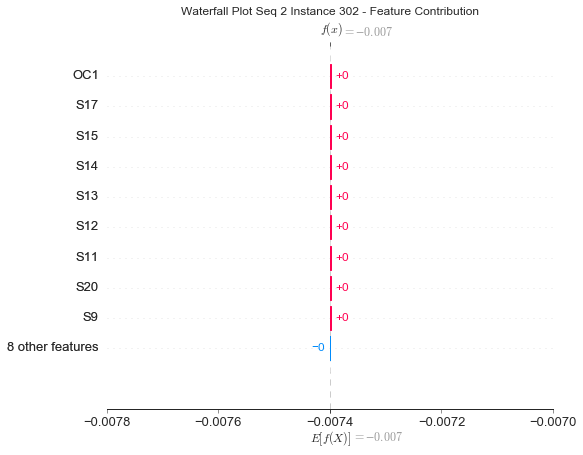

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


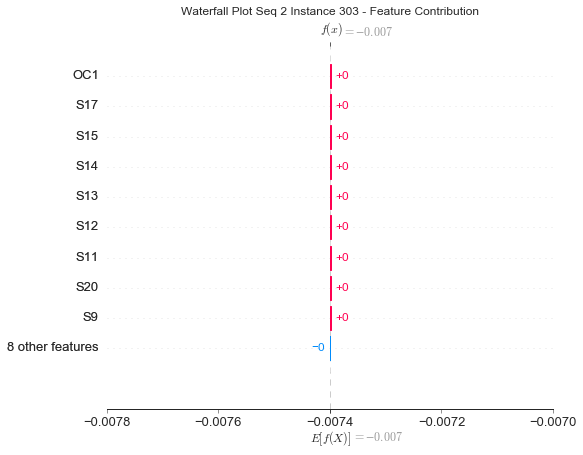

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


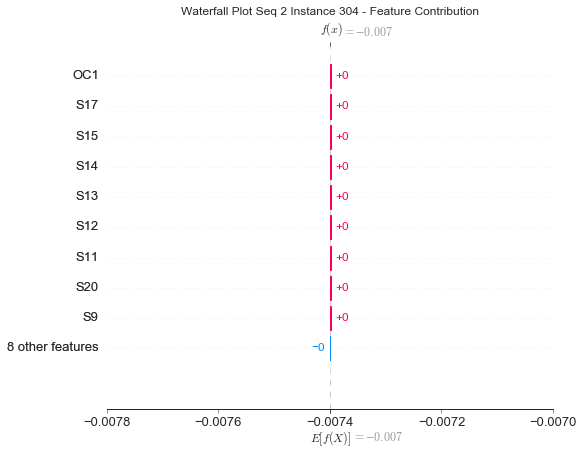

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


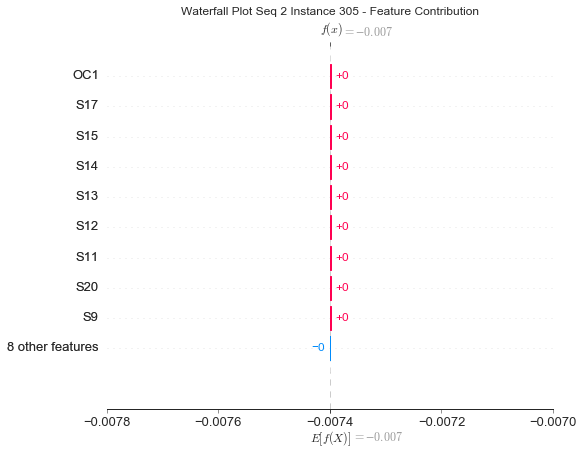

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


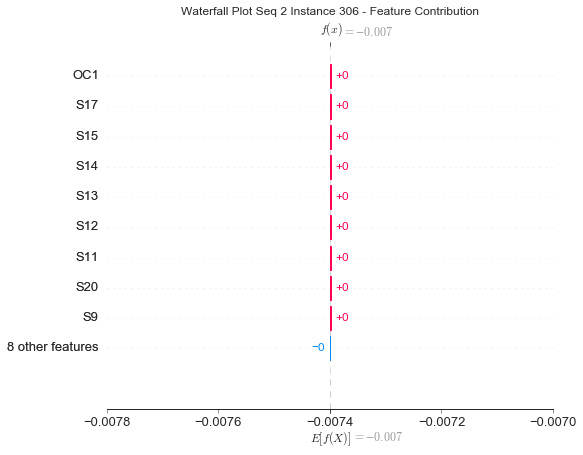

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


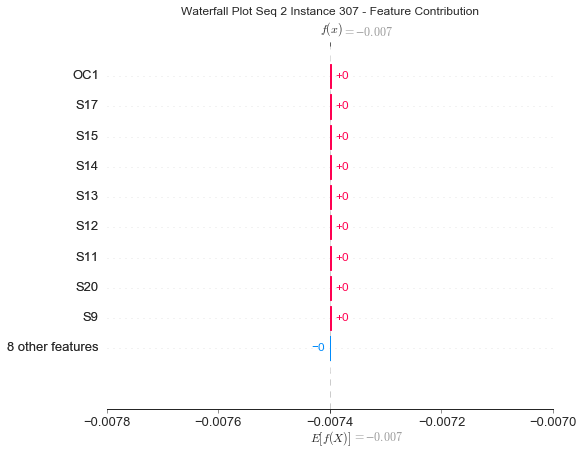

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


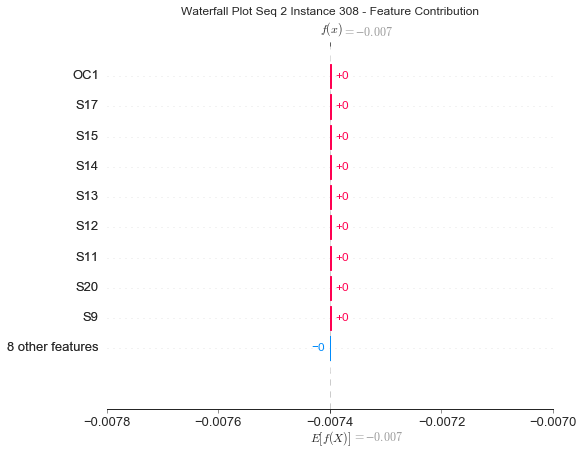

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


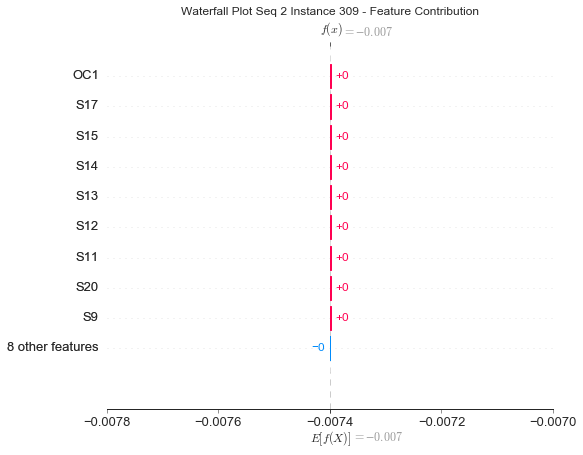

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


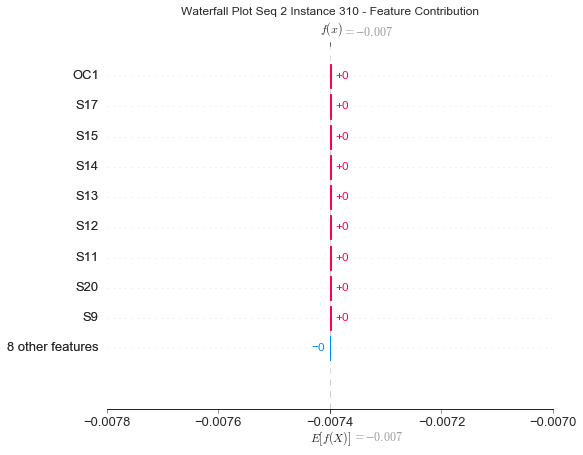

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


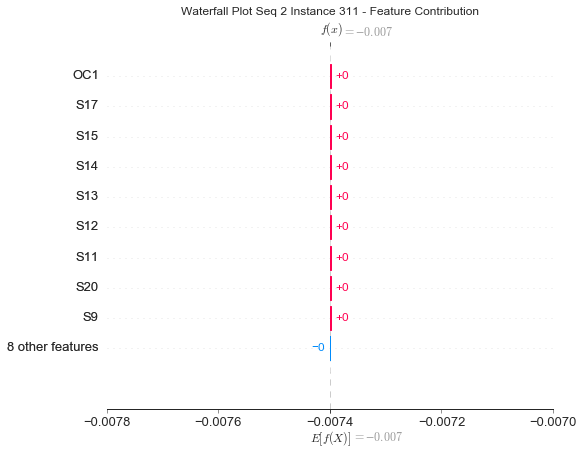

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


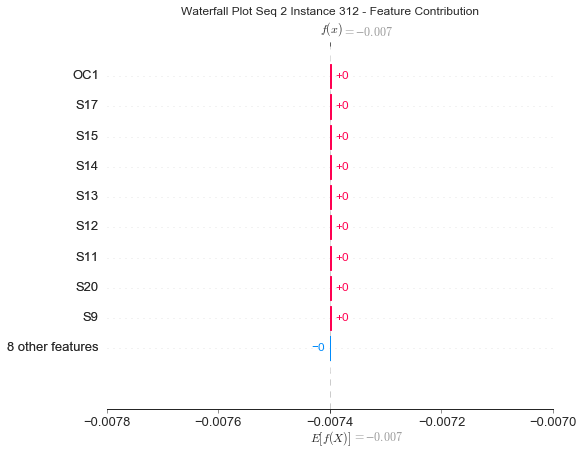

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


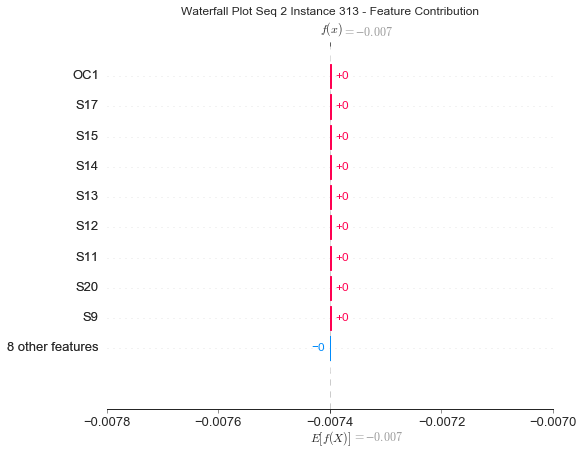

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


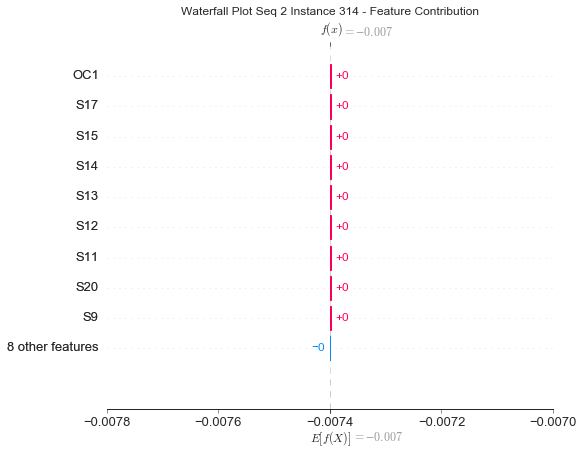

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


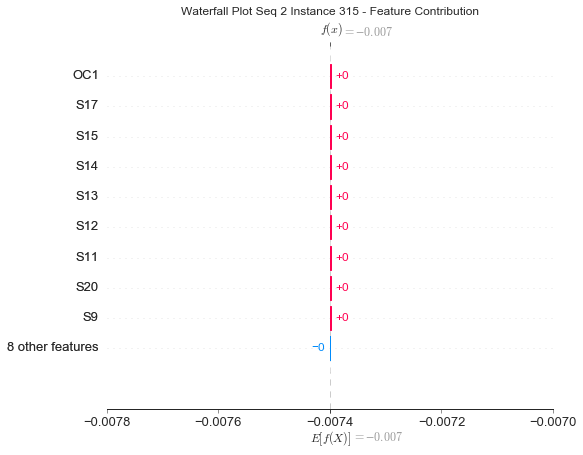

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


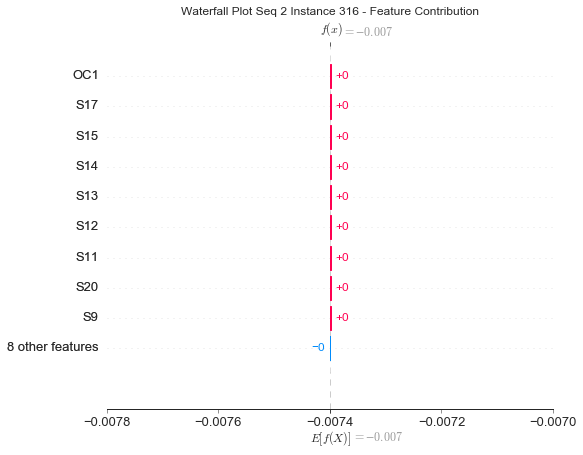

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


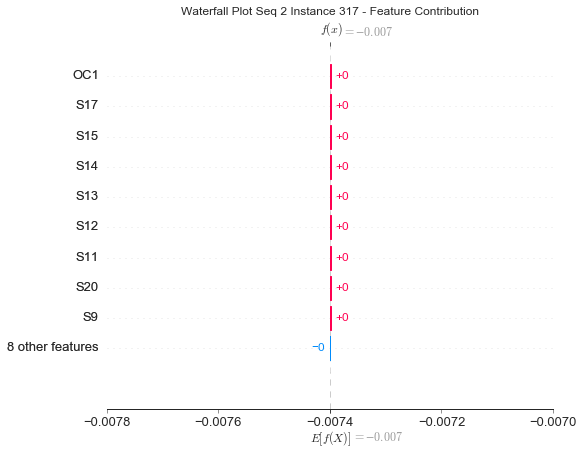

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


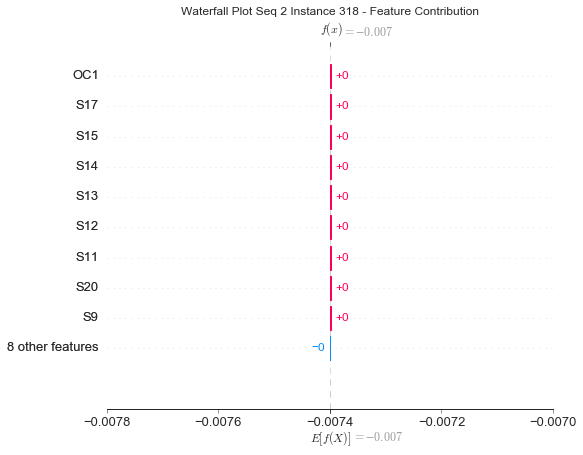

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


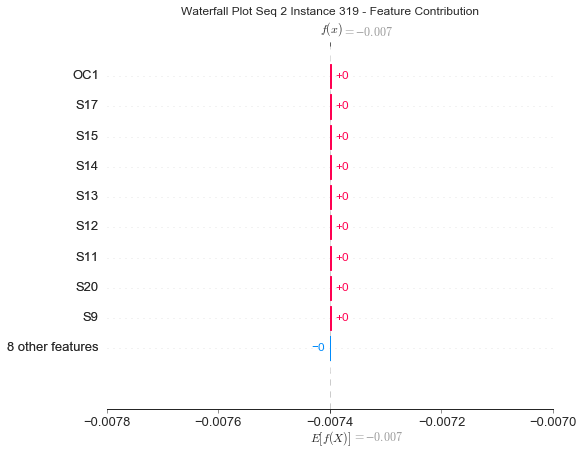

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


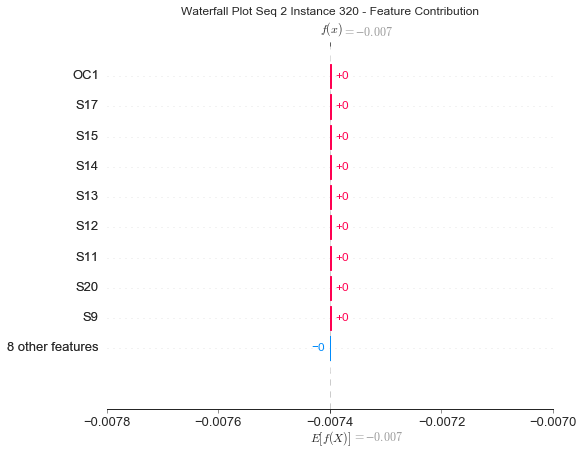

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


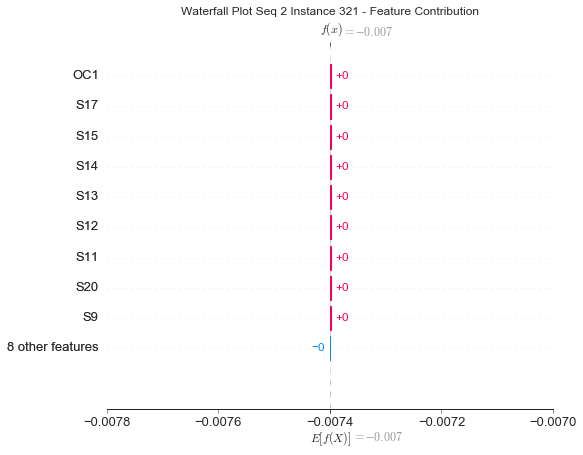

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


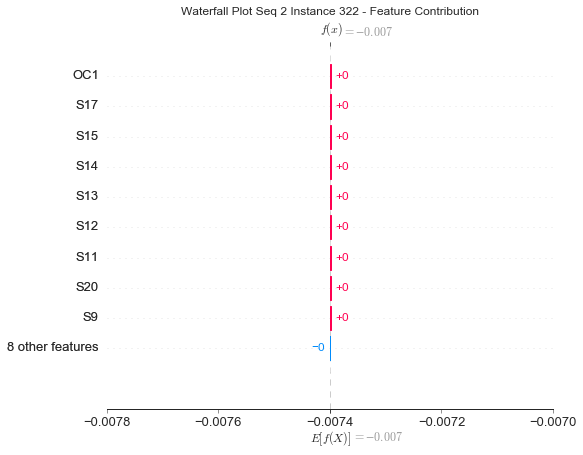

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


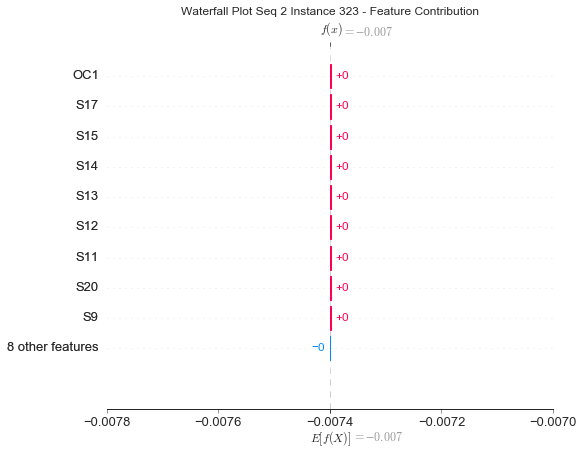

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


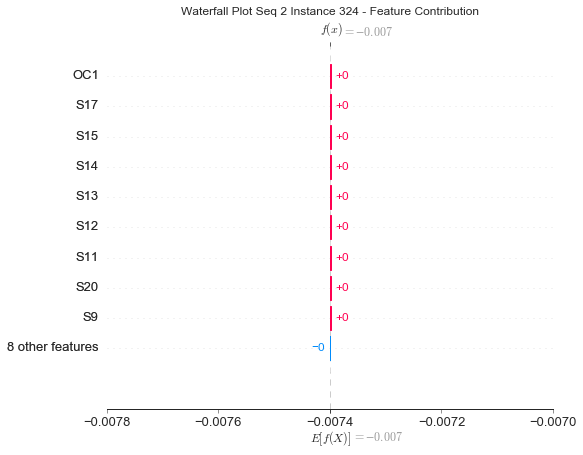

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


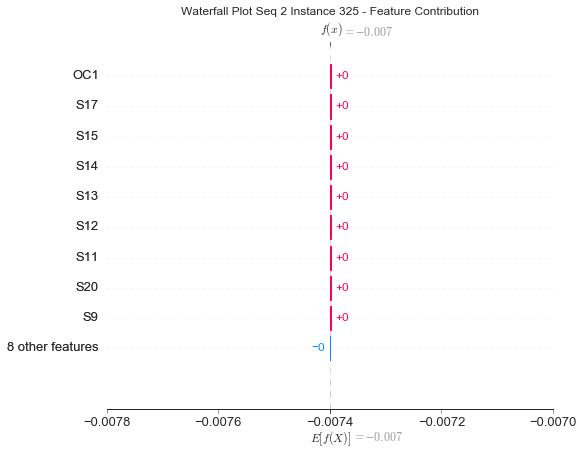

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


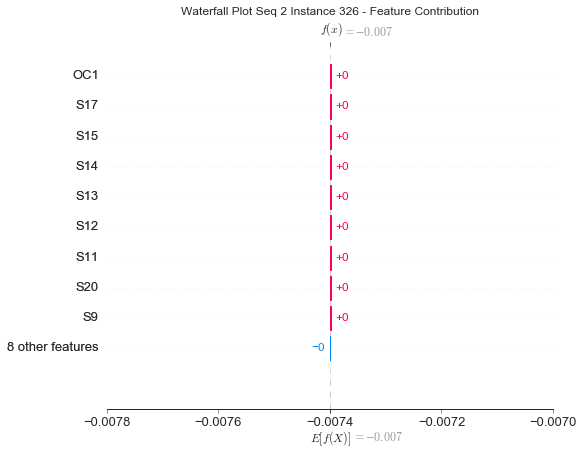

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


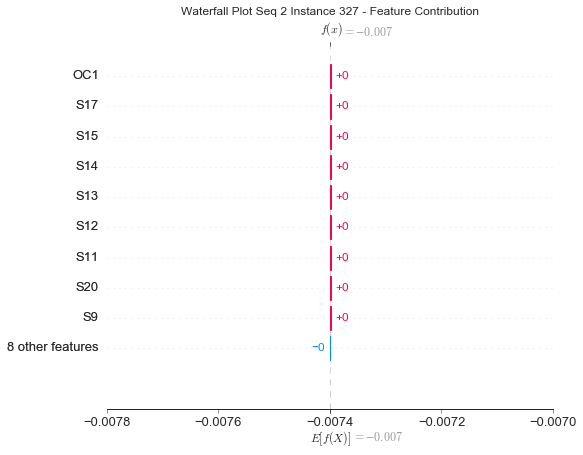

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


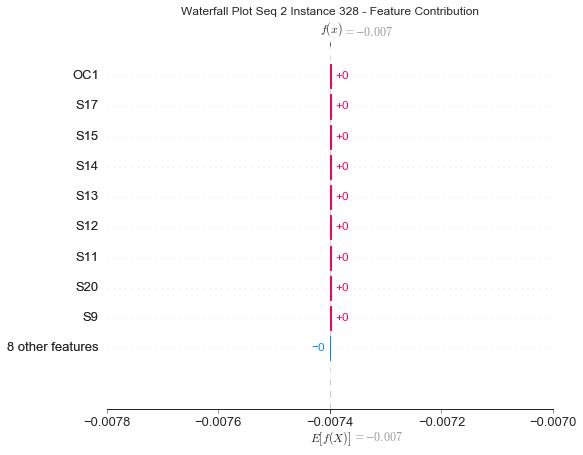

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


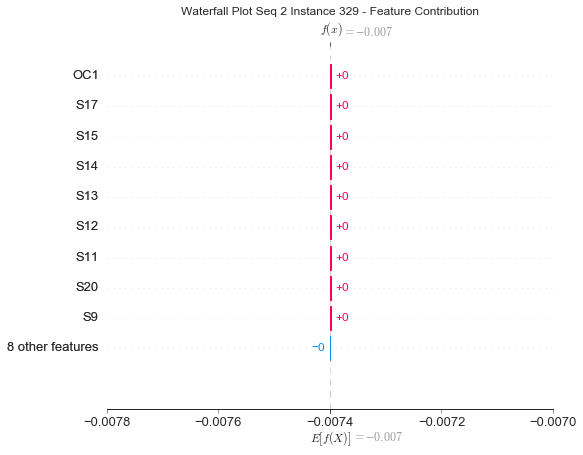

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


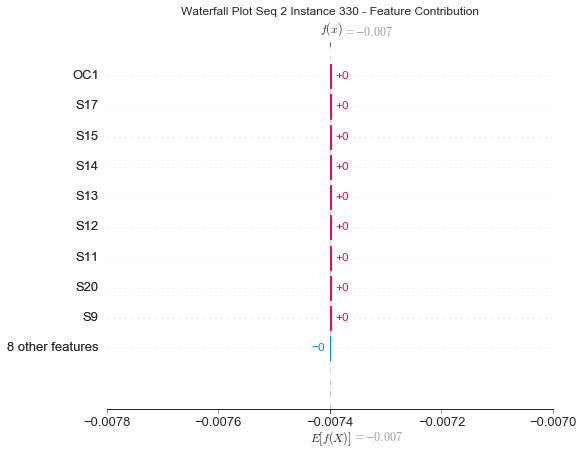

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


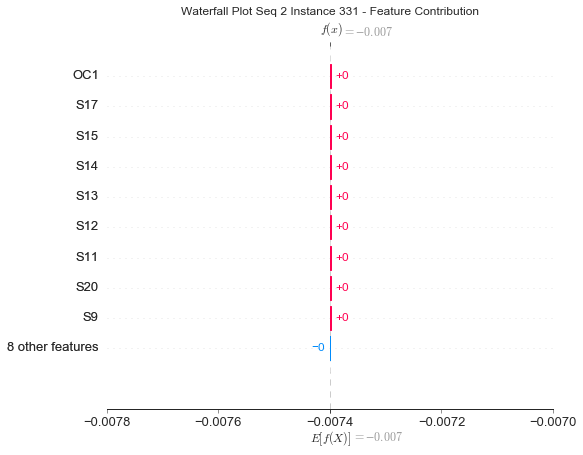

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


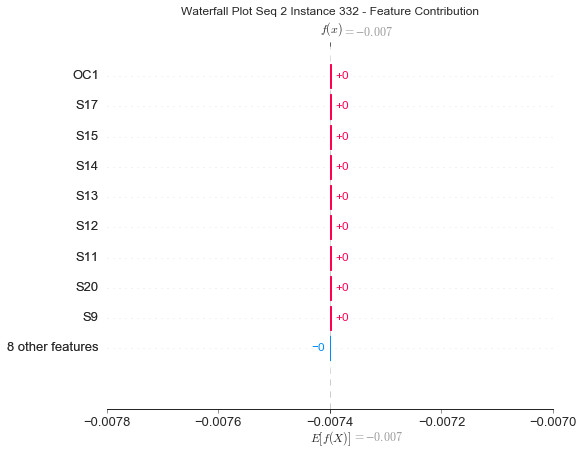

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


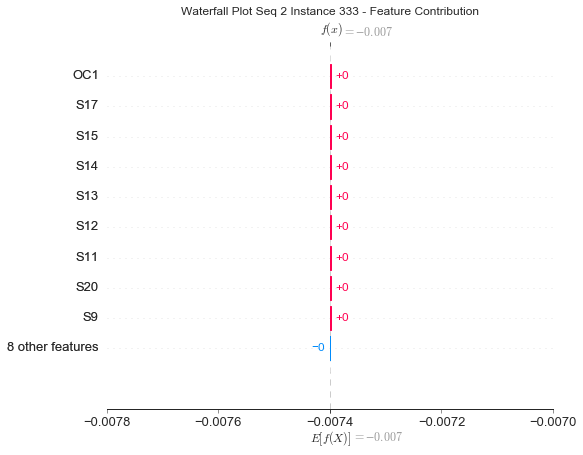

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


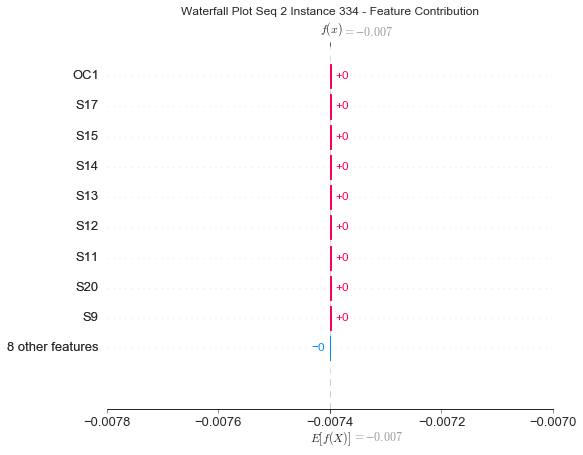

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


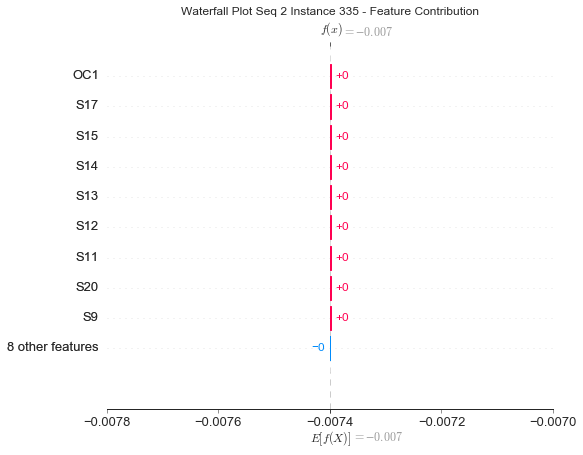

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


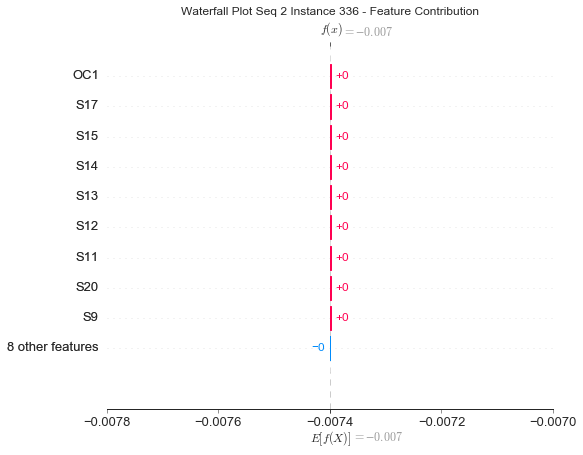

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


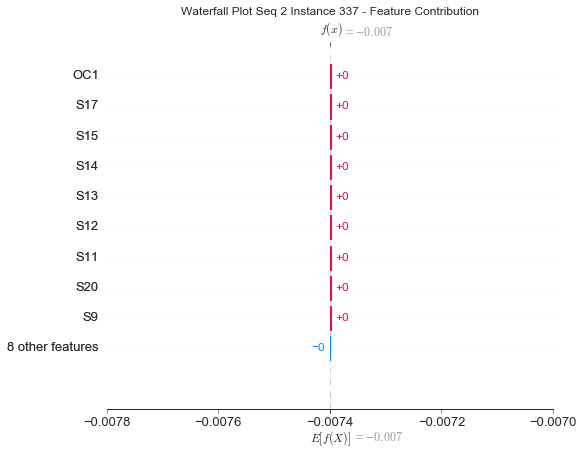

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


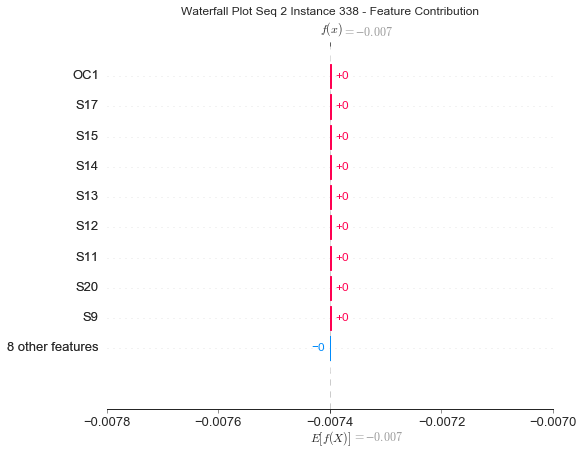

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


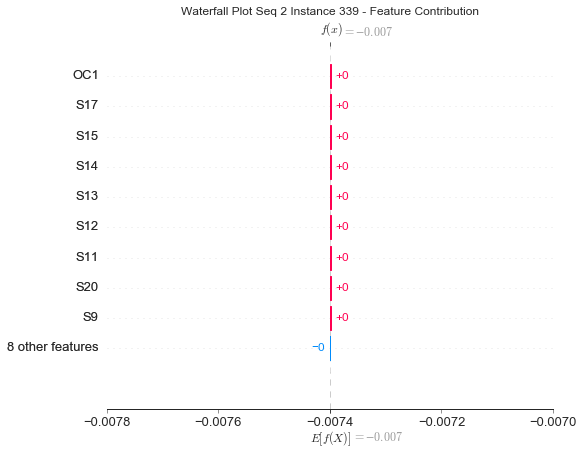

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


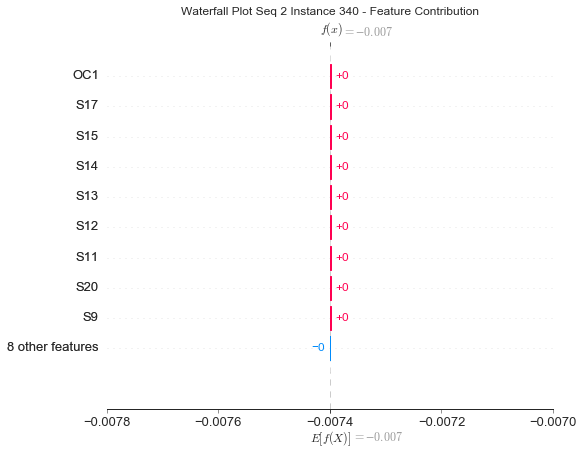

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


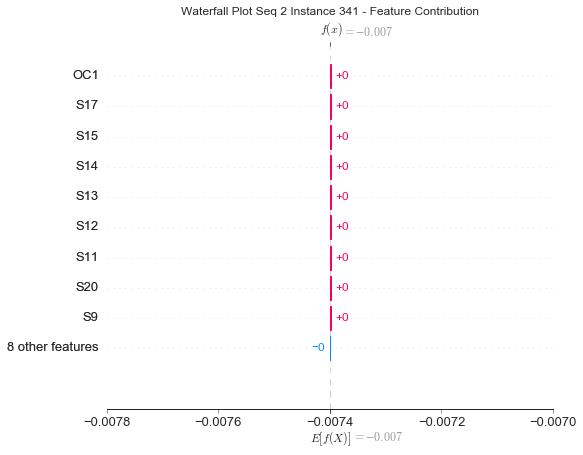

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


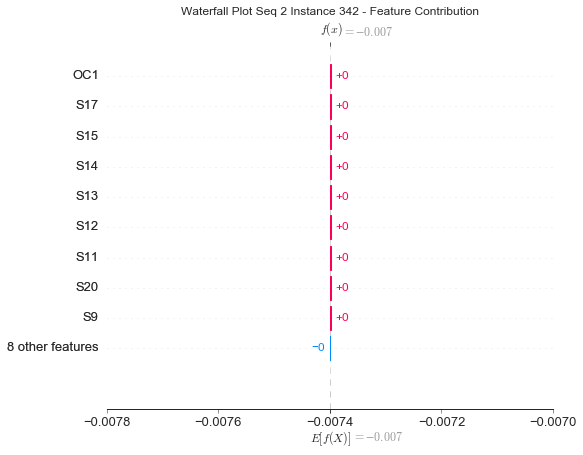

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


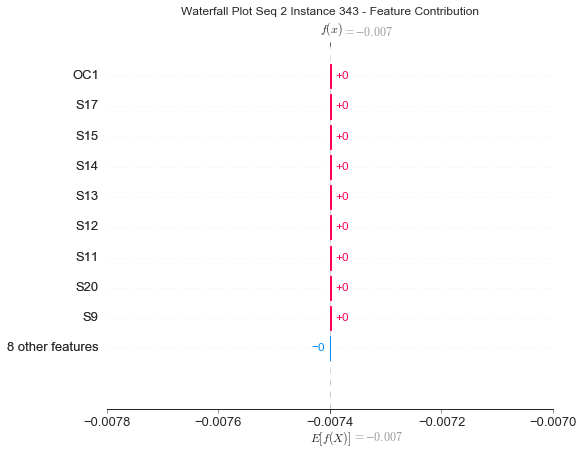

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


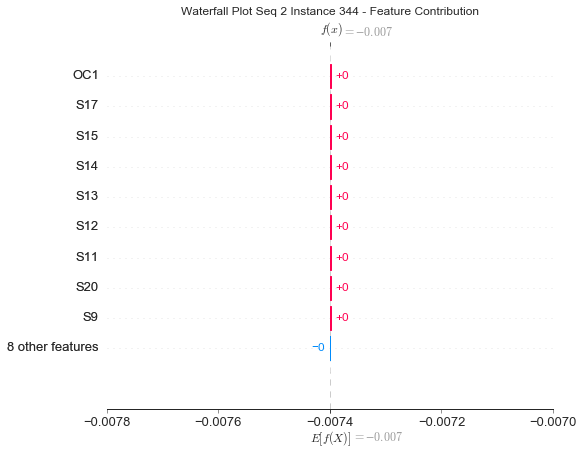

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


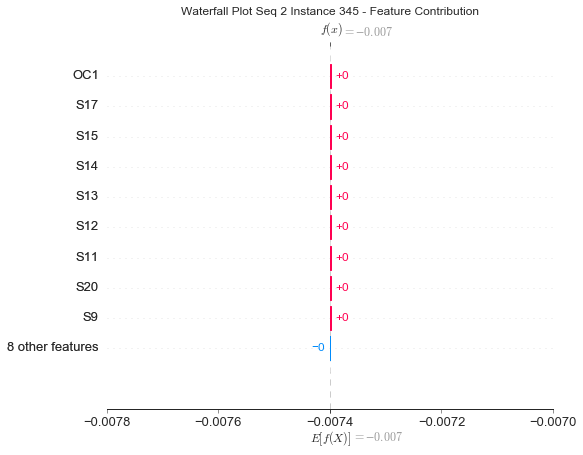

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


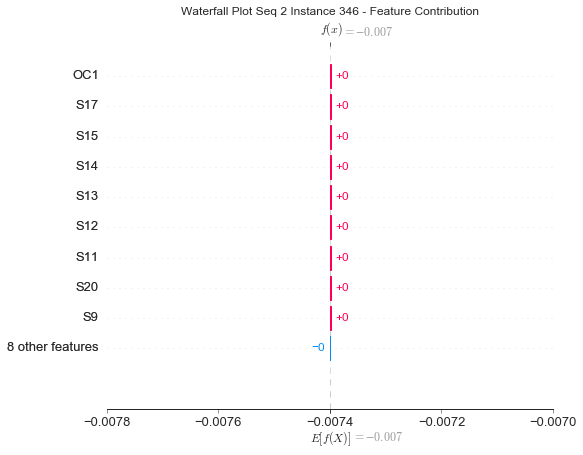

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


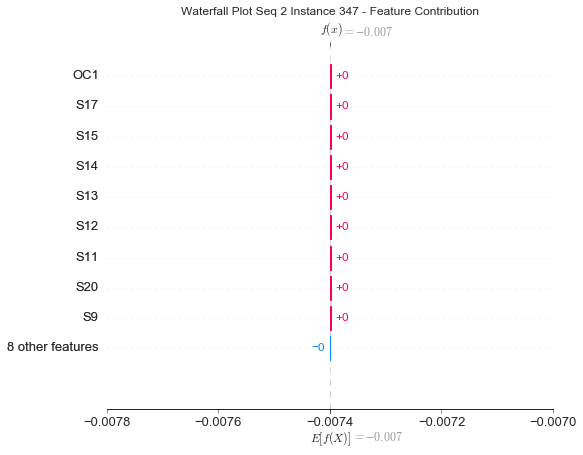

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


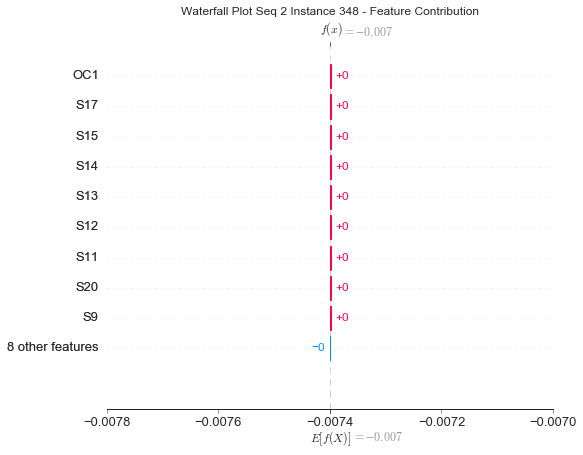

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


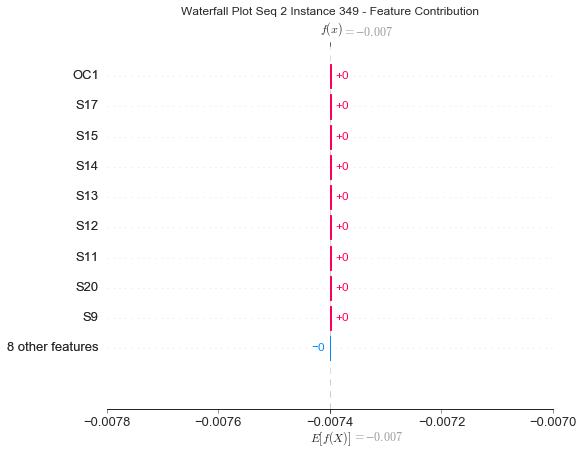

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


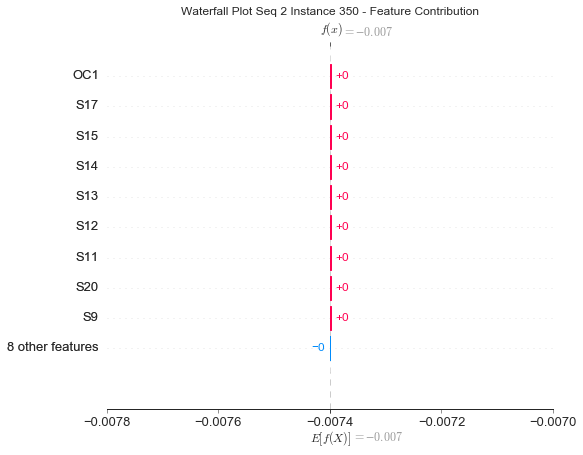

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


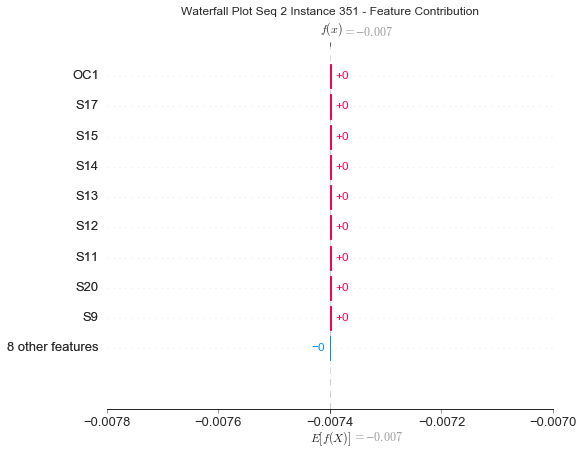

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


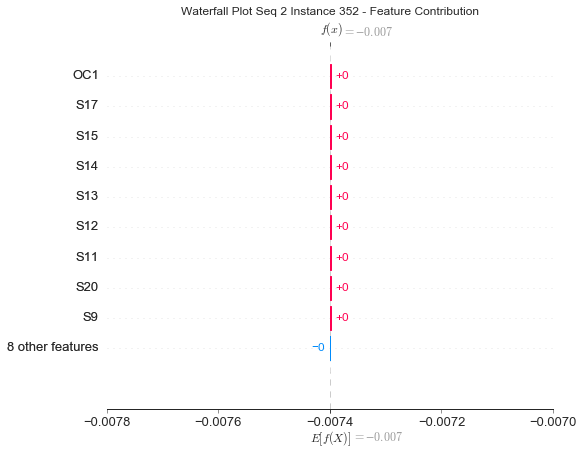

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


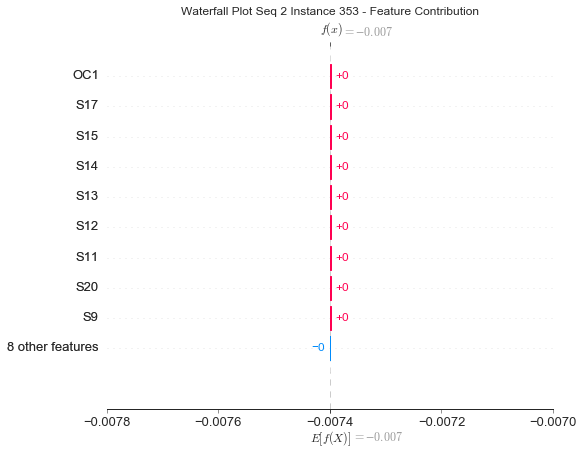

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


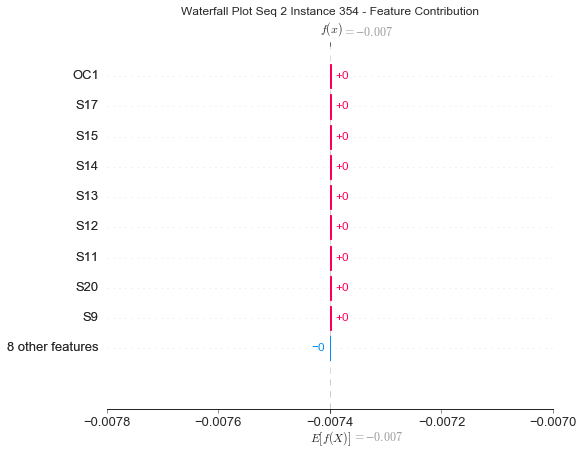

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


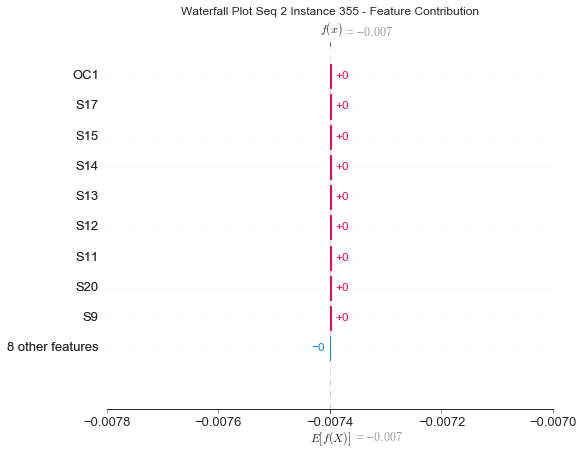

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


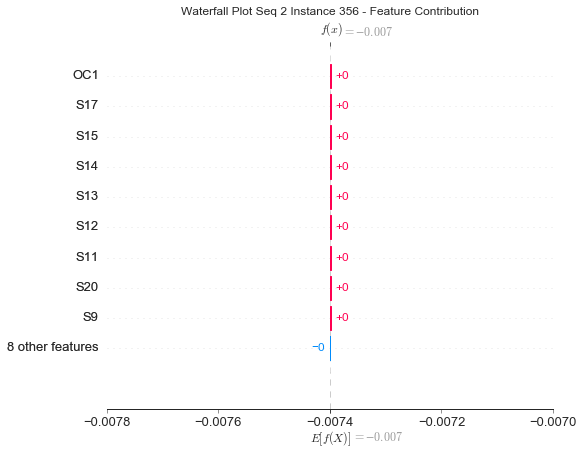

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


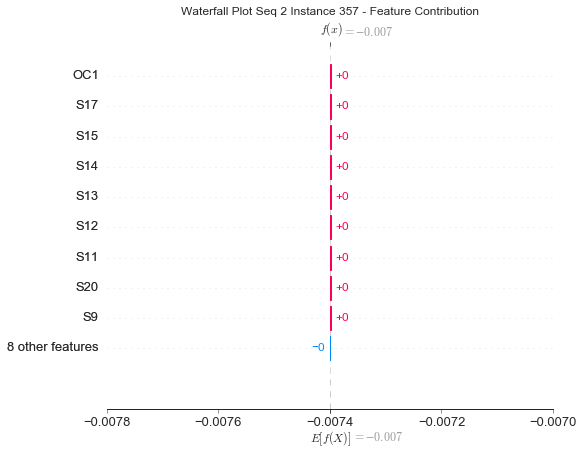

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


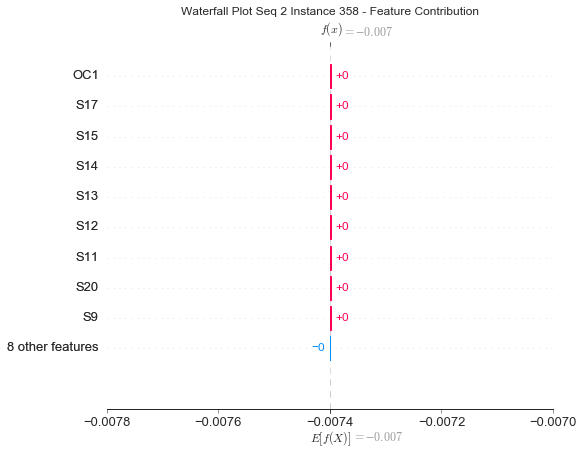

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


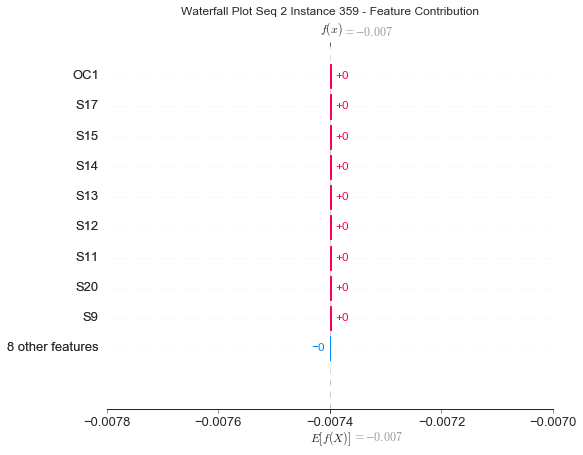

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


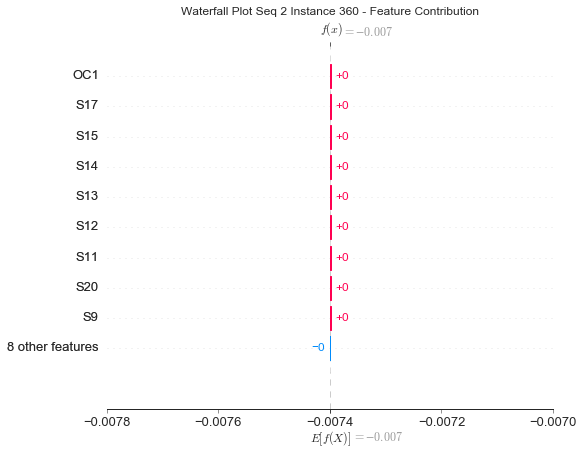

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


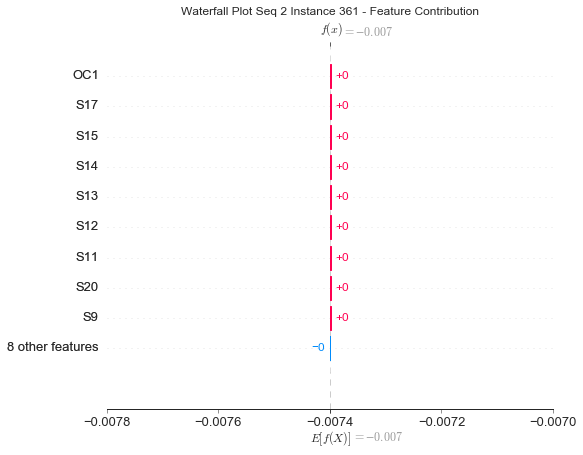

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


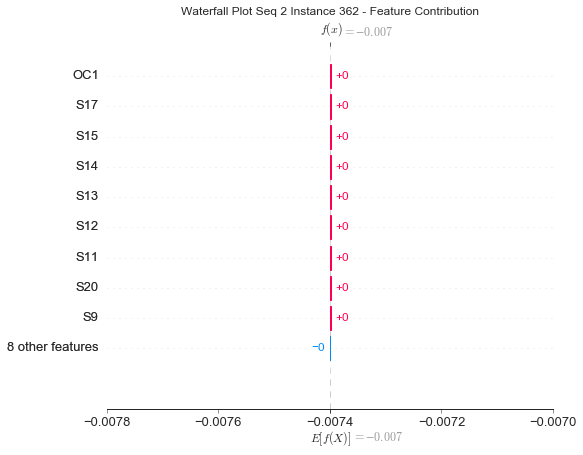

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


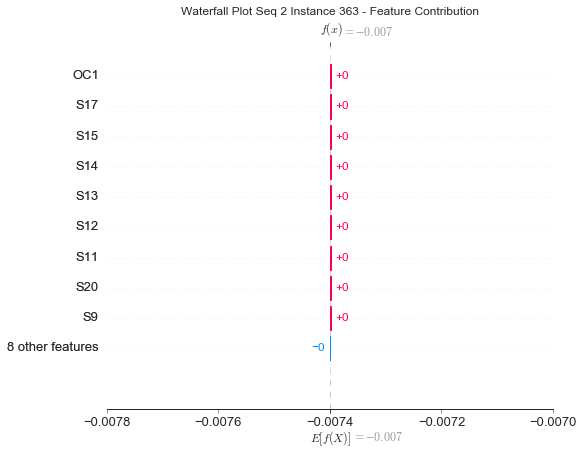

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


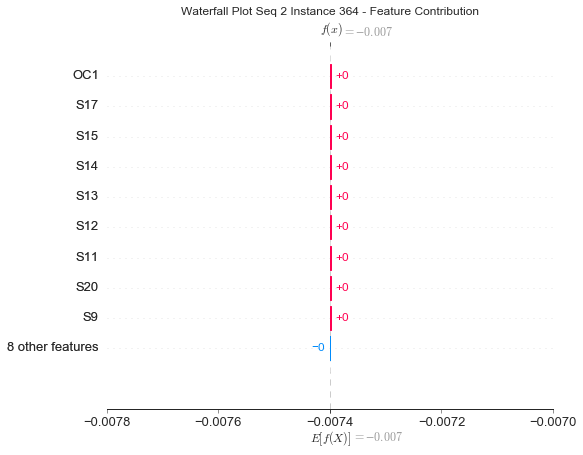

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


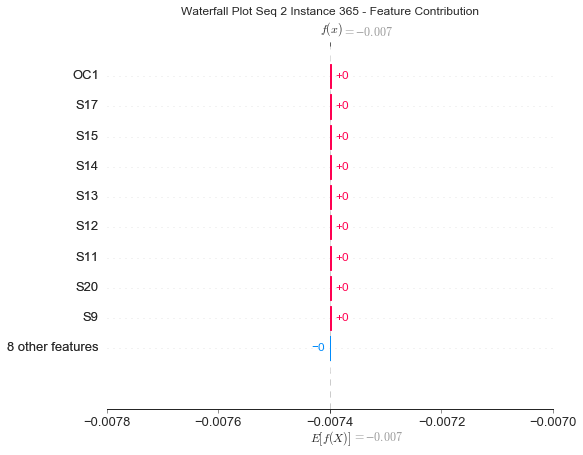

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


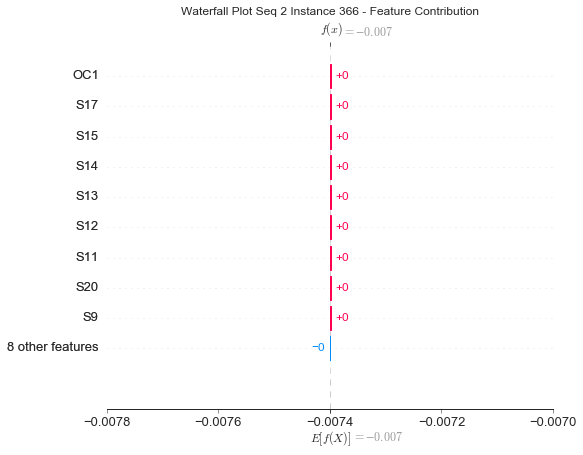

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


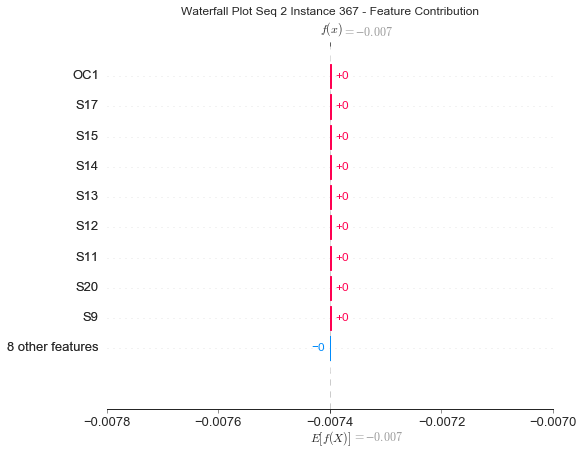

None

<Figure size 432x288 with 0 Axes>

In [68]:
#Waterfall Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure